# Определение стоимости автомобилей

In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from tqdm.notebook import tqdm
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
from lightgbm import LGBMRegressor
import lightgbm
from catboost import CatBoostRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import cross_val_score
from catboost import CatBoostRegressor
import time
import plotly.graph_objects as go

## Подготовка данных

In [2]:
try:
    df=pd.read_csv('datasets/autos.csv')
    print('Загрузили локальный файл')
except:
    df=pd.read_csv('***')
    print('Файл подтянули с сервера')
df.head(5)

Загрузили локальный файл


,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen
0,2016-03-24 11:52:17,480,NaN,1993,manual,0,golf,150000,0,petrol,volkswagen,NaN,2016-03-24 00:00:00,0,70435,2016-04-07 03:16:57
1,2016-03-24 10:58:45,18300,coupe,2011,manual,190,NaN,125000,5,gasoline,audi,yes,2016-03-24 00:00:00,0,66954,2016-04-07 01:46:50
2,2016-03-14 12:52:21,9800,suv,2004,auto,163,grand,125000,8,gasoline,jeep,NaN,2016-03-14 00:00:00,0,90480,2016-04-05 12:47:46
3,2016-03-17 16:54:04,1500,small,2001,manual,75,golf,150000,6,petrol,volkswagen,no,2016-03-17 00:00:00,0,91074,2016-03-17 17:40:17
4,2016-03-31 17:25:20,3600,small,2008,manual,69,fabia,90000,7,gasoline,skoda,no,2016-03-31 00:00:00,0,60437,2016-04-06 10:17:21


In [3]:
df.info()
df.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 354369 entries, 0 to 354368
Data columns (total 16 columns):
 #   Column             Non-Null Count   Dtype 
---  ------             --------------   ----- 
 0   DateCrawled        354369 non-null  object
 1   Price              354369 non-null  int64 
 2   VehicleType        316879 non-null  object
 3   RegistrationYear   354369 non-null  int64 
 4   Gearbox            334536 non-null  object
 5   Power              354369 non-null  int64 
 6   Model              334664 non-null  object
 7   Kilometer          354369 non-null  int64 
 8   RegistrationMonth  354369 non-null  int64 
 9   FuelType           321474 non-null  object
 10  Brand              354369 non-null  object
 11  NotRepaired        283215 non-null  object
 12  DateCreated        354369 non-null  object
 13  NumberOfPictures   354369 non-null  int64 
 14  PostalCode         354369 non-null  int64 
 15  LastSeen           354369 non-null  object
dtypes: int64(7), object(

,Price,RegistrationYear,Power,Kilometer,RegistrationMonth,NumberOfPictures,PostalCode
count,354369.000000,354369.000000,354369.000000,354369.000000,354369.000000,354369.0,354369.000000
mean,4416.656776,2004.234448,110.094337,128211.172535,5.714645,0.0,50508.689087
std,4514.158514,90.227958,189.850405,37905.341530,3.726421,0.0,25783.096248
min,0.000000,1000.000000,0.000000,5000.000000,0.000000,0.0,1067.000000
25%,1050.000000,1999.000000,69.000000,125000.000000,3.000000,0.0,30165.000000
50%,2700.000000,2003.000000,105.000000,150000.000000,6.000000,0.0,49413.000000
75%,6400.000000,2008.000000,143.000000,150000.000000,9.000000,0.0,71083.000000
max,20000.000000,9999.000000,20000.000000,150000.000000,12.000000,0.0,99998.000000


In [4]:
def to_date(row):
    return pd.to_datetime(row, format='%Y-%m-%d %H:%M:%S')

In [5]:
tqdm.pandas(desc="Пока ждем, можно заварить чай")
df[['DateCrawled', 'DateCreated', 'LastSeen']] = df[['DateCrawled', 'DateCreated', 'LastSeen']].progress_apply(to_date, axis=1)


Пока ждем, можно заварить чай:   0%|          | 0/354369 [00:00<?, ?it/s]

In [6]:
df.info()
df.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 354369 entries, 0 to 354368
Data columns (total 16 columns):
 #   Column             Non-Null Count   Dtype         
---  ------             --------------   -----         
 0   DateCrawled        354369 non-null  datetime64[ns]
 1   Price              354369 non-null  int64         
 2   VehicleType        316879 non-null  object        
 3   RegistrationYear   354369 non-null  int64         
 4   Gearbox            334536 non-null  object        
 5   Power              354369 non-null  int64         
 6   Model              334664 non-null  object        
 7   Kilometer          354369 non-null  int64         
 8   RegistrationMonth  354369 non-null  int64         
 9   FuelType           321474 non-null  object        
 10  Brand              354369 non-null  object        
 11  NotRepaired        283215 non-null  object        
 12  DateCreated        354369 non-null  datetime64[ns]
 13  NumberOfPictures   354369 non-null  int64   

,Price,RegistrationYear,Power,Kilometer,RegistrationMonth,NumberOfPictures,PostalCode
count,354369.000000,354369.000000,354369.000000,354369.000000,354369.000000,354369.0,354369.000000
mean,4416.656776,2004.234448,110.094337,128211.172535,5.714645,0.0,50508.689087
std,4514.158514,90.227958,189.850405,37905.341530,3.726421,0.0,25783.096248
min,0.000000,1000.000000,0.000000,5000.000000,0.000000,0.0,1067.000000
25%,1050.000000,1999.000000,69.000000,125000.000000,3.000000,0.0,30165.000000
50%,2700.000000,2003.000000,105.000000,150000.000000,6.000000,0.0,49413.000000
75%,6400.000000,2008.000000,143.000000,150000.000000,9.000000,0.0,71083.000000
max,20000.000000,9999.000000,20000.000000,150000.000000,12.000000,0.0,99998.000000


Изучили данные, перейдем к проверке категориальных данных:

In [7]:
display(df['VehicleType'].unique())
display(df['Gearbox'].unique())
display(df['FuelType'].unique())
display(df['NotRepaired'].unique())
display(np.sort(df[df['Model'].isna() == False]['Model'].unique()))

array([nan, 'coupe', 'suv', 'small', 'sedan', 'convertible', 'bus',
       'wagon', 'other'], dtype=object)

array(['manual', 'auto', nan], dtype=object)

array(['petrol', 'gasoline', nan, 'lpg', 'other', 'hybrid', 'cng',
       'electric'], dtype=object)

array([nan, 'yes', 'no'], dtype=object)

array(['100', '145', '147', '156', '159', '1_reihe', '1er', '200',
       '2_reihe', '300c', '3_reihe', '3er', '4_reihe', '500', '5_reihe',
       '5er', '601', '6_reihe', '6er', '7er', '80', '850', '90', '900',
       '9000', '911', 'a1', 'a2', 'a3', 'a4', 'a5', 'a6', 'a8',
       'a_klasse', 'accord', 'agila', 'alhambra', 'almera', 'altea',
       'amarok', 'antara', 'arosa', 'astra', 'auris', 'avensis', 'aveo',
       'aygo', 'b_klasse', 'b_max', 'beetle', 'berlingo', 'bora',
       'boxster', 'bravo', 'c1', 'c2', 'c3', 'c4', 'c5', 'c_klasse',
       'c_max', 'c_reihe', 'caddy', 'calibra', 'captiva', 'carisma',
       'carnival', 'cayenne', 'cc', 'ceed', 'charade', 'cherokee',
       'citigo', 'civic', 'cl', 'clio', 'clk', 'clubman', 'colt', 'combo',
       'cooper', 'cordoba', 'corolla', 'corsa', 'cr_reihe', 'croma',
       'crossfire', 'cuore', 'cx_reihe', 'defender', 'delta', 'discovery',
       'doblo', 'ducato', 'duster', 'e_klasse', 'elefantino', 'eos',
       'escort', 'espac

Все хорошо, название категориальных данных записаны однообразно, дубликатов нет.

Исправим пропуски в типе автомобиля, подхватив значения типа из аналогичных моделей. Для этого для начала создадим список соответствия типа кузова для каждой модели:

In [8]:
d = {}
for el in df[df['Model'].isna() == False]['Model'].unique():
    d[el] = df[(df['VehicleType'].isna() == False) & (df['Model'] == el)]['VehicleType'].values[0]

Теперь заполним пропуски значениями из получившегося списка:

In [9]:
fltr = (df['Model'].isna() == False) & df['VehicleType'].isna()

df_mod = df.copy()

df_mod.loc[fltr, 'VehicleType'] = df_mod[fltr]['Model'].apply(lambda x: d[x]).values

In [10]:
df_mod.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 354369 entries, 0 to 354368
Data columns (total 16 columns):
 #   Column             Non-Null Count   Dtype         
---  ------             --------------   -----         
 0   DateCrawled        354369 non-null  datetime64[ns]
 1   Price              354369 non-null  int64         
 2   VehicleType        347541 non-null  object        
 3   RegistrationYear   354369 non-null  int64         
 4   Gearbox            334536 non-null  object        
 5   Power              354369 non-null  int64         
 6   Model              334664 non-null  object        
 7   Kilometer          354369 non-null  int64         
 8   RegistrationMonth  354369 non-null  int64         
 9   FuelType           321474 non-null  object        
 10  Brand              354369 non-null  object        
 11  NotRepaired        283215 non-null  object        
 12  DateCreated        354369 non-null  datetime64[ns]
 13  NumberOfPictures   354369 non-null  int64   

С остальными пропусками мы так просто не сможем разобраться, поэтому просто заполним все пропуски значениями `'unknown'`

In [11]:
df_mod = df_mod.fillna('unknown')

In [12]:
df_mod.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 354369 entries, 0 to 354368
Data columns (total 16 columns):
 #   Column             Non-Null Count   Dtype         
---  ------             --------------   -----         
 0   DateCrawled        354369 non-null  datetime64[ns]
 1   Price              354369 non-null  int64         
 2   VehicleType        354369 non-null  object        
 3   RegistrationYear   354369 non-null  int64         
 4   Gearbox            354369 non-null  object        
 5   Power              354369 non-null  int64         
 6   Model              354369 non-null  object        
 7   Kilometer          354369 non-null  int64         
 8   RegistrationMonth  354369 non-null  int64         
 9   FuelType           354369 non-null  object        
 10  Brand              354369 non-null  object        
 11  NotRepaired        354369 non-null  object        
 12  DateCreated        354369 non-null  datetime64[ns]
 13  NumberOfPictures   354369 non-null  int64   

Из столбцов дат нас, пожалуй, может интересовать только `'DateCreated'`, ну а год и месяц регистрации автомобиля уже вынесены в отдельные колонки.

In [13]:
tqdm.pandas(desc="Пару секунд...")
df_mod['CreatedMonth'] = df_mod['DateCreated'].progress_apply(lambda x: x.month)
df_mod['CreatedYear'] = df_mod['DateCreated'].progress_apply(lambda x: x.year)

Пару секунд...:   0%|          | 0/354369 [00:00<?, ?it/s]

Пару секунд...:   0%|          | 0/354369 [00:00<?, ?it/s]

Информация по месяцам вряд ли будет достаточно информативной, с учетом того, что это категориальный признак и в последующих шагах мы его закодируем. Поэтому заменим информацию о месяцах информацией о номере квартала:

In [14]:
def qrt(row):
    if int(row) <= 3:
        return 0
    elif int(row) <= 6:
        return 1
    elif int(row) <= 9:
        return 2
    else:
        return 3

In [15]:
df_mod['RegistrationMonth_q'] = df_mod['RegistrationMonth'].progress_apply(qrt)
df_mod['CreatedMonth_q'] = df_mod['CreatedMonth'].progress_apply(qrt)
df_mod

Пару секунд...:   0%|          | 0/354369 [00:00<?, ?it/s]

Пару секунд...:   0%|          | 0/354369 [00:00<?, ?it/s]

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q
0,2016-03-24 11:52:17,480,small,1993,manual,0,golf,150000,0,petrol,volkswagen,unknown,2016-03-24,0,70435,2016-04-07 03:16:57,3,2016,0,0
1,2016-03-24 10:58:45,18300,coupe,2011,manual,190,unknown,125000,5,gasoline,audi,yes,2016-03-24,0,66954,2016-04-07 01:46:50,3,2016,1,0
2,2016-03-14 12:52:21,9800,suv,2004,auto,163,grand,125000,8,gasoline,jeep,unknown,2016-03-14,0,90480,2016-04-05 12:47:46,3,2016,2,0
3,2016-03-17 16:54:04,1500,small,2001,manual,75,golf,150000,6,petrol,volkswagen,no,2016-03-17,0,91074,2016-03-17 17:40:17,3,2016,1,0
4,2016-03-31 17:25:20,3600,small,2008,manual,69,fabia,90000,7,gasoline,skoda,no,2016-03-31,0,60437,2016-04-06 10:17:21,3,2016,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
354364,2016-03-21 09:50:58,0,sedan,2005,manual,0,colt,150000,7,petrol,mitsubishi,yes,2016-03-21,0,2694,2016-03-21 10:42:49,3,2016,2,0
354365,2016-03-14 17:48:27,2200,unknown,2005,unknown,0,unknown,20000,1,unknown,sonstige_autos,unknown,2016-03-14,0,39576,2016-04-06 00:46:52,3,2016,0,0
354366,2016-03-05 19:56:21,1199,convertible,2000,auto,101,fortwo,125000,3,petrol,smart,no,2016-03-05,0,26135,2016-03-11 18:17:12,3,2016,0,0
354367,2016-03-19 18:57:12,9200,bus,1996,manual,102,transporter,150000,3,gasoline,volkswagen,no,2016-03-19,0,87439,2016-04-07 07:15:26,3,2016,0,0


Пропусков нет, типы данных приведены к адекватному виду. 

In [16]:
np.sort(df_mod['RegistrationYear'].unique())

array([1000, 1001, 1039, 1111, 1200, 1234, 1253, 1255, 1300, 1400, 1500,
       1600, 1602, 1688, 1800, 1910, 1915, 1919, 1920, 1923, 1925, 1927,
       1928, 1929, 1930, 1931, 1932, 1933, 1934, 1935, 1936, 1937, 1938,
       1940, 1941, 1942, 1943, 1944, 1945, 1946, 1947, 1948, 1949, 1950,
       1951, 1952, 1953, 1954, 1955, 1956, 1957, 1958, 1959, 1960, 1961,
       1962, 1963, 1964, 1965, 1966, 1967, 1968, 1969, 1970, 1971, 1972,
       1973, 1974, 1975, 1976, 1977, 1978, 1979, 1980, 1981, 1982, 1983,
       1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994,
       1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005,
       2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016,
       2017, 2018, 2019, 2066, 2200, 2222, 2290, 2500, 2800, 2900, 3000,
       3200, 3500, 3700, 3800, 4000, 4100, 4500, 4800, 5000, 5300, 5555,
       5600, 5900, 5911, 6000, 6500, 7000, 7100, 7500, 7800, 8000, 8200,
       8455, 8500, 8888, 9000, 9229, 9450, 9996, 99

Довольно большой разброс в годах регистрации автомобилей, плюсом мы видим, что некоторые года записаны с ошибками (перепутан порядок цифр или опечатки и т.д. Явно ошибка при внесении данных в базу)

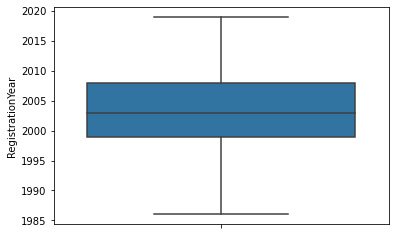

In [17]:
sns.boxplot(y=df_mod['RegistrationYear'], showfliers=False)
plt.show()

In [18]:
uq = df_mod[df_mod['RegistrationYear'].isin(range(1800, 1950))] \
    .groupby(by=['Brand', 'Model', 'RegistrationYear'])['Price'] \
    .count().reset_index()

In [19]:
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
    display(uq.sort_values(by=['Brand', 'RegistrationYear']))

,Brand,Model,RegistrationYear,Price
0,alfa_romeo,unknown,1910,2
1,audi,100,1910,1
2,audi,a2,1910,1
3,audi,a4,1910,1
4,audi,other,1910,1
5,audi,unknown,1910,2
6,bmw,3er,1910,2
9,bmw,unknown,1910,2
7,bmw,other,1929,3
8,bmw,other,1932,1


Будем исправлять данные на этом временном отрезке вуручную, поскольку тут могут встречаться как и корректные данные, так и данные с ошибками. Первую ошибку мы видим тут:

In [20]:
uq.loc[6,]

Brand                bmw
Model                3er
RegistrationYear    1910
Price                  2
Name: 6, dtype: object

Дело в том, что BMW (основанная в 1916 году) выпустила первую машину 3ей серии лишь в 1975 году. А следовательно она никак не могла быть призведена в 1910 году, а значит скорее всего имелась в виду машина 5ого поколения, вышедшая в 2010 году. Исправим эту ошибку:

In [21]:
df_mod.loc[(df_mod['Model'] == '3er') & (df_mod['RegistrationYear'] == 1910), 'RegistrationYear'] = 2010
df_mod[(df_mod['Model'] == '3er') & (df_mod['RegistrationYear'] == 1910)]

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q


Эту модель поправили, смотрим дальше. Следующая модель также вызывает вопросы:

In [22]:
uq.loc[10,]

Brand               chevrolet
Model                   spark
RegistrationYear         1930
Price                       1
Name: 10, dtype: object

Первая машина данной модели была запущенна в производство в 1998 году. А значит, год опять ошибочный, и мы не можешь угадать, по какой логике совершена ошибка (в отличие от предыдущего случая, где ошибка при вводе данных на 100 кажется вполне логичным объяснением). Отбросим данные об этой машине.

In [23]:
df_mod = df_mod[~((df_mod['Model'] == 'spark') & (df_mod['RegistrationYear'] == 1930))]
df_mod[(df_mod['Model'] == 'spark') & (df_mod['RegistrationYear'] == 1930)]

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q


Компания citroen основана в 1919 году. Скорее всего опять потеряли 100.

In [24]:
uq.loc[14,]

Brand               citroen
Model                 other
RegistrationYear       1910
Price                     1
Name: 14, dtype: object

In [25]:
df_mod.loc[(df_mod['Brand'] == 'citroen') & (df_mod['RegistrationYear'] == 1910), 'RegistrationYear'] = 2010
df_mod[(df_mod['Brand'] == 'citroen') & (df_mod['RegistrationYear'] == 1910)]

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q


Первая модель citroen c3 выпущена в 2002 году. Вряд ли эту машину купил док Браун и отправился в путешествие в далекий 1923, поэтому вычеркиваем.

In [26]:
uq.loc[13,]

Brand               citroen
Model                    c3
RegistrationYear       1923
Price                     2
Name: 13, dtype: object

In [27]:
df_mod = df_mod[~((df_mod['Brand'] == 'citroen') & (df_mod['RegistrationYear'] == 1923))]
df_mod[(df_mod['Brand'] == 'citroen') & (df_mod['RegistrationYear'] == 1923)]

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q


Фиат 1800 года звучит как раритет, но машина произведенная за 99 лет до появления этой марки в принципе звучит сомнительно. Да и в 1800 году не было даже автомобилей с двигателем внутреннего сгорания (появились в 1806 г). Соответственно с большой долей вероятности можно утверждать, что имелся в виду 1918 год (не 2018, поскольку выгрузка базы производилась в 2016 году). Исправим недоразумение:

In [28]:
uq.loc[19,]

Brand                fiat
Model               other
RegistrationYear     1800
Price                   1
Name: 19, dtype: object

In [29]:
df_mod.loc[(df_mod['Brand'] == 'fiat') & (df_mod['RegistrationYear'] == 1800), 'RegistrationYear'] = 1918
df_mod[(df_mod['Brand'] == 'fiat') & (df_mod['RegistrationYear'] == 1800)]

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q


Фиат "Пунто" запустили в производство только в 1993 году. Опять оишбочка.

In [30]:
uq.loc[21,]

Brand                fiat
Model               punto
RegistrationYear     1910
Price                   1
Name: 21, dtype: object

In [31]:
df_mod.loc[(df_mod['Model'] == 'punto') & (df_mod['RegistrationYear'] == 1910), 'RegistrationYear'] = 2010
df_mod[(df_mod['Model'] == 'punto') & (df_mod['RegistrationYear'] == 1910)]

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q


Какой бы легендарной ни была 500 модель фиата, но в производство попала только в 1957 году. Ошибка, причем не понятно какого типа, удаляем.

In [32]:
uq.loc[18,]

Brand               fiat
Model                500
RegistrationYear    1936
Price                  1
Name: 18, dtype: object

In [33]:
df_mod = df_mod[~((df_mod['Model'] == '500') & (df_mod['RegistrationYear'] == 1936))]
df_mod[(df_mod['Model'] == '500') & (df_mod['RegistrationYear'] == 1936)]

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q


Форд Эскорт появился в 1968 году и выпускался вплоть до 2003. Удаляем

In [34]:
uq.loc[24,]

Brand                 ford
Model               escort
RegistrationYear      1910
Price                    1
Name: 24, dtype: object

In [35]:
df_mod = df_mod[~((df_mod['Model'] == 'escort') & (df_mod['RegistrationYear'] == 1910))]
df_mod[(df_mod['Model'] == 'escort') & (df_mod['RegistrationYear'] == 1910)]

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q


Первый форд ка спустился с конвейра в 1996 году. Ошибка в 100 лет.

In [36]:
uq.loc[25,]

Brand               ford
Model                 ka
RegistrationYear    1910
Price                  2
Name: 25, dtype: object

In [37]:
df_mod.loc[(df_mod['Model'] == 'ka') & (df_mod['RegistrationYear'] == 1910), 'RegistrationYear'] = 2010
df_mod[(df_mod['Model'] == 'ka') & (df_mod['RegistrationYear'] == 1910)]

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q


Форд Мондео, опять на 100 лет ошиблись.

In [38]:
uq.loc[26,]

Brand                 ford
Model               mondeo
RegistrationYear      1910
Price                    2
Name: 26, dtype: object

In [39]:
df_mod.loc[(df_mod['Model'] == 'mondeo') & (df_mod['RegistrationYear'] == 1910), 'RegistrationYear'] = 2010
df_mod[(df_mod['Model'] == 'mondeo') & (df_mod['RegistrationYear'] == 1910)]

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q


Хёндай достаточно новая компания, основана в 1967 году. Обе попавшие машины с "сотой" ошибкой.

In [40]:
uq.loc[38:39,]

,Brand,Model,RegistrationYear,Price
38,hyundai,other,1910,1
39,hyundai,unknown,1910,1


In [41]:
df_mod.loc[(df_mod['Brand'] == 'hyundai') & (df_mod['RegistrationYear'] == 1910), 'RegistrationYear'] = 2010
df_mod[(df_mod['Brand'] == 'hyundai') & (df_mod['RegistrationYear'] == 1910)]

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q


Марка jeep официально зарегистрирована в 1943, но судя по всему они начали выпускать машины для армии немного раньше, поэтому исправим только одну машину из списка, остальные оставим в покое:

In [42]:
uq.loc[43,]

Brand                  jeep
Model               unknown
RegistrationYear       1910
Price                     1
Name: 43, dtype: object

In [43]:
df_mod.loc[(df_mod['Brand'] == 'jeep') & (df_mod['RegistrationYear'] == 1910), 'RegistrationYear'] = 2010
df_mod[(df_mod['Brand'] == 'jeep') & (df_mod['RegistrationYear'] == 1910)]

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q


Компания мерседес основана в 1926 году, gl-серия выпускается с 2006.

In [44]:
uq.loc[44:45,]

,Brand,Model,RegistrationYear,Price
44,mercedes_benz,gl,1910,1
45,mercedes_benz,other,1910,1


In [45]:
df_mod.loc[(df_mod['Brand'] == 'mercedes_benz') & (df_mod['RegistrationYear'] == 1910), 'RegistrationYear'] = 2010
df_mod[(df_mod['Brand'] == 'mercedes_benz') & (df_mod['RegistrationYear'] == 1910)]

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q


Mitsubishi motors основана в 1970 г. Опять ошибка на 100. Регистрация в 1800 тоже сомнительная история. Удалим

In [46]:
uq.loc[48:49,]

,Brand,Model,RegistrationYear,Price
48,mitsubishi,colt,1910,1
49,mitsubishi,unknown,1800,2


In [47]:
df_mod.loc[(df_mod['Brand'] == 'mitsubishi') & (df_mod['RegistrationYear'] == 1910), 'RegistrationYear'] = 2010
df_mod[(df_mod['Brand'] == 'mitsubishi') & (df_mod['RegistrationYear'] == 1910)]

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q


In [48]:
df_mod = df_mod[~((df_mod['Brand'] == 'mitsubishi') & (df_mod['RegistrationYear'] == 1800))]
df_mod[(df_mod['Brand'] == 'mitsubishi') & (df_mod['RegistrationYear'] == 1800)]

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q


Если коротко, то логика исправлений та же.

In [49]:
uq.loc[50:54,]

,Brand,Model,RegistrationYear,Price
50,opel,agila,1910,1
51,opel,astra,1945,1
52,opel,calibra,1910,1
53,opel,combo,1910,1
54,opel,corsa,1910,2


In [50]:
uq.loc[56,]

Brand                opel
Model               omega
RegistrationYear     1910
Price                   1
Name: 56, dtype: object

In [51]:
df_mod.loc[(df_mod['Model'].isin(['agila', 'calibra', 'combo', 'corsa', 'omega'])) & (df_mod['RegistrationYear'] == 1910), 'RegistrationYear'] = 2010
df_mod[(df_mod['Model'].isin(['agila', 'calibra', 'combo', 'corsa', 'omega'])) & (df_mod['RegistrationYear'] == 1910)]


,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q


Логика та же.

In [52]:
uq.loc[69,]

Brand               renault
Model                espace
RegistrationYear       1910
Price                     1
Name: 69, dtype: object

In [53]:
df_mod.loc[(df_mod['Model'].isin(['espace'])) & (df_mod['RegistrationYear'] == 1910), 'RegistrationYear'] = 2010
df_mod[(df_mod['Model'].isin(['espace'])) & (df_mod['RegistrationYear'] == 1910)]

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q


С категорией `'sonstige_autos'` все будет гораздо сложнее. Судя по всему, это <b>прицепы???</b> Адекватной информации я об этом не нашел, но в любом случае: у нас стоит задача оценить машины, насколько я понимаю прицепы не очень попадают в эту категорию из-за отсутствия, как минимум, ДВС. Выкидываем их.

In [54]:
df_mod = df_mod[~(df_mod['Brand'] == 'sonstige_autos')]
df_mod[(df_mod['Brand'] == 'sonstige_autos')]

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q


И toyota и subaru будут помоложе, предположим опять наша любимая ошибка на 100 лет.

In [55]:
uq.loc[87:88,]

,Brand,Model,RegistrationYear,Price
87,subaru,unknown,1910,1
88,toyota,unknown,1910,1


In [56]:
df_mod.loc[(df_mod['Brand'].isin(['subaru', 'toyota'])) & (df_mod['RegistrationYear'] == 1910), 'RegistrationYear'] = 2010
df_mod[(df_mod['Brand'].isin(['subaru', 'toyota'])) & (df_mod['RegistrationYear'] == 1910)]


,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q


С маркой `'trabant'` интересная история. Ныне данная марка не существует, машины этой мраки производились в период с 1957 по 1991. Поскольку всего у нас имеется информация о 583 продажах автомобилей данной марки мы можем пожертвовать этими 6, для которых возраст не указан.

In [57]:
uq.loc[89,]

Brand               trabant
Model               unknown
RegistrationYear       1910
Price                     6
Name: 89, dtype: object

In [60]:
df_mod = df_mod[~(df_mod['Brand'] == 'trabant') & ~(df_mod['RegistrationYear'] == 1910)]
df_mod[(df_mod['Brand'] == 'trabant') & (df_mod['RegistrationYear'] == 1910)]

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q


Volkswagen производит машины с 1937. Все что раньше - посчитаем за ошибку "100". 

In [61]:
uq.loc[90:95,]

,Brand,Model,RegistrationYear,Price
90,volkswagen,beetle,1910,1
91,volkswagen,caddy,1910,2
92,volkswagen,golf,1800,1
93,volkswagen,golf,1910,4
94,volkswagen,kaefer,1910,1
95,volkswagen,other,1910,1


In [62]:
uq.loc[98:101,]

,Brand,Model,RegistrationYear,Price
98,volkswagen,passat,1910,1
99,volkswagen,polo,1910,2
100,volkswagen,transporter,1910,1
101,volkswagen,unknown,1910,5


In [63]:
df_mod.loc[(df_mod['Brand'].isin(['volkswagen'])) & (df_mod['RegistrationYear'] == 1910), 'RegistrationYear'] = 2010
df_mod[(df_mod['Brand'].isin(['volkswagen'])) & (df_mod['RegistrationYear'] == 1910)]


,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q


In [64]:
df_mod = df_mod[~(df_mod['Brand'] == 'volkswagen') & ~(df_mod['RegistrationYear'] == 1800)]
df_mod[(df_mod['Brand'] == 'volkswagen') & (df_mod['RegistrationYear'] == 1800)]


,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q


Отсеем данные о регистрации с нереалистичными годами (примем за нереалистичные до 1800 поскольку до этого периода мы проработали данные, и после 2016, поскольку выгрузка была в 2016)

In [65]:
df_mod = df_mod[(df_mod['RegistrationYear'] <= 2016) & (df_mod['RegistrationYear'] >= 1800)]
df_mod['RegistrationYear'].unique()

array([2011, 2004, 2008, 1995, 2014, 2010, 2007, 2002, 1997, 1990, 2003,
       2016, 1991, 1984, 2006, 1999, 1998, 2012, 2005, 2000, 1992, 2001,
       2013, 1994, 2009, 1996, 1985, 2015, 1993, 1982, 1989, 1983, 1981,
       1969, 1971, 1986, 1988, 1980, 1965, 1987, 1974, 1955, 1970, 1978,
       1976, 1979, 1972, 1968, 1977, 1960, 1975, 1966, 1954, 1961, 1973,
       1964, 1967, 1949, 1940, 1963, 1937, 1951, 1959, 1953, 1958, 1956,
       1962, 1945, 1933, 1950, 1952, 1932, 1942, 1935, 1957, 1930, 1929,
       1943, 1934, 1938, 1936, 1928, 1941, 1919, 1948, 1931, 1947, 1927,
       1918], dtype=int64)

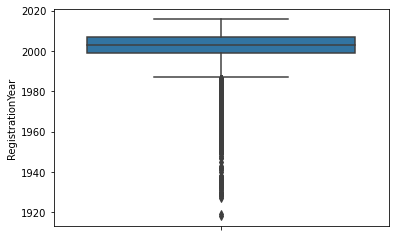

In [66]:
sns.boxplot(y=df_mod['RegistrationYear'])
plt.show()

Теперь данные о годах регистрации автомобилей предположительно верны. Перейдем к изучению данных о цене.

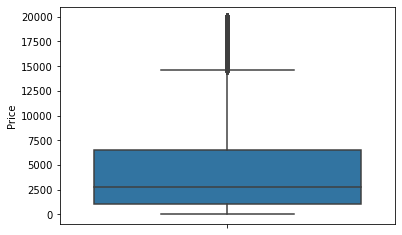

In [67]:
sns.boxplot(y=df_mod['Price'])
plt.show()

In [68]:
df_mod['Price'].describe()

count    262792.000000
mean       4478.422669
std        4547.397148
min           0.000000
25%        1100.000000
50%        2800.000000
75%        6500.000000
max       20000.000000
Name: Price, dtype: float64

Бесплатные автомобили? Тоже так хочу! (Конечно удаляем)

In [69]:
df_mod = df_mod[~(df_mod['Price'] == 0)]

df_mod['Price'].describe()

count    255731.000000
mean       4602.076596
std        4547.605945
min           1.000000
25%        1200.000000
50%        2900.000000
75%        6550.000000
max       20000.000000
Name: Price, dtype: float64

Машины за 1 евро? Дайте две. Начнем считать цены хотя бы со 1000 евро. Остальное выкинем.

In [70]:
df_mod = df_mod[(df_mod['Price'] >= 1000)]

df_mod['Price'].describe()

count    201696.000000
mean       5679.817156
std        4550.227252
min        1000.000000
25%        2100.000000
50%        4000.000000
75%        7900.000000
max       20000.000000
Name: Price, dtype: float64

Изучим последний значимый для нас параметр: мощность (`'Power'`)

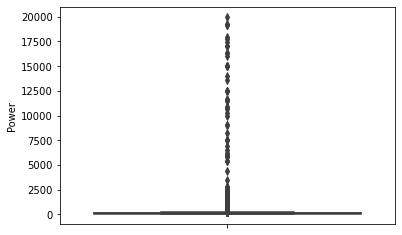

In [71]:
sns.boxplot(y=df_mod['Power'])
plt.show()

In [72]:
df_mod['Power'].describe()

count    201696.000000
mean        127.356988
std         201.897695
min           0.000000
25%          84.000000
50%         120.000000
75%         160.000000
max       20000.000000
Name: Power, dtype: float64

Поскольку мои познания в автомобилях стремятся к 0, отсеем суммарно 10% с краев, причем 7% с меньшей стороны и 3% с большей.

In [73]:
pd.qcut(df_mod['Power'], [0.07, 0.93])

1         (17.999, 220.0]
2         (17.999, 220.0]
4         (17.999, 220.0]
6         (17.999, 220.0]
8         (17.999, 220.0]
               ...       
354360                NaN
354361    (17.999, 220.0]
354362                NaN
354363                NaN
354366    (17.999, 220.0]
Name: Power, Length: 201696, dtype: category
Categories (1, interval[float64, right]): [(17.999, 220.0]]

Что ж, будем считать за машины только те нечто, что имеют мощность от 27 и до 220 л.с.

In [74]:
df_mod = df_mod[(df_mod['Power'] >= 27) & (df_mod['Power'] <= 220)]

df_mod['Power'].describe()

count    173897.000000
mean        123.117259
std          41.141657
min          27.000000
25%          90.000000
50%         120.000000
75%         150.000000
max         220.000000
Name: Power, dtype: float64

In [75]:
df_mod.duplicated().sum()

3

In [76]:
df_mod[df_mod.duplicated()]

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q
171088,2016-03-08 18:42:48,1799,coupe,1999,auto,193,clk,20000,7,petrol,mercedes_benz,no,2016-03-08,0,89518,2016-03-09 09:46:57,3,2016,2,0
231258,2016-03-28 00:56:10,1000,small,2002,manual,83,other,150000,1,petrol,suzuki,no,2016-03-28,0,66589,2016-03-28 08:46:21,3,2016,0,0
258109,2016-04-03 09:01:15,4699,coupe,2003,auto,218,clk,125000,6,petrol,mercedes_benz,yes,2016-04-03,0,75196,2016-04-07 09:44:54,4,2016,1,1


In [77]:
df_mod = df_mod.drop_duplicates()
df_mod.duplicated().sum()

0

In [78]:
df_mod.head(10)

,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,Brand,NotRepaired,DateCreated,NumberOfPictures,PostalCode,LastSeen,CreatedMonth,CreatedYear,RegistrationMonth_q,CreatedMonth_q
1,2016-03-24 10:58:45,18300,coupe,2011,manual,190,unknown,125000,5,gasoline,audi,yes,2016-03-24,0,66954,2016-04-07 01:46:50,3,2016,1,0
2,2016-03-14 12:52:21,9800,suv,2004,auto,163,grand,125000,8,gasoline,jeep,unknown,2016-03-14,0,90480,2016-04-05 12:47:46,3,2016,2,0
4,2016-03-31 17:25:20,3600,small,2008,manual,69,fabia,90000,7,gasoline,skoda,no,2016-03-31,0,60437,2016-04-06 10:17:21,3,2016,2,0
6,2016-04-01 20:48:51,2200,convertible,2004,manual,109,2_reihe,150000,8,petrol,peugeot,no,2016-04-01,0,67112,2016-04-05 18:18:39,4,2016,2,1
8,2016-04-04 23:42:13,14500,bus,2014,manual,125,c_max,30000,8,petrol,ford,unknown,2016-04-04,0,94505,2016-04-04 23:42:13,4,2016,2,1
10,2016-03-26 19:54:18,2000,sedan,2004,manual,105,3_reihe,150000,12,petrol,mazda,no,2016-03-26,0,96224,2016-04-06 10:45:34,3,2016,3,0
14,2016-03-21 12:57:01,17999,suv,2011,manual,190,navara,70000,3,gasoline,nissan,no,2016-03-21,0,4177,2016-04-06 07:45:42,3,2016,0,0
17,2016-03-20 10:25:19,1750,small,2004,auto,75,twingo,150000,2,petrol,renault,no,2016-03-20,0,65599,2016-04-06 13:16:07,3,2016,0,0
18,2016-03-23 15:48:05,7550,bus,2007,manual,136,c_max,150000,6,gasoline,ford,no,2016-03-23,0,88361,2016-04-05 18:45:11,3,2016,1,0
19,2016-04-01 22:55:47,1850,bus,2004,manual,102,a_klasse,150000,1,petrol,mercedes_benz,no,2016-04-01,0,49565,2016-04-05 22:46:05,4,2016,0,1


Теперь закодируем категориальные данные. 

In [79]:
cat_data = ['VehicleType', 'Gearbox', 'FuelType', 'Brand', 'NotRepaired', 'RegistrationMonth_q', 'CreatedMonth_q', 'Model']

gd = pd.get_dummies(df_mod[cat_data], drop_first=True)

df_mod = df_mod.join(gd, rsuffix='_')

df_mod


,DateCrawled,Price,VehicleType,RegistrationYear,Gearbox,Power,Model,Kilometer,RegistrationMonth,FuelType,...,Model_wrangler,Model_x_reihe,Model_x_trail,Model_x_type,Model_xc_reihe,Model_yaris,Model_yeti,Model_ypsilon,Model_z_reihe,Model_zafira
1,2016-03-24 10:58:45,18300,coupe,2011,manual,190,unknown,125000,5,gasoline,...,0,0,0,0,0,0,0,0,0,0
2,2016-03-14 12:52:21,9800,suv,2004,auto,163,grand,125000,8,gasoline,...,0,0,0,0,0,0,0,0,0,0
4,2016-03-31 17:25:20,3600,small,2008,manual,69,fabia,90000,7,gasoline,...,0,0,0,0,0,0,0,0,0,0
6,2016-04-01 20:48:51,2200,convertible,2004,manual,109,2_reihe,150000,8,petrol,...,0,0,0,0,0,0,0,0,0,0
8,2016-04-04 23:42:13,14500,bus,2014,manual,125,c_max,30000,8,petrol,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
354353,2016-03-31 18:50:37,1999,sedan,1997,manual,150,a3,150000,12,petrol,...,0,0,0,0,0,0,0,0,0,0
354355,2016-03-21 15:36:22,4400,sedan,2008,manual,105,leon,150000,7,gasoline,...,0,0,0,0,0,0,0,0,0,0
354357,2016-03-09 11:36:55,1690,wagon,2004,manual,55,fabia,150000,4,petrol,...,0,0,0,0,0,0,0,0,0,0
354361,2016-03-09 13:37:43,5250,sedan,2016,auto,150,159,150000,12,unknown,...,0,0,0,0,0,0,0,0,0,0


Что ж... Теперь наши данные готовы к обучению моделей.

## Обучение моделей

Для начала разделим выборку на обучающую и тестовую.

In [80]:
defienetly_not_usefull = ['DateCrawled', 'DateCreated', 'NumberOfPictures', 'PostalCode', 'LastSeen', 'CreatedMonth', 'CreatedYear', 'RegistrationMonth']

features_list = df_mod.columns.to_list()

for el in cat_data:
    features_list.remove(el)

for el in defienetly_not_usefull:
    features_list.remove(el)

features_list.remove('Price')

target_list = ['Price']


In [81]:
features = df_mod[features_list]
target = df_mod[target_list]

In [82]:
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=432)

Закодируем количественные признаки.

In [83]:
scaler = StandardScaler()
scaler.fit(X_train[['Power', 'Kilometer', 'RegistrationYear']])
X_train[['Power', 'Kilometer', 'RegistrationYear']] = scaler.transform(X_train[['Power', 'Kilometer', 'RegistrationYear']])
X_test[['Power', 'Kilometer', 'RegistrationYear']] = scaler.transform(X_test[['Power', 'Kilometer', 'RegistrationYear']])


In [84]:
display(X_train.shape)
display(X_test.shape)
display(y_train.shape)
display(y_test.shape)

(139115, 283)

(34779, 283)

(139115, 1)

(34779, 1)

Сделано. По порядку рассмотрим все изученные на данный момент модели: LinearRegression, DecisionTreeRegressor, RandomForestRegressor, KNeighborsRegressor, LGBMRegressor, CatBoostRegressor. Разумеется с использованием кросс-валидации.

In [85]:
res = {}

In [86]:
%%time

model_lr = LinearRegression()

a = time.time()

model_lr.fit(X_train, y_train)

b = time.time()
t_lr = round((b - a), 2)

lr_score = cross_val_score(model_lr, X_train, y_train, cv=5, scoring='neg_root_mean_squared_error')
lr_res = lr_score.mean()
res['Linear Regression'] = [abs(lr_res), t_lr]

print(lr_score.mean())

-2541.1500421925457
CPU times: total: 46.6 s
Wall time: 9.86 s


In [87]:
%%time

params_dr = {'max_depth': range(1, 10, 1)}

model_dr = GridSearchCV(DecisionTreeRegressor(random_state=432), 
                    param_grid = params_dr, 
                    cv=5,
                    scoring='neg_root_mean_squared_error',
                    verbose=2
                    )
model_dr.fit(X_train, y_train)

a = time.time()

model_dr.best_estimator_.fit(X_train, y_train)

b = time.time()
t_dr = round((b - a), 2)

dr_res = model_dr.best_score_
print('\n',model_dr.best_score_)
print(model_dr.best_params_)
res['Decision Tree Regressor'] = [dr_res, t_dr]

Fitting 5 folds for each of 9 candidates, totalling 45 fits
[CV] END ........................................max_depth=1; total time=   0.4s
[CV] END ........................................max_depth=1; total time=   0.3s
[CV] END ........................................max_depth=1; total time=   0.3s
[CV] END ........................................max_depth=1; total time=   0.3s
[CV] END ........................................max_depth=1; total time=   0.3s
[CV] END ........................................max_depth=2; total time=   0.5s
[CV] END ........................................max_depth=2; total time=   0.5s
[CV] END ........................................max_depth=2; total time=   0.5s
[CV] END ........................................max_depth=2; total time=   0.5s
[CV] END ........................................max_depth=2; total time=   0.5s
[CV] END ........................................max_depth=3; total time=   0.8s
[CV] END ........................................

In [88]:
%%time

params_rf = {'max_depth': range(1, 5, 1),
            'n_estimators': range(10, 100, 10)}

model_rf = GridSearchCV(RandomForestRegressor(), 
                    param_grid = params_rf, 
                    cv=5,
                    scoring='neg_root_mean_squared_error',
                    verbose=2
                    )

model_rf.fit(X_train, y_train.values.ravel())

a = time.time()

model_rf.best_estimator_.fit(X_train, y_train.values.ravel())

b = time.time()
t_rf = round((b - a), 2)

rf_res = model_rf.best_score_
print('\n',model_rf.best_score_)
print(model_rf.best_params_)
res['Random Forest Regressor'] = [rf_res, t_rf]

Fitting 5 folds for each of 36 candidates, totalling 180 fits
[CV] END .......................max_depth=1, n_estimators=10; total time=   1.1s
[CV] END .......................max_depth=1, n_estimators=10; total time=   1.1s
[CV] END .......................max_depth=1, n_estimators=10; total time=   1.2s
[CV] END .......................max_depth=1, n_estimators=10; total time=   1.1s
[CV] END .......................max_depth=1, n_estimators=10; total time=   1.2s
[CV] END .......................max_depth=1, n_estimators=20; total time=   2.3s
[CV] END .......................max_depth=1, n_estimators=20; total time=   2.2s
[CV] END .......................max_depth=1, n_estimators=20; total time=   2.1s
[CV] END .......................max_depth=1, n_estimators=20; total time=   2.1s
[CV] END .......................max_depth=1, n_estimators=20; total time=   2.1s
[CV] END .......................max_depth=1, n_estimators=30; total time=   3.1s
[CV] END .......................max_depth=1, n_

[CV] END .......................max_depth=3, n_estimators=30; total time=   9.9s
[CV] END .......................max_depth=3, n_estimators=30; total time=  10.2s
[CV] END .......................max_depth=3, n_estimators=30; total time=  10.3s
[CV] END .......................max_depth=3, n_estimators=30; total time=  10.0s
[CV] END .......................max_depth=3, n_estimators=40; total time=  13.5s
[CV] END .......................max_depth=3, n_estimators=40; total time=  14.0s
[CV] END .......................max_depth=3, n_estimators=40; total time=  13.6s
[CV] END .......................max_depth=3, n_estimators=40; total time=  14.0s
[CV] END .......................max_depth=3, n_estimators=40; total time=  13.5s
[CV] END .......................max_depth=3, n_estimators=50; total time=  17.2s
[CV] END .......................max_depth=3, n_estimators=50; total time=  16.7s
[CV] END .......................max_depth=3, n_estimators=50; total time=  17.2s
[CV] END ...................

In [89]:
%%time

params_knr = {'n_neighbors': range(5, 15, 1)}

model_knr = GridSearchCV(KNeighborsRegressor(), 
                    param_grid = params_knr, 
                    cv=5,
                    scoring='neg_root_mean_squared_error',
                    verbose=2
                    )

model_knr.fit(X_train, y_train)

a = time.time()

model_knr.best_estimator_.fit(X_train, y_train)

b = time.time()
t_knr = round((b - a), 2)

knr_res = model_knr.best_score_
print('\n',model_knr.best_score_)
print(model_knr.best_params_)
res['KNeighbors Regressor'] = [knr_res, t_knr]

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END ......................................n_neighbors=5; total time=  54.4s
[CV] END ......................................n_neighbors=5; total time=  55.0s
[CV] END ......................................n_neighbors=5; total time=  52.0s
[CV] END ......................................n_neighbors=5; total time=  52.0s
[CV] END ......................................n_neighbors=5; total time=  52.9s
[CV] END ......................................n_neighbors=6; total time=  49.1s
[CV] END ......................................n_neighbors=6; total time=  54.2s
[CV] END ......................................n_neighbors=6; total time=  53.4s
[CV] END ......................................n_neighbors=6; total time=  52.9s
[CV] END ......................................n_neighbors=6; total time=  54.6s
[CV] END ......................................n_neighbors=7; total time=  51.5s
[CV] END ......................................n

In [90]:
params_lgb = {
    'n_estimators': [100, 500, 1000, 1500],
    'max_depth': [3, 4, 5, 7],
    'learning_rate': [0.01, 0.1, 0.15, 0.2]
    }


model_lgb = GridSearchCV(LGBMRegressor(), 
                    param_grid = params_lgb, 
                    cv=5,
                    scoring='neg_root_mean_squared_error',
                    verbose=2
                    )

model_lgb.fit(X_train, y_train)

a = time.time()

model_lgb.best_estimator_.fit(X_train, y_train)

b = time.time()
t_lgb = round((b - a), 2)

lgb_res = model_lgb.best_score_
print(model_lgb.best_score_)
print(model_lgb.best_params_)
res['LGBM Regressor'] = [lgb_res, t_lgb]

Fitting 5 folds for each of 64 candidates, totalling 320 fits
[CV] END ..learning_rate=0.01, max_depth=3, n_estimators=100; total time=   0.8s
[CV] END ..learning_rate=0.01, max_depth=3, n_estimators=100; total time=   0.8s
[CV] END ..learning_rate=0.01, max_depth=3, n_estimators=100; total time=   0.7s
[CV] END ..learning_rate=0.01, max_depth=3, n_estimators=100; total time=   0.7s
[CV] END ..learning_rate=0.01, max_depth=3, n_estimators=100; total time=   0.7s
[CV] END ..learning_rate=0.01, max_depth=3, n_estimators=500; total time=   1.7s
[CV] END ..learning_rate=0.01, max_depth=3, n_estimators=500; total time=   1.2s
[CV] END ..learning_rate=0.01, max_depth=3, n_estimators=500; total time=   1.2s
[CV] END ..learning_rate=0.01, max_depth=3, n_estimators=500; total time=   1.2s
[CV] END ..learning_rate=0.01, max_depth=3, n_estimators=500; total time=   1.2s
[CV] END .learning_rate=0.01, max_depth=3, n_estimators=1000; total time=   1.9s
[CV] END .learning_rate=0.01, max_depth=3, n_es

[CV] END ...learning_rate=0.1, max_depth=4, n_estimators=100; total time=   0.8s
[CV] END ...learning_rate=0.1, max_depth=4, n_estimators=100; total time=   0.7s
[CV] END ...learning_rate=0.1, max_depth=4, n_estimators=100; total time=   0.7s
[CV] END ...learning_rate=0.1, max_depth=4, n_estimators=100; total time=   0.7s
[CV] END ...learning_rate=0.1, max_depth=4, n_estimators=500; total time=   1.3s
[CV] END ...learning_rate=0.1, max_depth=4, n_estimators=500; total time=   1.3s
[CV] END ...learning_rate=0.1, max_depth=4, n_estimators=500; total time=   1.2s
[CV] END ...learning_rate=0.1, max_depth=4, n_estimators=500; total time=   1.3s
[CV] END ...learning_rate=0.1, max_depth=4, n_estimators=500; total time=   1.4s
[CV] END ..learning_rate=0.1, max_depth=4, n_estimators=1000; total time=   2.2s
[CV] END ..learning_rate=0.1, max_depth=4, n_estimators=1000; total time=   2.6s
[CV] END ..learning_rate=0.1, max_depth=4, n_estimators=1000; total time=   2.6s
[CV] END ..learning_rate=0.1

[CV] END ..learning_rate=0.15, max_depth=5, n_estimators=100; total time=   0.8s
[CV] END ..learning_rate=0.15, max_depth=5, n_estimators=100; total time=   0.7s
[CV] END ..learning_rate=0.15, max_depth=5, n_estimators=500; total time=   1.4s
[CV] END ..learning_rate=0.15, max_depth=5, n_estimators=500; total time=   1.4s
[CV] END ..learning_rate=0.15, max_depth=5, n_estimators=500; total time=   1.4s
[CV] END ..learning_rate=0.15, max_depth=5, n_estimators=500; total time=   1.4s
[CV] END ..learning_rate=0.15, max_depth=5, n_estimators=500; total time=   1.4s
[CV] END .learning_rate=0.15, max_depth=5, n_estimators=1000; total time=   2.7s
[CV] END .learning_rate=0.15, max_depth=5, n_estimators=1000; total time=   3.6s
[CV] END .learning_rate=0.15, max_depth=5, n_estimators=1000; total time=   2.4s
[CV] END .learning_rate=0.15, max_depth=5, n_estimators=1000; total time=   2.2s
[CV] END .learning_rate=0.15, max_depth=5, n_estimators=1000; total time=   2.2s
[CV] END .learning_rate=0.15

[CV] END ...learning_rate=0.2, max_depth=7, n_estimators=500; total time=   1.5s
[CV] END ...learning_rate=0.2, max_depth=7, n_estimators=500; total time=   1.6s
[CV] END ...learning_rate=0.2, max_depth=7, n_estimators=500; total time=   1.8s
[CV] END ...learning_rate=0.2, max_depth=7, n_estimators=500; total time=   1.6s
[CV] END ...learning_rate=0.2, max_depth=7, n_estimators=500; total time=   1.6s
[CV] END ..learning_rate=0.2, max_depth=7, n_estimators=1000; total time=   3.1s
[CV] END ..learning_rate=0.2, max_depth=7, n_estimators=1000; total time=   3.3s
[CV] END ..learning_rate=0.2, max_depth=7, n_estimators=1000; total time=   2.7s
[CV] END ..learning_rate=0.2, max_depth=7, n_estimators=1000; total time=   2.7s
[CV] END ..learning_rate=0.2, max_depth=7, n_estimators=1000; total time=   2.7s
[CV] END ..learning_rate=0.2, max_depth=7, n_estimators=1500; total time=   3.7s
[CV] END ..learning_rate=0.2, max_depth=7, n_estimators=1500; total time=   3.7s
[CV] END ..learning_rate=0.2

In [91]:
params_cb = {
    'iterations': range(10, 200, 10),
    'depth': [1, 2, 3, 4, 5],
    'learning_rate': [0.01, 0.1, 0.15, 0.2, 0.25, 0.3]
    }


model_cb = GridSearchCV(CatBoostRegressor(loss_function='RMSE'), 
                    param_grid = params_cb, 
                    cv=5,
                    scoring='neg_root_mean_squared_error',
                    verbose=0
                    )
model_cb.fit(X_train, y_train)

a = time.time()

model_cb.best_estimator_.fit(X_train, y_train)

b = time.time()
t_cb = round((b - a), 2)

cb_res = model_cb.best_score_
print(model_cb.best_score_)
print(model_cb.best_params_)
res['CatBoost Regressor'] = [cb_res, t_cb]

0:	learn: 4298.5831268	total: 141ms	remaining: 1.27s
1:	learn: 4283.3213210	total: 144ms	remaining: 575ms
2:	learn: 4268.3102532	total: 147ms	remaining: 344ms
3:	learn: 4253.5464819	total: 151ms	remaining: 226ms
4:	learn: 4239.2094229	total: 155ms	remaining: 155ms
5:	learn: 4225.1104412	total: 158ms	remaining: 105ms
6:	learn: 4211.2462041	total: 161ms	remaining: 69.1ms
7:	learn: 4197.6134091	total: 165ms	remaining: 41.2ms
8:	learn: 4183.8764178	total: 168ms	remaining: 18.7ms
9:	learn: 4170.3688676	total: 172ms	remaining: 0us
0:	learn: 4291.3213847	total: 3.89ms	remaining: 35ms
1:	learn: 4276.2062319	total: 7.68ms	remaining: 30.7ms
2:	learn: 4261.3398268	total: 10.9ms	remaining: 25.4ms
3:	learn: 4246.7187445	total: 14.2ms	remaining: 21.3ms
4:	learn: 4232.4636340	total: 17.9ms	remaining: 17.9ms
5:	learn: 4218.2825259	total: 21.6ms	remaining: 14.4ms
6:	learn: 4204.3371893	total: 25.2ms	remaining: 10.8ms
7:	learn: 4190.7077143	total: 28.1ms	remaining: 7.03ms
8:	learn: 4177.3062934	total: 3

0:	learn: 4019.6123665	total: 4.22ms	remaining: 38ms
1:	learn: 3815.3623048	total: 8.51ms	remaining: 34ms
2:	learn: 3664.5257173	total: 12ms	remaining: 28.1ms
3:	learn: 3552.6532121	total: 15.2ms	remaining: 22.8ms
4:	learn: 3441.8596479	total: 19.3ms	remaining: 19.3ms
5:	learn: 3355.9488646	total: 23.6ms	remaining: 15.7ms
6:	learn: 3273.1059258	total: 27.4ms	remaining: 11.8ms
7:	learn: 3200.0348546	total: 30.6ms	remaining: 7.65ms
8:	learn: 3132.8444667	total: 34.3ms	remaining: 3.81ms
9:	learn: 3082.3225290	total: 39.2ms	remaining: 0us
0:	learn: 4006.6271859	total: 3.69ms	remaining: 33.2ms
1:	learn: 3804.4366070	total: 7.19ms	remaining: 28.8ms
2:	learn: 3654.7630068	total: 10.9ms	remaining: 25.4ms
3:	learn: 3542.0567589	total: 14.4ms	remaining: 21.6ms
4:	learn: 3433.1394802	total: 18.1ms	remaining: 18.1ms
5:	learn: 3348.3747888	total: 22.1ms	remaining: 14.7ms
6:	learn: 3267.6832140	total: 27ms	remaining: 11.6ms
7:	learn: 3194.9528354	total: 30.6ms	remaining: 7.65ms
8:	learn: 3125.077231

0:	learn: 4291.3213847	total: 4.57ms	remaining: 86.8ms
1:	learn: 4276.2062319	total: 8.56ms	remaining: 77ms
2:	learn: 4261.3398268	total: 11.6ms	remaining: 65.6ms
3:	learn: 4246.7187445	total: 15ms	remaining: 59.9ms
4:	learn: 4232.4636340	total: 18.7ms	remaining: 56.1ms
5:	learn: 4218.2825259	total: 23.2ms	remaining: 54ms
6:	learn: 4204.3371893	total: 26.6ms	remaining: 49.5ms
7:	learn: 4190.7077143	total: 29.6ms	remaining: 44.3ms
8:	learn: 4177.3062934	total: 33.2ms	remaining: 40.6ms
9:	learn: 4163.9724733	total: 36.9ms	remaining: 36.9ms
10:	learn: 4150.8624167	total: 40.8ms	remaining: 33.4ms
11:	learn: 4137.9729292	total: 43.7ms	remaining: 29.2ms
12:	learn: 4125.4626002	total: 47.4ms	remaining: 25.5ms
13:	learn: 4112.9672703	total: 51.6ms	remaining: 22.1ms
14:	learn: 4100.6650546	total: 55.8ms	remaining: 18.6ms
15:	learn: 4088.5561020	total: 59.2ms	remaining: 14.8ms
16:	learn: 4076.6532009	total: 62.9ms	remaining: 11.1ms
17:	learn: 4064.9024238	total: 66.7ms	remaining: 7.41ms
18:	lear

0:	learn: 4150.4812810	total: 4.75ms	remaining: 90.3ms
1:	learn: 4021.8201208	total: 9.5ms	remaining: 85.5ms
2:	learn: 3913.8013195	total: 13.4ms	remaining: 75.9ms
3:	learn: 3822.1208260	total: 17.9ms	remaining: 71.7ms
4:	learn: 3743.4800859	total: 22.2ms	remaining: 66.5ms
5:	learn: 3676.4001671	total: 26.8ms	remaining: 62.5ms
6:	learn: 3617.2243738	total: 30.4ms	remaining: 56.5ms
7:	learn: 3556.7057596	total: 34.8ms	remaining: 52.2ms
8:	learn: 3503.9786258	total: 39.8ms	remaining: 48.6ms
9:	learn: 3453.3306990	total: 43.3ms	remaining: 43.3ms
10:	learn: 3406.5538609	total: 47.9ms	remaining: 39.2ms
11:	learn: 3363.3770785	total: 51.6ms	remaining: 34.4ms
12:	learn: 3322.5161928	total: 56.6ms	remaining: 30.5ms
13:	learn: 3283.6765135	total: 60.4ms	remaining: 25.9ms
14:	learn: 3246.4819261	total: 64.3ms	remaining: 21.4ms
15:	learn: 3213.4946218	total: 68.8ms	remaining: 17.2ms
16:	learn: 3181.7141782	total: 73ms	remaining: 12.9ms
17:	learn: 3151.6363262	total: 76.4ms	remaining: 8.49ms
18:	l

0:	learn: 4006.6271859	total: 4.65ms	remaining: 88.3ms
1:	learn: 3804.4366070	total: 8.48ms	remaining: 76.3ms
2:	learn: 3654.7630068	total: 12.3ms	remaining: 69.8ms
3:	learn: 3542.0567589	total: 16.4ms	remaining: 65.7ms
4:	learn: 3433.1394802	total: 21.1ms	remaining: 63.4ms
5:	learn: 3348.3747888	total: 24.9ms	remaining: 58.1ms
6:	learn: 3267.6832140	total: 28.8ms	remaining: 53.6ms
7:	learn: 3194.9528354	total: 33.2ms	remaining: 49.9ms
8:	learn: 3125.0772315	total: 38ms	remaining: 46.4ms
9:	learn: 3074.4706952	total: 42.9ms	remaining: 42.9ms
10:	learn: 3024.8275398	total: 47.9ms	remaining: 39.2ms
11:	learn: 2980.4867497	total: 54.1ms	remaining: 36.1ms
12:	learn: 2940.1785176	total: 58ms	remaining: 31.2ms
13:	learn: 2902.2841523	total: 63ms	remaining: 27ms
14:	learn: 2871.3384638	total: 67.7ms	remaining: 22.6ms
15:	learn: 2839.9390898	total: 72.1ms	remaining: 18ms
16:	learn: 2812.2396629	total: 76.4ms	remaining: 13.5ms
17:	learn: 2789.7085527	total: 81.2ms	remaining: 9.02ms
18:	learn: 2

0:	learn: 3896.9999185	total: 3.32ms	remaining: 63.1ms
1:	learn: 3655.2336983	total: 6.47ms	remaining: 58.2ms
2:	learn: 3493.9467794	total: 10.1ms	remaining: 57.5ms
3:	learn: 3339.4826255	total: 13.7ms	remaining: 54.8ms
4:	learn: 3226.5086025	total: 17.8ms	remaining: 53.4ms
5:	learn: 3125.7509890	total: 21.2ms	remaining: 49.4ms
6:	learn: 3048.6652658	total: 24.2ms	remaining: 44.9ms
7:	learn: 2973.7567659	total: 27.9ms	remaining: 41.9ms
8:	learn: 2916.9611061	total: 31.2ms	remaining: 38.1ms
9:	learn: 2867.5274343	total: 35.7ms	remaining: 35.7ms
10:	learn: 2828.8240603	total: 38.8ms	remaining: 31.7ms
11:	learn: 2794.2507294	total: 42.9ms	remaining: 28.6ms
12:	learn: 2761.8531200	total: 46.2ms	remaining: 24.9ms
13:	learn: 2727.3092839	total: 50.4ms	remaining: 21.6ms
14:	learn: 2696.4748091	total: 53.9ms	remaining: 18ms
15:	learn: 2673.4977636	total: 57.6ms	remaining: 14.4ms
16:	learn: 2652.1460756	total: 60.8ms	remaining: 10.7ms
17:	learn: 2631.6691964	total: 65ms	remaining: 7.22ms
18:	le

0:	learn: 4277.1072145	total: 3.34ms	remaining: 96.8ms
1:	learn: 4262.0598641	total: 6.21ms	remaining: 86.9ms
2:	learn: 4247.2602069	total: 9.16ms	remaining: 82.5ms
3:	learn: 4232.7048312	total: 12.5ms	remaining: 81.4ms
4:	learn: 4218.3903551	total: 16.9ms	remaining: 84.4ms
5:	learn: 4204.3134269	total: 20.6ms	remaining: 82.4ms
6:	learn: 4190.4707254	total: 23.4ms	remaining: 77ms
7:	learn: 4176.9296827	total: 26.5ms	remaining: 73ms
8:	learn: 4163.6153525	total: 30.4ms	remaining: 71ms
9:	learn: 4150.3801200	total: 34.3ms	remaining: 68.5ms
10:	learn: 4137.3671680	total: 37.8ms	remaining: 65.3ms
11:	learn: 4124.5733185	total: 41ms	remaining: 61.6ms
12:	learn: 4112.1842267	total: 44.5ms	remaining: 58.2ms
13:	learn: 4099.7819033	total: 48.5ms	remaining: 55.4ms
14:	learn: 4087.5596142	total: 52.1ms	remaining: 52.1ms
15:	learn: 4075.5410735	total: 55.1ms	remaining: 48.2ms
16:	learn: 4063.7271951	total: 59.4ms	remaining: 45.4ms
17:	learn: 4052.0527955	total: 63.1ms	remaining: 42.1ms
18:	learn:

0:	learn: 4144.0353204	total: 4.52ms	remaining: 131ms
1:	learn: 4019.8410806	total: 7.64ms	remaining: 107ms
2:	learn: 3915.1265550	total: 10.8ms	remaining: 97ms
3:	learn: 3820.5086393	total: 14.2ms	remaining: 92.1ms
4:	learn: 3742.1133856	total: 18.2ms	remaining: 90.9ms
5:	learn: 3676.7786454	total: 22.1ms	remaining: 88.5ms
6:	learn: 3615.8814897	total: 25.1ms	remaining: 82.4ms
7:	learn: 3555.8950011	total: 28.6ms	remaining: 78.6ms
8:	learn: 3504.0037803	total: 31.9ms	remaining: 74.3ms
9:	learn: 3454.1770731	total: 37.3ms	remaining: 74.7ms
10:	learn: 3407.2958383	total: 40.4ms	remaining: 69.8ms
11:	learn: 3364.3556045	total: 43.9ms	remaining: 65.8ms
12:	learn: 3322.7876466	total: 47ms	remaining: 61.4ms
13:	learn: 3284.3335719	total: 51.4ms	remaining: 58.7ms
14:	learn: 3248.1688153	total: 54.9ms	remaining: 54.9ms
15:	learn: 3214.0468977	total: 57.8ms	remaining: 50.6ms
16:	learn: 3181.1726403	total: 61.6ms	remaining: 47.1ms
17:	learn: 3151.9949027	total: 65.7ms	remaining: 43.8ms
18:	lear

0:	learn: 4073.8895667	total: 3.97ms	remaining: 115ms
1:	learn: 3904.7989766	total: 6.77ms	remaining: 94.8ms
2:	learn: 3769.3131907	total: 10.8ms	remaining: 97.3ms
3:	learn: 3666.4041728	total: 15.1ms	remaining: 98.3ms
4:	learn: 3579.6776204	total: 20.5ms	remaining: 102ms
5:	learn: 3493.6158022	total: 24.4ms	remaining: 97.7ms
6:	learn: 3418.4273743	total: 29.1ms	remaining: 95.6ms
7:	learn: 3349.8243610	total: 33.8ms	remaining: 93.1ms
8:	learn: 3294.5610191	total: 38.6ms	remaining: 90.2ms
9:	learn: 3241.5893023	total: 42.9ms	remaining: 85.8ms
10:	learn: 3187.9600284	total: 46.7ms	remaining: 80.7ms
11:	learn: 3137.4256795	total: 52.4ms	remaining: 78.7ms
12:	learn: 3097.3522198	total: 56.2ms	remaining: 73.5ms
13:	learn: 3059.9987285	total: 60ms	remaining: 68.6ms
14:	learn: 3024.6468792	total: 64.6ms	remaining: 64.6ms
15:	learn: 2991.1493650	total: 69.6ms	remaining: 60.9ms
16:	learn: 2957.5949605	total: 72.7ms	remaining: 55.6ms
17:	learn: 2930.2045562	total: 76.8ms	remaining: 51.2ms
18:	le

0:	learn: 4006.6271859	total: 3.46ms	remaining: 101ms
1:	learn: 3804.4366070	total: 6.94ms	remaining: 97.2ms
2:	learn: 3654.7630068	total: 10.9ms	remaining: 97.8ms
3:	learn: 3542.0567589	total: 14.4ms	remaining: 93.7ms
4:	learn: 3433.1394802	total: 17.4ms	remaining: 87.1ms
5:	learn: 3348.3747888	total: 20.5ms	remaining: 81.9ms
6:	learn: 3267.6832140	total: 24.5ms	remaining: 80.4ms
7:	learn: 3194.9528354	total: 28.2ms	remaining: 77.5ms
8:	learn: 3125.0772315	total: 32ms	remaining: 74.7ms
9:	learn: 3074.4706952	total: 35.2ms	remaining: 70.3ms
10:	learn: 3024.8275398	total: 39.2ms	remaining: 67.8ms
11:	learn: 2980.4867497	total: 42.9ms	remaining: 64.3ms
12:	learn: 2940.1785176	total: 46.5ms	remaining: 60.9ms
13:	learn: 2902.2841523	total: 49.9ms	remaining: 57ms
14:	learn: 2871.3384638	total: 53.4ms	remaining: 53.4ms
15:	learn: 2839.9390898	total: 57.6ms	remaining: 50.4ms
16:	learn: 2812.2396629	total: 62ms	remaining: 47.4ms
17:	learn: 2789.7085527	total: 65.1ms	remaining: 43.4ms
18:	learn

0:	learn: 3942.3957516	total: 4.12ms	remaining: 119ms
1:	learn: 3717.5499709	total: 9.1ms	remaining: 127ms
2:	learn: 3564.8036910	total: 13.6ms	remaining: 123ms
3:	learn: 3424.1546059	total: 17.2ms	remaining: 112ms
4:	learn: 3308.5706437	total: 21ms	remaining: 105ms
5:	learn: 3214.9227961	total: 25ms	remaining: 100ms
6:	learn: 3133.0996689	total: 28.9ms	remaining: 94.8ms
7:	learn: 3059.5235271	total: 33.2ms	remaining: 91.3ms
8:	learn: 2999.8610295	total: 36.8ms	remaining: 85.9ms
9:	learn: 2950.9213991	total: 42ms	remaining: 84.1ms
10:	learn: 2898.9973952	total: 45.8ms	remaining: 79.1ms
11:	learn: 2860.9435491	total: 49.2ms	remaining: 73.7ms
12:	learn: 2823.8636183	total: 53.3ms	remaining: 69.8ms
13:	learn: 2790.4582920	total: 57ms	remaining: 65.1ms
14:	learn: 2761.9186303	total: 61ms	remaining: 61ms
15:	learn: 2734.0810843	total: 64.1ms	remaining: 56.1ms
16:	learn: 2709.6817415	total: 68ms	remaining: 52ms
17:	learn: 2687.8397657	total: 72.6ms	remaining: 48.4ms
18:	learn: 2667.6903079	t

0:	learn: 3881.3457244	total: 4.05ms	remaining: 117ms
1:	learn: 3643.3983910	total: 8.59ms	remaining: 120ms
2:	learn: 3482.9458671	total: 12.2ms	remaining: 110ms
3:	learn: 3327.7230332	total: 16.7ms	remaining: 109ms
4:	learn: 3210.0790539	total: 20.3ms	remaining: 101ms
5:	learn: 3105.4658509	total: 24.3ms	remaining: 97.3ms
6:	learn: 3029.5360523	total: 29ms	remaining: 95.4ms
7:	learn: 2961.2402921	total: 32.2ms	remaining: 88.6ms
8:	learn: 2906.6951592	total: 36.4ms	remaining: 85ms
9:	learn: 2856.4461753	total: 40.8ms	remaining: 81.6ms
10:	learn: 2813.0448215	total: 43.9ms	remaining: 75.9ms
11:	learn: 2777.9182345	total: 47.5ms	remaining: 71.3ms
12:	learn: 2743.8775475	total: 50.8ms	remaining: 66.4ms
13:	learn: 2710.3946320	total: 54.6ms	remaining: 62.5ms
14:	learn: 2681.0082003	total: 58ms	remaining: 58ms
15:	learn: 2658.0518826	total: 61.3ms	remaining: 53.7ms
16:	learn: 2636.9245959	total: 64.7ms	remaining: 49.4ms
17:	learn: 2619.2178478	total: 68.1ms	remaining: 45.4ms
18:	learn: 2600

0:	learn: 4277.1072145	total: 3.88ms	remaining: 151ms
1:	learn: 4262.0598641	total: 7.26ms	remaining: 138ms
2:	learn: 4247.2602069	total: 10.7ms	remaining: 131ms
3:	learn: 4232.7048312	total: 14.4ms	remaining: 130ms
4:	learn: 4218.3903551	total: 18.7ms	remaining: 131ms
5:	learn: 4204.3134269	total: 22.3ms	remaining: 126ms
6:	learn: 4190.4707254	total: 26.2ms	remaining: 124ms
7:	learn: 4176.9296827	total: 30.4ms	remaining: 122ms
8:	learn: 4163.6153525	total: 34.1ms	remaining: 118ms
9:	learn: 4150.3801200	total: 38.2ms	remaining: 115ms
10:	learn: 4137.3671680	total: 41.4ms	remaining: 109ms
11:	learn: 4124.5733185	total: 45.1ms	remaining: 105ms
12:	learn: 4112.1842267	total: 48.8ms	remaining: 101ms
13:	learn: 4099.7819033	total: 52.3ms	remaining: 97.1ms
14:	learn: 4087.5596142	total: 55.6ms	remaining: 92.7ms
15:	learn: 4075.5410735	total: 59.4ms	remaining: 89.1ms
16:	learn: 4063.7271951	total: 63.1ms	remaining: 85.3ms
17:	learn: 4052.0527955	total: 67.2ms	remaining: 82.1ms
18:	learn: 4040

0:	learn: 4157.6476300	total: 5.11ms	remaining: 199ms
1:	learn: 4032.8868370	total: 8.32ms	remaining: 158ms
2:	learn: 3927.3702069	total: 12.4ms	remaining: 152ms
3:	learn: 3831.7707979	total: 16.1ms	remaining: 145ms
4:	learn: 3752.5489446	total: 20.5ms	remaining: 144ms
5:	learn: 3686.2259365	total: 24.9ms	remaining: 141ms
6:	learn: 3624.8805586	total: 28.7ms	remaining: 135ms
7:	learn: 3565.3711551	total: 32.3ms	remaining: 129ms
8:	learn: 3513.1606385	total: 36.1ms	remaining: 124ms
9:	learn: 3464.1249758	total: 41.6ms	remaining: 125ms
10:	learn: 3416.2362897	total: 45.5ms	remaining: 120ms
11:	learn: 3373.2790572	total: 49.5ms	remaining: 115ms
12:	learn: 3331.4446691	total: 53.4ms	remaining: 111ms
13:	learn: 3294.9560297	total: 57.1ms	remaining: 106ms
14:	learn: 3257.2733351	total: 60.6ms	remaining: 101ms
15:	learn: 3223.3947124	total: 64.2ms	remaining: 96.3ms
16:	learn: 3190.7767972	total: 68.6ms	remaining: 92.8ms
17:	learn: 3160.9697512	total: 72.1ms	remaining: 88.1ms
18:	learn: 3131.6

0:	learn: 4092.4253942	total: 3.59ms	remaining: 140ms
1:	learn: 3920.7011276	total: 8.7ms	remaining: 165ms
2:	learn: 3783.1872301	total: 13ms	remaining: 161ms
3:	learn: 3678.5721085	total: 16.8ms	remaining: 152ms
4:	learn: 3593.4311698	total: 20.9ms	remaining: 146ms
5:	learn: 3507.9272207	total: 26.3ms	remaining: 149ms
6:	learn: 3430.0159451	total: 30.4ms	remaining: 143ms
7:	learn: 3362.1230086	total: 35.2ms	remaining: 141ms
8:	learn: 3302.9708458	total: 39.4ms	remaining: 136ms
9:	learn: 3246.6605768	total: 43.8ms	remaining: 131ms
10:	learn: 3196.5815539	total: 47.8ms	remaining: 126ms
11:	learn: 3147.9885886	total: 51.2ms	remaining: 119ms
12:	learn: 3107.8362222	total: 55.5ms	remaining: 115ms
13:	learn: 3069.1634437	total: 61ms	remaining: 113ms
14:	learn: 3034.4322773	total: 64.3ms	remaining: 107ms
15:	learn: 3003.3504269	total: 68.3ms	remaining: 103ms
16:	learn: 2970.4799714	total: 74.1ms	remaining: 100ms
17:	learn: 2942.1948754	total: 78.1ms	remaining: 95.5ms
18:	learn: 2913.8273875	

0:	learn: 4081.6359575	total: 4.28ms	remaining: 167ms
1:	learn: 3906.8747136	total: 8.43ms	remaining: 160ms
2:	learn: 3770.2603352	total: 12.3ms	remaining: 151ms
3:	learn: 3668.3362324	total: 17.6ms	remaining: 158ms
4:	learn: 3579.9988238	total: 22.1ms	remaining: 155ms
5:	learn: 3491.9857197	total: 26.1ms	remaining: 148ms
6:	learn: 3419.3443546	total: 30.4ms	remaining: 143ms
7:	learn: 3351.0231043	total: 35.7ms	remaining: 143ms
8:	learn: 3291.3636433	total: 39.4ms	remaining: 136ms
9:	learn: 3235.0740192	total: 44.2ms	remaining: 133ms
10:	learn: 3186.4088013	total: 49.6ms	remaining: 131ms
11:	learn: 3140.3445691	total: 54.6ms	remaining: 127ms
12:	learn: 3097.1380799	total: 57.9ms	remaining: 120ms
13:	learn: 3059.3328455	total: 62.3ms	remaining: 116ms
14:	learn: 3024.2460695	total: 68ms	remaining: 113ms
15:	learn: 2991.4605824	total: 71.7ms	remaining: 108ms
16:	learn: 2961.3736208	total: 76.9ms	remaining: 104ms
17:	learn: 2930.6913531	total: 81.7ms	remaining: 99.8ms
18:	learn: 2903.04303

0:	learn: 4024.6925581	total: 3.56ms	remaining: 139ms
1:	learn: 3820.1468201	total: 7.51ms	remaining: 143ms
2:	learn: 3668.3847696	total: 11.3ms	remaining: 139ms
3:	learn: 3555.9658490	total: 15.7ms	remaining: 142ms
4:	learn: 3445.1994469	total: 19.1ms	remaining: 133ms
5:	learn: 3359.7406121	total: 22.9ms	remaining: 130ms
6:	learn: 3276.5158379	total: 27.2ms	remaining: 128ms
7:	learn: 3204.4169929	total: 31.8ms	remaining: 127ms
8:	learn: 3136.6005021	total: 35.5ms	remaining: 122ms
9:	learn: 3086.1180998	total: 38.9ms	remaining: 117ms
10:	learn: 3034.6662178	total: 43.4ms	remaining: 114ms
11:	learn: 2990.9243248	total: 48.4ms	remaining: 113ms
12:	learn: 2950.5590394	total: 51.8ms	remaining: 108ms
13:	learn: 2913.2173468	total: 56ms	remaining: 104ms
14:	learn: 2880.4908739	total: 59.5ms	remaining: 99.2ms
15:	learn: 2848.1884736	total: 64.2ms	remaining: 96.3ms
16:	learn: 2822.4045563	total: 67.5ms	remaining: 91.3ms
17:	learn: 2799.7352159	total: 71.4ms	remaining: 87.2ms
18:	learn: 2777.16

0:	learn: 3942.3957516	total: 3.3ms	remaining: 129ms
1:	learn: 3717.5499709	total: 7.25ms	remaining: 138ms
2:	learn: 3564.8036910	total: 11ms	remaining: 136ms
3:	learn: 3424.1546059	total: 15.1ms	remaining: 136ms
4:	learn: 3308.5706437	total: 19ms	remaining: 133ms
5:	learn: 3214.9227961	total: 22.4ms	remaining: 127ms
6:	learn: 3133.0996689	total: 27ms	remaining: 127ms
7:	learn: 3059.5235271	total: 31.4ms	remaining: 126ms
8:	learn: 2999.8610295	total: 35.2ms	remaining: 121ms
9:	learn: 2950.9213991	total: 38.8ms	remaining: 116ms
10:	learn: 2898.9973952	total: 42.5ms	remaining: 112ms
11:	learn: 2860.9435491	total: 45.9ms	remaining: 107ms
12:	learn: 2823.8636183	total: 50.1ms	remaining: 104ms
13:	learn: 2790.4582920	total: 53.5ms	remaining: 99.3ms
14:	learn: 2761.9186303	total: 56.9ms	remaining: 94.8ms
15:	learn: 2734.0810843	total: 60.7ms	remaining: 91.1ms
16:	learn: 2709.6817415	total: 64.6ms	remaining: 87.4ms
17:	learn: 2687.8397657	total: 67.8ms	remaining: 82.8ms
18:	learn: 2667.690307

0:	learn: 3893.7536031	total: 3.51ms	remaining: 137ms
1:	learn: 3653.2299369	total: 7.51ms	remaining: 143ms
2:	learn: 3490.5068675	total: 11.6ms	remaining: 144ms
3:	learn: 3333.2351072	total: 16.6ms	remaining: 149ms
4:	learn: 3215.0572980	total: 20.1ms	remaining: 140ms
5:	learn: 3112.1789934	total: 24ms	remaining: 136ms
6:	learn: 3035.2320049	total: 28.1ms	remaining: 132ms
7:	learn: 2965.7932646	total: 32.6ms	remaining: 130ms
8:	learn: 2910.7230467	total: 36.1ms	remaining: 124ms
9:	learn: 2860.4920691	total: 40.1ms	remaining: 120ms
10:	learn: 2817.0910265	total: 43.5ms	remaining: 115ms
11:	learn: 2782.9706143	total: 48.3ms	remaining: 113ms
12:	learn: 2750.7134640	total: 51.3ms	remaining: 106ms
13:	learn: 2716.7589848	total: 55.1ms	remaining: 102ms
14:	learn: 2685.9707504	total: 58.7ms	remaining: 97.8ms
15:	learn: 2662.3924361	total: 63.3ms	remaining: 95ms
16:	learn: 2641.1714039	total: 67ms	remaining: 90.6ms
17:	learn: 2622.0329162	total: 71.2ms	remaining: 87ms
18:	learn: 2603.3675678	

0:	learn: 4298.5831268	total: 3.73ms	remaining: 183ms
1:	learn: 4283.3213210	total: 7.66ms	remaining: 184ms
2:	learn: 4268.3102532	total: 12ms	remaining: 188ms
3:	learn: 4253.5464819	total: 16.1ms	remaining: 185ms
4:	learn: 4239.2094229	total: 20.2ms	remaining: 182ms
5:	learn: 4225.1104412	total: 24.1ms	remaining: 177ms
6:	learn: 4211.2462041	total: 27.6ms	remaining: 170ms
7:	learn: 4197.6134091	total: 32.1ms	remaining: 169ms
8:	learn: 4183.8764178	total: 35.4ms	remaining: 161ms
9:	learn: 4170.3688676	total: 39.1ms	remaining: 156ms
10:	learn: 4157.0875117	total: 43.1ms	remaining: 153ms
11:	learn: 4144.0291337	total: 47.3ms	remaining: 150ms
12:	learn: 4131.1905479	total: 51ms	remaining: 145ms
13:	learn: 4118.5685989	total: 54.9ms	remaining: 141ms
14:	learn: 4106.2927054	total: 59ms	remaining: 138ms
15:	learn: 4094.0579995	total: 62.7ms	remaining: 133ms
16:	learn: 4082.1621452	total: 66.6ms	remaining: 129ms
17:	learn: 4070.3045675	total: 70.2ms	remaining: 125ms
18:	learn: 4058.6493247	to

0:	learn: 4281.1488222	total: 3.6ms	remaining: 176ms
1:	learn: 4266.0153879	total: 7.07ms	remaining: 170ms
2:	learn: 4251.1308139	total: 11.1ms	remaining: 174ms
3:	learn: 4236.4916787	total: 14.9ms	remaining: 171ms
4:	learn: 4222.0945906	total: 18ms	remaining: 162ms
5:	learn: 4207.9361881	total: 21.3ms	remaining: 156ms
6:	learn: 4194.1565328	total: 25.2ms	remaining: 155ms
7:	learn: 4180.4260662	total: 29.6ms	remaining: 155ms
8:	learn: 4166.9249163	total: 32.5ms	remaining: 148ms
9:	learn: 4153.6498385	total: 36.1ms	remaining: 145ms
10:	learn: 4140.5976187	total: 39.6ms	remaining: 140ms
11:	learn: 4127.7944254	total: 43.8ms	remaining: 139ms
12:	learn: 4115.1425704	total: 47.3ms	remaining: 135ms
13:	learn: 4102.7338572	total: 50.5ms	remaining: 130ms
14:	learn: 4090.4719682	total: 54ms	remaining: 126ms
15:	learn: 4078.4183024	total: 57.8ms	remaining: 123ms
16:	learn: 4066.5652824	total: 61ms	remaining: 118ms
17:	learn: 4054.9159857	total: 64.3ms	remaining: 114ms
18:	learn: 4043.4029668	tot

0:	learn: 4144.0353204	total: 3.25ms	remaining: 159ms
1:	learn: 4019.8410806	total: 6.57ms	remaining: 158ms
2:	learn: 3915.1265550	total: 9.54ms	remaining: 149ms
3:	learn: 3820.5086393	total: 13.8ms	remaining: 159ms
4:	learn: 3742.1133856	total: 17.6ms	remaining: 158ms
5:	learn: 3676.7786454	total: 20.7ms	remaining: 152ms
6:	learn: 3615.8814897	total: 23.5ms	remaining: 144ms
7:	learn: 3555.8950011	total: 27.2ms	remaining: 143ms
8:	learn: 3504.0037803	total: 30.8ms	remaining: 140ms
9:	learn: 3454.1770731	total: 35ms	remaining: 140ms
10:	learn: 3407.2958383	total: 37.9ms	remaining: 134ms
11:	learn: 3364.3556045	total: 41.4ms	remaining: 131ms
12:	learn: 3322.7876466	total: 44.8ms	remaining: 128ms
13:	learn: 3284.3335719	total: 48.8ms	remaining: 125ms
14:	learn: 3248.1688153	total: 52.3ms	remaining: 122ms
15:	learn: 3214.0468977	total: 55.2ms	remaining: 117ms
16:	learn: 3181.1726403	total: 58.8ms	remaining: 114ms
17:	learn: 3151.9949027	total: 62.3ms	remaining: 111ms
18:	learn: 3123.397677

47:	learn: 2532.6714211	total: 181ms	remaining: 7.56ms
48:	learn: 2524.6943375	total: 185ms	remaining: 3.78ms
49:	learn: 2517.4731355	total: 188ms	remaining: 0us
0:	learn: 4087.1824858	total: 3.59ms	remaining: 176ms
1:	learn: 3916.4184144	total: 8.08ms	remaining: 194ms
2:	learn: 3779.9122707	total: 13.3ms	remaining: 208ms
3:	learn: 3675.9022609	total: 17.3ms	remaining: 199ms
4:	learn: 3589.1995446	total: 21.6ms	remaining: 194ms
5:	learn: 3502.5686205	total: 25ms	remaining: 183ms
6:	learn: 3426.3274728	total: 30.1ms	remaining: 185ms
7:	learn: 3358.8759298	total: 33.9ms	remaining: 178ms
8:	learn: 3302.3370050	total: 37.6ms	remaining: 171ms
9:	learn: 3247.4059154	total: 42.4ms	remaining: 170ms
10:	learn: 3193.6087198	total: 46.9ms	remaining: 166ms
11:	learn: 3147.9642456	total: 50.5ms	remaining: 160ms
12:	learn: 3106.4354531	total: 54.7ms	remaining: 156ms
13:	learn: 3068.5238611	total: 59.4ms	remaining: 153ms
14:	learn: 3033.5543535	total: 63.3ms	remaining: 148ms
15:	learn: 3000.4590698	t

0:	learn: 4081.6359575	total: 3.81ms	remaining: 187ms
1:	learn: 3906.8747136	total: 7.47ms	remaining: 179ms
2:	learn: 3770.2603352	total: 11.6ms	remaining: 181ms
3:	learn: 3668.3362324	total: 14.6ms	remaining: 168ms
4:	learn: 3579.9988238	total: 18.3ms	remaining: 165ms
5:	learn: 3491.9857197	total: 21.8ms	remaining: 160ms
6:	learn: 3419.3443546	total: 25.6ms	remaining: 157ms
7:	learn: 3351.0231043	total: 28.9ms	remaining: 152ms
8:	learn: 3291.3636433	total: 32.5ms	remaining: 148ms
9:	learn: 3235.0740192	total: 35.8ms	remaining: 143ms
10:	learn: 3186.4088013	total: 39.4ms	remaining: 140ms
11:	learn: 3140.3445691	total: 43ms	remaining: 136ms
12:	learn: 3097.1380799	total: 46.2ms	remaining: 131ms
13:	learn: 3059.3328455	total: 49.1ms	remaining: 126ms
14:	learn: 3024.2460695	total: 52.8ms	remaining: 123ms
15:	learn: 2991.4605824	total: 56.7ms	remaining: 120ms
16:	learn: 2961.3736208	total: 60.5ms	remaining: 117ms
17:	learn: 2930.6913531	total: 63.6ms	remaining: 113ms
18:	learn: 2903.043031

45:	learn: 2434.9295049	total: 179ms	remaining: 15.6ms
46:	learn: 2427.7917061	total: 183ms	remaining: 11.7ms
47:	learn: 2420.6341335	total: 188ms	remaining: 7.84ms
48:	learn: 2414.7910119	total: 192ms	remaining: 3.91ms
49:	learn: 2408.6732965	total: 195ms	remaining: 0us
0:	learn: 4024.6925581	total: 4.18ms	remaining: 205ms
1:	learn: 3820.1468201	total: 8.52ms	remaining: 204ms
2:	learn: 3668.3847696	total: 13.9ms	remaining: 217ms
3:	learn: 3555.9658490	total: 17.6ms	remaining: 203ms
4:	learn: 3445.1994469	total: 21.7ms	remaining: 195ms
5:	learn: 3359.7406121	total: 26.5ms	remaining: 194ms
6:	learn: 3276.5158379	total: 30.6ms	remaining: 188ms
7:	learn: 3204.4169929	total: 34ms	remaining: 179ms
8:	learn: 3136.6005021	total: 38ms	remaining: 173ms
9:	learn: 3086.1180998	total: 42ms	remaining: 168ms
10:	learn: 3034.6662178	total: 45.9ms	remaining: 163ms
11:	learn: 2990.9243248	total: 48.9ms	remaining: 155ms
12:	learn: 2950.5590394	total: 52.5ms	remaining: 149ms
13:	learn: 2913.2173468	total

48:	learn: 2350.9006540	total: 186ms	remaining: 3.79ms
49:	learn: 2344.9769380	total: 189ms	remaining: 0us
0:	learn: 3955.0856425	total: 3.99ms	remaining: 195ms
1:	learn: 3727.8801580	total: 7.44ms	remaining: 179ms
2:	learn: 3573.9110294	total: 11.4ms	remaining: 178ms
3:	learn: 3434.8708319	total: 15.4ms	remaining: 177ms
4:	learn: 3318.5997522	total: 19.3ms	remaining: 173ms
5:	learn: 3228.4985073	total: 23.1ms	remaining: 170ms
6:	learn: 3145.2548448	total: 26.6ms	remaining: 163ms
7:	learn: 3071.4047535	total: 30.2ms	remaining: 159ms
8:	learn: 3011.4786959	total: 34.6ms	remaining: 158ms
9:	learn: 2963.1017421	total: 38ms	remaining: 152ms
10:	learn: 2909.9651595	total: 42ms	remaining: 149ms
11:	learn: 2870.1272648	total: 45.6ms	remaining: 144ms
12:	learn: 2835.7325099	total: 50.4ms	remaining: 143ms
13:	learn: 2803.8867241	total: 54.2ms	remaining: 139ms
14:	learn: 2771.4049132	total: 57.2ms	remaining: 134ms
15:	learn: 2743.1764477	total: 60.8ms	remaining: 129ms
16:	learn: 2719.2554166	tot

0:	learn: 3952.6464125	total: 3.31ms	remaining: 162ms
1:	learn: 3714.1311642	total: 7.25ms	remaining: 174ms
2:	learn: 3569.2038603	total: 10.6ms	remaining: 167ms
3:	learn: 3425.1051395	total: 14.6ms	remaining: 168ms
4:	learn: 3307.1776753	total: 18.2ms	remaining: 164ms
5:	learn: 3213.0842907	total: 21.3ms	remaining: 157ms
6:	learn: 3129.2219443	total: 24.7ms	remaining: 152ms
7:	learn: 3056.6107593	total: 28.2ms	remaining: 148ms
8:	learn: 3000.4329294	total: 31.8ms	remaining: 145ms
9:	learn: 2949.1046062	total: 35.2ms	remaining: 141ms
10:	learn: 2896.9131680	total: 38.2ms	remaining: 135ms
11:	learn: 2858.9280305	total: 41.8ms	remaining: 132ms
12:	learn: 2822.3219530	total: 45.4ms	remaining: 129ms
13:	learn: 2790.8657306	total: 49.7ms	remaining: 128ms
14:	learn: 2756.7651793	total: 52.8ms	remaining: 123ms
15:	learn: 2728.5655018	total: 56.5ms	remaining: 120ms
16:	learn: 2707.3791419	total: 59.7ms	remaining: 116ms
17:	learn: 2685.7127329	total: 64.3ms	remaining: 114ms
18:	learn: 2666.4144

0:	learn: 3881.3457244	total: 3.35ms	remaining: 164ms
1:	learn: 3643.3983910	total: 6.49ms	remaining: 156ms
2:	learn: 3482.9458671	total: 10.3ms	remaining: 162ms
3:	learn: 3327.7230332	total: 13.9ms	remaining: 159ms
4:	learn: 3210.0790539	total: 17.9ms	remaining: 161ms
5:	learn: 3105.4658509	total: 21.4ms	remaining: 157ms
6:	learn: 3029.5360523	total: 24.6ms	remaining: 151ms
7:	learn: 2961.2402921	total: 28.4ms	remaining: 149ms
8:	learn: 2906.6951592	total: 32.1ms	remaining: 146ms
9:	learn: 2856.4461753	total: 36.3ms	remaining: 145ms
10:	learn: 2813.0448215	total: 39.6ms	remaining: 140ms
11:	learn: 2777.9182345	total: 42.8ms	remaining: 135ms
12:	learn: 2743.8775475	total: 46.2ms	remaining: 131ms
13:	learn: 2710.3946320	total: 50.1ms	remaining: 129ms
14:	learn: 2681.0082003	total: 53.4ms	remaining: 125ms
15:	learn: 2658.0518826	total: 56.6ms	remaining: 120ms
16:	learn: 2636.9245959	total: 60.2ms	remaining: 117ms
17:	learn: 2619.2178478	total: 63.7ms	remaining: 113ms
18:	learn: 2600.2947

0:	learn: 4298.5831268	total: 5.36ms	remaining: 316ms
1:	learn: 4283.3213210	total: 8.87ms	remaining: 257ms
2:	learn: 4268.3102532	total: 12.2ms	remaining: 232ms
3:	learn: 4253.5464819	total: 16.4ms	remaining: 229ms
4:	learn: 4239.2094229	total: 21ms	remaining: 231ms
5:	learn: 4225.1104412	total: 24ms	remaining: 216ms
6:	learn: 4211.2462041	total: 28.5ms	remaining: 216ms
7:	learn: 4197.6134091	total: 31.9ms	remaining: 207ms
8:	learn: 4183.8764178	total: 37ms	remaining: 209ms
9:	learn: 4170.3688676	total: 40.1ms	remaining: 201ms
10:	learn: 4157.0875117	total: 43.9ms	remaining: 196ms
11:	learn: 4144.0291337	total: 48.2ms	remaining: 193ms
12:	learn: 4131.1905479	total: 52.2ms	remaining: 189ms
13:	learn: 4118.5685989	total: 55.5ms	remaining: 182ms
14:	learn: 4106.2927054	total: 59ms	remaining: 177ms
15:	learn: 4094.0579995	total: 64ms	remaining: 176ms
16:	learn: 4082.1621452	total: 68.7ms	remaining: 174ms
17:	learn: 4070.3045675	total: 72ms	remaining: 168ms
18:	learn: 4058.6493247	total: 7

40:	learn: 3827.4213612	total: 182ms	remaining: 84.2ms
41:	learn: 3819.2954060	total: 186ms	remaining: 79.7ms
42:	learn: 3811.3035413	total: 190ms	remaining: 75.3ms
43:	learn: 3803.4231688	total: 194ms	remaining: 70.7ms
44:	learn: 3795.6837312	total: 198ms	remaining: 66ms
45:	learn: 3788.0320389	total: 203ms	remaining: 61.9ms
46:	learn: 3780.5280328	total: 208ms	remaining: 57.4ms
47:	learn: 3773.1588666	total: 211ms	remaining: 52.9ms
48:	learn: 3765.8341030	total: 216ms	remaining: 48.6ms
49:	learn: 3758.6412394	total: 220ms	remaining: 44.1ms
50:	learn: 3751.5893760	total: 224ms	remaining: 39.5ms
51:	learn: 3744.6147969	total: 228ms	remaining: 35.1ms
52:	learn: 3737.7268190	total: 232ms	remaining: 30.6ms
53:	learn: 3730.9496036	total: 237ms	remaining: 26.3ms
54:	learn: 3724.2982195	total: 240ms	remaining: 21.8ms
55:	learn: 3717.6889240	total: 244ms	remaining: 17.4ms
56:	learn: 3711.1931042	total: 248ms	remaining: 13.1ms
57:	learn: 3704.8169370	total: 252ms	remaining: 8.7ms
58:	learn: 36

24:	learn: 2991.3686591	total: 190ms	remaining: 266ms
25:	learn: 2971.5576655	total: 196ms	remaining: 256ms
26:	learn: 2951.7226851	total: 199ms	remaining: 244ms
27:	learn: 2933.2273098	total: 204ms	remaining: 233ms
28:	learn: 2916.2772714	total: 209ms	remaining: 223ms
29:	learn: 2899.9909876	total: 212ms	remaining: 212ms
30:	learn: 2884.0296657	total: 216ms	remaining: 202ms
31:	learn: 2869.3917112	total: 220ms	remaining: 192ms
32:	learn: 2854.0583928	total: 227ms	remaining: 185ms
33:	learn: 2841.3102924	total: 235ms	remaining: 180ms
34:	learn: 2828.4360341	total: 244ms	remaining: 174ms
35:	learn: 2815.1703926	total: 252ms	remaining: 168ms
36:	learn: 2803.2497336	total: 258ms	remaining: 161ms
37:	learn: 2791.8691038	total: 264ms	remaining: 153ms
38:	learn: 2780.0875278	total: 269ms	remaining: 145ms
39:	learn: 2769.8956870	total: 276ms	remaining: 138ms
40:	learn: 2759.4406688	total: 280ms	remaining: 130ms
41:	learn: 2749.3471746	total: 284ms	remaining: 122ms
42:	learn: 2739.4964351	tota

0:	learn: 4163.5567727	total: 4.78ms	remaining: 282ms
1:	learn: 4038.0477084	total: 8.83ms	remaining: 256ms
2:	learn: 3931.9278000	total: 12.3ms	remaining: 234ms
3:	learn: 3836.2230918	total: 16.2ms	remaining: 227ms
4:	learn: 3756.9140885	total: 19.9ms	remaining: 219ms
5:	learn: 3690.7390301	total: 24.4ms	remaining: 219ms
6:	learn: 3629.9860048	total: 27.6ms	remaining: 209ms
7:	learn: 3570.2038661	total: 31.1ms	remaining: 202ms
8:	learn: 3517.6311089	total: 35.2ms	remaining: 199ms
9:	learn: 3468.7042454	total: 39.5ms	remaining: 197ms
10:	learn: 3420.7583426	total: 43.2ms	remaining: 193ms
11:	learn: 3377.6320548	total: 46.6ms	remaining: 186ms
12:	learn: 3336.2964709	total: 49.9ms	remaining: 180ms
13:	learn: 3298.8953533	total: 53.8ms	remaining: 177ms
14:	learn: 3262.3609466	total: 57.8ms	remaining: 174ms
15:	learn: 3227.9471866	total: 60.6ms	remaining: 167ms
16:	learn: 3195.2851868	total: 64.5ms	remaining: 163ms
17:	learn: 3166.1929493	total: 67.8ms	remaining: 158ms
18:	learn: 3136.9969

45:	learn: 2549.2632280	total: 200ms	remaining: 60.8ms
46:	learn: 2541.1532225	total: 203ms	remaining: 56.1ms
47:	learn: 2532.6714211	total: 206ms	remaining: 51.6ms
48:	learn: 2524.6943375	total: 210ms	remaining: 47.1ms
49:	learn: 2517.4731355	total: 214ms	remaining: 42.8ms
50:	learn: 2510.3701321	total: 217ms	remaining: 38.3ms
51:	learn: 2503.1775163	total: 221ms	remaining: 34ms
52:	learn: 2496.4744752	total: 225ms	remaining: 29.7ms
53:	learn: 2490.2779113	total: 229ms	remaining: 25.5ms
54:	learn: 2483.6776481	total: 233ms	remaining: 21.2ms
55:	learn: 2478.0807342	total: 237ms	remaining: 16.9ms
56:	learn: 2471.7162303	total: 240ms	remaining: 12.7ms
57:	learn: 2465.9396991	total: 245ms	remaining: 8.43ms
58:	learn: 2459.7477546	total: 249ms	remaining: 4.21ms
59:	learn: 2454.1149490	total: 252ms	remaining: 0us
0:	learn: 4087.1824858	total: 4.16ms	remaining: 246ms
1:	learn: 3916.4184144	total: 8.18ms	remaining: 237ms
2:	learn: 3779.9122707	total: 11.5ms	remaining: 219ms
3:	learn: 3675.902

44:	learn: 2559.2702749	total: 185ms	remaining: 61.8ms
45:	learn: 2551.1986422	total: 190ms	remaining: 57.9ms
46:	learn: 2543.2495688	total: 194ms	remaining: 53.7ms
47:	learn: 2535.1903386	total: 197ms	remaining: 49.3ms
48:	learn: 2527.5003573	total: 201ms	remaining: 45.1ms
49:	learn: 2520.3457504	total: 205ms	remaining: 41ms
50:	learn: 2512.9256420	total: 209ms	remaining: 36.9ms
51:	learn: 2505.7790527	total: 212ms	remaining: 32.7ms
52:	learn: 2498.6129105	total: 216ms	remaining: 28.5ms
53:	learn: 2492.2567082	total: 220ms	remaining: 24.4ms
54:	learn: 2486.1424021	total: 223ms	remaining: 20.3ms
55:	learn: 2479.8964183	total: 227ms	remaining: 16.2ms
56:	learn: 2473.7498804	total: 230ms	remaining: 12.1ms
57:	learn: 2468.1383453	total: 234ms	remaining: 8.06ms
58:	learn: 2462.1970680	total: 239ms	remaining: 4.05ms
59:	learn: 2456.4669272	total: 242ms	remaining: 0us
0:	learn: 4081.6359575	total: 12.4ms	remaining: 730ms
1:	learn: 3906.8747136	total: 17.5ms	remaining: 506ms
2:	learn: 3770.26

45:	learn: 2438.8781884	total: 183ms	remaining: 55.8ms
46:	learn: 2432.6183079	total: 187ms	remaining: 51.8ms
47:	learn: 2426.3294942	total: 191ms	remaining: 47.7ms
48:	learn: 2419.7197229	total: 195ms	remaining: 43.7ms
49:	learn: 2412.5902763	total: 198ms	remaining: 39.5ms
50:	learn: 2406.1422772	total: 201ms	remaining: 35.5ms
51:	learn: 2399.9991476	total: 206ms	remaining: 31.6ms
52:	learn: 2394.0284590	total: 210ms	remaining: 27.8ms
53:	learn: 2387.9434325	total: 214ms	remaining: 23.8ms
54:	learn: 2382.3077194	total: 218ms	remaining: 19.8ms
55:	learn: 2376.5001686	total: 222ms	remaining: 15.9ms
56:	learn: 2371.3771211	total: 227ms	remaining: 11.9ms
57:	learn: 2366.2601040	total: 230ms	remaining: 7.93ms
58:	learn: 2360.8094457	total: 234ms	remaining: 3.96ms
59:	learn: 2355.3354242	total: 237ms	remaining: 0us
0:	learn: 4006.6271859	total: 4.03ms	remaining: 238ms
1:	learn: 3804.4366070	total: 7.2ms	remaining: 209ms
2:	learn: 3654.7630068	total: 11.2ms	remaining: 213ms
3:	learn: 3542.05

48:	learn: 2413.9099450	total: 177ms	remaining: 39.6ms
49:	learn: 2407.4506110	total: 180ms	remaining: 36.1ms
50:	learn: 2400.9662062	total: 183ms	remaining: 32.3ms
51:	learn: 2395.5164901	total: 187ms	remaining: 28.8ms
52:	learn: 2389.2225508	total: 191ms	remaining: 25.2ms
53:	learn: 2383.0649676	total: 194ms	remaining: 21.6ms
54:	learn: 2376.9249595	total: 197ms	remaining: 17.9ms
55:	learn: 2371.3118147	total: 201ms	remaining: 14.4ms
56:	learn: 2365.3460780	total: 205ms	remaining: 10.8ms
57:	learn: 2359.9906516	total: 209ms	remaining: 7.2ms
58:	learn: 2354.8349362	total: 212ms	remaining: 3.6ms
59:	learn: 2349.6630332	total: 215ms	remaining: 0us
0:	learn: 3958.9746056	total: 3.65ms	remaining: 215ms
1:	learn: 3730.5512296	total: 7.02ms	remaining: 204ms
2:	learn: 3575.3880818	total: 10.7ms	remaining: 204ms
3:	learn: 3438.5033015	total: 14.7ms	remaining: 206ms
4:	learn: 3321.5526616	total: 19.4ms	remaining: 213ms
5:	learn: 3229.1404974	total: 22.9ms	remaining: 206ms
6:	learn: 3146.521253

44:	learn: 2368.6805135	total: 183ms	remaining: 60.9ms
45:	learn: 2361.8205090	total: 186ms	remaining: 56.7ms
46:	learn: 2355.0920938	total: 190ms	remaining: 52.6ms
47:	learn: 2348.7704440	total: 194ms	remaining: 48.4ms
48:	learn: 2342.6027684	total: 199ms	remaining: 44.6ms
49:	learn: 2336.9318963	total: 201ms	remaining: 40.3ms
50:	learn: 2331.1989318	total: 205ms	remaining: 36.2ms
51:	learn: 2325.2104675	total: 209ms	remaining: 32.1ms
52:	learn: 2319.8055810	total: 213ms	remaining: 28.1ms
53:	learn: 2314.5234544	total: 216ms	remaining: 24ms
54:	learn: 2309.3063128	total: 220ms	remaining: 20ms
55:	learn: 2304.1711349	total: 224ms	remaining: 16ms
56:	learn: 2299.4339064	total: 228ms	remaining: 12ms
57:	learn: 2294.8530282	total: 232ms	remaining: 8ms
58:	learn: 2290.4201617	total: 236ms	remaining: 4ms
59:	learn: 2286.0314810	total: 240ms	remaining: 0us
0:	learn: 3959.7705885	total: 3.34ms	remaining: 197ms
1:	learn: 3732.2669241	total: 7.3ms	remaining: 212ms
2:	learn: 3577.3485106	total: 

45:	learn: 2319.2705013	total: 176ms	remaining: 53.6ms
46:	learn: 2313.1670941	total: 180ms	remaining: 49.7ms
47:	learn: 2307.7429208	total: 184ms	remaining: 45.9ms
48:	learn: 2302.2979185	total: 188ms	remaining: 42.1ms
49:	learn: 2296.6075364	total: 191ms	remaining: 38.3ms
50:	learn: 2291.3253352	total: 194ms	remaining: 34.3ms
51:	learn: 2286.2909152	total: 198ms	remaining: 30.5ms
52:	learn: 2281.5823905	total: 203ms	remaining: 26.8ms
53:	learn: 2277.0032046	total: 207ms	remaining: 23ms
54:	learn: 2272.4907054	total: 211ms	remaining: 19.2ms
55:	learn: 2268.0556206	total: 214ms	remaining: 15.3ms
56:	learn: 2263.7829949	total: 219ms	remaining: 11.5ms
57:	learn: 2259.4338265	total: 223ms	remaining: 7.69ms
58:	learn: 2255.2108581	total: 226ms	remaining: 3.83ms
59:	learn: 2251.2301736	total: 231ms	remaining: 0us
0:	learn: 3893.7536031	total: 4.35ms	remaining: 257ms
1:	learn: 3653.2299369	total: 7.89ms	remaining: 229ms
2:	learn: 3490.5068675	total: 10.9ms	remaining: 207ms
3:	learn: 3333.235

48:	learn: 2295.0038292	total: 187ms	remaining: 42ms
49:	learn: 2289.4363619	total: 191ms	remaining: 38.2ms
50:	learn: 2284.2040146	total: 194ms	remaining: 34.3ms
51:	learn: 2279.0758812	total: 199ms	remaining: 30.6ms
52:	learn: 2274.0623087	total: 203ms	remaining: 26.8ms
53:	learn: 2269.2699145	total: 206ms	remaining: 22.9ms
54:	learn: 2264.7618491	total: 209ms	remaining: 19ms
55:	learn: 2260.4143969	total: 214ms	remaining: 15.3ms
56:	learn: 2256.0411663	total: 218ms	remaining: 11.5ms
57:	learn: 2251.8188298	total: 221ms	remaining: 7.62ms
58:	learn: 2247.7347767	total: 225ms	remaining: 3.81ms
59:	learn: 2243.7469937	total: 228ms	remaining: 0us
0:	learn: 3892.7904886	total: 8.38ms	remaining: 495ms
1:	learn: 3634.9257346	total: 11.7ms	remaining: 341ms
2:	learn: 3471.5285774	total: 15.9ms	remaining: 302ms
3:	learn: 3315.9969912	total: 19.4ms	remaining: 272ms
4:	learn: 3207.3532906	total: 23ms	remaining: 253ms
5:	learn: 3101.9181113	total: 26.6ms	remaining: 240ms
6:	learn: 3025.7090841	to

48:	learn: 3776.2660350	total: 181ms	remaining: 77.5ms
49:	learn: 3769.0209969	total: 184ms	remaining: 73.6ms
50:	learn: 3761.8593975	total: 188ms	remaining: 70ms
51:	learn: 3754.8809250	total: 193ms	remaining: 66.7ms
52:	learn: 3747.9651302	total: 195ms	remaining: 62.7ms
53:	learn: 3741.1533642	total: 200ms	remaining: 59.3ms
54:	learn: 3734.4174540	total: 204ms	remaining: 55.6ms
55:	learn: 3727.7451685	total: 208ms	remaining: 52.1ms
56:	learn: 3721.1632581	total: 212ms	remaining: 48.3ms
57:	learn: 3714.7055625	total: 216ms	remaining: 44.6ms
58:	learn: 3708.3010525	total: 221ms	remaining: 41.1ms
59:	learn: 3701.9370655	total: 225ms	remaining: 37.5ms
60:	learn: 3695.6890693	total: 229ms	remaining: 33.8ms
61:	learn: 3689.5617758	total: 233ms	remaining: 30.1ms
62:	learn: 3683.4429804	total: 237ms	remaining: 26.4ms
63:	learn: 3677.4360634	total: 241ms	remaining: 22.6ms
64:	learn: 3671.4526750	total: 243ms	remaining: 18.7ms
65:	learn: 3665.2942542	total: 247ms	remaining: 15ms
66:	learn: 365

0:	learn: 4281.1488222	total: 3.13ms	remaining: 216ms
1:	learn: 4266.0153879	total: 6.09ms	remaining: 207ms
2:	learn: 4251.1308139	total: 9.39ms	remaining: 210ms
3:	learn: 4236.4916787	total: 13.3ms	remaining: 220ms
4:	learn: 4222.0945906	total: 17.1ms	remaining: 223ms
5:	learn: 4207.9361881	total: 20ms	remaining: 214ms
6:	learn: 4194.1565328	total: 23.1ms	remaining: 208ms
7:	learn: 4180.4260662	total: 26.5ms	remaining: 206ms
8:	learn: 4166.9249163	total: 30.3ms	remaining: 205ms
9:	learn: 4153.6498385	total: 34ms	remaining: 204ms
10:	learn: 4140.5976187	total: 37.6ms	remaining: 202ms
11:	learn: 4127.7944254	total: 41.6ms	remaining: 201ms
12:	learn: 4115.1425704	total: 46.2ms	remaining: 203ms
13:	learn: 4102.7338572	total: 50.3ms	remaining: 201ms
14:	learn: 4090.4719682	total: 53.6ms	remaining: 196ms
15:	learn: 4078.4183024	total: 57.1ms	remaining: 193ms
16:	learn: 4066.5652824	total: 60.8ms	remaining: 190ms
17:	learn: 4054.9159857	total: 64.6ms	remaining: 187ms
18:	learn: 4043.4029668	

48:	learn: 2684.9797465	total: 185ms	remaining: 79.5ms
49:	learn: 2677.1399689	total: 190ms	remaining: 75.9ms
50:	learn: 2669.0422517	total: 194ms	remaining: 72.2ms
51:	learn: 2661.6748499	total: 197ms	remaining: 68.3ms
52:	learn: 2653.9622100	total: 201ms	remaining: 64.5ms
53:	learn: 2646.5057185	total: 205ms	remaining: 60.8ms
54:	learn: 2639.4757415	total: 209ms	remaining: 57ms
55:	learn: 2632.7767236	total: 212ms	remaining: 53.1ms
56:	learn: 2626.1993376	total: 215ms	remaining: 49.1ms
57:	learn: 2619.9706906	total: 219ms	remaining: 45.3ms
58:	learn: 2613.0848092	total: 223ms	remaining: 41.6ms
59:	learn: 2606.7081710	total: 226ms	remaining: 37.7ms
60:	learn: 2600.4833602	total: 229ms	remaining: 33.8ms
61:	learn: 2594.0045193	total: 233ms	remaining: 30.1ms
62:	learn: 2588.0601610	total: 237ms	remaining: 26.3ms
63:	learn: 2582.1523249	total: 241ms	remaining: 22.5ms
64:	learn: 2576.3108653	total: 244ms	remaining: 18.8ms
65:	learn: 2570.4894612	total: 247ms	remaining: 15ms
66:	learn: 256

0:	learn: 4150.4812810	total: 4.21ms	remaining: 290ms
1:	learn: 4021.8201208	total: 8.66ms	remaining: 294ms
2:	learn: 3913.8013195	total: 12.5ms	remaining: 279ms
3:	learn: 3822.1208260	total: 15.6ms	remaining: 258ms
4:	learn: 3743.4800859	total: 19.2ms	remaining: 250ms
5:	learn: 3676.4001671	total: 23.3ms	remaining: 249ms
6:	learn: 3617.2243738	total: 27ms	remaining: 243ms
7:	learn: 3556.7057596	total: 30.4ms	remaining: 236ms
8:	learn: 3503.9786258	total: 33.9ms	remaining: 230ms
9:	learn: 3453.3306990	total: 37.9ms	remaining: 227ms
10:	learn: 3406.5538609	total: 41.7ms	remaining: 224ms
11:	learn: 3363.3770785	total: 45.6ms	remaining: 220ms
12:	learn: 3322.5161928	total: 49ms	remaining: 215ms
13:	learn: 3283.6765135	total: 53.3ms	remaining: 213ms
14:	learn: 3246.4819261	total: 58ms	remaining: 213ms
15:	learn: 3213.4946218	total: 61ms	remaining: 206ms
16:	learn: 3181.7141782	total: 64.9ms	remaining: 202ms
17:	learn: 3151.6363262	total: 68.5ms	remaining: 198ms
18:	learn: 3121.8957802	tota

53:	learn: 2484.7064369	total: 191ms	remaining: 56.5ms
54:	learn: 2478.4322864	total: 194ms	remaining: 52.8ms
55:	learn: 2472.4243276	total: 197ms	remaining: 49.3ms
56:	learn: 2466.3116354	total: 201ms	remaining: 45.8ms
57:	learn: 2460.6668163	total: 205ms	remaining: 42.4ms
58:	learn: 2454.3672024	total: 208ms	remaining: 38.7ms
59:	learn: 2448.9924395	total: 211ms	remaining: 35.1ms
60:	learn: 2443.1900350	total: 214ms	remaining: 31.5ms
61:	learn: 2437.5636358	total: 218ms	remaining: 28.1ms
62:	learn: 2432.4243928	total: 221ms	remaining: 24.6ms
63:	learn: 2427.4134997	total: 225ms	remaining: 21ms
64:	learn: 2422.7466776	total: 228ms	remaining: 17.5ms
65:	learn: 2417.9437979	total: 231ms	remaining: 14ms
66:	learn: 2413.3052475	total: 235ms	remaining: 10.5ms
67:	learn: 2408.6659499	total: 238ms	remaining: 7ms
68:	learn: 2404.0008597	total: 241ms	remaining: 3.49ms
69:	learn: 2399.2166174	total: 244ms	remaining: 0us
0:	learn: 4073.8895667	total: 3.95ms	remaining: 272ms
1:	learn: 3904.798976

0:	learn: 4081.6359575	total: 3.59ms	remaining: 248ms
1:	learn: 3906.8747136	total: 6.76ms	remaining: 230ms
2:	learn: 3770.2603352	total: 10.4ms	remaining: 232ms
3:	learn: 3668.3362324	total: 13.3ms	remaining: 220ms
4:	learn: 3579.9988238	total: 16.4ms	remaining: 214ms
5:	learn: 3491.9857197	total: 19.4ms	remaining: 207ms
6:	learn: 3419.3443546	total: 22.7ms	remaining: 204ms
7:	learn: 3351.0231043	total: 25.8ms	remaining: 200ms
8:	learn: 3291.3636433	total: 29ms	remaining: 196ms
9:	learn: 3235.0740192	total: 32.2ms	remaining: 193ms
10:	learn: 3186.4088013	total: 35.1ms	remaining: 188ms
11:	learn: 3140.3445691	total: 38.7ms	remaining: 187ms
12:	learn: 3097.1380799	total: 41.8ms	remaining: 183ms
13:	learn: 3059.3328455	total: 44.9ms	remaining: 180ms
14:	learn: 3024.2460695	total: 48ms	remaining: 176ms
15:	learn: 2991.4605824	total: 51.2ms	remaining: 173ms
16:	learn: 2961.3736208	total: 54ms	remaining: 168ms
17:	learn: 2930.6913531	total: 57.3ms	remaining: 166ms
18:	learn: 2903.0430312	to

49:	learn: 2412.5902763	total: 180ms	remaining: 72.2ms
50:	learn: 2406.1422772	total: 184ms	remaining: 68.4ms
51:	learn: 2399.9991476	total: 188ms	remaining: 65.1ms
52:	learn: 2394.0284590	total: 192ms	remaining: 61.6ms
53:	learn: 2387.9434325	total: 196ms	remaining: 58ms
54:	learn: 2382.3077194	total: 199ms	remaining: 54.2ms
55:	learn: 2376.5001686	total: 202ms	remaining: 50.6ms
56:	learn: 2371.3771211	total: 206ms	remaining: 46.9ms
57:	learn: 2366.2601040	total: 209ms	remaining: 43.2ms
58:	learn: 2360.8094457	total: 212ms	remaining: 39.5ms
59:	learn: 2355.3354242	total: 216ms	remaining: 35.9ms
60:	learn: 2350.0321278	total: 218ms	remaining: 32.2ms
61:	learn: 2344.4847181	total: 222ms	remaining: 28.6ms
62:	learn: 2339.9238484	total: 225ms	remaining: 25ms
63:	learn: 2335.5711581	total: 228ms	remaining: 21.4ms
64:	learn: 2331.0457510	total: 231ms	remaining: 17.8ms
65:	learn: 2326.6480342	total: 235ms	remaining: 14.3ms
66:	learn: 2322.2693365	total: 238ms	remaining: 10.7ms
67:	learn: 231

0:	learn: 4015.6433754	total: 4.37ms	remaining: 301ms
1:	learn: 3806.1440366	total: 9.98ms	remaining: 339ms
2:	learn: 3654.3728070	total: 13.8ms	remaining: 307ms
3:	learn: 3541.2390345	total: 17.3ms	remaining: 286ms
4:	learn: 3428.9397995	total: 21.6ms	remaining: 280ms
5:	learn: 3339.2847520	total: 26.3ms	remaining: 280ms
6:	learn: 3255.8009993	total: 30ms	remaining: 270ms
7:	learn: 3189.0965919	total: 33ms	remaining: 256ms
8:	learn: 3123.0357856	total: 36.9ms	remaining: 250ms
9:	learn: 3069.0928999	total: 40.9ms	remaining: 245ms
10:	learn: 3018.4506802	total: 45ms	remaining: 241ms
11:	learn: 2974.1624366	total: 48.4ms	remaining: 234ms
12:	learn: 2933.0012556	total: 53.2ms	remaining: 233ms
13:	learn: 2898.6658820	total: 58.4ms	remaining: 234ms
14:	learn: 2865.9649252	total: 61.4ms	remaining: 225ms
15:	learn: 2834.2629937	total: 65ms	remaining: 219ms
16:	learn: 2808.5665800	total: 68.3ms	remaining: 213ms
17:	learn: 2785.2937073	total: 73.3ms	remaining: 212ms
18:	learn: 2762.9301361	tota

44:	learn: 2374.5315990	total: 190ms	remaining: 106ms
45:	learn: 2367.6977584	total: 193ms	remaining: 101ms
46:	learn: 2361.2009238	total: 198ms	remaining: 96.8ms
47:	learn: 2354.6738478	total: 203ms	remaining: 93ms
48:	learn: 2348.7389900	total: 206ms	remaining: 88.2ms
49:	learn: 2342.6493774	total: 210ms	remaining: 84ms
50:	learn: 2336.6338821	total: 215ms	remaining: 80ms
51:	learn: 2330.7437117	total: 219ms	remaining: 75.8ms
52:	learn: 2325.3739299	total: 223ms	remaining: 71.5ms
53:	learn: 2319.9279950	total: 227ms	remaining: 67.2ms
54:	learn: 2314.4465249	total: 232ms	remaining: 63.2ms
55:	learn: 2309.3964667	total: 235ms	remaining: 58.7ms
56:	learn: 2304.6788701	total: 239ms	remaining: 54.5ms
57:	learn: 2300.1809642	total: 243ms	remaining: 50.2ms
58:	learn: 2295.7074418	total: 247ms	remaining: 46.1ms
59:	learn: 2291.4188203	total: 251ms	remaining: 41.8ms
60:	learn: 2286.5782310	total: 254ms	remaining: 37.5ms
61:	learn: 2282.3763422	total: 259ms	remaining: 33.4ms
62:	learn: 2278.23

0:	learn: 3952.6464125	total: 3.57ms	remaining: 246ms
1:	learn: 3714.1311642	total: 7.16ms	remaining: 243ms
2:	learn: 3569.2038603	total: 11.8ms	remaining: 263ms
3:	learn: 3425.1051395	total: 15.8ms	remaining: 261ms
4:	learn: 3307.1776753	total: 19.3ms	remaining: 251ms
5:	learn: 3213.0842907	total: 22.6ms	remaining: 242ms
6:	learn: 3129.2219443	total: 26.7ms	remaining: 240ms
7:	learn: 3056.6107593	total: 31.4ms	remaining: 243ms
8:	learn: 3000.4329294	total: 34.5ms	remaining: 233ms
9:	learn: 2949.1046062	total: 38.4ms	remaining: 230ms
10:	learn: 2896.9131680	total: 42.7ms	remaining: 229ms
11:	learn: 2858.9280305	total: 47.1ms	remaining: 228ms
12:	learn: 2822.3219530	total: 51.4ms	remaining: 225ms
13:	learn: 2790.8657306	total: 54.4ms	remaining: 217ms
14:	learn: 2756.7651793	total: 58.7ms	remaining: 215ms
15:	learn: 2728.5655018	total: 62.9ms	remaining: 212ms
16:	learn: 2707.3791419	total: 66.3ms	remaining: 207ms
17:	learn: 2685.7127329	total: 69.7ms	remaining: 201ms
18:	learn: 2666.4144

50:	learn: 2281.3308827	total: 177ms	remaining: 66.1ms
51:	learn: 2276.5488609	total: 180ms	remaining: 62.5ms
52:	learn: 2272.0714255	total: 184ms	remaining: 58.9ms
53:	learn: 2267.5140792	total: 187ms	remaining: 55.4ms
54:	learn: 2263.1174692	total: 190ms	remaining: 51.9ms
55:	learn: 2258.7160266	total: 194ms	remaining: 48.5ms
56:	learn: 2254.4593680	total: 198ms	remaining: 45.1ms
57:	learn: 2250.4826580	total: 201ms	remaining: 41.5ms
58:	learn: 2246.4876503	total: 204ms	remaining: 38.1ms
59:	learn: 2242.4465069	total: 207ms	remaining: 34.6ms
60:	learn: 2238.6916229	total: 211ms	remaining: 31.2ms
61:	learn: 2235.0476604	total: 214ms	remaining: 27.7ms
62:	learn: 2231.4097968	total: 217ms	remaining: 24.2ms
63:	learn: 2228.0882905	total: 224ms	remaining: 21ms
64:	learn: 2224.5157761	total: 227ms	remaining: 17.4ms
65:	learn: 2221.0283919	total: 230ms	remaining: 13.9ms
66:	learn: 2217.9344021	total: 233ms	remaining: 10.4ms
67:	learn: 2214.9470584	total: 236ms	remaining: 6.93ms
68:	learn: 2

0:	learn: 3892.7904886	total: 3.72ms	remaining: 257ms
1:	learn: 3634.9257346	total: 6.92ms	remaining: 235ms
2:	learn: 3471.5285774	total: 9.97ms	remaining: 223ms
3:	learn: 3315.9969912	total: 13.4ms	remaining: 221ms
4:	learn: 3207.3532906	total: 17.3ms	remaining: 225ms
5:	learn: 3101.9181113	total: 21.1ms	remaining: 225ms
6:	learn: 3025.7090841	total: 24.4ms	remaining: 220ms
7:	learn: 2952.3998654	total: 27.7ms	remaining: 214ms
8:	learn: 2895.1664021	total: 31.1ms	remaining: 211ms
9:	learn: 2844.7082502	total: 34.7ms	remaining: 208ms
10:	learn: 2804.9558459	total: 38.7ms	remaining: 207ms
11:	learn: 2768.8386459	total: 41.6ms	remaining: 201ms
12:	learn: 2740.1901995	total: 45.6ms	remaining: 200ms
13:	learn: 2705.6486065	total: 48.7ms	remaining: 195ms
14:	learn: 2676.1265095	total: 52.6ms	remaining: 193ms
15:	learn: 2654.1867796	total: 55.6ms	remaining: 188ms
16:	learn: 2633.4357699	total: 58.8ms	remaining: 183ms
17:	learn: 2615.6274080	total: 62.6ms	remaining: 181ms
18:	learn: 2597.3528

51:	learn: 3754.8809250	total: 181ms	remaining: 97.4ms
52:	learn: 3747.9651302	total: 185ms	remaining: 94.2ms
53:	learn: 3741.1533642	total: 189ms	remaining: 91.2ms
54:	learn: 3734.4174540	total: 193ms	remaining: 87.5ms
55:	learn: 3727.7451685	total: 196ms	remaining: 84ms
56:	learn: 3721.1632581	total: 199ms	remaining: 80.4ms
57:	learn: 3714.7055625	total: 203ms	remaining: 77.1ms
58:	learn: 3708.3010525	total: 206ms	remaining: 73.4ms
59:	learn: 3701.9370655	total: 210ms	remaining: 69.8ms
60:	learn: 3695.6890693	total: 214ms	remaining: 66.7ms
61:	learn: 3689.5617758	total: 219ms	remaining: 63.6ms
62:	learn: 3683.4429804	total: 223ms	remaining: 60.2ms
63:	learn: 3677.4360634	total: 227ms	remaining: 56.8ms
64:	learn: 3671.4526750	total: 231ms	remaining: 53.4ms
65:	learn: 3665.2942542	total: 236ms	remaining: 50ms
66:	learn: 3659.2346703	total: 239ms	remaining: 46.3ms
67:	learn: 3653.3737097	total: 242ms	remaining: 42.8ms
68:	learn: 3647.4148054	total: 246ms	remaining: 39.2ms
69:	learn: 364

47:	learn: 3788.1990834	total: 182ms	remaining: 121ms
48:	learn: 3780.7853315	total: 186ms	remaining: 118ms
49:	learn: 3773.5049676	total: 190ms	remaining: 114ms
50:	learn: 3766.3223026	total: 194ms	remaining: 110ms
51:	learn: 3759.3237194	total: 198ms	remaining: 106ms
52:	learn: 3752.3739465	total: 201ms	remaining: 102ms
53:	learn: 3745.5171754	total: 205ms	remaining: 98.6ms
54:	learn: 3738.7846441	total: 209ms	remaining: 95.2ms
55:	learn: 3732.1253137	total: 213ms	remaining: 91.1ms
56:	learn: 3725.5869340	total: 216ms	remaining: 87.3ms
57:	learn: 3719.0975258	total: 220ms	remaining: 83.3ms
58:	learn: 3712.7262370	total: 224ms	remaining: 79.8ms
59:	learn: 3706.5914488	total: 228ms	remaining: 76ms
60:	learn: 3700.2233521	total: 231ms	remaining: 72.1ms
61:	learn: 3694.0113658	total: 235ms	remaining: 68.4ms
62:	learn: 3687.8155608	total: 239ms	remaining: 64.6ms
63:	learn: 3681.7329282	total: 243ms	remaining: 60.7ms
64:	learn: 3675.7118722	total: 246ms	remaining: 56.8ms
65:	learn: 3669.64

54:	learn: 2641.6093942	total: 187ms	remaining: 84.9ms
55:	learn: 2634.9958769	total: 191ms	remaining: 81.7ms
56:	learn: 2628.3733140	total: 194ms	remaining: 78.4ms
57:	learn: 2621.4506273	total: 197ms	remaining: 74.7ms
58:	learn: 2614.6846800	total: 200ms	remaining: 71.3ms
59:	learn: 2608.4298010	total: 204ms	remaining: 67.9ms
60:	learn: 2601.8970299	total: 207ms	remaining: 64.4ms
61:	learn: 2595.8217022	total: 211ms	remaining: 61.2ms
62:	learn: 2589.7446894	total: 214ms	remaining: 57.7ms
63:	learn: 2584.0104481	total: 217ms	remaining: 54.2ms
64:	learn: 2578.5147717	total: 220ms	remaining: 50.9ms
65:	learn: 2572.6465288	total: 224ms	remaining: 47.4ms
66:	learn: 2566.6751740	total: 228ms	remaining: 44.1ms
67:	learn: 2560.8641403	total: 231ms	remaining: 40.7ms
68:	learn: 2555.9174214	total: 234ms	remaining: 37.3ms
69:	learn: 2550.2521975	total: 237ms	remaining: 33.9ms
70:	learn: 2545.1115739	total: 240ms	remaining: 30.4ms
71:	learn: 2539.4924423	total: 243ms	remaining: 27.1ms
72:	learn:

50:	learn: 2662.0778161	total: 191ms	remaining: 109ms
51:	learn: 2654.5784968	total: 194ms	remaining: 105ms
52:	learn: 2647.3196949	total: 198ms	remaining: 101ms
53:	learn: 2640.0711172	total: 202ms	remaining: 97.4ms
54:	learn: 2632.8807596	total: 206ms	remaining: 93.5ms
55:	learn: 2626.2616212	total: 209ms	remaining: 89.5ms
56:	learn: 2619.5848566	total: 213ms	remaining: 85.9ms
57:	learn: 2613.1605051	total: 216ms	remaining: 82.1ms
58:	learn: 2606.3440235	total: 220ms	remaining: 78.3ms
59:	learn: 2600.1165719	total: 224ms	remaining: 74.6ms
60:	learn: 2593.9607872	total: 228ms	remaining: 70.9ms
61:	learn: 2587.4766600	total: 231ms	remaining: 67.1ms
62:	learn: 2581.6036069	total: 234ms	remaining: 63.3ms
63:	learn: 2575.6970258	total: 239ms	remaining: 59.6ms
64:	learn: 2569.8937919	total: 242ms	remaining: 55.9ms
65:	learn: 2564.3235213	total: 246ms	remaining: 52.2ms
66:	learn: 2558.5533006	total: 250ms	remaining: 48.4ms
67:	learn: 2553.2025585	total: 253ms	remaining: 44.7ms
68:	learn: 25

46:	learn: 2695.6830662	total: 178ms	remaining: 125ms
47:	learn: 2687.1189358	total: 182ms	remaining: 121ms
48:	learn: 2679.0732283	total: 185ms	remaining: 117ms
49:	learn: 2671.2335584	total: 188ms	remaining: 113ms
50:	learn: 2663.3704399	total: 193ms	remaining: 110ms
51:	learn: 2656.0433915	total: 197ms	remaining: 106ms
52:	learn: 2648.6897275	total: 201ms	remaining: 102ms
53:	learn: 2641.3478491	total: 204ms	remaining: 98.4ms
54:	learn: 2634.3086285	total: 208ms	remaining: 94.4ms
55:	learn: 2627.6181659	total: 212ms	remaining: 91.1ms
56:	learn: 2621.1127467	total: 216ms	remaining: 87.1ms
57:	learn: 2614.8052436	total: 220ms	remaining: 83.3ms
58:	learn: 2608.6289383	total: 224ms	remaining: 79.9ms
59:	learn: 2602.0692704	total: 229ms	remaining: 76.3ms
60:	learn: 2595.7522014	total: 233ms	remaining: 72.5ms
61:	learn: 2589.6900148	total: 236ms	remaining: 68.5ms
62:	learn: 2583.4540123	total: 241ms	remaining: 64.9ms
63:	learn: 2577.5281754	total: 245ms	remaining: 61.3ms
64:	learn: 2571.6

50:	learn: 2505.1755763	total: 184ms	remaining: 105ms
51:	learn: 2498.0761751	total: 188ms	remaining: 101ms
52:	learn: 2491.2058942	total: 192ms	remaining: 97.8ms
53:	learn: 2484.7064369	total: 196ms	remaining: 94.2ms
54:	learn: 2478.4322864	total: 199ms	remaining: 90.5ms
55:	learn: 2472.4243276	total: 204ms	remaining: 87.4ms
56:	learn: 2466.3116354	total: 207ms	remaining: 83.6ms
57:	learn: 2460.6668163	total: 210ms	remaining: 79.8ms
58:	learn: 2454.3672024	total: 214ms	remaining: 76.2ms
59:	learn: 2448.9924395	total: 218ms	remaining: 72.6ms
60:	learn: 2443.1900350	total: 221ms	remaining: 68.9ms
61:	learn: 2437.5636358	total: 225ms	remaining: 65.2ms
62:	learn: 2432.4243928	total: 227ms	remaining: 61.4ms
63:	learn: 2427.4134997	total: 231ms	remaining: 57.8ms
64:	learn: 2422.7466776	total: 235ms	remaining: 54.1ms
65:	learn: 2417.9437979	total: 238ms	remaining: 50.5ms
66:	learn: 2413.3052475	total: 241ms	remaining: 46.8ms
67:	learn: 2408.6659499	total: 245ms	remaining: 43.2ms
68:	learn: 2

50:	learn: 2512.9256420	total: 188ms	remaining: 107ms
51:	learn: 2505.7790527	total: 192ms	remaining: 103ms
52:	learn: 2498.6129105	total: 196ms	remaining: 99.7ms
53:	learn: 2492.2567082	total: 199ms	remaining: 95.9ms
54:	learn: 2486.1424021	total: 202ms	remaining: 91.9ms
55:	learn: 2479.8964183	total: 207ms	remaining: 88.5ms
56:	learn: 2473.7498804	total: 210ms	remaining: 84.6ms
57:	learn: 2468.1383453	total: 213ms	remaining: 80.8ms
58:	learn: 2462.1970680	total: 217ms	remaining: 77.3ms
59:	learn: 2456.4669272	total: 222ms	remaining: 73.9ms
60:	learn: 2450.8356792	total: 226ms	remaining: 70.3ms
61:	learn: 2445.7955610	total: 229ms	remaining: 66.6ms
62:	learn: 2440.5504307	total: 234ms	remaining: 63ms
63:	learn: 2435.4387619	total: 238ms	remaining: 59.4ms
64:	learn: 2430.0311914	total: 241ms	remaining: 55.6ms
65:	learn: 2425.0264333	total: 244ms	remaining: 51.8ms
66:	learn: 2420.3529371	total: 247ms	remaining: 47.9ms
67:	learn: 2415.5779846	total: 250ms	remaining: 44.2ms
68:	learn: 241

46:	learn: 2432.8731896	total: 178ms	remaining: 125ms
47:	learn: 2426.2812018	total: 181ms	remaining: 121ms
48:	learn: 2420.0460110	total: 185ms	remaining: 117ms
49:	learn: 2413.8996728	total: 189ms	remaining: 113ms
50:	learn: 2408.1731736	total: 192ms	remaining: 109ms
51:	learn: 2401.7617745	total: 195ms	remaining: 105ms
52:	learn: 2394.5747866	total: 199ms	remaining: 101ms
53:	learn: 2388.3249777	total: 203ms	remaining: 97.7ms
54:	learn: 2382.7002910	total: 206ms	remaining: 93.8ms
55:	learn: 2377.0036886	total: 210ms	remaining: 89.9ms
56:	learn: 2371.0786413	total: 214ms	remaining: 86.2ms
57:	learn: 2365.1739014	total: 218ms	remaining: 82.6ms
58:	learn: 2360.2162489	total: 222ms	remaining: 78.9ms
59:	learn: 2354.8236370	total: 225ms	remaining: 75.1ms
60:	learn: 2349.6362788	total: 229ms	remaining: 71.2ms
61:	learn: 2344.4464764	total: 233ms	remaining: 67.6ms
62:	learn: 2339.6470820	total: 236ms	remaining: 63.8ms
63:	learn: 2335.2137949	total: 240ms	remaining: 60ms
64:	learn: 2330.819

46:	learn: 2427.7917061	total: 181ms	remaining: 127ms
47:	learn: 2420.6341335	total: 186ms	remaining: 124ms
48:	learn: 2414.7910119	total: 189ms	remaining: 119ms
49:	learn: 2408.6732965	total: 192ms	remaining: 115ms
50:	learn: 2402.3939469	total: 195ms	remaining: 111ms
51:	learn: 2396.5574165	total: 200ms	remaining: 107ms
52:	learn: 2391.0475728	total: 204ms	remaining: 104ms
53:	learn: 2385.2612986	total: 207ms	remaining: 99.7ms
54:	learn: 2379.7551772	total: 210ms	remaining: 95.5ms
55:	learn: 2374.2127469	total: 215ms	remaining: 92.1ms
56:	learn: 2368.2492713	total: 219ms	remaining: 88.4ms
57:	learn: 2362.5931848	total: 222ms	remaining: 84.3ms
58:	learn: 2357.3014420	total: 226ms	remaining: 80.3ms
59:	learn: 2352.0637286	total: 229ms	remaining: 76.4ms
60:	learn: 2346.7523122	total: 233ms	remaining: 72.7ms
61:	learn: 2341.6684238	total: 236ms	remaining: 68.6ms
62:	learn: 2336.8690837	total: 240ms	remaining: 64.7ms
63:	learn: 2332.3135432	total: 244ms	remaining: 61ms
64:	learn: 2328.028

45:	learn: 2433.6798834	total: 178ms	remaining: 131ms
46:	learn: 2426.7842377	total: 182ms	remaining: 128ms
47:	learn: 2420.3864684	total: 185ms	remaining: 124ms
48:	learn: 2413.9099450	total: 189ms	remaining: 120ms
49:	learn: 2407.4506110	total: 192ms	remaining: 115ms
50:	learn: 2400.9662062	total: 197ms	remaining: 112ms
51:	learn: 2395.5164901	total: 200ms	remaining: 108ms
52:	learn: 2389.2225508	total: 204ms	remaining: 104ms
53:	learn: 2383.0649676	total: 208ms	remaining: 100ms
54:	learn: 2376.9249595	total: 212ms	remaining: 96.1ms
55:	learn: 2371.3118147	total: 216ms	remaining: 92.4ms
56:	learn: 2365.3460780	total: 218ms	remaining: 88.1ms
57:	learn: 2359.9906516	total: 222ms	remaining: 84.2ms
58:	learn: 2354.8349362	total: 225ms	remaining: 80.2ms
59:	learn: 2349.6630332	total: 229ms	remaining: 76.3ms
60:	learn: 2344.7763582	total: 232ms	remaining: 72.4ms
61:	learn: 2339.4302573	total: 236ms	remaining: 68.5ms
62:	learn: 2334.6124188	total: 239ms	remaining: 64.6ms
63:	learn: 2329.896

49:	learn: 2342.6493774	total: 186ms	remaining: 112ms
50:	learn: 2336.6338821	total: 190ms	remaining: 108ms
51:	learn: 2330.7437117	total: 194ms	remaining: 104ms
52:	learn: 2325.3739299	total: 198ms	remaining: 101ms
53:	learn: 2319.9279950	total: 201ms	remaining: 97ms
54:	learn: 2314.4465249	total: 205ms	remaining: 93.2ms
55:	learn: 2309.3964667	total: 209ms	remaining: 89.7ms
56:	learn: 2304.6788701	total: 213ms	remaining: 85.9ms
57:	learn: 2300.1809642	total: 216ms	remaining: 82ms
58:	learn: 2295.7074418	total: 220ms	remaining: 78.1ms
59:	learn: 2291.4188203	total: 224ms	remaining: 74.6ms
60:	learn: 2286.5782310	total: 228ms	remaining: 70.9ms
61:	learn: 2282.3763422	total: 232ms	remaining: 67.3ms
62:	learn: 2278.2328631	total: 236ms	remaining: 63.7ms
63:	learn: 2274.0840852	total: 240ms	remaining: 60.1ms
64:	learn: 2270.0945588	total: 244ms	remaining: 56.4ms
65:	learn: 2265.9387851	total: 248ms	remaining: 52.7ms
66:	learn: 2262.1117814	total: 252ms	remaining: 48.9ms
67:	learn: 2258.56

49:	learn: 2342.8978411	total: 188ms	remaining: 113ms
50:	learn: 2336.9994104	total: 192ms	remaining: 109ms
51:	learn: 2331.2550721	total: 196ms	remaining: 105ms
52:	learn: 2324.9818068	total: 199ms	remaining: 101ms
53:	learn: 2319.2142956	total: 202ms	remaining: 97.4ms
54:	learn: 2314.1210381	total: 206ms	remaining: 93.7ms
55:	learn: 2308.8830971	total: 210ms	remaining: 90ms
56:	learn: 2304.0499606	total: 214ms	remaining: 86.2ms
57:	learn: 2299.1818911	total: 217ms	remaining: 82.2ms
58:	learn: 2294.3879514	total: 221ms	remaining: 78.7ms
59:	learn: 2289.8964174	total: 225ms	remaining: 74.9ms
60:	learn: 2285.4140989	total: 228ms	remaining: 71ms
61:	learn: 2280.9529059	total: 231ms	remaining: 67.1ms
62:	learn: 2276.7104229	total: 235ms	remaining: 63.5ms
63:	learn: 2272.5737052	total: 239ms	remaining: 59.8ms
64:	learn: 2268.1997320	total: 243ms	remaining: 56.2ms
65:	learn: 2264.1528346	total: 247ms	remaining: 52.3ms
66:	learn: 2260.4322826	total: 250ms	remaining: 48.4ms
67:	learn: 2256.67

0:	learn: 3893.7536031	total: 4.16ms	remaining: 329ms
1:	learn: 3653.2299369	total: 8.66ms	remaining: 338ms
2:	learn: 3490.5068675	total: 12.4ms	remaining: 318ms
3:	learn: 3333.2351072	total: 16.2ms	remaining: 307ms
4:	learn: 3215.0572980	total: 20.7ms	remaining: 310ms
5:	learn: 3112.1789934	total: 24.5ms	remaining: 303ms
6:	learn: 3035.2320049	total: 28.2ms	remaining: 294ms
7:	learn: 2965.7932646	total: 32.1ms	remaining: 289ms
8:	learn: 2910.7230467	total: 36ms	remaining: 284ms
9:	learn: 2860.4920691	total: 41.2ms	remaining: 288ms
10:	learn: 2817.0910265	total: 45.5ms	remaining: 286ms
11:	learn: 2782.9706143	total: 49.4ms	remaining: 280ms
12:	learn: 2750.7134640	total: 53.9ms	remaining: 278ms
13:	learn: 2716.7589848	total: 57.9ms	remaining: 273ms
14:	learn: 2685.9707504	total: 62.3ms	remaining: 270ms
15:	learn: 2662.3924361	total: 66.4ms	remaining: 266ms
16:	learn: 2641.1714039	total: 70.7ms	remaining: 262ms
17:	learn: 2622.0329162	total: 74.8ms	remaining: 258ms
18:	learn: 2603.367567

0:	learn: 3898.0579899	total: 12ms	remaining: 945ms
1:	learn: 3657.2576093	total: 15.5ms	remaining: 604ms
2:	learn: 3494.5551728	total: 19ms	remaining: 488ms
3:	learn: 3337.9412838	total: 22.6ms	remaining: 430ms
4:	learn: 3221.2096701	total: 27.5ms	remaining: 412ms
5:	learn: 3120.6924520	total: 31.3ms	remaining: 387ms
6:	learn: 3043.5843810	total: 35ms	remaining: 365ms
7:	learn: 2973.9132957	total: 39ms	remaining: 351ms
8:	learn: 2919.3047350	total: 43.8ms	remaining: 346ms
9:	learn: 2868.4431438	total: 47.4ms	remaining: 332ms
10:	learn: 2825.7267225	total: 51.3ms	remaining: 322ms
11:	learn: 2790.6920440	total: 54.6ms	remaining: 309ms
12:	learn: 2756.7420164	total: 58.4ms	remaining: 301ms
13:	learn: 2723.8374966	total: 62.6ms	remaining: 295ms
14:	learn: 2693.7538185	total: 66.1ms	remaining: 286ms
15:	learn: 2669.9539428	total: 69.8ms	remaining: 279ms
16:	learn: 2648.5467751	total: 73.8ms	remaining: 274ms
17:	learn: 2630.3476684	total: 77.6ms	remaining: 267ms
18:	learn: 2611.7271276	tota

0:	learn: 4298.5831268	total: 4.8ms	remaining: 427ms
1:	learn: 4283.3213210	total: 8.07ms	remaining: 355ms
2:	learn: 4268.3102532	total: 12.3ms	remaining: 356ms
3:	learn: 4253.5464819	total: 16.5ms	remaining: 354ms
4:	learn: 4239.2094229	total: 20.6ms	remaining: 351ms
5:	learn: 4225.1104412	total: 25.5ms	remaining: 357ms
6:	learn: 4211.2462041	total: 29.2ms	remaining: 346ms
7:	learn: 4197.6134091	total: 33.1ms	remaining: 339ms
8:	learn: 4183.8764178	total: 39ms	remaining: 351ms
9:	learn: 4170.3688676	total: 43.1ms	remaining: 344ms
10:	learn: 4157.0875117	total: 46.9ms	remaining: 337ms
11:	learn: 4144.0291337	total: 51.3ms	remaining: 333ms
12:	learn: 4131.1905479	total: 55.6ms	remaining: 329ms
13:	learn: 4118.5685989	total: 59.5ms	remaining: 323ms
14:	learn: 4106.2927054	total: 63.6ms	remaining: 318ms
15:	learn: 4094.0579995	total: 67.9ms	remaining: 314ms
16:	learn: 4082.1621452	total: 71.6ms	remaining: 307ms
17:	learn: 4070.3045675	total: 75.3ms	remaining: 301ms
18:	learn: 4058.6493247

82:	learn: 3568.7739505	total: 355ms	remaining: 29.9ms
83:	learn: 3563.4530198	total: 359ms	remaining: 25.6ms
84:	learn: 3558.1822263	total: 362ms	remaining: 21.3ms
85:	learn: 3552.9119976	total: 367ms	remaining: 17ms
86:	learn: 3547.6924964	total: 372ms	remaining: 12.8ms
87:	learn: 3542.4899706	total: 376ms	remaining: 8.55ms
88:	learn: 3537.3307967	total: 380ms	remaining: 4.27ms
89:	learn: 3532.2582983	total: 386ms	remaining: 0us
0:	learn: 4277.1072145	total: 4.85ms	remaining: 431ms
1:	learn: 4262.0598641	total: 8.76ms	remaining: 385ms
2:	learn: 4247.2602069	total: 12.6ms	remaining: 365ms
3:	learn: 4232.7048312	total: 16.4ms	remaining: 352ms
4:	learn: 4218.3903551	total: 21.4ms	remaining: 364ms
5:	learn: 4204.3134269	total: 26.5ms	remaining: 371ms
6:	learn: 4190.4707254	total: 31ms	remaining: 367ms
7:	learn: 4176.9296827	total: 35.8ms	remaining: 367ms
8:	learn: 4163.6153525	total: 40.6ms	remaining: 365ms
9:	learn: 4150.3801200	total: 44.5ms	remaining: 356ms
10:	learn: 4137.3671680	tot

79:	learn: 3589.5150829	total: 362ms	remaining: 45.2ms
80:	learn: 3584.1056876	total: 366ms	remaining: 40.7ms
81:	learn: 3578.7056889	total: 370ms	remaining: 36.1ms
82:	learn: 3573.4052207	total: 375ms	remaining: 31.6ms
83:	learn: 3568.0835438	total: 379ms	remaining: 27.1ms
84:	learn: 3562.8061695	total: 383ms	remaining: 22.5ms
85:	learn: 3557.5760210	total: 387ms	remaining: 18ms
86:	learn: 3552.4424651	total: 391ms	remaining: 13.5ms
87:	learn: 3547.3112473	total: 395ms	remaining: 8.97ms
88:	learn: 3542.0279572	total: 399ms	remaining: 4.48ms
89:	learn: 3536.8526824	total: 403ms	remaining: 0us
0:	learn: 4281.1488222	total: 4.99ms	remaining: 444ms
1:	learn: 4266.0153879	total: 9.53ms	remaining: 419ms
2:	learn: 4251.1308139	total: 16.2ms	remaining: 470ms
3:	learn: 4236.4916787	total: 21.2ms	remaining: 456ms
4:	learn: 4222.0945906	total: 26.7ms	remaining: 454ms
5:	learn: 4207.9361881	total: 32.8ms	remaining: 459ms
6:	learn: 4194.1565328	total: 37.5ms	remaining: 445ms
7:	learn: 4180.4260662

88:	learn: 2464.9360929	total: 366ms	remaining: 4.12ms
89:	learn: 2461.0925488	total: 370ms	remaining: 0us
0:	learn: 4157.6476300	total: 3.59ms	remaining: 320ms
1:	learn: 4032.8868370	total: 7.57ms	remaining: 333ms
2:	learn: 3927.3702069	total: 13.2ms	remaining: 383ms
3:	learn: 3831.7707979	total: 16.5ms	remaining: 355ms
4:	learn: 3752.5489446	total: 20.4ms	remaining: 347ms
5:	learn: 3686.2259365	total: 24.5ms	remaining: 342ms
6:	learn: 3624.8805586	total: 28.2ms	remaining: 334ms
7:	learn: 3565.3711551	total: 32.5ms	remaining: 334ms
8:	learn: 3513.1606385	total: 36.5ms	remaining: 329ms
9:	learn: 3464.1249758	total: 40.2ms	remaining: 322ms
10:	learn: 3416.2362897	total: 44.8ms	remaining: 321ms
11:	learn: 3373.2790572	total: 49.4ms	remaining: 321ms
12:	learn: 3331.4446691	total: 53.3ms	remaining: 316ms
13:	learn: 3294.9560297	total: 58.5ms	remaining: 317ms
14:	learn: 3257.2733351	total: 62.5ms	remaining: 313ms
15:	learn: 3223.3947124	total: 66.3ms	remaining: 307ms
16:	learn: 3190.7767972

0:	learn: 4163.5567727	total: 4.89ms	remaining: 436ms
1:	learn: 4038.0477084	total: 8.32ms	remaining: 366ms
2:	learn: 3931.9278000	total: 12ms	remaining: 349ms
3:	learn: 3836.2230918	total: 15.7ms	remaining: 337ms
4:	learn: 3756.9140885	total: 19.6ms	remaining: 333ms
5:	learn: 3690.7390301	total: 23.1ms	remaining: 324ms
6:	learn: 3629.9860048	total: 26.4ms	remaining: 313ms
7:	learn: 3570.2038661	total: 29.8ms	remaining: 306ms
8:	learn: 3517.6311089	total: 33.9ms	remaining: 305ms
9:	learn: 3468.7042454	total: 37.9ms	remaining: 303ms
10:	learn: 3420.7583426	total: 40.9ms	remaining: 294ms
11:	learn: 3377.6320548	total: 43.9ms	remaining: 285ms
12:	learn: 3336.2964709	total: 47.4ms	remaining: 281ms
13:	learn: 3298.8953533	total: 52.1ms	remaining: 283ms
14:	learn: 3262.3609466	total: 55.6ms	remaining: 278ms
15:	learn: 3227.9471866	total: 58.8ms	remaining: 272ms
16:	learn: 3195.2851868	total: 61.6ms	remaining: 265ms
17:	learn: 3166.1929493	total: 65.6ms	remaining: 262ms
18:	learn: 3136.996942

0:	learn: 4092.4253942	total: 3.64ms	remaining: 324ms
1:	learn: 3920.7011276	total: 7.18ms	remaining: 316ms
2:	learn: 3783.1872301	total: 10.6ms	remaining: 307ms
3:	learn: 3678.5721085	total: 16.1ms	remaining: 345ms
4:	learn: 3593.4311698	total: 20.3ms	remaining: 344ms
5:	learn: 3507.9272207	total: 23.9ms	remaining: 335ms
6:	learn: 3430.0159451	total: 27.8ms	remaining: 330ms
7:	learn: 3362.1230086	total: 31.9ms	remaining: 327ms
8:	learn: 3302.9708458	total: 35.5ms	remaining: 320ms
9:	learn: 3246.6605768	total: 38.7ms	remaining: 310ms
10:	learn: 3196.5815539	total: 43ms	remaining: 309ms
11:	learn: 3147.9885886	total: 46.9ms	remaining: 305ms
12:	learn: 3107.8362222	total: 51.6ms	remaining: 306ms
13:	learn: 3069.1634437	total: 55.7ms	remaining: 303ms
14:	learn: 3034.4322773	total: 59.1ms	remaining: 295ms
15:	learn: 3003.3504269	total: 63.4ms	remaining: 293ms
16:	learn: 2970.4799714	total: 67.4ms	remaining: 289ms
17:	learn: 2942.1948754	total: 71.6ms	remaining: 286ms
18:	learn: 2913.827387

0:	learn: 4073.8895667	total: 4.8ms	remaining: 427ms
1:	learn: 3904.7989766	total: 8.97ms	remaining: 395ms
2:	learn: 3769.3131907	total: 13ms	remaining: 377ms
3:	learn: 3666.4041728	total: 16.7ms	remaining: 359ms
4:	learn: 3579.6776204	total: 20.7ms	remaining: 352ms
5:	learn: 3493.6158022	total: 24.3ms	remaining: 341ms
6:	learn: 3418.4273743	total: 28.4ms	remaining: 336ms
7:	learn: 3349.8243610	total: 31.8ms	remaining: 326ms
8:	learn: 3294.5610191	total: 36.6ms	remaining: 329ms
9:	learn: 3241.5893023	total: 40.2ms	remaining: 321ms
10:	learn: 3187.9600284	total: 43.5ms	remaining: 312ms
11:	learn: 3137.4256795	total: 47.2ms	remaining: 307ms
12:	learn: 3097.3522198	total: 51ms	remaining: 302ms
13:	learn: 3059.9987285	total: 55.1ms	remaining: 299ms
14:	learn: 3024.6468792	total: 58.3ms	remaining: 292ms
15:	learn: 2991.1493650	total: 62.1ms	remaining: 287ms
16:	learn: 2957.5949605	total: 66.4ms	remaining: 285ms
17:	learn: 2930.2045562	total: 70.1ms	remaining: 280ms
18:	learn: 2902.3137761	t

0:	learn: 4081.6359575	total: 4.5ms	remaining: 400ms
1:	learn: 3906.8747136	total: 7.96ms	remaining: 350ms
2:	learn: 3770.2603352	total: 11.7ms	remaining: 339ms
3:	learn: 3668.3362324	total: 15.3ms	remaining: 330ms
4:	learn: 3579.9988238	total: 19.3ms	remaining: 328ms
5:	learn: 3491.9857197	total: 23.2ms	remaining: 325ms
6:	learn: 3419.3443546	total: 27.2ms	remaining: 323ms
7:	learn: 3351.0231043	total: 31.5ms	remaining: 323ms
8:	learn: 3291.3636433	total: 35.5ms	remaining: 319ms
9:	learn: 3235.0740192	total: 39.9ms	remaining: 319ms
10:	learn: 3186.4088013	total: 43.4ms	remaining: 312ms
11:	learn: 3140.3445691	total: 46.8ms	remaining: 304ms
12:	learn: 3097.1380799	total: 51.3ms	remaining: 304ms
13:	learn: 3059.3328455	total: 55ms	remaining: 298ms
14:	learn: 3024.2460695	total: 58.9ms	remaining: 294ms
15:	learn: 2991.4605824	total: 62.6ms	remaining: 289ms
16:	learn: 2961.3736208	total: 66.9ms	remaining: 287ms
17:	learn: 2930.6913531	total: 70.9ms	remaining: 283ms
18:	learn: 2903.0430312

82:	learn: 2261.8259500	total: 362ms	remaining: 30.5ms
83:	learn: 2258.5790797	total: 366ms	remaining: 26.2ms
84:	learn: 2255.6513202	total: 370ms	remaining: 21.8ms
85:	learn: 2252.8088417	total: 375ms	remaining: 17.4ms
86:	learn: 2250.0460305	total: 380ms	remaining: 13.1ms
87:	learn: 2247.1890711	total: 384ms	remaining: 8.73ms
88:	learn: 2244.4524787	total: 388ms	remaining: 4.36ms
89:	learn: 2241.7196716	total: 393ms	remaining: 0us
0:	learn: 4019.6123665	total: 4ms	remaining: 357ms
1:	learn: 3815.3623048	total: 8.31ms	remaining: 366ms
2:	learn: 3664.5257173	total: 13.1ms	remaining: 381ms
3:	learn: 3552.6532121	total: 17ms	remaining: 365ms
4:	learn: 3441.8596479	total: 20.6ms	remaining: 351ms
5:	learn: 3355.9488646	total: 24.2ms	remaining: 339ms
6:	learn: 3273.1059258	total: 29.1ms	remaining: 345ms
7:	learn: 3200.0348546	total: 33ms	remaining: 339ms
8:	learn: 3132.8444667	total: 37ms	remaining: 333ms
9:	learn: 3082.3225290	total: 41ms	remaining: 328ms
10:	learn: 3030.4866831	total: 45.

0:	learn: 4024.6925581	total: 3.27ms	remaining: 291ms
1:	learn: 3820.1468201	total: 6.5ms	remaining: 286ms
2:	learn: 3668.3847696	total: 10.3ms	remaining: 298ms
3:	learn: 3555.9658490	total: 14.3ms	remaining: 307ms
4:	learn: 3445.1994469	total: 18.2ms	remaining: 310ms
5:	learn: 3359.7406121	total: 21.7ms	remaining: 304ms
6:	learn: 3276.5158379	total: 25.6ms	remaining: 303ms
7:	learn: 3204.4169929	total: 28.6ms	remaining: 293ms
8:	learn: 3136.6005021	total: 33.1ms	remaining: 298ms
9:	learn: 3086.1180998	total: 36ms	remaining: 288ms
10:	learn: 3034.6662178	total: 39.8ms	remaining: 286ms
11:	learn: 2990.9243248	total: 44.1ms	remaining: 287ms
12:	learn: 2950.5590394	total: 47.6ms	remaining: 282ms
13:	learn: 2913.2173468	total: 55ms	remaining: 298ms
14:	learn: 2880.4908739	total: 59.1ms	remaining: 296ms
15:	learn: 2848.1884736	total: 64ms	remaining: 296ms
16:	learn: 2822.4045563	total: 68ms	remaining: 292ms
17:	learn: 2799.7352159	total: 72.3ms	remaining: 289ms
18:	learn: 2777.1656117	total

0:	learn: 3958.9746056	total: 4.9ms	remaining: 436ms
1:	learn: 3730.5512296	total: 8.44ms	remaining: 371ms
2:	learn: 3575.3880818	total: 14.1ms	remaining: 410ms
3:	learn: 3438.5033015	total: 17.4ms	remaining: 374ms
4:	learn: 3321.5526616	total: 20.8ms	remaining: 354ms
5:	learn: 3229.1404974	total: 24.5ms	remaining: 343ms
6:	learn: 3146.5212539	total: 28.1ms	remaining: 333ms
7:	learn: 3073.6273463	total: 31.9ms	remaining: 327ms
8:	learn: 3015.1810675	total: 34.9ms	remaining: 314ms
9:	learn: 2968.6770974	total: 38.8ms	remaining: 310ms
10:	learn: 2917.9822731	total: 43.2ms	remaining: 310ms
11:	learn: 2877.0854606	total: 46.5ms	remaining: 302ms
12:	learn: 2837.8554483	total: 49.8ms	remaining: 295ms
13:	learn: 2806.4050454	total: 53.8ms	remaining: 292ms
14:	learn: 2774.5818213	total: 58.1ms	remaining: 291ms
15:	learn: 2746.1136527	total: 61.7ms	remaining: 286ms
16:	learn: 2722.9127471	total: 65.1ms	remaining: 280ms
17:	learn: 2699.1532448	total: 68.2ms	remaining: 273ms
18:	learn: 2679.57842

0:	learn: 3942.3957516	total: 3.17ms	remaining: 282ms
1:	learn: 3717.5499709	total: 5.89ms	remaining: 259ms
2:	learn: 3564.8036910	total: 10.3ms	remaining: 298ms
3:	learn: 3424.1546059	total: 13.7ms	remaining: 295ms
4:	learn: 3308.5706437	total: 17.6ms	remaining: 300ms
5:	learn: 3214.9227961	total: 21.1ms	remaining: 296ms
6:	learn: 3133.0996689	total: 24.7ms	remaining: 293ms
7:	learn: 3059.5235271	total: 28.5ms	remaining: 292ms
8:	learn: 2999.8610295	total: 32.6ms	remaining: 293ms
9:	learn: 2950.9213991	total: 36.5ms	remaining: 292ms
10:	learn: 2898.9973952	total: 39.9ms	remaining: 286ms
11:	learn: 2860.9435491	total: 43.5ms	remaining: 282ms
12:	learn: 2823.8636183	total: 47.5ms	remaining: 281ms
13:	learn: 2790.4582920	total: 51.1ms	remaining: 277ms
14:	learn: 2761.9186303	total: 54.2ms	remaining: 271ms
15:	learn: 2734.0810843	total: 57.2ms	remaining: 265ms
16:	learn: 2709.6817415	total: 61ms	remaining: 262ms
17:	learn: 2687.8397657	total: 65ms	remaining: 260ms
18:	learn: 2667.6903079	

0:	learn: 3952.6464125	total: 5.32ms	remaining: 473ms
1:	learn: 3714.1311642	total: 8.69ms	remaining: 382ms
2:	learn: 3569.2038603	total: 11.7ms	remaining: 338ms
3:	learn: 3425.1051395	total: 15.7ms	remaining: 337ms
4:	learn: 3307.1776753	total: 20ms	remaining: 339ms
5:	learn: 3213.0842907	total: 24.7ms	remaining: 346ms
6:	learn: 3129.2219443	total: 28.8ms	remaining: 341ms
7:	learn: 3056.6107593	total: 33ms	remaining: 339ms
8:	learn: 3000.4329294	total: 37.4ms	remaining: 336ms
9:	learn: 2949.1046062	total: 40.8ms	remaining: 326ms
10:	learn: 2896.9131680	total: 44.5ms	remaining: 320ms
11:	learn: 2858.9280305	total: 48.3ms	remaining: 314ms
12:	learn: 2822.3219530	total: 52.6ms	remaining: 311ms
13:	learn: 2790.8657306	total: 56.3ms	remaining: 306ms
14:	learn: 2756.7651793	total: 59.3ms	remaining: 296ms
15:	learn: 2728.5655018	total: 62.7ms	remaining: 290ms
16:	learn: 2707.3791419	total: 66ms	remaining: 283ms
17:	learn: 2685.7127329	total: 70ms	remaining: 280ms
18:	learn: 2666.4144125	tota

0:	learn: 3893.7536031	total: 4.2ms	remaining: 374ms
1:	learn: 3653.2299369	total: 7.11ms	remaining: 313ms
2:	learn: 3490.5068675	total: 10.3ms	remaining: 299ms
3:	learn: 3333.2351072	total: 14ms	remaining: 301ms
4:	learn: 3215.0572980	total: 17.5ms	remaining: 298ms
5:	learn: 3112.1789934	total: 21.6ms	remaining: 303ms
6:	learn: 3035.2320049	total: 25.2ms	remaining: 298ms
7:	learn: 2965.7932646	total: 28.6ms	remaining: 293ms
8:	learn: 2910.7230467	total: 32.6ms	remaining: 293ms
9:	learn: 2860.4920691	total: 37ms	remaining: 296ms
10:	learn: 2817.0910265	total: 40.8ms	remaining: 293ms
11:	learn: 2782.9706143	total: 44.4ms	remaining: 289ms
12:	learn: 2750.7134640	total: 48.5ms	remaining: 287ms
13:	learn: 2716.7589848	total: 53.2ms	remaining: 289ms
14:	learn: 2685.9707504	total: 57.2ms	remaining: 286ms
15:	learn: 2662.3924361	total: 61.1ms	remaining: 283ms
16:	learn: 2641.1714039	total: 65ms	remaining: 279ms
17:	learn: 2622.0329162	total: 69.7ms	remaining: 279ms
18:	learn: 2603.3675678	tot

0:	learn: 3898.0579899	total: 3.42ms	remaining: 304ms
1:	learn: 3657.2576093	total: 7.09ms	remaining: 312ms
2:	learn: 3494.5551728	total: 11.4ms	remaining: 332ms
3:	learn: 3337.9412838	total: 15.4ms	remaining: 331ms
4:	learn: 3221.2096701	total: 18.8ms	remaining: 319ms
5:	learn: 3120.6924520	total: 22.3ms	remaining: 312ms
6:	learn: 3043.5843810	total: 25.7ms	remaining: 304ms
7:	learn: 2973.9132957	total: 30ms	remaining: 308ms
8:	learn: 2919.3047350	total: 33.1ms	remaining: 298ms
9:	learn: 2868.4431438	total: 36.4ms	remaining: 291ms
10:	learn: 2825.7267225	total: 39.7ms	remaining: 285ms
11:	learn: 2790.6920440	total: 44ms	remaining: 286ms
12:	learn: 2756.7420164	total: 47.5ms	remaining: 281ms
13:	learn: 2723.8374966	total: 50.3ms	remaining: 273ms
14:	learn: 2693.7538185	total: 53.3ms	remaining: 267ms
15:	learn: 2669.9539428	total: 57.3ms	remaining: 265ms
16:	learn: 2648.5467751	total: 61.1ms	remaining: 263ms
17:	learn: 2630.3476684	total: 64ms	remaining: 256ms
18:	learn: 2611.7271276	to

0:	learn: 4298.5831268	total: 3.75ms	remaining: 371ms
1:	learn: 4283.3213210	total: 7.43ms	remaining: 364ms
2:	learn: 4268.3102532	total: 11.2ms	remaining: 362ms
3:	learn: 4253.5464819	total: 14.2ms	remaining: 340ms
4:	learn: 4239.2094229	total: 17.6ms	remaining: 335ms
5:	learn: 4225.1104412	total: 22.8ms	remaining: 357ms
6:	learn: 4211.2462041	total: 27.1ms	remaining: 360ms
7:	learn: 4197.6134091	total: 30.6ms	remaining: 352ms
8:	learn: 4183.8764178	total: 33.9ms	remaining: 343ms
9:	learn: 4170.3688676	total: 37.7ms	remaining: 339ms
10:	learn: 4157.0875117	total: 41.7ms	remaining: 337ms
11:	learn: 4144.0291337	total: 45ms	remaining: 330ms
12:	learn: 4131.1905479	total: 48.5ms	remaining: 324ms
13:	learn: 4118.5685989	total: 51.8ms	remaining: 318ms
14:	learn: 4106.2927054	total: 55.4ms	remaining: 314ms
15:	learn: 4094.0579995	total: 58.9ms	remaining: 309ms
16:	learn: 4082.1621452	total: 61.7ms	remaining: 301ms
17:	learn: 4070.3045675	total: 65.1ms	remaining: 296ms
18:	learn: 4058.649324

99:	learn: 3482.8616759	total: 369ms	remaining: 0us
0:	learn: 4277.1072145	total: 3.19ms	remaining: 316ms
1:	learn: 4262.0598641	total: 6.67ms	remaining: 327ms
2:	learn: 4247.2602069	total: 9.96ms	remaining: 322ms
3:	learn: 4232.7048312	total: 14.1ms	remaining: 340ms
4:	learn: 4218.3903551	total: 17.6ms	remaining: 335ms
5:	learn: 4204.3134269	total: 20.8ms	remaining: 325ms
6:	learn: 4190.4707254	total: 23.9ms	remaining: 317ms
7:	learn: 4176.9296827	total: 27.5ms	remaining: 316ms
8:	learn: 4163.6153525	total: 31.3ms	remaining: 317ms
9:	learn: 4150.3801200	total: 34.6ms	remaining: 311ms
10:	learn: 4137.3671680	total: 38ms	remaining: 307ms
11:	learn: 4124.5733185	total: 41.8ms	remaining: 306ms
12:	learn: 4112.1842267	total: 45.8ms	remaining: 307ms
13:	learn: 4099.7819033	total: 49.2ms	remaining: 302ms
14:	learn: 4087.5596142	total: 52.2ms	remaining: 296ms
15:	learn: 4075.5410735	total: 55.5ms	remaining: 291ms
16:	learn: 4063.7271951	total: 60ms	remaining: 293ms
17:	learn: 4052.0527955	tot

87:	learn: 3547.3112473	total: 359ms	remaining: 48.9ms
88:	learn: 3542.0279572	total: 363ms	remaining: 44.8ms
89:	learn: 3536.8526824	total: 367ms	remaining: 40.8ms
90:	learn: 3531.7730309	total: 371ms	remaining: 36.7ms
91:	learn: 3526.7238887	total: 374ms	remaining: 32.5ms
92:	learn: 3521.7193911	total: 377ms	remaining: 28.4ms
93:	learn: 3516.7774256	total: 381ms	remaining: 24.3ms
94:	learn: 3511.7680043	total: 385ms	remaining: 20.3ms
95:	learn: 3506.9081288	total: 389ms	remaining: 16.2ms
96:	learn: 3501.9945492	total: 393ms	remaining: 12.2ms
97:	learn: 3497.1347917	total: 396ms	remaining: 8.09ms
98:	learn: 3492.3465682	total: 400ms	remaining: 4.04ms
99:	learn: 3487.5328307	total: 404ms	remaining: 0us
0:	learn: 4281.1488222	total: 3.92ms	remaining: 388ms
1:	learn: 4266.0153879	total: 7.14ms	remaining: 350ms
2:	learn: 4251.1308139	total: 11.1ms	remaining: 358ms
3:	learn: 4236.4916787	total: 14.9ms	remaining: 358ms
4:	learn: 4222.0945906	total: 18.8ms	remaining: 357ms
5:	learn: 4207.936

47:	learn: 2695.1990369	total: 189ms	remaining: 204ms
48:	learn: 2686.7710088	total: 192ms	remaining: 200ms
49:	learn: 2679.0661854	total: 195ms	remaining: 195ms
50:	learn: 2671.5173537	total: 198ms	remaining: 190ms
51:	learn: 2664.0179988	total: 202ms	remaining: 187ms
52:	learn: 2656.5457257	total: 206ms	remaining: 182ms
53:	learn: 2648.7837134	total: 209ms	remaining: 178ms
54:	learn: 2641.6093942	total: 212ms	remaining: 174ms
55:	learn: 2634.9958769	total: 216ms	remaining: 170ms
56:	learn: 2628.3733140	total: 220ms	remaining: 166ms
57:	learn: 2621.4506273	total: 223ms	remaining: 162ms
58:	learn: 2614.6846800	total: 227ms	remaining: 158ms
59:	learn: 2608.4298010	total: 230ms	remaining: 153ms
60:	learn: 2601.8970299	total: 235ms	remaining: 150ms
61:	learn: 2595.8217022	total: 238ms	remaining: 146ms
62:	learn: 2589.7446894	total: 242ms	remaining: 142ms
63:	learn: 2584.0104481	total: 245ms	remaining: 138ms
64:	learn: 2578.5147717	total: 249ms	remaining: 134ms
65:	learn: 2572.6465288	tota

0:	learn: 4144.0353204	total: 4.42ms	remaining: 437ms
1:	learn: 4019.8410806	total: 7.89ms	remaining: 387ms
2:	learn: 3915.1265550	total: 12.3ms	remaining: 397ms
3:	learn: 3820.5086393	total: 17.4ms	remaining: 417ms
4:	learn: 3742.1133856	total: 20.9ms	remaining: 397ms
5:	learn: 3676.7786454	total: 24.9ms	remaining: 389ms
6:	learn: 3615.8814897	total: 28.5ms	remaining: 379ms
7:	learn: 3555.8950011	total: 33.5ms	remaining: 385ms
8:	learn: 3504.0037803	total: 37.7ms	remaining: 381ms
9:	learn: 3454.1770731	total: 41.6ms	remaining: 374ms
10:	learn: 3407.2958383	total: 46.3ms	remaining: 374ms
11:	learn: 3364.3556045	total: 51.2ms	remaining: 375ms
12:	learn: 3322.7876466	total: 55ms	remaining: 368ms
13:	learn: 3284.3335719	total: 59.5ms	remaining: 366ms
14:	learn: 3248.1688153	total: 65ms	remaining: 368ms
15:	learn: 3214.0468977	total: 68.8ms	remaining: 361ms
16:	learn: 3181.1726403	total: 72.9ms	remaining: 356ms
17:	learn: 3151.9949027	total: 77ms	remaining: 351ms
18:	learn: 3123.3976775	to

80:	learn: 2500.4863773	total: 358ms	remaining: 84ms
81:	learn: 2496.4369915	total: 363ms	remaining: 79.7ms
82:	learn: 2492.0030713	total: 368ms	remaining: 75.4ms
83:	learn: 2487.8398134	total: 371ms	remaining: 70.6ms
84:	learn: 2483.7437071	total: 374ms	remaining: 66ms
85:	learn: 2479.6034301	total: 378ms	remaining: 61.5ms
86:	learn: 2475.7206211	total: 383ms	remaining: 57.3ms
87:	learn: 2471.9340717	total: 388ms	remaining: 52.8ms
88:	learn: 2468.2522454	total: 392ms	remaining: 48.4ms
89:	learn: 2464.5427094	total: 397ms	remaining: 44.1ms
90:	learn: 2460.8409936	total: 401ms	remaining: 39.7ms
91:	learn: 2457.0632478	total: 405ms	remaining: 35.2ms
92:	learn: 2453.6542666	total: 409ms	remaining: 30.8ms
93:	learn: 2449.9490365	total: 413ms	remaining: 26.4ms
94:	learn: 2446.5715188	total: 418ms	remaining: 22ms
95:	learn: 2443.1271602	total: 421ms	remaining: 17.6ms
96:	learn: 2439.5279656	total: 426ms	remaining: 13.2ms
97:	learn: 2436.0428809	total: 431ms	remaining: 8.79ms
98:	learn: 2432.

43:	learn: 2565.0345709	total: 189ms	remaining: 240ms
44:	learn: 2556.6820469	total: 193ms	remaining: 236ms
45:	learn: 2549.2632280	total: 196ms	remaining: 230ms
46:	learn: 2541.1532225	total: 201ms	remaining: 227ms
47:	learn: 2532.6714211	total: 214ms	remaining: 232ms
48:	learn: 2524.6943375	total: 218ms	remaining: 226ms
49:	learn: 2517.4731355	total: 222ms	remaining: 222ms
50:	learn: 2510.3701321	total: 225ms	remaining: 217ms
51:	learn: 2503.1775163	total: 230ms	remaining: 212ms
52:	learn: 2496.4744752	total: 234ms	remaining: 208ms
53:	learn: 2490.2779113	total: 238ms	remaining: 203ms
54:	learn: 2483.6776481	total: 242ms	remaining: 198ms
55:	learn: 2478.0807342	total: 246ms	remaining: 193ms
56:	learn: 2471.7162303	total: 250ms	remaining: 189ms
57:	learn: 2465.9396991	total: 255ms	remaining: 185ms
58:	learn: 2459.7477546	total: 259ms	remaining: 180ms
59:	learn: 2454.1149490	total: 263ms	remaining: 175ms
60:	learn: 2448.4538166	total: 268ms	remaining: 171ms
61:	learn: 2442.8953422	tota

0:	learn: 4073.8895667	total: 4.97ms	remaining: 492ms
1:	learn: 3904.7989766	total: 8.16ms	remaining: 400ms
2:	learn: 3769.3131907	total: 12.3ms	remaining: 399ms
3:	learn: 3666.4041728	total: 16.2ms	remaining: 389ms
4:	learn: 3579.6776204	total: 21.2ms	remaining: 402ms
5:	learn: 3493.6158022	total: 25ms	remaining: 391ms
6:	learn: 3418.4273743	total: 28.2ms	remaining: 375ms
7:	learn: 3349.8243610	total: 33ms	remaining: 380ms
8:	learn: 3294.5610191	total: 38ms	remaining: 385ms
9:	learn: 3241.5893023	total: 41.4ms	remaining: 373ms
10:	learn: 3187.9600284	total: 45.2ms	remaining: 366ms
11:	learn: 3137.4256795	total: 48.7ms	remaining: 357ms
12:	learn: 3097.3522198	total: 53.8ms	remaining: 360ms
13:	learn: 3059.9987285	total: 57.4ms	remaining: 353ms
14:	learn: 3024.6468792	total: 61ms	remaining: 346ms
15:	learn: 2991.1493650	total: 65.2ms	remaining: 342ms
16:	learn: 2957.5949605	total: 69.4ms	remaining: 339ms
17:	learn: 2930.2045562	total: 73.1ms	remaining: 333ms
18:	learn: 2902.3137761	tota

86:	learn: 2337.4376001	total: 362ms	remaining: 54.1ms
87:	learn: 2334.0306739	total: 365ms	remaining: 49.8ms
88:	learn: 2330.6779409	total: 369ms	remaining: 45.6ms
89:	learn: 2327.2792527	total: 373ms	remaining: 41.4ms
90:	learn: 2324.0260810	total: 376ms	remaining: 37.2ms
91:	learn: 2320.8001654	total: 380ms	remaining: 33ms
92:	learn: 2317.7527691	total: 384ms	remaining: 28.9ms
93:	learn: 2314.6963932	total: 388ms	remaining: 24.8ms
94:	learn: 2311.7001114	total: 391ms	remaining: 20.6ms
95:	learn: 2308.6720930	total: 395ms	remaining: 16.5ms
96:	learn: 2305.6052354	total: 399ms	remaining: 12.3ms
97:	learn: 2302.4750381	total: 403ms	remaining: 8.23ms
98:	learn: 2299.6407238	total: 407ms	remaining: 4.11ms
99:	learn: 2296.9301287	total: 410ms	remaining: 0us
0:	learn: 4081.6359575	total: 4.59ms	remaining: 455ms
1:	learn: 3906.8747136	total: 8.86ms	remaining: 434ms
2:	learn: 3770.2603352	total: 11.9ms	remaining: 384ms
3:	learn: 3668.3362324	total: 16.3ms	remaining: 391ms
4:	learn: 3579.9988

46:	learn: 2432.8731896	total: 177ms	remaining: 199ms
47:	learn: 2426.2812018	total: 180ms	remaining: 195ms
48:	learn: 2420.0460110	total: 185ms	remaining: 192ms
49:	learn: 2413.8996728	total: 188ms	remaining: 188ms
50:	learn: 2408.1731736	total: 193ms	remaining: 185ms
51:	learn: 2401.7617745	total: 196ms	remaining: 181ms
52:	learn: 2394.5747866	total: 200ms	remaining: 178ms
53:	learn: 2388.3249777	total: 204ms	remaining: 174ms
54:	learn: 2382.7002910	total: 207ms	remaining: 170ms
55:	learn: 2377.0036886	total: 211ms	remaining: 166ms
56:	learn: 2371.0786413	total: 215ms	remaining: 162ms
57:	learn: 2365.1739014	total: 219ms	remaining: 159ms
58:	learn: 2360.2162489	total: 222ms	remaining: 154ms
59:	learn: 2354.8236370	total: 226ms	remaining: 151ms
60:	learn: 2349.6362788	total: 229ms	remaining: 147ms
61:	learn: 2344.4464764	total: 234ms	remaining: 144ms
62:	learn: 2339.6470820	total: 238ms	remaining: 140ms
63:	learn: 2335.2137949	total: 241ms	remaining: 136ms
64:	learn: 2330.8196893	tota

0:	learn: 4006.6271859	total: 4.37ms	remaining: 432ms
1:	learn: 3804.4366070	total: 8.08ms	remaining: 396ms
2:	learn: 3654.7630068	total: 11.3ms	remaining: 366ms
3:	learn: 3542.0567589	total: 14.2ms	remaining: 341ms
4:	learn: 3433.1394802	total: 18ms	remaining: 342ms
5:	learn: 3348.3747888	total: 21.8ms	remaining: 342ms
6:	learn: 3267.6832140	total: 26ms	remaining: 345ms
7:	learn: 3194.9528354	total: 29.2ms	remaining: 336ms
8:	learn: 3125.0772315	total: 32.5ms	remaining: 328ms
9:	learn: 3074.4706952	total: 36.8ms	remaining: 331ms
10:	learn: 3024.8275398	total: 40.1ms	remaining: 324ms
11:	learn: 2980.4867497	total: 43.4ms	remaining: 318ms
12:	learn: 2940.1785176	total: 46.7ms	remaining: 313ms
13:	learn: 2902.2841523	total: 50.8ms	remaining: 312ms
14:	learn: 2871.3384638	total: 54.9ms	remaining: 311ms
15:	learn: 2839.9390898	total: 58.4ms	remaining: 307ms
16:	learn: 2812.2396629	total: 61.5ms	remaining: 300ms
17:	learn: 2789.7085527	total: 65.1ms	remaining: 297ms
18:	learn: 2767.2096490	

94:	learn: 2231.4837358	total: 380ms	remaining: 20ms
95:	learn: 2229.0569391	total: 383ms	remaining: 16ms
96:	learn: 2226.7278721	total: 386ms	remaining: 11.9ms
97:	learn: 2224.5074861	total: 389ms	remaining: 7.95ms
98:	learn: 2222.2166002	total: 394ms	remaining: 3.97ms
99:	learn: 2219.9593840	total: 398ms	remaining: 0us
0:	learn: 4015.6433754	total: 3.79ms	remaining: 376ms
1:	learn: 3806.1440366	total: 7.33ms	remaining: 359ms
2:	learn: 3654.3728070	total: 11.5ms	remaining: 371ms
3:	learn: 3541.2390345	total: 15.2ms	remaining: 365ms
4:	learn: 3428.9397995	total: 18.7ms	remaining: 355ms
5:	learn: 3339.2847520	total: 21.9ms	remaining: 344ms
6:	learn: 3255.8009993	total: 26.3ms	remaining: 349ms
7:	learn: 3189.0965919	total: 30.2ms	remaining: 347ms
8:	learn: 3123.0357856	total: 33.8ms	remaining: 342ms
9:	learn: 3069.0928999	total: 37.5ms	remaining: 338ms
10:	learn: 3018.4506802	total: 40.8ms	remaining: 330ms
11:	learn: 2974.1624366	total: 45.1ms	remaining: 331ms
12:	learn: 2933.0012556	tot

46:	learn: 2363.7027954	total: 177ms	remaining: 200ms
47:	learn: 2356.9167555	total: 180ms	remaining: 196ms
48:	learn: 2350.9006540	total: 184ms	remaining: 192ms
49:	learn: 2344.9769380	total: 188ms	remaining: 188ms
50:	learn: 2338.7479351	total: 193ms	remaining: 185ms
51:	learn: 2332.7590948	total: 196ms	remaining: 181ms
52:	learn: 2326.9195372	total: 200ms	remaining: 178ms
53:	learn: 2321.2752346	total: 205ms	remaining: 174ms
54:	learn: 2315.9344347	total: 209ms	remaining: 171ms
55:	learn: 2310.9480601	total: 212ms	remaining: 167ms
56:	learn: 2306.1731705	total: 216ms	remaining: 163ms
57:	learn: 2301.6218510	total: 220ms	remaining: 160ms
58:	learn: 2297.0003138	total: 224ms	remaining: 155ms
59:	learn: 2292.4817021	total: 227ms	remaining: 151ms
60:	learn: 2287.9589758	total: 230ms	remaining: 147ms
61:	learn: 2283.5309077	total: 235ms	remaining: 144ms
62:	learn: 2279.0751442	total: 238ms	remaining: 140ms
63:	learn: 2274.8321594	total: 241ms	remaining: 136ms
64:	learn: 2270.7250218	tota

0:	learn: 3942.3957516	total: 5.08ms	remaining: 503ms
1:	learn: 3717.5499709	total: 8.4ms	remaining: 411ms
2:	learn: 3564.8036910	total: 11.4ms	remaining: 369ms
3:	learn: 3424.1546059	total: 14.6ms	remaining: 350ms
4:	learn: 3308.5706437	total: 18.4ms	remaining: 349ms
5:	learn: 3214.9227961	total: 22.8ms	remaining: 357ms
6:	learn: 3133.0996689	total: 25.8ms	remaining: 342ms
7:	learn: 3059.5235271	total: 28.8ms	remaining: 331ms
8:	learn: 2999.8610295	total: 32ms	remaining: 323ms
9:	learn: 2950.9213991	total: 35.9ms	remaining: 323ms
10:	learn: 2898.9973952	total: 39.6ms	remaining: 321ms
11:	learn: 2860.9435491	total: 43ms	remaining: 316ms
12:	learn: 2823.8636183	total: 45.9ms	remaining: 307ms
13:	learn: 2790.4582920	total: 50.1ms	remaining: 308ms
14:	learn: 2761.9186303	total: 54.1ms	remaining: 307ms
15:	learn: 2734.0810843	total: 57.8ms	remaining: 303ms
16:	learn: 2709.6817415	total: 60.7ms	remaining: 296ms
17:	learn: 2687.8397657	total: 64.7ms	remaining: 295ms
18:	learn: 2667.6903079	t

97:	learn: 2177.8819366	total: 361ms	remaining: 7.36ms
98:	learn: 2176.0243402	total: 365ms	remaining: 3.68ms
99:	learn: 2174.1474220	total: 368ms	remaining: 0us
0:	learn: 3952.6464125	total: 8.98ms	remaining: 889ms
1:	learn: 3714.1311642	total: 12.5ms	remaining: 610ms
2:	learn: 3569.2038603	total: 15.5ms	remaining: 501ms
3:	learn: 3425.1051395	total: 19.5ms	remaining: 467ms
4:	learn: 3307.1776753	total: 23.5ms	remaining: 447ms
5:	learn: 3213.0842907	total: 27.3ms	remaining: 427ms
6:	learn: 3129.2219443	total: 30.3ms	remaining: 403ms
7:	learn: 3056.6107593	total: 33.7ms	remaining: 388ms
8:	learn: 3000.4329294	total: 38.1ms	remaining: 385ms
9:	learn: 2949.1046062	total: 41.9ms	remaining: 377ms
10:	learn: 2896.9131680	total: 45.1ms	remaining: 365ms
11:	learn: 2858.9280305	total: 48.2ms	remaining: 353ms
12:	learn: 2822.3219530	total: 51.8ms	remaining: 347ms
13:	learn: 2790.8657306	total: 56.1ms	remaining: 344ms
14:	learn: 2756.7651793	total: 59.6ms	remaining: 338ms
15:	learn: 2728.5655018

86:	learn: 2176.4752844	total: 374ms	remaining: 56ms
87:	learn: 2174.5381336	total: 379ms	remaining: 51.6ms
88:	learn: 2172.5782410	total: 383ms	remaining: 47.3ms
89:	learn: 2170.6267141	total: 387ms	remaining: 43ms
90:	learn: 2168.7727166	total: 391ms	remaining: 38.7ms
91:	learn: 2166.8558705	total: 395ms	remaining: 34.3ms
92:	learn: 2165.0980900	total: 398ms	remaining: 30ms
93:	learn: 2163.2924227	total: 404ms	remaining: 25.8ms
94:	learn: 2161.4493167	total: 407ms	remaining: 21.4ms
95:	learn: 2159.6612045	total: 411ms	remaining: 17.1ms
96:	learn: 2157.9482853	total: 415ms	remaining: 12.8ms
97:	learn: 2156.3415578	total: 419ms	remaining: 8.55ms
98:	learn: 2154.8191163	total: 423ms	remaining: 4.27ms
99:	learn: 2153.2623106	total: 427ms	remaining: 0us
0:	learn: 3893.7536031	total: 3.75ms	remaining: 371ms
1:	learn: 3653.2299369	total: 7.44ms	remaining: 365ms
2:	learn: 3490.5068675	total: 10.5ms	remaining: 339ms
3:	learn: 3333.2351072	total: 14.1ms	remaining: 339ms
4:	learn: 3215.0572980	

46:	learn: 2299.1369962	total: 189ms	remaining: 213ms
47:	learn: 2293.5800907	total: 193ms	remaining: 209ms
48:	learn: 2288.0962382	total: 196ms	remaining: 204ms
49:	learn: 2282.6063292	total: 200ms	remaining: 200ms
50:	learn: 2277.3692713	total: 204ms	remaining: 196ms
51:	learn: 2272.2632022	total: 208ms	remaining: 192ms
52:	learn: 2267.3413296	total: 212ms	remaining: 188ms
53:	learn: 2262.5476521	total: 215ms	remaining: 183ms
54:	learn: 2257.8853360	total: 219ms	remaining: 179ms
55:	learn: 2253.2673408	total: 223ms	remaining: 175ms
56:	learn: 2249.0359208	total: 226ms	remaining: 171ms
57:	learn: 2244.7028110	total: 230ms	remaining: 167ms
58:	learn: 2240.4872257	total: 234ms	remaining: 163ms
59:	learn: 2236.4860885	total: 239ms	remaining: 159ms
60:	learn: 2232.6347810	total: 243ms	remaining: 155ms
61:	learn: 2228.8683077	total: 247ms	remaining: 151ms
62:	learn: 2225.2359547	total: 250ms	remaining: 147ms
63:	learn: 2221.7411947	total: 255ms	remaining: 143ms
64:	learn: 2218.2902399	tota

0:	learn: 3892.7904886	total: 3.72ms	remaining: 368ms
1:	learn: 3634.9257346	total: 7.36ms	remaining: 361ms
2:	learn: 3471.5285774	total: 11.2ms	remaining: 361ms
3:	learn: 3315.9969912	total: 15.3ms	remaining: 368ms
4:	learn: 3207.3532906	total: 18.9ms	remaining: 359ms
5:	learn: 3101.9181113	total: 22.1ms	remaining: 346ms
6:	learn: 3025.7090841	total: 25.9ms	remaining: 344ms
7:	learn: 2952.3998654	total: 30.1ms	remaining: 346ms
8:	learn: 2895.1664021	total: 33.7ms	remaining: 340ms
9:	learn: 2844.7082502	total: 37.8ms	remaining: 341ms
10:	learn: 2804.9558459	total: 40.9ms	remaining: 331ms
11:	learn: 2768.8386459	total: 45.8ms	remaining: 336ms
12:	learn: 2740.1901995	total: 49ms	remaining: 328ms
13:	learn: 2705.6486065	total: 53.1ms	remaining: 326ms
14:	learn: 2676.1265095	total: 56.9ms	remaining: 322ms
15:	learn: 2654.1867796	total: 60.7ms	remaining: 319ms
16:	learn: 2633.4357699	total: 64.3ms	remaining: 314ms
17:	learn: 2615.6274080	total: 67.7ms	remaining: 309ms
18:	learn: 2597.352859

89:	learn: 3535.3191224	total: 372ms	remaining: 82.8ms
90:	learn: 3530.1525026	total: 376ms	remaining: 78.5ms
91:	learn: 3525.1148232	total: 380ms	remaining: 74.4ms
92:	learn: 3520.1650351	total: 384ms	remaining: 70.2ms
93:	learn: 3515.1648531	total: 388ms	remaining: 66ms
94:	learn: 3510.1657434	total: 392ms	remaining: 61.9ms
95:	learn: 3505.2844751	total: 397ms	remaining: 57.8ms
96:	learn: 3500.3739578	total: 400ms	remaining: 53.7ms
97:	learn: 3495.5478220	total: 405ms	remaining: 49.6ms
98:	learn: 3490.7433292	total: 410ms	remaining: 45.5ms
99:	learn: 3485.9155432	total: 414ms	remaining: 41.4ms
100:	learn: 3481.1734778	total: 418ms	remaining: 37.2ms
101:	learn: 3476.4387746	total: 422ms	remaining: 33.1ms
102:	learn: 3471.7268434	total: 426ms	remaining: 29ms
103:	learn: 3467.1024519	total: 431ms	remaining: 24.8ms
104:	learn: 3462.4359904	total: 434ms	remaining: 20.7ms
105:	learn: 3457.8437552	total: 439ms	remaining: 16.6ms
106:	learn: 3453.2702970	total: 444ms	remaining: 12.5ms
107:	le

45:	learn: 3788.0320389	total: 191ms	remaining: 266ms
46:	learn: 3780.5280328	total: 195ms	remaining: 261ms
47:	learn: 3773.1588666	total: 199ms	remaining: 257ms
48:	learn: 3765.8341030	total: 203ms	remaining: 253ms
49:	learn: 3758.6412394	total: 207ms	remaining: 248ms
50:	learn: 3751.5893760	total: 211ms	remaining: 244ms
51:	learn: 3744.6147969	total: 216ms	remaining: 241ms
52:	learn: 3737.7268190	total: 220ms	remaining: 236ms
53:	learn: 3730.9496036	total: 223ms	remaining: 231ms
54:	learn: 3724.2982195	total: 227ms	remaining: 227ms
55:	learn: 3717.6889240	total: 231ms	remaining: 223ms
56:	learn: 3711.1931042	total: 236ms	remaining: 219ms
57:	learn: 3704.8169370	total: 239ms	remaining: 215ms
58:	learn: 3698.4964919	total: 243ms	remaining: 210ms
59:	learn: 3692.1926762	total: 247ms	remaining: 206ms
60:	learn: 3686.0038266	total: 251ms	remaining: 202ms
61:	learn: 3679.9290967	total: 255ms	remaining: 197ms
62:	learn: 3673.8915146	total: 259ms	remaining: 193ms
63:	learn: 3667.9644306	tota

92:	learn: 3521.7193911	total: 371ms	remaining: 67.9ms
93:	learn: 3516.7774256	total: 375ms	remaining: 63.9ms
94:	learn: 3511.7680043	total: 378ms	remaining: 59.7ms
95:	learn: 3506.9081288	total: 383ms	remaining: 55.8ms
96:	learn: 3501.9945492	total: 386ms	remaining: 51.7ms
97:	learn: 3497.1347917	total: 390ms	remaining: 47.8ms
98:	learn: 3492.3465682	total: 393ms	remaining: 43.7ms
99:	learn: 3487.5328307	total: 396ms	remaining: 39.6ms
100:	learn: 3482.7674206	total: 400ms	remaining: 35.6ms
101:	learn: 3478.0395002	total: 405ms	remaining: 31.7ms
102:	learn: 3473.4252391	total: 408ms	remaining: 27.7ms
103:	learn: 3468.8572972	total: 411ms	remaining: 23.7ms
104:	learn: 3464.1547243	total: 416ms	remaining: 19.8ms
105:	learn: 3459.4986356	total: 421ms	remaining: 15.9ms
106:	learn: 3454.9291087	total: 425ms	remaining: 11.9ms
107:	learn: 3450.4586885	total: 429ms	remaining: 7.95ms
108:	learn: 3445.8832168	total: 433ms	remaining: 3.98ms
109:	learn: 3441.3928891	total: 438ms	remaining: 0us
0:	

44:	learn: 2720.2822881	total: 205ms	remaining: 296ms
45:	learn: 2712.1571959	total: 209ms	remaining: 291ms
46:	learn: 2703.5780306	total: 212ms	remaining: 285ms
47:	learn: 2695.1990369	total: 217ms	remaining: 280ms
48:	learn: 2686.7710088	total: 220ms	remaining: 273ms
49:	learn: 2679.0661854	total: 223ms	remaining: 267ms
50:	learn: 2671.5173537	total: 226ms	remaining: 261ms
51:	learn: 2664.0179988	total: 230ms	remaining: 257ms
52:	learn: 2656.5457257	total: 234ms	remaining: 252ms
53:	learn: 2648.7837134	total: 237ms	remaining: 246ms
54:	learn: 2641.6093942	total: 242ms	remaining: 242ms
55:	learn: 2634.9958769	total: 249ms	remaining: 240ms
56:	learn: 2628.3733140	total: 252ms	remaining: 234ms
57:	learn: 2621.4506273	total: 255ms	remaining: 229ms
58:	learn: 2614.6846800	total: 259ms	remaining: 224ms
59:	learn: 2608.4298010	total: 263ms	remaining: 219ms
60:	learn: 2601.8970299	total: 267ms	remaining: 214ms
61:	learn: 2595.8217022	total: 271ms	remaining: 210ms
62:	learn: 2589.7446894	tota

96:	learn: 2435.9745684	total: 368ms	remaining: 49.4ms
97:	learn: 2432.1251956	total: 372ms	remaining: 45.5ms
98:	learn: 2428.6749082	total: 375ms	remaining: 41.7ms
99:	learn: 2425.6395921	total: 378ms	remaining: 37.8ms
100:	learn: 2422.6138578	total: 382ms	remaining: 34.1ms
101:	learn: 2419.4807189	total: 386ms	remaining: 30.3ms
102:	learn: 2416.5506294	total: 389ms	remaining: 26.5ms
103:	learn: 2413.5103502	total: 393ms	remaining: 22.7ms
104:	learn: 2410.2746016	total: 397ms	remaining: 18.9ms
105:	learn: 2407.3107628	total: 401ms	remaining: 15.1ms
106:	learn: 2404.2648029	total: 405ms	remaining: 11.4ms
107:	learn: 2401.3810043	total: 408ms	remaining: 7.56ms
108:	learn: 2398.3035204	total: 412ms	remaining: 3.78ms
109:	learn: 2395.3111830	total: 417ms	remaining: 0us
0:	learn: 4144.0353204	total: 3.76ms	remaining: 410ms
1:	learn: 4019.8410806	total: 7.11ms	remaining: 384ms
2:	learn: 3915.1265550	total: 10.5ms	remaining: 374ms
3:	learn: 3820.5086393	total: 14.7ms	remaining: 389ms
4:	lear

49:	learn: 2682.2220624	total: 182ms	remaining: 219ms
50:	learn: 2674.7145210	total: 185ms	remaining: 215ms
51:	learn: 2667.1721405	total: 189ms	remaining: 211ms
52:	learn: 2659.8792614	total: 192ms	remaining: 207ms
53:	learn: 2652.5595958	total: 196ms	remaining: 203ms
54:	learn: 2645.2582729	total: 199ms	remaining: 199ms
55:	learn: 2638.4538711	total: 203ms	remaining: 196ms
56:	learn: 2631.7471158	total: 207ms	remaining: 192ms
57:	learn: 2625.2922693	total: 210ms	remaining: 189ms
58:	learn: 2618.5710904	total: 214ms	remaining: 185ms
59:	learn: 2612.0120458	total: 217ms	remaining: 181ms
60:	learn: 2605.9395664	total: 221ms	remaining: 178ms
61:	learn: 2599.4080699	total: 224ms	remaining: 174ms
62:	learn: 2593.2408336	total: 228ms	remaining: 170ms
63:	learn: 2587.2385968	total: 232ms	remaining: 166ms
64:	learn: 2581.3941906	total: 236ms	remaining: 163ms
65:	learn: 2575.7809548	total: 240ms	remaining: 160ms
66:	learn: 2570.0896322	total: 243ms	remaining: 156ms
67:	learn: 2564.7001791	tota

95:	learn: 2435.3088286	total: 361ms	remaining: 52.7ms
96:	learn: 2431.7892496	total: 365ms	remaining: 48.9ms
97:	learn: 2428.1401297	total: 369ms	remaining: 45.1ms
98:	learn: 2424.9838576	total: 372ms	remaining: 41.3ms
99:	learn: 2421.7587282	total: 380ms	remaining: 38ms
100:	learn: 2418.5596037	total: 383ms	remaining: 34.2ms
101:	learn: 2415.4482408	total: 387ms	remaining: 30.4ms
102:	learn: 2412.2953576	total: 391ms	remaining: 26.6ms
103:	learn: 2409.1035554	total: 395ms	remaining: 22.8ms
104:	learn: 2405.9441711	total: 398ms	remaining: 19ms
105:	learn: 2402.7551341	total: 401ms	remaining: 15.1ms
106:	learn: 2399.5531465	total: 406ms	remaining: 11.4ms
107:	learn: 2396.6145829	total: 410ms	remaining: 7.59ms
108:	learn: 2393.6350500	total: 413ms	remaining: 3.79ms
109:	learn: 2390.7869392	total: 416ms	remaining: 0us
0:	learn: 4092.4253942	total: 3.3ms	remaining: 360ms
1:	learn: 3920.7011276	total: 7.06ms	remaining: 381ms
2:	learn: 3783.1872301	total: 10.3ms	remaining: 366ms
3:	learn: 3

50:	learn: 2505.1755763	total: 186ms	remaining: 215ms
51:	learn: 2498.0761751	total: 190ms	remaining: 212ms
52:	learn: 2491.2058942	total: 194ms	remaining: 209ms
53:	learn: 2484.7064369	total: 197ms	remaining: 205ms
54:	learn: 2478.4322864	total: 201ms	remaining: 201ms
55:	learn: 2472.4243276	total: 205ms	remaining: 198ms
56:	learn: 2466.3116354	total: 209ms	remaining: 194ms
57:	learn: 2460.6668163	total: 212ms	remaining: 190ms
58:	learn: 2454.3672024	total: 216ms	remaining: 187ms
59:	learn: 2448.9924395	total: 219ms	remaining: 183ms
60:	learn: 2443.1900350	total: 224ms	remaining: 180ms
61:	learn: 2437.5636358	total: 227ms	remaining: 176ms
62:	learn: 2432.4243928	total: 230ms	remaining: 172ms
63:	learn: 2427.4134997	total: 234ms	remaining: 168ms
64:	learn: 2422.7466776	total: 238ms	remaining: 164ms
65:	learn: 2417.9437979	total: 241ms	remaining: 160ms
66:	learn: 2413.3052475	total: 244ms	remaining: 157ms
67:	learn: 2408.6659499	total: 247ms	remaining: 153ms
68:	learn: 2404.0008597	tota

92:	learn: 2309.3390683	total: 355ms	remaining: 64.8ms
93:	learn: 2306.2618608	total: 358ms	remaining: 60.9ms
94:	learn: 2303.3036549	total: 361ms	remaining: 57ms
95:	learn: 2300.3842651	total: 365ms	remaining: 53.3ms
96:	learn: 2297.4036072	total: 369ms	remaining: 49.4ms
97:	learn: 2294.4298257	total: 372ms	remaining: 45.6ms
98:	learn: 2291.5417478	total: 375ms	remaining: 41.7ms
99:	learn: 2288.6822169	total: 380ms	remaining: 38ms
100:	learn: 2285.9872275	total: 383ms	remaining: 34.1ms
101:	learn: 2283.2498027	total: 387ms	remaining: 30.3ms
102:	learn: 2280.5490193	total: 390ms	remaining: 26.5ms
103:	learn: 2277.8687186	total: 394ms	remaining: 22.7ms
104:	learn: 2275.2037372	total: 399ms	remaining: 19ms
105:	learn: 2272.6715004	total: 402ms	remaining: 15.2ms
106:	learn: 2270.1768081	total: 406ms	remaining: 11.4ms
107:	learn: 2267.8116868	total: 409ms	remaining: 7.58ms
108:	learn: 2265.3780710	total: 413ms	remaining: 3.79ms
109:	learn: 2263.0394293	total: 416ms	remaining: 0us
0:	learn:

44:	learn: 2546.5716469	total: 177ms	remaining: 256ms
45:	learn: 2538.3645547	total: 182ms	remaining: 253ms
46:	learn: 2530.4631725	total: 187ms	remaining: 250ms
47:	learn: 2522.8700052	total: 192ms	remaining: 248ms
48:	learn: 2515.1292947	total: 196ms	remaining: 244ms
49:	learn: 2507.9803934	total: 200ms	remaining: 241ms
50:	learn: 2501.5208901	total: 205ms	remaining: 237ms
51:	learn: 2494.4062494	total: 210ms	remaining: 234ms
52:	learn: 2487.9343642	total: 213ms	remaining: 229ms
53:	learn: 2481.0421801	total: 217ms	remaining: 225ms
54:	learn: 2474.8952033	total: 224ms	remaining: 224ms
55:	learn: 2469.5571525	total: 227ms	remaining: 219ms
56:	learn: 2463.8262229	total: 231ms	remaining: 215ms
57:	learn: 2457.8744026	total: 236ms	remaining: 212ms
58:	learn: 2452.1621744	total: 241ms	remaining: 209ms
59:	learn: 2446.8046385	total: 245ms	remaining: 204ms
60:	learn: 2440.8775449	total: 250ms	remaining: 201ms
61:	learn: 2435.2294008	total: 257ms	remaining: 199ms
62:	learn: 2429.6845508	tota

0:	learn: 4019.6123665	total: 4.11ms	remaining: 448ms
1:	learn: 3815.3623048	total: 9.47ms	remaining: 512ms
2:	learn: 3664.5257173	total: 15.5ms	remaining: 554ms
3:	learn: 3552.6532121	total: 19.9ms	remaining: 528ms
4:	learn: 3441.8596479	total: 24.6ms	remaining: 516ms
5:	learn: 3355.9488646	total: 28.8ms	remaining: 499ms
6:	learn: 3273.1059258	total: 33.1ms	remaining: 486ms
7:	learn: 3200.0348546	total: 37.8ms	remaining: 482ms
8:	learn: 3132.8444667	total: 44.2ms	remaining: 496ms
9:	learn: 3082.3225290	total: 48.2ms	remaining: 482ms
10:	learn: 3030.4866831	total: 52.7ms	remaining: 474ms
11:	learn: 2986.2808517	total: 57.7ms	remaining: 471ms
12:	learn: 2949.2160975	total: 63.1ms	remaining: 471ms
13:	learn: 2909.4770378	total: 67.4ms	remaining: 462ms
14:	learn: 2879.6037834	total: 71.3ms	remaining: 452ms
15:	learn: 2848.0850142	total: 76.5ms	remaining: 449ms
16:	learn: 2818.3654000	total: 80.5ms	remaining: 440ms
17:	learn: 2795.5051766	total: 84ms	remaining: 430ms
18:	learn: 2772.750140

44:	learn: 2441.8461355	total: 187ms	remaining: 270ms
45:	learn: 2434.9295049	total: 192ms	remaining: 267ms
46:	learn: 2427.7917061	total: 195ms	remaining: 262ms
47:	learn: 2420.6341335	total: 200ms	remaining: 259ms
48:	learn: 2414.7910119	total: 206ms	remaining: 256ms
49:	learn: 2408.6732965	total: 209ms	remaining: 251ms
50:	learn: 2402.3939469	total: 214ms	remaining: 247ms
51:	learn: 2396.5574165	total: 218ms	remaining: 243ms
52:	learn: 2391.0475728	total: 222ms	remaining: 239ms
53:	learn: 2385.2612986	total: 226ms	remaining: 235ms
54:	learn: 2379.7551772	total: 231ms	remaining: 231ms
55:	learn: 2374.2127469	total: 237ms	remaining: 228ms
56:	learn: 2368.2492713	total: 241ms	remaining: 224ms
57:	learn: 2362.5931848	total: 245ms	remaining: 220ms
58:	learn: 2357.3014420	total: 250ms	remaining: 216ms
59:	learn: 2352.0637286	total: 256ms	remaining: 213ms
60:	learn: 2346.7523122	total: 260ms	remaining: 209ms
61:	learn: 2341.6684238	total: 265ms	remaining: 205ms
62:	learn: 2336.8690837	tota

0:	learn: 4015.6433754	total: 5.78ms	remaining: 630ms
1:	learn: 3806.1440366	total: 9.4ms	remaining: 508ms
2:	learn: 3654.3728070	total: 13.4ms	remaining: 478ms
3:	learn: 3541.2390345	total: 17.6ms	remaining: 465ms
4:	learn: 3428.9397995	total: 22.5ms	remaining: 473ms
5:	learn: 3339.2847520	total: 27.3ms	remaining: 474ms
6:	learn: 3255.8009993	total: 32.1ms	remaining: 472ms
7:	learn: 3189.0965919	total: 37.7ms	remaining: 480ms
8:	learn: 3123.0357856	total: 42.3ms	remaining: 474ms
9:	learn: 3069.0928999	total: 46.5ms	remaining: 465ms
10:	learn: 3018.4506802	total: 50.8ms	remaining: 458ms
11:	learn: 2974.1624366	total: 55.4ms	remaining: 453ms
12:	learn: 2933.0012556	total: 59.3ms	remaining: 443ms
13:	learn: 2898.6658820	total: 63.7ms	remaining: 437ms
14:	learn: 2865.9649252	total: 67.5ms	remaining: 427ms
15:	learn: 2834.2629937	total: 73.1ms	remaining: 429ms
16:	learn: 2808.5665800	total: 76.6ms	remaining: 419ms
17:	learn: 2785.2937073	total: 80.8ms	remaining: 413ms
18:	learn: 2762.93013

47:	learn: 2356.9167555	total: 187ms	remaining: 241ms
48:	learn: 2350.9006540	total: 192ms	remaining: 239ms
49:	learn: 2344.9769380	total: 195ms	remaining: 235ms
50:	learn: 2338.7479351	total: 199ms	remaining: 230ms
51:	learn: 2332.7590948	total: 204ms	remaining: 227ms
52:	learn: 2326.9195372	total: 209ms	remaining: 225ms
53:	learn: 2321.2752346	total: 212ms	remaining: 220ms
54:	learn: 2315.9344347	total: 216ms	remaining: 216ms
55:	learn: 2310.9480601	total: 220ms	remaining: 212ms
56:	learn: 2306.1731705	total: 224ms	remaining: 209ms
57:	learn: 2301.6218510	total: 228ms	remaining: 204ms
58:	learn: 2297.0003138	total: 231ms	remaining: 200ms
59:	learn: 2292.4817021	total: 236ms	remaining: 197ms
60:	learn: 2287.9589758	total: 240ms	remaining: 192ms
61:	learn: 2283.5309077	total: 243ms	remaining: 188ms
62:	learn: 2279.0751442	total: 246ms	remaining: 184ms
63:	learn: 2274.8321594	total: 250ms	remaining: 180ms
64:	learn: 2270.7250218	total: 254ms	remaining: 176ms
65:	learn: 2266.6121596	tota

91:	learn: 2192.8632764	total: 360ms	remaining: 70.5ms
92:	learn: 2190.7671594	total: 364ms	remaining: 66.5ms
93:	learn: 2188.7378263	total: 367ms	remaining: 62.5ms
94:	learn: 2186.6640105	total: 371ms	remaining: 58.5ms
95:	learn: 2184.6808527	total: 375ms	remaining: 54.7ms
96:	learn: 2182.6814400	total: 378ms	remaining: 50.7ms
97:	learn: 2180.3710392	total: 382ms	remaining: 46.8ms
98:	learn: 2178.4065662	total: 385ms	remaining: 42.8ms
99:	learn: 2176.5146317	total: 390ms	remaining: 39ms
100:	learn: 2174.5554891	total: 394ms	remaining: 35.1ms
101:	learn: 2172.9599551	total: 397ms	remaining: 31.1ms
102:	learn: 2171.3169752	total: 401ms	remaining: 27.3ms
103:	learn: 2169.6747536	total: 406ms	remaining: 23.4ms
104:	learn: 2168.0495328	total: 410ms	remaining: 19.5ms
105:	learn: 2166.3459049	total: 413ms	remaining: 15.6ms
106:	learn: 2164.7879650	total: 417ms	remaining: 11.7ms
107:	learn: 2163.2395887	total: 422ms	remaining: 7.81ms
108:	learn: 2161.7120171	total: 426ms	remaining: 3.9ms
109:

45:	learn: 2367.7853772	total: 177ms	remaining: 247ms
46:	learn: 2361.0995678	total: 181ms	remaining: 243ms
47:	learn: 2354.5959525	total: 185ms	remaining: 239ms
48:	learn: 2348.8920705	total: 190ms	remaining: 236ms
49:	learn: 2342.8978411	total: 195ms	remaining: 233ms
50:	learn: 2336.9994104	total: 198ms	remaining: 229ms
51:	learn: 2331.2550721	total: 202ms	remaining: 226ms
52:	learn: 2324.9818068	total: 206ms	remaining: 222ms
53:	learn: 2319.2142956	total: 210ms	remaining: 218ms
54:	learn: 2314.1210381	total: 215ms	remaining: 215ms
55:	learn: 2308.8830971	total: 218ms	remaining: 211ms
56:	learn: 2304.0499606	total: 222ms	remaining: 207ms
57:	learn: 2299.1818911	total: 226ms	remaining: 203ms
58:	learn: 2294.3879514	total: 231ms	remaining: 199ms
59:	learn: 2289.8964174	total: 234ms	remaining: 195ms
60:	learn: 2285.4140989	total: 237ms	remaining: 191ms
61:	learn: 2280.9529059	total: 241ms	remaining: 187ms
62:	learn: 2276.7104229	total: 254ms	remaining: 190ms
63:	learn: 2272.5737052	tota

93:	learn: 2177.9807302	total: 368ms	remaining: 62.6ms
94:	learn: 2175.9389951	total: 372ms	remaining: 58.8ms
95:	learn: 2173.8444030	total: 377ms	remaining: 54.9ms
96:	learn: 2171.9475517	total: 381ms	remaining: 51ms
97:	learn: 2169.9439996	total: 385ms	remaining: 47.1ms
98:	learn: 2168.2615618	total: 389ms	remaining: 43.3ms
99:	learn: 2166.3754446	total: 393ms	remaining: 39.3ms
100:	learn: 2164.6716410	total: 397ms	remaining: 35.3ms
101:	learn: 2162.8908026	total: 401ms	remaining: 31.4ms
102:	learn: 2160.6442342	total: 405ms	remaining: 27.5ms
103:	learn: 2158.8780297	total: 409ms	remaining: 23.6ms
104:	learn: 2157.2309607	total: 413ms	remaining: 19.7ms
105:	learn: 2155.6413383	total: 416ms	remaining: 15.7ms
106:	learn: 2154.0269411	total: 420ms	remaining: 11.8ms
107:	learn: 2152.4363740	total: 424ms	remaining: 7.84ms
108:	learn: 2150.8810485	total: 427ms	remaining: 3.92ms
109:	learn: 2149.3643196	total: 430ms	remaining: 0us
0:	learn: 3896.9999185	total: 13.1ms	remaining: 1.43s
1:	lea

48:	learn: 2292.4802236	total: 201ms	remaining: 250ms
49:	learn: 2286.8018439	total: 204ms	remaining: 245ms
50:	learn: 2281.3308827	total: 207ms	remaining: 239ms
51:	learn: 2276.5488609	total: 211ms	remaining: 235ms
52:	learn: 2272.0714255	total: 215ms	remaining: 232ms
53:	learn: 2267.5140792	total: 218ms	remaining: 227ms
54:	learn: 2263.1174692	total: 222ms	remaining: 222ms
55:	learn: 2258.7160266	total: 226ms	remaining: 218ms
56:	learn: 2254.4593680	total: 231ms	remaining: 214ms
57:	learn: 2250.4826580	total: 234ms	remaining: 210ms
58:	learn: 2246.4876503	total: 237ms	remaining: 205ms
59:	learn: 2242.4465069	total: 241ms	remaining: 201ms
60:	learn: 2238.6916229	total: 245ms	remaining: 197ms
61:	learn: 2235.0476604	total: 249ms	remaining: 193ms
62:	learn: 2231.4097968	total: 252ms	remaining: 188ms
63:	learn: 2228.0882905	total: 255ms	remaining: 184ms
64:	learn: 2224.5157761	total: 260ms	remaining: 180ms
65:	learn: 2221.0283919	total: 263ms	remaining: 175ms
66:	learn: 2217.9344021	tota

94:	learn: 2145.9283776	total: 359ms	remaining: 56.6ms
95:	learn: 2144.1545545	total: 363ms	remaining: 52.9ms
96:	learn: 2142.4148882	total: 367ms	remaining: 49.1ms
97:	learn: 2140.7189167	total: 370ms	remaining: 45.3ms
98:	learn: 2139.0889543	total: 373ms	remaining: 41.5ms
99:	learn: 2137.6435380	total: 377ms	remaining: 37.7ms
100:	learn: 2136.1677618	total: 381ms	remaining: 34ms
101:	learn: 2134.6997563	total: 384ms	remaining: 30.1ms
102:	learn: 2133.2233564	total: 388ms	remaining: 26.4ms
103:	learn: 2131.8205332	total: 391ms	remaining: 22.6ms
104:	learn: 2130.5390418	total: 395ms	remaining: 18.8ms
105:	learn: 2129.2540633	total: 398ms	remaining: 15ms
106:	learn: 2127.9015754	total: 402ms	remaining: 11.3ms
107:	learn: 2126.6074334	total: 405ms	remaining: 7.5ms
108:	learn: 2125.3337462	total: 409ms	remaining: 3.75ms
109:	learn: 2124.0810272	total: 413ms	remaining: 0us
0:	learn: 3898.0579899	total: 3.74ms	remaining: 408ms
1:	learn: 3657.2576093	total: 6.82ms	remaining: 368ms
2:	learn: 

48:	learn: 2286.7349452	total: 181ms	remaining: 225ms
49:	learn: 2281.0819506	total: 184ms	remaining: 221ms
50:	learn: 2275.6507971	total: 187ms	remaining: 216ms
51:	learn: 2270.7300279	total: 192ms	remaining: 214ms
52:	learn: 2265.8076631	total: 194ms	remaining: 209ms
53:	learn: 2261.1457952	total: 198ms	remaining: 205ms
54:	learn: 2256.6744769	total: 201ms	remaining: 201ms
55:	learn: 2252.2860664	total: 206ms	remaining: 198ms
56:	learn: 2247.8660112	total: 209ms	remaining: 195ms
57:	learn: 2243.5360905	total: 213ms	remaining: 191ms
58:	learn: 2239.5820392	total: 216ms	remaining: 186ms
59:	learn: 2235.6598230	total: 219ms	remaining: 183ms
60:	learn: 2231.8834106	total: 224ms	remaining: 180ms
61:	learn: 2228.2389813	total: 226ms	remaining: 175ms
62:	learn: 2224.6084070	total: 229ms	remaining: 171ms
63:	learn: 2221.0513826	total: 233ms	remaining: 167ms
64:	learn: 2217.5271184	total: 236ms	remaining: 164ms
65:	learn: 2214.2358589	total: 241ms	remaining: 160ms
66:	learn: 2210.9978246	tota

96:	learn: 3500.3739578	total: 364ms	remaining: 86.2ms
97:	learn: 3495.5478220	total: 367ms	remaining: 82.4ms
98:	learn: 3490.7433292	total: 371ms	remaining: 78.6ms
99:	learn: 3485.9155432	total: 375ms	remaining: 75ms
100:	learn: 3481.1734778	total: 378ms	remaining: 71.2ms
101:	learn: 3476.4387746	total: 383ms	remaining: 67.5ms
102:	learn: 3471.7268434	total: 386ms	remaining: 63.7ms
103:	learn: 3467.1024519	total: 390ms	remaining: 60ms
104:	learn: 3462.4359904	total: 394ms	remaining: 56.2ms
105:	learn: 3457.8437552	total: 397ms	remaining: 52.4ms
106:	learn: 3453.2702970	total: 400ms	remaining: 48.6ms
107:	learn: 3448.6693829	total: 404ms	remaining: 44.9ms
108:	learn: 3444.1540580	total: 408ms	remaining: 41.2ms
109:	learn: 3439.7228318	total: 411ms	remaining: 37.4ms
110:	learn: 3435.3374750	total: 415ms	remaining: 33.6ms
111:	learn: 3430.8675533	total: 419ms	remaining: 29.9ms
112:	learn: 3426.4975534	total: 423ms	remaining: 26.2ms
113:	learn: 3422.1475523	total: 426ms	remaining: 22.4ms


45:	learn: 3788.0320389	total: 187ms	remaining: 301ms
46:	learn: 3780.5280328	total: 191ms	remaining: 297ms
47:	learn: 3773.1588666	total: 195ms	remaining: 292ms
48:	learn: 3765.8341030	total: 198ms	remaining: 288ms
49:	learn: 3758.6412394	total: 202ms	remaining: 283ms
50:	learn: 3751.5893760	total: 207ms	remaining: 280ms
51:	learn: 3744.6147969	total: 210ms	remaining: 275ms
52:	learn: 3737.7268190	total: 214ms	remaining: 270ms
53:	learn: 3730.9496036	total: 218ms	remaining: 266ms
54:	learn: 3724.2982195	total: 222ms	remaining: 262ms
55:	learn: 3717.6889240	total: 226ms	remaining: 258ms
56:	learn: 3711.1931042	total: 229ms	remaining: 253ms
57:	learn: 3704.8169370	total: 232ms	remaining: 248ms
58:	learn: 3698.4964919	total: 237ms	remaining: 245ms
59:	learn: 3692.1926762	total: 240ms	remaining: 240ms
60:	learn: 3686.0038266	total: 244ms	remaining: 236ms
61:	learn: 3679.9290967	total: 248ms	remaining: 232ms
62:	learn: 3673.8915146	total: 253ms	remaining: 229ms
63:	learn: 3667.9644306	tota

87:	learn: 3547.3112473	total: 356ms	remaining: 130ms
88:	learn: 3542.0279572	total: 360ms	remaining: 125ms
89:	learn: 3536.8526824	total: 364ms	remaining: 121ms
90:	learn: 3531.7730309	total: 368ms	remaining: 117ms
91:	learn: 3526.7238887	total: 372ms	remaining: 113ms
92:	learn: 3521.7193911	total: 375ms	remaining: 109ms
93:	learn: 3516.7774256	total: 380ms	remaining: 105ms
94:	learn: 3511.7680043	total: 384ms	remaining: 101ms
95:	learn: 3506.9081288	total: 388ms	remaining: 96.9ms
96:	learn: 3501.9945492	total: 391ms	remaining: 92.7ms
97:	learn: 3497.1347917	total: 394ms	remaining: 88.6ms
98:	learn: 3492.3465682	total: 399ms	remaining: 84.7ms
99:	learn: 3487.5328307	total: 403ms	remaining: 80.5ms
100:	learn: 3482.7674206	total: 407ms	remaining: 76.5ms
101:	learn: 3478.0395002	total: 411ms	remaining: 72.5ms
102:	learn: 3473.4252391	total: 415ms	remaining: 68.6ms
103:	learn: 3468.8572972	total: 419ms	remaining: 64.5ms
104:	learn: 3464.1547243	total: 423ms	remaining: 60.4ms
105:	learn: 3

0:	learn: 4163.5969971	total: 4.56ms	remaining: 543ms
1:	learn: 4036.9061371	total: 8.85ms	remaining: 522ms
2:	learn: 3927.8349690	total: 12.9ms	remaining: 503ms
3:	learn: 3835.0288696	total: 15.9ms	remaining: 462ms
4:	learn: 3755.6139859	total: 19.7ms	remaining: 453ms
5:	learn: 3688.5059212	total: 23.1ms	remaining: 439ms
6:	learn: 3629.6345023	total: 27.7ms	remaining: 447ms
7:	learn: 3569.1117297	total: 30.7ms	remaining: 430ms
8:	learn: 3515.0218026	total: 34.1ms	remaining: 421ms
9:	learn: 3464.5456122	total: 37.3ms	remaining: 410ms
10:	learn: 3417.5974948	total: 41.2ms	remaining: 408ms
11:	learn: 3374.6665827	total: 45.2ms	remaining: 407ms
12:	learn: 3332.8850416	total: 48.1ms	remaining: 396ms
13:	learn: 3293.3994688	total: 51.4ms	remaining: 390ms
14:	learn: 3256.6409445	total: 55ms	remaining: 385ms
15:	learn: 3224.2680874	total: 59.3ms	remaining: 386ms
16:	learn: 3191.1710771	total: 63.3ms	remaining: 384ms
17:	learn: 3162.0399410	total: 66.7ms	remaining: 378ms
18:	learn: 3130.733260

47:	learn: 2693.2372143	total: 191ms	remaining: 286ms
48:	learn: 2684.9797465	total: 195ms	remaining: 282ms
49:	learn: 2677.1399689	total: 199ms	remaining: 279ms
50:	learn: 2669.0422517	total: 203ms	remaining: 274ms
51:	learn: 2661.6748499	total: 206ms	remaining: 269ms
52:	learn: 2653.9622100	total: 209ms	remaining: 265ms
53:	learn: 2646.5057185	total: 214ms	remaining: 261ms
54:	learn: 2639.4757415	total: 218ms	remaining: 258ms
55:	learn: 2632.7767236	total: 221ms	remaining: 253ms
56:	learn: 2626.1993376	total: 225ms	remaining: 249ms
57:	learn: 2619.9706906	total: 229ms	remaining: 245ms
58:	learn: 2613.0848092	total: 233ms	remaining: 241ms
59:	learn: 2606.7081710	total: 237ms	remaining: 237ms
60:	learn: 2600.4833602	total: 240ms	remaining: 232ms
61:	learn: 2594.0045193	total: 243ms	remaining: 227ms
62:	learn: 2588.0601610	total: 247ms	remaining: 224ms
63:	learn: 2582.1523249	total: 251ms	remaining: 219ms
64:	learn: 2576.3108653	total: 254ms	remaining: 215ms
65:	learn: 2570.4894612	tota

95:	learn: 2433.4552980	total: 357ms	remaining: 89.1ms
96:	learn: 2429.8707330	total: 361ms	remaining: 85.7ms
97:	learn: 2426.4276642	total: 365ms	remaining: 82ms
98:	learn: 2423.2140356	total: 368ms	remaining: 78.2ms
99:	learn: 2420.0370237	total: 372ms	remaining: 74.4ms
100:	learn: 2416.8277221	total: 375ms	remaining: 70.6ms
101:	learn: 2413.6077072	total: 380ms	remaining: 67ms
102:	learn: 2410.5935577	total: 383ms	remaining: 63.1ms
103:	learn: 2407.4427102	total: 386ms	remaining: 59.4ms
104:	learn: 2404.2767383	total: 390ms	remaining: 55.6ms
105:	learn: 2401.3115257	total: 393ms	remaining: 51.9ms
106:	learn: 2398.1551143	total: 397ms	remaining: 48.2ms
107:	learn: 2395.2957810	total: 400ms	remaining: 44.5ms
108:	learn: 2392.3491017	total: 404ms	remaining: 40.7ms
109:	learn: 2389.5456607	total: 407ms	remaining: 37ms
110:	learn: 2386.9071251	total: 411ms	remaining: 33.3ms
111:	learn: 2384.1216483	total: 415ms	remaining: 29.6ms
112:	learn: 2381.4061411	total: 418ms	remaining: 25.9ms
113

48:	learn: 2679.0732283	total: 180ms	remaining: 261ms
49:	learn: 2671.2335584	total: 184ms	remaining: 257ms
50:	learn: 2663.3704399	total: 187ms	remaining: 253ms
51:	learn: 2656.0433915	total: 192ms	remaining: 251ms
52:	learn: 2648.6897275	total: 196ms	remaining: 248ms
53:	learn: 2641.3478491	total: 200ms	remaining: 244ms
54:	learn: 2634.3086285	total: 204ms	remaining: 241ms
55:	learn: 2627.6181659	total: 209ms	remaining: 239ms
56:	learn: 2621.1127467	total: 213ms	remaining: 236ms
57:	learn: 2614.8052436	total: 217ms	remaining: 232ms
58:	learn: 2608.6289383	total: 221ms	remaining: 228ms
59:	learn: 2602.0692704	total: 225ms	remaining: 225ms
60:	learn: 2595.7522014	total: 229ms	remaining: 222ms
61:	learn: 2589.6900148	total: 233ms	remaining: 218ms
62:	learn: 2583.4540123	total: 236ms	remaining: 213ms
63:	learn: 2577.5281754	total: 241ms	remaining: 211ms
64:	learn: 2571.6945730	total: 244ms	remaining: 207ms
65:	learn: 2565.8925260	total: 247ms	remaining: 202ms
66:	learn: 2560.6023813	tota

94:	learn: 2309.3052346	total: 361ms	remaining: 95.1ms
95:	learn: 2306.0300343	total: 365ms	remaining: 91.1ms
96:	learn: 2302.9536500	total: 368ms	remaining: 87.4ms
97:	learn: 2300.1065715	total: 372ms	remaining: 83.6ms
98:	learn: 2297.1711372	total: 376ms	remaining: 79.7ms
99:	learn: 2294.3810624	total: 379ms	remaining: 75.9ms
100:	learn: 2291.6089246	total: 383ms	remaining: 72.1ms
101:	learn: 2288.7879223	total: 388ms	remaining: 68.4ms
102:	learn: 2286.1775484	total: 392ms	remaining: 64.7ms
103:	learn: 2283.4993667	total: 396ms	remaining: 60.9ms
104:	learn: 2280.9593442	total: 399ms	remaining: 57ms
105:	learn: 2278.3498871	total: 403ms	remaining: 53.3ms
106:	learn: 2275.7245226	total: 408ms	remaining: 49.5ms
107:	learn: 2273.2362091	total: 410ms	remaining: 45.6ms
108:	learn: 2270.7660353	total: 414ms	remaining: 41.8ms
109:	learn: 2268.4325857	total: 417ms	remaining: 37.9ms
110:	learn: 2265.9967583	total: 421ms	remaining: 34.2ms
111:	learn: 2263.6597371	total: 425ms	remaining: 30.3ms


50:	learn: 2501.6619984	total: 188ms	remaining: 254ms
51:	learn: 2494.6775876	total: 191ms	remaining: 250ms
52:	learn: 2487.8395074	total: 200ms	remaining: 253ms
53:	learn: 2481.6144784	total: 204ms	remaining: 249ms
54:	learn: 2475.4632232	total: 207ms	remaining: 244ms
55:	learn: 2469.2322445	total: 210ms	remaining: 240ms
56:	learn: 2463.7490673	total: 213ms	remaining: 236ms
57:	learn: 2457.7320913	total: 217ms	remaining: 232ms
58:	learn: 2452.0189018	total: 221ms	remaining: 229ms
59:	learn: 2446.4616898	total: 225ms	remaining: 225ms
60:	learn: 2441.0379856	total: 228ms	remaining: 221ms
61:	learn: 2435.4171636	total: 232ms	remaining: 217ms
62:	learn: 2430.3589967	total: 236ms	remaining: 214ms
63:	learn: 2425.0211374	total: 239ms	remaining: 209ms
64:	learn: 2419.7510985	total: 243ms	remaining: 205ms
65:	learn: 2414.7082913	total: 246ms	remaining: 201ms
66:	learn: 2410.0329792	total: 250ms	remaining: 198ms
67:	learn: 2405.1688276	total: 253ms	remaining: 194ms
68:	learn: 2400.8831862	tota

97:	learn: 2302.4750381	total: 361ms	remaining: 81.1ms
98:	learn: 2299.6407238	total: 365ms	remaining: 77.5ms
99:	learn: 2296.9301287	total: 369ms	remaining: 73.7ms
100:	learn: 2294.1516931	total: 372ms	remaining: 70ms
101:	learn: 2291.4532893	total: 377ms	remaining: 66.5ms
102:	learn: 2288.7338784	total: 382ms	remaining: 63ms
103:	learn: 2286.0667208	total: 386ms	remaining: 59.3ms
104:	learn: 2283.4064058	total: 390ms	remaining: 55.7ms
105:	learn: 2280.7804676	total: 394ms	remaining: 52.1ms
106:	learn: 2278.2150930	total: 398ms	remaining: 48.3ms
107:	learn: 2275.6329282	total: 401ms	remaining: 44.6ms
108:	learn: 2273.1794724	total: 405ms	remaining: 40.8ms
109:	learn: 2270.7597338	total: 409ms	remaining: 37.2ms
110:	learn: 2268.3318237	total: 412ms	remaining: 33.4ms
111:	learn: 2265.9578880	total: 416ms	remaining: 29.7ms
112:	learn: 2263.6231718	total: 419ms	remaining: 25.9ms
113:	learn: 2261.3680896	total: 423ms	remaining: 22.2ms
114:	learn: 2259.1551750	total: 426ms	remaining: 18.5ms

48:	learn: 2420.0460110	total: 188ms	remaining: 272ms
49:	learn: 2413.8996728	total: 191ms	remaining: 268ms
50:	learn: 2408.1731736	total: 195ms	remaining: 264ms
51:	learn: 2401.7617745	total: 199ms	remaining: 261ms
52:	learn: 2394.5747866	total: 203ms	remaining: 256ms
53:	learn: 2388.3249777	total: 206ms	remaining: 252ms
54:	learn: 2382.7002910	total: 210ms	remaining: 248ms
55:	learn: 2377.0036886	total: 214ms	remaining: 245ms
56:	learn: 2371.0786413	total: 217ms	remaining: 240ms
57:	learn: 2365.1739014	total: 220ms	remaining: 236ms
58:	learn: 2360.2162489	total: 224ms	remaining: 232ms
59:	learn: 2354.8236370	total: 228ms	remaining: 228ms
60:	learn: 2349.6362788	total: 232ms	remaining: 224ms
61:	learn: 2344.4464764	total: 235ms	remaining: 220ms
62:	learn: 2339.6470820	total: 239ms	remaining: 216ms
63:	learn: 2335.2137949	total: 243ms	remaining: 213ms
64:	learn: 2330.8196893	total: 247ms	remaining: 209ms
65:	learn: 2326.6443252	total: 250ms	remaining: 205ms
66:	learn: 2322.4675916	tota

97:	learn: 2222.8049184	total: 356ms	remaining: 79.9ms
98:	learn: 2220.4885409	total: 360ms	remaining: 76.4ms
99:	learn: 2218.2300135	total: 363ms	remaining: 72.7ms
100:	learn: 2215.9807224	total: 367ms	remaining: 69ms
101:	learn: 2213.8656571	total: 370ms	remaining: 65.4ms
102:	learn: 2211.6989220	total: 374ms	remaining: 61.8ms
103:	learn: 2209.5418561	total: 377ms	remaining: 58ms
104:	learn: 2207.5265818	total: 381ms	remaining: 54.4ms
105:	learn: 2205.5089691	total: 384ms	remaining: 50.8ms
106:	learn: 2203.5126703	total: 389ms	remaining: 47.2ms
107:	learn: 2201.5947055	total: 393ms	remaining: 43.6ms
108:	learn: 2199.6875419	total: 395ms	remaining: 39.9ms
109:	learn: 2197.7342352	total: 399ms	remaining: 36.3ms
110:	learn: 2195.8477457	total: 402ms	remaining: 32.6ms
111:	learn: 2194.0620735	total: 406ms	remaining: 29ms
112:	learn: 2192.2758183	total: 409ms	remaining: 25.3ms
113:	learn: 2190.5757099	total: 412ms	remaining: 21.7ms
114:	learn: 2188.8701668	total: 415ms	remaining: 18.1ms
1

49:	learn: 2414.8439633	total: 182ms	remaining: 255ms
50:	learn: 2408.7564805	total: 185ms	remaining: 251ms
51:	learn: 2402.8722886	total: 190ms	remaining: 249ms
52:	learn: 2396.9927397	total: 195ms	remaining: 246ms
53:	learn: 2391.4560270	total: 198ms	remaining: 242ms
54:	learn: 2386.1656230	total: 202ms	remaining: 239ms
55:	learn: 2380.3017609	total: 207ms	remaining: 237ms
56:	learn: 2374.6727298	total: 210ms	remaining: 233ms
57:	learn: 2368.8012668	total: 214ms	remaining: 229ms
58:	learn: 2363.0268794	total: 217ms	remaining: 225ms
59:	learn: 2357.7037813	total: 223ms	remaining: 223ms
60:	learn: 2352.5305813	total: 226ms	remaining: 219ms
61:	learn: 2346.9574197	total: 231ms	remaining: 216ms
62:	learn: 2342.2573217	total: 235ms	remaining: 212ms
63:	learn: 2337.6303230	total: 239ms	remaining: 209ms
64:	learn: 2333.4529555	total: 242ms	remaining: 205ms
65:	learn: 2329.0327652	total: 246ms	remaining: 201ms
66:	learn: 2324.5757087	total: 250ms	remaining: 197ms
67:	learn: 2320.1245029	tota

89:	learn: 2236.1299241	total: 369ms	remaining: 123ms
90:	learn: 2233.4348200	total: 373ms	remaining: 119ms
91:	learn: 2230.7506629	total: 376ms	remaining: 114ms
92:	learn: 2228.0693817	total: 380ms	remaining: 110ms
93:	learn: 2225.5502774	total: 385ms	remaining: 106ms
94:	learn: 2223.1292215	total: 389ms	remaining: 102ms
95:	learn: 2220.7205242	total: 393ms	remaining: 98.2ms
96:	learn: 2218.3487817	total: 396ms	remaining: 94ms
97:	learn: 2216.0366532	total: 401ms	remaining: 90.1ms
98:	learn: 2213.8515102	total: 405ms	remaining: 86ms
99:	learn: 2211.7330475	total: 409ms	remaining: 81.8ms
100:	learn: 2209.6381683	total: 413ms	remaining: 77.7ms
101:	learn: 2207.5537071	total: 417ms	remaining: 73.6ms
102:	learn: 2205.5911939	total: 421ms	remaining: 69.5ms
103:	learn: 2203.5789097	total: 425ms	remaining: 65.3ms
104:	learn: 2201.5457419	total: 430ms	remaining: 61.4ms
105:	learn: 2199.7029650	total: 436ms	remaining: 57.5ms
106:	learn: 2197.7699622	total: 439ms	remaining: 53.4ms
107:	learn: 2

0:	learn: 3955.0856425	total: 3.88ms	remaining: 462ms
1:	learn: 3727.8801580	total: 7.57ms	remaining: 446ms
2:	learn: 3573.9110294	total: 12.4ms	remaining: 485ms
3:	learn: 3434.8708319	total: 17.7ms	remaining: 513ms
4:	learn: 3318.5997522	total: 21.7ms	remaining: 499ms
5:	learn: 3228.4985073	total: 25.4ms	remaining: 482ms
6:	learn: 3145.2548448	total: 30.8ms	remaining: 497ms
7:	learn: 3071.4047535	total: 35.5ms	remaining: 498ms
8:	learn: 3011.4786959	total: 39.4ms	remaining: 486ms
9:	learn: 2963.1017421	total: 43.8ms	remaining: 482ms
10:	learn: 2909.9651595	total: 48.4ms	remaining: 480ms
11:	learn: 2870.1272648	total: 52.4ms	remaining: 472ms
12:	learn: 2835.7325099	total: 57.2ms	remaining: 471ms
13:	learn: 2803.8867241	total: 62.4ms	remaining: 473ms
14:	learn: 2771.4049132	total: 66.5ms	remaining: 465ms
15:	learn: 2743.1764477	total: 71.6ms	remaining: 465ms
16:	learn: 2719.2554166	total: 76ms	remaining: 460ms
17:	learn: 2696.6387253	total: 80.5ms	remaining: 456ms
18:	learn: 2675.013776

36:	learn: 2430.7641571	total: 193ms	remaining: 433ms
37:	learn: 2422.6344270	total: 197ms	remaining: 426ms
38:	learn: 2413.9563624	total: 201ms	remaining: 418ms
39:	learn: 2406.0882187	total: 207ms	remaining: 413ms
40:	learn: 2399.0063421	total: 211ms	remaining: 407ms
41:	learn: 2391.5903319	total: 215ms	remaining: 400ms
42:	learn: 2383.1883965	total: 220ms	remaining: 394ms
43:	learn: 2376.2026068	total: 226ms	remaining: 391ms
44:	learn: 2368.6805135	total: 230ms	remaining: 383ms
45:	learn: 2361.8205090	total: 234ms	remaining: 377ms
46:	learn: 2355.0920938	total: 240ms	remaining: 374ms
47:	learn: 2348.7704440	total: 245ms	remaining: 368ms
48:	learn: 2342.6027684	total: 248ms	remaining: 360ms
49:	learn: 2336.9318963	total: 253ms	remaining: 355ms
50:	learn: 2331.1989318	total: 258ms	remaining: 348ms
51:	learn: 2325.2104675	total: 261ms	remaining: 342ms
52:	learn: 2319.8055810	total: 266ms	remaining: 337ms
53:	learn: 2314.5234544	total: 271ms	remaining: 331ms
54:	learn: 2309.3063128	tota

86:	learn: 2201.5904786	total: 359ms	remaining: 136ms
87:	learn: 2199.1876090	total: 362ms	remaining: 132ms
88:	learn: 2196.7828948	total: 366ms	remaining: 128ms
89:	learn: 2194.4689194	total: 369ms	remaining: 123ms
90:	learn: 2192.0419408	total: 374ms	remaining: 119ms
91:	learn: 2189.8393171	total: 378ms	remaining: 115ms
92:	learn: 2187.8273566	total: 381ms	remaining: 111ms
93:	learn: 2185.7338936	total: 385ms	remaining: 107ms
94:	learn: 2183.6778043	total: 390ms	remaining: 103ms
95:	learn: 2181.6939210	total: 393ms	remaining: 98.3ms
96:	learn: 2179.7177123	total: 396ms	remaining: 93.9ms
97:	learn: 2177.8819366	total: 400ms	remaining: 89.7ms
98:	learn: 2176.0243402	total: 403ms	remaining: 85.5ms
99:	learn: 2174.1474220	total: 408ms	remaining: 81.6ms
100:	learn: 2172.2726851	total: 412ms	remaining: 77.4ms
101:	learn: 2170.3463976	total: 415ms	remaining: 73.2ms
102:	learn: 2168.3391209	total: 419ms	remaining: 69.2ms
103:	learn: 2166.4711774	total: 423ms	remaining: 65ms
104:	learn: 2164.

0:	learn: 3896.9999185	total: 4.11ms	remaining: 489ms
1:	learn: 3655.2336983	total: 7.79ms	remaining: 460ms
2:	learn: 3493.9467794	total: 10.8ms	remaining: 421ms
3:	learn: 3339.4826255	total: 15.1ms	remaining: 436ms
4:	learn: 3226.5086025	total: 18.4ms	remaining: 424ms
5:	learn: 3125.7509890	total: 23ms	remaining: 438ms
6:	learn: 3048.6652658	total: 26.7ms	remaining: 432ms
7:	learn: 2973.7567659	total: 30.2ms	remaining: 422ms
8:	learn: 2916.9611061	total: 34.5ms	remaining: 426ms
9:	learn: 2867.5274343	total: 38.3ms	remaining: 421ms
10:	learn: 2828.8240603	total: 42ms	remaining: 416ms
11:	learn: 2794.2507294	total: 45.1ms	remaining: 405ms
12:	learn: 2761.8531200	total: 48.4ms	remaining: 398ms
13:	learn: 2727.3092839	total: 51.6ms	remaining: 391ms
14:	learn: 2696.4748091	total: 56ms	remaining: 392ms
15:	learn: 2673.4977636	total: 59.5ms	remaining: 387ms
16:	learn: 2652.1460756	total: 63.6ms	remaining: 385ms
17:	learn: 2631.6691964	total: 67.1ms	remaining: 380ms
18:	learn: 2612.0116986	to

46:	learn: 2303.7827453	total: 183ms	remaining: 284ms
47:	learn: 2297.9216418	total: 186ms	remaining: 280ms
48:	learn: 2292.4802236	total: 191ms	remaining: 276ms
49:	learn: 2286.8018439	total: 194ms	remaining: 272ms
50:	learn: 2281.3308827	total: 197ms	remaining: 267ms
51:	learn: 2276.5488609	total: 202ms	remaining: 264ms
52:	learn: 2272.0714255	total: 206ms	remaining: 260ms
53:	learn: 2267.5140792	total: 209ms	remaining: 256ms
54:	learn: 2263.1174692	total: 213ms	remaining: 252ms
55:	learn: 2258.7160266	total: 217ms	remaining: 248ms
56:	learn: 2254.4593680	total: 222ms	remaining: 245ms
57:	learn: 2250.4826580	total: 225ms	remaining: 241ms
58:	learn: 2246.4876503	total: 229ms	remaining: 237ms
59:	learn: 2242.4465069	total: 233ms	remaining: 233ms
60:	learn: 2238.6916229	total: 237ms	remaining: 229ms
61:	learn: 2235.0476604	total: 241ms	remaining: 225ms
62:	learn: 2231.4097968	total: 244ms	remaining: 221ms
63:	learn: 2228.0882905	total: 248ms	remaining: 217ms
64:	learn: 2224.5157761	tota

94:	learn: 2145.9283776	total: 361ms	remaining: 94.9ms
95:	learn: 2144.1545545	total: 365ms	remaining: 91.3ms
96:	learn: 2142.4148882	total: 369ms	remaining: 87.4ms
97:	learn: 2140.7189167	total: 372ms	remaining: 83.6ms
98:	learn: 2139.0889543	total: 375ms	remaining: 79.6ms
99:	learn: 2137.6435380	total: 380ms	remaining: 76ms
100:	learn: 2136.1677618	total: 384ms	remaining: 72.2ms
101:	learn: 2134.6997563	total: 387ms	remaining: 68.3ms
102:	learn: 2133.2233564	total: 391ms	remaining: 64.5ms
103:	learn: 2131.8205332	total: 395ms	remaining: 60.8ms
104:	learn: 2130.5390418	total: 399ms	remaining: 57ms
105:	learn: 2129.2540633	total: 402ms	remaining: 53.1ms
106:	learn: 2127.9015754	total: 406ms	remaining: 49.3ms
107:	learn: 2126.6074334	total: 410ms	remaining: 45.6ms
108:	learn: 2125.3337462	total: 414ms	remaining: 41.8ms
109:	learn: 2124.0810272	total: 418ms	remaining: 38ms
110:	learn: 2122.7729309	total: 421ms	remaining: 34.1ms
111:	learn: 2121.4547379	total: 426ms	remaining: 30.4ms
112:

49:	learn: 2281.0819506	total: 181ms	remaining: 253ms
50:	learn: 2275.6507971	total: 184ms	remaining: 249ms
51:	learn: 2270.7300279	total: 187ms	remaining: 245ms
52:	learn: 2265.8076631	total: 191ms	remaining: 241ms
53:	learn: 2261.1457952	total: 195ms	remaining: 238ms
54:	learn: 2256.6744769	total: 198ms	remaining: 234ms
55:	learn: 2252.2860664	total: 202ms	remaining: 230ms
56:	learn: 2247.8660112	total: 205ms	remaining: 226ms
57:	learn: 2243.5360905	total: 209ms	remaining: 224ms
58:	learn: 2239.5820392	total: 213ms	remaining: 220ms
59:	learn: 2235.6598230	total: 215ms	remaining: 215ms
60:	learn: 2231.8834106	total: 219ms	remaining: 212ms
61:	learn: 2228.2389813	total: 223ms	remaining: 209ms
62:	learn: 2224.6084070	total: 227ms	remaining: 205ms
63:	learn: 2221.0513826	total: 230ms	remaining: 201ms
64:	learn: 2217.5271184	total: 234ms	remaining: 198ms
65:	learn: 2214.2358589	total: 237ms	remaining: 194ms
66:	learn: 2210.9978246	total: 243ms	remaining: 192ms
67:	learn: 2207.8640054	tota

100:	learn: 3481.1734778	total: 363ms	remaining: 104ms
101:	learn: 3476.4387746	total: 367ms	remaining: 101ms
102:	learn: 3471.7268434	total: 371ms	remaining: 97.2ms
103:	learn: 3467.1024519	total: 375ms	remaining: 93.6ms
104:	learn: 3462.4359904	total: 378ms	remaining: 89.9ms
105:	learn: 3457.8437552	total: 381ms	remaining: 86.3ms
106:	learn: 3453.2702970	total: 385ms	remaining: 82.8ms
107:	learn: 3448.6693829	total: 389ms	remaining: 79.3ms
108:	learn: 3444.1540580	total: 392ms	remaining: 75.6ms
109:	learn: 3439.7228318	total: 396ms	remaining: 71.9ms
110:	learn: 3435.3374750	total: 399ms	remaining: 68.2ms
111:	learn: 3430.8675533	total: 403ms	remaining: 64.7ms
112:	learn: 3426.4975534	total: 406ms	remaining: 61.1ms
113:	learn: 3422.1475523	total: 410ms	remaining: 57.5ms
114:	learn: 3417.7450512	total: 413ms	remaining: 53.8ms
115:	learn: 3413.4586313	total: 417ms	remaining: 50.3ms
116:	learn: 3409.1617977	total: 421ms	remaining: 46.7ms
117:	learn: 3404.8559602	total: 423ms	remaining: 4

0:	learn: 4277.1072145	total: 7.9ms	remaining: 1.02s
1:	learn: 4262.0598641	total: 12.5ms	remaining: 797ms
2:	learn: 4247.2602069	total: 16.1ms	remaining: 680ms
3:	learn: 4232.7048312	total: 19.8ms	remaining: 625ms
4:	learn: 4218.3903551	total: 23.2ms	remaining: 580ms
5:	learn: 4204.3134269	total: 26.8ms	remaining: 554ms
6:	learn: 4190.4707254	total: 31.3ms	remaining: 549ms
7:	learn: 4176.9296827	total: 35.3ms	remaining: 538ms
8:	learn: 4163.6153525	total: 39.5ms	remaining: 532ms
9:	learn: 4150.3801200	total: 43.1ms	remaining: 517ms
10:	learn: 4137.3671680	total: 47.7ms	remaining: 516ms
11:	learn: 4124.5733185	total: 51.4ms	remaining: 506ms
12:	learn: 4112.1842267	total: 55.1ms	remaining: 496ms
13:	learn: 4099.7819033	total: 58.5ms	remaining: 485ms
14:	learn: 4087.5596142	total: 61.8ms	remaining: 474ms
15:	learn: 4075.5410735	total: 65.9ms	remaining: 469ms
16:	learn: 4063.7271951	total: 68.9ms	remaining: 458ms
17:	learn: 4052.0527955	total: 72.6ms	remaining: 452ms
18:	learn: 4040.57796

54:	learn: 3738.7846441	total: 180ms	remaining: 246ms
55:	learn: 3732.1253137	total: 184ms	remaining: 243ms
56:	learn: 3725.5869340	total: 187ms	remaining: 239ms
57:	learn: 3719.0975258	total: 190ms	remaining: 236ms
58:	learn: 3712.7262370	total: 193ms	remaining: 233ms
59:	learn: 3706.5914488	total: 197ms	remaining: 229ms
60:	learn: 3700.2233521	total: 200ms	remaining: 226ms
61:	learn: 3694.0113658	total: 203ms	remaining: 223ms
62:	learn: 3687.8155608	total: 207ms	remaining: 220ms
63:	learn: 3681.7329282	total: 211ms	remaining: 218ms
64:	learn: 3675.7118722	total: 215ms	remaining: 215ms
65:	learn: 3669.6457453	total: 219ms	remaining: 212ms
66:	learn: 3663.7059495	total: 222ms	remaining: 209ms
67:	learn: 3657.8749869	total: 226ms	remaining: 206ms
68:	learn: 3651.9099071	total: 229ms	remaining: 203ms
69:	learn: 3646.0997536	total: 233ms	remaining: 199ms
70:	learn: 3640.2212145	total: 236ms	remaining: 196ms
71:	learn: 3634.4504249	total: 239ms	remaining: 193ms
72:	learn: 3628.6770790	tota

108:	learn: 3433.3656476	total: 364ms	remaining: 70.2ms
109:	learn: 3428.8933687	total: 367ms	remaining: 66.8ms
110:	learn: 3424.5183184	total: 371ms	remaining: 63.5ms
111:	learn: 3420.1046876	total: 374ms	remaining: 60ms
112:	learn: 3415.6309035	total: 377ms	remaining: 56.6ms
113:	learn: 3411.2687060	total: 380ms	remaining: 53.3ms
114:	learn: 3406.9808195	total: 383ms	remaining: 49.9ms
115:	learn: 3402.6678458	total: 386ms	remaining: 46.6ms
116:	learn: 3398.3588848	total: 389ms	remaining: 43.2ms
117:	learn: 3394.1912157	total: 392ms	remaining: 39.8ms
118:	learn: 3389.9781215	total: 395ms	remaining: 36.5ms
119:	learn: 3385.8645401	total: 399ms	remaining: 33.2ms
120:	learn: 3381.6190418	total: 402ms	remaining: 29.9ms
121:	learn: 3377.4692124	total: 405ms	remaining: 26.6ms
122:	learn: 3373.2436376	total: 409ms	remaining: 23.3ms
123:	learn: 3369.1684590	total: 413ms	remaining: 20ms
124:	learn: 3365.1275898	total: 417ms	remaining: 16.7ms
125:	learn: 3361.1566990	total: 421ms	remaining: 13.

0:	learn: 4157.6476300	total: 15.3ms	remaining: 1.97s
1:	learn: 4032.8868370	total: 18.3ms	remaining: 1.17s
2:	learn: 3927.3702069	total: 21.7ms	remaining: 917ms
3:	learn: 3831.7707979	total: 24.7ms	remaining: 778ms
4:	learn: 3752.5489446	total: 28.6ms	remaining: 716ms
5:	learn: 3686.2259365	total: 31.7ms	remaining: 654ms
6:	learn: 3624.8805586	total: 35.4ms	remaining: 622ms
7:	learn: 3565.3711551	total: 38.8ms	remaining: 591ms
8:	learn: 3513.1606385	total: 42.1ms	remaining: 566ms
9:	learn: 3464.1249758	total: 45.5ms	remaining: 546ms
10:	learn: 3416.2362897	total: 48.6ms	remaining: 526ms
11:	learn: 3373.2790572	total: 51.7ms	remaining: 508ms
12:	learn: 3331.4446691	total: 55ms	remaining: 495ms
13:	learn: 3294.9560297	total: 58.1ms	remaining: 482ms
14:	learn: 3257.2733351	total: 61.6ms	remaining: 473ms
15:	learn: 3223.3947124	total: 64.9ms	remaining: 462ms
16:	learn: 3190.7767972	total: 68.2ms	remaining: 453ms
17:	learn: 3160.9697512	total: 71.5ms	remaining: 445ms
18:	learn: 3131.661156

41:	learn: 2740.9781115	total: 183ms	remaining: 384ms
42:	learn: 2731.3777987	total: 187ms	remaining: 379ms
43:	learn: 2721.4920989	total: 190ms	remaining: 372ms
44:	learn: 2711.8180576	total: 195ms	remaining: 368ms
45:	learn: 2703.2503240	total: 200ms	remaining: 366ms
46:	learn: 2694.5507708	total: 204ms	remaining: 360ms
47:	learn: 2685.7640127	total: 207ms	remaining: 354ms
48:	learn: 2677.7970950	total: 212ms	remaining: 350ms
49:	learn: 2669.4855413	total: 216ms	remaining: 346ms
50:	learn: 2662.0778161	total: 220ms	remaining: 341ms
51:	learn: 2654.5784968	total: 224ms	remaining: 336ms
52:	learn: 2647.3196949	total: 228ms	remaining: 332ms
53:	learn: 2640.0711172	total: 232ms	remaining: 327ms
54:	learn: 2632.8807596	total: 236ms	remaining: 322ms
55:	learn: 2626.2616212	total: 239ms	remaining: 316ms
56:	learn: 2619.5848566	total: 244ms	remaining: 312ms
57:	learn: 2613.1605051	total: 249ms	remaining: 309ms
58:	learn: 2606.3440235	total: 252ms	remaining: 303ms
59:	learn: 2600.1165719	tota

90:	learn: 2460.8409936	total: 370ms	remaining: 159ms
91:	learn: 2457.0632478	total: 374ms	remaining: 155ms
92:	learn: 2453.6542666	total: 378ms	remaining: 150ms
93:	learn: 2449.9490365	total: 382ms	remaining: 146ms
94:	learn: 2446.5715188	total: 388ms	remaining: 143ms
95:	learn: 2443.1271602	total: 393ms	remaining: 139ms
96:	learn: 2439.5279656	total: 397ms	remaining: 135ms
97:	learn: 2436.0428809	total: 402ms	remaining: 131ms
98:	learn: 2432.8369396	total: 407ms	remaining: 127ms
99:	learn: 2429.6402454	total: 411ms	remaining: 123ms
100:	learn: 2426.5979344	total: 415ms	remaining: 119ms
101:	learn: 2423.5755606	total: 419ms	remaining: 115ms
102:	learn: 2420.5584798	total: 424ms	remaining: 111ms
103:	learn: 2417.4049775	total: 429ms	remaining: 107ms
104:	learn: 2414.2947596	total: 432ms	remaining: 103ms
105:	learn: 2411.1966942	total: 436ms	remaining: 98.8ms
106:	learn: 2407.9739766	total: 441ms	remaining: 94.8ms
107:	learn: 2405.0297229	total: 444ms	remaining: 90.5ms
108:	learn: 2402.

0:	learn: 4092.4253942	total: 4.18ms	remaining: 539ms
1:	learn: 3920.7011276	total: 8.41ms	remaining: 538ms
2:	learn: 3783.1872301	total: 11.7ms	remaining: 493ms
3:	learn: 3678.5721085	total: 15.4ms	remaining: 484ms
4:	learn: 3593.4311698	total: 19.2ms	remaining: 479ms
5:	learn: 3507.9272207	total: 24.1ms	remaining: 497ms
6:	learn: 3430.0159451	total: 27.5ms	remaining: 483ms
7:	learn: 3362.1230086	total: 30.5ms	remaining: 465ms
8:	learn: 3302.9708458	total: 34.7ms	remaining: 467ms
9:	learn: 3246.6605768	total: 39.1ms	remaining: 470ms
10:	learn: 3196.5815539	total: 42.6ms	remaining: 461ms
11:	learn: 3147.9885886	total: 45.9ms	remaining: 451ms
12:	learn: 3107.8362222	total: 50.1ms	remaining: 451ms
13:	learn: 3069.1634437	total: 54.5ms	remaining: 451ms
14:	learn: 3034.4322773	total: 58.9ms	remaining: 452ms
15:	learn: 3003.3504269	total: 62.3ms	remaining: 444ms
16:	learn: 2970.4799714	total: 66.2ms	remaining: 440ms
17:	learn: 2942.1948754	total: 70ms	remaining: 436ms
18:	learn: 2913.827387

52:	learn: 2491.2058942	total: 188ms	remaining: 274ms
53:	learn: 2484.7064369	total: 192ms	remaining: 270ms
54:	learn: 2478.4322864	total: 196ms	remaining: 268ms
55:	learn: 2472.4243276	total: 199ms	remaining: 264ms
56:	learn: 2466.3116354	total: 203ms	remaining: 259ms
57:	learn: 2460.6668163	total: 207ms	remaining: 257ms
58:	learn: 2454.3672024	total: 211ms	remaining: 254ms
59:	learn: 2448.9924395	total: 214ms	remaining: 250ms
60:	learn: 2443.1900350	total: 217ms	remaining: 246ms
61:	learn: 2437.5636358	total: 221ms	remaining: 243ms
62:	learn: 2432.4243928	total: 225ms	remaining: 240ms
63:	learn: 2427.4134997	total: 229ms	remaining: 236ms
64:	learn: 2422.7466776	total: 231ms	remaining: 231ms
65:	learn: 2417.9437979	total: 235ms	remaining: 228ms
66:	learn: 2413.3052475	total: 239ms	remaining: 225ms
67:	learn: 2408.6659499	total: 243ms	remaining: 221ms
68:	learn: 2404.0008597	total: 246ms	remaining: 217ms
69:	learn: 2399.2166174	total: 249ms	remaining: 213ms
70:	learn: 2394.4688950	tota

99:	learn: 2288.6822169	total: 354ms	remaining: 106ms
100:	learn: 2285.9872275	total: 357ms	remaining: 103ms
101:	learn: 2283.2498027	total: 361ms	remaining: 99ms
102:	learn: 2280.5490193	total: 365ms	remaining: 95.6ms
103:	learn: 2277.8687186	total: 368ms	remaining: 92ms
104:	learn: 2275.2037372	total: 372ms	remaining: 88.5ms
105:	learn: 2272.6715004	total: 375ms	remaining: 84.9ms
106:	learn: 2270.1768081	total: 378ms	remaining: 81.3ms
107:	learn: 2267.8116868	total: 382ms	remaining: 77.7ms
108:	learn: 2265.3780710	total: 385ms	remaining: 74.1ms
109:	learn: 2263.0394293	total: 388ms	remaining: 70.5ms
110:	learn: 2260.6255596	total: 391ms	remaining: 66.9ms
111:	learn: 2258.3589539	total: 395ms	remaining: 63.4ms
112:	learn: 2256.0289170	total: 399ms	remaining: 60ms
113:	learn: 2253.8834539	total: 403ms	remaining: 56.5ms
114:	learn: 2251.6677595	total: 406ms	remaining: 52.9ms
115:	learn: 2249.4446907	total: 412ms	remaining: 49.7ms
116:	learn: 2247.2632944	total: 416ms	remaining: 46.2ms
1

0:	learn: 4081.6359575	total: 3.3ms	remaining: 426ms
1:	learn: 3906.8747136	total: 6.78ms	remaining: 434ms
2:	learn: 3770.2603352	total: 10.4ms	remaining: 441ms
3:	learn: 3668.3362324	total: 13.6ms	remaining: 428ms
4:	learn: 3579.9988238	total: 17.4ms	remaining: 434ms
5:	learn: 3491.9857197	total: 20.7ms	remaining: 429ms
6:	learn: 3419.3443546	total: 24ms	remaining: 422ms
7:	learn: 3351.0231043	total: 27.5ms	remaining: 419ms
8:	learn: 3291.3636433	total: 31.2ms	remaining: 419ms
9:	learn: 3235.0740192	total: 34.4ms	remaining: 413ms
10:	learn: 3186.4088013	total: 37.7ms	remaining: 408ms
11:	learn: 3140.3445691	total: 40.7ms	remaining: 400ms
12:	learn: 3097.1380799	total: 44ms	remaining: 396ms
13:	learn: 3059.3328455	total: 48.2ms	remaining: 400ms
14:	learn: 3024.2460695	total: 51.6ms	remaining: 396ms
15:	learn: 2991.4605824	total: 54.6ms	remaining: 389ms
16:	learn: 2961.3736208	total: 57.8ms	remaining: 384ms
17:	learn: 2930.6913531	total: 60.9ms	remaining: 379ms
18:	learn: 2903.0430312	t

45:	learn: 2439.8574413	total: 189ms	remaining: 346ms
46:	learn: 2432.8731896	total: 193ms	remaining: 340ms
47:	learn: 2426.2812018	total: 197ms	remaining: 336ms
48:	learn: 2420.0460110	total: 200ms	remaining: 331ms
49:	learn: 2413.8996728	total: 204ms	remaining: 326ms
50:	learn: 2408.1731736	total: 207ms	remaining: 321ms
51:	learn: 2401.7617745	total: 211ms	remaining: 316ms
52:	learn: 2394.5747866	total: 214ms	remaining: 312ms
53:	learn: 2388.3249777	total: 218ms	remaining: 307ms
54:	learn: 2382.7002910	total: 222ms	remaining: 302ms
55:	learn: 2377.0036886	total: 225ms	remaining: 297ms
56:	learn: 2371.0786413	total: 229ms	remaining: 293ms
57:	learn: 2365.1739014	total: 232ms	remaining: 288ms
58:	learn: 2360.2162489	total: 235ms	remaining: 283ms
59:	learn: 2354.8236370	total: 239ms	remaining: 279ms
60:	learn: 2349.6362788	total: 243ms	remaining: 275ms
61:	learn: 2344.4464764	total: 246ms	remaining: 270ms
62:	learn: 2339.6470820	total: 250ms	remaining: 265ms
63:	learn: 2335.2137949	tota

98:	learn: 2220.4885409	total: 366ms	remaining: 115ms
99:	learn: 2218.2300135	total: 370ms	remaining: 111ms
100:	learn: 2215.9807224	total: 373ms	remaining: 107ms
101:	learn: 2213.8656571	total: 376ms	remaining: 103ms
102:	learn: 2211.6989220	total: 380ms	remaining: 99.6ms
103:	learn: 2209.5418561	total: 384ms	remaining: 95.9ms
104:	learn: 2207.5265818	total: 386ms	remaining: 92ms
105:	learn: 2205.5089691	total: 390ms	remaining: 88.3ms
106:	learn: 2203.5126703	total: 393ms	remaining: 84.5ms
107:	learn: 2201.5947055	total: 397ms	remaining: 80.8ms
108:	learn: 2199.6875419	total: 400ms	remaining: 77ms
109:	learn: 2197.7342352	total: 404ms	remaining: 73.4ms
110:	learn: 2195.8477457	total: 407ms	remaining: 69.6ms
111:	learn: 2194.0620735	total: 411ms	remaining: 66ms
112:	learn: 2192.2758183	total: 415ms	remaining: 62.4ms
113:	learn: 2190.5757099	total: 418ms	remaining: 58.6ms
114:	learn: 2188.8701668	total: 422ms	remaining: 55ms
115:	learn: 2187.3077193	total: 425ms	remaining: 51.3ms
116:	l

0:	learn: 4024.6925581	total: 3.31ms	remaining: 427ms
1:	learn: 3820.1468201	total: 6.49ms	remaining: 415ms
2:	learn: 3668.3847696	total: 9.71ms	remaining: 411ms
3:	learn: 3555.9658490	total: 13.4ms	remaining: 423ms
4:	learn: 3445.1994469	total: 17.4ms	remaining: 436ms
5:	learn: 3359.7406121	total: 20.9ms	remaining: 431ms
6:	learn: 3276.5158379	total: 24.1ms	remaining: 424ms
7:	learn: 3204.4169929	total: 27.8ms	remaining: 424ms
8:	learn: 3136.6005021	total: 31.4ms	remaining: 422ms
9:	learn: 3086.1180998	total: 34.7ms	remaining: 417ms
10:	learn: 3034.6662178	total: 37.8ms	remaining: 409ms
11:	learn: 2990.9243248	total: 41.4ms	remaining: 407ms
12:	learn: 2950.5590394	total: 44.8ms	remaining: 403ms
13:	learn: 2913.2173468	total: 48.4ms	remaining: 401ms
14:	learn: 2880.4908739	total: 51.6ms	remaining: 396ms
15:	learn: 2848.1884736	total: 54.7ms	remaining: 390ms
16:	learn: 2822.4045563	total: 57.7ms	remaining: 383ms
17:	learn: 2799.7352159	total: 62ms	remaining: 386ms
18:	learn: 2777.165611

53:	learn: 2383.0649676	total: 188ms	remaining: 265ms
54:	learn: 2376.9249595	total: 192ms	remaining: 262ms
55:	learn: 2371.3118147	total: 197ms	remaining: 260ms
56:	learn: 2365.3460780	total: 201ms	remaining: 257ms
57:	learn: 2359.9906516	total: 205ms	remaining: 254ms
58:	learn: 2354.8349362	total: 208ms	remaining: 251ms
59:	learn: 2349.6630332	total: 212ms	remaining: 247ms
60:	learn: 2344.7763582	total: 216ms	remaining: 244ms
61:	learn: 2339.4302573	total: 219ms	remaining: 240ms
62:	learn: 2334.6124188	total: 223ms	remaining: 237ms
63:	learn: 2329.8962824	total: 227ms	remaining: 234ms
64:	learn: 2325.3215540	total: 231ms	remaining: 231ms
65:	learn: 2321.0327452	total: 235ms	remaining: 228ms
66:	learn: 2316.6878637	total: 238ms	remaining: 224ms
67:	learn: 2312.4452320	total: 242ms	remaining: 221ms
68:	learn: 2308.2433650	total: 245ms	remaining: 217ms
69:	learn: 2304.0878824	total: 248ms	remaining: 213ms
70:	learn: 2300.0096512	total: 251ms	remaining: 209ms
71:	learn: 2295.9541592	tota

104:	learn: 2167.3875770	total: 358ms	remaining: 85.2ms
105:	learn: 2165.7617379	total: 361ms	remaining: 81.7ms
106:	learn: 2164.1588180	total: 364ms	remaining: 78.2ms
107:	learn: 2162.3541157	total: 368ms	remaining: 74.9ms
108:	learn: 2160.6763354	total: 372ms	remaining: 71.6ms
109:	learn: 2159.2319216	total: 375ms	remaining: 68.2ms
110:	learn: 2157.7273596	total: 378ms	remaining: 64.7ms
111:	learn: 2156.1570511	total: 381ms	remaining: 61.2ms
112:	learn: 2154.6840634	total: 384ms	remaining: 57.8ms
113:	learn: 2153.2082072	total: 388ms	remaining: 54.5ms
114:	learn: 2151.8157320	total: 391ms	remaining: 51ms
115:	learn: 2150.4664820	total: 395ms	remaining: 47.6ms
116:	learn: 2149.0997515	total: 398ms	remaining: 44.2ms
117:	learn: 2147.7269626	total: 401ms	remaining: 40.8ms
118:	learn: 2146.3573975	total: 405ms	remaining: 37.4ms
119:	learn: 2145.0403585	total: 408ms	remaining: 34ms
120:	learn: 2143.7900348	total: 411ms	remaining: 30.6ms
121:	learn: 2142.4940644	total: 415ms	remaining: 27.

0:	learn: 3942.3957516	total: 4.26ms	remaining: 550ms
1:	learn: 3717.5499709	total: 8.41ms	remaining: 538ms
2:	learn: 3564.8036910	total: 12.9ms	remaining: 546ms
3:	learn: 3424.1546059	total: 16.7ms	remaining: 526ms
4:	learn: 3308.5706437	total: 21.1ms	remaining: 527ms
5:	learn: 3214.9227961	total: 25.5ms	remaining: 527ms
6:	learn: 3133.0996689	total: 29.2ms	remaining: 513ms
7:	learn: 3059.5235271	total: 42.5ms	remaining: 648ms
8:	learn: 2999.8610295	total: 56.1ms	remaining: 754ms
9:	learn: 2950.9213991	total: 69ms	remaining: 829ms
10:	learn: 2898.9973952	total: 76.5ms	remaining: 828ms
11:	learn: 2860.9435491	total: 83.7ms	remaining: 823ms
12:	learn: 2823.8636183	total: 91ms	remaining: 819ms
13:	learn: 2790.4582920	total: 102ms	remaining: 844ms
14:	learn: 2761.9186303	total: 115ms	remaining: 882ms
15:	learn: 2734.0810843	total: 124ms	remaining: 882ms
16:	learn: 2709.6817415	total: 139ms	remaining: 926ms
17:	learn: 2687.8397657	total: 150ms	remaining: 931ms
18:	learn: 2667.6903079	total

47:	learn: 2354.5959525	total: 181ms	remaining: 309ms
48:	learn: 2348.8920705	total: 184ms	remaining: 304ms
49:	learn: 2342.8978411	total: 188ms	remaining: 302ms
50:	learn: 2336.9994104	total: 192ms	remaining: 298ms
51:	learn: 2331.2550721	total: 196ms	remaining: 294ms
52:	learn: 2324.9818068	total: 200ms	remaining: 291ms
53:	learn: 2319.2142956	total: 204ms	remaining: 287ms
54:	learn: 2314.1210381	total: 208ms	remaining: 284ms
55:	learn: 2308.8830971	total: 212ms	remaining: 281ms
56:	learn: 2304.0499606	total: 216ms	remaining: 277ms
57:	learn: 2299.1818911	total: 221ms	remaining: 275ms
58:	learn: 2294.3879514	total: 225ms	remaining: 271ms
59:	learn: 2289.8964174	total: 229ms	remaining: 268ms
60:	learn: 2285.4140989	total: 234ms	remaining: 264ms
61:	learn: 2280.9529059	total: 237ms	remaining: 260ms
62:	learn: 2276.7104229	total: 242ms	remaining: 257ms
63:	learn: 2272.5737052	total: 245ms	remaining: 252ms
64:	learn: 2268.1997320	total: 249ms	remaining: 249ms
65:	learn: 2264.1528346	tota

94:	learn: 2175.9389951	total: 366ms	remaining: 135ms
95:	learn: 2173.8444030	total: 370ms	remaining: 131ms
96:	learn: 2171.9475517	total: 373ms	remaining: 127ms
97:	learn: 2169.9439996	total: 377ms	remaining: 123ms
98:	learn: 2168.2615618	total: 381ms	remaining: 119ms
99:	learn: 2166.3754446	total: 384ms	remaining: 115ms
100:	learn: 2164.6716410	total: 387ms	remaining: 111ms
101:	learn: 2162.8908026	total: 392ms	remaining: 107ms
102:	learn: 2160.6442342	total: 395ms	remaining: 103ms
103:	learn: 2158.8780297	total: 399ms	remaining: 99.9ms
104:	learn: 2157.2309607	total: 403ms	remaining: 96ms
105:	learn: 2155.6413383	total: 407ms	remaining: 92ms
106:	learn: 2154.0269411	total: 411ms	remaining: 88.3ms
107:	learn: 2152.4363740	total: 414ms	remaining: 84.4ms
108:	learn: 2150.8810485	total: 418ms	remaining: 80.5ms
109:	learn: 2149.3643196	total: 421ms	remaining: 76.6ms
110:	learn: 2147.8438901	total: 426ms	remaining: 72.9ms
111:	learn: 2146.1747044	total: 430ms	remaining: 69.1ms
112:	learn:

0:	learn: 3893.7536031	total: 3.99ms	remaining: 514ms
1:	learn: 3653.2299369	total: 20.5ms	remaining: 1.31s
2:	learn: 3490.5068675	total: 33.8ms	remaining: 1.43s
3:	learn: 3333.2351072	total: 48.6ms	remaining: 1.53s
4:	learn: 3215.0572980	total: 56.4ms	remaining: 1.41s
5:	learn: 3112.1789934	total: 67.6ms	remaining: 1.4s
6:	learn: 3035.2320049	total: 78.6ms	remaining: 1.38s
7:	learn: 2965.7932646	total: 85.9ms	remaining: 1.31s
8:	learn: 2910.7230467	total: 95.2ms	remaining: 1.28s
9:	learn: 2860.4920691	total: 105ms	remaining: 1.26s
10:	learn: 2817.0910265	total: 113ms	remaining: 1.23s
11:	learn: 2782.9706143	total: 120ms	remaining: 1.18s
12:	learn: 2750.7134640	total: 128ms	remaining: 1.15s
13:	learn: 2716.7589848	total: 132ms	remaining: 1.09s
14:	learn: 2685.9707504	total: 135ms	remaining: 1.03s
15:	learn: 2662.3924361	total: 140ms	remaining: 994ms
16:	learn: 2641.1714039	total: 144ms	remaining: 958ms
17:	learn: 2622.0329162	total: 149ms	remaining: 926ms
18:	learn: 2603.3675678	total:

48:	learn: 2288.0962382	total: 186ms	remaining: 307ms
49:	learn: 2282.6063292	total: 190ms	remaining: 304ms
50:	learn: 2277.3692713	total: 193ms	remaining: 299ms
51:	learn: 2272.2632022	total: 197ms	remaining: 296ms
52:	learn: 2267.3413296	total: 201ms	remaining: 291ms
53:	learn: 2262.5476521	total: 205ms	remaining: 289ms
54:	learn: 2257.8853360	total: 209ms	remaining: 284ms
55:	learn: 2253.2673408	total: 212ms	remaining: 280ms
56:	learn: 2249.0359208	total: 216ms	remaining: 277ms
57:	learn: 2244.7028110	total: 220ms	remaining: 273ms
58:	learn: 2240.4872257	total: 223ms	remaining: 269ms
59:	learn: 2236.4860885	total: 226ms	remaining: 264ms
60:	learn: 2232.6347810	total: 230ms	remaining: 261ms
61:	learn: 2228.8683077	total: 234ms	remaining: 257ms
62:	learn: 2225.2359547	total: 238ms	remaining: 253ms
63:	learn: 2221.7411947	total: 241ms	remaining: 249ms
64:	learn: 2218.2902399	total: 245ms	remaining: 245ms
65:	learn: 2214.8465609	total: 248ms	remaining: 241ms
66:	learn: 2211.6740359	tota

96:	learn: 2148.0497605	total: 366ms	remaining: 125ms
97:	learn: 2146.4659605	total: 369ms	remaining: 121ms
98:	learn: 2144.8398908	total: 373ms	remaining: 117ms
99:	learn: 2143.3213384	total: 377ms	remaining: 113ms
100:	learn: 2141.6634406	total: 382ms	remaining: 110ms
101:	learn: 2140.1203201	total: 385ms	remaining: 106ms
102:	learn: 2138.6650044	total: 389ms	remaining: 102ms
103:	learn: 2137.2624121	total: 392ms	remaining: 98.1ms
104:	learn: 2135.8354155	total: 397ms	remaining: 94.5ms
105:	learn: 2134.5018122	total: 401ms	remaining: 90.7ms
106:	learn: 2133.1266185	total: 404ms	remaining: 86.8ms
107:	learn: 2131.8016370	total: 408ms	remaining: 83.1ms
108:	learn: 2130.5231033	total: 411ms	remaining: 79.2ms
109:	learn: 2129.2761948	total: 415ms	remaining: 75.5ms
110:	learn: 2128.1239681	total: 418ms	remaining: 71.6ms
111:	learn: 2126.8549763	total: 422ms	remaining: 67.8ms
112:	learn: 2125.6580795	total: 425ms	remaining: 64ms
113:	learn: 2124.4014728	total: 429ms	remaining: 60.2ms
114:	

0:	learn: 4298.5831268	total: 3.4ms	remaining: 472ms
1:	learn: 4283.3213210	total: 7.43ms	remaining: 513ms
2:	learn: 4268.3102532	total: 11.6ms	remaining: 532ms
3:	learn: 4253.5464819	total: 15.1ms	remaining: 514ms
4:	learn: 4239.2094229	total: 18.5ms	remaining: 500ms
5:	learn: 4225.1104412	total: 22.2ms	remaining: 497ms
6:	learn: 4211.2462041	total: 26.2ms	remaining: 498ms
7:	learn: 4197.6134091	total: 29.8ms	remaining: 492ms
8:	learn: 4183.8764178	total: 33.5ms	remaining: 487ms
9:	learn: 4170.3688676	total: 36.6ms	remaining: 476ms
10:	learn: 4157.0875117	total: 40.7ms	remaining: 477ms
11:	learn: 4144.0291337	total: 44.4ms	remaining: 474ms
12:	learn: 4131.1905479	total: 47.6ms	remaining: 465ms
13:	learn: 4118.5685989	total: 50.6ms	remaining: 455ms
14:	learn: 4106.2927054	total: 54.2ms	remaining: 452ms
15:	learn: 4094.0579995	total: 57.3ms	remaining: 444ms
16:	learn: 4082.1621452	total: 61.5ms	remaining: 445ms
17:	learn: 4070.3045675	total: 64.8ms	remaining: 439ms
18:	learn: 4058.64932

50:	learn: 3761.8593975	total: 176ms	remaining: 307ms
51:	learn: 3754.8809250	total: 179ms	remaining: 303ms
52:	learn: 3747.9651302	total: 183ms	remaining: 300ms
53:	learn: 3741.1533642	total: 186ms	remaining: 296ms
54:	learn: 3734.4174540	total: 190ms	remaining: 294ms
55:	learn: 3727.7451685	total: 193ms	remaining: 290ms
56:	learn: 3721.1632581	total: 196ms	remaining: 286ms
57:	learn: 3714.7055625	total: 199ms	remaining: 282ms
58:	learn: 3708.3010525	total: 203ms	remaining: 278ms
59:	learn: 3701.9370655	total: 206ms	remaining: 274ms
60:	learn: 3695.6890693	total: 209ms	remaining: 271ms
61:	learn: 3689.5617758	total: 212ms	remaining: 267ms
62:	learn: 3683.4429804	total: 216ms	remaining: 264ms
63:	learn: 3677.4360634	total: 220ms	remaining: 261ms
64:	learn: 3671.4526750	total: 223ms	remaining: 257ms
65:	learn: 3665.2942542	total: 226ms	remaining: 253ms
66:	learn: 3659.2346703	total: 229ms	remaining: 250ms
67:	learn: 3653.3737097	total: 233ms	remaining: 246ms
68:	learn: 3647.4148054	tota

102:	learn: 3460.5801465	total: 362ms	remaining: 130ms
103:	learn: 3455.9267042	total: 365ms	remaining: 126ms
104:	learn: 3451.3254366	total: 368ms	remaining: 123ms
105:	learn: 3446.8255709	total: 372ms	remaining: 119ms
106:	learn: 3442.2969630	total: 375ms	remaining: 116ms
107:	learn: 3437.8287597	total: 378ms	remaining: 112ms
108:	learn: 3433.2910207	total: 381ms	remaining: 108ms
109:	learn: 3428.8377507	total: 385ms	remaining: 105ms
110:	learn: 3424.3813481	total: 388ms	remaining: 101ms
111:	learn: 3420.0442870	total: 391ms	remaining: 97.8ms
112:	learn: 3415.6043897	total: 394ms	remaining: 94.3ms
113:	learn: 3411.2628719	total: 398ms	remaining: 90.7ms
114:	learn: 3406.9627353	total: 401ms	remaining: 87.2ms
115:	learn: 3402.7071341	total: 405ms	remaining: 83.8ms
116:	learn: 3398.3810880	total: 408ms	remaining: 80.3ms
117:	learn: 3394.1357672	total: 412ms	remaining: 76.8ms
118:	learn: 3389.8836400	total: 415ms	remaining: 73.3ms
119:	learn: 3385.7097378	total: 420ms	remaining: 69.9ms
1

0:	learn: 4281.1488222	total: 3.66ms	remaining: 509ms
1:	learn: 4266.0153879	total: 7.46ms	remaining: 515ms
2:	learn: 4251.1308139	total: 10.7ms	remaining: 489ms
3:	learn: 4236.4916787	total: 15ms	remaining: 510ms
4:	learn: 4222.0945906	total: 18.7ms	remaining: 505ms
5:	learn: 4207.9361881	total: 22.4ms	remaining: 501ms
6:	learn: 4194.1565328	total: 26.5ms	remaining: 503ms
7:	learn: 4180.4260662	total: 30.2ms	remaining: 499ms
8:	learn: 4166.9249163	total: 34.7ms	remaining: 504ms
9:	learn: 4153.6498385	total: 38.5ms	remaining: 501ms
10:	learn: 4140.5976187	total: 42.2ms	remaining: 495ms
11:	learn: 4127.7944254	total: 45.9ms	remaining: 489ms
12:	learn: 4115.1425704	total: 49.2ms	remaining: 480ms
13:	learn: 4102.7338572	total: 53.8ms	remaining: 484ms
14:	learn: 4090.4719682	total: 56.8ms	remaining: 473ms
15:	learn: 4078.4183024	total: 60.6ms	remaining: 470ms
16:	learn: 4066.5652824	total: 64.1ms	remaining: 464ms
17:	learn: 4054.9159857	total: 68ms	remaining: 461ms
18:	learn: 4043.4029668	

52:	learn: 2656.5457257	total: 182ms	remaining: 299ms
53:	learn: 2648.7837134	total: 185ms	remaining: 295ms
54:	learn: 2641.6093942	total: 189ms	remaining: 291ms
55:	learn: 2634.9958769	total: 193ms	remaining: 289ms
56:	learn: 2628.3733140	total: 196ms	remaining: 285ms
57:	learn: 2621.4506273	total: 199ms	remaining: 282ms
58:	learn: 2614.6846800	total: 202ms	remaining: 278ms
59:	learn: 2608.4298010	total: 206ms	remaining: 275ms
60:	learn: 2601.8970299	total: 209ms	remaining: 271ms
61:	learn: 2595.8217022	total: 213ms	remaining: 267ms
62:	learn: 2589.7446894	total: 215ms	remaining: 263ms
63:	learn: 2584.0104481	total: 219ms	remaining: 260ms
64:	learn: 2578.5147717	total: 222ms	remaining: 257ms
65:	learn: 2572.6465288	total: 227ms	remaining: 254ms
66:	learn: 2566.6751740	total: 230ms	remaining: 250ms
67:	learn: 2560.8641403	total: 233ms	remaining: 247ms
68:	learn: 2555.9174214	total: 236ms	remaining: 243ms
69:	learn: 2550.2521975	total: 240ms	remaining: 240ms
70:	learn: 2545.1115739	tota

102:	learn: 2416.5506294	total: 359ms	remaining: 129ms
103:	learn: 2413.5103502	total: 363ms	remaining: 126ms
104:	learn: 2410.2746016	total: 366ms	remaining: 122ms
105:	learn: 2407.3107628	total: 369ms	remaining: 118ms
106:	learn: 2404.2648029	total: 372ms	remaining: 115ms
107:	learn: 2401.3810043	total: 376ms	remaining: 111ms
108:	learn: 2398.3035204	total: 379ms	remaining: 108ms
109:	learn: 2395.3111830	total: 383ms	remaining: 105ms
110:	learn: 2392.5898628	total: 387ms	remaining: 101ms
111:	learn: 2389.7050830	total: 390ms	remaining: 97.5ms
112:	learn: 2386.7573385	total: 394ms	remaining: 94ms
113:	learn: 2383.9534892	total: 397ms	remaining: 90.6ms
114:	learn: 2381.1169697	total: 400ms	remaining: 87ms
115:	learn: 2378.3729658	total: 404ms	remaining: 83.5ms
116:	learn: 2375.6864407	total: 407ms	remaining: 79.9ms
117:	learn: 2372.9697407	total: 411ms	remaining: 76.6ms
118:	learn: 2370.3261413	total: 414ms	remaining: 73.1ms
119:	learn: 2367.8211622	total: 417ms	remaining: 69.6ms
120:	

0:	learn: 4163.5567727	total: 19.6ms	remaining: 2.72s
1:	learn: 4038.0477084	total: 22.9ms	remaining: 1.58s
2:	learn: 3931.9278000	total: 26.3ms	remaining: 1.2s
3:	learn: 3836.2230918	total: 29.1ms	remaining: 989ms
4:	learn: 3756.9140885	total: 32.5ms	remaining: 878ms
5:	learn: 3690.7390301	total: 35.8ms	remaining: 800ms
6:	learn: 3629.9860048	total: 39.6ms	remaining: 753ms
7:	learn: 3570.2038661	total: 42.8ms	remaining: 706ms
8:	learn: 3517.6311089	total: 46ms	remaining: 669ms
9:	learn: 3468.7042454	total: 49.7ms	remaining: 646ms
10:	learn: 3420.7583426	total: 53.5ms	remaining: 627ms
11:	learn: 3377.6320548	total: 56.5ms	remaining: 603ms
12:	learn: 3336.2964709	total: 60ms	remaining: 586ms
13:	learn: 3298.8953533	total: 62.9ms	remaining: 566ms
14:	learn: 3262.3609466	total: 66.6ms	remaining: 555ms
15:	learn: 3227.9471866	total: 70.1ms	remaining: 543ms
16:	learn: 3195.2851868	total: 73.6ms	remaining: 533ms
17:	learn: 3166.1929493	total: 76.5ms	remaining: 518ms
18:	learn: 3136.9969425	t

53:	learn: 2641.3478491	total: 187ms	remaining: 298ms
54:	learn: 2634.3086285	total: 191ms	remaining: 295ms
55:	learn: 2627.6181659	total: 194ms	remaining: 291ms
56:	learn: 2621.1127467	total: 198ms	remaining: 288ms
57:	learn: 2614.8052436	total: 201ms	remaining: 284ms
58:	learn: 2608.6289383	total: 205ms	remaining: 281ms
59:	learn: 2602.0692704	total: 208ms	remaining: 277ms
60:	learn: 2595.7522014	total: 211ms	remaining: 274ms
61:	learn: 2589.6900148	total: 214ms	remaining: 269ms
62:	learn: 2583.4540123	total: 218ms	remaining: 266ms
63:	learn: 2577.5281754	total: 221ms	remaining: 263ms
64:	learn: 2571.6945730	total: 225ms	remaining: 259ms
65:	learn: 2565.8925260	total: 227ms	remaining: 255ms
66:	learn: 2560.6023813	total: 230ms	remaining: 251ms
67:	learn: 2554.9751471	total: 234ms	remaining: 247ms
68:	learn: 2549.4831830	total: 238ms	remaining: 245ms
69:	learn: 2543.9354463	total: 241ms	remaining: 241ms
70:	learn: 2538.8872153	total: 245ms	remaining: 238ms
71:	learn: 2533.9551946	tota

103:	learn: 2283.4993667	total: 355ms	remaining: 123ms
104:	learn: 2280.9593442	total: 358ms	remaining: 119ms
105:	learn: 2278.3498871	total: 361ms	remaining: 116ms
106:	learn: 2275.7245226	total: 364ms	remaining: 112ms
107:	learn: 2273.2362091	total: 367ms	remaining: 109ms
108:	learn: 2270.7660353	total: 370ms	remaining: 105ms
109:	learn: 2268.4325857	total: 373ms	remaining: 102ms
110:	learn: 2265.9967583	total: 376ms	remaining: 98.3ms
111:	learn: 2263.6597371	total: 379ms	remaining: 94.8ms
112:	learn: 2261.3748085	total: 382ms	remaining: 91.3ms
113:	learn: 2259.0643893	total: 386ms	remaining: 87.9ms
114:	learn: 2256.8329198	total: 389ms	remaining: 84.5ms
115:	learn: 2254.6273690	total: 392ms	remaining: 81.1ms
116:	learn: 2252.4161847	total: 395ms	remaining: 77.7ms
117:	learn: 2250.3821519	total: 399ms	remaining: 74.3ms
118:	learn: 2248.2623429	total: 402ms	remaining: 71ms
119:	learn: 2246.1723681	total: 405ms	remaining: 67.5ms
120:	learn: 2244.1103229	total: 409ms	remaining: 64.2ms
1

0:	learn: 4073.8895667	total: 3.85ms	remaining: 536ms
1:	learn: 3904.7989766	total: 7.01ms	remaining: 484ms
2:	learn: 3769.3131907	total: 11ms	remaining: 502ms
3:	learn: 3666.4041728	total: 14.4ms	remaining: 489ms
4:	learn: 3579.6776204	total: 17.7ms	remaining: 477ms
5:	learn: 3493.6158022	total: 20.6ms	remaining: 460ms
6:	learn: 3418.4273743	total: 23.9ms	remaining: 453ms
7:	learn: 3349.8243610	total: 26.7ms	remaining: 441ms
8:	learn: 3294.5610191	total: 31.2ms	remaining: 454ms
9:	learn: 3241.5893023	total: 34.2ms	remaining: 445ms
10:	learn: 3187.9600284	total: 37.7ms	remaining: 442ms
11:	learn: 3137.4256795	total: 40.8ms	remaining: 435ms
12:	learn: 3097.3522198	total: 44.7ms	remaining: 437ms
13:	learn: 3059.9987285	total: 48.2ms	remaining: 434ms
14:	learn: 3024.6468792	total: 51.9ms	remaining: 432ms
15:	learn: 2991.1493650	total: 55ms	remaining: 426ms
16:	learn: 2957.5949605	total: 59ms	remaining: 427ms
17:	learn: 2930.2045562	total: 62.5ms	remaining: 423ms
18:	learn: 2902.3137761	to

52:	learn: 2498.6129105	total: 185ms	remaining: 303ms
53:	learn: 2492.2567082	total: 188ms	remaining: 299ms
54:	learn: 2486.1424021	total: 191ms	remaining: 295ms
55:	learn: 2479.8964183	total: 195ms	remaining: 292ms
56:	learn: 2473.7498804	total: 198ms	remaining: 288ms
57:	learn: 2468.1383453	total: 201ms	remaining: 284ms
58:	learn: 2462.1970680	total: 204ms	remaining: 280ms
59:	learn: 2456.4669272	total: 208ms	remaining: 277ms
60:	learn: 2450.8356792	total: 211ms	remaining: 274ms
61:	learn: 2445.7955610	total: 215ms	remaining: 270ms
62:	learn: 2440.5504307	total: 218ms	remaining: 266ms
63:	learn: 2435.4387619	total: 221ms	remaining: 263ms
64:	learn: 2430.0311914	total: 225ms	remaining: 259ms
65:	learn: 2425.0264333	total: 229ms	remaining: 257ms
66:	learn: 2420.3529371	total: 233ms	remaining: 253ms
67:	learn: 2415.5779846	total: 236ms	remaining: 250ms
68:	learn: 2410.7411756	total: 239ms	remaining: 246ms
69:	learn: 2406.0651377	total: 243ms	remaining: 243ms
70:	learn: 2401.6081087	tota

102:	learn: 2279.2473462	total: 360ms	remaining: 129ms
103:	learn: 2276.5634738	total: 364ms	remaining: 126ms
104:	learn: 2273.8916500	total: 368ms	remaining: 123ms
105:	learn: 2271.2964376	total: 372ms	remaining: 119ms
106:	learn: 2268.7428843	total: 375ms	remaining: 116ms
107:	learn: 2266.1642540	total: 379ms	remaining: 112ms
108:	learn: 2263.6165570	total: 382ms	remaining: 109ms
109:	learn: 2261.1406507	total: 387ms	remaining: 105ms
110:	learn: 2258.7885017	total: 390ms	remaining: 102ms
111:	learn: 2256.4814782	total: 393ms	remaining: 98.4ms
112:	learn: 2254.2691129	total: 397ms	remaining: 94.8ms
113:	learn: 2251.9746037	total: 401ms	remaining: 91.4ms
114:	learn: 2249.7115452	total: 405ms	remaining: 87.9ms
115:	learn: 2247.6280741	total: 408ms	remaining: 84.4ms
116:	learn: 2245.4463366	total: 412ms	remaining: 80.9ms
117:	learn: 2243.2117619	total: 415ms	remaining: 77.5ms
118:	learn: 2241.0851171	total: 420ms	remaining: 74.1ms
119:	learn: 2238.9920666	total: 423ms	remaining: 70.6ms
1

0:	learn: 4019.6123665	total: 3.21ms	remaining: 446ms
1:	learn: 3815.3623048	total: 6.74ms	remaining: 465ms
2:	learn: 3664.5257173	total: 11.5ms	remaining: 524ms
3:	learn: 3552.6532121	total: 15ms	remaining: 510ms
4:	learn: 3441.8596479	total: 19ms	remaining: 512ms
5:	learn: 3355.9488646	total: 22.4ms	remaining: 500ms
6:	learn: 3273.1059258	total: 26.4ms	remaining: 502ms
7:	learn: 3200.0348546	total: 30.1ms	remaining: 496ms
8:	learn: 3132.8444667	total: 33.3ms	remaining: 484ms
9:	learn: 3082.3225290	total: 38.3ms	remaining: 498ms
10:	learn: 3030.4866831	total: 41.8ms	remaining: 490ms
11:	learn: 2986.2808517	total: 45.9ms	remaining: 490ms
12:	learn: 2949.2160975	total: 49.2ms	remaining: 480ms
13:	learn: 2909.4770378	total: 53.3ms	remaining: 480ms
14:	learn: 2879.6037834	total: 56.5ms	remaining: 471ms
15:	learn: 2848.0850142	total: 60.6ms	remaining: 470ms
16:	learn: 2818.3654000	total: 63.7ms	remaining: 461ms
17:	learn: 2795.5051766	total: 67.2ms	remaining: 455ms
18:	learn: 2772.7501409	

49:	learn: 2408.6732965	total: 188ms	remaining: 339ms
50:	learn: 2402.3939469	total: 192ms	remaining: 335ms
51:	learn: 2396.5574165	total: 196ms	remaining: 332ms
52:	learn: 2391.0475728	total: 200ms	remaining: 328ms
53:	learn: 2385.2612986	total: 203ms	remaining: 323ms
54:	learn: 2379.7551772	total: 207ms	remaining: 319ms
55:	learn: 2374.2127469	total: 210ms	remaining: 316ms
56:	learn: 2368.2492713	total: 214ms	remaining: 312ms
57:	learn: 2362.5931848	total: 217ms	remaining: 307ms
58:	learn: 2357.3014420	total: 221ms	remaining: 303ms
59:	learn: 2352.0637286	total: 225ms	remaining: 300ms
60:	learn: 2346.7523122	total: 229ms	remaining: 296ms
61:	learn: 2341.6684238	total: 232ms	remaining: 292ms
62:	learn: 2336.8690837	total: 235ms	remaining: 288ms
63:	learn: 2332.3135432	total: 239ms	remaining: 284ms
64:	learn: 2328.0289434	total: 243ms	remaining: 280ms
65:	learn: 2323.7169849	total: 246ms	remaining: 276ms
66:	learn: 2319.3609158	total: 250ms	remaining: 272ms
67:	learn: 2315.1479968	tota

100:	learn: 2217.7203574	total: 376ms	remaining: 145ms
101:	learn: 2215.4857523	total: 380ms	remaining: 142ms
102:	learn: 2213.3149015	total: 385ms	remaining: 138ms
103:	learn: 2211.2323142	total: 388ms	remaining: 134ms
104:	learn: 2209.0675692	total: 392ms	remaining: 131ms
105:	learn: 2207.0659253	total: 395ms	remaining: 127ms
106:	learn: 2204.9765146	total: 399ms	remaining: 123ms
107:	learn: 2202.9000020	total: 403ms	remaining: 119ms
108:	learn: 2200.9896407	total: 406ms	remaining: 115ms
109:	learn: 2199.0588291	total: 409ms	remaining: 111ms
110:	learn: 2197.0909734	total: 412ms	remaining: 108ms
111:	learn: 2195.2051031	total: 415ms	remaining: 104ms
112:	learn: 2193.5833301	total: 419ms	remaining: 100ms
113:	learn: 2191.7957138	total: 422ms	remaining: 96.3ms
114:	learn: 2189.9657089	total: 426ms	remaining: 92.5ms
115:	learn: 2188.2076841	total: 429ms	remaining: 88.8ms
116:	learn: 2186.5072460	total: 433ms	remaining: 85.1ms
117:	learn: 2184.7510204	total: 436ms	remaining: 81.3ms
118:	

0:	learn: 3958.9746056	total: 3.9ms	remaining: 542ms
1:	learn: 3730.5512296	total: 7.82ms	remaining: 540ms
2:	learn: 3575.3880818	total: 11.7ms	remaining: 536ms
3:	learn: 3438.5033015	total: 15.3ms	remaining: 520ms
4:	learn: 3321.5526616	total: 18.7ms	remaining: 504ms
5:	learn: 3229.1404974	total: 22.5ms	remaining: 502ms
6:	learn: 3146.5212539	total: 26.1ms	remaining: 497ms
7:	learn: 3073.6273463	total: 29.5ms	remaining: 487ms
8:	learn: 3015.1810675	total: 32.6ms	remaining: 475ms
9:	learn: 2968.6770974	total: 36.4ms	remaining: 473ms
10:	learn: 2917.9822731	total: 39.9ms	remaining: 468ms
11:	learn: 2877.0854606	total: 43.4ms	remaining: 463ms
12:	learn: 2837.8554483	total: 46.6ms	remaining: 455ms
13:	learn: 2806.4050454	total: 49.6ms	remaining: 447ms
14:	learn: 2774.5818213	total: 52.9ms	remaining: 441ms
15:	learn: 2746.1136527	total: 56.9ms	remaining: 441ms
16:	learn: 2722.9127471	total: 59.8ms	remaining: 433ms
17:	learn: 2699.1532448	total: 62.9ms	remaining: 426ms
18:	learn: 2679.57842

52:	learn: 2325.3739299	total: 183ms	remaining: 301ms
53:	learn: 2319.9279950	total: 187ms	remaining: 297ms
54:	learn: 2314.4465249	total: 190ms	remaining: 293ms
55:	learn: 2309.3964667	total: 193ms	remaining: 289ms
56:	learn: 2304.6788701	total: 197ms	remaining: 287ms
57:	learn: 2300.1809642	total: 200ms	remaining: 282ms
58:	learn: 2295.7074418	total: 203ms	remaining: 279ms
59:	learn: 2291.4188203	total: 207ms	remaining: 276ms
60:	learn: 2286.5782310	total: 211ms	remaining: 273ms
61:	learn: 2282.3763422	total: 214ms	remaining: 269ms
62:	learn: 2278.2328631	total: 217ms	remaining: 266ms
63:	learn: 2274.0840852	total: 221ms	remaining: 262ms
64:	learn: 2270.0945588	total: 224ms	remaining: 259ms
65:	learn: 2265.9387851	total: 229ms	remaining: 256ms
66:	learn: 2262.1117814	total: 231ms	remaining: 252ms
67:	learn: 2258.5655852	total: 235ms	remaining: 248ms
68:	learn: 2255.0193798	total: 238ms	remaining: 245ms
69:	learn: 2251.6873627	total: 242ms	remaining: 242ms
70:	learn: 2248.2686885	tota

102:	learn: 2165.4760706	total: 356ms	remaining: 128ms
103:	learn: 2163.7321554	total: 360ms	remaining: 125ms
104:	learn: 2161.9915727	total: 363ms	remaining: 121ms
105:	learn: 2160.3816546	total: 367ms	remaining: 118ms
106:	learn: 2158.7832560	total: 370ms	remaining: 114ms
107:	learn: 2157.2111974	total: 373ms	remaining: 111ms
108:	learn: 2155.8171443	total: 377ms	remaining: 107ms
109:	learn: 2154.2852790	total: 380ms	remaining: 104ms
110:	learn: 2152.7307755	total: 384ms	remaining: 100ms
111:	learn: 2151.2194864	total: 387ms	remaining: 96.7ms
112:	learn: 2149.8343716	total: 390ms	remaining: 93.2ms
113:	learn: 2148.3881421	total: 394ms	remaining: 89.8ms
114:	learn: 2146.9198654	total: 397ms	remaining: 86.3ms
115:	learn: 2145.5960793	total: 400ms	remaining: 82.8ms
116:	learn: 2144.2374859	total: 404ms	remaining: 79.5ms
117:	learn: 2142.8637997	total: 407ms	remaining: 75.9ms
118:	learn: 2141.5297913	total: 411ms	remaining: 72.5ms
119:	learn: 2140.2387816	total: 414ms	remaining: 69ms
120

0:	learn: 3952.6464125	total: 3.12ms	remaining: 434ms
1:	learn: 3714.1311642	total: 6.47ms	remaining: 446ms
2:	learn: 3569.2038603	total: 9.93ms	remaining: 454ms
3:	learn: 3425.1051395	total: 13.8ms	remaining: 470ms
4:	learn: 3307.1776753	total: 16.7ms	remaining: 451ms
5:	learn: 3213.0842907	total: 20.2ms	remaining: 450ms
6:	learn: 3129.2219443	total: 23.6ms	remaining: 449ms
7:	learn: 3056.6107593	total: 27.1ms	remaining: 447ms
8:	learn: 3000.4329294	total: 30ms	remaining: 436ms
9:	learn: 2949.1046062	total: 33.3ms	remaining: 432ms
10:	learn: 2896.9131680	total: 36.9ms	remaining: 432ms
11:	learn: 2858.9280305	total: 40.9ms	remaining: 436ms
12:	learn: 2822.3219530	total: 44.2ms	remaining: 431ms
13:	learn: 2790.8657306	total: 47.3ms	remaining: 426ms
14:	learn: 2756.7651793	total: 50.2ms	remaining: 418ms
15:	learn: 2728.5655018	total: 53.8ms	remaining: 417ms
16:	learn: 2707.3791419	total: 57.4ms	remaining: 415ms
17:	learn: 2685.7127329	total: 61.6ms	remaining: 417ms
18:	learn: 2666.414412

50:	learn: 2291.3253352	total: 182ms	remaining: 318ms
51:	learn: 2286.2909152	total: 186ms	remaining: 314ms
52:	learn: 2281.5823905	total: 190ms	remaining: 312ms
53:	learn: 2277.0032046	total: 194ms	remaining: 309ms
54:	learn: 2272.4907054	total: 197ms	remaining: 305ms
55:	learn: 2268.0556206	total: 201ms	remaining: 301ms
56:	learn: 2263.7829949	total: 205ms	remaining: 299ms
57:	learn: 2259.4338265	total: 209ms	remaining: 295ms
58:	learn: 2255.2108581	total: 212ms	remaining: 291ms
59:	learn: 2251.2301736	total: 216ms	remaining: 288ms
60:	learn: 2247.3910038	total: 220ms	remaining: 285ms
61:	learn: 2243.6123251	total: 224ms	remaining: 282ms
62:	learn: 2239.9813984	total: 228ms	remaining: 278ms
63:	learn: 2236.4585955	total: 231ms	remaining: 275ms
64:	learn: 2233.0646088	total: 235ms	remaining: 272ms
65:	learn: 2229.8581476	total: 239ms	remaining: 268ms
66:	learn: 2226.9112958	total: 243ms	remaining: 264ms
67:	learn: 2223.9664882	total: 246ms	remaining: 260ms
68:	learn: 2221.1962431	tota

95:	learn: 2152.1597678	total: 368ms	remaining: 169ms
96:	learn: 2150.4892680	total: 371ms	remaining: 165ms
97:	learn: 2149.0117368	total: 374ms	remaining: 160ms
98:	learn: 2147.4304526	total: 378ms	remaining: 156ms
99:	learn: 2145.9440265	total: 382ms	remaining: 153ms
100:	learn: 2144.5274569	total: 386ms	remaining: 149ms
101:	learn: 2143.0286810	total: 389ms	remaining: 145ms
102:	learn: 2141.6064650	total: 393ms	remaining: 141ms
103:	learn: 2140.2098681	total: 396ms	remaining: 137ms
104:	learn: 2138.9269461	total: 400ms	remaining: 133ms
105:	learn: 2137.6390240	total: 403ms	remaining: 129ms
106:	learn: 2136.3666510	total: 407ms	remaining: 125ms
107:	learn: 2135.1213838	total: 412ms	remaining: 122ms
108:	learn: 2133.9258304	total: 416ms	remaining: 118ms
109:	learn: 2132.6776949	total: 420ms	remaining: 114ms
110:	learn: 2131.4355914	total: 423ms	remaining: 110ms
111:	learn: 2130.1353400	total: 427ms	remaining: 107ms
112:	learn: 2128.8721045	total: 431ms	remaining: 103ms
113:	learn: 212

0:	learn: 3898.0579899	total: 4.01ms	remaining: 557ms
1:	learn: 3657.2576093	total: 8.2ms	remaining: 566ms
2:	learn: 3494.5551728	total: 11.5ms	remaining: 525ms
3:	learn: 3337.9412838	total: 15.6ms	remaining: 529ms
4:	learn: 3221.2096701	total: 19.2ms	remaining: 519ms
5:	learn: 3120.6924520	total: 23.9ms	remaining: 534ms
6:	learn: 3043.5843810	total: 27.5ms	remaining: 522ms
7:	learn: 2973.9132957	total: 30.4ms	remaining: 502ms
8:	learn: 2919.3047350	total: 34.7ms	remaining: 505ms
9:	learn: 2868.4431438	total: 38.7ms	remaining: 504ms
10:	learn: 2825.7267225	total: 42.6ms	remaining: 500ms
11:	learn: 2790.6920440	total: 45.6ms	remaining: 486ms
12:	learn: 2756.7420164	total: 49.1ms	remaining: 480ms
13:	learn: 2723.8374966	total: 53.5ms	remaining: 482ms
14:	learn: 2693.7538185	total: 56.8ms	remaining: 473ms
15:	learn: 2669.9539428	total: 60.4ms	remaining: 468ms
16:	learn: 2648.5467751	total: 64ms	remaining: 463ms
17:	learn: 2630.3476684	total: 68.2ms	remaining: 462ms
18:	learn: 2611.7271276

45:	learn: 2304.2830725	total: 177ms	remaining: 362ms
46:	learn: 2298.2028691	total: 181ms	remaining: 359ms
47:	learn: 2292.5929199	total: 185ms	remaining: 355ms
48:	learn: 2286.7349452	total: 189ms	remaining: 351ms
49:	learn: 2281.0819506	total: 193ms	remaining: 347ms
50:	learn: 2275.6507971	total: 196ms	remaining: 342ms
51:	learn: 2270.7300279	total: 201ms	remaining: 340ms
52:	learn: 2265.8076631	total: 205ms	remaining: 337ms
53:	learn: 2261.1457952	total: 208ms	remaining: 332ms
54:	learn: 2256.6744769	total: 212ms	remaining: 328ms
55:	learn: 2252.2860664	total: 216ms	remaining: 324ms
56:	learn: 2247.8660112	total: 221ms	remaining: 321ms
57:	learn: 2243.5360905	total: 225ms	remaining: 318ms
58:	learn: 2239.5820392	total: 228ms	remaining: 313ms
59:	learn: 2235.6598230	total: 232ms	remaining: 310ms
60:	learn: 2231.8834106	total: 236ms	remaining: 306ms
61:	learn: 2228.2389813	total: 240ms	remaining: 302ms
62:	learn: 2224.6084070	total: 244ms	remaining: 298ms
63:	learn: 2221.0513826	tota

92:	learn: 3520.1650351	total: 358ms	remaining: 220ms
93:	learn: 3515.1648531	total: 361ms	remaining: 215ms
94:	learn: 3510.1657434	total: 365ms	remaining: 211ms
95:	learn: 3505.2844751	total: 368ms	remaining: 207ms
96:	learn: 3500.3739578	total: 373ms	remaining: 204ms
97:	learn: 3495.5478220	total: 376ms	remaining: 199ms
98:	learn: 3490.7433292	total: 379ms	remaining: 195ms
99:	learn: 3485.9155432	total: 382ms	remaining: 191ms
100:	learn: 3481.1734778	total: 386ms	remaining: 187ms
101:	learn: 3476.4387746	total: 389ms	remaining: 183ms
102:	learn: 3471.7268434	total: 392ms	remaining: 179ms
103:	learn: 3467.1024519	total: 395ms	remaining: 175ms
104:	learn: 3462.4359904	total: 399ms	remaining: 171ms
105:	learn: 3457.8437552	total: 402ms	remaining: 167ms
106:	learn: 3453.2702970	total: 406ms	remaining: 163ms
107:	learn: 3448.6693829	total: 409ms	remaining: 159ms
108:	learn: 3444.1540580	total: 412ms	remaining: 155ms
109:	learn: 3439.7228318	total: 415ms	remaining: 151ms
110:	learn: 3435.3

94:	learn: 3507.2515541	total: 364ms	remaining: 211ms
95:	learn: 3502.2764166	total: 368ms	remaining: 207ms
96:	learn: 3497.3570554	total: 373ms	remaining: 204ms
97:	learn: 3492.5133740	total: 376ms	remaining: 200ms
98:	learn: 3487.6571988	total: 380ms	remaining: 196ms
99:	learn: 3482.8616759	total: 384ms	remaining: 192ms
100:	learn: 3478.0999380	total: 388ms	remaining: 188ms
101:	learn: 3473.3898369	total: 392ms	remaining: 184ms
102:	learn: 3468.7209033	total: 395ms	remaining: 180ms
103:	learn: 3464.0872895	total: 399ms	remaining: 177ms
104:	learn: 3459.4240169	total: 403ms	remaining: 173ms
105:	learn: 3454.7820679	total: 406ms	remaining: 169ms
106:	learn: 3450.2264279	total: 410ms	remaining: 165ms
107:	learn: 3445.7584305	total: 413ms	remaining: 161ms
108:	learn: 3441.2001690	total: 418ms	remaining: 157ms
109:	learn: 3436.7267455	total: 421ms	remaining: 153ms
110:	learn: 3432.2129512	total: 425ms	remaining: 149ms
111:	learn: 3427.8175385	total: 428ms	remaining: 145ms
112:	learn: 3423

137:	learn: 3314.3901426	total: 543ms	remaining: 47.2ms
138:	learn: 3310.6126531	total: 547ms	remaining: 43.3ms
139:	learn: 3306.8927852	total: 550ms	remaining: 39.3ms
140:	learn: 3303.1420953	total: 554ms	remaining: 35.4ms
141:	learn: 3299.5256498	total: 558ms	remaining: 31.5ms
142:	learn: 3295.8858873	total: 562ms	remaining: 27.5ms
143:	learn: 3292.2328501	total: 566ms	remaining: 23.6ms
144:	learn: 3288.6654371	total: 570ms	remaining: 19.7ms
145:	learn: 3285.0228093	total: 575ms	remaining: 15.8ms
146:	learn: 3281.4260312	total: 579ms	remaining: 11.8ms
147:	learn: 3277.8796369	total: 582ms	remaining: 7.87ms
148:	learn: 3274.3142408	total: 586ms	remaining: 3.93ms
149:	learn: 3270.8160177	total: 590ms	remaining: 0us
0:	learn: 4298.0134724	total: 4.72ms	remaining: 703ms
1:	learn: 4282.8107068	total: 8.1ms	remaining: 599ms
2:	learn: 4267.8579079	total: 11.9ms	remaining: 584ms
3:	learn: 4253.1516396	total: 16.1ms	remaining: 590ms
4:	learn: 4238.8716087	total: 20.3ms	remaining: 589ms
5:	lea

0:	learn: 4281.1488222	total: 3.45ms	remaining: 514ms
1:	learn: 4266.0153879	total: 7.45ms	remaining: 551ms
2:	learn: 4251.1308139	total: 11ms	remaining: 537ms
3:	learn: 4236.4916787	total: 15.7ms	remaining: 571ms
4:	learn: 4222.0945906	total: 19.4ms	remaining: 561ms
5:	learn: 4207.9361881	total: 22.9ms	remaining: 551ms
6:	learn: 4194.1565328	total: 27.1ms	remaining: 553ms
7:	learn: 4180.4260662	total: 30.7ms	remaining: 545ms
8:	learn: 4166.9249163	total: 35.3ms	remaining: 553ms
9:	learn: 4153.6498385	total: 38.7ms	remaining: 542ms
10:	learn: 4140.5976187	total: 42.6ms	remaining: 538ms
11:	learn: 4127.7944254	total: 47.4ms	remaining: 545ms
12:	learn: 4115.1425704	total: 50.7ms	remaining: 535ms
13:	learn: 4102.7338572	total: 54.7ms	remaining: 531ms
14:	learn: 4090.4719682	total: 58.5ms	remaining: 526ms
15:	learn: 4078.4183024	total: 62.7ms	remaining: 525ms
16:	learn: 4066.5652824	total: 66.1ms	remaining: 517ms
17:	learn: 4054.9159857	total: 69.6ms	remaining: 511ms
18:	learn: 4043.402966

52:	learn: 2656.5457257	total: 188ms	remaining: 344ms
53:	learn: 2648.7837134	total: 191ms	remaining: 340ms
54:	learn: 2641.6093942	total: 195ms	remaining: 337ms
55:	learn: 2634.9958769	total: 200ms	remaining: 335ms
56:	learn: 2628.3733140	total: 203ms	remaining: 332ms
57:	learn: 2621.4506273	total: 207ms	remaining: 328ms
58:	learn: 2614.6846800	total: 210ms	remaining: 324ms
59:	learn: 2608.4298010	total: 213ms	remaining: 320ms
60:	learn: 2601.8970299	total: 217ms	remaining: 316ms
61:	learn: 2595.8217022	total: 220ms	remaining: 313ms
62:	learn: 2589.7446894	total: 223ms	remaining: 308ms
63:	learn: 2584.0104481	total: 226ms	remaining: 304ms
64:	learn: 2578.5147717	total: 231ms	remaining: 302ms
65:	learn: 2572.6465288	total: 234ms	remaining: 298ms
66:	learn: 2566.6751740	total: 237ms	remaining: 294ms
67:	learn: 2560.8641403	total: 240ms	remaining: 290ms
68:	learn: 2555.9174214	total: 244ms	remaining: 286ms
69:	learn: 2550.2521975	total: 248ms	remaining: 283ms
70:	learn: 2545.1115739	tota

98:	learn: 2428.6749082	total: 368ms	remaining: 190ms
99:	learn: 2425.6395921	total: 371ms	remaining: 186ms
100:	learn: 2422.6138578	total: 374ms	remaining: 182ms
101:	learn: 2419.4807189	total: 378ms	remaining: 178ms
102:	learn: 2416.5506294	total: 382ms	remaining: 174ms
103:	learn: 2413.5103502	total: 385ms	remaining: 170ms
104:	learn: 2410.2746016	total: 388ms	remaining: 166ms
105:	learn: 2407.3107628	total: 393ms	remaining: 163ms
106:	learn: 2404.2648029	total: 396ms	remaining: 159ms
107:	learn: 2401.3810043	total: 401ms	remaining: 156ms
108:	learn: 2398.3035204	total: 404ms	remaining: 152ms
109:	learn: 2395.3111830	total: 408ms	remaining: 148ms
110:	learn: 2392.5898628	total: 413ms	remaining: 145ms
111:	learn: 2389.7050830	total: 416ms	remaining: 141ms
112:	learn: 2386.7573385	total: 420ms	remaining: 138ms
113:	learn: 2383.9534892	total: 423ms	remaining: 134ms
114:	learn: 2381.1169697	total: 427ms	remaining: 130ms
115:	learn: 2378.3729658	total: 431ms	remaining: 126ms
116:	learn: 

143:	learn: 2306.8863787	total: 543ms	remaining: 22.6ms
144:	learn: 2304.8835681	total: 547ms	remaining: 18.9ms
145:	learn: 2302.9058105	total: 550ms	remaining: 15.1ms
146:	learn: 2300.9453803	total: 553ms	remaining: 11.3ms
147:	learn: 2298.9450498	total: 557ms	remaining: 7.53ms
148:	learn: 2296.9792253	total: 561ms	remaining: 3.76ms
149:	learn: 2295.0616375	total: 565ms	remaining: 0us
0:	learn: 4163.5567727	total: 3.35ms	remaining: 500ms
1:	learn: 4038.0477084	total: 7.42ms	remaining: 549ms
2:	learn: 3931.9278000	total: 11.2ms	remaining: 548ms
3:	learn: 3836.2230918	total: 14.8ms	remaining: 542ms
4:	learn: 3756.9140885	total: 19ms	remaining: 552ms
5:	learn: 3690.7390301	total: 22.4ms	remaining: 537ms
6:	learn: 3629.9860048	total: 26.3ms	remaining: 536ms
7:	learn: 3570.2038661	total: 30ms	remaining: 532ms
8:	learn: 3517.6311089	total: 34.5ms	remaining: 541ms
9:	learn: 3468.7042454	total: 38.1ms	remaining: 534ms
10:	learn: 3420.7583426	total: 41.5ms	remaining: 525ms
11:	learn: 3377.6320

148:	learn: 2305.5039987	total: 547ms	remaining: 3.67ms
149:	learn: 2303.6113634	total: 550ms	remaining: 0us
0:	learn: 4150.4812810	total: 4.16ms	remaining: 620ms
1:	learn: 4021.8201208	total: 8.14ms	remaining: 603ms
2:	learn: 3913.8013195	total: 12.1ms	remaining: 594ms
3:	learn: 3822.1208260	total: 15.4ms	remaining: 564ms
4:	learn: 3743.4800859	total: 18.4ms	remaining: 533ms
5:	learn: 3676.4001671	total: 21.9ms	remaining: 525ms
6:	learn: 3617.2243738	total: 25.7ms	remaining: 526ms
7:	learn: 3556.7057596	total: 29.3ms	remaining: 520ms
8:	learn: 3503.9786258	total: 32.6ms	remaining: 510ms
9:	learn: 3453.3306990	total: 36.4ms	remaining: 510ms
10:	learn: 3406.5538609	total: 40.1ms	remaining: 507ms
11:	learn: 3363.3770785	total: 44.6ms	remaining: 512ms
12:	learn: 3322.5161928	total: 47.8ms	remaining: 504ms
13:	learn: 3283.6765135	total: 51.2ms	remaining: 498ms
14:	learn: 3246.4819261	total: 55.2ms	remaining: 497ms
15:	learn: 3213.4946218	total: 58.7ms	remaining: 492ms
16:	learn: 3181.71417

0:	learn: 4092.4253942	total: 3.5ms	remaining: 522ms
1:	learn: 3920.7011276	total: 7.04ms	remaining: 521ms
2:	learn: 3783.1872301	total: 10.8ms	remaining: 531ms
3:	learn: 3678.5721085	total: 14.7ms	remaining: 538ms
4:	learn: 3593.4311698	total: 18ms	remaining: 521ms
5:	learn: 3507.9272207	total: 22.6ms	remaining: 543ms
6:	learn: 3430.0159451	total: 26.1ms	remaining: 533ms
7:	learn: 3362.1230086	total: 29.7ms	remaining: 526ms
8:	learn: 3302.9708458	total: 33.1ms	remaining: 518ms
9:	learn: 3246.6605768	total: 36.4ms	remaining: 509ms
10:	learn: 3196.5815539	total: 39.8ms	remaining: 502ms
11:	learn: 3147.9885886	total: 43.7ms	remaining: 503ms
12:	learn: 3107.8362222	total: 47.4ms	remaining: 499ms
13:	learn: 3069.1634437	total: 51.1ms	remaining: 497ms
14:	learn: 3034.4322773	total: 55.3ms	remaining: 497ms
15:	learn: 3003.3504269	total: 59.3ms	remaining: 497ms
16:	learn: 2970.4799714	total: 62.8ms	remaining: 491ms
17:	learn: 2942.1948754	total: 66.4ms	remaining: 487ms
18:	learn: 2913.8273875

47:	learn: 2526.6680395	total: 180ms	remaining: 383ms
48:	learn: 2519.5681463	total: 184ms	remaining: 378ms
49:	learn: 2512.4353422	total: 187ms	remaining: 375ms
50:	learn: 2505.1755763	total: 191ms	remaining: 370ms
51:	learn: 2498.0761751	total: 195ms	remaining: 367ms
52:	learn: 2491.2058942	total: 199ms	remaining: 364ms
53:	learn: 2484.7064369	total: 203ms	remaining: 361ms
54:	learn: 2478.4322864	total: 206ms	remaining: 356ms
55:	learn: 2472.4243276	total: 210ms	remaining: 353ms
56:	learn: 2466.3116354	total: 214ms	remaining: 350ms
57:	learn: 2460.6668163	total: 218ms	remaining: 346ms
58:	learn: 2454.3672024	total: 222ms	remaining: 342ms
59:	learn: 2448.9924395	total: 225ms	remaining: 338ms
60:	learn: 2443.1900350	total: 229ms	remaining: 334ms
61:	learn: 2437.5636358	total: 233ms	remaining: 331ms
62:	learn: 2432.4243928	total: 236ms	remaining: 326ms
63:	learn: 2427.4134997	total: 240ms	remaining: 323ms
64:	learn: 2422.7466776	total: 244ms	remaining: 319ms
65:	learn: 2417.9437979	tota

50:	learn: 2501.6619984	total: 179ms	remaining: 348ms
51:	learn: 2494.6775876	total: 183ms	remaining: 345ms
52:	learn: 2487.8395074	total: 186ms	remaining: 341ms
53:	learn: 2481.6144784	total: 190ms	remaining: 339ms
54:	learn: 2475.4632232	total: 194ms	remaining: 336ms
55:	learn: 2469.2322445	total: 197ms	remaining: 331ms
56:	learn: 2463.7490673	total: 201ms	remaining: 328ms
57:	learn: 2457.7320913	total: 204ms	remaining: 324ms
58:	learn: 2452.0189018	total: 207ms	remaining: 320ms
59:	learn: 2446.4616898	total: 211ms	remaining: 316ms
60:	learn: 2441.0379856	total: 214ms	remaining: 312ms
61:	learn: 2435.4171636	total: 217ms	remaining: 308ms
62:	learn: 2430.3589967	total: 221ms	remaining: 305ms
63:	learn: 2425.0211374	total: 225ms	remaining: 302ms
64:	learn: 2419.7510985	total: 228ms	remaining: 299ms
65:	learn: 2414.7082913	total: 232ms	remaining: 295ms
66:	learn: 2410.0329792	total: 235ms	remaining: 292ms
67:	learn: 2405.1688276	total: 239ms	remaining: 288ms
68:	learn: 2400.8831862	tota

51:	learn: 2505.7790527	total: 181ms	remaining: 340ms
52:	learn: 2498.6129105	total: 184ms	remaining: 337ms
53:	learn: 2492.2567082	total: 188ms	remaining: 333ms
54:	learn: 2486.1424021	total: 191ms	remaining: 330ms
55:	learn: 2479.8964183	total: 194ms	remaining: 326ms
56:	learn: 2473.7498804	total: 198ms	remaining: 323ms
57:	learn: 2468.1383453	total: 201ms	remaining: 319ms
58:	learn: 2462.1970680	total: 204ms	remaining: 315ms
59:	learn: 2456.4669272	total: 207ms	remaining: 311ms
60:	learn: 2450.8356792	total: 211ms	remaining: 308ms
61:	learn: 2445.7955610	total: 214ms	remaining: 304ms
62:	learn: 2440.5504307	total: 218ms	remaining: 301ms
63:	learn: 2435.4387619	total: 221ms	remaining: 297ms
64:	learn: 2430.0311914	total: 225ms	remaining: 295ms
65:	learn: 2425.0264333	total: 229ms	remaining: 292ms
66:	learn: 2420.3529371	total: 233ms	remaining: 288ms
67:	learn: 2415.5779846	total: 236ms	remaining: 285ms
68:	learn: 2410.7411756	total: 240ms	remaining: 281ms
69:	learn: 2406.0651377	tota

96:	learn: 2296.3140282	total: 358ms	remaining: 196ms
97:	learn: 2293.3558551	total: 362ms	remaining: 192ms
98:	learn: 2290.4284136	total: 366ms	remaining: 188ms
99:	learn: 2287.4135581	total: 369ms	remaining: 185ms
100:	learn: 2284.6402492	total: 372ms	remaining: 181ms
101:	learn: 2281.8608111	total: 375ms	remaining: 177ms
102:	learn: 2279.2473462	total: 378ms	remaining: 173ms
103:	learn: 2276.5634738	total: 383ms	remaining: 169ms
104:	learn: 2273.8916500	total: 386ms	remaining: 166ms
105:	learn: 2271.2964376	total: 390ms	remaining: 162ms
106:	learn: 2268.7428843	total: 393ms	remaining: 158ms
107:	learn: 2266.1642540	total: 397ms	remaining: 154ms
108:	learn: 2263.6165570	total: 401ms	remaining: 151ms
109:	learn: 2261.1406507	total: 404ms	remaining: 147ms
110:	learn: 2258.7885017	total: 407ms	remaining: 143ms
111:	learn: 2256.4814782	total: 412ms	remaining: 140ms
112:	learn: 2254.2691129	total: 415ms	remaining: 136ms
113:	learn: 2251.9746037	total: 418ms	remaining: 132ms
114:	learn: 22

106:	learn: 2202.8716170	total: 367ms	remaining: 148ms
107:	learn: 2200.8391776	total: 371ms	remaining: 144ms
108:	learn: 2198.8486726	total: 374ms	remaining: 141ms
109:	learn: 2197.1909751	total: 378ms	remaining: 137ms
110:	learn: 2195.3402615	total: 382ms	remaining: 134ms
111:	learn: 2193.5959513	total: 386ms	remaining: 131ms
112:	learn: 2191.7216124	total: 389ms	remaining: 127ms
113:	learn: 2189.9970026	total: 392ms	remaining: 124ms
114:	learn: 2188.1472899	total: 396ms	remaining: 121ms
115:	learn: 2186.4053321	total: 400ms	remaining: 117ms
116:	learn: 2184.7923346	total: 403ms	remaining: 114ms
117:	learn: 2183.0167772	total: 406ms	remaining: 110ms
118:	learn: 2181.3126200	total: 410ms	remaining: 107ms
119:	learn: 2179.5522319	total: 413ms	remaining: 103ms
120:	learn: 2177.8964978	total: 417ms	remaining: 99.9ms
121:	learn: 2176.2941369	total: 420ms	remaining: 96.4ms
122:	learn: 2174.7179318	total: 424ms	remaining: 93ms
123:	learn: 2173.1183107	total: 427ms	remaining: 89.6ms
124:	lea

144:	learn: 2146.5384726	total: 547ms	remaining: 18.9ms
145:	learn: 2145.4061822	total: 551ms	remaining: 15.1ms
146:	learn: 2144.2964436	total: 554ms	remaining: 11.3ms
147:	learn: 2143.1539552	total: 557ms	remaining: 7.53ms
148:	learn: 2142.1335538	total: 561ms	remaining: 3.76ms
149:	learn: 2141.1043342	total: 564ms	remaining: 0us
0:	learn: 4006.6271859	total: 4.68ms	remaining: 698ms
1:	learn: 3804.4366070	total: 8.11ms	remaining: 600ms
2:	learn: 3654.7630068	total: 11.1ms	remaining: 545ms
3:	learn: 3542.0567589	total: 15.4ms	remaining: 561ms
4:	learn: 3433.1394802	total: 19.3ms	remaining: 561ms
5:	learn: 3348.3747888	total: 23.7ms	remaining: 570ms
6:	learn: 3267.6832140	total: 27.2ms	remaining: 555ms
7:	learn: 3194.9528354	total: 30.3ms	remaining: 537ms
8:	learn: 3125.0772315	total: 33.5ms	remaining: 525ms
9:	learn: 3074.4706952	total: 37.2ms	remaining: 521ms
10:	learn: 3024.8275398	total: 41.1ms	remaining: 519ms
11:	learn: 2980.4867497	total: 44.3ms	remaining: 509ms
12:	learn: 2940.1

0:	learn: 4024.6925581	total: 3.49ms	remaining: 520ms
1:	learn: 3820.1468201	total: 7.61ms	remaining: 563ms
2:	learn: 3668.3847696	total: 10.9ms	remaining: 533ms
3:	learn: 3555.9658490	total: 14.9ms	remaining: 543ms
4:	learn: 3445.1994469	total: 18.3ms	remaining: 529ms
5:	learn: 3359.7406121	total: 21.5ms	remaining: 516ms
6:	learn: 3276.5158379	total: 24.9ms	remaining: 509ms
7:	learn: 3204.4169929	total: 28.6ms	remaining: 508ms
8:	learn: 3136.6005021	total: 32.2ms	remaining: 505ms
9:	learn: 3086.1180998	total: 35.2ms	remaining: 493ms
10:	learn: 3034.6662178	total: 38.5ms	remaining: 486ms
11:	learn: 2990.9243248	total: 41.8ms	remaining: 481ms
12:	learn: 2950.5590394	total: 46ms	remaining: 485ms
13:	learn: 2913.2173468	total: 48.9ms	remaining: 475ms
14:	learn: 2880.4908739	total: 51.7ms	remaining: 466ms
15:	learn: 2848.1884736	total: 55.6ms	remaining: 466ms
16:	learn: 2822.4045563	total: 60.1ms	remaining: 470ms
17:	learn: 2799.7352159	total: 64ms	remaining: 470ms
18:	learn: 2777.1656117	

40:	learn: 2471.6083293	total: 178ms	remaining: 473ms
41:	learn: 2463.7016704	total: 181ms	remaining: 467ms
42:	learn: 2456.0140357	total: 185ms	remaining: 461ms
43:	learn: 2447.0253344	total: 189ms	remaining: 455ms
44:	learn: 2440.5039158	total: 193ms	remaining: 451ms
45:	learn: 2433.6798834	total: 199ms	remaining: 449ms
46:	learn: 2426.7842377	total: 202ms	remaining: 443ms
47:	learn: 2420.3864684	total: 207ms	remaining: 440ms
48:	learn: 2413.9099450	total: 212ms	remaining: 436ms
49:	learn: 2407.4506110	total: 216ms	remaining: 431ms
50:	learn: 2400.9662062	total: 220ms	remaining: 427ms
51:	learn: 2395.5164901	total: 224ms	remaining: 422ms
52:	learn: 2389.2225508	total: 228ms	remaining: 418ms
53:	learn: 2383.0649676	total: 233ms	remaining: 414ms
54:	learn: 2376.9249595	total: 237ms	remaining: 409ms
55:	learn: 2371.3118147	total: 241ms	remaining: 405ms
56:	learn: 2365.3460780	total: 246ms	remaining: 401ms
57:	learn: 2359.9906516	total: 249ms	remaining: 395ms
58:	learn: 2354.8349362	tota

47:	learn: 2356.9167555	total: 188ms	remaining: 400ms
48:	learn: 2350.9006540	total: 192ms	remaining: 396ms
49:	learn: 2344.9769380	total: 195ms	remaining: 391ms
50:	learn: 2338.7479351	total: 199ms	remaining: 387ms
51:	learn: 2332.7590948	total: 202ms	remaining: 382ms
52:	learn: 2326.9195372	total: 207ms	remaining: 378ms
53:	learn: 2321.2752346	total: 210ms	remaining: 373ms
54:	learn: 2315.9344347	total: 214ms	remaining: 370ms
55:	learn: 2310.9480601	total: 217ms	remaining: 365ms
56:	learn: 2306.1731705	total: 221ms	remaining: 360ms
57:	learn: 2301.6218510	total: 224ms	remaining: 355ms
58:	learn: 2297.0003138	total: 228ms	remaining: 352ms
59:	learn: 2292.4817021	total: 232ms	remaining: 347ms
60:	learn: 2287.9589758	total: 235ms	remaining: 342ms
61:	learn: 2283.5309077	total: 238ms	remaining: 338ms
62:	learn: 2279.0751442	total: 242ms	remaining: 334ms
63:	learn: 2274.8321594	total: 246ms	remaining: 331ms
64:	learn: 2270.7250218	total: 249ms	remaining: 326ms
65:	learn: 2266.6121596	tota

52:	learn: 2325.3739299	total: 181ms	remaining: 331ms
53:	learn: 2319.9279950	total: 185ms	remaining: 329ms
54:	learn: 2314.4465249	total: 188ms	remaining: 325ms
55:	learn: 2309.3964667	total: 192ms	remaining: 322ms
56:	learn: 2304.6788701	total: 195ms	remaining: 318ms
57:	learn: 2300.1809642	total: 198ms	remaining: 315ms
58:	learn: 2295.7074418	total: 202ms	remaining: 311ms
59:	learn: 2291.4188203	total: 205ms	remaining: 307ms
60:	learn: 2286.5782310	total: 208ms	remaining: 304ms
61:	learn: 2282.3763422	total: 212ms	remaining: 301ms
62:	learn: 2278.2328631	total: 216ms	remaining: 298ms
63:	learn: 2274.0840852	total: 219ms	remaining: 294ms
64:	learn: 2270.0945588	total: 222ms	remaining: 290ms
65:	learn: 2265.9387851	total: 226ms	remaining: 287ms
66:	learn: 2262.1117814	total: 229ms	remaining: 283ms
67:	learn: 2258.5655852	total: 232ms	remaining: 280ms
68:	learn: 2255.0193798	total: 235ms	remaining: 276ms
69:	learn: 2251.6873627	total: 240ms	remaining: 274ms
70:	learn: 2248.2686885	tota

98:	learn: 2172.8952574	total: 358ms	remaining: 185ms
99:	learn: 2171.0487951	total: 362ms	remaining: 181ms
100:	learn: 2168.9555938	total: 365ms	remaining: 177ms
101:	learn: 2167.2713329	total: 369ms	remaining: 174ms
102:	learn: 2165.4760706	total: 374ms	remaining: 171ms
103:	learn: 2163.7321554	total: 377ms	remaining: 167ms
104:	learn: 2161.9915727	total: 380ms	remaining: 163ms
105:	learn: 2160.3816546	total: 383ms	remaining: 159ms
106:	learn: 2158.7832560	total: 388ms	remaining: 156ms
107:	learn: 2157.2111974	total: 391ms	remaining: 152ms
108:	learn: 2155.8171443	total: 394ms	remaining: 148ms
109:	learn: 2154.2852790	total: 397ms	remaining: 144ms
110:	learn: 2152.7307755	total: 401ms	remaining: 141ms
111:	learn: 2151.2194864	total: 410ms	remaining: 139ms
112:	learn: 2149.8343716	total: 420ms	remaining: 138ms
113:	learn: 2148.3881421	total: 430ms	remaining: 136ms
114:	learn: 2146.9198654	total: 439ms	remaining: 134ms
115:	learn: 2145.5960793	total: 448ms	remaining: 131ms
116:	learn: 

148:	learn: 2111.9722890	total: 547ms	remaining: 3.67ms
149:	learn: 2111.1075956	total: 550ms	remaining: 0us
0:	learn: 3952.6464125	total: 3.52ms	remaining: 525ms
1:	learn: 3714.1311642	total: 8.03ms	remaining: 594ms
2:	learn: 3569.2038603	total: 12.2ms	remaining: 596ms
3:	learn: 3425.1051395	total: 15.6ms	remaining: 571ms
4:	learn: 3307.1776753	total: 19.6ms	remaining: 569ms
5:	learn: 3213.0842907	total: 23.6ms	remaining: 567ms
6:	learn: 3129.2219443	total: 28.5ms	remaining: 582ms
7:	learn: 3056.6107593	total: 33ms	remaining: 586ms
8:	learn: 3000.4329294	total: 36.3ms	remaining: 569ms
9:	learn: 2949.1046062	total: 40.1ms	remaining: 562ms
10:	learn: 2896.9131680	total: 44.1ms	remaining: 557ms
11:	learn: 2858.9280305	total: 48ms	remaining: 552ms
12:	learn: 2822.3219530	total: 51.2ms	remaining: 539ms
13:	learn: 2790.8657306	total: 54.3ms	remaining: 527ms
14:	learn: 2756.7651793	total: 58.6ms	remaining: 527ms
15:	learn: 2728.5655018	total: 62.6ms	remaining: 525ms
16:	learn: 2707.3791419	t

0:	learn: 3896.9999185	total: 3.44ms	remaining: 513ms
1:	learn: 3655.2336983	total: 7.2ms	remaining: 533ms
2:	learn: 3493.9467794	total: 10.5ms	remaining: 514ms
3:	learn: 3339.4826255	total: 13.7ms	remaining: 499ms
4:	learn: 3226.5086025	total: 16.6ms	remaining: 482ms
5:	learn: 3125.7509890	total: 20.6ms	remaining: 494ms
6:	learn: 3048.6652658	total: 24.1ms	remaining: 493ms
7:	learn: 2973.7567659	total: 27.7ms	remaining: 492ms
8:	learn: 2916.9611061	total: 30.7ms	remaining: 480ms
9:	learn: 2867.5274343	total: 34.3ms	remaining: 480ms
10:	learn: 2828.8240603	total: 38.6ms	remaining: 488ms
11:	learn: 2794.2507294	total: 42.3ms	remaining: 486ms
12:	learn: 2761.8531200	total: 45.3ms	remaining: 477ms
13:	learn: 2727.3092839	total: 48.6ms	remaining: 472ms
14:	learn: 2696.4748091	total: 51.8ms	remaining: 466ms
15:	learn: 2673.4977636	total: 56.5ms	remaining: 473ms
16:	learn: 2652.1460756	total: 59.6ms	remaining: 466ms
17:	learn: 2631.6691964	total: 63ms	remaining: 462ms
18:	learn: 2612.0116986

54:	learn: 2263.1174692	total: 185ms	remaining: 320ms
55:	learn: 2258.7160266	total: 189ms	remaining: 316ms
56:	learn: 2254.4593680	total: 192ms	remaining: 313ms
57:	learn: 2250.4826580	total: 195ms	remaining: 309ms
58:	learn: 2246.4876503	total: 199ms	remaining: 307ms
59:	learn: 2242.4465069	total: 202ms	remaining: 303ms
60:	learn: 2238.6916229	total: 205ms	remaining: 300ms
61:	learn: 2235.0476604	total: 208ms	remaining: 296ms
62:	learn: 2231.4097968	total: 212ms	remaining: 292ms
63:	learn: 2228.0882905	total: 215ms	remaining: 288ms
64:	learn: 2224.5157761	total: 218ms	remaining: 285ms
65:	learn: 2221.0283919	total: 221ms	remaining: 281ms
66:	learn: 2217.9344021	total: 224ms	remaining: 277ms
67:	learn: 2214.9470584	total: 227ms	remaining: 274ms
68:	learn: 2212.0091784	total: 231ms	remaining: 271ms
69:	learn: 2209.0647416	total: 234ms	remaining: 268ms
70:	learn: 2206.2417643	total: 238ms	remaining: 265ms
71:	learn: 2203.5285961	total: 242ms	remaining: 262ms
72:	learn: 2200.8645981	tota

94:	learn: 2145.9283776	total: 364ms	remaining: 211ms
95:	learn: 2144.1545545	total: 368ms	remaining: 207ms
96:	learn: 2142.4148882	total: 372ms	remaining: 203ms
97:	learn: 2140.7189167	total: 377ms	remaining: 200ms
98:	learn: 2139.0889543	total: 381ms	remaining: 196ms
99:	learn: 2137.6435380	total: 384ms	remaining: 192ms
100:	learn: 2136.1677618	total: 388ms	remaining: 188ms
101:	learn: 2134.6997563	total: 392ms	remaining: 184ms
102:	learn: 2133.2233564	total: 396ms	remaining: 181ms
103:	learn: 2131.8205332	total: 399ms	remaining: 176ms
104:	learn: 2130.5390418	total: 402ms	remaining: 172ms
105:	learn: 2129.2540633	total: 406ms	remaining: 169ms
106:	learn: 2127.9015754	total: 410ms	remaining: 165ms
107:	learn: 2126.6074334	total: 413ms	remaining: 161ms
108:	learn: 2125.3337462	total: 417ms	remaining: 157ms
109:	learn: 2124.0810272	total: 421ms	remaining: 153ms
110:	learn: 2122.7729309	total: 425ms	remaining: 149ms
111:	learn: 2121.4547379	total: 429ms	remaining: 145ms
112:	learn: 2120

95:	learn: 2149.6246210	total: 372ms	remaining: 209ms
96:	learn: 2148.0497605	total: 376ms	remaining: 205ms
97:	learn: 2146.4659605	total: 380ms	remaining: 201ms
98:	learn: 2144.8398908	total: 383ms	remaining: 197ms
99:	learn: 2143.3213384	total: 387ms	remaining: 194ms
100:	learn: 2141.6634406	total: 391ms	remaining: 190ms
101:	learn: 2140.1203201	total: 395ms	remaining: 186ms
102:	learn: 2138.6650044	total: 398ms	remaining: 181ms
103:	learn: 2137.2624121	total: 401ms	remaining: 177ms
104:	learn: 2135.8354155	total: 405ms	remaining: 174ms
105:	learn: 2134.5018122	total: 408ms	remaining: 169ms
106:	learn: 2133.1266185	total: 412ms	remaining: 165ms
107:	learn: 2131.8016370	total: 416ms	remaining: 162ms
108:	learn: 2130.5231033	total: 421ms	remaining: 158ms
109:	learn: 2129.2761948	total: 425ms	remaining: 154ms
110:	learn: 2128.1239681	total: 428ms	remaining: 150ms
111:	learn: 2126.8549763	total: 432ms	remaining: 147ms
112:	learn: 2125.6580795	total: 436ms	remaining: 143ms
113:	learn: 212

97:	learn: 2141.7098698	total: 367ms	remaining: 195ms
98:	learn: 2140.0061146	total: 370ms	remaining: 191ms
99:	learn: 2138.3334172	total: 374ms	remaining: 187ms
100:	learn: 2136.8754888	total: 378ms	remaining: 183ms
101:	learn: 2135.3636482	total: 382ms	remaining: 180ms
102:	learn: 2133.8704813	total: 385ms	remaining: 176ms
103:	learn: 2132.5040023	total: 389ms	remaining: 172ms
104:	learn: 2131.0962646	total: 393ms	remaining: 168ms
105:	learn: 2129.7338770	total: 397ms	remaining: 165ms
106:	learn: 2128.4362435	total: 400ms	remaining: 161ms
107:	learn: 2127.1499179	total: 404ms	remaining: 157ms
108:	learn: 2125.9181402	total: 408ms	remaining: 154ms
109:	learn: 2124.6469074	total: 412ms	remaining: 150ms
110:	learn: 2123.5667200	total: 416ms	remaining: 146ms
111:	learn: 2122.3651987	total: 418ms	remaining: 142ms
112:	learn: 2121.1728672	total: 423ms	remaining: 138ms
113:	learn: 2119.9845437	total: 426ms	remaining: 135ms
114:	learn: 2118.7799591	total: 430ms	remaining: 131ms
115:	learn: 2

142:	learn: 3306.1279241	total: 541ms	remaining: 64.3ms
143:	learn: 3302.4271285	total: 545ms	remaining: 60.6ms
144:	learn: 3298.8112120	total: 550ms	remaining: 56.9ms
145:	learn: 3295.2184491	total: 553ms	remaining: 53ms
146:	learn: 3291.6617495	total: 556ms	remaining: 49.2ms
147:	learn: 3288.1274440	total: 560ms	remaining: 45.4ms
148:	learn: 3284.5357631	total: 564ms	remaining: 41.7ms
149:	learn: 3280.9967932	total: 568ms	remaining: 37.9ms
150:	learn: 3277.6004183	total: 572ms	remaining: 34.1ms
151:	learn: 3274.1278676	total: 575ms	remaining: 30.3ms
152:	learn: 3270.6470561	total: 579ms	remaining: 26.5ms
153:	learn: 3267.2446856	total: 583ms	remaining: 22.7ms
154:	learn: 3263.7117473	total: 586ms	remaining: 18.9ms
155:	learn: 3260.2453892	total: 589ms	remaining: 15.1ms
156:	learn: 3256.8975069	total: 593ms	remaining: 11.3ms
157:	learn: 3253.5421014	total: 598ms	remaining: 7.56ms
158:	learn: 3250.1879240	total: 601ms	remaining: 3.78ms
159:	learn: 3246.8125993	total: 604ms	remaining: 0

134:	learn: 3333.5134832	total: 541ms	remaining: 100ms
135:	learn: 3329.6373566	total: 545ms	remaining: 96.1ms
136:	learn: 3325.8468095	total: 549ms	remaining: 92.1ms
137:	learn: 3322.0361288	total: 553ms	remaining: 88.2ms
138:	learn: 3318.3150457	total: 556ms	remaining: 84ms
139:	learn: 3314.6752984	total: 559ms	remaining: 79.9ms
140:	learn: 3311.0801897	total: 563ms	remaining: 75.8ms
141:	learn: 3307.2982280	total: 566ms	remaining: 71.8ms
142:	learn: 3303.5750708	total: 570ms	remaining: 67.7ms
143:	learn: 3299.8985982	total: 573ms	remaining: 63.6ms
144:	learn: 3296.2344348	total: 576ms	remaining: 59.6ms
145:	learn: 3292.7132234	total: 580ms	remaining: 55.6ms
146:	learn: 3289.1125365	total: 584ms	remaining: 51.6ms
147:	learn: 3285.5796703	total: 587ms	remaining: 47.6ms
148:	learn: 3282.0398851	total: 590ms	remaining: 43.6ms
149:	learn: 3278.5497062	total: 593ms	remaining: 39.5ms
150:	learn: 3274.9811948	total: 597ms	remaining: 35.6ms
151:	learn: 3271.4954241	total: 600ms	remaining: 31

148:	learn: 3274.3142408	total: 546ms	remaining: 40.3ms
149:	learn: 3270.8160177	total: 550ms	remaining: 36.7ms
150:	learn: 3267.3593247	total: 553ms	remaining: 33ms
151:	learn: 3263.9797052	total: 557ms	remaining: 29.3ms
152:	learn: 3260.5874427	total: 560ms	remaining: 25.6ms
153:	learn: 3257.1276445	total: 563ms	remaining: 21.9ms
154:	learn: 3253.7456279	total: 567ms	remaining: 18.3ms
155:	learn: 3250.3502143	total: 570ms	remaining: 14.6ms
156:	learn: 3247.0331702	total: 573ms	remaining: 10.9ms
157:	learn: 3243.7788404	total: 576ms	remaining: 7.29ms
158:	learn: 3240.4662378	total: 579ms	remaining: 3.64ms
159:	learn: 3237.1233748	total: 582ms	remaining: 0us
0:	learn: 4298.0134724	total: 4.6ms	remaining: 731ms
1:	learn: 4282.8107068	total: 7.98ms	remaining: 631ms
2:	learn: 4267.8579079	total: 11.9ms	remaining: 621ms
3:	learn: 4253.1516396	total: 16ms	remaining: 625ms
4:	learn: 4238.8716087	total: 19.4ms	remaining: 603ms
5:	learn: 4224.6070583	total: 22.9ms	remaining: 587ms
6:	learn: 42

153:	learn: 3269.3430072	total: 549ms	remaining: 21.4ms
154:	learn: 3266.0359673	total: 553ms	remaining: 17.8ms
155:	learn: 3262.6332197	total: 556ms	remaining: 14.3ms
156:	learn: 3259.2883958	total: 559ms	remaining: 10.7ms
157:	learn: 3256.0191927	total: 562ms	remaining: 7.12ms
158:	learn: 3252.6524603	total: 565ms	remaining: 3.56ms
159:	learn: 3249.2711361	total: 569ms	remaining: 0us
0:	learn: 4281.1488222	total: 3.69ms	remaining: 587ms
1:	learn: 4266.0153879	total: 7.3ms	remaining: 577ms
2:	learn: 4251.1308139	total: 11.3ms	remaining: 590ms
3:	learn: 4236.4916787	total: 14.8ms	remaining: 578ms
4:	learn: 4222.0945906	total: 18.5ms	remaining: 572ms
5:	learn: 4207.9361881	total: 22.2ms	remaining: 571ms
6:	learn: 4194.1565328	total: 26ms	remaining: 568ms
7:	learn: 4180.4260662	total: 29.8ms	remaining: 566ms
8:	learn: 4166.9249163	total: 33ms	remaining: 553ms
9:	learn: 4153.6498385	total: 36.6ms	remaining: 549ms
10:	learn: 4140.5976187	total: 40.7ms	remaining: 552ms
11:	learn: 4127.79442

151:	learn: 3263.6133495	total: 542ms	remaining: 28.5ms
152:	learn: 3260.2105043	total: 546ms	remaining: 25ms
153:	learn: 3256.7201484	total: 549ms	remaining: 21.4ms
154:	learn: 3253.2631317	total: 553ms	remaining: 17.8ms
155:	learn: 3249.8608893	total: 556ms	remaining: 14.2ms
156:	learn: 3246.4590365	total: 559ms	remaining: 10.7ms
157:	learn: 3243.0746782	total: 562ms	remaining: 7.12ms
158:	learn: 3239.6995815	total: 565ms	remaining: 3.56ms
159:	learn: 3236.3733594	total: 569ms	remaining: 0us
0:	learn: 4163.5969971	total: 4.01ms	remaining: 638ms
1:	learn: 4036.9061371	total: 7.72ms	remaining: 610ms
2:	learn: 3927.8349690	total: 11.6ms	remaining: 605ms
3:	learn: 3835.0288696	total: 15.5ms	remaining: 603ms
4:	learn: 3755.6139859	total: 18.8ms	remaining: 584ms
5:	learn: 3688.5059212	total: 22.7ms	remaining: 583ms
6:	learn: 3629.6345023	total: 26.6ms	remaining: 582ms
7:	learn: 3569.1117297	total: 31.7ms	remaining: 602ms
8:	learn: 3515.0218026	total: 35.1ms	remaining: 589ms
9:	learn: 3464.

147:	learn: 2304.6466001	total: 539ms	remaining: 43.7ms
148:	learn: 2302.6731699	total: 545ms	remaining: 40.2ms
149:	learn: 2300.7136990	total: 548ms	remaining: 36.5ms
150:	learn: 2298.8039771	total: 551ms	remaining: 32.9ms
151:	learn: 2296.9068540	total: 555ms	remaining: 29.2ms
152:	learn: 2295.0508130	total: 558ms	remaining: 25.6ms
153:	learn: 2293.1895656	total: 562ms	remaining: 21.9ms
154:	learn: 2291.3963519	total: 565ms	remaining: 18.2ms
155:	learn: 2289.5875340	total: 568ms	remaining: 14.6ms
156:	learn: 2287.7698283	total: 572ms	remaining: 10.9ms
157:	learn: 2285.9847637	total: 576ms	remaining: 7.29ms
158:	learn: 2284.2312830	total: 579ms	remaining: 3.64ms
159:	learn: 2282.4627029	total: 583ms	remaining: 0us
0:	learn: 4157.6476300	total: 3.71ms	remaining: 591ms
1:	learn: 4032.8868370	total: 8.51ms	remaining: 672ms
2:	learn: 3927.3702069	total: 12.4ms	remaining: 646ms
3:	learn: 3831.7707979	total: 16.4ms	remaining: 641ms
4:	learn: 3752.5489446	total: 19.8ms	remaining: 614ms
5:	le

144:	learn: 2310.5084173	total: 535ms	remaining: 55.4ms
145:	learn: 2308.6001366	total: 539ms	remaining: 51.7ms
146:	learn: 2306.6841199	total: 543ms	remaining: 48ms
147:	learn: 2304.8297353	total: 546ms	remaining: 44.3ms
148:	learn: 2302.8811358	total: 550ms	remaining: 40.6ms
149:	learn: 2300.9276921	total: 553ms	remaining: 36.9ms
150:	learn: 2299.0073588	total: 558ms	remaining: 33.3ms
151:	learn: 2297.0694064	total: 561ms	remaining: 29.5ms
152:	learn: 2295.2153652	total: 565ms	remaining: 25.9ms
153:	learn: 2293.2990056	total: 568ms	remaining: 22.1ms
154:	learn: 2291.4632018	total: 572ms	remaining: 18.5ms
155:	learn: 2289.6790736	total: 576ms	remaining: 14.8ms
156:	learn: 2287.9026565	total: 579ms	remaining: 11.1ms
157:	learn: 2286.0745431	total: 582ms	remaining: 7.37ms
158:	learn: 2284.3388461	total: 586ms	remaining: 3.68ms
159:	learn: 2282.6756375	total: 589ms	remaining: 0us
0:	learn: 4144.0353204	total: 11.1ms	remaining: 1.77s
1:	learn: 4019.8410806	total: 14.8ms	remaining: 1.17s
2

137:	learn: 2319.3346190	total: 545ms	remaining: 86.8ms
138:	learn: 2317.0953360	total: 548ms	remaining: 82.8ms
139:	learn: 2314.9614090	total: 552ms	remaining: 78.8ms
140:	learn: 2312.9032710	total: 555ms	remaining: 74.8ms
141:	learn: 2310.8692181	total: 559ms	remaining: 70.9ms
142:	learn: 2308.7773350	total: 562ms	remaining: 66.8ms
143:	learn: 2306.8863787	total: 566ms	remaining: 62.9ms
144:	learn: 2304.8835681	total: 569ms	remaining: 58.9ms
145:	learn: 2302.9058105	total: 573ms	remaining: 55ms
146:	learn: 2300.9453803	total: 577ms	remaining: 51ms
147:	learn: 2298.9450498	total: 580ms	remaining: 47ms
148:	learn: 2296.9792253	total: 583ms	remaining: 43ms
149:	learn: 2295.0616375	total: 587ms	remaining: 39.1ms
150:	learn: 2293.1288848	total: 591ms	remaining: 35.2ms
151:	learn: 2291.2935322	total: 594ms	remaining: 31.3ms
152:	learn: 2289.4539319	total: 597ms	remaining: 27.3ms
153:	learn: 2287.6804201	total: 601ms	remaining: 23.4ms
154:	learn: 2285.8491457	total: 605ms	remaining: 19.5ms


149:	learn: 2303.6113634	total: 537ms	remaining: 35.8ms
150:	learn: 2301.6662655	total: 541ms	remaining: 32.2ms
151:	learn: 2299.7549925	total: 544ms	remaining: 28.6ms
152:	learn: 2297.8270120	total: 547ms	remaining: 25ms
153:	learn: 2295.9573458	total: 550ms	remaining: 21.4ms
154:	learn: 2294.1576121	total: 553ms	remaining: 17.9ms
155:	learn: 2292.3421097	total: 557ms	remaining: 14.3ms
156:	learn: 2290.5695192	total: 560ms	remaining: 10.7ms
157:	learn: 2288.8015577	total: 564ms	remaining: 7.14ms
158:	learn: 2286.9725488	total: 568ms	remaining: 3.57ms
159:	learn: 2285.1699850	total: 571ms	remaining: 0us
0:	learn: 4150.4812810	total: 3.36ms	remaining: 535ms
1:	learn: 4021.8201208	total: 7.19ms	remaining: 568ms
2:	learn: 3913.8013195	total: 10.7ms	remaining: 558ms
3:	learn: 3822.1208260	total: 14.7ms	remaining: 573ms
4:	learn: 3743.4800859	total: 18.9ms	remaining: 586ms
5:	learn: 3676.4001671	total: 22.6ms	remaining: 581ms
6:	learn: 3617.2243738	total: 26.3ms	remaining: 575ms
7:	learn: 3

146:	learn: 2301.6096309	total: 548ms	remaining: 48.4ms
147:	learn: 2299.6149692	total: 551ms	remaining: 44.7ms
148:	learn: 2297.6245677	total: 555ms	remaining: 40.9ms
149:	learn: 2295.7491565	total: 559ms	remaining: 37.2ms
150:	learn: 2293.8483579	total: 562ms	remaining: 33.5ms
151:	learn: 2291.9356442	total: 565ms	remaining: 29.8ms
152:	learn: 2290.0729754	total: 568ms	remaining: 26ms
153:	learn: 2288.1383189	total: 572ms	remaining: 22.3ms
154:	learn: 2286.2743070	total: 575ms	remaining: 18.6ms
155:	learn: 2284.4511981	total: 579ms	remaining: 14.8ms
156:	learn: 2282.6449774	total: 582ms	remaining: 11.1ms
157:	learn: 2280.8403566	total: 586ms	remaining: 7.41ms
158:	learn: 2279.0916793	total: 589ms	remaining: 3.7ms
159:	learn: 2277.3893913	total: 592ms	remaining: 0us
0:	learn: 4092.4253942	total: 3.84ms	remaining: 610ms
1:	learn: 3920.7011276	total: 7.74ms	remaining: 611ms
2:	learn: 3783.1872301	total: 11.1ms	remaining: 581ms
3:	learn: 3678.5721085	total: 14.5ms	remaining: 565ms
4:	lea

159:	learn: 2182.1938551	total: 542ms	remaining: 0us
0:	learn: 4087.1824858	total: 3.49ms	remaining: 555ms
1:	learn: 3916.4184144	total: 6.32ms	remaining: 499ms
2:	learn: 3779.9122707	total: 10.3ms	remaining: 541ms
3:	learn: 3675.9022609	total: 13.6ms	remaining: 530ms
4:	learn: 3589.1995446	total: 17ms	remaining: 526ms
5:	learn: 3502.5686205	total: 20ms	remaining: 513ms
6:	learn: 3426.3274728	total: 23.3ms	remaining: 509ms
7:	learn: 3358.8759298	total: 26.5ms	remaining: 504ms
8:	learn: 3302.3370050	total: 31.2ms	remaining: 524ms
9:	learn: 3247.4059154	total: 34.3ms	remaining: 515ms
10:	learn: 3193.6087198	total: 37.5ms	remaining: 508ms
11:	learn: 3147.9642456	total: 40.9ms	remaining: 505ms
12:	learn: 3106.4354531	total: 44.4ms	remaining: 502ms
13:	learn: 3068.5238611	total: 47.4ms	remaining: 494ms
14:	learn: 3033.5543535	total: 50.3ms	remaining: 487ms
15:	learn: 3000.4590698	total: 53ms	remaining: 477ms
16:	learn: 2968.9965975	total: 57.1ms	remaining: 480ms
17:	learn: 2939.0136712	tota

158:	learn: 2178.8997965	total: 540ms	remaining: 3.4ms
159:	learn: 2177.6114292	total: 544ms	remaining: 0us
0:	learn: 4073.8895667	total: 3.62ms	remaining: 576ms
1:	learn: 3904.7989766	total: 7.03ms	remaining: 555ms
2:	learn: 3769.3131907	total: 10.3ms	remaining: 540ms
3:	learn: 3666.4041728	total: 13.5ms	remaining: 525ms
4:	learn: 3579.6776204	total: 17.5ms	remaining: 542ms
5:	learn: 3493.6158022	total: 20.2ms	remaining: 519ms
6:	learn: 3418.4273743	total: 23.6ms	remaining: 515ms
7:	learn: 3349.8243610	total: 26.7ms	remaining: 507ms
8:	learn: 3294.5610191	total: 30.7ms	remaining: 515ms
9:	learn: 3241.5893023	total: 34.1ms	remaining: 511ms
10:	learn: 3187.9600284	total: 37.6ms	remaining: 509ms
11:	learn: 3137.4256795	total: 40.7ms	remaining: 502ms
12:	learn: 3097.3522198	total: 44.6ms	remaining: 505ms
13:	learn: 3059.9987285	total: 48.4ms	remaining: 504ms
14:	learn: 3024.6468792	total: 51.3ms	remaining: 496ms
15:	learn: 2991.1493650	total: 54.2ms	remaining: 488ms
16:	learn: 2957.594960

0:	learn: 4092.6711879	total: 3.44ms	remaining: 546ms
1:	learn: 3921.6406186	total: 6.93ms	remaining: 547ms
2:	learn: 3784.3028939	total: 10.2ms	remaining: 534ms
3:	learn: 3680.1984985	total: 13.8ms	remaining: 537ms
4:	learn: 3593.0312757	total: 17.6ms	remaining: 546ms
5:	learn: 3507.8339764	total: 21.1ms	remaining: 541ms
6:	learn: 3431.2963757	total: 24ms	remaining: 525ms
7:	learn: 3363.7383652	total: 27.3ms	remaining: 519ms
8:	learn: 3306.7063989	total: 30.9ms	remaining: 519ms
9:	learn: 3251.2357329	total: 34.3ms	remaining: 514ms
10:	learn: 3199.6637178	total: 37.3ms	remaining: 505ms
11:	learn: 3153.4309144	total: 40.3ms	remaining: 497ms
12:	learn: 3112.0870114	total: 44.1ms	remaining: 498ms
13:	learn: 3075.2823841	total: 47.4ms	remaining: 494ms
14:	learn: 3039.7458123	total: 51.3ms	remaining: 496ms
15:	learn: 3008.3798202	total: 54.4ms	remaining: 489ms
16:	learn: 2976.5219575	total: 57.6ms	remaining: 485ms
17:	learn: 2946.8069289	total: 61.5ms	remaining: 485ms
18:	learn: 2918.334464

157:	learn: 2186.8744556	total: 539ms	remaining: 6.82ms
158:	learn: 2185.7009487	total: 542ms	remaining: 3.41ms
159:	learn: 2184.4288164	total: 546ms	remaining: 0us
0:	learn: 4081.6359575	total: 3.46ms	remaining: 551ms
1:	learn: 3906.8747136	total: 6.27ms	remaining: 496ms
2:	learn: 3770.2603352	total: 9.55ms	remaining: 500ms
3:	learn: 3668.3362324	total: 12.9ms	remaining: 502ms
4:	learn: 3579.9988238	total: 16.6ms	remaining: 514ms
5:	learn: 3491.9857197	total: 19.8ms	remaining: 507ms
6:	learn: 3419.3443546	total: 23ms	remaining: 502ms
7:	learn: 3351.0231043	total: 27.1ms	remaining: 516ms
8:	learn: 3291.3636433	total: 31.5ms	remaining: 528ms
9:	learn: 3235.0740192	total: 35.2ms	remaining: 528ms
10:	learn: 3186.4088013	total: 38ms	remaining: 515ms
11:	learn: 3140.3445691	total: 41.5ms	remaining: 512ms
12:	learn: 3097.1380799	total: 45.7ms	remaining: 516ms
13:	learn: 3059.3328455	total: 49.6ms	remaining: 517ms
14:	learn: 3024.2460695	total: 52.4ms	remaining: 507ms
15:	learn: 2991.4605824	

159:	learn: 2175.3506250	total: 543ms	remaining: 0us
0:	learn: 4024.1676939	total: 3.68ms	remaining: 585ms
1:	learn: 3818.7921618	total: 6.84ms	remaining: 541ms
2:	learn: 3666.8133538	total: 10.3ms	remaining: 542ms
3:	learn: 3557.2756081	total: 13.7ms	remaining: 533ms
4:	learn: 3441.7198509	total: 17.2ms	remaining: 532ms
5:	learn: 3352.1056739	total: 20ms	remaining: 514ms
6:	learn: 3268.7483846	total: 23.4ms	remaining: 511ms
7:	learn: 3203.5546103	total: 27ms	remaining: 513ms
8:	learn: 3135.2467406	total: 31.3ms	remaining: 525ms
9:	learn: 3082.8243931	total: 34.3ms	remaining: 515ms
10:	learn: 3033.6807444	total: 37.7ms	remaining: 511ms
11:	learn: 2989.7329534	total: 40.9ms	remaining: 505ms
12:	learn: 2948.4442939	total: 44.7ms	remaining: 505ms
13:	learn: 2911.1061158	total: 47.7ms	remaining: 497ms
14:	learn: 2878.1452125	total: 51ms	remaining: 493ms
15:	learn: 2846.5445829	total: 53.9ms	remaining: 485ms
16:	learn: 2819.3059900	total: 57.7ms	remaining: 485ms
17:	learn: 2796.4708561	tota

154:	learn: 2134.4814464	total: 535ms	remaining: 17.3ms
155:	learn: 2133.5403690	total: 538ms	remaining: 13.8ms
156:	learn: 2132.5583864	total: 542ms	remaining: 10.4ms
157:	learn: 2131.6250576	total: 546ms	remaining: 6.91ms
158:	learn: 2130.6468439	total: 549ms	remaining: 3.45ms
159:	learn: 2129.6658735	total: 551ms	remaining: 0us
0:	learn: 4019.6123665	total: 3.92ms	remaining: 623ms
1:	learn: 3815.3623048	total: 7.2ms	remaining: 569ms
2:	learn: 3664.5257173	total: 10.6ms	remaining: 554ms
3:	learn: 3552.6532121	total: 13.6ms	remaining: 530ms
4:	learn: 3441.8596479	total: 17.4ms	remaining: 541ms
5:	learn: 3355.9488646	total: 20.3ms	remaining: 522ms
6:	learn: 3273.1059258	total: 23.7ms	remaining: 518ms
7:	learn: 3200.0348546	total: 26.6ms	remaining: 506ms
8:	learn: 3132.8444667	total: 30.1ms	remaining: 506ms
9:	learn: 3082.3225290	total: 33.6ms	remaining: 504ms
10:	learn: 3030.4866831	total: 37.2ms	remaining: 504ms
11:	learn: 2986.2808517	total: 40.3ms	remaining: 496ms
12:	learn: 2949.21

158:	learn: 2131.9793495	total: 543ms	remaining: 3.41ms
159:	learn: 2131.0560316	total: 546ms	remaining: 0us
0:	learn: 4006.6271859	total: 4.78ms	remaining: 759ms
1:	learn: 3804.4366070	total: 8.79ms	remaining: 695ms
2:	learn: 3654.7630068	total: 12.9ms	remaining: 673ms
3:	learn: 3542.0567589	total: 16.7ms	remaining: 649ms
4:	learn: 3433.1394802	total: 19.9ms	remaining: 618ms
5:	learn: 3348.3747888	total: 23.2ms	remaining: 595ms
6:	learn: 3267.6832140	total: 27ms	remaining: 589ms
7:	learn: 3194.9528354	total: 31.3ms	remaining: 594ms
8:	learn: 3125.0772315	total: 34.8ms	remaining: 584ms
9:	learn: 3074.4706952	total: 38.3ms	remaining: 575ms
10:	learn: 3024.8275398	total: 42.6ms	remaining: 578ms
11:	learn: 2980.4867497	total: 46.8ms	remaining: 578ms
12:	learn: 2940.1785176	total: 50.4ms	remaining: 570ms
13:	learn: 2902.2841523	total: 53.7ms	remaining: 560ms
14:	learn: 2871.3384638	total: 58.1ms	remaining: 561ms
15:	learn: 2839.9390898	total: 62.2ms	remaining: 560ms
16:	learn: 2812.2396629

0:	learn: 4024.6925581	total: 3.44ms	remaining: 547ms
1:	learn: 3820.1468201	total: 6.83ms	remaining: 539ms
2:	learn: 3668.3847696	total: 10.6ms	remaining: 553ms
3:	learn: 3555.9658490	total: 14.3ms	remaining: 557ms
4:	learn: 3445.1994469	total: 17.2ms	remaining: 533ms
5:	learn: 3359.7406121	total: 20.8ms	remaining: 533ms
6:	learn: 3276.5158379	total: 23.5ms	remaining: 514ms
7:	learn: 3204.4169929	total: 27.6ms	remaining: 525ms
8:	learn: 3136.6005021	total: 31.6ms	remaining: 530ms
9:	learn: 3086.1180998	total: 34.9ms	remaining: 524ms
10:	learn: 3034.6662178	total: 38.1ms	remaining: 516ms
11:	learn: 2990.9243248	total: 41.8ms	remaining: 515ms
12:	learn: 2950.5590394	total: 45.3ms	remaining: 512ms
13:	learn: 2913.2173468	total: 48.1ms	remaining: 502ms
14:	learn: 2880.4908739	total: 51ms	remaining: 493ms
15:	learn: 2848.1884736	total: 54.3ms	remaining: 489ms
16:	learn: 2822.4045563	total: 57.8ms	remaining: 486ms
17:	learn: 2799.7352159	total: 62.3ms	remaining: 491ms
18:	learn: 2777.165611

0:	learn: 4015.6433754	total: 4.15ms	remaining: 659ms
1:	learn: 3806.1440366	total: 7.51ms	remaining: 593ms
2:	learn: 3654.3728070	total: 11ms	remaining: 576ms
3:	learn: 3541.2390345	total: 14ms	remaining: 548ms
4:	learn: 3428.9397995	total: 18.5ms	remaining: 573ms
5:	learn: 3339.2847520	total: 22.9ms	remaining: 588ms
6:	learn: 3255.8009993	total: 26.6ms	remaining: 581ms
7:	learn: 3189.0965919	total: 29.5ms	remaining: 561ms
8:	learn: 3123.0357856	total: 33.6ms	remaining: 563ms
9:	learn: 3069.0928999	total: 37.2ms	remaining: 558ms
10:	learn: 3018.4506802	total: 40.5ms	remaining: 548ms
11:	learn: 2974.1624366	total: 43.3ms	remaining: 534ms
12:	learn: 2933.0012556	total: 46.9ms	remaining: 530ms
13:	learn: 2898.6658820	total: 50.4ms	remaining: 526ms
14:	learn: 2865.9649252	total: 54.5ms	remaining: 527ms
15:	learn: 2834.2629937	total: 59ms	remaining: 531ms
16:	learn: 2808.5665800	total: 63.6ms	remaining: 535ms
17:	learn: 2785.2937073	total: 68ms	remaining: 536ms
18:	learn: 2762.9301361	tota

0:	learn: 3958.9746056	total: 3.81ms	remaining: 605ms
1:	learn: 3730.5512296	total: 7.03ms	remaining: 555ms
2:	learn: 3575.3880818	total: 10.8ms	remaining: 564ms
3:	learn: 3438.5033015	total: 13.5ms	remaining: 527ms
4:	learn: 3321.5526616	total: 16.7ms	remaining: 517ms
5:	learn: 3229.1404974	total: 19.8ms	remaining: 509ms
6:	learn: 3146.5212539	total: 23.5ms	remaining: 513ms
7:	learn: 3073.6273463	total: 27ms	remaining: 513ms
8:	learn: 3015.1810675	total: 30.7ms	remaining: 515ms
9:	learn: 2968.6770974	total: 33.8ms	remaining: 507ms
10:	learn: 2917.9822731	total: 37.7ms	remaining: 511ms
11:	learn: 2877.0854606	total: 41.2ms	remaining: 508ms
12:	learn: 2837.8554483	total: 45.2ms	remaining: 511ms
13:	learn: 2806.4050454	total: 48.7ms	remaining: 508ms
14:	learn: 2774.5818213	total: 52.3ms	remaining: 505ms
15:	learn: 2746.1136527	total: 55.5ms	remaining: 499ms
16:	learn: 2722.9127471	total: 59ms	remaining: 496ms
17:	learn: 2699.1532448	total: 62ms	remaining: 489ms
18:	learn: 2679.5784220	to

155:	learn: 2108.2979508	total: 541ms	remaining: 13.9ms
156:	learn: 2107.5505755	total: 545ms	remaining: 10.4ms
157:	learn: 2106.7970684	total: 549ms	remaining: 6.94ms
158:	learn: 2105.9882587	total: 552ms	remaining: 3.47ms
159:	learn: 2105.2598759	total: 556ms	remaining: 0us
0:	learn: 3955.0856425	total: 3.86ms	remaining: 613ms
1:	learn: 3727.8801580	total: 7.38ms	remaining: 583ms
2:	learn: 3573.9110294	total: 10.4ms	remaining: 544ms
3:	learn: 3434.8708319	total: 14ms	remaining: 545ms
4:	learn: 3318.5997522	total: 17.2ms	remaining: 533ms
5:	learn: 3228.4985073	total: 20.8ms	remaining: 534ms
6:	learn: 3145.2548448	total: 24ms	remaining: 525ms
7:	learn: 3071.4047535	total: 27.6ms	remaining: 524ms
8:	learn: 3011.4786959	total: 30.7ms	remaining: 516ms
9:	learn: 2963.1017421	total: 34.3ms	remaining: 515ms
10:	learn: 2909.9651595	total: 39.7ms	remaining: 538ms
11:	learn: 2870.1272648	total: 43.4ms	remaining: 535ms
12:	learn: 2835.7325099	total: 47.5ms	remaining: 538ms
13:	learn: 2803.886724

0:	learn: 3942.3957516	total: 4.34ms	remaining: 690ms
1:	learn: 3717.5499709	total: 8.5ms	remaining: 672ms
2:	learn: 3564.8036910	total: 11.9ms	remaining: 625ms
3:	learn: 3424.1546059	total: 15.7ms	remaining: 610ms
4:	learn: 3308.5706437	total: 19.1ms	remaining: 592ms
5:	learn: 3214.9227961	total: 23.1ms	remaining: 594ms
6:	learn: 3133.0996689	total: 26ms	remaining: 569ms
7:	learn: 3059.5235271	total: 29.7ms	remaining: 564ms
8:	learn: 2999.8610295	total: 32.9ms	remaining: 551ms
9:	learn: 2950.9213991	total: 36.7ms	remaining: 551ms
10:	learn: 2898.9973952	total: 40.4ms	remaining: 548ms
11:	learn: 2860.9435491	total: 43.7ms	remaining: 539ms
12:	learn: 2823.8636183	total: 47ms	remaining: 531ms
13:	learn: 2790.4582920	total: 50.7ms	remaining: 528ms
14:	learn: 2761.9186303	total: 54.2ms	remaining: 524ms
15:	learn: 2734.0810843	total: 57.5ms	remaining: 518ms
16:	learn: 2709.6817415	total: 60.6ms	remaining: 510ms
17:	learn: 2687.8397657	total: 64.5ms	remaining: 509ms
18:	learn: 2667.6903079	t

0:	learn: 3959.7705885	total: 3.75ms	remaining: 596ms
1:	learn: 3732.2669241	total: 7.72ms	remaining: 610ms
2:	learn: 3577.3485106	total: 12.8ms	remaining: 670ms
3:	learn: 3437.4162243	total: 16.3ms	remaining: 634ms
4:	learn: 3322.5354584	total: 19.6ms	remaining: 609ms
5:	learn: 3231.4690778	total: 22.9ms	remaining: 587ms
6:	learn: 3148.2971485	total: 27ms	remaining: 591ms
7:	learn: 3073.8921638	total: 31.5ms	remaining: 598ms
8:	learn: 3014.2160792	total: 34.9ms	remaining: 585ms
9:	learn: 2965.6327037	total: 38.5ms	remaining: 578ms
10:	learn: 2912.2780473	total: 42.7ms	remaining: 578ms
11:	learn: 2873.0816753	total: 46.9ms	remaining: 578ms
12:	learn: 2839.1737615	total: 50.3ms	remaining: 569ms
13:	learn: 2808.2496307	total: 53.6ms	remaining: 559ms
14:	learn: 2775.5460086	total: 57.1ms	remaining: 552ms
15:	learn: 2747.1895374	total: 61.1ms	remaining: 550ms
16:	learn: 2722.9478961	total: 64.7ms	remaining: 544ms
17:	learn: 2700.8934205	total: 67.8ms	remaining: 535ms
18:	learn: 2678.723863

152:	learn: 2108.7379998	total: 539ms	remaining: 24.7ms
153:	learn: 2107.9127883	total: 542ms	remaining: 21.1ms
154:	learn: 2107.1145647	total: 546ms	remaining: 17.6ms
155:	learn: 2106.3192872	total: 549ms	remaining: 14.1ms
156:	learn: 2105.5537920	total: 553ms	remaining: 10.6ms
157:	learn: 2104.7716171	total: 557ms	remaining: 7.04ms
158:	learn: 2104.0829780	total: 560ms	remaining: 3.52ms
159:	learn: 2103.3655927	total: 563ms	remaining: 0us
0:	learn: 3952.6464125	total: 3.75ms	remaining: 597ms
1:	learn: 3714.1311642	total: 7.42ms	remaining: 586ms
2:	learn: 3569.2038603	total: 11.9ms	remaining: 624ms
3:	learn: 3425.1051395	total: 15.3ms	remaining: 597ms
4:	learn: 3307.1776753	total: 18.8ms	remaining: 583ms
5:	learn: 3213.0842907	total: 22.6ms	remaining: 580ms
6:	learn: 3129.2219443	total: 26ms	remaining: 569ms
7:	learn: 3056.6107593	total: 29.2ms	remaining: 554ms
8:	learn: 3000.4329294	total: 32.1ms	remaining: 539ms
9:	learn: 2949.1046062	total: 35.3ms	remaining: 529ms
10:	learn: 2896.9

156:	learn: 2097.9847543	total: 540ms	remaining: 10.3ms
157:	learn: 2097.1938135	total: 543ms	remaining: 6.88ms
158:	learn: 2096.4233497	total: 547ms	remaining: 3.44ms
159:	learn: 2095.6506698	total: 553ms	remaining: 0us
0:	learn: 3896.9999185	total: 3.63ms	remaining: 577ms
1:	learn: 3655.2336983	total: 6.74ms	remaining: 532ms
2:	learn: 3493.9467794	total: 10.2ms	remaining: 535ms
3:	learn: 3339.4826255	total: 13.9ms	remaining: 544ms
4:	learn: 3226.5086025	total: 17.5ms	remaining: 544ms
5:	learn: 3125.7509890	total: 20.6ms	remaining: 529ms
6:	learn: 3048.6652658	total: 24ms	remaining: 525ms
7:	learn: 2973.7567659	total: 27.1ms	remaining: 515ms
8:	learn: 2916.9611061	total: 31ms	remaining: 520ms
9:	learn: 2867.5274343	total: 34.6ms	remaining: 519ms
10:	learn: 2828.8240603	total: 38.1ms	remaining: 516ms
11:	learn: 2794.2507294	total: 41.2ms	remaining: 508ms
12:	learn: 2761.8531200	total: 45.2ms	remaining: 511ms
13:	learn: 2727.3092839	total: 48.7ms	remaining: 508ms
14:	learn: 2696.4748091

154:	learn: 2094.7953706	total: 542ms	remaining: 17.5ms
155:	learn: 2094.0466555	total: 545ms	remaining: 14ms
156:	learn: 2093.3057289	total: 548ms	remaining: 10.5ms
157:	learn: 2092.5123154	total: 551ms	remaining: 6.97ms
158:	learn: 2091.7370099	total: 554ms	remaining: 3.48ms
159:	learn: 2091.0252612	total: 559ms	remaining: 0us
0:	learn: 3893.7536031	total: 4.03ms	remaining: 640ms
1:	learn: 3653.2299369	total: 7.13ms	remaining: 563ms
2:	learn: 3490.5068675	total: 11.2ms	remaining: 584ms
3:	learn: 3333.2351072	total: 14.9ms	remaining: 580ms
4:	learn: 3215.0572980	total: 19ms	remaining: 589ms
5:	learn: 3112.1789934	total: 22.1ms	remaining: 568ms
6:	learn: 3035.2320049	total: 25.4ms	remaining: 554ms
7:	learn: 2965.7932646	total: 28.9ms	remaining: 549ms
8:	learn: 2910.7230467	total: 32.1ms	remaining: 539ms
9:	learn: 2860.4920691	total: 35.4ms	remaining: 532ms
10:	learn: 2817.0910265	total: 38.7ms	remaining: 524ms
11:	learn: 2782.9706143	total: 41.6ms	remaining: 513ms
12:	learn: 2750.71346

155:	learn: 2089.2940077	total: 542ms	remaining: 13.9ms
156:	learn: 2088.6242372	total: 545ms	remaining: 10.4ms
157:	learn: 2087.9608471	total: 548ms	remaining: 6.94ms
158:	learn: 2087.2727976	total: 551ms	remaining: 3.47ms
159:	learn: 2086.6008300	total: 555ms	remaining: 0us
0:	learn: 3881.3457244	total: 3.63ms	remaining: 578ms
1:	learn: 3643.3983910	total: 7.71ms	remaining: 609ms
2:	learn: 3482.9458671	total: 12.1ms	remaining: 632ms
3:	learn: 3327.7230332	total: 15.2ms	remaining: 593ms
4:	learn: 3210.0790539	total: 18.1ms	remaining: 561ms
5:	learn: 3105.4658509	total: 21ms	remaining: 540ms
6:	learn: 3029.5360523	total: 24.4ms	remaining: 533ms
7:	learn: 2961.2402921	total: 27.8ms	remaining: 528ms
8:	learn: 2906.6951592	total: 30.9ms	remaining: 519ms
9:	learn: 2856.4461753	total: 34ms	remaining: 510ms
10:	learn: 2813.0448215	total: 37ms	remaining: 501ms
11:	learn: 2777.9182345	total: 41.3ms	remaining: 509ms
12:	learn: 2743.8775475	total: 44.6ms	remaining: 504ms
13:	learn: 2710.3946320	

0:	learn: 3898.0579899	total: 4.85ms	remaining: 771ms
1:	learn: 3657.2576093	total: 8.96ms	remaining: 708ms
2:	learn: 3494.5551728	total: 12.5ms	remaining: 656ms
3:	learn: 3337.9412838	total: 17.9ms	remaining: 697ms
4:	learn: 3221.2096701	total: 24.8ms	remaining: 767ms
5:	learn: 3120.6924520	total: 31.9ms	remaining: 819ms
6:	learn: 3043.5843810	total: 38.6ms	remaining: 844ms
7:	learn: 2973.9132957	total: 42.9ms	remaining: 815ms
8:	learn: 2919.3047350	total: 47.2ms	remaining: 792ms
9:	learn: 2868.4431438	total: 52.6ms	remaining: 789ms
10:	learn: 2825.7267225	total: 57.6ms	remaining: 780ms
11:	learn: 2790.6920440	total: 60.8ms	remaining: 749ms
12:	learn: 2756.7420164	total: 65.7ms	remaining: 743ms
13:	learn: 2723.8374966	total: 70.2ms	remaining: 733ms
14:	learn: 2693.7538185	total: 73.5ms	remaining: 711ms
15:	learn: 2669.9539428	total: 78.1ms	remaining: 703ms
16:	learn: 2648.5467751	total: 82.4ms	remaining: 693ms
17:	learn: 2630.3476684	total: 87.4ms	remaining: 690ms
18:	learn: 2611.7271

0:	learn: 3892.7904886	total: 3.79ms	remaining: 603ms
1:	learn: 3634.9257346	total: 7.63ms	remaining: 603ms
2:	learn: 3471.5285774	total: 11.2ms	remaining: 588ms
3:	learn: 3315.9969912	total: 15.3ms	remaining: 596ms
4:	learn: 3207.3532906	total: 18.4ms	remaining: 572ms
5:	learn: 3101.9181113	total: 21.8ms	remaining: 560ms
6:	learn: 3025.7090841	total: 24.7ms	remaining: 541ms
7:	learn: 2952.3998654	total: 29.2ms	remaining: 554ms
8:	learn: 2895.1664021	total: 32.8ms	remaining: 550ms
9:	learn: 2844.7082502	total: 36.9ms	remaining: 553ms
10:	learn: 2804.9558459	total: 40.2ms	remaining: 544ms
11:	learn: 2768.8386459	total: 43.9ms	remaining: 541ms
12:	learn: 2740.1901995	total: 48.1ms	remaining: 544ms
13:	learn: 2705.6486065	total: 51.2ms	remaining: 534ms
14:	learn: 2676.1265095	total: 55.1ms	remaining: 532ms
15:	learn: 2654.1867796	total: 58.5ms	remaining: 527ms
16:	learn: 2633.4357699	total: 63ms	remaining: 530ms
17:	learn: 2615.6274080	total: 66.2ms	remaining: 522ms
18:	learn: 2597.352859

0:	learn: 4298.5831268	total: 6.23ms	remaining: 1.05s
1:	learn: 4283.3213210	total: 9.52ms	remaining: 799ms
2:	learn: 4268.3102532	total: 13.1ms	remaining: 731ms
3:	learn: 4253.5464819	total: 17.1ms	remaining: 709ms
4:	learn: 4239.2094229	total: 20.7ms	remaining: 684ms
5:	learn: 4225.1104412	total: 24.2ms	remaining: 662ms
6:	learn: 4211.2462041	total: 27.4ms	remaining: 638ms
7:	learn: 4197.6134091	total: 31.2ms	remaining: 631ms
8:	learn: 4183.8764178	total: 34.7ms	remaining: 620ms
9:	learn: 4170.3688676	total: 38.7ms	remaining: 619ms
10:	learn: 4157.0875117	total: 41.8ms	remaining: 605ms
11:	learn: 4144.0291337	total: 45.9ms	remaining: 605ms
12:	learn: 4131.1905479	total: 49.7ms	remaining: 600ms
13:	learn: 4118.5685989	total: 53.4ms	remaining: 595ms
14:	learn: 4106.2927054	total: 56.9ms	remaining: 588ms
15:	learn: 4094.0579995	total: 60.3ms	remaining: 581ms
16:	learn: 4082.1621452	total: 64.5ms	remaining: 581ms
17:	learn: 4070.3045675	total: 68.3ms	remaining: 577ms
18:	learn: 4058.6493

0:	learn: 4291.3213847	total: 4.02ms	remaining: 680ms
1:	learn: 4276.2062319	total: 7.46ms	remaining: 626ms
2:	learn: 4261.3398268	total: 12ms	remaining: 667ms
3:	learn: 4246.7187445	total: 15.9ms	remaining: 661ms
4:	learn: 4232.4636340	total: 20.2ms	remaining: 667ms
5:	learn: 4218.2825259	total: 24.4ms	remaining: 667ms
6:	learn: 4204.3371893	total: 28.7ms	remaining: 667ms
7:	learn: 4190.7077143	total: 32.8ms	remaining: 665ms
8:	learn: 4177.3062934	total: 36.3ms	remaining: 649ms
9:	learn: 4163.9724733	total: 39.6ms	remaining: 634ms
10:	learn: 4150.8624167	total: 43.9ms	remaining: 634ms
11:	learn: 4137.9729292	total: 47.8ms	remaining: 629ms
12:	learn: 4125.4626002	total: 51.7ms	remaining: 625ms
13:	learn: 4112.9672703	total: 55.5ms	remaining: 618ms
14:	learn: 4100.6650546	total: 63.2ms	remaining: 653ms
15:	learn: 4088.5561020	total: 67ms	remaining: 645ms
16:	learn: 4076.6532009	total: 70.9ms	remaining: 638ms
17:	learn: 4064.9024238	total: 74.4ms	remaining: 628ms
18:	learn: 4053.3704717	

159:	learn: 3244.6054971	total: 718ms	remaining: 44.9ms
160:	learn: 3241.3245632	total: 722ms	remaining: 40.4ms
161:	learn: 3238.0394842	total: 726ms	remaining: 35.9ms
162:	learn: 3234.8839666	total: 730ms	remaining: 31.4ms
163:	learn: 3231.6047554	total: 734ms	remaining: 26.9ms
164:	learn: 3228.3383708	total: 738ms	remaining: 22.4ms
165:	learn: 3225.1166010	total: 742ms	remaining: 17.9ms
166:	learn: 3221.9074931	total: 748ms	remaining: 13.4ms
167:	learn: 3218.6930260	total: 752ms	remaining: 8.96ms
168:	learn: 3215.5487715	total: 756ms	remaining: 4.47ms
169:	learn: 3212.4149082	total: 761ms	remaining: 0us
0:	learn: 4277.1072145	total: 3.46ms	remaining: 584ms
1:	learn: 4262.0598641	total: 7.02ms	remaining: 590ms
2:	learn: 4247.2602069	total: 10.5ms	remaining: 586ms
3:	learn: 4232.7048312	total: 15ms	remaining: 621ms
4:	learn: 4218.3903551	total: 19.9ms	remaining: 658ms
5:	learn: 4204.3134269	total: 23.9ms	remaining: 652ms
6:	learn: 4190.4707254	total: 27.9ms	remaining: 650ms
7:	learn: 4

140:	learn: 3303.1420953	total: 542ms	remaining: 111ms
141:	learn: 3299.5256498	total: 546ms	remaining: 108ms
142:	learn: 3295.8858873	total: 549ms	remaining: 104ms
143:	learn: 3292.2328501	total: 553ms	remaining: 99.8ms
144:	learn: 3288.6654371	total: 556ms	remaining: 95.9ms
145:	learn: 3285.0228093	total: 561ms	remaining: 92.2ms
146:	learn: 3281.4260312	total: 564ms	remaining: 88.3ms
147:	learn: 3277.8796369	total: 567ms	remaining: 84.4ms
148:	learn: 3274.3142408	total: 571ms	remaining: 80.4ms
149:	learn: 3270.8160177	total: 574ms	remaining: 76.6ms
150:	learn: 3267.3593247	total: 577ms	remaining: 72.6ms
151:	learn: 3263.9797052	total: 580ms	remaining: 68.7ms
152:	learn: 3260.5874427	total: 584ms	remaining: 64.8ms
153:	learn: 3257.1276445	total: 587ms	remaining: 61ms
154:	learn: 3253.7456279	total: 591ms	remaining: 57.2ms
155:	learn: 3250.3502143	total: 594ms	remaining: 53.3ms
156:	learn: 3247.0331702	total: 597ms	remaining: 49.5ms
157:	learn: 3243.7788404	total: 601ms	remaining: 45.6

147:	learn: 3290.2542800	total: 537ms	remaining: 79.8ms
148:	learn: 3286.7817029	total: 540ms	remaining: 76.1ms
149:	learn: 3283.3139282	total: 543ms	remaining: 72.4ms
150:	learn: 3279.7979679	total: 547ms	remaining: 68.8ms
151:	learn: 3276.3483070	total: 550ms	remaining: 65.2ms
152:	learn: 3272.8323362	total: 553ms	remaining: 61.5ms
153:	learn: 3269.3430072	total: 557ms	remaining: 57.8ms
154:	learn: 3266.0359673	total: 560ms	remaining: 54.2ms
155:	learn: 3262.6332197	total: 564ms	remaining: 50.6ms
156:	learn: 3259.2883958	total: 567ms	remaining: 46.9ms
157:	learn: 3256.0191927	total: 570ms	remaining: 43.3ms
158:	learn: 3252.6524603	total: 573ms	remaining: 39.6ms
159:	learn: 3249.2711361	total: 576ms	remaining: 36ms
160:	learn: 3246.0290293	total: 580ms	remaining: 32.4ms
161:	learn: 3242.7395537	total: 583ms	remaining: 28.8ms
162:	learn: 3239.6038685	total: 586ms	remaining: 25.2ms
163:	learn: 3236.3443428	total: 589ms	remaining: 21.6ms
164:	learn: 3233.1040374	total: 592ms	remaining: 1

146:	learn: 3281.1822325	total: 537ms	remaining: 84ms
147:	learn: 3277.7171485	total: 541ms	remaining: 80.4ms
148:	learn: 3274.1785710	total: 545ms	remaining: 76.8ms
149:	learn: 3270.6410363	total: 548ms	remaining: 73.1ms
150:	learn: 3267.1158281	total: 552ms	remaining: 69.4ms
151:	learn: 3263.6133495	total: 556ms	remaining: 65.8ms
152:	learn: 3260.2105043	total: 560ms	remaining: 62.2ms
153:	learn: 3256.7201484	total: 563ms	remaining: 58.5ms
154:	learn: 3253.2631317	total: 566ms	remaining: 54.8ms
155:	learn: 3249.8608893	total: 570ms	remaining: 51.1ms
156:	learn: 3246.4590365	total: 574ms	remaining: 47.5ms
157:	learn: 3243.0746782	total: 577ms	remaining: 43.8ms
158:	learn: 3239.6995815	total: 581ms	remaining: 40.2ms
159:	learn: 3236.3733594	total: 583ms	remaining: 36.5ms
160:	learn: 3233.0569298	total: 587ms	remaining: 32.8ms
161:	learn: 3229.8255339	total: 590ms	remaining: 29.1ms
162:	learn: 3226.6187859	total: 594ms	remaining: 25.5ms
163:	learn: 3223.3954158	total: 596ms	remaining: 2

147:	learn: 2304.6466001	total: 536ms	remaining: 79.7ms
148:	learn: 2302.6731699	total: 540ms	remaining: 76.1ms
149:	learn: 2300.7136990	total: 544ms	remaining: 72.5ms
150:	learn: 2298.8039771	total: 547ms	remaining: 68.8ms
151:	learn: 2296.9068540	total: 550ms	remaining: 65.2ms
152:	learn: 2295.0508130	total: 553ms	remaining: 61.5ms
153:	learn: 2293.1895656	total: 556ms	remaining: 57.8ms
154:	learn: 2291.3963519	total: 560ms	remaining: 54.2ms
155:	learn: 2289.5875340	total: 564ms	remaining: 50.6ms
156:	learn: 2287.7698283	total: 567ms	remaining: 46.9ms
157:	learn: 2285.9847637	total: 570ms	remaining: 43.3ms
158:	learn: 2284.2312830	total: 573ms	remaining: 39.7ms
159:	learn: 2282.4627029	total: 577ms	remaining: 36.1ms
160:	learn: 2280.7300813	total: 581ms	remaining: 32.5ms
161:	learn: 2279.0201943	total: 584ms	remaining: 28.9ms
162:	learn: 2277.2516163	total: 587ms	remaining: 25.2ms
163:	learn: 2275.6733658	total: 591ms	remaining: 21.6ms
164:	learn: 2274.0429144	total: 594ms	remaining:

158:	learn: 2284.3388461	total: 547ms	remaining: 37.9ms
159:	learn: 2282.6756375	total: 550ms	remaining: 34.4ms
160:	learn: 2280.9587277	total: 554ms	remaining: 31ms
161:	learn: 2279.2710772	total: 558ms	remaining: 27.5ms
162:	learn: 2277.5551664	total: 561ms	remaining: 24.1ms
163:	learn: 2275.9467438	total: 564ms	remaining: 20.6ms
164:	learn: 2274.3156636	total: 568ms	remaining: 17.2ms
165:	learn: 2272.7190339	total: 572ms	remaining: 13.8ms
166:	learn: 2271.1231005	total: 576ms	remaining: 10.3ms
167:	learn: 2269.5274069	total: 578ms	remaining: 6.89ms
168:	learn: 2267.9616294	total: 582ms	remaining: 3.44ms
169:	learn: 2266.3984999	total: 585ms	remaining: 0us
0:	learn: 4144.0353204	total: 3.18ms	remaining: 537ms
1:	learn: 4019.8410806	total: 6.9ms	remaining: 580ms
2:	learn: 3915.1265550	total: 11.1ms	remaining: 616ms
3:	learn: 3820.5086393	total: 15.4ms	remaining: 640ms
4:	learn: 3742.1133856	total: 19.5ms	remaining: 642ms
5:	learn: 3676.7786454	total: 22.7ms	remaining: 620ms
6:	learn: 

0:	learn: 4163.5567727	total: 3.58ms	remaining: 606ms
1:	learn: 4038.0477084	total: 7.42ms	remaining: 624ms
2:	learn: 3931.9278000	total: 10.6ms	remaining: 591ms
3:	learn: 3836.2230918	total: 16.2ms	remaining: 673ms
4:	learn: 3756.9140885	total: 20ms	remaining: 660ms
5:	learn: 3690.7390301	total: 23.1ms	remaining: 632ms
6:	learn: 3629.9860048	total: 26.8ms	remaining: 624ms
7:	learn: 3570.2038661	total: 30.2ms	remaining: 612ms
8:	learn: 3517.6311089	total: 33.9ms	remaining: 606ms
9:	learn: 3468.7042454	total: 37.3ms	remaining: 596ms
10:	learn: 3420.7583426	total: 40.6ms	remaining: 587ms
11:	learn: 3377.6320548	total: 43.8ms	remaining: 576ms
12:	learn: 3336.2964709	total: 47.7ms	remaining: 577ms
13:	learn: 3298.8953533	total: 51ms	remaining: 568ms
14:	learn: 3262.3609466	total: 54.4ms	remaining: 562ms
15:	learn: 3227.9471866	total: 57.4ms	remaining: 553ms
16:	learn: 3195.2851868	total: 61.6ms	remaining: 554ms
17:	learn: 3166.1929493	total: 65.7ms	remaining: 555ms
18:	learn: 3136.9969425	

0:	learn: 4150.4812810	total: 13.5ms	remaining: 2.29s
1:	learn: 4021.8201208	total: 17.1ms	remaining: 1.43s
2:	learn: 3913.8013195	total: 20.5ms	remaining: 1.14s
3:	learn: 3822.1208260	total: 23.7ms	remaining: 983ms
4:	learn: 3743.4800859	total: 27.5ms	remaining: 907ms
5:	learn: 3676.4001671	total: 31ms	remaining: 847ms
6:	learn: 3617.2243738	total: 34.7ms	remaining: 809ms
7:	learn: 3556.7057596	total: 37.6ms	remaining: 762ms
8:	learn: 3503.9786258	total: 41ms	remaining: 734ms
9:	learn: 3453.3306990	total: 44.3ms	remaining: 709ms
10:	learn: 3406.5538609	total: 47.7ms	remaining: 690ms
11:	learn: 3363.3770785	total: 50.9ms	remaining: 670ms
12:	learn: 3322.5161928	total: 54ms	remaining: 652ms
13:	learn: 3283.6765135	total: 57ms	remaining: 635ms
14:	learn: 3246.4819261	total: 60.6ms	remaining: 626ms
15:	learn: 3213.4946218	total: 64.1ms	remaining: 617ms
16:	learn: 3181.7141782	total: 68ms	remaining: 612ms
17:	learn: 3151.6363262	total: 71ms	remaining: 599ms
18:	learn: 3121.8957802	total: 7

157:	learn: 2280.8403566	total: 550ms	remaining: 41.7ms
158:	learn: 2279.0916793	total: 553ms	remaining: 38.3ms
159:	learn: 2277.3893913	total: 557ms	remaining: 34.8ms
160:	learn: 2275.6676469	total: 560ms	remaining: 31.3ms
161:	learn: 2273.9907085	total: 563ms	remaining: 27.8ms
162:	learn: 2272.2966958	total: 566ms	remaining: 24.3ms
163:	learn: 2270.6394039	total: 569ms	remaining: 20.8ms
164:	learn: 2269.0159522	total: 573ms	remaining: 17.4ms
165:	learn: 2267.4171716	total: 576ms	remaining: 13.9ms
166:	learn: 2265.8313142	total: 580ms	remaining: 10.4ms
167:	learn: 2264.2233813	total: 584ms	remaining: 6.95ms
168:	learn: 2262.6197517	total: 587ms	remaining: 3.48ms
169:	learn: 2261.0182873	total: 590ms	remaining: 0us
0:	learn: 4092.4253942	total: 4.17ms	remaining: 706ms
1:	learn: 3920.7011276	total: 14.1ms	remaining: 1.18s
2:	learn: 3783.1872301	total: 17.4ms	remaining: 969ms
3:	learn: 3678.5721085	total: 20.7ms	remaining: 858ms
4:	learn: 3593.4311698	total: 24.2ms	remaining: 800ms
5:	le

152:	learn: 2191.1423379	total: 534ms	remaining: 59.4ms
153:	learn: 2189.8193108	total: 537ms	remaining: 55.8ms
154:	learn: 2188.4682275	total: 540ms	remaining: 52.3ms
155:	learn: 2187.1405969	total: 545ms	remaining: 48.9ms
156:	learn: 2185.8677261	total: 548ms	remaining: 45.4ms
157:	learn: 2184.6040284	total: 551ms	remaining: 41.9ms
158:	learn: 2183.4169505	total: 555ms	remaining: 38.4ms
159:	learn: 2182.1938551	total: 558ms	remaining: 34.9ms
160:	learn: 2180.9883366	total: 562ms	remaining: 31.4ms
161:	learn: 2179.7938195	total: 565ms	remaining: 27.9ms
162:	learn: 2178.6153899	total: 569ms	remaining: 24.4ms
163:	learn: 2177.4252220	total: 571ms	remaining: 20.9ms
164:	learn: 2176.2079812	total: 575ms	remaining: 17.4ms
165:	learn: 2175.0166071	total: 579ms	remaining: 14ms
166:	learn: 2173.8006152	total: 583ms	remaining: 10.5ms
167:	learn: 2172.5994872	total: 586ms	remaining: 6.97ms
168:	learn: 2171.3442950	total: 590ms	remaining: 3.49ms
169:	learn: 2170.1459335	total: 593ms	remaining: 0

155:	learn: 2182.7087902	total: 534ms	remaining: 47.9ms
156:	learn: 2181.4293715	total: 538ms	remaining: 44.5ms
157:	learn: 2180.1647052	total: 541ms	remaining: 41.1ms
158:	learn: 2178.8997965	total: 545ms	remaining: 37.7ms
159:	learn: 2177.6114292	total: 548ms	remaining: 34.3ms
160:	learn: 2176.3693092	total: 552ms	remaining: 30.9ms
161:	learn: 2175.1266785	total: 555ms	remaining: 27.4ms
162:	learn: 2173.9409896	total: 559ms	remaining: 24ms
163:	learn: 2172.7933202	total: 562ms	remaining: 20.6ms
164:	learn: 2171.6323345	total: 565ms	remaining: 17.1ms
165:	learn: 2170.4810416	total: 568ms	remaining: 13.7ms
166:	learn: 2169.2092337	total: 572ms	remaining: 10.3ms
167:	learn: 2168.0442195	total: 576ms	remaining: 6.85ms
168:	learn: 2166.9413205	total: 579ms	remaining: 3.43ms
169:	learn: 2165.8401782	total: 582ms	remaining: 0us
0:	learn: 4073.8895667	total: 3.95ms	remaining: 668ms
1:	learn: 3904.7989766	total: 7.42ms	remaining: 624ms
2:	learn: 3769.3131907	total: 10.7ms	remaining: 594ms
3:	

157:	learn: 2180.2346402	total: 540ms	remaining: 41ms
158:	learn: 2178.9668500	total: 543ms	remaining: 37.6ms
159:	learn: 2177.7242292	total: 546ms	remaining: 34.1ms
160:	learn: 2176.5984978	total: 549ms	remaining: 30.7ms
161:	learn: 2175.3803340	total: 553ms	remaining: 27.3ms
162:	learn: 2174.2039398	total: 557ms	remaining: 23.9ms
163:	learn: 2172.9893622	total: 560ms	remaining: 20.5ms
164:	learn: 2171.7321094	total: 563ms	remaining: 17.1ms
165:	learn: 2170.5670040	total: 566ms	remaining: 13.7ms
166:	learn: 2169.4034446	total: 570ms	remaining: 10.2ms
167:	learn: 2168.3421793	total: 573ms	remaining: 6.83ms
168:	learn: 2167.2335226	total: 576ms	remaining: 3.41ms
169:	learn: 2166.1582085	total: 579ms	remaining: 0us
0:	learn: 4092.6711879	total: 3.81ms	remaining: 644ms
1:	learn: 3921.6406186	total: 6.87ms	remaining: 577ms
2:	learn: 3784.3028939	total: 10.1ms	remaining: 562ms
3:	learn: 3680.1984985	total: 14ms	remaining: 580ms
4:	learn: 3593.0312757	total: 17.2ms	remaining: 569ms
5:	learn:

156:	learn: 2188.1062779	total: 535ms	remaining: 44.3ms
157:	learn: 2186.8744556	total: 540ms	remaining: 41ms
158:	learn: 2185.7009487	total: 543ms	remaining: 37.5ms
159:	learn: 2184.4288164	total: 546ms	remaining: 34.1ms
160:	learn: 2183.0553338	total: 549ms	remaining: 30.7ms
161:	learn: 2181.8026542	total: 552ms	remaining: 27.2ms
162:	learn: 2180.5542413	total: 555ms	remaining: 23.9ms
163:	learn: 2179.3256616	total: 559ms	remaining: 20.4ms
164:	learn: 2178.1210720	total: 562ms	remaining: 17ms
165:	learn: 2176.8817838	total: 565ms	remaining: 13.6ms
166:	learn: 2175.7226760	total: 568ms	remaining: 10.2ms
167:	learn: 2174.5066043	total: 571ms	remaining: 6.8ms
168:	learn: 2173.3362480	total: 574ms	remaining: 3.4ms
169:	learn: 2172.2113276	total: 577ms	remaining: 0us
0:	learn: 4081.6359575	total: 3.58ms	remaining: 606ms
1:	learn: 3906.8747136	total: 6.99ms	remaining: 587ms
2:	learn: 3770.2603352	total: 10.1ms	remaining: 561ms
3:	learn: 3668.3362324	total: 13.5ms	remaining: 561ms
4:	learn:

159:	learn: 2175.3506250	total: 543ms	remaining: 33.9ms
160:	learn: 2174.1057456	total: 546ms	remaining: 30.5ms
161:	learn: 2172.8192807	total: 549ms	remaining: 27.1ms
162:	learn: 2171.6586810	total: 552ms	remaining: 23.7ms
163:	learn: 2170.5067535	total: 556ms	remaining: 20.3ms
164:	learn: 2169.3180736	total: 559ms	remaining: 16.9ms
165:	learn: 2168.1438406	total: 562ms	remaining: 13.5ms
166:	learn: 2167.0074312	total: 564ms	remaining: 10.1ms
167:	learn: 2165.8897034	total: 568ms	remaining: 6.76ms
168:	learn: 2164.7273111	total: 572ms	remaining: 3.38ms
169:	learn: 2163.6033578	total: 575ms	remaining: 0us
0:	learn: 4024.1676939	total: 3.91ms	remaining: 661ms
1:	learn: 3818.7921618	total: 8.24ms	remaining: 693ms
2:	learn: 3666.8133538	total: 11.4ms	remaining: 637ms
3:	learn: 3557.2756081	total: 14.6ms	remaining: 607ms
4:	learn: 3441.7198509	total: 18.1ms	remaining: 599ms
5:	learn: 3352.1056739	total: 21.8ms	remaining: 596ms
6:	learn: 3268.7483846	total: 25.7ms	remaining: 598ms
7:	learn:

154:	learn: 2134.4814464	total: 542ms	remaining: 52.5ms
155:	learn: 2133.5403690	total: 546ms	remaining: 49ms
156:	learn: 2132.5583864	total: 549ms	remaining: 45.5ms
157:	learn: 2131.6250576	total: 553ms	remaining: 42ms
158:	learn: 2130.6468439	total: 556ms	remaining: 38.5ms
159:	learn: 2129.6658735	total: 559ms	remaining: 34.9ms
160:	learn: 2128.7373818	total: 562ms	remaining: 31.4ms
161:	learn: 2127.7777295	total: 565ms	remaining: 27.9ms
162:	learn: 2126.8189312	total: 569ms	remaining: 24.4ms
163:	learn: 2125.8689027	total: 573ms	remaining: 21ms
164:	learn: 2124.8979067	total: 576ms	remaining: 17.4ms
165:	learn: 2124.0040570	total: 579ms	remaining: 13.9ms
166:	learn: 2123.1141470	total: 583ms	remaining: 10.5ms
167:	learn: 2122.1965063	total: 587ms	remaining: 6.99ms
168:	learn: 2121.3398031	total: 590ms	remaining: 3.49ms
169:	learn: 2120.4777694	total: 594ms	remaining: 0us
0:	learn: 4019.6123665	total: 13.4ms	remaining: 2.26s
1:	learn: 3815.3623048	total: 17.2ms	remaining: 1.44s
2:	le

158:	learn: 2131.9793495	total: 553ms	remaining: 38.3ms
159:	learn: 2131.0560316	total: 556ms	remaining: 34.8ms
160:	learn: 2130.1412062	total: 560ms	remaining: 31.3ms
161:	learn: 2129.2401868	total: 564ms	remaining: 27.8ms
162:	learn: 2128.3250170	total: 567ms	remaining: 24.3ms
163:	learn: 2127.3992993	total: 570ms	remaining: 20.8ms
164:	learn: 2126.5584993	total: 573ms	remaining: 17.4ms
165:	learn: 2125.6861595	total: 576ms	remaining: 13.9ms
166:	learn: 2124.7922867	total: 579ms	remaining: 10.4ms
167:	learn: 2123.9532061	total: 583ms	remaining: 6.94ms
168:	learn: 2123.0832197	total: 586ms	remaining: 3.47ms
169:	learn: 2122.2497000	total: 589ms	remaining: 0us
0:	learn: 4006.6271859	total: 4.11ms	remaining: 694ms
1:	learn: 3804.4366070	total: 7.12ms	remaining: 598ms
2:	learn: 3654.7630068	total: 10.6ms	remaining: 588ms
3:	learn: 3542.0567589	total: 13.9ms	remaining: 577ms
4:	learn: 3433.1394802	total: 17.5ms	remaining: 577ms
5:	learn: 3348.3747888	total: 21ms	remaining: 575ms
6:	learn:

155:	learn: 2132.7253966	total: 547ms	remaining: 49.1ms
156:	learn: 2131.7563649	total: 550ms	remaining: 45.6ms
157:	learn: 2130.7090244	total: 553ms	remaining: 42ms
158:	learn: 2129.7064500	total: 558ms	remaining: 38.6ms
159:	learn: 2128.7365586	total: 561ms	remaining: 35.1ms
160:	learn: 2127.8461348	total: 565ms	remaining: 31.6ms
161:	learn: 2126.9323510	total: 568ms	remaining: 28ms
162:	learn: 2126.0694161	total: 571ms	remaining: 24.5ms
163:	learn: 2125.1921797	total: 575ms	remaining: 21ms
164:	learn: 2124.2949865	total: 578ms	remaining: 17.5ms
165:	learn: 2123.3482815	total: 582ms	remaining: 14ms
166:	learn: 2122.4916804	total: 585ms	remaining: 10.5ms
167:	learn: 2121.6070680	total: 589ms	remaining: 7.01ms
168:	learn: 2120.7488991	total: 592ms	remaining: 3.5ms
169:	learn: 2119.9280335	total: 595ms	remaining: 0us
0:	learn: 4024.6925581	total: 18.9ms	remaining: 3.2s
1:	learn: 3820.1468201	total: 22ms	remaining: 1.85s
2:	learn: 3668.3847696	total: 25.5ms	remaining: 1.42s
3:	learn: 355

156:	learn: 2133.9090334	total: 552ms	remaining: 45.7ms
157:	learn: 2132.9525097	total: 555ms	remaining: 42.1ms
158:	learn: 2131.9761562	total: 559ms	remaining: 38.7ms
159:	learn: 2131.0097129	total: 562ms	remaining: 35.1ms
160:	learn: 2130.1027511	total: 565ms	remaining: 31.6ms
161:	learn: 2129.2042683	total: 568ms	remaining: 28.1ms
162:	learn: 2128.3135265	total: 572ms	remaining: 24.6ms
163:	learn: 2127.4356599	total: 575ms	remaining: 21ms
164:	learn: 2126.5114592	total: 579ms	remaining: 17.5ms
165:	learn: 2125.6234609	total: 582ms	remaining: 14ms
166:	learn: 2124.7920845	total: 585ms	remaining: 10.5ms
167:	learn: 2123.7446217	total: 588ms	remaining: 7ms
168:	learn: 2122.8945239	total: 592ms	remaining: 3.5ms
169:	learn: 2122.0395386	total: 596ms	remaining: 0us
0:	learn: 4015.6433754	total: 4.04ms	remaining: 683ms
1:	learn: 3806.1440366	total: 7.5ms	remaining: 630ms
2:	learn: 3654.3728070	total: 10.7ms	remaining: 594ms
3:	learn: 3541.2390345	total: 14.2ms	remaining: 591ms
4:	learn: 34

156:	learn: 2127.3301780	total: 537ms	remaining: 44.5ms
157:	learn: 2126.3448840	total: 540ms	remaining: 41ms
158:	learn: 2125.3553424	total: 544ms	remaining: 37.6ms
159:	learn: 2124.4027641	total: 547ms	remaining: 34.2ms
160:	learn: 2123.5174791	total: 550ms	remaining: 30.7ms
161:	learn: 2122.5678244	total: 554ms	remaining: 27.3ms
162:	learn: 2121.6714043	total: 558ms	remaining: 23.9ms
163:	learn: 2120.7787228	total: 560ms	remaining: 20.5ms
164:	learn: 2119.8763298	total: 563ms	remaining: 17.1ms
165:	learn: 2118.9922956	total: 567ms	remaining: 13.7ms
166:	learn: 2118.0696129	total: 570ms	remaining: 10.2ms
167:	learn: 2117.2082133	total: 574ms	remaining: 6.83ms
168:	learn: 2116.3729699	total: 577ms	remaining: 3.41ms
169:	learn: 2115.5523757	total: 580ms	remaining: 0us
0:	learn: 3958.9746056	total: 4.11ms	remaining: 695ms
1:	learn: 3730.5512296	total: 7.08ms	remaining: 595ms
2:	learn: 3575.3880818	total: 10.8ms	remaining: 599ms
3:	learn: 3438.5033015	total: 14ms	remaining: 581ms
4:	lear

159:	learn: 2105.2598759	total: 543ms	remaining: 33.9ms
160:	learn: 2104.4974988	total: 546ms	remaining: 30.5ms
161:	learn: 2103.6860750	total: 549ms	remaining: 27.1ms
162:	learn: 2102.8821730	total: 553ms	remaining: 23.7ms
163:	learn: 2102.1063291	total: 557ms	remaining: 20.4ms
164:	learn: 2101.3970495	total: 561ms	remaining: 17ms
165:	learn: 2100.6510230	total: 564ms	remaining: 13.6ms
166:	learn: 2099.9585707	total: 567ms	remaining: 10.2ms
167:	learn: 2099.2364757	total: 571ms	remaining: 6.8ms
168:	learn: 2098.5260327	total: 575ms	remaining: 3.4ms
169:	learn: 2097.8539732	total: 578ms	remaining: 0us
0:	learn: 3955.0856425	total: 3.7ms	remaining: 625ms
1:	learn: 3727.8801580	total: 7.74ms	remaining: 650ms
2:	learn: 3573.9110294	total: 12ms	remaining: 667ms
3:	learn: 3434.8708319	total: 15.9ms	remaining: 658ms
4:	learn: 3318.5997522	total: 19.9ms	remaining: 657ms
5:	learn: 3228.4985073	total: 24.8ms	remaining: 678ms
6:	learn: 3145.2548448	total: 29.8ms	remaining: 693ms
7:	learn: 3071.4

147:	learn: 2116.8581966	total: 546ms	remaining: 81.2ms
148:	learn: 2116.0404155	total: 549ms	remaining: 77.4ms
149:	learn: 2115.1590803	total: 553ms	remaining: 73.8ms
150:	learn: 2114.3531835	total: 557ms	remaining: 70.1ms
151:	learn: 2113.5703002	total: 560ms	remaining: 66.3ms
152:	learn: 2112.7421736	total: 564ms	remaining: 62.7ms
153:	learn: 2111.9348598	total: 568ms	remaining: 59ms
154:	learn: 2111.0747792	total: 571ms	remaining: 55.3ms
155:	learn: 2110.2484056	total: 574ms	remaining: 51.5ms
156:	learn: 2109.4375020	total: 578ms	remaining: 47.8ms
157:	learn: 2108.6080834	total: 581ms	remaining: 44.2ms
158:	learn: 2107.8125459	total: 585ms	remaining: 40.5ms
159:	learn: 2107.0119600	total: 588ms	remaining: 36.8ms
160:	learn: 2106.2556908	total: 591ms	remaining: 33ms
161:	learn: 2105.4538041	total: 594ms	remaining: 29.4ms
162:	learn: 2104.7192858	total: 598ms	remaining: 25.7ms
163:	learn: 2104.0165884	total: 602ms	remaining: 22ms
164:	learn: 2103.3530846	total: 605ms	remaining: 18.3m

150:	learn: 2107.5098982	total: 535ms	remaining: 67.4ms
151:	learn: 2106.7322373	total: 539ms	remaining: 63.9ms
152:	learn: 2105.9125959	total: 543ms	remaining: 60.3ms
153:	learn: 2105.1107515	total: 548ms	remaining: 56.9ms
154:	learn: 2104.2662713	total: 552ms	remaining: 53.4ms
155:	learn: 2103.5119780	total: 556ms	remaining: 49.9ms
156:	learn: 2102.7351389	total: 559ms	remaining: 46.3ms
157:	learn: 2102.0051910	total: 562ms	remaining: 42.7ms
158:	learn: 2101.2518892	total: 566ms	remaining: 39.2ms
159:	learn: 2100.4774244	total: 570ms	remaining: 35.6ms
160:	learn: 2099.6732958	total: 573ms	remaining: 32.1ms
161:	learn: 2098.9329160	total: 577ms	remaining: 28.5ms
162:	learn: 2098.2173948	total: 580ms	remaining: 24.9ms
163:	learn: 2097.5030731	total: 583ms	remaining: 21.3ms
164:	learn: 2096.7882184	total: 588ms	remaining: 17.8ms
165:	learn: 2096.1495640	total: 591ms	remaining: 14.2ms
166:	learn: 2095.3926261	total: 595ms	remaining: 10.7ms
167:	learn: 2094.6972102	total: 599ms	remaining:

138:	learn: 2121.0765895	total: 542ms	remaining: 121ms
139:	learn: 2120.1094861	total: 545ms	remaining: 117ms
140:	learn: 2119.1173836	total: 549ms	remaining: 113ms
141:	learn: 2118.1544472	total: 554ms	remaining: 109ms
142:	learn: 2117.1905335	total: 558ms	remaining: 105ms
143:	learn: 2116.3456471	total: 561ms	remaining: 101ms
144:	learn: 2115.4477989	total: 564ms	remaining: 97.3ms
145:	learn: 2114.6150906	total: 568ms	remaining: 93.4ms
146:	learn: 2113.7561188	total: 572ms	remaining: 89.5ms
147:	learn: 2112.8846754	total: 575ms	remaining: 85.5ms
148:	learn: 2111.9722890	total: 579ms	remaining: 81.6ms
149:	learn: 2111.1075956	total: 583ms	remaining: 77.8ms
150:	learn: 2110.3550882	total: 587ms	remaining: 73.9ms
151:	learn: 2109.5452345	total: 591ms	remaining: 70ms
152:	learn: 2108.7379998	total: 595ms	remaining: 66.1ms
153:	learn: 2107.9127883	total: 600ms	remaining: 62.3ms
154:	learn: 2107.1145647	total: 604ms	remaining: 58.4ms
155:	learn: 2106.3192872	total: 607ms	remaining: 54.5ms


120:	learn: 2133.8189458	total: 552ms	remaining: 224ms
121:	learn: 2132.5251054	total: 556ms	remaining: 219ms
122:	learn: 2131.2807257	total: 559ms	remaining: 214ms
123:	learn: 2130.0757701	total: 563ms	remaining: 209ms
124:	learn: 2128.8269643	total: 567ms	remaining: 204ms
125:	learn: 2127.5642043	total: 570ms	remaining: 199ms
126:	learn: 2126.2827257	total: 573ms	remaining: 194ms
127:	learn: 2125.0799390	total: 577ms	remaining: 189ms
128:	learn: 2123.9271752	total: 581ms	remaining: 185ms
129:	learn: 2122.8798072	total: 584ms	remaining: 180ms
130:	learn: 2121.7734992	total: 587ms	remaining: 175ms
131:	learn: 2120.6713262	total: 592ms	remaining: 170ms
132:	learn: 2119.6158956	total: 596ms	remaining: 166ms
133:	learn: 2118.5941268	total: 600ms	remaining: 161ms
134:	learn: 2117.6095240	total: 604ms	remaining: 156ms
135:	learn: 2116.5584616	total: 608ms	remaining: 152ms
136:	learn: 2115.5711650	total: 612ms	remaining: 147ms
137:	learn: 2114.5804603	total: 616ms	remaining: 143ms
138:	learn

102:	learn: 2148.8209508	total: 364ms	remaining: 237ms
103:	learn: 2147.3279327	total: 368ms	remaining: 233ms
104:	learn: 2145.9906927	total: 371ms	remaining: 230ms
105:	learn: 2144.6394660	total: 375ms	remaining: 227ms
106:	learn: 2143.2808572	total: 380ms	remaining: 224ms
107:	learn: 2142.0038629	total: 383ms	remaining: 220ms
108:	learn: 2140.8257115	total: 386ms	remaining: 216ms
109:	learn: 2139.6198002	total: 389ms	remaining: 212ms
110:	learn: 2138.1735652	total: 394ms	remaining: 209ms
111:	learn: 2136.8266644	total: 397ms	remaining: 206ms
112:	learn: 2135.5099007	total: 400ms	remaining: 202ms
113:	learn: 2134.2642969	total: 403ms	remaining: 198ms
114:	learn: 2133.0295607	total: 408ms	remaining: 195ms
115:	learn: 2131.8007712	total: 411ms	remaining: 192ms
116:	learn: 2130.6299528	total: 414ms	remaining: 188ms
117:	learn: 2129.3962413	total: 417ms	remaining: 184ms
118:	learn: 2128.2915567	total: 421ms	remaining: 180ms
119:	learn: 2127.1898906	total: 424ms	remaining: 177ms
120:	learn

108:	learn: 2133.9258304	total: 370ms	remaining: 207ms
109:	learn: 2132.6776949	total: 373ms	remaining: 204ms
110:	learn: 2131.4355914	total: 377ms	remaining: 200ms
111:	learn: 2130.1353400	total: 380ms	remaining: 197ms
112:	learn: 2128.8721045	total: 383ms	remaining: 193ms
113:	learn: 2127.6786385	total: 385ms	remaining: 189ms
114:	learn: 2126.4443301	total: 389ms	remaining: 186ms
115:	learn: 2125.3656610	total: 392ms	remaining: 182ms
116:	learn: 2124.2640204	total: 395ms	remaining: 179ms
117:	learn: 2123.1167357	total: 398ms	remaining: 175ms
118:	learn: 2122.0742046	total: 402ms	remaining: 172ms
119:	learn: 2121.0032329	total: 405ms	remaining: 169ms
120:	learn: 2119.9933645	total: 408ms	remaining: 165ms
121:	learn: 2119.0475784	total: 412ms	remaining: 162ms
122:	learn: 2118.0172563	total: 416ms	remaining: 159ms
123:	learn: 2117.0339965	total: 419ms	remaining: 155ms
124:	learn: 2116.0206305	total: 423ms	remaining: 152ms
125:	learn: 2114.9475959	total: 426ms	remaining: 149ms
126:	learn

93:	learn: 2147.6883253	total: 357ms	remaining: 289ms
94:	learn: 2145.9283776	total: 361ms	remaining: 285ms
95:	learn: 2144.1545545	total: 365ms	remaining: 282ms
96:	learn: 2142.4148882	total: 369ms	remaining: 278ms
97:	learn: 2140.7189167	total: 374ms	remaining: 274ms
98:	learn: 2139.0889543	total: 377ms	remaining: 270ms
99:	learn: 2137.6435380	total: 381ms	remaining: 267ms
100:	learn: 2136.1677618	total: 385ms	remaining: 263ms
101:	learn: 2134.6997563	total: 389ms	remaining: 259ms
102:	learn: 2133.2233564	total: 392ms	remaining: 255ms
103:	learn: 2131.8205332	total: 395ms	remaining: 251ms
104:	learn: 2130.5390418	total: 399ms	remaining: 247ms
105:	learn: 2129.2540633	total: 403ms	remaining: 243ms
106:	learn: 2127.9015754	total: 407ms	remaining: 240ms
107:	learn: 2126.6074334	total: 410ms	remaining: 235ms
108:	learn: 2125.3337462	total: 414ms	remaining: 232ms
109:	learn: 2124.0810272	total: 417ms	remaining: 227ms
110:	learn: 2122.7729309	total: 421ms	remaining: 224ms
111:	learn: 2121.

92:	learn: 2154.8606313	total: 356ms	remaining: 295ms
93:	learn: 2153.0820247	total: 361ms	remaining: 291ms
94:	learn: 2151.3355449	total: 364ms	remaining: 288ms
95:	learn: 2149.6246210	total: 368ms	remaining: 284ms
96:	learn: 2148.0497605	total: 373ms	remaining: 280ms
97:	learn: 2146.4659605	total: 376ms	remaining: 276ms
98:	learn: 2144.8398908	total: 380ms	remaining: 273ms
99:	learn: 2143.3213384	total: 385ms	remaining: 269ms
100:	learn: 2141.6634406	total: 389ms	remaining: 266ms
101:	learn: 2140.1203201	total: 392ms	remaining: 261ms
102:	learn: 2138.6650044	total: 395ms	remaining: 257ms
103:	learn: 2137.2624121	total: 400ms	remaining: 254ms
104:	learn: 2135.8354155	total: 403ms	remaining: 250ms
105:	learn: 2134.5018122	total: 407ms	remaining: 246ms
106:	learn: 2133.1266185	total: 411ms	remaining: 242ms
107:	learn: 2131.8016370	total: 415ms	remaining: 238ms
108:	learn: 2130.5231033	total: 420ms	remaining: 235ms
109:	learn: 2129.2761948	total: 423ms	remaining: 231ms
110:	learn: 2128.1

97:	learn: 2141.7098698	total: 368ms	remaining: 270ms
98:	learn: 2140.0061146	total: 371ms	remaining: 266ms
99:	learn: 2138.3334172	total: 375ms	remaining: 262ms
100:	learn: 2136.8754888	total: 378ms	remaining: 259ms
101:	learn: 2135.3636482	total: 382ms	remaining: 255ms
102:	learn: 2133.8704813	total: 386ms	remaining: 251ms
103:	learn: 2132.5040023	total: 389ms	remaining: 247ms
104:	learn: 2131.0962646	total: 392ms	remaining: 243ms
105:	learn: 2129.7338770	total: 396ms	remaining: 239ms
106:	learn: 2128.4362435	total: 400ms	remaining: 235ms
107:	learn: 2127.1499179	total: 403ms	remaining: 231ms
108:	learn: 2125.9181402	total: 407ms	remaining: 228ms
109:	learn: 2124.6469074	total: 410ms	remaining: 224ms
110:	learn: 2123.5667200	total: 415ms	remaining: 221ms
111:	learn: 2122.3651987	total: 419ms	remaining: 217ms
112:	learn: 2121.1728672	total: 422ms	remaining: 213ms
113:	learn: 2119.9845437	total: 425ms	remaining: 209ms
114:	learn: 2118.7799591	total: 429ms	remaining: 205ms
115:	learn: 2

91:	learn: 3525.1148232	total: 363ms	remaining: 347ms
92:	learn: 3520.1650351	total: 367ms	remaining: 343ms
93:	learn: 3515.1648531	total: 370ms	remaining: 339ms
94:	learn: 3510.1657434	total: 374ms	remaining: 335ms
95:	learn: 3505.2844751	total: 378ms	remaining: 330ms
96:	learn: 3500.3739578	total: 381ms	remaining: 326ms
97:	learn: 3495.5478220	total: 384ms	remaining: 322ms
98:	learn: 3490.7433292	total: 389ms	remaining: 318ms
99:	learn: 3485.9155432	total: 393ms	remaining: 314ms
100:	learn: 3481.1734778	total: 396ms	remaining: 310ms
101:	learn: 3476.4387746	total: 400ms	remaining: 306ms
102:	learn: 3471.7268434	total: 404ms	remaining: 302ms
103:	learn: 3467.1024519	total: 409ms	remaining: 299ms
104:	learn: 3462.4359904	total: 412ms	remaining: 294ms
105:	learn: 3457.8437552	total: 416ms	remaining: 291ms
106:	learn: 3453.2702970	total: 421ms	remaining: 287ms
107:	learn: 3448.6693829	total: 426ms	remaining: 284ms
108:	learn: 3444.1540580	total: 430ms	remaining: 280ms
109:	learn: 3439.72

96:	learn: 3497.3570554	total: 366ms	remaining: 313ms
97:	learn: 3492.5133740	total: 370ms	remaining: 310ms
98:	learn: 3487.6571988	total: 374ms	remaining: 306ms
99:	learn: 3482.8616759	total: 377ms	remaining: 301ms
100:	learn: 3478.0999380	total: 380ms	remaining: 297ms
101:	learn: 3473.3898369	total: 384ms	remaining: 294ms
102:	learn: 3468.7209033	total: 387ms	remaining: 289ms
103:	learn: 3464.0872895	total: 390ms	remaining: 285ms
104:	learn: 3459.4240169	total: 393ms	remaining: 281ms
105:	learn: 3454.7820679	total: 397ms	remaining: 277ms
106:	learn: 3450.2264279	total: 401ms	remaining: 273ms
107:	learn: 3445.7584305	total: 404ms	remaining: 269ms
108:	learn: 3441.2001690	total: 407ms	remaining: 265ms
109:	learn: 3436.7267455	total: 410ms	remaining: 261ms
110:	learn: 3432.2129512	total: 414ms	remaining: 257ms
111:	learn: 3427.8175385	total: 417ms	remaining: 253ms
112:	learn: 3423.4547511	total: 420ms	remaining: 249ms
113:	learn: 3419.0662801	total: 423ms	remaining: 245ms
114:	learn: 34

103:	learn: 3455.9267042	total: 363ms	remaining: 265ms
104:	learn: 3451.3254366	total: 367ms	remaining: 262ms
105:	learn: 3446.8255709	total: 370ms	remaining: 258ms
106:	learn: 3442.2969630	total: 372ms	remaining: 254ms
107:	learn: 3437.8287597	total: 376ms	remaining: 251ms
108:	learn: 3433.2910207	total: 380ms	remaining: 247ms
109:	learn: 3428.8377507	total: 382ms	remaining: 243ms
110:	learn: 3424.3813481	total: 386ms	remaining: 240ms
111:	learn: 3420.0442870	total: 389ms	remaining: 236ms
112:	learn: 3415.6043897	total: 393ms	remaining: 233ms
113:	learn: 3411.2628719	total: 396ms	remaining: 229ms
114:	learn: 3406.9627353	total: 400ms	remaining: 226ms
115:	learn: 3402.7071341	total: 403ms	remaining: 222ms
116:	learn: 3398.3810880	total: 407ms	remaining: 219ms
117:	learn: 3394.1357672	total: 411ms	remaining: 216ms
118:	learn: 3389.8836400	total: 414ms	remaining: 212ms
119:	learn: 3385.7097378	total: 417ms	remaining: 209ms
120:	learn: 3381.4600397	total: 420ms	remaining: 205ms
121:	learn

103:	learn: 3468.8572972	total: 365ms	remaining: 267ms
104:	learn: 3464.1547243	total: 368ms	remaining: 263ms
105:	learn: 3459.4986356	total: 371ms	remaining: 259ms
106:	learn: 3454.9291087	total: 374ms	remaining: 255ms
107:	learn: 3450.4586885	total: 377ms	remaining: 252ms
108:	learn: 3445.8832168	total: 382ms	remaining: 249ms
109:	learn: 3441.3928891	total: 385ms	remaining: 245ms
110:	learn: 3437.0006352	total: 388ms	remaining: 241ms
111:	learn: 3432.6634048	total: 391ms	remaining: 237ms
112:	learn: 3428.2254817	total: 395ms	remaining: 234ms
113:	learn: 3423.8984115	total: 398ms	remaining: 230ms
114:	learn: 3419.5074964	total: 401ms	remaining: 227ms
115:	learn: 3415.2396750	total: 404ms	remaining: 223ms
116:	learn: 3410.8813806	total: 408ms	remaining: 220ms
117:	learn: 3406.6298082	total: 411ms	remaining: 216ms
118:	learn: 3402.4155821	total: 415ms	remaining: 213ms
119:	learn: 3398.2760548	total: 418ms	remaining: 209ms
120:	learn: 3394.0423071	total: 422ms	remaining: 206ms
121:	learn

95:	learn: 3494.2860851	total: 362ms	remaining: 317ms
96:	learn: 3489.4226751	total: 369ms	remaining: 316ms
97:	learn: 3484.5432657	total: 372ms	remaining: 312ms
98:	learn: 3479.7813707	total: 376ms	remaining: 308ms
99:	learn: 3475.0457755	total: 380ms	remaining: 304ms
100:	learn: 3470.3380005	total: 385ms	remaining: 301ms
101:	learn: 3465.5793107	total: 389ms	remaining: 297ms
102:	learn: 3460.8509941	total: 392ms	remaining: 293ms
103:	learn: 3456.2104892	total: 396ms	remaining: 289ms
104:	learn: 3451.5895039	total: 399ms	remaining: 285ms
105:	learn: 3446.9800161	total: 403ms	remaining: 281ms
106:	learn: 3442.3903637	total: 407ms	remaining: 277ms
107:	learn: 3437.8924358	total: 410ms	remaining: 273ms
108:	learn: 3433.3656476	total: 413ms	remaining: 269ms
109:	learn: 3428.8933687	total: 418ms	remaining: 266ms
110:	learn: 3424.5183184	total: 422ms	remaining: 262ms
111:	learn: 3420.1046876	total: 425ms	remaining: 258ms
112:	learn: 3415.6309035	total: 430ms	remaining: 255ms
113:	learn: 341

106:	learn: 2404.4493037	total: 360ms	remaining: 246ms
107:	learn: 2401.6053009	total: 363ms	remaining: 242ms
108:	learn: 2398.5735912	total: 367ms	remaining: 239ms
109:	learn: 2395.6554220	total: 371ms	remaining: 236ms
110:	learn: 2392.8313049	total: 374ms	remaining: 232ms
111:	learn: 2389.9595943	total: 379ms	remaining: 230ms
112:	learn: 2387.1114657	total: 382ms	remaining: 227ms
113:	learn: 2384.2935320	total: 385ms	remaining: 223ms
114:	learn: 2381.4448299	total: 389ms	remaining: 220ms
115:	learn: 2378.6566302	total: 392ms	remaining: 216ms
116:	learn: 2375.9086692	total: 395ms	remaining: 213ms
117:	learn: 2373.1982712	total: 399ms	remaining: 209ms
118:	learn: 2370.4661736	total: 402ms	remaining: 206ms
119:	learn: 2367.7174220	total: 405ms	remaining: 202ms
120:	learn: 2365.1637050	total: 408ms	remaining: 199ms
121:	learn: 2362.6843805	total: 411ms	remaining: 195ms
122:	learn: 2360.1014392	total: 415ms	remaining: 192ms
123:	learn: 2357.5899502	total: 418ms	remaining: 189ms
124:	learn

106:	learn: 2404.2648029	total: 368ms	remaining: 251ms
107:	learn: 2401.3810043	total: 371ms	remaining: 248ms
108:	learn: 2398.3035204	total: 374ms	remaining: 244ms
109:	learn: 2395.3111830	total: 379ms	remaining: 241ms
110:	learn: 2392.5898628	total: 383ms	remaining: 238ms
111:	learn: 2389.7050830	total: 386ms	remaining: 234ms
112:	learn: 2386.7573385	total: 389ms	remaining: 231ms
113:	learn: 2383.9534892	total: 393ms	remaining: 227ms
114:	learn: 2381.1169697	total: 397ms	remaining: 224ms
115:	learn: 2378.3729658	total: 400ms	remaining: 221ms
116:	learn: 2375.6864407	total: 403ms	remaining: 217ms
117:	learn: 2372.9697407	total: 407ms	remaining: 214ms
118:	learn: 2370.3261413	total: 411ms	remaining: 211ms
119:	learn: 2367.8211622	total: 414ms	remaining: 207ms
120:	learn: 2365.1081488	total: 418ms	remaining: 204ms
121:	learn: 2362.3986498	total: 421ms	remaining: 200ms
122:	learn: 2359.8573534	total: 425ms	remaining: 197ms
123:	learn: 2357.4937641	total: 428ms	remaining: 193ms
124:	learn

104:	learn: 2404.2767383	total: 361ms	remaining: 258ms
105:	learn: 2401.3115257	total: 364ms	remaining: 254ms
106:	learn: 2398.1551143	total: 367ms	remaining: 250ms
107:	learn: 2395.2957810	total: 371ms	remaining: 247ms
108:	learn: 2392.3491017	total: 374ms	remaining: 244ms
109:	learn: 2389.5456607	total: 377ms	remaining: 240ms
110:	learn: 2386.9071251	total: 380ms	remaining: 236ms
111:	learn: 2384.1216483	total: 384ms	remaining: 233ms
112:	learn: 2381.4061411	total: 389ms	remaining: 231ms
113:	learn: 2378.5877338	total: 393ms	remaining: 227ms
114:	learn: 2375.7229398	total: 396ms	remaining: 224ms
115:	learn: 2372.9357376	total: 399ms	remaining: 220ms
116:	learn: 2370.1364144	total: 404ms	remaining: 217ms
117:	learn: 2367.3157739	total: 407ms	remaining: 214ms
118:	learn: 2364.4767348	total: 411ms	remaining: 211ms
119:	learn: 2361.8780927	total: 414ms	remaining: 207ms
120:	learn: 2359.3694731	total: 418ms	remaining: 204ms
121:	learn: 2356.7526799	total: 422ms	remaining: 200ms
122:	learn

103:	learn: 2417.4049775	total: 366ms	remaining: 267ms
104:	learn: 2414.2947596	total: 370ms	remaining: 264ms
105:	learn: 2411.1966942	total: 372ms	remaining: 260ms
106:	learn: 2407.9739766	total: 376ms	remaining: 256ms
107:	learn: 2405.0297229	total: 379ms	remaining: 253ms
108:	learn: 2402.1706273	total: 383ms	remaining: 249ms
109:	learn: 2399.2007100	total: 386ms	remaining: 245ms
110:	learn: 2396.4323939	total: 389ms	remaining: 242ms
111:	learn: 2393.4715258	total: 393ms	remaining: 239ms
112:	learn: 2390.6439525	total: 396ms	remaining: 235ms
113:	learn: 2387.8047106	total: 400ms	remaining: 232ms
114:	learn: 2385.0031256	total: 403ms	remaining: 228ms
115:	learn: 2382.2258449	total: 407ms	remaining: 225ms
116:	learn: 2379.3824429	total: 412ms	remaining: 222ms
117:	learn: 2376.5571082	total: 416ms	remaining: 219ms
118:	learn: 2373.8228330	total: 420ms	remaining: 215ms
119:	learn: 2371.1202010	total: 423ms	remaining: 212ms
120:	learn: 2368.4346594	total: 427ms	remaining: 208ms
121:	learn

100:	learn: 2418.5596037	total: 368ms	remaining: 288ms
101:	learn: 2415.4482408	total: 372ms	remaining: 285ms
102:	learn: 2412.2953576	total: 375ms	remaining: 280ms
103:	learn: 2409.1035554	total: 378ms	remaining: 276ms
104:	learn: 2405.9441711	total: 383ms	remaining: 273ms
105:	learn: 2402.7551341	total: 387ms	remaining: 270ms
106:	learn: 2399.5531465	total: 390ms	remaining: 266ms
107:	learn: 2396.6145829	total: 393ms	remaining: 262ms
108:	learn: 2393.6350500	total: 397ms	remaining: 258ms
109:	learn: 2390.7869392	total: 401ms	remaining: 255ms
110:	learn: 2388.0236347	total: 405ms	remaining: 251ms
111:	learn: 2385.1778543	total: 407ms	remaining: 247ms
112:	learn: 2382.3274907	total: 411ms	remaining: 244ms
113:	learn: 2379.5677638	total: 414ms	remaining: 240ms
114:	learn: 2376.8277354	total: 419ms	remaining: 237ms
115:	learn: 2374.2074597	total: 422ms	remaining: 233ms
116:	learn: 2371.3523195	total: 426ms	remaining: 229ms
117:	learn: 2368.5696210	total: 430ms	remaining: 226ms
118:	learn

101:	learn: 2288.7879223	total: 374ms	remaining: 286ms
102:	learn: 2286.1775484	total: 377ms	remaining: 282ms
103:	learn: 2283.4993667	total: 380ms	remaining: 278ms
104:	learn: 2280.9593442	total: 383ms	remaining: 274ms
105:	learn: 2278.3498871	total: 386ms	remaining: 270ms
106:	learn: 2275.7245226	total: 390ms	remaining: 266ms
107:	learn: 2273.2362091	total: 393ms	remaining: 262ms
108:	learn: 2270.7660353	total: 396ms	remaining: 258ms
109:	learn: 2268.4325857	total: 399ms	remaining: 254ms
110:	learn: 2265.9967583	total: 404ms	remaining: 251ms
111:	learn: 2263.6597371	total: 407ms	remaining: 247ms
112:	learn: 2261.3748085	total: 410ms	remaining: 243ms
113:	learn: 2259.0643893	total: 414ms	remaining: 239ms
114:	learn: 2256.8329198	total: 417ms	remaining: 236ms
115:	learn: 2254.6273690	total: 420ms	remaining: 232ms
116:	learn: 2252.4161847	total: 424ms	remaining: 228ms
117:	learn: 2250.3821519	total: 427ms	remaining: 224ms
118:	learn: 2248.2623429	total: 430ms	remaining: 221ms
119:	learn

107:	learn: 2268.6998960	total: 369ms	remaining: 246ms
108:	learn: 2266.2913924	total: 372ms	remaining: 242ms
109:	learn: 2263.8851048	total: 376ms	remaining: 239ms
110:	learn: 2261.5460881	total: 379ms	remaining: 236ms
111:	learn: 2259.1972736	total: 382ms	remaining: 232ms
112:	learn: 2256.8379003	total: 385ms	remaining: 228ms
113:	learn: 2254.5555847	total: 388ms	remaining: 225ms
114:	learn: 2252.3204291	total: 391ms	remaining: 221ms
115:	learn: 2250.1725767	total: 395ms	remaining: 218ms
116:	learn: 2248.0193124	total: 398ms	remaining: 214ms
117:	learn: 2245.8692706	total: 401ms	remaining: 211ms
118:	learn: 2243.7094460	total: 405ms	remaining: 208ms
119:	learn: 2241.6240842	total: 409ms	remaining: 205ms
120:	learn: 2239.4866528	total: 413ms	remaining: 201ms
121:	learn: 2237.3358765	total: 416ms	remaining: 198ms
122:	learn: 2235.2351222	total: 419ms	remaining: 194ms
123:	learn: 2233.2601558	total: 423ms	remaining: 191ms
124:	learn: 2231.3614432	total: 426ms	remaining: 187ms
125:	learn

102:	learn: 2280.5490193	total: 359ms	remaining: 268ms
103:	learn: 2277.8687186	total: 363ms	remaining: 266ms
104:	learn: 2275.2037372	total: 367ms	remaining: 262ms
105:	learn: 2272.6715004	total: 370ms	remaining: 258ms
106:	learn: 2270.1768081	total: 374ms	remaining: 255ms
107:	learn: 2267.8116868	total: 378ms	remaining: 252ms
108:	learn: 2265.3780710	total: 381ms	remaining: 248ms
109:	learn: 2263.0394293	total: 384ms	remaining: 245ms
110:	learn: 2260.6255596	total: 388ms	remaining: 241ms
111:	learn: 2258.3589539	total: 391ms	remaining: 237ms
112:	learn: 2256.0289170	total: 395ms	remaining: 234ms
113:	learn: 2253.8834539	total: 398ms	remaining: 231ms
114:	learn: 2251.6677595	total: 401ms	remaining: 227ms
115:	learn: 2249.4446907	total: 405ms	remaining: 223ms
116:	learn: 2247.2632944	total: 409ms	remaining: 220ms
117:	learn: 2245.1855473	total: 412ms	remaining: 216ms
118:	learn: 2243.1354421	total: 415ms	remaining: 213ms
119:	learn: 2241.0368570	total: 418ms	remaining: 209ms
120:	learn

101:	learn: 2291.4532893	total: 357ms	remaining: 273ms
102:	learn: 2288.7338784	total: 360ms	remaining: 269ms
103:	learn: 2286.0667208	total: 363ms	remaining: 265ms
104:	learn: 2283.4064058	total: 367ms	remaining: 262ms
105:	learn: 2280.7804676	total: 371ms	remaining: 259ms
106:	learn: 2278.2150930	total: 374ms	remaining: 255ms
107:	learn: 2275.6329282	total: 377ms	remaining: 251ms
108:	learn: 2273.1794724	total: 380ms	remaining: 247ms
109:	learn: 2270.7597338	total: 383ms	remaining: 244ms
110:	learn: 2268.3318237	total: 387ms	remaining: 240ms
111:	learn: 2265.9578880	total: 390ms	remaining: 237ms
112:	learn: 2263.6231718	total: 393ms	remaining: 233ms
113:	learn: 2261.3680896	total: 397ms	remaining: 230ms
114:	learn: 2259.1551750	total: 400ms	remaining: 226ms
115:	learn: 2256.9602072	total: 403ms	remaining: 222ms
116:	learn: 2254.8647143	total: 406ms	remaining: 219ms
117:	learn: 2252.6402495	total: 409ms	remaining: 215ms
118:	learn: 2250.5421601	total: 413ms	remaining: 212ms
119:	learn

103:	learn: 2276.5634738	total: 378ms	remaining: 276ms
104:	learn: 2273.8916500	total: 381ms	remaining: 272ms
105:	learn: 2271.2964376	total: 385ms	remaining: 269ms
106:	learn: 2268.7428843	total: 388ms	remaining: 265ms
107:	learn: 2266.1642540	total: 391ms	remaining: 261ms
108:	learn: 2263.6165570	total: 394ms	remaining: 257ms
109:	learn: 2261.1406507	total: 397ms	remaining: 253ms
110:	learn: 2258.7885017	total: 401ms	remaining: 249ms
111:	learn: 2256.4814782	total: 404ms	remaining: 245ms
112:	learn: 2254.2691129	total: 407ms	remaining: 241ms
113:	learn: 2251.9746037	total: 410ms	remaining: 238ms
114:	learn: 2249.7115452	total: 413ms	remaining: 233ms
115:	learn: 2247.6280741	total: 416ms	remaining: 230ms
116:	learn: 2245.4463366	total: 421ms	remaining: 226ms
117:	learn: 2243.2117619	total: 424ms	remaining: 223ms
118:	learn: 2241.0851171	total: 427ms	remaining: 219ms
119:	learn: 2238.9920666	total: 430ms	remaining: 215ms
120:	learn: 2236.9015686	total: 434ms	remaining: 212ms
121:	learn

91:	learn: 2236.4764695	total: 359ms	remaining: 343ms
92:	learn: 2233.7810267	total: 363ms	remaining: 339ms
93:	learn: 2231.2375623	total: 366ms	remaining: 335ms
94:	learn: 2228.7313868	total: 370ms	remaining: 331ms
95:	learn: 2226.3002871	total: 374ms	remaining: 327ms
96:	learn: 2223.8989776	total: 377ms	remaining: 323ms
97:	learn: 2221.5168255	total: 381ms	remaining: 319ms
98:	learn: 2219.1529543	total: 385ms	remaining: 315ms
99:	learn: 2216.9187315	total: 388ms	remaining: 310ms
100:	learn: 2214.8238709	total: 391ms	remaining: 306ms
101:	learn: 2212.7210754	total: 394ms	remaining: 302ms
102:	learn: 2210.6861328	total: 397ms	remaining: 297ms
103:	learn: 2208.7561705	total: 402ms	remaining: 294ms
104:	learn: 2206.8156680	total: 405ms	remaining: 289ms
105:	learn: 2204.8025132	total: 409ms	remaining: 285ms
106:	learn: 2202.8716170	total: 413ms	remaining: 282ms
107:	learn: 2200.8391776	total: 417ms	remaining: 278ms
108:	learn: 2198.8486726	total: 420ms	remaining: 274ms
109:	learn: 2197.19

99:	learn: 2218.2300135	total: 363ms	remaining: 290ms
100:	learn: 2215.9807224	total: 366ms	remaining: 287ms
101:	learn: 2213.8656571	total: 370ms	remaining: 283ms
102:	learn: 2211.6989220	total: 373ms	remaining: 279ms
103:	learn: 2209.5418561	total: 376ms	remaining: 275ms
104:	learn: 2207.5265818	total: 380ms	remaining: 271ms
105:	learn: 2205.5089691	total: 383ms	remaining: 268ms
106:	learn: 2203.5126703	total: 386ms	remaining: 264ms
107:	learn: 2201.5947055	total: 389ms	remaining: 260ms
108:	learn: 2199.6875419	total: 392ms	remaining: 256ms
109:	learn: 2197.7342352	total: 396ms	remaining: 252ms
110:	learn: 2195.8477457	total: 399ms	remaining: 248ms
111:	learn: 2194.0620735	total: 403ms	remaining: 244ms
112:	learn: 2192.2758183	total: 406ms	remaining: 240ms
113:	learn: 2190.5757099	total: 409ms	remaining: 237ms
114:	learn: 2188.8701668	total: 412ms	remaining: 233ms
115:	learn: 2187.3077193	total: 415ms	remaining: 229ms
116:	learn: 2185.6569957	total: 418ms	remaining: 225ms
117:	learn:

104:	learn: 2205.7737880	total: 362ms	remaining: 259ms
105:	learn: 2203.8882294	total: 366ms	remaining: 255ms
106:	learn: 2201.8878321	total: 369ms	remaining: 252ms
107:	learn: 2199.9341416	total: 372ms	remaining: 248ms
108:	learn: 2198.0116116	total: 376ms	remaining: 245ms
109:	learn: 2196.0326748	total: 380ms	remaining: 242ms
110:	learn: 2194.2808460	total: 383ms	remaining: 238ms
111:	learn: 2192.4520437	total: 386ms	remaining: 234ms
112:	learn: 2190.6637350	total: 389ms	remaining: 231ms
113:	learn: 2188.9099869	total: 393ms	remaining: 228ms
114:	learn: 2187.1178415	total: 397ms	remaining: 224ms
115:	learn: 2185.3438919	total: 399ms	remaining: 220ms
116:	learn: 2183.8514461	total: 403ms	remaining: 217ms
117:	learn: 2182.1749945	total: 406ms	remaining: 213ms
118:	learn: 2180.4761893	total: 410ms	remaining: 210ms
119:	learn: 2178.8308342	total: 413ms	remaining: 207ms
120:	learn: 2177.1878800	total: 417ms	remaining: 203ms
121:	learn: 2175.5240733	total: 420ms	remaining: 199ms
122:	learn

99:	learn: 2219.9593840	total: 363ms	remaining: 290ms
100:	learn: 2217.7203574	total: 369ms	remaining: 289ms
101:	learn: 2215.4857523	total: 374ms	remaining: 286ms
102:	learn: 2213.3149015	total: 378ms	remaining: 282ms
103:	learn: 2211.2323142	total: 382ms	remaining: 279ms
104:	learn: 2209.0675692	total: 385ms	remaining: 275ms
105:	learn: 2207.0659253	total: 389ms	remaining: 272ms
106:	learn: 2204.9765146	total: 393ms	remaining: 268ms
107:	learn: 2202.9000020	total: 397ms	remaining: 265ms
108:	learn: 2200.9896407	total: 401ms	remaining: 261ms
109:	learn: 2199.0588291	total: 405ms	remaining: 257ms
110:	learn: 2197.0909734	total: 409ms	remaining: 254ms
111:	learn: 2195.2051031	total: 412ms	remaining: 250ms
112:	learn: 2193.5833301	total: 416ms	remaining: 247ms
113:	learn: 2191.7957138	total: 420ms	remaining: 243ms
114:	learn: 2189.9657089	total: 425ms	remaining: 240ms
115:	learn: 2188.2076841	total: 428ms	remaining: 236ms
116:	learn: 2186.5072460	total: 433ms	remaining: 233ms
117:	learn:

95:	learn: 2220.7205242	total: 358ms	remaining: 313ms
96:	learn: 2218.3487817	total: 361ms	remaining: 309ms
97:	learn: 2216.0366532	total: 365ms	remaining: 305ms
98:	learn: 2213.8515102	total: 368ms	remaining: 301ms
99:	learn: 2211.7330475	total: 372ms	remaining: 298ms
100:	learn: 2209.6381683	total: 376ms	remaining: 294ms
101:	learn: 2207.5537071	total: 379ms	remaining: 290ms
102:	learn: 2205.5911939	total: 382ms	remaining: 286ms
103:	learn: 2203.5789097	total: 386ms	remaining: 282ms
104:	learn: 2201.5457419	total: 389ms	remaining: 278ms
105:	learn: 2199.7029650	total: 392ms	remaining: 274ms
106:	learn: 2197.7699622	total: 395ms	remaining: 270ms
107:	learn: 2195.6683282	total: 398ms	remaining: 266ms
108:	learn: 2193.8085082	total: 402ms	remaining: 262ms
109:	learn: 2191.8440355	total: 406ms	remaining: 258ms
110:	learn: 2190.0072440	total: 408ms	remaining: 254ms
111:	learn: 2188.1060817	total: 411ms	remaining: 250ms
112:	learn: 2186.3412127	total: 415ms	remaining: 246ms
113:	learn: 218

106:	learn: 2164.1588180	total: 363ms	remaining: 247ms
107:	learn: 2162.3541157	total: 366ms	remaining: 244ms
108:	learn: 2160.6763354	total: 370ms	remaining: 241ms
109:	learn: 2159.2319216	total: 374ms	remaining: 238ms
110:	learn: 2157.7273596	total: 377ms	remaining: 234ms
111:	learn: 2156.1570511	total: 380ms	remaining: 231ms
112:	learn: 2154.6840634	total: 383ms	remaining: 227ms
113:	learn: 2153.2082072	total: 387ms	remaining: 224ms
114:	learn: 2151.8157320	total: 391ms	remaining: 221ms
115:	learn: 2150.4664820	total: 394ms	remaining: 217ms
116:	learn: 2149.0997515	total: 397ms	remaining: 214ms
117:	learn: 2147.7269626	total: 400ms	remaining: 210ms
118:	learn: 2146.3573975	total: 403ms	remaining: 207ms
119:	learn: 2145.0403585	total: 407ms	remaining: 204ms
120:	learn: 2143.7900348	total: 410ms	remaining: 200ms
121:	learn: 2142.4940644	total: 413ms	remaining: 197ms
122:	learn: 2141.2547110	total: 417ms	remaining: 193ms
123:	learn: 2139.9954369	total: 421ms	remaining: 190ms
124:	learn

101:	learn: 2172.9599551	total: 360ms	remaining: 275ms
102:	learn: 2171.3169752	total: 364ms	remaining: 272ms
103:	learn: 2169.6747536	total: 368ms	remaining: 269ms
104:	learn: 2168.0495328	total: 371ms	remaining: 265ms
105:	learn: 2166.3459049	total: 375ms	remaining: 261ms
106:	learn: 2164.7879650	total: 378ms	remaining: 258ms
107:	learn: 2163.2395887	total: 382ms	remaining: 254ms
108:	learn: 2161.7120171	total: 385ms	remaining: 251ms
109:	learn: 2160.2211168	total: 388ms	remaining: 247ms
110:	learn: 2158.7614721	total: 391ms	remaining: 243ms
111:	learn: 2157.3873972	total: 394ms	remaining: 239ms
112:	learn: 2156.0131631	total: 398ms	remaining: 236ms
113:	learn: 2154.6388453	total: 401ms	remaining: 232ms
114:	learn: 2153.2818028	total: 404ms	remaining: 228ms
115:	learn: 2151.9462121	total: 407ms	remaining: 224ms
116:	learn: 2150.5804531	total: 410ms	remaining: 221ms
117:	learn: 2149.3144389	total: 414ms	remaining: 218ms
118:	learn: 2148.0176803	total: 418ms	remaining: 214ms
119:	learn

104:	learn: 2161.9915727	total: 375ms	remaining: 268ms
105:	learn: 2160.3816546	total: 378ms	remaining: 264ms
106:	learn: 2158.7832560	total: 382ms	remaining: 260ms
107:	learn: 2157.2111974	total: 385ms	remaining: 257ms
108:	learn: 2155.8171443	total: 389ms	remaining: 253ms
109:	learn: 2154.2852790	total: 391ms	remaining: 249ms
110:	learn: 2152.7307755	total: 395ms	remaining: 245ms
111:	learn: 2151.2194864	total: 398ms	remaining: 242ms
112:	learn: 2149.8343716	total: 403ms	remaining: 239ms
113:	learn: 2148.3881421	total: 406ms	remaining: 235ms
114:	learn: 2146.9198654	total: 410ms	remaining: 232ms
115:	learn: 2145.5960793	total: 413ms	remaining: 228ms
116:	learn: 2144.2374859	total: 417ms	remaining: 225ms
117:	learn: 2142.8637997	total: 420ms	remaining: 221ms
118:	learn: 2141.5297913	total: 423ms	remaining: 217ms
119:	learn: 2140.2387816	total: 426ms	remaining: 213ms
120:	learn: 2138.9832388	total: 430ms	remaining: 210ms
121:	learn: 2137.7552402	total: 434ms	remaining: 206ms
122:	learn

107:	learn: 2160.0548487	total: 360ms	remaining: 240ms
108:	learn: 2158.4057607	total: 364ms	remaining: 237ms
109:	learn: 2156.8694325	total: 367ms	remaining: 233ms
110:	learn: 2155.3526008	total: 370ms	remaining: 230ms
111:	learn: 2153.7852802	total: 373ms	remaining: 227ms
112:	learn: 2152.2942711	total: 376ms	remaining: 223ms
113:	learn: 2150.9330646	total: 379ms	remaining: 219ms
114:	learn: 2149.7334892	total: 382ms	remaining: 216ms
115:	learn: 2148.4035938	total: 386ms	remaining: 213ms
116:	learn: 2147.1693583	total: 389ms	remaining: 209ms
117:	learn: 2145.8367968	total: 392ms	remaining: 206ms
118:	learn: 2144.5357268	total: 394ms	remaining: 202ms
119:	learn: 2143.2205069	total: 399ms	remaining: 199ms
120:	learn: 2141.9162418	total: 402ms	remaining: 196ms
121:	learn: 2140.6051143	total: 405ms	remaining: 193ms
122:	learn: 2139.2884171	total: 408ms	remaining: 189ms
123:	learn: 2138.0141756	total: 412ms	remaining: 186ms
124:	learn: 2136.7663564	total: 418ms	remaining: 184ms
125:	learn

99:	learn: 2166.3754446	total: 367ms	remaining: 294ms
100:	learn: 2164.6716410	total: 371ms	remaining: 290ms
101:	learn: 2162.8908026	total: 374ms	remaining: 286ms
102:	learn: 2160.6442342	total: 378ms	remaining: 282ms
103:	learn: 2158.8780297	total: 381ms	remaining: 279ms
104:	learn: 2157.2309607	total: 385ms	remaining: 275ms
105:	learn: 2155.6413383	total: 389ms	remaining: 272ms
106:	learn: 2154.0269411	total: 392ms	remaining: 268ms
107:	learn: 2152.4363740	total: 396ms	remaining: 264ms
108:	learn: 2150.8810485	total: 399ms	remaining: 260ms
109:	learn: 2149.3643196	total: 404ms	remaining: 257ms
110:	learn: 2147.8438901	total: 407ms	remaining: 253ms
111:	learn: 2146.1747044	total: 411ms	remaining: 250ms
112:	learn: 2144.7319989	total: 414ms	remaining: 246ms
113:	learn: 2143.3350727	total: 419ms	remaining: 242ms
114:	learn: 2141.9863319	total: 423ms	remaining: 239ms
115:	learn: 2140.5630137	total: 426ms	remaining: 235ms
116:	learn: 2139.1433720	total: 430ms	remaining: 232ms
117:	learn:

96:	learn: 2157.9482853	total: 373ms	remaining: 319ms
97:	learn: 2156.3415578	total: 377ms	remaining: 315ms
98:	learn: 2154.8191163	total: 380ms	remaining: 311ms
99:	learn: 2153.2623106	total: 384ms	remaining: 307ms
100:	learn: 2151.7549268	total: 387ms	remaining: 303ms
101:	learn: 2150.2972801	total: 390ms	remaining: 299ms
102:	learn: 2148.8209508	total: 394ms	remaining: 294ms
103:	learn: 2147.3279327	total: 397ms	remaining: 290ms
104:	learn: 2145.9906927	total: 401ms	remaining: 286ms
105:	learn: 2144.6394660	total: 405ms	remaining: 283ms
106:	learn: 2143.2808572	total: 408ms	remaining: 278ms
107:	learn: 2142.0038629	total: 411ms	remaining: 274ms
108:	learn: 2140.8257115	total: 415ms	remaining: 270ms
109:	learn: 2139.6198002	total: 418ms	remaining: 266ms
110:	learn: 2138.1735652	total: 422ms	remaining: 262ms
111:	learn: 2136.8266644	total: 425ms	remaining: 258ms
112:	learn: 2135.5099007	total: 429ms	remaining: 254ms
113:	learn: 2134.2642969	total: 433ms	remaining: 251ms
114:	learn: 21

95:	learn: 2152.1597678	total: 356ms	remaining: 311ms
96:	learn: 2150.4892680	total: 360ms	remaining: 308ms
97:	learn: 2149.0117368	total: 363ms	remaining: 303ms
98:	learn: 2147.4304526	total: 366ms	remaining: 299ms
99:	learn: 2145.9440265	total: 370ms	remaining: 296ms
100:	learn: 2144.5274569	total: 374ms	remaining: 292ms
101:	learn: 2143.0286810	total: 377ms	remaining: 288ms
102:	learn: 2141.6064650	total: 380ms	remaining: 284ms
103:	learn: 2140.2098681	total: 384ms	remaining: 281ms
104:	learn: 2138.9269461	total: 388ms	remaining: 277ms
105:	learn: 2137.6390240	total: 392ms	remaining: 273ms
106:	learn: 2136.3666510	total: 395ms	remaining: 269ms
107:	learn: 2135.1213838	total: 399ms	remaining: 266ms
108:	learn: 2133.9258304	total: 403ms	remaining: 262ms
109:	learn: 2132.6776949	total: 407ms	remaining: 259ms
110:	learn: 2131.4355914	total: 410ms	remaining: 255ms
111:	learn: 2130.1353400	total: 414ms	remaining: 251ms
112:	learn: 2128.8721045	total: 418ms	remaining: 248ms
113:	learn: 212

96:	learn: 2142.4148882	total: 367ms	remaining: 314ms
97:	learn: 2140.7189167	total: 371ms	remaining: 311ms
98:	learn: 2139.0889543	total: 374ms	remaining: 306ms
99:	learn: 2137.6435380	total: 379ms	remaining: 303ms
100:	learn: 2136.1677618	total: 382ms	remaining: 299ms
101:	learn: 2134.6997563	total: 387ms	remaining: 296ms
102:	learn: 2133.2233564	total: 391ms	remaining: 292ms
103:	learn: 2131.8205332	total: 394ms	remaining: 288ms
104:	learn: 2130.5390418	total: 398ms	remaining: 284ms
105:	learn: 2129.2540633	total: 402ms	remaining: 281ms
106:	learn: 2127.9015754	total: 406ms	remaining: 277ms
107:	learn: 2126.6074334	total: 410ms	remaining: 273ms
108:	learn: 2125.3337462	total: 413ms	remaining: 269ms
109:	learn: 2124.0810272	total: 418ms	remaining: 266ms
110:	learn: 2122.7729309	total: 423ms	remaining: 263ms
111:	learn: 2121.4547379	total: 426ms	remaining: 258ms
112:	learn: 2120.2079620	total: 429ms	remaining: 254ms
113:	learn: 2119.0806637	total: 433ms	remaining: 250ms
114:	learn: 21

95:	learn: 2149.6246210	total: 357ms	remaining: 312ms
96:	learn: 2148.0497605	total: 361ms	remaining: 309ms
97:	learn: 2146.4659605	total: 364ms	remaining: 305ms
98:	learn: 2144.8398908	total: 369ms	remaining: 302ms
99:	learn: 2143.3213384	total: 372ms	remaining: 298ms
100:	learn: 2141.6634406	total: 375ms	remaining: 293ms
101:	learn: 2140.1203201	total: 378ms	remaining: 289ms
102:	learn: 2138.6650044	total: 382ms	remaining: 285ms
103:	learn: 2137.2624121	total: 385ms	remaining: 282ms
104:	learn: 2135.8354155	total: 389ms	remaining: 278ms
105:	learn: 2134.5018122	total: 392ms	remaining: 274ms
106:	learn: 2133.1266185	total: 396ms	remaining: 270ms
107:	learn: 2131.8016370	total: 400ms	remaining: 267ms
108:	learn: 2130.5231033	total: 403ms	remaining: 263ms
109:	learn: 2129.2761948	total: 407ms	remaining: 259ms
110:	learn: 2128.1239681	total: 411ms	remaining: 255ms
111:	learn: 2126.8549763	total: 414ms	remaining: 252ms
112:	learn: 2125.6580795	total: 418ms	remaining: 248ms
113:	learn: 212

93:	learn: 2148.1497825	total: 356ms	remaining: 326ms
94:	learn: 2146.4978645	total: 359ms	remaining: 321ms
95:	learn: 2144.9258935	total: 362ms	remaining: 317ms
96:	learn: 2143.3202415	total: 366ms	remaining: 313ms
97:	learn: 2141.7098698	total: 370ms	remaining: 310ms
98:	learn: 2140.0061146	total: 374ms	remaining: 306ms
99:	learn: 2138.3334172	total: 377ms	remaining: 302ms
100:	learn: 2136.8754888	total: 381ms	remaining: 298ms
101:	learn: 2135.3636482	total: 385ms	remaining: 294ms
102:	learn: 2133.8704813	total: 388ms	remaining: 290ms
103:	learn: 2132.5040023	total: 391ms	remaining: 286ms
104:	learn: 2131.0962646	total: 394ms	remaining: 282ms
105:	learn: 2129.7338770	total: 398ms	remaining: 278ms
106:	learn: 2128.4362435	total: 401ms	remaining: 274ms
107:	learn: 2127.1499179	total: 405ms	remaining: 270ms
108:	learn: 2125.9181402	total: 409ms	remaining: 266ms
109:	learn: 2124.6469074	total: 413ms	remaining: 263ms
110:	learn: 2123.5667200	total: 416ms	remaining: 259ms
111:	learn: 2122.

92:	learn: 3520.1650351	total: 359ms	remaining: 375ms
93:	learn: 3515.1648531	total: 363ms	remaining: 371ms
94:	learn: 3510.1657434	total: 368ms	remaining: 368ms
95:	learn: 3505.2844751	total: 372ms	remaining: 364ms
96:	learn: 3500.3739578	total: 376ms	remaining: 360ms
97:	learn: 3495.5478220	total: 380ms	remaining: 357ms
98:	learn: 3490.7433292	total: 384ms	remaining: 353ms
99:	learn: 3485.9155432	total: 388ms	remaining: 349ms
100:	learn: 3481.1734778	total: 391ms	remaining: 345ms
101:	learn: 3476.4387746	total: 395ms	remaining: 341ms
102:	learn: 3471.7268434	total: 398ms	remaining: 336ms
103:	learn: 3467.1024519	total: 402ms	remaining: 332ms
104:	learn: 3462.4359904	total: 405ms	remaining: 328ms
105:	learn: 3457.8437552	total: 410ms	remaining: 325ms
106:	learn: 3453.2702970	total: 414ms	remaining: 321ms
107:	learn: 3448.6693829	total: 419ms	remaining: 318ms
108:	learn: 3444.1540580	total: 423ms	remaining: 314ms
109:	learn: 3439.7228318	total: 426ms	remaining: 310ms
110:	learn: 3435.3

104:	learn: 3459.4240169	total: 358ms	remaining: 290ms
105:	learn: 3454.7820679	total: 361ms	remaining: 286ms
106:	learn: 3450.2264279	total: 364ms	remaining: 282ms
107:	learn: 3445.7584305	total: 367ms	remaining: 279ms
108:	learn: 3441.2001690	total: 370ms	remaining: 275ms
109:	learn: 3436.7267455	total: 373ms	remaining: 271ms
110:	learn: 3432.2129512	total: 376ms	remaining: 268ms
111:	learn: 3427.8175385	total: 379ms	remaining: 264ms
112:	learn: 3423.4547511	total: 383ms	remaining: 261ms
113:	learn: 3419.0662801	total: 386ms	remaining: 257ms
114:	learn: 3414.7530843	total: 389ms	remaining: 253ms
115:	learn: 3410.4812985	total: 392ms	remaining: 250ms
116:	learn: 3406.2227219	total: 395ms	remaining: 247ms
117:	learn: 3401.9086419	total: 399ms	remaining: 243ms
118:	learn: 3397.7273197	total: 402ms	remaining: 240ms
119:	learn: 3393.5600642	total: 405ms	remaining: 236ms
120:	learn: 3389.3764971	total: 408ms	remaining: 233ms
121:	learn: 3385.2850257	total: 411ms	remaining: 229ms
122:	learn

103:	learn: 3455.9267042	total: 361ms	remaining: 299ms
104:	learn: 3451.3254366	total: 365ms	remaining: 295ms
105:	learn: 3446.8255709	total: 368ms	remaining: 292ms
106:	learn: 3442.2969630	total: 371ms	remaining: 288ms
107:	learn: 3437.8287597	total: 374ms	remaining: 284ms
108:	learn: 3433.2910207	total: 378ms	remaining: 281ms
109:	learn: 3428.8377507	total: 381ms	remaining: 277ms
110:	learn: 3424.3813481	total: 386ms	remaining: 274ms
111:	learn: 3420.0442870	total: 389ms	remaining: 271ms
112:	learn: 3415.6043897	total: 392ms	remaining: 267ms
113:	learn: 3411.2628719	total: 395ms	remaining: 263ms
114:	learn: 3406.9627353	total: 398ms	remaining: 260ms
115:	learn: 3402.7071341	total: 401ms	remaining: 256ms
116:	learn: 3398.3810880	total: 405ms	remaining: 253ms
117:	learn: 3394.1357672	total: 408ms	remaining: 249ms
118:	learn: 3389.8836400	total: 411ms	remaining: 245ms
119:	learn: 3385.7097378	total: 415ms	remaining: 242ms
120:	learn: 3381.4600397	total: 418ms	remaining: 238ms
121:	learn

95:	learn: 3506.9081288	total: 364ms	remaining: 356ms
96:	learn: 3501.9945492	total: 367ms	remaining: 352ms
97:	learn: 3497.1347917	total: 370ms	remaining: 347ms
98:	learn: 3492.3465682	total: 373ms	remaining: 343ms
99:	learn: 3487.5328307	total: 376ms	remaining: 339ms
100:	learn: 3482.7674206	total: 379ms	remaining: 334ms
101:	learn: 3478.0395002	total: 382ms	remaining: 330ms
102:	learn: 3473.4252391	total: 385ms	remaining: 325ms
103:	learn: 3468.8572972	total: 388ms	remaining: 321ms
104:	learn: 3464.1547243	total: 391ms	remaining: 317ms
105:	learn: 3459.4986356	total: 395ms	remaining: 313ms
106:	learn: 3454.9291087	total: 398ms	remaining: 309ms
107:	learn: 3450.4586885	total: 401ms	remaining: 305ms
108:	learn: 3445.8832168	total: 405ms	remaining: 301ms
109:	learn: 3441.3928891	total: 408ms	remaining: 297ms
110:	learn: 3437.0006352	total: 412ms	remaining: 293ms
111:	learn: 3432.6634048	total: 415ms	remaining: 289ms
112:	learn: 3428.2254817	total: 418ms	remaining: 285ms
113:	learn: 342

100:	learn: 3470.3380005	total: 363ms	remaining: 320ms
101:	learn: 3465.5793107	total: 366ms	remaining: 316ms
102:	learn: 3460.8509941	total: 370ms	remaining: 312ms
103:	learn: 3456.2104892	total: 374ms	remaining: 309ms
104:	learn: 3451.5895039	total: 377ms	remaining: 305ms
105:	learn: 3446.9800161	total: 380ms	remaining: 301ms
106:	learn: 3442.3903637	total: 384ms	remaining: 298ms
107:	learn: 3437.8924358	total: 388ms	remaining: 294ms
108:	learn: 3433.3656476	total: 391ms	remaining: 291ms
109:	learn: 3428.8933687	total: 394ms	remaining: 287ms
110:	learn: 3424.5183184	total: 398ms	remaining: 283ms
111:	learn: 3420.1046876	total: 401ms	remaining: 279ms
112:	learn: 3415.6309035	total: 405ms	remaining: 276ms
113:	learn: 3411.2687060	total: 408ms	remaining: 272ms
114:	learn: 3406.9808195	total: 411ms	remaining: 268ms
115:	learn: 3402.6678458	total: 414ms	remaining: 264ms
116:	learn: 3398.3588848	total: 418ms	remaining: 261ms
117:	learn: 3394.1912157	total: 421ms	remaining: 257ms
118:	learn

103:	learn: 2413.7231123	total: 357ms	remaining: 296ms
104:	learn: 2410.5658870	total: 362ms	remaining: 293ms
105:	learn: 2407.5282964	total: 366ms	remaining: 290ms
106:	learn: 2404.4493037	total: 369ms	remaining: 286ms
107:	learn: 2401.6053009	total: 372ms	remaining: 283ms
108:	learn: 2398.5735912	total: 376ms	remaining: 280ms
109:	learn: 2395.6554220	total: 380ms	remaining: 276ms
110:	learn: 2392.8313049	total: 383ms	remaining: 273ms
111:	learn: 2389.9595943	total: 386ms	remaining: 269ms
112:	learn: 2387.1114657	total: 390ms	remaining: 266ms
113:	learn: 2384.2935320	total: 394ms	remaining: 263ms
114:	learn: 2381.4448299	total: 398ms	remaining: 259ms
115:	learn: 2378.6566302	total: 401ms	remaining: 256ms
116:	learn: 2375.9086692	total: 405ms	remaining: 252ms
117:	learn: 2373.1982712	total: 410ms	remaining: 250ms
118:	learn: 2370.4661736	total: 413ms	remaining: 247ms
119:	learn: 2367.7174220	total: 417ms	remaining: 243ms
120:	learn: 2365.1637050	total: 420ms	remaining: 240ms
121:	learn

102:	learn: 2416.5506294	total: 357ms	remaining: 302ms
103:	learn: 2413.5103502	total: 360ms	remaining: 298ms
104:	learn: 2410.2746016	total: 363ms	remaining: 294ms
105:	learn: 2407.3107628	total: 368ms	remaining: 291ms
106:	learn: 2404.2648029	total: 371ms	remaining: 288ms
107:	learn: 2401.3810043	total: 374ms	remaining: 284ms
108:	learn: 2398.3035204	total: 377ms	remaining: 280ms
109:	learn: 2395.3111830	total: 382ms	remaining: 278ms
110:	learn: 2392.5898628	total: 385ms	remaining: 274ms
111:	learn: 2389.7050830	total: 388ms	remaining: 270ms
112:	learn: 2386.7573385	total: 391ms	remaining: 266ms
113:	learn: 2383.9534892	total: 395ms	remaining: 263ms
114:	learn: 2381.1169697	total: 398ms	remaining: 259ms
115:	learn: 2378.3729658	total: 402ms	remaining: 256ms
116:	learn: 2375.6864407	total: 405ms	remaining: 253ms
117:	learn: 2372.9697407	total: 408ms	remaining: 249ms
118:	learn: 2370.3261413	total: 411ms	remaining: 245ms
119:	learn: 2367.8211622	total: 415ms	remaining: 242ms
120:	learn

104:	learn: 2404.2767383	total: 395ms	remaining: 320ms
105:	learn: 2401.3115257	total: 398ms	remaining: 315ms
106:	learn: 2398.1551143	total: 401ms	remaining: 311ms
107:	learn: 2395.2957810	total: 406ms	remaining: 308ms
108:	learn: 2392.3491017	total: 409ms	remaining: 304ms
109:	learn: 2389.5456607	total: 411ms	remaining: 299ms
110:	learn: 2386.9071251	total: 415ms	remaining: 295ms
111:	learn: 2384.1216483	total: 418ms	remaining: 291ms
112:	learn: 2381.4061411	total: 422ms	remaining: 288ms
113:	learn: 2378.5877338	total: 426ms	remaining: 284ms
114:	learn: 2375.7229398	total: 429ms	remaining: 280ms
115:	learn: 2372.9357376	total: 432ms	remaining: 276ms
116:	learn: 2370.1364144	total: 436ms	remaining: 272ms
117:	learn: 2367.3157739	total: 440ms	remaining: 268ms
118:	learn: 2364.4767348	total: 443ms	remaining: 264ms
119:	learn: 2361.8780927	total: 446ms	remaining: 260ms
120:	learn: 2359.3694731	total: 449ms	remaining: 256ms
121:	learn: 2356.7526799	total: 453ms	remaining: 252ms
122:	learn

104:	learn: 2414.2947596	total: 368ms	remaining: 298ms
105:	learn: 2411.1966942	total: 372ms	remaining: 295ms
106:	learn: 2407.9739766	total: 375ms	remaining: 291ms
107:	learn: 2405.0297229	total: 380ms	remaining: 288ms
108:	learn: 2402.1706273	total: 383ms	remaining: 285ms
109:	learn: 2399.2007100	total: 387ms	remaining: 281ms
110:	learn: 2396.4323939	total: 391ms	remaining: 278ms
111:	learn: 2393.4715258	total: 394ms	remaining: 275ms
112:	learn: 2390.6439525	total: 398ms	remaining: 271ms
113:	learn: 2387.8047106	total: 402ms	remaining: 268ms
114:	learn: 2385.0031256	total: 405ms	remaining: 264ms
115:	learn: 2382.2258449	total: 408ms	remaining: 260ms
116:	learn: 2379.3824429	total: 412ms	remaining: 257ms
117:	learn: 2376.5571082	total: 415ms	remaining: 253ms
118:	learn: 2373.8228330	total: 419ms	remaining: 250ms
119:	learn: 2371.1202010	total: 422ms	remaining: 246ms
120:	learn: 2368.4346594	total: 426ms	remaining: 243ms
121:	learn: 2365.9600658	total: 430ms	remaining: 240ms
122:	learn

94:	learn: 2438.9030883	total: 364ms	remaining: 364ms
95:	learn: 2435.3088286	total: 367ms	remaining: 360ms
96:	learn: 2431.7892496	total: 371ms	remaining: 356ms
97:	learn: 2428.1401297	total: 375ms	remaining: 352ms
98:	learn: 2424.9838576	total: 379ms	remaining: 348ms
99:	learn: 2421.7587282	total: 382ms	remaining: 343ms
100:	learn: 2418.5596037	total: 386ms	remaining: 340ms
101:	learn: 2415.4482408	total: 389ms	remaining: 336ms
102:	learn: 2412.2953576	total: 393ms	remaining: 332ms
103:	learn: 2409.1035554	total: 396ms	remaining: 327ms
104:	learn: 2405.9441711	total: 400ms	remaining: 323ms
105:	learn: 2402.7551341	total: 404ms	remaining: 320ms
106:	learn: 2399.5531465	total: 408ms	remaining: 316ms
107:	learn: 2396.6145829	total: 411ms	remaining: 312ms
108:	learn: 2393.6350500	total: 414ms	remaining: 308ms
109:	learn: 2390.7869392	total: 419ms	remaining: 305ms
110:	learn: 2388.0236347	total: 423ms	remaining: 301ms
111:	learn: 2385.1778543	total: 427ms	remaining: 297ms
112:	learn: 2382

95:	learn: 2306.0300343	total: 366ms	remaining: 359ms
96:	learn: 2302.9536500	total: 370ms	remaining: 355ms
97:	learn: 2300.1065715	total: 375ms	remaining: 352ms
98:	learn: 2297.1711372	total: 378ms	remaining: 348ms
99:	learn: 2294.3810624	total: 381ms	remaining: 343ms
100:	learn: 2291.6089246	total: 385ms	remaining: 339ms
101:	learn: 2288.7879223	total: 389ms	remaining: 336ms
102:	learn: 2286.1775484	total: 394ms	remaining: 333ms
103:	learn: 2283.4993667	total: 398ms	remaining: 329ms
104:	learn: 2280.9593442	total: 401ms	remaining: 325ms
105:	learn: 2278.3498871	total: 405ms	remaining: 321ms
106:	learn: 2275.7245226	total: 410ms	remaining: 318ms
107:	learn: 2273.2362091	total: 413ms	remaining: 313ms
108:	learn: 2270.7660353	total: 416ms	remaining: 309ms
109:	learn: 2268.4325857	total: 420ms	remaining: 306ms
110:	learn: 2265.9967583	total: 424ms	remaining: 302ms
111:	learn: 2263.6597371	total: 429ms	remaining: 298ms
112:	learn: 2261.3748085	total: 432ms	remaining: 294ms
113:	learn: 225

97:	learn: 2295.4046974	total: 359ms	remaining: 337ms
98:	learn: 2292.5647627	total: 363ms	remaining: 334ms
99:	learn: 2289.7493301	total: 367ms	remaining: 330ms
100:	learn: 2286.9387048	total: 370ms	remaining: 326ms
101:	learn: 2284.2478812	total: 373ms	remaining: 322ms
102:	learn: 2281.5425439	total: 378ms	remaining: 319ms
103:	learn: 2278.9028290	total: 382ms	remaining: 316ms
104:	learn: 2276.2481636	total: 385ms	remaining: 312ms
105:	learn: 2273.6785882	total: 388ms	remaining: 308ms
106:	learn: 2271.1101807	total: 393ms	remaining: 305ms
107:	learn: 2268.6998960	total: 396ms	remaining: 301ms
108:	learn: 2266.2913924	total: 399ms	remaining: 297ms
109:	learn: 2263.8851048	total: 403ms	remaining: 293ms
110:	learn: 2261.5460881	total: 407ms	remaining: 289ms
111:	learn: 2259.1972736	total: 411ms	remaining: 286ms
112:	learn: 2256.8379003	total: 413ms	remaining: 282ms
113:	learn: 2254.5555847	total: 416ms	remaining: 277ms
114:	learn: 2252.3204291	total: 420ms	remaining: 274ms
115:	learn: 2

92:	learn: 2309.3390683	total: 356ms	remaining: 371ms
93:	learn: 2306.2618608	total: 360ms	remaining: 367ms
94:	learn: 2303.3036549	total: 363ms	remaining: 363ms
95:	learn: 2300.3842651	total: 366ms	remaining: 359ms
96:	learn: 2297.4036072	total: 370ms	remaining: 355ms
97:	learn: 2294.4298257	total: 374ms	remaining: 351ms
98:	learn: 2291.5417478	total: 377ms	remaining: 347ms
99:	learn: 2288.6822169	total: 380ms	remaining: 342ms
100:	learn: 2285.9872275	total: 384ms	remaining: 338ms
101:	learn: 2283.2498027	total: 387ms	remaining: 334ms
102:	learn: 2280.5490193	total: 390ms	remaining: 330ms
103:	learn: 2277.8687186	total: 394ms	remaining: 326ms
104:	learn: 2275.2037372	total: 397ms	remaining: 321ms
105:	learn: 2272.6715004	total: 400ms	remaining: 317ms
106:	learn: 2270.1768081	total: 405ms	remaining: 314ms
107:	learn: 2267.8116868	total: 408ms	remaining: 310ms
108:	learn: 2265.3780710	total: 412ms	remaining: 306ms
109:	learn: 2263.0394293	total: 416ms	remaining: 303ms
110:	learn: 2260.6

88:	learn: 2330.6779409	total: 357ms	remaining: 405ms
89:	learn: 2327.2792527	total: 362ms	remaining: 402ms
90:	learn: 2324.0260810	total: 366ms	remaining: 398ms
91:	learn: 2320.8001654	total: 369ms	remaining: 393ms
92:	learn: 2317.7527691	total: 374ms	remaining: 390ms
93:	learn: 2314.6963932	total: 378ms	remaining: 386ms
94:	learn: 2311.7001114	total: 382ms	remaining: 382ms
95:	learn: 2308.6720930	total: 386ms	remaining: 378ms
96:	learn: 2305.6052354	total: 390ms	remaining: 374ms
97:	learn: 2302.4750381	total: 394ms	remaining: 370ms
98:	learn: 2299.6407238	total: 397ms	remaining: 365ms
99:	learn: 2296.9301287	total: 401ms	remaining: 361ms
100:	learn: 2294.1516931	total: 404ms	remaining: 356ms
101:	learn: 2291.4532893	total: 409ms	remaining: 353ms
102:	learn: 2288.7338784	total: 413ms	remaining: 349ms
103:	learn: 2286.0667208	total: 417ms	remaining: 345ms
104:	learn: 2283.4064058	total: 421ms	remaining: 340ms
105:	learn: 2280.7804676	total: 424ms	remaining: 336ms
106:	learn: 2278.21509

48:	learn: 2515.1292947	total: 183ms	remaining: 527ms
49:	learn: 2507.9803934	total: 187ms	remaining: 523ms
50:	learn: 2501.5208901	total: 190ms	remaining: 517ms
51:	learn: 2494.4062494	total: 194ms	remaining: 515ms
52:	learn: 2487.9343642	total: 197ms	remaining: 510ms
53:	learn: 2481.0421801	total: 200ms	remaining: 504ms
54:	learn: 2474.8952033	total: 203ms	remaining: 499ms
55:	learn: 2469.5571525	total: 207ms	remaining: 495ms
56:	learn: 2463.8262229	total: 212ms	remaining: 494ms
57:	learn: 2457.8744026	total: 215ms	remaining: 488ms
58:	learn: 2452.1621744	total: 218ms	remaining: 484ms
59:	learn: 2446.8046385	total: 222ms	remaining: 480ms
60:	learn: 2440.8775449	total: 226ms	remaining: 477ms
61:	learn: 2435.2294008	total: 229ms	remaining: 472ms
62:	learn: 2429.6845508	total: 232ms	remaining: 468ms
63:	learn: 2424.4976190	total: 235ms	remaining: 463ms
64:	learn: 2419.5844501	total: 239ms	remaining: 459ms
65:	learn: 2414.7586545	total: 242ms	remaining: 455ms
66:	learn: 2410.0371445	tota

49:	learn: 2413.8996728	total: 177ms	remaining: 495ms
50:	learn: 2408.1731736	total: 180ms	remaining: 492ms
51:	learn: 2401.7617745	total: 184ms	remaining: 488ms
52:	learn: 2394.5747866	total: 188ms	remaining: 487ms
53:	learn: 2388.3249777	total: 192ms	remaining: 483ms
54:	learn: 2382.7002910	total: 195ms	remaining: 478ms
55:	learn: 2377.0036886	total: 197ms	remaining: 472ms
56:	learn: 2371.0786413	total: 201ms	remaining: 469ms
57:	learn: 2365.1739014	total: 205ms	remaining: 466ms
58:	learn: 2360.2162489	total: 208ms	remaining: 462ms
59:	learn: 2354.8236370	total: 211ms	remaining: 457ms
60:	learn: 2349.6362788	total: 215ms	remaining: 454ms
61:	learn: 2344.4464764	total: 219ms	remaining: 452ms
62:	learn: 2339.6470820	total: 223ms	remaining: 449ms
63:	learn: 2335.2137949	total: 226ms	remaining: 446ms
64:	learn: 2330.8196893	total: 230ms	remaining: 442ms
65:	learn: 2326.6443252	total: 233ms	remaining: 438ms
66:	learn: 2322.4675916	total: 237ms	remaining: 435ms
67:	learn: 2318.2363331	tota

49:	learn: 2412.5902763	total: 182ms	remaining: 511ms
50:	learn: 2406.1422772	total: 186ms	remaining: 507ms
51:	learn: 2399.9991476	total: 190ms	remaining: 505ms
52:	learn: 2394.0284590	total: 194ms	remaining: 501ms
53:	learn: 2387.9434325	total: 198ms	remaining: 498ms
54:	learn: 2382.3077194	total: 201ms	remaining: 493ms
55:	learn: 2376.5001686	total: 205ms	remaining: 489ms
56:	learn: 2371.3771211	total: 209ms	remaining: 488ms
57:	learn: 2366.2601040	total: 212ms	remaining: 483ms
58:	learn: 2360.8094457	total: 216ms	remaining: 479ms
59:	learn: 2355.3354242	total: 219ms	remaining: 475ms
60:	learn: 2350.0321278	total: 223ms	remaining: 471ms
61:	learn: 2344.4847181	total: 227ms	remaining: 468ms
62:	learn: 2339.9238484	total: 230ms	remaining: 464ms
63:	learn: 2335.5711581	total: 233ms	remaining: 460ms
64:	learn: 2331.0457510	total: 237ms	remaining: 456ms
65:	learn: 2326.6480342	total: 240ms	remaining: 452ms
66:	learn: 2322.2693365	total: 244ms	remaining: 448ms
67:	learn: 2317.7425532	tota

50:	learn: 2402.3939469	total: 185ms	remaining: 505ms
51:	learn: 2396.5574165	total: 189ms	remaining: 500ms
52:	learn: 2391.0475728	total: 193ms	remaining: 499ms
53:	learn: 2385.2612986	total: 196ms	remaining: 494ms
54:	learn: 2379.7551772	total: 199ms	remaining: 489ms
55:	learn: 2374.2127469	total: 203ms	remaining: 485ms
56:	learn: 2368.2492713	total: 207ms	remaining: 482ms
57:	learn: 2362.5931848	total: 210ms	remaining: 478ms
58:	learn: 2357.3014420	total: 214ms	remaining: 476ms
59:	learn: 2352.0637286	total: 217ms	remaining: 471ms
60:	learn: 2346.7523122	total: 220ms	remaining: 466ms
61:	learn: 2341.6684238	total: 224ms	remaining: 463ms
62:	learn: 2336.8690837	total: 228ms	remaining: 459ms
63:	learn: 2332.3135432	total: 231ms	remaining: 455ms
64:	learn: 2328.0289434	total: 234ms	remaining: 450ms
65:	learn: 2323.7169849	total: 238ms	remaining: 448ms
66:	learn: 2319.3609158	total: 242ms	remaining: 444ms
67:	learn: 2315.1479968	total: 247ms	remaining: 442ms
68:	learn: 2311.0676734	tota

50:	learn: 2408.7564805	total: 188ms	remaining: 513ms
51:	learn: 2402.8722886	total: 192ms	remaining: 509ms
52:	learn: 2396.9927397	total: 195ms	remaining: 504ms
53:	learn: 2391.4560270	total: 199ms	remaining: 502ms
54:	learn: 2386.1656230	total: 203ms	remaining: 498ms
55:	learn: 2380.3017609	total: 206ms	remaining: 493ms
56:	learn: 2374.6727298	total: 210ms	remaining: 489ms
57:	learn: 2368.8012668	total: 213ms	remaining: 485ms
58:	learn: 2363.0268794	total: 217ms	remaining: 482ms
59:	learn: 2357.7037813	total: 221ms	remaining: 478ms
60:	learn: 2352.5305813	total: 224ms	remaining: 474ms
61:	learn: 2346.9574197	total: 228ms	remaining: 470ms
62:	learn: 2342.2573217	total: 232ms	remaining: 468ms
63:	learn: 2337.6303230	total: 236ms	remaining: 464ms
64:	learn: 2333.4529555	total: 239ms	remaining: 460ms
65:	learn: 2329.0327652	total: 243ms	remaining: 456ms
66:	learn: 2324.5757087	total: 246ms	remaining: 452ms
67:	learn: 2320.1245029	total: 250ms	remaining: 449ms
68:	learn: 2315.7518676	tota

49:	learn: 2407.4506110	total: 182ms	remaining: 510ms
50:	learn: 2400.9662062	total: 185ms	remaining: 505ms
51:	learn: 2395.5164901	total: 189ms	remaining: 501ms
52:	learn: 2389.2225508	total: 193ms	remaining: 498ms
53:	learn: 2383.0649676	total: 197ms	remaining: 495ms
54:	learn: 2376.9249595	total: 200ms	remaining: 490ms
55:	learn: 2371.3118147	total: 203ms	remaining: 485ms
56:	learn: 2365.3460780	total: 206ms	remaining: 481ms
57:	learn: 2359.9906516	total: 210ms	remaining: 477ms
58:	learn: 2354.8349362	total: 213ms	remaining: 473ms
59:	learn: 2349.6630332	total: 216ms	remaining: 469ms
60:	learn: 2344.7763582	total: 220ms	remaining: 465ms
61:	learn: 2339.4302573	total: 223ms	remaining: 461ms
62:	learn: 2334.6124188	total: 228ms	remaining: 459ms
63:	learn: 2329.8962824	total: 231ms	remaining: 454ms
64:	learn: 2325.3215540	total: 234ms	remaining: 450ms
65:	learn: 2321.0327452	total: 238ms	remaining: 446ms
66:	learn: 2316.6878637	total: 242ms	remaining: 443ms
67:	learn: 2312.4452320	tota

47:	learn: 2356.9167555	total: 179ms	remaining: 529ms
48:	learn: 2350.9006540	total: 182ms	remaining: 525ms
49:	learn: 2344.9769380	total: 186ms	remaining: 520ms
50:	learn: 2338.7479351	total: 190ms	remaining: 518ms
51:	learn: 2332.7590948	total: 195ms	remaining: 517ms
52:	learn: 2326.9195372	total: 198ms	remaining: 513ms
53:	learn: 2321.2752346	total: 201ms	remaining: 507ms
54:	learn: 2315.9344347	total: 205ms	remaining: 503ms
55:	learn: 2310.9480601	total: 208ms	remaining: 499ms
56:	learn: 2306.1731705	total: 212ms	remaining: 495ms
57:	learn: 2301.6218510	total: 216ms	remaining: 491ms
58:	learn: 2297.0003138	total: 219ms	remaining: 487ms
59:	learn: 2292.4817021	total: 223ms	remaining: 483ms
60:	learn: 2287.9589758	total: 227ms	remaining: 479ms
61:	learn: 2283.5309077	total: 230ms	remaining: 475ms
62:	learn: 2279.0751442	total: 233ms	remaining: 470ms
63:	learn: 2274.8321594	total: 237ms	remaining: 467ms
64:	learn: 2270.7250218	total: 241ms	remaining: 463ms
65:	learn: 2266.6121596	tota

47:	learn: 2354.6738478	total: 182ms	remaining: 538ms
48:	learn: 2348.7389900	total: 186ms	remaining: 536ms
49:	learn: 2342.6493774	total: 191ms	remaining: 534ms
50:	learn: 2336.6338821	total: 195ms	remaining: 531ms
51:	learn: 2330.7437117	total: 199ms	remaining: 529ms
52:	learn: 2325.3739299	total: 204ms	remaining: 526ms
53:	learn: 2319.9279950	total: 207ms	remaining: 522ms
54:	learn: 2314.4465249	total: 211ms	remaining: 518ms
55:	learn: 2309.3964667	total: 218ms	remaining: 522ms
56:	learn: 2304.6788701	total: 223ms	remaining: 520ms
57:	learn: 2300.1809642	total: 227ms	remaining: 517ms
58:	learn: 2295.7074418	total: 231ms	remaining: 514ms
59:	learn: 2291.4188203	total: 236ms	remaining: 511ms
60:	learn: 2286.5782310	total: 240ms	remaining: 507ms
61:	learn: 2282.3763422	total: 244ms	remaining: 503ms
62:	learn: 2278.2328631	total: 248ms	remaining: 500ms
63:	learn: 2274.0840852	total: 251ms	remaining: 495ms
64:	learn: 2270.0945588	total: 255ms	remaining: 491ms
65:	learn: 2265.9387851	tota

46:	learn: 2355.0920938	total: 182ms	remaining: 553ms
47:	learn: 2348.7704440	total: 186ms	remaining: 550ms
48:	learn: 2342.6027684	total: 189ms	remaining: 544ms
49:	learn: 2336.9318963	total: 192ms	remaining: 537ms
50:	learn: 2331.1989318	total: 196ms	remaining: 535ms
51:	learn: 2325.2104675	total: 200ms	remaining: 530ms
52:	learn: 2319.8055810	total: 204ms	remaining: 527ms
53:	learn: 2314.5234544	total: 207ms	remaining: 521ms
54:	learn: 2309.3063128	total: 210ms	remaining: 516ms
55:	learn: 2304.1711349	total: 214ms	remaining: 512ms
56:	learn: 2299.4339064	total: 219ms	remaining: 510ms
57:	learn: 2294.8530282	total: 222ms	remaining: 506ms
58:	learn: 2290.4201617	total: 225ms	remaining: 500ms
59:	learn: 2286.0314810	total: 229ms	remaining: 496ms
60:	learn: 2281.6752488	total: 233ms	remaining: 493ms
61:	learn: 2277.3688894	total: 237ms	remaining: 489ms
62:	learn: 2273.1929129	total: 241ms	remaining: 485ms
63:	learn: 2268.9889397	total: 244ms	remaining: 481ms
64:	learn: 2264.9305134	tota

44:	learn: 2374.1534542	total: 182ms	remaining: 586ms
45:	learn: 2367.7853772	total: 186ms	remaining: 582ms
46:	learn: 2361.0995678	total: 189ms	remaining: 576ms
47:	learn: 2354.5959525	total: 193ms	remaining: 570ms
48:	learn: 2348.8920705	total: 196ms	remaining: 565ms
49:	learn: 2342.8978411	total: 200ms	remaining: 560ms
50:	learn: 2336.9994104	total: 204ms	remaining: 555ms
51:	learn: 2331.2550721	total: 207ms	remaining: 550ms
52:	learn: 2324.9818068	total: 211ms	remaining: 546ms
53:	learn: 2319.2142956	total: 215ms	remaining: 543ms
54:	learn: 2314.1210381	total: 219ms	remaining: 538ms
55:	learn: 2308.8830971	total: 223ms	remaining: 533ms
56:	learn: 2304.0499606	total: 226ms	remaining: 527ms
57:	learn: 2299.1818911	total: 230ms	remaining: 523ms
58:	learn: 2294.3879514	total: 235ms	remaining: 521ms
59:	learn: 2289.8964174	total: 238ms	remaining: 515ms
60:	learn: 2285.4140989	total: 242ms	remaining: 511ms
61:	learn: 2280.9529059	total: 246ms	remaining: 507ms
62:	learn: 2276.7104229	tota

40:	learn: 2397.9798258	total: 190ms	remaining: 691ms
41:	learn: 2389.8243017	total: 195ms	remaining: 686ms
42:	learn: 2382.1284944	total: 199ms	remaining: 682ms
43:	learn: 2373.8596874	total: 204ms	remaining: 677ms
44:	learn: 2366.9420733	total: 208ms	remaining: 670ms
45:	learn: 2359.7157731	total: 212ms	remaining: 664ms
46:	learn: 2352.8352388	total: 216ms	remaining: 659ms
47:	learn: 2346.3408074	total: 220ms	remaining: 652ms
48:	learn: 2340.4493677	total: 225ms	remaining: 647ms
49:	learn: 2334.5998447	total: 228ms	remaining: 640ms
50:	learn: 2328.6401303	total: 234ms	remaining: 637ms
51:	learn: 2322.6954952	total: 239ms	remaining: 633ms
52:	learn: 2316.8293231	total: 243ms	remaining: 628ms
53:	learn: 2311.1556555	total: 247ms	remaining: 622ms
54:	learn: 2306.2526804	total: 251ms	remaining: 617ms
55:	learn: 2301.1639398	total: 256ms	remaining: 612ms
56:	learn: 2296.2433490	total: 260ms	remaining: 606ms
57:	learn: 2291.4749189	total: 264ms	remaining: 602ms
58:	learn: 2286.7128978	tota

0:	learn: 3896.9999185	total: 5.35ms	remaining: 1.01s
1:	learn: 3655.2336983	total: 9.01ms	remaining: 847ms
2:	learn: 3493.9467794	total: 13.3ms	remaining: 827ms
3:	learn: 3339.4826255	total: 17.9ms	remaining: 831ms
4:	learn: 3226.5086025	total: 21.6ms	remaining: 800ms
5:	learn: 3125.7509890	total: 25.5ms	remaining: 783ms
6:	learn: 3048.6652658	total: 29.4ms	remaining: 768ms
7:	learn: 2973.7567659	total: 33.5ms	remaining: 762ms
8:	learn: 2916.9611061	total: 38.2ms	remaining: 768ms
9:	learn: 2867.5274343	total: 42ms	remaining: 756ms
10:	learn: 2828.8240603	total: 46.1ms	remaining: 751ms
11:	learn: 2794.2507294	total: 51.1ms	remaining: 758ms
12:	learn: 2761.8531200	total: 55.2ms	remaining: 752ms
13:	learn: 2727.3092839	total: 58.6ms	remaining: 737ms
14:	learn: 2696.4748091	total: 62.5ms	remaining: 729ms
15:	learn: 2673.4977636	total: 67.4ms	remaining: 733ms
16:	learn: 2652.1460756	total: 71.3ms	remaining: 726ms
17:	learn: 2631.6691964	total: 74.8ms	remaining: 714ms
18:	learn: 2612.011698

171:	learn: 2082.9067378	total: 719ms	remaining: 75.2ms
172:	learn: 2082.2132344	total: 724ms	remaining: 71.1ms
173:	learn: 2081.5776060	total: 727ms	remaining: 66.9ms
174:	learn: 2080.9711792	total: 731ms	remaining: 62.7ms
175:	learn: 2080.3228011	total: 736ms	remaining: 58.6ms
176:	learn: 2079.6539403	total: 739ms	remaining: 54.3ms
177:	learn: 2078.9889496	total: 743ms	remaining: 50.1ms
178:	learn: 2078.4006486	total: 747ms	remaining: 45.9ms
179:	learn: 2077.7917451	total: 751ms	remaining: 41.7ms
180:	learn: 2077.2448281	total: 754ms	remaining: 37.5ms
181:	learn: 2076.6526267	total: 758ms	remaining: 33.3ms
182:	learn: 2076.0607632	total: 762ms	remaining: 29.1ms
183:	learn: 2075.4226344	total: 766ms	remaining: 25ms
184:	learn: 2074.8811002	total: 770ms	remaining: 20.8ms
185:	learn: 2074.2792906	total: 774ms	remaining: 16.6ms
186:	learn: 2073.7841431	total: 778ms	remaining: 12.5ms
187:	learn: 2073.2164001	total: 782ms	remaining: 8.32ms
188:	learn: 2072.6449181	total: 786ms	remaining: 4

172:	learn: 2078.1355661	total: 721ms	remaining: 70.9ms
173:	learn: 2077.6039601	total: 725ms	remaining: 66.6ms
174:	learn: 2077.0400493	total: 728ms	remaining: 62.4ms
175:	learn: 2076.4530393	total: 732ms	remaining: 58.3ms
176:	learn: 2075.8720601	total: 737ms	remaining: 54.1ms
177:	learn: 2075.2630013	total: 740ms	remaining: 49.9ms
178:	learn: 2074.6032098	total: 744ms	remaining: 45.7ms
179:	learn: 2074.1211996	total: 750ms	remaining: 41.7ms
180:	learn: 2073.5639239	total: 753ms	remaining: 37.4ms
181:	learn: 2073.0281325	total: 757ms	remaining: 33.3ms
182:	learn: 2072.4609521	total: 761ms	remaining: 29.1ms
183:	learn: 2071.9202259	total: 765ms	remaining: 25ms
184:	learn: 2071.3968474	total: 769ms	remaining: 20.8ms
185:	learn: 2070.8780093	total: 772ms	remaining: 16.6ms
186:	learn: 2070.3592137	total: 776ms	remaining: 12.4ms
187:	learn: 2069.8396401	total: 780ms	remaining: 8.3ms
188:	learn: 2069.3263887	total: 784ms	remaining: 4.15ms
189:	learn: 2068.8101659	total: 788ms	remaining: 0u

146:	learn: 2087.5129993	total: 547ms	remaining: 160ms
147:	learn: 2086.7235018	total: 551ms	remaining: 156ms
148:	learn: 2085.9506651	total: 555ms	remaining: 153ms
149:	learn: 2085.2184061	total: 560ms	remaining: 149ms
150:	learn: 2084.5085005	total: 563ms	remaining: 145ms
151:	learn: 2083.7603140	total: 566ms	remaining: 142ms
152:	learn: 2083.0176633	total: 570ms	remaining: 138ms
153:	learn: 2082.2660777	total: 575ms	remaining: 134ms
154:	learn: 2081.5401670	total: 579ms	remaining: 131ms
155:	learn: 2080.8265874	total: 582ms	remaining: 127ms
156:	learn: 2080.1135980	total: 586ms	remaining: 123ms
157:	learn: 2079.4337634	total: 590ms	remaining: 119ms
158:	learn: 2078.7451131	total: 594ms	remaining: 116ms
159:	learn: 2078.0406915	total: 597ms	remaining: 112ms
160:	learn: 2077.3669654	total: 601ms	remaining: 108ms
161:	learn: 2076.6616114	total: 604ms	remaining: 104ms
162:	learn: 2075.9819375	total: 609ms	remaining: 101ms
163:	learn: 2075.3504288	total: 612ms	remaining: 97ms
164:	learn:

150:	learn: 2088.8864493	total: 542ms	remaining: 140ms
151:	learn: 2088.1450431	total: 545ms	remaining: 136ms
152:	learn: 2087.3923310	total: 550ms	remaining: 133ms
153:	learn: 2086.6819899	total: 553ms	remaining: 129ms
154:	learn: 2085.9851154	total: 557ms	remaining: 126ms
155:	learn: 2085.3368852	total: 560ms	remaining: 122ms
156:	learn: 2084.6475171	total: 564ms	remaining: 118ms
157:	learn: 2083.9015078	total: 568ms	remaining: 115ms
158:	learn: 2083.2608989	total: 571ms	remaining: 111ms
159:	learn: 2082.6098060	total: 574ms	remaining: 108ms
160:	learn: 2081.9405986	total: 579ms	remaining: 104ms
161:	learn: 2081.2734054	total: 583ms	remaining: 101ms
162:	learn: 2080.5291050	total: 587ms	remaining: 97.2ms
163:	learn: 2079.8950052	total: 590ms	remaining: 93.6ms
164:	learn: 2079.3028193	total: 594ms	remaining: 89.9ms
165:	learn: 2078.6821373	total: 598ms	remaining: 86.4ms
166:	learn: 2078.0216516	total: 601ms	remaining: 82.7ms
167:	learn: 2077.3903384	total: 604ms	remaining: 79.1ms
168:

148:	learn: 2087.0578385	total: 542ms	remaining: 149ms
149:	learn: 2086.3237663	total: 546ms	remaining: 146ms
150:	learn: 2085.5528097	total: 550ms	remaining: 142ms
151:	learn: 2084.8394913	total: 553ms	remaining: 138ms
152:	learn: 2084.0783665	total: 556ms	remaining: 135ms
153:	learn: 2083.3376171	total: 559ms	remaining: 131ms
154:	learn: 2082.5192265	total: 563ms	remaining: 127ms
155:	learn: 2081.8360435	total: 567ms	remaining: 124ms
156:	learn: 2081.1636052	total: 571ms	remaining: 120ms
157:	learn: 2080.4742631	total: 574ms	remaining: 116ms
158:	learn: 2079.7776441	total: 578ms	remaining: 113ms
159:	learn: 2079.0619053	total: 582ms	remaining: 109ms
160:	learn: 2078.3902640	total: 586ms	remaining: 106ms
161:	learn: 2077.7055661	total: 589ms	remaining: 102ms
162:	learn: 2077.0613912	total: 593ms	remaining: 98.2ms
163:	learn: 2076.4606535	total: 597ms	remaining: 94.7ms
164:	learn: 2075.8635858	total: 601ms	remaining: 91ms
165:	learn: 2075.2131849	total: 604ms	remaining: 87.3ms
166:	lea

0:	learn: 3998.5695131	total: 4.11ms	remaining: 37ms
1:	learn: 3747.6513292	total: 7.55ms	remaining: 30.2ms
2:	learn: 3545.3488595	total: 11.9ms	remaining: 27.7ms
3:	learn: 3382.5641348	total: 16.6ms	remaining: 24.9ms
4:	learn: 3242.7724489	total: 21.6ms	remaining: 21.6ms
5:	learn: 3121.6533414	total: 26ms	remaining: 17.3ms
6:	learn: 3022.6459098	total: 29.9ms	remaining: 12.8ms
7:	learn: 2932.2887159	total: 35.3ms	remaining: 8.81ms
8:	learn: 2855.8260086	total: 38.9ms	remaining: 4.32ms
9:	learn: 2782.6961034	total: 42.5ms	remaining: 0us
0:	learn: 3984.6763879	total: 4.03ms	remaining: 36.2ms
1:	learn: 3736.5920786	total: 9.53ms	remaining: 38.1ms
2:	learn: 3538.3558659	total: 13.3ms	remaining: 30.9ms
3:	learn: 3375.4960945	total: 17.7ms	remaining: 26.6ms
4:	learn: 3236.5689256	total: 22.5ms	remaining: 22.5ms
5:	learn: 3112.1029938	total: 26.6ms	remaining: 17.8ms
6:	learn: 3016.9706386	total: 30.3ms	remaining: 13ms
7:	learn: 2924.7670500	total: 34.7ms	remaining: 8.69ms
8:	learn: 2848.3406

0:	learn: 3707.2263464	total: 4.45ms	remaining: 40.1ms
1:	learn: 3341.7377199	total: 8.58ms	remaining: 34.3ms
2:	learn: 3106.6120437	total: 13.7ms	remaining: 31.9ms
3:	learn: 2907.0021857	total: 17.7ms	remaining: 26.5ms
4:	learn: 2756.7130440	total: 22.2ms	remaining: 22.2ms
5:	learn: 2656.7873876	total: 27.7ms	remaining: 18.5ms
6:	learn: 2567.6588525	total: 31.9ms	remaining: 13.7ms
7:	learn: 2492.4099240	total: 35.9ms	remaining: 8.97ms
8:	learn: 2447.6918413	total: 40.7ms	remaining: 4.53ms
9:	learn: 2407.5624254	total: 45.8ms	remaining: 0us
0:	learn: 3725.4223150	total: 10.8ms	remaining: 97.1ms
1:	learn: 3348.1567224	total: 14.9ms	remaining: 59.7ms
2:	learn: 3105.7353667	total: 18.4ms	remaining: 42.9ms
3:	learn: 2909.0998768	total: 23.6ms	remaining: 35.4ms
4:	learn: 2765.5055772	total: 28.4ms	remaining: 28.4ms
5:	learn: 2661.2630172	total: 33.3ms	remaining: 22.2ms
6:	learn: 2570.6887695	total: 37.4ms	remaining: 16ms
7:	learn: 2494.9425012	total: 42.1ms	remaining: 10.5ms
8:	learn: 2446.

0:	learn: 4098.2265061	total: 4.66ms	remaining: 88.5ms
1:	learn: 3916.5135407	total: 9.02ms	remaining: 81.2ms
2:	learn: 3759.2359812	total: 14.1ms	remaining: 79.8ms
3:	learn: 3622.6177666	total: 19.8ms	remaining: 79.1ms
4:	learn: 3503.4997767	total: 23.7ms	remaining: 71.1ms
5:	learn: 3394.1996314	total: 27.5ms	remaining: 64.2ms
6:	learn: 3300.6059796	total: 32.3ms	remaining: 60ms
7:	learn: 3213.2034969	total: 37.2ms	remaining: 55.8ms
8:	learn: 3140.2522725	total: 41.5ms	remaining: 50.7ms
9:	learn: 3072.2327926	total: 46.3ms	remaining: 46.3ms
10:	learn: 3011.9662423	total: 51.3ms	remaining: 42ms
11:	learn: 2950.6514874	total: 55.8ms	remaining: 37.2ms
12:	learn: 2898.3374865	total: 61.6ms	remaining: 33.2ms
13:	learn: 2848.8753218	total: 66.9ms	remaining: 28.7ms
14:	learn: 2801.0694307	total: 70.8ms	remaining: 23.6ms
15:	learn: 2756.8742499	total: 76.2ms	remaining: 19.1ms
16:	learn: 2719.1179579	total: 81.3ms	remaining: 14.4ms
17:	learn: 2683.0178654	total: 86.6ms	remaining: 9.62ms
18:	le

0:	learn: 3988.4954315	total: 4.88ms	remaining: 92.6ms
1:	learn: 3739.4081884	total: 8.9ms	remaining: 80.1ms
2:	learn: 3533.3102668	total: 13.1ms	remaining: 74.5ms
3:	learn: 3370.6936501	total: 17.7ms	remaining: 70.7ms
4:	learn: 3237.4886439	total: 23.3ms	remaining: 70ms
5:	learn: 3117.4477593	total: 28.2ms	remaining: 65.9ms
6:	learn: 3025.0861210	total: 32.5ms	remaining: 60.4ms
7:	learn: 2941.0299495	total: 37.8ms	remaining: 56.7ms
8:	learn: 2853.5141537	total: 42.7ms	remaining: 52.2ms
9:	learn: 2783.8484071	total: 47.2ms	remaining: 47.2ms
10:	learn: 2723.8009771	total: 52.3ms	remaining: 42.8ms
11:	learn: 2671.7998957	total: 57.4ms	remaining: 38.3ms
12:	learn: 2625.6261916	total: 61.4ms	remaining: 33.1ms
13:	learn: 2582.9473005	total: 65.8ms	remaining: 28.2ms
14:	learn: 2546.9258696	total: 69.7ms	remaining: 23.2ms
15:	learn: 2512.6934827	total: 74.6ms	remaining: 18.7ms
16:	learn: 2483.1467709	total: 79ms	remaining: 13.9ms
17:	learn: 2454.8639062	total: 84.8ms	remaining: 9.42ms
18:	lea

0:	learn: 3795.9206179	total: 5.3ms	remaining: 101ms
1:	learn: 3456.0008602	total: 11.2ms	remaining: 101ms
2:	learn: 3220.4452433	total: 16.2ms	remaining: 91.6ms
3:	learn: 3033.8945262	total: 21.7ms	remaining: 86.7ms
4:	learn: 2899.3717828	total: 26.5ms	remaining: 79.6ms
5:	learn: 2778.3902342	total: 31.9ms	remaining: 74.3ms
6:	learn: 2684.5577644	total: 37.2ms	remaining: 69.1ms
7:	learn: 2599.6769148	total: 43.9ms	remaining: 65.9ms
8:	learn: 2539.4065615	total: 49.3ms	remaining: 60.2ms
9:	learn: 2484.6817210	total: 53.9ms	remaining: 53.9ms
10:	learn: 2444.3171698	total: 58.2ms	remaining: 47.6ms
11:	learn: 2408.9666949	total: 63.7ms	remaining: 42.5ms
12:	learn: 2380.2588112	total: 68ms	remaining: 36.6ms
13:	learn: 2356.9191808	total: 73.2ms	remaining: 31.4ms
14:	learn: 2326.9002712	total: 79.8ms	remaining: 26.6ms
15:	learn: 2305.9666453	total: 84.1ms	remaining: 21ms
16:	learn: 2282.3235685	total: 90ms	remaining: 15.9ms
17:	learn: 2263.6311086	total: 95.1ms	remaining: 10.6ms
18:	learn: 

0:	learn: 4292.6758769	total: 3.9ms	remaining: 113ms
1:	learn: 4271.5648270	total: 7.41ms	remaining: 104ms
2:	learn: 4250.6767930	total: 11.7ms	remaining: 105ms
3:	learn: 4229.9944371	total: 16.3ms	remaining: 106ms
4:	learn: 4209.6294895	total: 20.8ms	remaining: 104ms
5:	learn: 4189.7362314	total: 24.4ms	remaining: 97.7ms
6:	learn: 4170.1239395	total: 29.1ms	remaining: 95.5ms
7:	learn: 4150.5790546	total: 34.2ms	remaining: 94.2ms
8:	learn: 4131.4687253	total: 37.7ms	remaining: 88.1ms
9:	learn: 4112.4379511	total: 42.6ms	remaining: 85.1ms
10:	learn: 4093.8971662	total: 47.9ms	remaining: 82.7ms
11:	learn: 4075.6587676	total: 51.8ms	remaining: 77.6ms
12:	learn: 4057.4272218	total: 55.2ms	remaining: 72.2ms
13:	learn: 4039.4698040	total: 59.4ms	remaining: 67.9ms
14:	learn: 4021.8750667	total: 64ms	remaining: 64ms
15:	learn: 4004.3150721	total: 68.3ms	remaining: 59.7ms
16:	learn: 3987.2502009	total: 71.7ms	remaining: 54.8ms
17:	learn: 3970.3847335	total: 75.7ms	remaining: 50.4ms
18:	learn: 3

0:	learn: 4104.9943493	total: 3.86ms	remaining: 112ms
1:	learn: 3921.1856977	total: 7.77ms	remaining: 109ms
2:	learn: 3764.0323458	total: 11.2ms	remaining: 101ms
3:	learn: 3627.3605851	total: 14.8ms	remaining: 96.2ms
4:	learn: 3503.5356391	total: 19.1ms	remaining: 95.7ms
5:	learn: 3396.5375277	total: 23ms	remaining: 92.1ms
6:	learn: 3300.1935737	total: 27.3ms	remaining: 89.6ms
7:	learn: 3214.3730064	total: 32.1ms	remaining: 88.2ms
8:	learn: 3139.4256818	total: 37.1ms	remaining: 86.7ms
9:	learn: 3073.9447747	total: 42.8ms	remaining: 85.5ms
10:	learn: 3011.0260481	total: 50.1ms	remaining: 86.5ms
11:	learn: 2947.7993918	total: 55.7ms	remaining: 83.5ms
12:	learn: 2898.2442988	total: 61.5ms	remaining: 80.5ms
13:	learn: 2849.7581512	total: 68.1ms	remaining: 77.8ms
14:	learn: 2808.0864084	total: 72.6ms	remaining: 72.6ms
15:	learn: 2767.8804021	total: 77.5ms	remaining: 67.9ms
16:	learn: 2723.8705572	total: 83.1ms	remaining: 63.6ms
17:	learn: 2687.1615235	total: 88.3ms	remaining: 58.8ms
18:	lea

0:	learn: 4005.0249794	total: 6.99ms	remaining: 203ms
1:	learn: 3752.0432173	total: 11.5ms	remaining: 161ms
2:	learn: 3551.5575432	total: 15.7ms	remaining: 141ms
3:	learn: 3386.1198385	total: 19.4ms	remaining: 126ms
4:	learn: 3246.9861256	total: 24.6ms	remaining: 123ms
5:	learn: 3132.4500560	total: 29.6ms	remaining: 119ms
6:	learn: 3032.7796664	total: 33.8ms	remaining: 111ms
7:	learn: 2948.0818068	total: 38.2ms	remaining: 105ms
8:	learn: 2873.2435231	total: 42.8ms	remaining: 99.9ms
9:	learn: 2795.1129754	total: 46.8ms	remaining: 93.6ms
10:	learn: 2732.6051197	total: 51.1ms	remaining: 88.3ms
11:	learn: 2680.3961141	total: 55.6ms	remaining: 83.3ms
12:	learn: 2631.3680802	total: 59.7ms	remaining: 78.1ms
13:	learn: 2586.7345447	total: 64.4ms	remaining: 73.5ms
14:	learn: 2554.3601935	total: 68.1ms	remaining: 68.1ms
15:	learn: 2522.2028624	total: 72ms	remaining: 63ms
16:	learn: 2489.2301818	total: 76.3ms	remaining: 58.3ms
17:	learn: 2464.1364966	total: 79.9ms	remaining: 53.2ms
18:	learn: 244

0:	learn: 3908.4259797	total: 4.55ms	remaining: 132ms
1:	learn: 3599.9427148	total: 8.49ms	remaining: 119ms
2:	learn: 3370.5799590	total: 13.5ms	remaining: 122ms
3:	learn: 3184.5135678	total: 19.1ms	remaining: 124ms
4:	learn: 3049.4039590	total: 23.4ms	remaining: 117ms
5:	learn: 2932.2228029	total: 28ms	remaining: 112ms
6:	learn: 2827.4399475	total: 32.4ms	remaining: 106ms
7:	learn: 2747.7264358	total: 36.4ms	remaining: 100ms
8:	learn: 2671.7479538	total: 40.4ms	remaining: 94.3ms
9:	learn: 2602.7324642	total: 44.4ms	remaining: 88.8ms
10:	learn: 2555.9948689	total: 48.1ms	remaining: 83.2ms
11:	learn: 2506.1227503	total: 52.5ms	remaining: 78.7ms
12:	learn: 2464.8435428	total: 55.9ms	remaining: 73.1ms
13:	learn: 2435.5875337	total: 60.3ms	remaining: 69ms
14:	learn: 2404.6353887	total: 64.1ms	remaining: 64.1ms
15:	learn: 2375.4608077	total: 67.9ms	remaining: 59.4ms
16:	learn: 2353.7374037	total: 72.4ms	remaining: 55.4ms
17:	learn: 2328.8231287	total: 76.2ms	remaining: 50.8ms
18:	learn: 230

0:	learn: 3815.4533340	total: 4.85ms	remaining: 141ms
1:	learn: 3465.3370422	total: 15.2ms	remaining: 213ms
2:	learn: 3223.1248893	total: 25.2ms	remaining: 227ms
3:	learn: 3035.8661662	total: 34ms	remaining: 221ms
4:	learn: 2903.6166210	total: 40ms	remaining: 200ms
5:	learn: 2775.5749882	total: 44.5ms	remaining: 178ms
6:	learn: 2677.8069971	total: 48.7ms	remaining: 160ms
7:	learn: 2606.6550997	total: 54.1ms	remaining: 149ms
8:	learn: 2540.2940070	total: 58.2ms	remaining: 136ms
9:	learn: 2485.7097065	total: 62.9ms	remaining: 126ms
10:	learn: 2450.3298661	total: 69.1ms	remaining: 119ms
11:	learn: 2410.6294771	total: 74.7ms	remaining: 112ms
12:	learn: 2372.8219278	total: 81.7ms	remaining: 107ms
13:	learn: 2345.3663544	total: 88.1ms	remaining: 101ms
14:	learn: 2321.4745391	total: 92.4ms	remaining: 92.4ms
15:	learn: 2298.6893069	total: 96.1ms	remaining: 84.1ms
16:	learn: 2277.6924607	total: 101ms	remaining: 76.9ms
17:	learn: 2256.4647821	total: 104ms	remaining: 69.6ms
18:	learn: 2233.337082

0:	learn: 3720.8140149	total: 6.05ms	remaining: 175ms
1:	learn: 3344.1821231	total: 10.2ms	remaining: 143ms
2:	learn: 3100.5514629	total: 15.2ms	remaining: 137ms
3:	learn: 2903.8988705	total: 21.5ms	remaining: 140ms
4:	learn: 2759.4948811	total: 25.4ms	remaining: 127ms
5:	learn: 2654.3717054	total: 29.8ms	remaining: 119ms
6:	learn: 2563.4494565	total: 35.3ms	remaining: 116ms
7:	learn: 2506.2761241	total: 39.4ms	remaining: 108ms
8:	learn: 2458.4628539	total: 43.3ms	remaining: 101ms
9:	learn: 2395.7342079	total: 48ms	remaining: 96ms
10:	learn: 2358.2169521	total: 52.8ms	remaining: 91.1ms
11:	learn: 2325.3663670	total: 56.5ms	remaining: 84.8ms
12:	learn: 2292.5545372	total: 61.4ms	remaining: 80.3ms
13:	learn: 2258.6395218	total: 66.1ms	remaining: 75.6ms
14:	learn: 2234.6953321	total: 70.5ms	remaining: 70.5ms
15:	learn: 2209.0796840	total: 75.1ms	remaining: 65.7ms
16:	learn: 2186.8843892	total: 81ms	remaining: 61.9ms
17:	learn: 2163.0073137	total: 86.5ms	remaining: 57.6ms
18:	learn: 2147.3

39:	learn: 3648.9583186	total: 178ms	remaining: 0us
0:	learn: 4285.3306756	total: 5.81ms	remaining: 227ms
1:	learn: 4264.3379260	total: 9.61ms	remaining: 183ms
2:	learn: 4243.4905609	total: 13ms	remaining: 161ms
3:	learn: 4223.0522762	total: 17.6ms	remaining: 158ms
4:	learn: 4202.9195504	total: 22.3ms	remaining: 156ms
5:	learn: 4182.9304921	total: 26.1ms	remaining: 148ms
6:	learn: 4163.2528085	total: 30.4ms	remaining: 143ms
7:	learn: 4143.7748804	total: 34.1ms	remaining: 136ms
8:	learn: 4124.7133252	total: 38.7ms	remaining: 133ms
9:	learn: 4105.9367745	total: 43.5ms	remaining: 130ms
10:	learn: 4087.3531916	total: 48.6ms	remaining: 128ms
11:	learn: 4069.1334717	total: 53.6ms	remaining: 125ms
12:	learn: 4051.1751000	total: 57.7ms	remaining: 120ms
13:	learn: 4033.4956419	total: 62.7ms	remaining: 117ms
14:	learn: 4015.7887641	total: 67ms	remaining: 112ms
15:	learn: 3998.5916202	total: 71.5ms	remaining: 107ms
16:	learn: 3981.2378908	total: 75.1ms	remaining: 102ms
17:	learn: 3964.2034838	tot

39:	learn: 3634.3889553	total: 188ms	remaining: 0us
0:	learn: 4104.9943493	total: 5.35ms	remaining: 209ms
1:	learn: 3921.1856977	total: 9.53ms	remaining: 181ms
2:	learn: 3764.0323458	total: 13.7ms	remaining: 169ms
3:	learn: 3627.3605851	total: 17.8ms	remaining: 160ms
4:	learn: 3503.5356391	total: 22.5ms	remaining: 157ms
5:	learn: 3396.5375277	total: 27.7ms	remaining: 157ms
6:	learn: 3300.1935737	total: 32.7ms	remaining: 154ms
7:	learn: 3214.3730064	total: 38ms	remaining: 152ms
8:	learn: 3139.4256818	total: 42.3ms	remaining: 146ms
9:	learn: 3073.9447747	total: 45.7ms	remaining: 137ms
10:	learn: 3011.0260481	total: 49.6ms	remaining: 131ms
11:	learn: 2947.7993918	total: 54.2ms	remaining: 126ms
12:	learn: 2898.2442988	total: 59ms	remaining: 122ms
13:	learn: 2849.7581512	total: 62.9ms	remaining: 117ms
14:	learn: 2808.0864084	total: 66.9ms	remaining: 112ms
15:	learn: 2767.8804021	total: 72.3ms	remaining: 109ms
16:	learn: 2723.8705572	total: 76.8ms	remaining: 104ms
17:	learn: 2687.1615235	tot

36:	learn: 2339.2408974	total: 178ms	remaining: 14.5ms
37:	learn: 2329.8887154	total: 183ms	remaining: 9.65ms
38:	learn: 2319.4968987	total: 189ms	remaining: 4.83ms
39:	learn: 2310.6902931	total: 193ms	remaining: 0us
0:	learn: 4088.0133923	total: 4.19ms	remaining: 164ms
1:	learn: 3905.1156686	total: 8.83ms	remaining: 168ms
2:	learn: 3747.9006822	total: 13.8ms	remaining: 170ms
3:	learn: 3613.0685880	total: 18ms	remaining: 162ms
4:	learn: 3493.2084702	total: 21.6ms	remaining: 152ms
5:	learn: 3384.7726110	total: 26.5ms	remaining: 150ms
6:	learn: 3290.8248186	total: 31.1ms	remaining: 146ms
7:	learn: 3207.6491407	total: 34.8ms	remaining: 139ms
8:	learn: 3130.4131432	total: 38.9ms	remaining: 134ms
9:	learn: 3065.1744666	total: 43.2ms	remaining: 129ms
10:	learn: 3004.0506275	total: 47.7ms	remaining: 126ms
11:	learn: 2949.1737329	total: 51.6ms	remaining: 120ms
12:	learn: 2898.5823275	total: 56.4ms	remaining: 117ms
13:	learn: 2843.0601280	total: 60.5ms	remaining: 112ms
14:	learn: 2796.8149713	t

0:	learn: 4004.2323827	total: 5.03ms	remaining: 196ms
1:	learn: 3752.5539154	total: 10.5ms	remaining: 200ms
2:	learn: 3549.6005119	total: 15.5ms	remaining: 192ms
3:	learn: 3385.7794473	total: 19.2ms	remaining: 172ms
4:	learn: 3252.5594480	total: 23.5ms	remaining: 165ms
5:	learn: 3132.1620506	total: 28.3ms	remaining: 160ms
6:	learn: 3033.1936466	total: 32.2ms	remaining: 152ms
7:	learn: 2951.9039490	total: 36.6ms	remaining: 147ms
8:	learn: 2868.1466407	total: 41.2ms	remaining: 142ms
9:	learn: 2799.5484027	total: 45.9ms	remaining: 138ms
10:	learn: 2738.1555189	total: 49.6ms	remaining: 131ms
11:	learn: 2679.3782239	total: 53.9ms	remaining: 126ms
12:	learn: 2630.0918994	total: 58.1ms	remaining: 121ms
13:	learn: 2590.1147261	total: 63.6ms	remaining: 118ms
14:	learn: 2552.3051258	total: 67.2ms	remaining: 112ms
15:	learn: 2514.6749032	total: 72.1ms	remaining: 108ms
16:	learn: 2486.7773643	total: 77.4ms	remaining: 105ms
17:	learn: 2461.2026073	total: 81.1ms	remaining: 99.2ms
18:	learn: 2439.033

0:	learn: 3888.4940767	total: 5.29ms	remaining: 206ms
1:	learn: 3587.5741725	total: 8.98ms	remaining: 171ms
2:	learn: 3362.5322136	total: 13ms	remaining: 161ms
3:	learn: 3181.4618103	total: 17.5ms	remaining: 158ms
4:	learn: 3041.5502783	total: 23ms	remaining: 161ms
5:	learn: 2925.8741181	total: 27.1ms	remaining: 154ms
6:	learn: 2823.2614133	total: 30.9ms	remaining: 146ms
7:	learn: 2745.7777234	total: 36.1ms	remaining: 144ms
8:	learn: 2667.1140450	total: 40.4ms	remaining: 139ms
9:	learn: 2597.1481606	total: 43.7ms	remaining: 131ms
10:	learn: 2546.5278398	total: 48.6ms	remaining: 128ms
11:	learn: 2504.0931188	total: 53.2ms	remaining: 124ms
12:	learn: 2462.8235730	total: 56.8ms	remaining: 118ms
13:	learn: 2433.7543644	total: 61ms	remaining: 113ms
14:	learn: 2401.2156921	total: 65.5ms	remaining: 109ms
15:	learn: 2378.1555415	total: 69.8ms	remaining: 105ms
16:	learn: 2350.2174939	total: 74.1ms	remaining: 100ms
17:	learn: 2328.5567043	total: 77.8ms	remaining: 95.1ms
18:	learn: 2307.5637599	t

0:	learn: 3809.6005733	total: 4.91ms	remaining: 192ms
1:	learn: 3462.4107731	total: 9.61ms	remaining: 183ms
2:	learn: 3218.9557721	total: 14ms	remaining: 173ms
3:	learn: 3036.0361553	total: 17.8ms	remaining: 160ms
4:	learn: 2903.6683461	total: 22.4ms	remaining: 157ms
5:	learn: 2778.2449909	total: 26.3ms	remaining: 149ms
6:	learn: 2682.2125117	total: 30.6ms	remaining: 144ms
7:	learn: 2598.6260976	total: 35.2ms	remaining: 141ms
8:	learn: 2536.8714210	total: 39.5ms	remaining: 136ms
9:	learn: 2482.8738781	total: 43.9ms	remaining: 132ms
10:	learn: 2442.2561278	total: 48.1ms	remaining: 127ms
11:	learn: 2406.5480659	total: 52ms	remaining: 121ms
12:	learn: 2377.3943024	total: 56.1ms	remaining: 117ms
13:	learn: 2347.9157052	total: 59.5ms	remaining: 111ms
14:	learn: 2325.4060503	total: 63.4ms	remaining: 106ms
15:	learn: 2297.9939751	total: 66.9ms	remaining: 100ms
16:	learn: 2277.9171955	total: 71.1ms	remaining: 96.2ms
17:	learn: 2260.1166070	total: 74.6ms	remaining: 91.2ms
18:	learn: 2231.557591

0:	learn: 3726.3784574	total: 5.76ms	remaining: 225ms
1:	learn: 3347.9182687	total: 11.3ms	remaining: 215ms
2:	learn: 3098.7612200	total: 15.9ms	remaining: 196ms
3:	learn: 2908.5704880	total: 20.2ms	remaining: 182ms
4:	learn: 2755.3474045	total: 25.3ms	remaining: 177ms
5:	learn: 2648.8587946	total: 30ms	remaining: 170ms
6:	learn: 2568.8619007	total: 33.9ms	remaining: 160ms
7:	learn: 2495.6436803	total: 38.9ms	remaining: 156ms
8:	learn: 2449.1693672	total: 56.6ms	remaining: 195ms
9:	learn: 2412.0025301	total: 60.8ms	remaining: 182ms
10:	learn: 2377.2868007	total: 64.4ms	remaining: 170ms
11:	learn: 2331.5215028	total: 68.2ms	remaining: 159ms
12:	learn: 2297.1037415	total: 73.3ms	remaining: 152ms
13:	learn: 2275.1846930	total: 78.1ms	remaining: 145ms
14:	learn: 2244.1180478	total: 82.7ms	remaining: 138ms
15:	learn: 2224.6016683	total: 87.3ms	remaining: 131ms
16:	learn: 2199.5347970	total: 92.4ms	remaining: 125ms
17:	learn: 2176.9654741	total: 96.8ms	remaining: 118ms
18:	learn: 2153.376827

0:	learn: 3711.1103394	total: 4.15ms	remaining: 162ms
1:	learn: 3324.3141104	total: 8.18ms	remaining: 155ms
2:	learn: 3076.5266503	total: 12.4ms	remaining: 153ms
3:	learn: 2898.3797200	total: 17ms	remaining: 153ms
4:	learn: 2754.9167124	total: 20.7ms	remaining: 145ms
5:	learn: 2659.6852674	total: 24.5ms	remaining: 139ms
6:	learn: 2569.5606670	total: 29ms	remaining: 137ms
7:	learn: 2501.5965230	total: 34.1ms	remaining: 136ms
8:	learn: 2451.3707934	total: 37.5ms	remaining: 129ms
9:	learn: 2411.6729383	total: 41ms	remaining: 123ms
10:	learn: 2371.1290036	total: 45.1ms	remaining: 119ms
11:	learn: 2339.0061083	total: 49.5ms	remaining: 116ms
12:	learn: 2308.0830981	total: 53.2ms	remaining: 111ms
13:	learn: 2282.7971513	total: 59ms	remaining: 110ms
14:	learn: 2254.0248566	total: 63.2ms	remaining: 105ms
15:	learn: 2231.3973199	total: 67.7ms	remaining: 102ms
16:	learn: 2203.5239744	total: 71.6ms	remaining: 96.8ms
17:	learn: 2177.7590219	total: 75.8ms	remaining: 92.7ms
18:	learn: 2158.0820414	to

40:	learn: 3621.8866359	total: 182ms	remaining: 39.9ms
41:	learn: 3609.5886207	total: 187ms	remaining: 35.6ms
42:	learn: 3597.0940176	total: 191ms	remaining: 31.1ms
43:	learn: 3585.1144262	total: 195ms	remaining: 26.6ms
44:	learn: 3573.1687625	total: 200ms	remaining: 22.2ms
45:	learn: 3561.2028453	total: 205ms	remaining: 17.8ms
46:	learn: 3549.6776538	total: 208ms	remaining: 13.3ms
47:	learn: 3538.2679823	total: 212ms	remaining: 8.85ms
48:	learn: 3527.2787010	total: 216ms	remaining: 4.42ms
49:	learn: 3515.8778683	total: 221ms	remaining: 0us
0:	learn: 4292.0356303	total: 4.4ms	remaining: 215ms
1:	learn: 4270.9780633	total: 8.77ms	remaining: 210ms
2:	learn: 4250.0424513	total: 13.6ms	remaining: 213ms
3:	learn: 4229.5660921	total: 17.3ms	remaining: 199ms
4:	learn: 4209.3747036	total: 21.2ms	remaining: 191ms
5:	learn: 4189.3412480	total: 25.5ms	remaining: 187ms
6:	learn: 4169.5696583	total: 29.7ms	remaining: 182ms
7:	learn: 4149.9904987	total: 33.1ms	remaining: 174ms
8:	learn: 4130.8731341

42:	learn: 2275.5417855	total: 186ms	remaining: 30.3ms
43:	learn: 2265.3160452	total: 191ms	remaining: 26ms
44:	learn: 2258.3526420	total: 195ms	remaining: 21.6ms
45:	learn: 2250.9963040	total: 198ms	remaining: 17.2ms
46:	learn: 2241.7208645	total: 202ms	remaining: 12.9ms
47:	learn: 2234.2858218	total: 206ms	remaining: 8.59ms
48:	learn: 2223.2802516	total: 210ms	remaining: 4.28ms
49:	learn: 2216.9947636	total: 213ms	remaining: 0us
0:	learn: 4098.2265061	total: 4.71ms	remaining: 231ms
1:	learn: 3916.5135407	total: 8.54ms	remaining: 205ms
2:	learn: 3759.2359812	total: 12.6ms	remaining: 198ms
3:	learn: 3622.6177666	total: 17.4ms	remaining: 200ms
4:	learn: 3503.4997767	total: 21.2ms	remaining: 190ms
5:	learn: 3394.1996314	total: 24.9ms	remaining: 182ms
6:	learn: 3300.6059796	total: 29.1ms	remaining: 178ms
7:	learn: 3213.2034969	total: 33.2ms	remaining: 174ms
8:	learn: 3140.2522725	total: 38ms	remaining: 173ms
9:	learn: 3072.2327926	total: 41.7ms	remaining: 167ms
10:	learn: 3011.9662423	tot

44:	learn: 2262.3360639	total: 195ms	remaining: 21.7ms
45:	learn: 2255.0611627	total: 199ms	remaining: 17.3ms
46:	learn: 2244.9516673	total: 203ms	remaining: 13ms
47:	learn: 2235.8416957	total: 207ms	remaining: 8.62ms
48:	learn: 2226.5298270	total: 210ms	remaining: 4.29ms
49:	learn: 2217.4971035	total: 215ms	remaining: 0us
0:	learn: 4088.0133923	total: 5.77ms	remaining: 283ms
1:	learn: 3905.1156686	total: 9.83ms	remaining: 236ms
2:	learn: 3747.9006822	total: 13.8ms	remaining: 216ms
3:	learn: 3613.0685880	total: 18.7ms	remaining: 215ms
4:	learn: 3493.2084702	total: 22.7ms	remaining: 204ms
5:	learn: 3384.7726110	total: 26.4ms	remaining: 193ms
6:	learn: 3290.8248186	total: 31.2ms	remaining: 192ms
7:	learn: 3207.6491407	total: 35.8ms	remaining: 188ms
8:	learn: 3130.4131432	total: 40ms	remaining: 182ms
9:	learn: 3065.1744666	total: 43.8ms	remaining: 175ms
10:	learn: 3004.0506275	total: 47.7ms	remaining: 169ms
11:	learn: 2949.1737329	total: 52.2ms	remaining: 165ms
12:	learn: 2898.5823275	tot

0:	learn: 3984.6763879	total: 4.65ms	remaining: 228ms
1:	learn: 3736.5920786	total: 8.75ms	remaining: 210ms
2:	learn: 3538.3558659	total: 12.5ms	remaining: 196ms
3:	learn: 3375.4960945	total: 16.5ms	remaining: 190ms
4:	learn: 3236.5689256	total: 21.1ms	remaining: 190ms
5:	learn: 3112.1029938	total: 24.6ms	remaining: 180ms
6:	learn: 3016.9706386	total: 28.8ms	remaining: 177ms
7:	learn: 2924.7670500	total: 33.2ms	remaining: 174ms
8:	learn: 2848.3406497	total: 37.9ms	remaining: 173ms
9:	learn: 2781.5923743	total: 42.2ms	remaining: 169ms
10:	learn: 2717.9009445	total: 45.9ms	remaining: 163ms
11:	learn: 2669.7758534	total: 50.2ms	remaining: 159ms
12:	learn: 2623.2141392	total: 55.4ms	remaining: 158ms
13:	learn: 2577.1121242	total: 59.3ms	remaining: 152ms
14:	learn: 2540.4157310	total: 63ms	remaining: 147ms
15:	learn: 2504.6703781	total: 68ms	remaining: 144ms
16:	learn: 2474.1092873	total: 71.8ms	remaining: 139ms
17:	learn: 2447.2843086	total: 75.9ms	remaining: 135ms
18:	learn: 2424.2040738	

43:	learn: 2020.4609106	total: 183ms	remaining: 24.9ms
44:	learn: 2014.9320842	total: 187ms	remaining: 20.8ms
45:	learn: 2010.1098715	total: 191ms	remaining: 16.6ms
46:	learn: 2005.8952648	total: 194ms	remaining: 12.4ms
47:	learn: 2000.0570276	total: 199ms	remaining: 8.27ms
48:	learn: 1991.2721916	total: 203ms	remaining: 4.15ms
49:	learn: 1985.0416504	total: 207ms	remaining: 0us
0:	learn: 3902.2758578	total: 4.17ms	remaining: 204ms
1:	learn: 3596.1890646	total: 8.75ms	remaining: 210ms
2:	learn: 3367.9675849	total: 13ms	remaining: 204ms
3:	learn: 3193.2992237	total: 18.3ms	remaining: 211ms
4:	learn: 3050.7633217	total: 22.2ms	remaining: 200ms
5:	learn: 2935.8902846	total: 26.7ms	remaining: 196ms
6:	learn: 2833.0050108	total: 31.5ms	remaining: 194ms
7:	learn: 2753.5415870	total: 36.4ms	remaining: 191ms
8:	learn: 2673.2811447	total: 40.6ms	remaining: 185ms
9:	learn: 2604.0509994	total: 44.9ms	remaining: 180ms
10:	learn: 2553.8344676	total: 49.8ms	remaining: 177ms
11:	learn: 2508.5884193	t

44:	learn: 2009.8634740	total: 186ms	remaining: 20.6ms
45:	learn: 2004.1636909	total: 190ms	remaining: 16.5ms
46:	learn: 1997.5169294	total: 193ms	remaining: 12.3ms
47:	learn: 1991.5156973	total: 198ms	remaining: 8.25ms
48:	learn: 1985.5766774	total: 202ms	remaining: 4.11ms
49:	learn: 1981.5386699	total: 205ms	remaining: 0us
0:	learn: 3892.3332009	total: 3.91ms	remaining: 192ms
1:	learn: 3585.2027142	total: 8.12ms	remaining: 195ms
2:	learn: 3356.8012558	total: 12.6ms	remaining: 198ms
3:	learn: 3182.9789688	total: 16.7ms	remaining: 192ms
4:	learn: 3041.3833062	total: 21.2ms	remaining: 191ms
5:	learn: 2927.1257784	total: 25ms	remaining: 183ms
6:	learn: 2825.4691550	total: 30.1ms	remaining: 185ms
7:	learn: 2746.4607947	total: 34.2ms	remaining: 179ms
8:	learn: 2667.2222753	total: 37.7ms	remaining: 172ms
9:	learn: 2599.2495293	total: 41.9ms	remaining: 167ms
10:	learn: 2549.2170423	total: 46.7ms	remaining: 166ms
11:	learn: 2503.1217718	total: 50.5ms	remaining: 160ms
12:	learn: 2462.5432145	t

0:	learn: 3795.9206179	total: 4.32ms	remaining: 212ms
1:	learn: 3456.0008602	total: 8.89ms	remaining: 213ms
2:	learn: 3220.4452433	total: 13.2ms	remaining: 207ms
3:	learn: 3033.8945262	total: 18.1ms	remaining: 209ms
4:	learn: 2899.3717828	total: 23.5ms	remaining: 211ms
5:	learn: 2778.3902342	total: 28.1ms	remaining: 206ms
6:	learn: 2684.5577644	total: 33.5ms	remaining: 206ms
7:	learn: 2599.6769148	total: 37.9ms	remaining: 199ms
8:	learn: 2539.4065615	total: 41.9ms	remaining: 191ms
9:	learn: 2484.6817210	total: 46.2ms	remaining: 185ms
10:	learn: 2444.3171698	total: 51.5ms	remaining: 182ms
11:	learn: 2408.9666949	total: 55.8ms	remaining: 177ms
12:	learn: 2380.2588112	total: 60.2ms	remaining: 171ms
13:	learn: 2356.9191808	total: 65.8ms	remaining: 169ms
14:	learn: 2326.9002712	total: 70.6ms	remaining: 165ms
15:	learn: 2305.9666453	total: 75.4ms	remaining: 160ms
16:	learn: 2282.3235685	total: 80ms	remaining: 155ms
17:	learn: 2263.6311086	total: 84.9ms	remaining: 151ms
18:	learn: 2237.220180

45:	learn: 1931.1408383	total: 190ms	remaining: 16.5ms
46:	learn: 1925.0211030	total: 194ms	remaining: 12.4ms
47:	learn: 1922.0855036	total: 198ms	remaining: 8.25ms
48:	learn: 1919.0150638	total: 203ms	remaining: 4.14ms
49:	learn: 1913.5088560	total: 207ms	remaining: 0us
0:	learn: 3720.8140149	total: 4.68ms	remaining: 229ms
1:	learn: 3344.1821231	total: 8.53ms	remaining: 205ms
2:	learn: 3100.5514629	total: 13.1ms	remaining: 205ms
3:	learn: 2903.8988705	total: 18.3ms	remaining: 210ms
4:	learn: 2759.4948811	total: 21.6ms	remaining: 194ms
5:	learn: 2654.3717054	total: 25.4ms	remaining: 186ms
6:	learn: 2563.4494565	total: 29.4ms	remaining: 181ms
7:	learn: 2506.2761241	total: 34ms	remaining: 179ms
8:	learn: 2458.4628539	total: 38.6ms	remaining: 176ms
9:	learn: 2395.7342079	total: 42.3ms	remaining: 169ms
10:	learn: 2358.2169521	total: 46.3ms	remaining: 164ms
11:	learn: 2325.3663670	total: 50.2ms	remaining: 159ms
12:	learn: 2292.5545372	total: 54.6ms	remaining: 155ms
13:	learn: 2258.6395218	t

0:	learn: 3711.1103394	total: 44ms	remaining: 2.15s
1:	learn: 3324.3141104	total: 59.3ms	remaining: 1.42s
2:	learn: 3076.5266503	total: 72.5ms	remaining: 1.14s
3:	learn: 2898.3797200	total: 78.2ms	remaining: 899ms
4:	learn: 2754.9167124	total: 91.6ms	remaining: 824ms
5:	learn: 2659.6852674	total: 102ms	remaining: 750ms
6:	learn: 2569.5606670	total: 111ms	remaining: 683ms
7:	learn: 2501.5965230	total: 122ms	remaining: 638ms
8:	learn: 2451.3707934	total: 131ms	remaining: 595ms
9:	learn: 2411.6729383	total: 137ms	remaining: 548ms
10:	learn: 2371.1290036	total: 141ms	remaining: 502ms
11:	learn: 2339.0061083	total: 145ms	remaining: 461ms
12:	learn: 2308.0830981	total: 151ms	remaining: 429ms
13:	learn: 2282.7971513	total: 157ms	remaining: 404ms
14:	learn: 2254.0248566	total: 164ms	remaining: 382ms
15:	learn: 2231.3973199	total: 171ms	remaining: 363ms
16:	learn: 2203.5239744	total: 175ms	remaining: 341ms
17:	learn: 2177.7590219	total: 180ms	remaining: 320ms
18:	learn: 2158.0820414	total: 186m

44:	learn: 3583.0143127	total: 185ms	remaining: 61.7ms
45:	learn: 3570.9922080	total: 189ms	remaining: 57.7ms
46:	learn: 3559.3389590	total: 194ms	remaining: 53.6ms
47:	learn: 3547.8434960	total: 198ms	remaining: 49.4ms
48:	learn: 3536.6325483	total: 201ms	remaining: 45.2ms
49:	learn: 3525.1854729	total: 205ms	remaining: 41.1ms
50:	learn: 3514.2361502	total: 210ms	remaining: 37.1ms
51:	learn: 3503.4994985	total: 214ms	remaining: 32.9ms
52:	learn: 3492.5767873	total: 218ms	remaining: 28.8ms
53:	learn: 3481.7089663	total: 234ms	remaining: 26ms
54:	learn: 3471.2083362	total: 238ms	remaining: 21.6ms
55:	learn: 3460.9058034	total: 242ms	remaining: 17.3ms
56:	learn: 3450.4192460	total: 246ms	remaining: 12.9ms
57:	learn: 3440.2243580	total: 249ms	remaining: 8.6ms
58:	learn: 3429.9643138	total: 254ms	remaining: 4.31ms
59:	learn: 3419.9652198	total: 259ms	remaining: 0us
0:	learn: 4271.0761707	total: 7.61ms	remaining: 449ms
1:	learn: 4250.2115219	total: 11.5ms	remaining: 332ms
2:	learn: 4229.679

41:	learn: 3609.4437538	total: 179ms	remaining: 76.9ms
42:	learn: 3597.2040825	total: 183ms	remaining: 72.3ms
43:	learn: 3585.0908724	total: 187ms	remaining: 68ms
44:	learn: 3573.2716660	total: 191ms	remaining: 63.7ms
45:	learn: 3561.6021505	total: 195ms	remaining: 59.5ms
46:	learn: 3549.7896892	total: 199ms	remaining: 55ms
47:	learn: 3538.3395089	total: 202ms	remaining: 50.6ms
48:	learn: 3526.8210652	total: 207ms	remaining: 46.5ms
49:	learn: 3515.4778474	total: 212ms	remaining: 42.3ms
50:	learn: 3504.5903147	total: 215ms	remaining: 38ms
51:	learn: 3493.7409765	total: 219ms	remaining: 33.7ms
52:	learn: 3482.8836340	total: 224ms	remaining: 29.6ms
53:	learn: 3472.2371196	total: 228ms	remaining: 25.4ms
54:	learn: 3461.4028118	total: 232ms	remaining: 21.1ms
55:	learn: 3451.0683292	total: 236ms	remaining: 16.8ms
56:	learn: 3440.5295731	total: 240ms	remaining: 12.7ms
57:	learn: 3430.2194130	total: 245ms	remaining: 8.45ms
58:	learn: 3420.0678769	total: 248ms	remaining: 4.21ms
59:	learn: 3409.

37:	learn: 2314.9533825	total: 178ms	remaining: 103ms
38:	learn: 2305.4104737	total: 182ms	remaining: 98.2ms
39:	learn: 2296.4340299	total: 186ms	remaining: 93.1ms
40:	learn: 2287.9957961	total: 192ms	remaining: 89ms
41:	learn: 2278.0427808	total: 197ms	remaining: 84.3ms
42:	learn: 2270.2138511	total: 201ms	remaining: 79.3ms
43:	learn: 2258.9227733	total: 205ms	remaining: 74.7ms
44:	learn: 2249.9569274	total: 211ms	remaining: 70.5ms
45:	learn: 2242.3906025	total: 216ms	remaining: 65.6ms
46:	learn: 2234.3157885	total: 221ms	remaining: 61.1ms
47:	learn: 2227.9650276	total: 226ms	remaining: 56.5ms
48:	learn: 2218.7956340	total: 231ms	remaining: 51.9ms
49:	learn: 2212.0165642	total: 235ms	remaining: 47.1ms
50:	learn: 2202.6074587	total: 241ms	remaining: 42.5ms
51:	learn: 2196.6518517	total: 245ms	remaining: 37.7ms
52:	learn: 2189.5709983	total: 250ms	remaining: 33ms
53:	learn: 2183.5099434	total: 254ms	remaining: 28.2ms
54:	learn: 2173.7641755	total: 259ms	remaining: 23.5ms
55:	learn: 2167

40:	learn: 2134.9580935	total: 191ms	remaining: 88.4ms
41:	learn: 2126.3850567	total: 196ms	remaining: 83.9ms
42:	learn: 2118.9511169	total: 200ms	remaining: 79.2ms
43:	learn: 2108.5526602	total: 204ms	remaining: 74.3ms
44:	learn: 2101.1730550	total: 208ms	remaining: 69.4ms
45:	learn: 2094.6438218	total: 213ms	remaining: 64.7ms
46:	learn: 2085.9345883	total: 217ms	remaining: 60.1ms
47:	learn: 2079.8011241	total: 221ms	remaining: 55.3ms
48:	learn: 2073.9079676	total: 226ms	remaining: 50.7ms
49:	learn: 2066.3020525	total: 231ms	remaining: 46.2ms
50:	learn: 2060.9195397	total: 236ms	remaining: 41.6ms
51:	learn: 2055.3746168	total: 240ms	remaining: 36.9ms
52:	learn: 2049.9523273	total: 245ms	remaining: 32.4ms
53:	learn: 2044.9427525	total: 250ms	remaining: 27.8ms
54:	learn: 2037.8528113	total: 254ms	remaining: 23.1ms
55:	learn: 2033.5067517	total: 259ms	remaining: 18.5ms
56:	learn: 2029.4593110	total: 264ms	remaining: 13.9ms
57:	learn: 2023.6212692	total: 267ms	remaining: 9.22ms
58:	learn:

37:	learn: 2167.0941800	total: 194ms	remaining: 112ms
38:	learn: 2154.4212418	total: 198ms	remaining: 107ms
39:	learn: 2146.6612943	total: 202ms	remaining: 101ms
40:	learn: 2138.9203517	total: 208ms	remaining: 96.2ms
41:	learn: 2129.5566666	total: 213ms	remaining: 91.3ms
42:	learn: 2122.2943119	total: 217ms	remaining: 85.7ms
43:	learn: 2115.0607024	total: 222ms	remaining: 80.7ms
44:	learn: 2108.6038952	total: 228ms	remaining: 75.9ms
45:	learn: 2099.1930913	total: 231ms	remaining: 70.4ms
46:	learn: 2092.9830915	total: 236ms	remaining: 65.3ms
47:	learn: 2087.1669377	total: 241ms	remaining: 60.2ms
48:	learn: 2078.0094037	total: 245ms	remaining: 55.1ms
49:	learn: 2072.8361385	total: 249ms	remaining: 49.9ms
50:	learn: 2064.8351943	total: 254ms	remaining: 44.9ms
51:	learn: 2059.4969638	total: 260ms	remaining: 39.9ms
52:	learn: 2052.7672554	total: 264ms	remaining: 34.9ms
53:	learn: 2048.0175728	total: 268ms	remaining: 29.8ms
54:	learn: 2040.8152963	total: 274ms	remaining: 24.9ms
55:	learn: 20

43:	learn: 2013.8561903	total: 191ms	remaining: 69.5ms
44:	learn: 2008.4856070	total: 196ms	remaining: 65.5ms
45:	learn: 2003.3603768	total: 201ms	remaining: 61.3ms
46:	learn: 1998.9790585	total: 205ms	remaining: 56.7ms
47:	learn: 1994.8403777	total: 209ms	remaining: 52.3ms
48:	learn: 1987.9761331	total: 214ms	remaining: 48.1ms
49:	learn: 1983.5475087	total: 218ms	remaining: 43.5ms
50:	learn: 1979.4035526	total: 222ms	remaining: 39.1ms
51:	learn: 1975.7793743	total: 226ms	remaining: 34.8ms
52:	learn: 1970.4455898	total: 230ms	remaining: 30.4ms
53:	learn: 1965.8224296	total: 235ms	remaining: 26.1ms
54:	learn: 1960.2644860	total: 239ms	remaining: 21.7ms
55:	learn: 1956.1256437	total: 243ms	remaining: 17.3ms
56:	learn: 1952.4049372	total: 248ms	remaining: 13ms
57:	learn: 1949.2657163	total: 252ms	remaining: 8.69ms
58:	learn: 1946.3362112	total: 256ms	remaining: 4.34ms
59:	learn: 1943.1338922	total: 261ms	remaining: 0us
0:	learn: 3888.4940767	total: 4.05ms	remaining: 239ms
1:	learn: 3587.5

43:	learn: 2007.6220198	total: 185ms	remaining: 67.4ms
44:	learn: 2001.9410613	total: 190ms	remaining: 63.3ms
45:	learn: 1996.6027945	total: 194ms	remaining: 59ms
46:	learn: 1992.4723822	total: 198ms	remaining: 54.7ms
47:	learn: 1985.4506796	total: 202ms	remaining: 50.5ms
48:	learn: 1978.6284733	total: 206ms	remaining: 46.3ms
49:	learn: 1974.5179110	total: 210ms	remaining: 42ms
50:	learn: 1970.8286999	total: 213ms	remaining: 37.7ms
51:	learn: 1966.8348647	total: 217ms	remaining: 33.4ms
52:	learn: 1962.6064152	total: 221ms	remaining: 29.2ms
53:	learn: 1959.0217267	total: 227ms	remaining: 25.2ms
54:	learn: 1955.6591272	total: 231ms	remaining: 21ms
55:	learn: 1952.2735600	total: 234ms	remaining: 16.7ms
56:	learn: 1948.6536185	total: 238ms	remaining: 12.5ms
57:	learn: 1945.3490261	total: 243ms	remaining: 8.38ms
58:	learn: 1940.6712548	total: 247ms	remaining: 4.18ms
59:	learn: 1937.2908256	total: 250ms	remaining: 0us
0:	learn: 3815.4533340	total: 5.17ms	remaining: 305ms
1:	learn: 3465.33704

46:	learn: 1969.7857240	total: 194ms	remaining: 53.6ms
47:	learn: 1963.3813039	total: 197ms	remaining: 49.4ms
48:	learn: 1959.7856901	total: 202ms	remaining: 45.3ms
49:	learn: 1956.6231699	total: 206ms	remaining: 41.2ms
50:	learn: 1952.0861408	total: 211ms	remaining: 37.2ms
51:	learn: 1946.5541105	total: 214ms	remaining: 33ms
52:	learn: 1943.5862269	total: 218ms	remaining: 28.8ms
53:	learn: 1940.8197607	total: 223ms	remaining: 24.8ms
54:	learn: 1938.0042556	total: 227ms	remaining: 20.7ms
55:	learn: 1934.4434503	total: 231ms	remaining: 16.5ms
56:	learn: 1931.3136429	total: 236ms	remaining: 12.4ms
57:	learn: 1926.9273525	total: 241ms	remaining: 8.31ms
58:	learn: 1924.3648377	total: 245ms	remaining: 4.15ms
59:	learn: 1921.1819810	total: 250ms	remaining: 0us
0:	learn: 3814.5514174	total: 3.75ms	remaining: 221ms
1:	learn: 3465.8417737	total: 8.24ms	remaining: 239ms
2:	learn: 3223.2238423	total: 13.1ms	remaining: 249ms
3:	learn: 3049.1857258	total: 16.4ms	remaining: 230ms
4:	learn: 2899.3635

44:	learn: 1934.1157902	total: 190ms	remaining: 63.3ms
45:	learn: 1931.1408383	total: 193ms	remaining: 58.8ms
46:	learn: 1925.0211030	total: 198ms	remaining: 54.6ms
47:	learn: 1922.0855036	total: 202ms	remaining: 50.5ms
48:	learn: 1919.0150638	total: 206ms	remaining: 46.1ms
49:	learn: 1913.5088560	total: 210ms	remaining: 41.9ms
50:	learn: 1910.8653733	total: 214ms	remaining: 37.7ms
51:	learn: 1905.2022026	total: 218ms	remaining: 33.5ms
52:	learn: 1902.7272898	total: 222ms	remaining: 29.3ms
53:	learn: 1899.2415821	total: 226ms	remaining: 25.1ms
54:	learn: 1896.6151260	total: 230ms	remaining: 20.9ms
55:	learn: 1894.1877531	total: 234ms	remaining: 16.7ms
56:	learn: 1892.0636435	total: 238ms	remaining: 12.5ms
57:	learn: 1890.0045726	total: 241ms	remaining: 8.32ms
58:	learn: 1881.4740959	total: 246ms	remaining: 4.16ms
59:	learn: 1879.3260656	total: 250ms	remaining: 0us
0:	learn: 3720.8140149	total: 4.07ms	remaining: 240ms
1:	learn: 3344.1821231	total: 7.33ms	remaining: 213ms
2:	learn: 3100.

44:	learn: 1919.8182403	total: 190ms	remaining: 63.5ms
45:	learn: 1916.6056001	total: 195ms	remaining: 59.2ms
46:	learn: 1910.3247777	total: 198ms	remaining: 54.8ms
47:	learn: 1907.0502185	total: 202ms	remaining: 50.6ms
48:	learn: 1901.6620925	total: 207ms	remaining: 46.4ms
49:	learn: 1896.4475319	total: 210ms	remaining: 42.1ms
50:	learn: 1893.7325451	total: 214ms	remaining: 37.7ms
51:	learn: 1891.2756186	total: 217ms	remaining: 33.4ms
52:	learn: 1888.5086421	total: 222ms	remaining: 29.3ms
53:	learn: 1885.3172809	total: 226ms	remaining: 25.1ms
54:	learn: 1882.9583112	total: 229ms	remaining: 20.9ms
55:	learn: 1880.7191488	total: 233ms	remaining: 16.7ms
56:	learn: 1878.7430491	total: 237ms	remaining: 12.5ms
57:	learn: 1876.7863560	total: 242ms	remaining: 8.33ms
58:	learn: 1874.6449295	total: 245ms	remaining: 4.16ms
59:	learn: 1870.1727593	total: 249ms	remaining: 0us
0:	learn: 3711.1103394	total: 4.97ms	remaining: 294ms
1:	learn: 3324.3141104	total: 9.58ms	remaining: 278ms
2:	learn: 3076.

41:	learn: 3619.3608196	total: 192ms	remaining: 128ms
42:	learn: 3607.0614348	total: 197ms	remaining: 123ms
43:	learn: 3594.9293691	total: 200ms	remaining: 118ms
44:	learn: 3583.0143127	total: 206ms	remaining: 114ms
45:	learn: 3570.9922080	total: 209ms	remaining: 109ms
46:	learn: 3559.3389590	total: 213ms	remaining: 104ms
47:	learn: 3547.8434960	total: 217ms	remaining: 99.5ms
48:	learn: 3536.6325483	total: 222ms	remaining: 95ms
49:	learn: 3525.1854729	total: 226ms	remaining: 90.3ms
50:	learn: 3514.2361502	total: 229ms	remaining: 85.5ms
51:	learn: 3503.4994985	total: 234ms	remaining: 80.8ms
52:	learn: 3492.5767873	total: 239ms	remaining: 76.5ms
53:	learn: 3481.7089663	total: 242ms	remaining: 71.8ms
54:	learn: 3471.2083362	total: 246ms	remaining: 67.1ms
55:	learn: 3460.9058034	total: 251ms	remaining: 62.7ms
56:	learn: 3450.4192460	total: 255ms	remaining: 58.2ms
57:	learn: 3440.2243580	total: 259ms	remaining: 53.5ms
58:	learn: 3429.9643138	total: 262ms	remaining: 48.9ms
59:	learn: 3419.96

0:	learn: 4274.8490509	total: 4.13ms	remaining: 285ms
1:	learn: 4253.8608902	total: 8.87ms	remaining: 302ms
2:	learn: 4233.1640827	total: 13.8ms	remaining: 307ms
3:	learn: 4212.6860734	total: 17.5ms	remaining: 289ms
4:	learn: 4192.4060638	total: 21.5ms	remaining: 279ms
5:	learn: 4172.4737246	total: 25.3ms	remaining: 270ms
6:	learn: 4152.8139052	total: 30.5ms	remaining: 274ms
7:	learn: 4133.5071456	total: 34.5ms	remaining: 267ms
8:	learn: 4114.4501512	total: 38.3ms	remaining: 260ms
9:	learn: 4095.5044991	total: 42.5ms	remaining: 255ms
10:	learn: 4076.8957094	total: 47.2ms	remaining: 253ms
11:	learn: 4058.4466232	total: 51.1ms	remaining: 247ms
12:	learn: 4040.4549006	total: 54.7ms	remaining: 240ms
13:	learn: 4022.6989850	total: 58.5ms	remaining: 234ms
14:	learn: 4005.2143126	total: 63.8ms	remaining: 234ms
15:	learn: 3987.9733668	total: 67.5ms	remaining: 228ms
16:	learn: 3970.8606442	total: 71.3ms	remaining: 222ms
17:	learn: 3953.8441364	total: 75.4ms	remaining: 218ms
18:	learn: 3937.1732

38:	learn: 2308.4730548	total: 182ms	remaining: 145ms
39:	learn: 2299.7325961	total: 187ms	remaining: 140ms
40:	learn: 2291.1590651	total: 191ms	remaining: 135ms
41:	learn: 2279.3921400	total: 195ms	remaining: 130ms
42:	learn: 2271.4768682	total: 199ms	remaining: 125ms
43:	learn: 2262.6061685	total: 203ms	remaining: 120ms
44:	learn: 2255.5793151	total: 207ms	remaining: 115ms
45:	learn: 2244.4930786	total: 211ms	remaining: 110ms
46:	learn: 2237.0699866	total: 214ms	remaining: 105ms
47:	learn: 2227.4484336	total: 220ms	remaining: 101ms
48:	learn: 2218.7323892	total: 224ms	remaining: 96.1ms
49:	learn: 2211.5542623	total: 228ms	remaining: 91.4ms
50:	learn: 2203.0450536	total: 233ms	remaining: 86.9ms
51:	learn: 2196.3736862	total: 239ms	remaining: 82.8ms
52:	learn: 2190.1146235	total: 243ms	remaining: 77.8ms
53:	learn: 2184.3594790	total: 247ms	remaining: 73.3ms
54:	learn: 2175.2900341	total: 253ms	remaining: 68.9ms
55:	learn: 2169.5089868	total: 257ms	remaining: 64.1ms
56:	learn: 2163.8148

0:	learn: 4088.0133923	total: 4.33ms	remaining: 299ms
1:	learn: 3905.1156686	total: 9.32ms	remaining: 317ms
2:	learn: 3747.9006822	total: 13ms	remaining: 291ms
3:	learn: 3613.0685880	total: 16.9ms	remaining: 278ms
4:	learn: 3493.2084702	total: 21.7ms	remaining: 282ms
5:	learn: 3384.7726110	total: 26ms	remaining: 277ms
6:	learn: 3290.8248186	total: 29.4ms	remaining: 264ms
7:	learn: 3207.6491407	total: 33ms	remaining: 256ms
8:	learn: 3130.4131432	total: 37.4ms	remaining: 253ms
9:	learn: 3065.1744666	total: 41.6ms	remaining: 250ms
10:	learn: 3004.0506275	total: 45.3ms	remaining: 243ms
11:	learn: 2949.1737329	total: 49.1ms	remaining: 237ms
12:	learn: 2898.5823275	total: 53.9ms	remaining: 236ms
13:	learn: 2843.0601280	total: 58.3ms	remaining: 233ms
14:	learn: 2796.8149713	total: 62.3ms	remaining: 228ms
15:	learn: 2752.6712063	total: 67.2ms	remaining: 227ms
16:	learn: 2714.7220299	total: 73.3ms	remaining: 228ms
17:	learn: 2679.3930156	total: 77.6ms	remaining: 224ms
18:	learn: 2649.2232832	to

41:	learn: 2126.2740948	total: 188ms	remaining: 125ms
42:	learn: 2117.2367481	total: 192ms	remaining: 121ms
43:	learn: 2110.3887785	total: 197ms	remaining: 116ms
44:	learn: 2104.3674144	total: 200ms	remaining: 111ms
45:	learn: 2092.1251670	total: 205ms	remaining: 107ms
46:	learn: 2086.5726955	total: 209ms	remaining: 102ms
47:	learn: 2080.4693637	total: 213ms	remaining: 97.7ms
48:	learn: 2071.7851438	total: 218ms	remaining: 93.3ms
49:	learn: 2064.2398224	total: 222ms	remaining: 88.9ms
50:	learn: 2059.1078761	total: 226ms	remaining: 84.3ms
51:	learn: 2053.9701291	total: 230ms	remaining: 79.7ms
52:	learn: 2047.0498895	total: 234ms	remaining: 75.1ms
53:	learn: 2042.4608913	total: 239ms	remaining: 70.9ms
54:	learn: 2033.4551011	total: 243ms	remaining: 66.4ms
55:	learn: 2028.8780822	total: 248ms	remaining: 61.9ms
56:	learn: 2024.6343805	total: 252ms	remaining: 57.6ms
57:	learn: 2019.5584933	total: 257ms	remaining: 53.1ms
58:	learn: 2015.0637643	total: 261ms	remaining: 48.6ms
59:	learn: 2011.

0:	learn: 3988.4954315	total: 3.73ms	remaining: 258ms
1:	learn: 3739.4081884	total: 8.57ms	remaining: 291ms
2:	learn: 3533.3102668	total: 13.1ms	remaining: 292ms
3:	learn: 3370.6936501	total: 17.1ms	remaining: 282ms
4:	learn: 3237.4886439	total: 21.8ms	remaining: 283ms
5:	learn: 3117.4477593	total: 27.4ms	remaining: 293ms
6:	learn: 3025.0861210	total: 31.1ms	remaining: 280ms
7:	learn: 2941.0299495	total: 35.1ms	remaining: 272ms
8:	learn: 2853.5141537	total: 40.2ms	remaining: 273ms
9:	learn: 2783.8484071	total: 45.3ms	remaining: 272ms
10:	learn: 2723.8009771	total: 49ms	remaining: 263ms
11:	learn: 2671.7998957	total: 52.7ms	remaining: 255ms
12:	learn: 2625.6261916	total: 57.4ms	remaining: 252ms
13:	learn: 2582.9473005	total: 61.2ms	remaining: 245ms
14:	learn: 2546.9258696	total: 64.7ms	remaining: 237ms
15:	learn: 2512.6934827	total: 68.5ms	remaining: 231ms
16:	learn: 2483.1467709	total: 74ms	remaining: 231ms
17:	learn: 2454.8639062	total: 78.1ms	remaining: 226ms
18:	learn: 2428.9557437	

45:	learn: 2003.3603768	total: 197ms	remaining: 103ms
46:	learn: 1998.9790585	total: 201ms	remaining: 98.2ms
47:	learn: 1994.8403777	total: 205ms	remaining: 93.9ms
48:	learn: 1987.9761331	total: 210ms	remaining: 89.8ms
49:	learn: 1983.5475087	total: 213ms	remaining: 85.2ms
50:	learn: 1979.4035526	total: 217ms	remaining: 80.7ms
51:	learn: 1975.7793743	total: 221ms	remaining: 76.5ms
52:	learn: 1970.4455898	total: 226ms	remaining: 72.4ms
53:	learn: 1965.8224296	total: 230ms	remaining: 68ms
54:	learn: 1960.2644860	total: 234ms	remaining: 63.7ms
55:	learn: 1956.1256437	total: 238ms	remaining: 59.5ms
56:	learn: 1952.4049372	total: 242ms	remaining: 55.1ms
57:	learn: 1949.2657163	total: 245ms	remaining: 50.8ms
58:	learn: 1946.3362112	total: 249ms	remaining: 46.5ms
59:	learn: 1943.1338922	total: 254ms	remaining: 42.3ms
60:	learn: 1937.7192698	total: 258ms	remaining: 38.1ms
61:	learn: 1935.1944652	total: 262ms	remaining: 33.8ms
62:	learn: 1932.5563264	total: 265ms	remaining: 29.5ms
63:	learn: 19

0:	learn: 3892.3332009	total: 4.62ms	remaining: 319ms
1:	learn: 3585.2027142	total: 9.48ms	remaining: 322ms
2:	learn: 3356.8012558	total: 14ms	remaining: 312ms
3:	learn: 3182.9789688	total: 17.7ms	remaining: 293ms
4:	learn: 3041.3833062	total: 22.3ms	remaining: 290ms
5:	learn: 2927.1257784	total: 27.1ms	remaining: 289ms
6:	learn: 2825.4691550	total: 30.8ms	remaining: 277ms
7:	learn: 2746.4607947	total: 34.7ms	remaining: 269ms
8:	learn: 2667.2222753	total: 39.3ms	remaining: 267ms
9:	learn: 2599.2495293	total: 42.9ms	remaining: 257ms
10:	learn: 2549.2170423	total: 46.9ms	remaining: 252ms
11:	learn: 2503.1217718	total: 50.8ms	remaining: 246ms
12:	learn: 2462.5432145	total: 54.9ms	remaining: 241ms
13:	learn: 2427.9784479	total: 58.9ms	remaining: 236ms
14:	learn: 2399.5782389	total: 62.4ms	remaining: 229ms
15:	learn: 2370.0956515	total: 66.6ms	remaining: 225ms
16:	learn: 2347.8266456	total: 70.8ms	remaining: 221ms
17:	learn: 2325.2816994	total: 75.2ms	remaining: 217ms
18:	learn: 2305.476354

36:	learn: 2012.2058203	total: 178ms	remaining: 159ms
37:	learn: 2001.7085845	total: 182ms	remaining: 153ms
38:	learn: 1995.2176048	total: 189ms	remaining: 151ms
39:	learn: 1988.3125926	total: 193ms	remaining: 145ms
40:	learn: 1982.9560553	total: 197ms	remaining: 139ms
41:	learn: 1978.2175967	total: 201ms	remaining: 134ms
42:	learn: 1973.5587251	total: 206ms	remaining: 129ms
43:	learn: 1965.7413447	total: 209ms	remaining: 124ms
44:	learn: 1961.7855001	total: 213ms	remaining: 118ms
45:	learn: 1957.2665951	total: 217ms	remaining: 113ms
46:	learn: 1952.1088484	total: 221ms	remaining: 108ms
47:	learn: 1947.8949901	total: 225ms	remaining: 103ms
48:	learn: 1942.2629087	total: 229ms	remaining: 97.9ms
49:	learn: 1938.9111426	total: 233ms	remaining: 93.3ms
50:	learn: 1935.4395122	total: 238ms	remaining: 88.7ms
51:	learn: 1932.6771077	total: 241ms	remaining: 83.6ms
52:	learn: 1929.4854385	total: 245ms	remaining: 78.7ms
53:	learn: 1923.4021348	total: 250ms	remaining: 74.1ms
54:	learn: 1917.418218

0:	learn: 3799.7814664	total: 5.71ms	remaining: 394ms
1:	learn: 3446.8551882	total: 11.5ms	remaining: 391ms
2:	learn: 3208.3962251	total: 15.4ms	remaining: 345ms
3:	learn: 3022.5500926	total: 20.1ms	remaining: 332ms
4:	learn: 2886.9889884	total: 25ms	remaining: 325ms
5:	learn: 2767.2646498	total: 29.6ms	remaining: 316ms
6:	learn: 2669.5159241	total: 33.6ms	remaining: 303ms
7:	learn: 2600.5212927	total: 39.2ms	remaining: 304ms
8:	learn: 2517.5907508	total: 44.4ms	remaining: 301ms
9:	learn: 2470.4170464	total: 47.8ms	remaining: 287ms
10:	learn: 2427.8685364	total: 52.8ms	remaining: 283ms
11:	learn: 2393.5373534	total: 57.9ms	remaining: 280ms
12:	learn: 2360.9553272	total: 61.4ms	remaining: 269ms
13:	learn: 2327.2890995	total: 65.4ms	remaining: 261ms
14:	learn: 2297.4409972	total: 70.1ms	remaining: 257ms
15:	learn: 2276.3763072	total: 74.8ms	remaining: 252ms
16:	learn: 2254.3778419	total: 79.6ms	remaining: 248ms
17:	learn: 2232.9483286	total: 83.5ms	remaining: 241ms
18:	learn: 2210.007239

40:	learn: 1942.4501807	total: 193ms	remaining: 136ms
41:	learn: 1938.3621420	total: 196ms	remaining: 131ms
42:	learn: 1934.3092780	total: 201ms	remaining: 126ms
43:	learn: 1927.5261191	total: 206ms	remaining: 122ms
44:	learn: 1923.2585387	total: 210ms	remaining: 117ms
45:	learn: 1918.4401338	total: 214ms	remaining: 112ms
46:	learn: 1913.7607551	total: 219ms	remaining: 107ms
47:	learn: 1909.9391884	total: 224ms	remaining: 103ms
48:	learn: 1906.8674443	total: 228ms	remaining: 97.8ms
49:	learn: 1904.1744162	total: 233ms	remaining: 93.2ms
50:	learn: 1898.3424963	total: 239ms	remaining: 89.2ms
51:	learn: 1895.5964698	total: 243ms	remaining: 84.2ms
52:	learn: 1893.0624525	total: 247ms	remaining: 79.2ms
53:	learn: 1887.9479756	total: 253ms	remaining: 74.8ms
54:	learn: 1883.3060425	total: 258ms	remaining: 70.2ms
55:	learn: 1879.7907706	total: 261ms	remaining: 65.4ms
56:	learn: 1874.9198300	total: 266ms	remaining: 60.7ms
57:	learn: 1872.4256853	total: 271ms	remaining: 56.1ms
58:	learn: 1870.13

0:	learn: 3711.1103394	total: 4.78ms	remaining: 330ms
1:	learn: 3324.3141104	total: 8.91ms	remaining: 303ms
2:	learn: 3076.5266503	total: 12.8ms	remaining: 285ms
3:	learn: 2898.3797200	total: 16.5ms	remaining: 272ms
4:	learn: 2754.9167124	total: 21.4ms	remaining: 278ms
5:	learn: 2659.6852674	total: 25.2ms	remaining: 269ms
6:	learn: 2569.5606670	total: 28.7ms	remaining: 259ms
7:	learn: 2501.5965230	total: 32.5ms	remaining: 252ms
8:	learn: 2451.3707934	total: 36.7ms	remaining: 248ms
9:	learn: 2411.6729383	total: 40.3ms	remaining: 242ms
10:	learn: 2371.1290036	total: 44.3ms	remaining: 238ms
11:	learn: 2339.0061083	total: 47.9ms	remaining: 231ms
12:	learn: 2308.0830981	total: 52.2ms	remaining: 229ms
13:	learn: 2282.7971513	total: 56.2ms	remaining: 225ms
14:	learn: 2254.0248566	total: 60.1ms	remaining: 220ms
15:	learn: 2231.3973199	total: 63.5ms	remaining: 214ms
16:	learn: 2203.5239744	total: 68.8ms	remaining: 215ms
17:	learn: 2177.7590219	total: 72.8ms	remaining: 210ms
18:	learn: 2158.0820

43:	learn: 3594.9293691	total: 184ms	remaining: 151ms
44:	learn: 3583.0143127	total: 188ms	remaining: 146ms
45:	learn: 3570.9922080	total: 192ms	remaining: 142ms
46:	learn: 3559.3389590	total: 196ms	remaining: 138ms
47:	learn: 3547.8434960	total: 200ms	remaining: 133ms
48:	learn: 3536.6325483	total: 204ms	remaining: 129ms
49:	learn: 3525.1854729	total: 208ms	remaining: 125ms
50:	learn: 3514.2361502	total: 213ms	remaining: 121ms
51:	learn: 3503.4994985	total: 218ms	remaining: 117ms
52:	learn: 3492.5767873	total: 222ms	remaining: 113ms
53:	learn: 3481.7089663	total: 226ms	remaining: 109ms
54:	learn: 3471.2083362	total: 231ms	remaining: 105ms
55:	learn: 3460.9058034	total: 235ms	remaining: 101ms
56:	learn: 3450.4192460	total: 239ms	remaining: 96.4ms
57:	learn: 3440.2243580	total: 244ms	remaining: 92.4ms
58:	learn: 3429.9643138	total: 248ms	remaining: 88.3ms
59:	learn: 3419.9652198	total: 252ms	remaining: 84.1ms
60:	learn: 3410.0429206	total: 256ms	remaining: 79.9ms
61:	learn: 3400.1972369

40:	learn: 3635.8511211	total: 187ms	remaining: 178ms
41:	learn: 3623.4274828	total: 191ms	remaining: 173ms
42:	learn: 3611.0990708	total: 196ms	remaining: 168ms
43:	learn: 3598.8418214	total: 201ms	remaining: 165ms
44:	learn: 3586.8320286	total: 206ms	remaining: 160ms
45:	learn: 3574.8360882	total: 209ms	remaining: 155ms
46:	learn: 3563.1165263	total: 214ms	remaining: 150ms
47:	learn: 3551.5587751	total: 219ms	remaining: 146ms
48:	learn: 3540.3295027	total: 223ms	remaining: 141ms
49:	learn: 3528.8995269	total: 227ms	remaining: 136ms
50:	learn: 3517.8657759	total: 233ms	remaining: 132ms
51:	learn: 3507.0831268	total: 237ms	remaining: 127ms
52:	learn: 3496.1800809	total: 241ms	remaining: 123ms
53:	learn: 3485.3312711	total: 246ms	remaining: 118ms
54:	learn: 3474.6997103	total: 251ms	remaining: 114ms
55:	learn: 3464.2858826	total: 254ms	remaining: 109ms
56:	learn: 3453.9776610	total: 258ms	remaining: 104ms
57:	learn: 3443.7029741	total: 262ms	remaining: 99.6ms
58:	learn: 3433.4791128	tot

42:	learn: 2275.5417855	total: 189ms	remaining: 162ms
43:	learn: 2265.3160452	total: 193ms	remaining: 158ms
44:	learn: 2258.3526420	total: 196ms	remaining: 153ms
45:	learn: 2250.9963040	total: 201ms	remaining: 149ms
46:	learn: 2241.7208645	total: 206ms	remaining: 144ms
47:	learn: 2234.2858218	total: 209ms	remaining: 140ms
48:	learn: 2223.2802516	total: 213ms	remaining: 135ms
49:	learn: 2216.9947636	total: 218ms	remaining: 131ms
50:	learn: 2209.3563723	total: 222ms	remaining: 126ms
51:	learn: 2203.3319530	total: 227ms	remaining: 122ms
52:	learn: 2197.1637144	total: 232ms	remaining: 118ms
53:	learn: 2189.1698130	total: 236ms	remaining: 114ms
54:	learn: 2182.9322818	total: 240ms	remaining: 109ms
55:	learn: 2174.2620828	total: 244ms	remaining: 105ms
56:	learn: 2168.9992420	total: 249ms	remaining: 100ms
57:	learn: 2160.5658244	total: 253ms	remaining: 96ms
58:	learn: 2154.6535108	total: 257ms	remaining: 91.4ms
59:	learn: 2149.3346105	total: 262ms	remaining: 87.2ms
60:	learn: 2144.5942954	tot

40:	learn: 2287.9957961	total: 187ms	remaining: 178ms
41:	learn: 2278.0427808	total: 191ms	remaining: 173ms
42:	learn: 2270.2138511	total: 195ms	remaining: 168ms
43:	learn: 2258.9227733	total: 198ms	remaining: 162ms
44:	learn: 2249.9569274	total: 203ms	remaining: 158ms
45:	learn: 2242.3906025	total: 208ms	remaining: 154ms
46:	learn: 2234.3157885	total: 212ms	remaining: 149ms
47:	learn: 2227.9650276	total: 216ms	remaining: 144ms
48:	learn: 2218.7956340	total: 220ms	remaining: 139ms
49:	learn: 2212.0165642	total: 224ms	remaining: 135ms
50:	learn: 2202.6074587	total: 228ms	remaining: 130ms
51:	learn: 2196.6518517	total: 232ms	remaining: 125ms
52:	learn: 2189.5709983	total: 237ms	remaining: 121ms
53:	learn: 2183.5099434	total: 241ms	remaining: 116ms
54:	learn: 2173.7641755	total: 245ms	remaining: 111ms
55:	learn: 2167.6203022	total: 249ms	remaining: 107ms
56:	learn: 2161.9301593	total: 255ms	remaining: 103ms
57:	learn: 2155.9218297	total: 258ms	remaining: 98ms
58:	learn: 2148.9300336	total

41:	learn: 2279.6634186	total: 181ms	remaining: 163ms
42:	learn: 2270.5208014	total: 186ms	remaining: 160ms
43:	learn: 2263.1720484	total: 190ms	remaining: 156ms
44:	learn: 2255.7201032	total: 194ms	remaining: 151ms
45:	learn: 2244.4376940	total: 197ms	remaining: 146ms
46:	learn: 2237.0898136	total: 202ms	remaining: 142ms
47:	learn: 2227.9042225	total: 206ms	remaining: 137ms
48:	learn: 2219.6846219	total: 210ms	remaining: 133ms
49:	learn: 2212.6001221	total: 214ms	remaining: 128ms
50:	learn: 2205.9331079	total: 218ms	remaining: 124ms
51:	learn: 2196.5329184	total: 223ms	remaining: 120ms
52:	learn: 2189.7036113	total: 227ms	remaining: 116ms
53:	learn: 2181.8351395	total: 231ms	remaining: 111ms
54:	learn: 2175.7592248	total: 236ms	remaining: 107ms
55:	learn: 2169.6188613	total: 240ms	remaining: 103ms
56:	learn: 2163.9243563	total: 244ms	remaining: 98.3ms
57:	learn: 2158.4956130	total: 248ms	remaining: 93.9ms
58:	learn: 2150.1237880	total: 252ms	remaining: 89.8ms
59:	learn: 2144.3180947	t

42:	learn: 2117.2367481	total: 184ms	remaining: 158ms
43:	learn: 2110.3887785	total: 188ms	remaining: 154ms
44:	learn: 2104.3674144	total: 192ms	remaining: 149ms
45:	learn: 2092.1251670	total: 196ms	remaining: 145ms
46:	learn: 2086.5726955	total: 200ms	remaining: 140ms
47:	learn: 2080.4693637	total: 204ms	remaining: 136ms
48:	learn: 2071.7851438	total: 208ms	remaining: 132ms
49:	learn: 2064.2398224	total: 213ms	remaining: 128ms
50:	learn: 2059.1078761	total: 217ms	remaining: 123ms
51:	learn: 2053.9701291	total: 221ms	remaining: 119ms
52:	learn: 2047.0498895	total: 225ms	remaining: 115ms
53:	learn: 2042.4608913	total: 229ms	remaining: 110ms
54:	learn: 2033.4551011	total: 232ms	remaining: 106ms
55:	learn: 2028.8780822	total: 236ms	remaining: 101ms
56:	learn: 2024.6343805	total: 241ms	remaining: 97.3ms
57:	learn: 2019.5584933	total: 246ms	remaining: 93.2ms
58:	learn: 2015.0637643	total: 249ms	remaining: 88.8ms
59:	learn: 2011.2161470	total: 254ms	remaining: 84.5ms
60:	learn: 2006.2731920	

44:	learn: 2108.6038952	total: 188ms	remaining: 146ms
45:	learn: 2099.1930913	total: 192ms	remaining: 142ms
46:	learn: 2092.9830915	total: 197ms	remaining: 139ms
47:	learn: 2087.1669377	total: 201ms	remaining: 134ms
48:	learn: 2078.0094037	total: 205ms	remaining: 130ms
49:	learn: 2072.8361385	total: 209ms	remaining: 125ms
50:	learn: 2064.8351943	total: 214ms	remaining: 122ms
51:	learn: 2059.4969638	total: 218ms	remaining: 117ms
52:	learn: 2052.7672554	total: 222ms	remaining: 113ms
53:	learn: 2048.0175728	total: 226ms	remaining: 109ms
54:	learn: 2040.8152963	total: 230ms	remaining: 105ms
55:	learn: 2036.3327157	total: 234ms	remaining: 100ms
56:	learn: 2031.4102333	total: 238ms	remaining: 96.1ms
57:	learn: 2027.4480823	total: 243ms	remaining: 92.2ms
58:	learn: 2023.2479147	total: 247ms	remaining: 88.1ms
59:	learn: 2018.3474570	total: 251ms	remaining: 83.8ms
60:	learn: 2012.5007467	total: 256ms	remaining: 79.8ms
61:	learn: 2009.2140206	total: 261ms	remaining: 75.8ms
62:	learn: 2005.555990

44:	learn: 2014.9320842	total: 189ms	remaining: 147ms
45:	learn: 2010.1098715	total: 193ms	remaining: 143ms
46:	learn: 2005.8952648	total: 197ms	remaining: 138ms
47:	learn: 2000.0570276	total: 203ms	remaining: 135ms
48:	learn: 1991.2721916	total: 206ms	remaining: 130ms
49:	learn: 1985.0416504	total: 210ms	remaining: 126ms
50:	learn: 1981.0385338	total: 214ms	remaining: 122ms
51:	learn: 1976.9939937	total: 218ms	remaining: 117ms
52:	learn: 1973.1900542	total: 222ms	remaining: 113ms
53:	learn: 1969.6317898	total: 226ms	remaining: 109ms
54:	learn: 1966.3471707	total: 230ms	remaining: 104ms
55:	learn: 1963.1096692	total: 234ms	remaining: 100ms
56:	learn: 1960.0260931	total: 237ms	remaining: 95.7ms
57:	learn: 1955.2895893	total: 242ms	remaining: 91.7ms
58:	learn: 1947.3339799	total: 246ms	remaining: 87.7ms
59:	learn: 1943.5539029	total: 250ms	remaining: 83.5ms
60:	learn: 1940.8162921	total: 254ms	remaining: 79.2ms
61:	learn: 1937.7943130	total: 258ms	remaining: 74.9ms
62:	learn: 1934.085891

43:	learn: 2016.8553897	total: 190ms	remaining: 156ms
44:	learn: 2011.0589002	total: 195ms	remaining: 151ms
45:	learn: 2004.0730120	total: 198ms	remaining: 146ms
46:	learn: 1999.5346778	total: 202ms	remaining: 142ms
47:	learn: 1994.3538299	total: 207ms	remaining: 138ms
48:	learn: 1990.0680091	total: 211ms	remaining: 133ms
49:	learn: 1985.8043603	total: 215ms	remaining: 129ms
50:	learn: 1982.0576548	total: 220ms	remaining: 125ms
51:	learn: 1978.0790828	total: 224ms	remaining: 121ms
52:	learn: 1974.4303104	total: 227ms	remaining: 116ms
53:	learn: 1970.9681865	total: 231ms	remaining: 111ms
54:	learn: 1967.6326629	total: 236ms	remaining: 107ms
55:	learn: 1964.4786958	total: 240ms	remaining: 103ms
56:	learn: 1958.1022857	total: 244ms	remaining: 98.5ms
57:	learn: 1955.0347785	total: 249ms	remaining: 94.3ms
58:	learn: 1950.4118359	total: 253ms	remaining: 90.1ms
59:	learn: 1947.9232183	total: 257ms	remaining: 85.7ms
60:	learn: 1944.1549457	total: 261ms	remaining: 81.3ms
61:	learn: 1941.0688740

42:	learn: 2013.2907103	total: 188ms	remaining: 161ms
43:	learn: 2007.6220198	total: 192ms	remaining: 157ms
44:	learn: 2001.9410613	total: 195ms	remaining: 152ms
45:	learn: 1996.6027945	total: 199ms	remaining: 147ms
46:	learn: 1992.4723822	total: 204ms	remaining: 144ms
47:	learn: 1985.4506796	total: 209ms	remaining: 139ms
48:	learn: 1978.6284733	total: 213ms	remaining: 135ms
49:	learn: 1974.5179110	total: 217ms	remaining: 130ms
50:	learn: 1970.8286999	total: 221ms	remaining: 126ms
51:	learn: 1966.8348647	total: 224ms	remaining: 121ms
52:	learn: 1962.6064152	total: 228ms	remaining: 116ms
53:	learn: 1959.0217267	total: 232ms	remaining: 112ms
54:	learn: 1955.6591272	total: 236ms	remaining: 107ms
55:	learn: 1952.2735600	total: 240ms	remaining: 103ms
56:	learn: 1948.6536185	total: 244ms	remaining: 98.3ms
57:	learn: 1945.3490261	total: 247ms	remaining: 93.8ms
58:	learn: 1940.6712548	total: 251ms	remaining: 89.5ms
59:	learn: 1937.2908256	total: 256ms	remaining: 85.2ms
60:	learn: 1932.1349279	

44:	learn: 1961.7855001	total: 185ms	remaining: 144ms
45:	learn: 1957.2665951	total: 190ms	remaining: 140ms
46:	learn: 1952.1088484	total: 196ms	remaining: 137ms
47:	learn: 1947.8949901	total: 200ms	remaining: 134ms
48:	learn: 1942.2629087	total: 206ms	remaining: 130ms
49:	learn: 1938.9111426	total: 211ms	remaining: 127ms
50:	learn: 1935.4395122	total: 215ms	remaining: 122ms
51:	learn: 1932.6771077	total: 219ms	remaining: 118ms
52:	learn: 1929.4854385	total: 224ms	remaining: 114ms
53:	learn: 1923.4021348	total: 228ms	remaining: 110ms
54:	learn: 1917.4182182	total: 233ms	remaining: 106ms
55:	learn: 1914.7171103	total: 238ms	remaining: 102ms
56:	learn: 1912.1386735	total: 243ms	remaining: 97.9ms
57:	learn: 1909.5968680	total: 247ms	remaining: 93.6ms
58:	learn: 1907.0979168	total: 251ms	remaining: 89.3ms
59:	learn: 1904.7884815	total: 255ms	remaining: 84.9ms
60:	learn: 1901.9781800	total: 260ms	remaining: 80.9ms
61:	learn: 1898.4786305	total: 264ms	remaining: 76.5ms
62:	learn: 1896.357109

44:	learn: 1977.9877025	total: 188ms	remaining: 146ms
45:	learn: 1973.6002983	total: 192ms	remaining: 142ms
46:	learn: 1969.7321502	total: 197ms	remaining: 139ms
47:	learn: 1966.0733850	total: 201ms	remaining: 134ms
48:	learn: 1962.8048794	total: 205ms	remaining: 130ms
49:	learn: 1956.5719242	total: 210ms	remaining: 126ms
50:	learn: 1953.3606680	total: 214ms	remaining: 122ms
51:	learn: 1949.6260811	total: 218ms	remaining: 117ms
52:	learn: 1946.5680649	total: 222ms	remaining: 113ms
53:	learn: 1941.1813847	total: 225ms	remaining: 108ms
54:	learn: 1938.6277564	total: 230ms	remaining: 104ms
55:	learn: 1935.0654115	total: 233ms	remaining: 100ms
56:	learn: 1929.5805267	total: 237ms	remaining: 95.6ms
57:	learn: 1927.2199274	total: 241ms	remaining: 91.3ms
58:	learn: 1923.5274884	total: 245ms	remaining: 87.2ms
59:	learn: 1918.8768685	total: 249ms	remaining: 83.1ms
60:	learn: 1914.0576841	total: 253ms	remaining: 78.7ms
61:	learn: 1910.4000121	total: 257ms	remaining: 74.7ms
62:	learn: 1907.971569

39:	learn: 1962.3531431	total: 176ms	remaining: 176ms
40:	learn: 1958.7747725	total: 180ms	remaining: 172ms
41:	learn: 1954.6341897	total: 185ms	remaining: 167ms
42:	learn: 1944.9230178	total: 190ms	remaining: 163ms
43:	learn: 1939.7650019	total: 194ms	remaining: 159ms
44:	learn: 1934.1157902	total: 198ms	remaining: 154ms
45:	learn: 1931.1408383	total: 203ms	remaining: 150ms
46:	learn: 1925.0211030	total: 208ms	remaining: 146ms
47:	learn: 1922.0855036	total: 212ms	remaining: 141ms
48:	learn: 1919.0150638	total: 217ms	remaining: 137ms
49:	learn: 1913.5088560	total: 222ms	remaining: 133ms
50:	learn: 1910.8653733	total: 227ms	remaining: 129ms
51:	learn: 1905.2022026	total: 231ms	remaining: 125ms
52:	learn: 1902.7272898	total: 237ms	remaining: 121ms
53:	learn: 1899.2415821	total: 241ms	remaining: 116ms
54:	learn: 1896.6151260	total: 244ms	remaining: 111ms
55:	learn: 1894.1877531	total: 250ms	remaining: 107ms
56:	learn: 1892.0636435	total: 255ms	remaining: 103ms
57:	learn: 1890.0045726	tota

39:	learn: 1966.0376116	total: 179ms	remaining: 179ms
40:	learn: 1961.8061691	total: 183ms	remaining: 175ms
41:	learn: 1957.7298913	total: 188ms	remaining: 170ms
42:	learn: 1951.6783850	total: 192ms	remaining: 166ms
43:	learn: 1947.6113822	total: 198ms	remaining: 162ms
44:	learn: 1944.1179526	total: 202ms	remaining: 157ms
45:	learn: 1940.6975025	total: 206ms	remaining: 152ms
46:	learn: 1929.1222468	total: 212ms	remaining: 149ms
47:	learn: 1923.4436893	total: 216ms	remaining: 144ms
48:	learn: 1918.2905417	total: 219ms	remaining: 139ms
49:	learn: 1915.2266194	total: 224ms	remaining: 134ms
50:	learn: 1911.6511815	total: 230ms	remaining: 131ms
51:	learn: 1908.7178349	total: 233ms	remaining: 126ms
52:	learn: 1904.0161695	total: 237ms	remaining: 121ms
53:	learn: 1899.9054168	total: 242ms	remaining: 117ms
54:	learn: 1895.7608406	total: 247ms	remaining: 112ms
55:	learn: 1893.3934305	total: 251ms	remaining: 107ms
56:	learn: 1890.7986391	total: 256ms	remaining: 103ms
57:	learn: 1888.5361497	tota

45:	learn: 1918.2359315	total: 191ms	remaining: 141ms
46:	learn: 1913.7057742	total: 195ms	remaining: 137ms
47:	learn: 1908.9177487	total: 199ms	remaining: 133ms
48:	learn: 1905.6112678	total: 203ms	remaining: 128ms
49:	learn: 1902.9446799	total: 207ms	remaining: 124ms
50:	learn: 1900.1990452	total: 211ms	remaining: 120ms
51:	learn: 1897.7726539	total: 215ms	remaining: 116ms
52:	learn: 1895.1112947	total: 218ms	remaining: 111ms
53:	learn: 1892.3691821	total: 223ms	remaining: 107ms
54:	learn: 1890.2298719	total: 228ms	remaining: 103ms
55:	learn: 1888.0059187	total: 231ms	remaining: 99.2ms
56:	learn: 1879.9047324	total: 236ms	remaining: 95.1ms
57:	learn: 1877.6710675	total: 239ms	remaining: 90.8ms
58:	learn: 1875.2917439	total: 244ms	remaining: 86.9ms
59:	learn: 1873.1409865	total: 248ms	remaining: 82.7ms
60:	learn: 1869.4519174	total: 251ms	remaining: 78.3ms
61:	learn: 1867.4141958	total: 256ms	remaining: 74.3ms
62:	learn: 1865.7322688	total: 260ms	remaining: 70.2ms
63:	learn: 1863.8892

42:	learn: 3607.0614348	total: 186ms	remaining: 204ms
43:	learn: 3594.9293691	total: 191ms	remaining: 199ms
44:	learn: 3583.0143127	total: 194ms	remaining: 194ms
45:	learn: 3570.9922080	total: 199ms	remaining: 190ms
46:	learn: 3559.3389590	total: 203ms	remaining: 186ms
47:	learn: 3547.8434960	total: 206ms	remaining: 180ms
48:	learn: 3536.6325483	total: 211ms	remaining: 177ms
49:	learn: 3525.1854729	total: 216ms	remaining: 172ms
50:	learn: 3514.2361502	total: 219ms	remaining: 168ms
51:	learn: 3503.4994985	total: 223ms	remaining: 163ms
52:	learn: 3492.5767873	total: 227ms	remaining: 159ms
53:	learn: 3481.7089663	total: 232ms	remaining: 155ms
54:	learn: 3471.2083362	total: 236ms	remaining: 150ms
55:	learn: 3460.9058034	total: 239ms	remaining: 145ms
56:	learn: 3450.4192460	total: 244ms	remaining: 141ms
57:	learn: 3440.2243580	total: 248ms	remaining: 137ms
58:	learn: 3429.9643138	total: 252ms	remaining: 133ms
59:	learn: 3419.9652198	total: 256ms	remaining: 128ms
60:	learn: 3410.0429206	tota

36:	learn: 3687.5662728	total: 186ms	remaining: 267ms
37:	learn: 3674.5320442	total: 192ms	remaining: 263ms
38:	learn: 3661.4567088	total: 197ms	remaining: 258ms
39:	learn: 3648.5324175	total: 202ms	remaining: 252ms
40:	learn: 3635.8511211	total: 206ms	remaining: 246ms
41:	learn: 3623.4274828	total: 211ms	remaining: 242ms
42:	learn: 3611.0990708	total: 216ms	remaining: 236ms
43:	learn: 3598.8418214	total: 220ms	remaining: 230ms
44:	learn: 3586.8320286	total: 226ms	remaining: 226ms
45:	learn: 3574.8360882	total: 231ms	remaining: 221ms
46:	learn: 3563.1165263	total: 235ms	remaining: 215ms
47:	learn: 3551.5587751	total: 239ms	remaining: 209ms
48:	learn: 3540.3295027	total: 245ms	remaining: 205ms
49:	learn: 3528.8995269	total: 249ms	remaining: 199ms
50:	learn: 3517.8657759	total: 253ms	remaining: 193ms
51:	learn: 3507.0831268	total: 259ms	remaining: 189ms
52:	learn: 3496.1800809	total: 263ms	remaining: 183ms
53:	learn: 3485.3312711	total: 267ms	remaining: 178ms
54:	learn: 3474.6997103	tota

39:	learn: 2304.7536910	total: 182ms	remaining: 228ms
40:	learn: 2293.6512583	total: 186ms	remaining: 222ms
41:	learn: 2284.8621909	total: 191ms	remaining: 218ms
42:	learn: 2275.5417855	total: 195ms	remaining: 213ms
43:	learn: 2265.3160452	total: 199ms	remaining: 208ms
44:	learn: 2258.3526420	total: 204ms	remaining: 204ms
45:	learn: 2250.9963040	total: 210ms	remaining: 201ms
46:	learn: 2241.7208645	total: 214ms	remaining: 196ms
47:	learn: 2234.2858218	total: 219ms	remaining: 191ms
48:	learn: 2223.2802516	total: 224ms	remaining: 187ms
49:	learn: 2216.9947636	total: 229ms	remaining: 183ms
50:	learn: 2209.3563723	total: 233ms	remaining: 178ms
51:	learn: 2203.3319530	total: 239ms	remaining: 174ms
52:	learn: 2197.1637144	total: 243ms	remaining: 170ms
53:	learn: 2189.1698130	total: 247ms	remaining: 165ms
54:	learn: 2182.9322818	total: 252ms	remaining: 160ms
55:	learn: 2174.2620828	total: 258ms	remaining: 156ms
56:	learn: 2168.9992420	total: 262ms	remaining: 151ms
57:	learn: 2160.5658244	tota

38:	learn: 2305.4104737	total: 186ms	remaining: 243ms
39:	learn: 2296.4340299	total: 190ms	remaining: 238ms
40:	learn: 2287.9957961	total: 195ms	remaining: 233ms
41:	learn: 2278.0427808	total: 200ms	remaining: 228ms
42:	learn: 2270.2138511	total: 204ms	remaining: 223ms
43:	learn: 2258.9227733	total: 207ms	remaining: 217ms
44:	learn: 2249.9569274	total: 212ms	remaining: 212ms
45:	learn: 2242.3906025	total: 217ms	remaining: 208ms
46:	learn: 2234.3157885	total: 221ms	remaining: 202ms
47:	learn: 2227.9650276	total: 225ms	remaining: 197ms
48:	learn: 2218.7956340	total: 230ms	remaining: 193ms
49:	learn: 2212.0165642	total: 235ms	remaining: 188ms
50:	learn: 2202.6074587	total: 239ms	remaining: 183ms
51:	learn: 2196.6518517	total: 244ms	remaining: 178ms
52:	learn: 2189.5709983	total: 249ms	remaining: 174ms
53:	learn: 2183.5099434	total: 253ms	remaining: 168ms
54:	learn: 2173.7641755	total: 257ms	remaining: 164ms
55:	learn: 2167.6203022	total: 262ms	remaining: 159ms
56:	learn: 2161.9301593	tota

43:	learn: 2263.1720484	total: 186ms	remaining: 194ms
44:	learn: 2255.7201032	total: 189ms	remaining: 189ms
45:	learn: 2244.4376940	total: 193ms	remaining: 185ms
46:	learn: 2237.0898136	total: 199ms	remaining: 182ms
47:	learn: 2227.9042225	total: 202ms	remaining: 177ms
48:	learn: 2219.6846219	total: 206ms	remaining: 172ms
49:	learn: 2212.6001221	total: 210ms	remaining: 168ms
50:	learn: 2205.9331079	total: 215ms	remaining: 164ms
51:	learn: 2196.5329184	total: 219ms	remaining: 160ms
52:	learn: 2189.7036113	total: 223ms	remaining: 156ms
53:	learn: 2181.8351395	total: 228ms	remaining: 152ms
54:	learn: 2175.7592248	total: 232ms	remaining: 148ms
55:	learn: 2169.6188613	total: 237ms	remaining: 144ms
56:	learn: 2163.9243563	total: 241ms	remaining: 140ms
57:	learn: 2158.4956130	total: 246ms	remaining: 136ms
58:	learn: 2150.1237880	total: 249ms	remaining: 131ms
59:	learn: 2144.3180947	total: 253ms	remaining: 127ms
60:	learn: 2139.4178356	total: 258ms	remaining: 123ms
61:	learn: 2131.7905913	tota

44:	learn: 2104.3674144	total: 185ms	remaining: 185ms
45:	learn: 2092.1251670	total: 190ms	remaining: 181ms
46:	learn: 2086.5726955	total: 194ms	remaining: 178ms
47:	learn: 2080.4693637	total: 198ms	remaining: 173ms
48:	learn: 2071.7851438	total: 202ms	remaining: 169ms
49:	learn: 2064.2398224	total: 206ms	remaining: 165ms
50:	learn: 2059.1078761	total: 210ms	remaining: 161ms
51:	learn: 2053.9701291	total: 214ms	remaining: 156ms
52:	learn: 2047.0498895	total: 218ms	remaining: 152ms
53:	learn: 2042.4608913	total: 222ms	remaining: 148ms
54:	learn: 2033.4551011	total: 226ms	remaining: 144ms
55:	learn: 2028.8780822	total: 229ms	remaining: 139ms
56:	learn: 2024.6343805	total: 234ms	remaining: 135ms
57:	learn: 2019.5584933	total: 238ms	remaining: 131ms
58:	learn: 2015.0637643	total: 242ms	remaining: 127ms
59:	learn: 2011.2161470	total: 246ms	remaining: 123ms
60:	learn: 2006.2731920	total: 249ms	remaining: 119ms
61:	learn: 2002.4696920	total: 254ms	remaining: 115ms
62:	learn: 1998.7905183	tota

44:	learn: 2108.6038952	total: 189ms	remaining: 189ms
45:	learn: 2099.1930913	total: 194ms	remaining: 186ms
46:	learn: 2092.9830915	total: 198ms	remaining: 181ms
47:	learn: 2087.1669377	total: 202ms	remaining: 177ms
48:	learn: 2078.0094037	total: 206ms	remaining: 172ms
49:	learn: 2072.8361385	total: 210ms	remaining: 168ms
50:	learn: 2064.8351943	total: 214ms	remaining: 164ms
51:	learn: 2059.4969638	total: 218ms	remaining: 160ms
52:	learn: 2052.7672554	total: 223ms	remaining: 156ms
53:	learn: 2048.0175728	total: 226ms	remaining: 151ms
54:	learn: 2040.8152963	total: 230ms	remaining: 146ms
55:	learn: 2036.3327157	total: 234ms	remaining: 142ms
56:	learn: 2031.4102333	total: 239ms	remaining: 138ms
57:	learn: 2027.4480823	total: 244ms	remaining: 134ms
58:	learn: 2023.2479147	total: 247ms	remaining: 130ms
59:	learn: 2018.3474570	total: 252ms	remaining: 126ms
60:	learn: 2012.5007467	total: 257ms	remaining: 122ms
61:	learn: 2009.2140206	total: 261ms	remaining: 118ms
62:	learn: 2005.5559908	tota

37:	learn: 2061.5744185	total: 179ms	remaining: 246ms
38:	learn: 2053.7989667	total: 185ms	remaining: 241ms
39:	learn: 2046.6459155	total: 188ms	remaining: 235ms
40:	learn: 2040.2649410	total: 192ms	remaining: 230ms
41:	learn: 2033.8688211	total: 197ms	remaining: 225ms
42:	learn: 2028.2725260	total: 201ms	remaining: 220ms
43:	learn: 2020.4609106	total: 204ms	remaining: 214ms
44:	learn: 2014.9320842	total: 208ms	remaining: 208ms
45:	learn: 2010.1098715	total: 213ms	remaining: 204ms
46:	learn: 2005.8952648	total: 217ms	remaining: 199ms
47:	learn: 2000.0570276	total: 221ms	remaining: 193ms
48:	learn: 1991.2721916	total: 226ms	remaining: 189ms
49:	learn: 1985.0416504	total: 231ms	remaining: 185ms
50:	learn: 1981.0385338	total: 235ms	remaining: 180ms
51:	learn: 1976.9939937	total: 240ms	remaining: 175ms
52:	learn: 1973.1900542	total: 245ms	remaining: 171ms
53:	learn: 1969.6317898	total: 251ms	remaining: 167ms
54:	learn: 1966.3471707	total: 256ms	remaining: 163ms
55:	learn: 1963.1096692	tota

37:	learn: 2061.9166263	total: 184ms	remaining: 252ms
38:	learn: 2053.4354250	total: 190ms	remaining: 249ms
39:	learn: 2042.5822636	total: 195ms	remaining: 243ms
40:	learn: 2036.4318529	total: 199ms	remaining: 238ms
41:	learn: 2028.1975661	total: 205ms	remaining: 234ms
42:	learn: 2022.2486613	total: 208ms	remaining: 228ms
43:	learn: 2016.8553897	total: 214ms	remaining: 224ms
44:	learn: 2011.0589002	total: 219ms	remaining: 219ms
45:	learn: 2004.0730120	total: 224ms	remaining: 214ms
46:	learn: 1999.5346778	total: 229ms	remaining: 210ms
47:	learn: 1994.3538299	total: 235ms	remaining: 206ms
48:	learn: 1990.0680091	total: 239ms	remaining: 200ms
49:	learn: 1985.8043603	total: 244ms	remaining: 195ms
50:	learn: 1982.0576548	total: 250ms	remaining: 191ms
51:	learn: 1978.0790828	total: 255ms	remaining: 186ms
52:	learn: 1974.4303104	total: 259ms	remaining: 181ms
53:	learn: 1970.9681865	total: 263ms	remaining: 176ms
54:	learn: 1967.6326629	total: 268ms	remaining: 170ms
55:	learn: 1964.4786958	tota

45:	learn: 1996.6027945	total: 189ms	remaining: 181ms
46:	learn: 1992.4723822	total: 193ms	remaining: 176ms
47:	learn: 1985.4506796	total: 196ms	remaining: 172ms
48:	learn: 1978.6284733	total: 201ms	remaining: 168ms
49:	learn: 1974.5179110	total: 205ms	remaining: 164ms
50:	learn: 1970.8286999	total: 210ms	remaining: 161ms
51:	learn: 1966.8348647	total: 214ms	remaining: 156ms
52:	learn: 1962.6064152	total: 218ms	remaining: 153ms
53:	learn: 1959.0217267	total: 223ms	remaining: 149ms
54:	learn: 1955.6591272	total: 227ms	remaining: 144ms
55:	learn: 1952.2735600	total: 231ms	remaining: 140ms
56:	learn: 1948.6536185	total: 235ms	remaining: 136ms
57:	learn: 1945.3490261	total: 240ms	remaining: 133ms
58:	learn: 1940.6712548	total: 244ms	remaining: 128ms
59:	learn: 1937.2908256	total: 248ms	remaining: 124ms
60:	learn: 1932.1349279	total: 252ms	remaining: 120ms
61:	learn: 1929.4297024	total: 256ms	remaining: 115ms
62:	learn: 1926.4962000	total: 259ms	remaining: 111ms
63:	learn: 1923.8610417	tota

43:	learn: 1965.7413447	total: 184ms	remaining: 193ms
44:	learn: 1961.7855001	total: 188ms	remaining: 188ms
45:	learn: 1957.2665951	total: 192ms	remaining: 184ms
46:	learn: 1952.1088484	total: 196ms	remaining: 179ms
47:	learn: 1947.8949901	total: 200ms	remaining: 175ms
48:	learn: 1942.2629087	total: 204ms	remaining: 170ms
49:	learn: 1938.9111426	total: 207ms	remaining: 166ms
50:	learn: 1935.4395122	total: 211ms	remaining: 162ms
51:	learn: 1932.6771077	total: 215ms	remaining: 157ms
52:	learn: 1929.4854385	total: 219ms	remaining: 153ms
53:	learn: 1923.4021348	total: 223ms	remaining: 149ms
54:	learn: 1917.4182182	total: 227ms	remaining: 144ms
55:	learn: 1914.7171103	total: 231ms	remaining: 140ms
56:	learn: 1912.1386735	total: 235ms	remaining: 136ms
57:	learn: 1909.5968680	total: 239ms	remaining: 132ms
58:	learn: 1907.0979168	total: 243ms	remaining: 128ms
59:	learn: 1904.7884815	total: 247ms	remaining: 123ms
60:	learn: 1901.9781800	total: 251ms	remaining: 120ms
61:	learn: 1898.4786305	tota

45:	learn: 1973.6002983	total: 185ms	remaining: 177ms
46:	learn: 1969.7321502	total: 189ms	remaining: 173ms
47:	learn: 1966.0733850	total: 193ms	remaining: 169ms
48:	learn: 1962.8048794	total: 197ms	remaining: 165ms
49:	learn: 1956.5719242	total: 201ms	remaining: 161ms
50:	learn: 1953.3606680	total: 206ms	remaining: 157ms
51:	learn: 1949.6260811	total: 209ms	remaining: 153ms
52:	learn: 1946.5680649	total: 213ms	remaining: 149ms
53:	learn: 1941.1813847	total: 217ms	remaining: 145ms
54:	learn: 1938.6277564	total: 221ms	remaining: 141ms
55:	learn: 1935.0654115	total: 225ms	remaining: 137ms
56:	learn: 1929.5805267	total: 229ms	remaining: 132ms
57:	learn: 1927.2199274	total: 233ms	remaining: 128ms
58:	learn: 1923.5274884	total: 237ms	remaining: 124ms
59:	learn: 1918.8768685	total: 241ms	remaining: 120ms
60:	learn: 1914.0576841	total: 245ms	remaining: 116ms
61:	learn: 1910.4000121	total: 249ms	remaining: 112ms
62:	learn: 1907.9715697	total: 253ms	remaining: 109ms
63:	learn: 1905.7069564	tota

43:	learn: 1939.7650019	total: 180ms	remaining: 188ms
44:	learn: 1934.1157902	total: 183ms	remaining: 183ms
45:	learn: 1931.1408383	total: 187ms	remaining: 179ms
46:	learn: 1925.0211030	total: 191ms	remaining: 175ms
47:	learn: 1922.0855036	total: 194ms	remaining: 170ms
48:	learn: 1919.0150638	total: 198ms	remaining: 166ms
49:	learn: 1913.5088560	total: 202ms	remaining: 162ms
50:	learn: 1910.8653733	total: 206ms	remaining: 158ms
51:	learn: 1905.2022026	total: 209ms	remaining: 153ms
52:	learn: 1902.7272898	total: 214ms	remaining: 149ms
53:	learn: 1899.2415821	total: 219ms	remaining: 146ms
54:	learn: 1896.6151260	total: 223ms	remaining: 142ms
55:	learn: 1894.1877531	total: 227ms	remaining: 138ms
56:	learn: 1892.0636435	total: 230ms	remaining: 133ms
57:	learn: 1890.0045726	total: 235ms	remaining: 129ms
58:	learn: 1881.4740959	total: 238ms	remaining: 125ms
59:	learn: 1879.3260656	total: 242ms	remaining: 121ms
60:	learn: 1876.3341803	total: 246ms	remaining: 117ms
61:	learn: 1874.4142564	tota

42:	learn: 1951.6783850	total: 178ms	remaining: 195ms
43:	learn: 1947.6113822	total: 182ms	remaining: 190ms
44:	learn: 1944.1179526	total: 186ms	remaining: 186ms
45:	learn: 1940.6975025	total: 190ms	remaining: 181ms
46:	learn: 1929.1222468	total: 194ms	remaining: 177ms
47:	learn: 1923.4436893	total: 197ms	remaining: 173ms
48:	learn: 1918.2905417	total: 202ms	remaining: 169ms
49:	learn: 1915.2266194	total: 205ms	remaining: 164ms
50:	learn: 1911.6511815	total: 209ms	remaining: 160ms
51:	learn: 1908.7178349	total: 213ms	remaining: 156ms
52:	learn: 1904.0161695	total: 217ms	remaining: 151ms
53:	learn: 1899.9054168	total: 221ms	remaining: 147ms
54:	learn: 1895.7608406	total: 225ms	remaining: 143ms
55:	learn: 1893.3934305	total: 229ms	remaining: 139ms
56:	learn: 1890.7986391	total: 233ms	remaining: 135ms
57:	learn: 1888.5361497	total: 237ms	remaining: 131ms
58:	learn: 1886.4043210	total: 242ms	remaining: 127ms
59:	learn: 1884.3388574	total: 245ms	remaining: 123ms
60:	learn: 1882.3001385	tota

42:	learn: 1932.8678869	total: 177ms	remaining: 193ms
43:	learn: 1928.9157527	total: 181ms	remaining: 189ms
44:	learn: 1925.6632170	total: 184ms	remaining: 184ms
45:	learn: 1918.2359315	total: 188ms	remaining: 180ms
46:	learn: 1913.7057742	total: 192ms	remaining: 176ms
47:	learn: 1908.9177487	total: 196ms	remaining: 172ms
48:	learn: 1905.6112678	total: 202ms	remaining: 169ms
49:	learn: 1902.9446799	total: 206ms	remaining: 165ms
50:	learn: 1900.1990452	total: 210ms	remaining: 161ms
51:	learn: 1897.7726539	total: 214ms	remaining: 157ms
52:	learn: 1895.1112947	total: 219ms	remaining: 153ms
53:	learn: 1892.3691821	total: 222ms	remaining: 148ms
54:	learn: 1890.2298719	total: 226ms	remaining: 144ms
55:	learn: 1888.0059187	total: 229ms	remaining: 139ms
56:	learn: 1879.9047324	total: 234ms	remaining: 135ms
57:	learn: 1877.6710675	total: 237ms	remaining: 131ms
58:	learn: 1875.2917439	total: 241ms	remaining: 127ms
59:	learn: 1873.1409865	total: 245ms	remaining: 122ms
60:	learn: 1869.4519174	tota

44:	learn: 3583.0143127	total: 189ms	remaining: 231ms
45:	learn: 3570.9922080	total: 194ms	remaining: 227ms
46:	learn: 3559.3389590	total: 197ms	remaining: 223ms
47:	learn: 3547.8434960	total: 202ms	remaining: 219ms
48:	learn: 3536.6325483	total: 206ms	remaining: 215ms
49:	learn: 3525.1854729	total: 210ms	remaining: 210ms
50:	learn: 3514.2361502	total: 214ms	remaining: 205ms
51:	learn: 3503.4994985	total: 218ms	remaining: 201ms
52:	learn: 3492.5767873	total: 222ms	remaining: 197ms
53:	learn: 3481.7089663	total: 226ms	remaining: 192ms
54:	learn: 3471.2083362	total: 229ms	remaining: 188ms
55:	learn: 3460.9058034	total: 234ms	remaining: 184ms
56:	learn: 3450.4192460	total: 239ms	remaining: 181ms
57:	learn: 3440.2243580	total: 243ms	remaining: 176ms
58:	learn: 3429.9643138	total: 248ms	remaining: 172ms
59:	learn: 3419.9652198	total: 253ms	remaining: 168ms
60:	learn: 3410.0429206	total: 256ms	remaining: 164ms
61:	learn: 3400.1972369	total: 261ms	remaining: 160ms
62:	learn: 3390.5044871	tota

0:	learn: 4292.0356303	total: 5.07ms	remaining: 501ms
1:	learn: 4270.9780633	total: 9.58ms	remaining: 469ms
2:	learn: 4250.0424513	total: 13.7ms	remaining: 444ms
3:	learn: 4229.5660921	total: 18.3ms	remaining: 439ms
4:	learn: 4209.3747036	total: 22.6ms	remaining: 428ms
5:	learn: 4189.3412480	total: 26.6ms	remaining: 417ms
6:	learn: 4169.5696583	total: 30.7ms	remaining: 407ms
7:	learn: 4149.9904987	total: 35.1ms	remaining: 403ms
8:	learn: 4130.8731341	total: 40.6ms	remaining: 410ms
9:	learn: 4112.0413442	total: 45.2ms	remaining: 406ms
10:	learn: 4093.4078111	total: 50.1ms	remaining: 405ms
11:	learn: 4075.1342434	total: 54.7ms	remaining: 401ms
12:	learn: 4057.0416479	total: 59.8ms	remaining: 400ms
13:	learn: 4039.3060604	total: 64.4ms	remaining: 395ms
14:	learn: 4021.5077784	total: 70.2ms	remaining: 398ms
15:	learn: 4004.0069153	total: 74.4ms	remaining: 391ms
16:	learn: 3987.1418874	total: 79.2ms	remaining: 387ms
17:	learn: 3969.9603421	total: 83.6ms	remaining: 381ms
18:	learn: 3953.2378

84:	learn: 3193.0486168	total: 361ms	remaining: 63.7ms
85:	learn: 3185.5761412	total: 366ms	remaining: 59.6ms
86:	learn: 3178.2876137	total: 371ms	remaining: 55.5ms
87:	learn: 3170.8010849	total: 375ms	remaining: 51.2ms
88:	learn: 3163.5023340	total: 380ms	remaining: 47ms
89:	learn: 3156.3244704	total: 385ms	remaining: 42.8ms
90:	learn: 3149.3986326	total: 389ms	remaining: 38.5ms
91:	learn: 3142.5382406	total: 393ms	remaining: 34.2ms
92:	learn: 3135.5341386	total: 397ms	remaining: 29.9ms
93:	learn: 3128.8767561	total: 401ms	remaining: 25.6ms
94:	learn: 3122.0739203	total: 405ms	remaining: 21.3ms
95:	learn: 3115.3527746	total: 409ms	remaining: 17ms
96:	learn: 3108.8813176	total: 414ms	remaining: 12.8ms
97:	learn: 3102.5255025	total: 419ms	remaining: 8.54ms
98:	learn: 3096.2122749	total: 422ms	remaining: 4.26ms
99:	learn: 3089.7027561	total: 426ms	remaining: 0us
0:	learn: 4104.9943493	total: 4.49ms	remaining: 445ms
1:	learn: 3921.1856977	total: 9.91ms	remaining: 485ms
2:	learn: 3764.0323

41:	learn: 2279.3921400	total: 186ms	remaining: 256ms
42:	learn: 2271.4768682	total: 190ms	remaining: 252ms
43:	learn: 2262.6061685	total: 195ms	remaining: 248ms
44:	learn: 2255.5793151	total: 199ms	remaining: 243ms
45:	learn: 2244.4930786	total: 203ms	remaining: 239ms
46:	learn: 2237.0699866	total: 207ms	remaining: 234ms
47:	learn: 2227.4484336	total: 213ms	remaining: 231ms
48:	learn: 2218.7323892	total: 218ms	remaining: 227ms
49:	learn: 2211.5542623	total: 222ms	remaining: 222ms
50:	learn: 2203.0450536	total: 227ms	remaining: 219ms
51:	learn: 2196.3736862	total: 232ms	remaining: 215ms
52:	learn: 2190.1146235	total: 236ms	remaining: 209ms
53:	learn: 2184.3594790	total: 241ms	remaining: 205ms
54:	learn: 2175.2900341	total: 246ms	remaining: 201ms
55:	learn: 2169.5089868	total: 250ms	remaining: 196ms
56:	learn: 2163.8148632	total: 254ms	remaining: 191ms
57:	learn: 2158.2611273	total: 258ms	remaining: 187ms
58:	learn: 2153.4112836	total: 263ms	remaining: 183ms
59:	learn: 2147.3421451	tota

0:	learn: 4104.2564077	total: 5.45ms	remaining: 540ms
1:	learn: 3924.4385937	total: 10.8ms	remaining: 531ms
2:	learn: 3764.2506411	total: 15.6ms	remaining: 505ms
3:	learn: 3627.3356790	total: 20.4ms	remaining: 489ms
4:	learn: 3505.3695421	total: 25.3ms	remaining: 480ms
5:	learn: 3398.1507851	total: 29.9ms	remaining: 468ms
6:	learn: 3304.1346521	total: 34.7ms	remaining: 461ms
7:	learn: 3221.4126666	total: 39.9ms	remaining: 458ms
8:	learn: 3145.1096911	total: 45.6ms	remaining: 461ms
9:	learn: 3080.0393795	total: 50.1ms	remaining: 451ms
10:	learn: 3018.3961082	total: 55.8ms	remaining: 451ms
11:	learn: 2955.3647590	total: 61.4ms	remaining: 451ms
12:	learn: 2905.5836012	total: 66.9ms	remaining: 448ms
13:	learn: 2860.1159782	total: 71.6ms	remaining: 440ms
14:	learn: 2814.1810737	total: 77.6ms	remaining: 440ms
15:	learn: 2771.3645813	total: 82.1ms	remaining: 431ms
16:	learn: 2729.7738170	total: 87ms	remaining: 425ms
17:	learn: 2695.9114045	total: 92ms	remaining: 419ms
18:	learn: 2667.1098550	

88:	learn: 2011.7771211	total: 361ms	remaining: 44.7ms
89:	learn: 2008.8523870	total: 366ms	remaining: 40.6ms
90:	learn: 2005.0802591	total: 369ms	remaining: 36.5ms
91:	learn: 2002.7040345	total: 373ms	remaining: 32.4ms
92:	learn: 1999.6802050	total: 377ms	remaining: 28.4ms
93:	learn: 1996.8627480	total: 382ms	remaining: 24.4ms
94:	learn: 1994.4800956	total: 386ms	remaining: 20.3ms
95:	learn: 1992.1969303	total: 389ms	remaining: 16.2ms
96:	learn: 1989.5376522	total: 393ms	remaining: 12.1ms
97:	learn: 1987.2404830	total: 397ms	remaining: 8.11ms
98:	learn: 1984.9674221	total: 401ms	remaining: 4.05ms
99:	learn: 1981.8947571	total: 405ms	remaining: 0us
0:	learn: 4005.0249794	total: 4.74ms	remaining: 469ms
1:	learn: 3752.0432173	total: 9.03ms	remaining: 443ms
2:	learn: 3551.5575432	total: 12.8ms	remaining: 414ms
3:	learn: 3386.1198385	total: 17.6ms	remaining: 423ms
4:	learn: 3246.9861256	total: 21.6ms	remaining: 411ms
5:	learn: 3132.4500560	total: 25.9ms	remaining: 405ms
6:	learn: 3032.7796

70:	learn: 1968.5827292	total: 374ms	remaining: 153ms
71:	learn: 1965.9067454	total: 380ms	remaining: 148ms
72:	learn: 1963.1946533	total: 384ms	remaining: 142ms
73:	learn: 1958.8204313	total: 389ms	remaining: 137ms
74:	learn: 1956.4151599	total: 394ms	remaining: 131ms
75:	learn: 1953.0482856	total: 399ms	remaining: 126ms
76:	learn: 1948.5707963	total: 404ms	remaining: 121ms
77:	learn: 1945.3136706	total: 408ms	remaining: 115ms
78:	learn: 1942.9423268	total: 413ms	remaining: 110ms
79:	learn: 1940.7524266	total: 417ms	remaining: 104ms
80:	learn: 1938.2930841	total: 421ms	remaining: 98.7ms
81:	learn: 1935.0783136	total: 425ms	remaining: 93.2ms
82:	learn: 1933.1438131	total: 430ms	remaining: 88ms
83:	learn: 1930.7183152	total: 434ms	remaining: 82.7ms
84:	learn: 1928.6851954	total: 438ms	remaining: 77.3ms
85:	learn: 1925.1431911	total: 443ms	remaining: 72.1ms
86:	learn: 1922.8514097	total: 448ms	remaining: 66.9ms
87:	learn: 1920.0980235	total: 451ms	remaining: 61.6ms
88:	learn: 1918.241108

41:	learn: 2129.5566666	total: 188ms	remaining: 260ms
42:	learn: 2122.2943119	total: 192ms	remaining: 255ms
43:	learn: 2115.0607024	total: 197ms	remaining: 251ms
44:	learn: 2108.6038952	total: 202ms	remaining: 247ms
45:	learn: 2099.1930913	total: 207ms	remaining: 243ms
46:	learn: 2092.9830915	total: 212ms	remaining: 239ms
47:	learn: 2087.1669377	total: 217ms	remaining: 235ms
48:	learn: 2078.0094037	total: 223ms	remaining: 232ms
49:	learn: 2072.8361385	total: 227ms	remaining: 227ms
50:	learn: 2064.8351943	total: 232ms	remaining: 223ms
51:	learn: 2059.4969638	total: 237ms	remaining: 218ms
52:	learn: 2052.7672554	total: 241ms	remaining: 213ms
53:	learn: 2048.0175728	total: 245ms	remaining: 208ms
54:	learn: 2040.8152963	total: 249ms	remaining: 204ms
55:	learn: 2036.3327157	total: 254ms	remaining: 200ms
56:	learn: 2031.4102333	total: 259ms	remaining: 195ms
57:	learn: 2027.4480823	total: 263ms	remaining: 190ms
58:	learn: 2023.2479147	total: 267ms	remaining: 185ms
59:	learn: 2018.3474570	tota

0:	learn: 3908.4259797	total: 18.2ms	remaining: 1.8s
1:	learn: 3599.9427148	total: 34.1ms	remaining: 1.67s
2:	learn: 3370.5799590	total: 49.5ms	remaining: 1.6s
3:	learn: 3184.5135678	total: 62.8ms	remaining: 1.51s
4:	learn: 3049.4039590	total: 69.7ms	remaining: 1.32s
5:	learn: 2932.2228029	total: 83.5ms	remaining: 1.31s
6:	learn: 2827.4399475	total: 99.4ms	remaining: 1.32s
7:	learn: 2747.7264358	total: 112ms	remaining: 1.29s
8:	learn: 2671.7479538	total: 119ms	remaining: 1.2s
9:	learn: 2602.7324642	total: 124ms	remaining: 1.11s
10:	learn: 2555.9948689	total: 129ms	remaining: 1.04s
11:	learn: 2506.1227503	total: 134ms	remaining: 980ms
12:	learn: 2464.8435428	total: 138ms	remaining: 922ms
13:	learn: 2435.5875337	total: 144ms	remaining: 882ms
14:	learn: 2404.6353887	total: 150ms	remaining: 847ms
15:	learn: 2375.4608077	total: 156ms	remaining: 820ms
16:	learn: 2353.7374037	total: 163ms	remaining: 797ms
17:	learn: 2328.8231287	total: 168ms	remaining: 765ms
18:	learn: 2309.5289509	total: 174

80:	learn: 1886.2784489	total: 361ms	remaining: 84.8ms
81:	learn: 1884.5293581	total: 366ms	remaining: 80.4ms
82:	learn: 1882.5654360	total: 370ms	remaining: 75.8ms
83:	learn: 1880.7707619	total: 374ms	remaining: 71.2ms
84:	learn: 1879.3538452	total: 378ms	remaining: 66.7ms
85:	learn: 1877.9469991	total: 382ms	remaining: 62.1ms
86:	learn: 1876.5803534	total: 386ms	remaining: 57.7ms
87:	learn: 1875.3099448	total: 390ms	remaining: 53.1ms
88:	learn: 1873.9842702	total: 393ms	remaining: 48.6ms
89:	learn: 1872.7069943	total: 397ms	remaining: 44.1ms
90:	learn: 1870.1176075	total: 401ms	remaining: 39.7ms
91:	learn: 1868.6606835	total: 405ms	remaining: 35.3ms
92:	learn: 1867.3054665	total: 410ms	remaining: 30.8ms
93:	learn: 1865.5073770	total: 415ms	remaining: 26.5ms
94:	learn: 1863.9878266	total: 419ms	remaining: 22.1ms
95:	learn: 1859.1293259	total: 424ms	remaining: 17.7ms
96:	learn: 1857.5193656	total: 428ms	remaining: 13.2ms
97:	learn: 1854.8506474	total: 438ms	remaining: 8.94ms
98:	learn:

42:	learn: 2020.7888041	total: 177ms	remaining: 235ms
43:	learn: 2015.2234206	total: 181ms	remaining: 231ms
44:	learn: 2009.8634740	total: 186ms	remaining: 227ms
45:	learn: 2004.1636909	total: 190ms	remaining: 223ms
46:	learn: 1997.5169294	total: 194ms	remaining: 219ms
47:	learn: 1991.5156973	total: 198ms	remaining: 214ms
48:	learn: 1985.5766774	total: 202ms	remaining: 210ms
49:	learn: 1981.5386699	total: 206ms	remaining: 206ms
50:	learn: 1977.6122018	total: 209ms	remaining: 201ms
51:	learn: 1973.3081751	total: 213ms	remaining: 196ms
52:	learn: 1967.6312692	total: 217ms	remaining: 192ms
53:	learn: 1964.0243673	total: 221ms	remaining: 188ms
54:	learn: 1960.2161654	total: 225ms	remaining: 184ms
55:	learn: 1956.6485211	total: 229ms	remaining: 180ms
56:	learn: 1951.7301487	total: 233ms	remaining: 175ms
57:	learn: 1948.3399908	total: 237ms	remaining: 172ms
58:	learn: 1943.0965280	total: 241ms	remaining: 168ms
59:	learn: 1939.7604845	total: 245ms	remaining: 163ms
60:	learn: 1935.1617867	tota

0:	learn: 3815.4533340	total: 4.25ms	remaining: 420ms
1:	learn: 3465.3370422	total: 8.68ms	remaining: 425ms
2:	learn: 3223.1248893	total: 12.9ms	remaining: 416ms
3:	learn: 3035.8661662	total: 16.8ms	remaining: 403ms
4:	learn: 2903.6166210	total: 20.5ms	remaining: 389ms
5:	learn: 2775.5749882	total: 24.2ms	remaining: 379ms
6:	learn: 2677.8069971	total: 28.5ms	remaining: 378ms
7:	learn: 2606.6550997	total: 32.1ms	remaining: 369ms
8:	learn: 2540.2940070	total: 35.8ms	remaining: 362ms
9:	learn: 2485.7097065	total: 39.7ms	remaining: 358ms
10:	learn: 2450.3298661	total: 43.7ms	remaining: 353ms
11:	learn: 2410.6294771	total: 47.6ms	remaining: 349ms
12:	learn: 2372.8219278	total: 51.6ms	remaining: 345ms
13:	learn: 2345.3663544	total: 55.1ms	remaining: 339ms
14:	learn: 2321.4745391	total: 59.5ms	remaining: 337ms
15:	learn: 2298.6893069	total: 63ms	remaining: 331ms
16:	learn: 2277.6924607	total: 66.6ms	remaining: 325ms
17:	learn: 2256.4647821	total: 70.6ms	remaining: 322ms
18:	learn: 2233.337082

94:	learn: 1827.3818153	total: 372ms	remaining: 19.6ms
95:	learn: 1826.2833755	total: 376ms	remaining: 15.7ms
96:	learn: 1825.1578601	total: 380ms	remaining: 11.7ms
97:	learn: 1824.0663857	total: 383ms	remaining: 7.83ms
98:	learn: 1823.0827078	total: 387ms	remaining: 3.91ms
99:	learn: 1821.1892497	total: 391ms	remaining: 0us
0:	learn: 3795.9206179	total: 3.69ms	remaining: 365ms
1:	learn: 3456.0008602	total: 7.3ms	remaining: 358ms
2:	learn: 3220.4452433	total: 11.1ms	remaining: 358ms
3:	learn: 3033.8945262	total: 15.5ms	remaining: 372ms
4:	learn: 2899.3717828	total: 19.9ms	remaining: 377ms
5:	learn: 2778.3902342	total: 24.1ms	remaining: 378ms
6:	learn: 2684.5577644	total: 28.2ms	remaining: 375ms
7:	learn: 2599.6769148	total: 32.4ms	remaining: 373ms
8:	learn: 2539.4065615	total: 36.7ms	remaining: 371ms
9:	learn: 2484.6817210	total: 40.3ms	remaining: 363ms
10:	learn: 2444.3171698	total: 44.5ms	remaining: 360ms
11:	learn: 2408.9666949	total: 48.9ms	remaining: 359ms
12:	learn: 2380.2588112	

87:	learn: 1848.6741726	total: 365ms	remaining: 49.8ms
88:	learn: 1847.4472308	total: 369ms	remaining: 45.6ms
89:	learn: 1845.8241505	total: 373ms	remaining: 41.4ms
90:	learn: 1842.0718137	total: 378ms	remaining: 37.4ms
91:	learn: 1839.8832622	total: 383ms	remaining: 33.3ms
92:	learn: 1833.7839065	total: 386ms	remaining: 29.1ms
93:	learn: 1832.6114510	total: 391ms	remaining: 24.9ms
94:	learn: 1831.3893045	total: 395ms	remaining: 20.8ms
95:	learn: 1830.0309100	total: 399ms	remaining: 16.6ms
96:	learn: 1828.1713763	total: 404ms	remaining: 12.5ms
97:	learn: 1827.0363106	total: 409ms	remaining: 8.34ms
98:	learn: 1821.5824112	total: 413ms	remaining: 4.17ms
99:	learn: 1820.4312323	total: 417ms	remaining: 0us
0:	learn: 3799.7814664	total: 3.77ms	remaining: 373ms
1:	learn: 3446.8551882	total: 9.05ms	remaining: 443ms
2:	learn: 3208.3962251	total: 13ms	remaining: 419ms
3:	learn: 3022.5500926	total: 17.5ms	remaining: 419ms
4:	learn: 2886.9889884	total: 21.2ms	remaining: 403ms
5:	learn: 2767.26464

46:	learn: 1925.0211030	total: 186ms	remaining: 210ms
47:	learn: 1922.0855036	total: 190ms	remaining: 205ms
48:	learn: 1919.0150638	total: 193ms	remaining: 201ms
49:	learn: 1913.5088560	total: 197ms	remaining: 197ms
50:	learn: 1910.8653733	total: 201ms	remaining: 193ms
51:	learn: 1905.2022026	total: 206ms	remaining: 190ms
52:	learn: 1902.7272898	total: 210ms	remaining: 186ms
53:	learn: 1899.2415821	total: 215ms	remaining: 183ms
54:	learn: 1896.6151260	total: 219ms	remaining: 179ms
55:	learn: 1894.1877531	total: 222ms	remaining: 175ms
56:	learn: 1892.0636435	total: 226ms	remaining: 170ms
57:	learn: 1890.0045726	total: 230ms	remaining: 166ms
58:	learn: 1881.4740959	total: 234ms	remaining: 163ms
59:	learn: 1879.3260656	total: 237ms	remaining: 158ms
60:	learn: 1876.3341803	total: 241ms	remaining: 154ms
61:	learn: 1874.4142564	total: 246ms	remaining: 151ms
62:	learn: 1868.4108586	total: 249ms	remaining: 146ms
63:	learn: 1864.3815079	total: 253ms	remaining: 142ms
64:	learn: 1858.7544432	tota

0:	learn: 3707.2263464	total: 4.34ms	remaining: 429ms
1:	learn: 3341.7377199	total: 8.47ms	remaining: 415ms
2:	learn: 3106.6120437	total: 12.9ms	remaining: 416ms
3:	learn: 2907.0021857	total: 17.7ms	remaining: 425ms
4:	learn: 2756.7130440	total: 21.5ms	remaining: 409ms
5:	learn: 2656.7873876	total: 26.4ms	remaining: 413ms
6:	learn: 2567.6588525	total: 31.3ms	remaining: 415ms
7:	learn: 2492.4099240	total: 35.2ms	remaining: 405ms
8:	learn: 2447.6918413	total: 40ms	remaining: 405ms
9:	learn: 2407.5624254	total: 44.8ms	remaining: 404ms
10:	learn: 2374.0829221	total: 48.6ms	remaining: 393ms
11:	learn: 2332.6368324	total: 52.6ms	remaining: 386ms
12:	learn: 2307.8911197	total: 57.9ms	remaining: 387ms
13:	learn: 2286.3740141	total: 62ms	remaining: 381ms
14:	learn: 2255.9975994	total: 66.2ms	remaining: 375ms
15:	learn: 2235.0898643	total: 70.5ms	remaining: 370ms
16:	learn: 2207.0491590	total: 74.8ms	remaining: 365ms
17:	learn: 2179.9759227	total: 79.3ms	remaining: 361ms
18:	learn: 2163.0518637	

88:	learn: 1815.6269971	total: 362ms	remaining: 44.8ms
89:	learn: 1812.6401774	total: 367ms	remaining: 40.7ms
90:	learn: 1809.1694973	total: 370ms	remaining: 36.6ms
91:	learn: 1808.1033170	total: 374ms	remaining: 32.6ms
92:	learn: 1806.7800058	total: 379ms	remaining: 28.5ms
93:	learn: 1805.0641796	total: 383ms	remaining: 24.5ms
94:	learn: 1804.1181978	total: 388ms	remaining: 20.4ms
95:	learn: 1801.3259095	total: 392ms	remaining: 16.3ms
96:	learn: 1799.7668985	total: 396ms	remaining: 12.2ms
97:	learn: 1798.8643359	total: 399ms	remaining: 8.15ms
98:	learn: 1797.9971656	total: 404ms	remaining: 4.08ms
99:	learn: 1797.1780301	total: 408ms	remaining: 0us
0:	learn: 3711.1103394	total: 3.81ms	remaining: 377ms
1:	learn: 3324.3141104	total: 8.1ms	remaining: 397ms
2:	learn: 3076.5266503	total: 12ms	remaining: 388ms
3:	learn: 2898.3797200	total: 16.1ms	remaining: 386ms
4:	learn: 2754.9167124	total: 20.7ms	remaining: 394ms
5:	learn: 2659.6852674	total: 24.8ms	remaining: 389ms
6:	learn: 2569.5606670

43:	learn: 3599.2511758	total: 185ms	remaining: 278ms
44:	learn: 3587.2736046	total: 189ms	remaining: 273ms
45:	learn: 3575.4088614	total: 193ms	remaining: 268ms
46:	learn: 3564.0024014	total: 197ms	remaining: 264ms
47:	learn: 3552.4455014	total: 200ms	remaining: 258ms
48:	learn: 3540.8439047	total: 204ms	remaining: 254ms
49:	learn: 3529.6095971	total: 208ms	remaining: 250ms
50:	learn: 3518.5072992	total: 212ms	remaining: 245ms
51:	learn: 3507.5027306	total: 216ms	remaining: 241ms
52:	learn: 3496.7232436	total: 220ms	remaining: 237ms
53:	learn: 3486.0036431	total: 225ms	remaining: 233ms
54:	learn: 3475.5119104	total: 229ms	remaining: 229ms
55:	learn: 3465.0584849	total: 232ms	remaining: 224ms
56:	learn: 3454.4378605	total: 236ms	remaining: 220ms
57:	learn: 3444.1539159	total: 241ms	remaining: 216ms
58:	learn: 3433.8520269	total: 244ms	remaining: 211ms
59:	learn: 3423.5911225	total: 248ms	remaining: 207ms
60:	learn: 3413.6102306	total: 252ms	remaining: 202ms
61:	learn: 3403.8556123	tota

87:	learn: 3179.2214446	total: 362ms	remaining: 90.5ms
88:	learn: 3172.0706340	total: 367ms	remaining: 86.7ms
89:	learn: 3164.9303832	total: 371ms	remaining: 82.5ms
90:	learn: 3157.8182246	total: 375ms	remaining: 78.4ms
91:	learn: 3150.9838979	total: 379ms	remaining: 74.2ms
92:	learn: 3144.1567510	total: 383ms	remaining: 70ms
93:	learn: 3137.1845994	total: 387ms	remaining: 65.9ms
94:	learn: 3130.3865289	total: 391ms	remaining: 61.7ms
95:	learn: 3123.7495980	total: 395ms	remaining: 57.6ms
96:	learn: 3117.2495938	total: 399ms	remaining: 53.5ms
97:	learn: 3110.9164711	total: 402ms	remaining: 49.3ms
98:	learn: 3104.3020338	total: 406ms	remaining: 45.2ms
99:	learn: 3098.0067078	total: 410ms	remaining: 41ms
100:	learn: 3091.4538008	total: 415ms	remaining: 37ms
101:	learn: 3085.0906513	total: 419ms	remaining: 32.8ms
102:	learn: 3078.7905506	total: 422ms	remaining: 28.7ms
103:	learn: 3072.6005316	total: 427ms	remaining: 24.6ms
104:	learn: 3066.4068876	total: 431ms	remaining: 20.5ms
105:	learn:

46:	learn: 3563.1165263	total: 192ms	remaining: 257ms
47:	learn: 3551.5587751	total: 196ms	remaining: 253ms
48:	learn: 3540.3295027	total: 200ms	remaining: 248ms
49:	learn: 3528.8995269	total: 203ms	remaining: 244ms
50:	learn: 3517.8657759	total: 207ms	remaining: 239ms
51:	learn: 3507.0831268	total: 211ms	remaining: 236ms
52:	learn: 3496.1800809	total: 216ms	remaining: 232ms
53:	learn: 3485.3312711	total: 219ms	remaining: 228ms
54:	learn: 3474.6997103	total: 223ms	remaining: 223ms
55:	learn: 3464.2858826	total: 227ms	remaining: 219ms
56:	learn: 3453.9776610	total: 231ms	remaining: 215ms
57:	learn: 3443.7029741	total: 236ms	remaining: 211ms
58:	learn: 3433.4791128	total: 240ms	remaining: 207ms
59:	learn: 3423.5163507	total: 244ms	remaining: 204ms
60:	learn: 3413.5850884	total: 249ms	remaining: 200ms
61:	learn: 3403.7563408	total: 254ms	remaining: 196ms
62:	learn: 3394.0797222	total: 258ms	remaining: 192ms
63:	learn: 3384.4853963	total: 263ms	remaining: 189ms
64:	learn: 3375.2042642	tota

0:	learn: 4104.9943493	total: 20.5ms	remaining: 2.23s
1:	learn: 3921.1856977	total: 24.5ms	remaining: 1.32s
2:	learn: 3764.0323458	total: 28ms	remaining: 1s
3:	learn: 3627.3605851	total: 31.9ms	remaining: 846ms
4:	learn: 3503.5356391	total: 36.5ms	remaining: 766ms
5:	learn: 3396.5375277	total: 40.6ms	remaining: 703ms
6:	learn: 3300.1935737	total: 44.5ms	remaining: 654ms
7:	learn: 3214.3730064	total: 48.4ms	remaining: 617ms
8:	learn: 3139.4256818	total: 53ms	remaining: 594ms
9:	learn: 3073.9447747	total: 57.3ms	remaining: 573ms
10:	learn: 3011.0260481	total: 61ms	remaining: 549ms
11:	learn: 2947.7993918	total: 64.6ms	remaining: 528ms
12:	learn: 2898.2442988	total: 69.4ms	remaining: 518ms
13:	learn: 2849.7581512	total: 72.8ms	remaining: 499ms
14:	learn: 2808.0864084	total: 76.5ms	remaining: 484ms
15:	learn: 2767.8804021	total: 79.8ms	remaining: 469ms
16:	learn: 2723.8705572	total: 84.4ms	remaining: 462ms
17:	learn: 2687.1615235	total: 88.3ms	remaining: 451ms
18:	learn: 2652.5196034	total

74:	learn: 2066.6863133	total: 357ms	remaining: 167ms
75:	learn: 2063.0268154	total: 362ms	remaining: 162ms
76:	learn: 2059.4736673	total: 366ms	remaining: 157ms
77:	learn: 2055.1156657	total: 370ms	remaining: 152ms
78:	learn: 2051.7053130	total: 375ms	remaining: 147ms
79:	learn: 2047.7190059	total: 380ms	remaining: 143ms
80:	learn: 2044.7553076	total: 384ms	remaining: 138ms
81:	learn: 2039.5844530	total: 388ms	remaining: 133ms
82:	learn: 2036.6215902	total: 393ms	remaining: 128ms
83:	learn: 2033.1565539	total: 397ms	remaining: 123ms
84:	learn: 2030.3557510	total: 400ms	remaining: 118ms
85:	learn: 2026.7221218	total: 404ms	remaining: 113ms
86:	learn: 2023.1445137	total: 408ms	remaining: 108ms
87:	learn: 2020.1898545	total: 412ms	remaining: 103ms
88:	learn: 2017.3872998	total: 415ms	remaining: 97.9ms
89:	learn: 2014.6245523	total: 419ms	remaining: 93.1ms
90:	learn: 2009.9855082	total: 423ms	remaining: 88.3ms
91:	learn: 2007.5392694	total: 427ms	remaining: 83.5ms
92:	learn: 2005.1175403	

41:	learn: 2290.5463897	total: 192ms	remaining: 311ms
42:	learn: 2277.6411358	total: 197ms	remaining: 306ms
43:	learn: 2269.6245714	total: 201ms	remaining: 302ms
44:	learn: 2262.3360639	total: 206ms	remaining: 297ms
45:	learn: 2255.0611627	total: 209ms	remaining: 291ms
46:	learn: 2244.9516673	total: 214ms	remaining: 286ms
47:	learn: 2235.8416957	total: 219ms	remaining: 283ms
48:	learn: 2226.5298270	total: 224ms	remaining: 279ms
49:	learn: 2217.4971035	total: 229ms	remaining: 275ms
50:	learn: 2210.1074665	total: 233ms	remaining: 270ms
51:	learn: 2203.1351268	total: 238ms	remaining: 266ms
52:	learn: 2196.7058014	total: 243ms	remaining: 261ms
53:	learn: 2189.7111840	total: 249ms	remaining: 258ms
54:	learn: 2181.5687991	total: 252ms	remaining: 252ms
55:	learn: 2175.6953823	total: 256ms	remaining: 247ms
56:	learn: 2170.0606907	total: 259ms	remaining: 241ms
57:	learn: 2164.2331558	total: 264ms	remaining: 236ms
58:	learn: 2158.3899064	total: 268ms	remaining: 231ms
59:	learn: 2151.3901355	tota

88:	learn: 2011.7771211	total: 546ms	remaining: 129ms
89:	learn: 2008.8523870	total: 555ms	remaining: 123ms
90:	learn: 2005.0802591	total: 560ms	remaining: 117ms
91:	learn: 2002.7040345	total: 565ms	remaining: 111ms
92:	learn: 1999.6802050	total: 572ms	remaining: 104ms
93:	learn: 1996.8627480	total: 578ms	remaining: 98.4ms
94:	learn: 1994.4800956	total: 584ms	remaining: 92.2ms
95:	learn: 1992.1969303	total: 590ms	remaining: 86.1ms
96:	learn: 1989.5376522	total: 595ms	remaining: 79.7ms
97:	learn: 1987.2404830	total: 600ms	remaining: 73.5ms
98:	learn: 1984.9674221	total: 604ms	remaining: 67.1ms
99:	learn: 1981.8947571	total: 609ms	remaining: 60.9ms
100:	learn: 1978.7009762	total: 614ms	remaining: 54.7ms
101:	learn: 1976.5494154	total: 621ms	remaining: 48.7ms
102:	learn: 1974.4226075	total: 626ms	remaining: 42.5ms
103:	learn: 1972.4882835	total: 633ms	remaining: 36.5ms
104:	learn: 1970.2653606	total: 638ms	remaining: 30.4ms
105:	learn: 1967.7590129	total: 643ms	remaining: 24.2ms
106:	lear

41:	learn: 2126.2740948	total: 177ms	remaining: 287ms
42:	learn: 2117.2367481	total: 181ms	remaining: 283ms
43:	learn: 2110.3887785	total: 185ms	remaining: 277ms
44:	learn: 2104.3674144	total: 188ms	remaining: 272ms
45:	learn: 2092.1251670	total: 192ms	remaining: 267ms
46:	learn: 2086.5726955	total: 196ms	remaining: 263ms
47:	learn: 2080.4693637	total: 200ms	remaining: 259ms
48:	learn: 2071.7851438	total: 204ms	remaining: 254ms
49:	learn: 2064.2398224	total: 209ms	remaining: 250ms
50:	learn: 2059.1078761	total: 213ms	remaining: 246ms
51:	learn: 2053.9701291	total: 216ms	remaining: 241ms
52:	learn: 2047.0498895	total: 220ms	remaining: 236ms
53:	learn: 2042.4608913	total: 224ms	remaining: 232ms
54:	learn: 2033.4551011	total: 228ms	remaining: 228ms
55:	learn: 2028.8780822	total: 231ms	remaining: 223ms
56:	learn: 2024.6343805	total: 235ms	remaining: 219ms
57:	learn: 2019.5584933	total: 240ms	remaining: 215ms
58:	learn: 2015.0637643	total: 244ms	remaining: 211ms
59:	learn: 2011.2161470	tota

91:	learn: 1916.9651573	total: 555ms	remaining: 109ms
92:	learn: 1915.0029640	total: 563ms	remaining: 103ms
93:	learn: 1913.4001973	total: 571ms	remaining: 97.2ms
94:	learn: 1910.2024413	total: 580ms	remaining: 91.6ms
95:	learn: 1908.4343198	total: 587ms	remaining: 85.6ms
96:	learn: 1906.6984591	total: 593ms	remaining: 79.5ms
97:	learn: 1905.1631602	total: 600ms	remaining: 73.4ms
98:	learn: 1903.6965275	total: 605ms	remaining: 67.3ms
99:	learn: 1900.9784246	total: 612ms	remaining: 61.2ms
100:	learn: 1899.6666859	total: 618ms	remaining: 55ms
101:	learn: 1898.3382971	total: 625ms	remaining: 49ms
102:	learn: 1895.8738743	total: 632ms	remaining: 42.9ms
103:	learn: 1894.6108223	total: 637ms	remaining: 36.8ms
104:	learn: 1892.1420173	total: 643ms	remaining: 30.6ms
105:	learn: 1890.8858146	total: 648ms	remaining: 24.4ms
106:	learn: 1889.1816234	total: 652ms	remaining: 18.3ms
107:	learn: 1887.2821879	total: 657ms	remaining: 12.2ms
108:	learn: 1884.3628516	total: 664ms	remaining: 6.09ms
109:	le

38:	learn: 2153.0397250	total: 187ms	remaining: 341ms
39:	learn: 2145.4194648	total: 192ms	remaining: 336ms
40:	learn: 2137.9012912	total: 196ms	remaining: 330ms
41:	learn: 2126.6651894	total: 202ms	remaining: 327ms
42:	learn: 2116.0660944	total: 206ms	remaining: 321ms
43:	learn: 2109.2863463	total: 211ms	remaining: 316ms
44:	learn: 2098.9534171	total: 216ms	remaining: 312ms
45:	learn: 2092.6044369	total: 221ms	remaining: 307ms
46:	learn: 2086.6184837	total: 225ms	remaining: 302ms
47:	learn: 2078.7679832	total: 231ms	remaining: 298ms
48:	learn: 2072.9517400	total: 236ms	remaining: 294ms
49:	learn: 2063.1716166	total: 241ms	remaining: 289ms
50:	learn: 2057.8232103	total: 247ms	remaining: 285ms
51:	learn: 2051.3054299	total: 252ms	remaining: 281ms
52:	learn: 2043.8199130	total: 256ms	remaining: 276ms
53:	learn: 2038.0585204	total: 261ms	remaining: 271ms
54:	learn: 2033.2987815	total: 267ms	remaining: 267ms
55:	learn: 2026.6209256	total: 271ms	remaining: 261ms
56:	learn: 2022.5061548	tota

0:	learn: 3902.2758578	total: 5.98ms	remaining: 652ms
1:	learn: 3596.1890646	total: 11ms	remaining: 593ms
2:	learn: 3367.9675849	total: 16.8ms	remaining: 601ms
3:	learn: 3193.2992237	total: 22.2ms	remaining: 589ms
4:	learn: 3050.7633217	total: 27.9ms	remaining: 585ms
5:	learn: 2935.8902846	total: 35ms	remaining: 607ms
6:	learn: 2833.0050108	total: 40ms	remaining: 589ms
7:	learn: 2753.5415870	total: 45.7ms	remaining: 583ms
8:	learn: 2673.2811447	total: 51.3ms	remaining: 576ms
9:	learn: 2604.0509994	total: 55ms	remaining: 550ms
10:	learn: 2553.8344676	total: 60.5ms	remaining: 545ms
11:	learn: 2508.5884193	total: 66.1ms	remaining: 540ms
12:	learn: 2467.6991210	total: 70.6ms	remaining: 527ms
13:	learn: 2431.8756392	total: 75.7ms	remaining: 519ms
14:	learn: 2404.7489597	total: 81.9ms	remaining: 519ms
15:	learn: 2378.2425570	total: 87.5ms	remaining: 514ms
16:	learn: 2352.0321588	total: 92.1ms	remaining: 504ms
17:	learn: 2334.2114841	total: 98.5ms	remaining: 504ms
18:	learn: 2315.4909983	tota

42:	learn: 2022.2486613	total: 192ms	remaining: 299ms
43:	learn: 2016.8553897	total: 195ms	remaining: 293ms
44:	learn: 2011.0589002	total: 199ms	remaining: 288ms
45:	learn: 2004.0730120	total: 203ms	remaining: 282ms
46:	learn: 1999.5346778	total: 207ms	remaining: 278ms
47:	learn: 1994.3538299	total: 211ms	remaining: 273ms
48:	learn: 1990.0680091	total: 215ms	remaining: 267ms
49:	learn: 1985.8043603	total: 219ms	remaining: 263ms
50:	learn: 1982.0576548	total: 224ms	remaining: 259ms
51:	learn: 1978.0790828	total: 228ms	remaining: 255ms
52:	learn: 1974.4303104	total: 233ms	remaining: 250ms
53:	learn: 1970.9681865	total: 237ms	remaining: 246ms
54:	learn: 1967.6326629	total: 241ms	remaining: 241ms
55:	learn: 1964.4786958	total: 246ms	remaining: 237ms
56:	learn: 1958.1022857	total: 250ms	remaining: 232ms
57:	learn: 1955.0347785	total: 254ms	remaining: 228ms
58:	learn: 1950.4118359	total: 260ms	remaining: 224ms
59:	learn: 1947.9232183	total: 264ms	remaining: 220ms
60:	learn: 1944.1549457	tota

0:	learn: 3892.3332009	total: 5.57ms	remaining: 608ms
1:	learn: 3585.2027142	total: 11.7ms	remaining: 632ms
2:	learn: 3356.8012558	total: 16.8ms	remaining: 599ms
3:	learn: 3182.9789688	total: 23.8ms	remaining: 631ms
4:	learn: 3041.3833062	total: 28.4ms	remaining: 596ms
5:	learn: 2927.1257784	total: 32.9ms	remaining: 570ms
6:	learn: 2825.4691550	total: 37.9ms	remaining: 557ms
7:	learn: 2746.4607947	total: 42ms	remaining: 536ms
8:	learn: 2667.2222753	total: 46.6ms	remaining: 523ms
9:	learn: 2599.2495293	total: 51.4ms	remaining: 514ms
10:	learn: 2549.2170423	total: 56.1ms	remaining: 505ms
11:	learn: 2503.1217718	total: 59.9ms	remaining: 489ms
12:	learn: 2462.5432145	total: 64.5ms	remaining: 481ms
13:	learn: 2427.9784479	total: 69.6ms	remaining: 477ms
14:	learn: 2399.5782389	total: 74.1ms	remaining: 469ms
15:	learn: 2370.0956515	total: 78.4ms	remaining: 461ms
16:	learn: 2347.8266456	total: 83.4ms	remaining: 456ms
17:	learn: 2325.2816994	total: 88.3ms	remaining: 451ms
18:	learn: 2305.476354

43:	learn: 1978.6838666	total: 184ms	remaining: 276ms
44:	learn: 1974.2080050	total: 188ms	remaining: 272ms
45:	learn: 1968.5927767	total: 192ms	remaining: 268ms
46:	learn: 1964.3209067	total: 197ms	remaining: 264ms
47:	learn: 1960.7562825	total: 200ms	remaining: 259ms
48:	learn: 1957.1881598	total: 204ms	remaining: 254ms
49:	learn: 1954.0266609	total: 209ms	remaining: 250ms
50:	learn: 1950.9506918	total: 213ms	remaining: 247ms
51:	learn: 1947.9013048	total: 217ms	remaining: 242ms
52:	learn: 1944.7154395	total: 221ms	remaining: 238ms
53:	learn: 1939.8447457	total: 226ms	remaining: 235ms
54:	learn: 1937.1749057	total: 230ms	remaining: 230ms
55:	learn: 1933.9640725	total: 234ms	remaining: 226ms
56:	learn: 1930.5528105	total: 238ms	remaining: 221ms
57:	learn: 1927.8678582	total: 242ms	remaining: 217ms
58:	learn: 1925.5336001	total: 246ms	remaining: 213ms
59:	learn: 1921.9953355	total: 250ms	remaining: 208ms
60:	learn: 1917.5412547	total: 254ms	remaining: 204ms
61:	learn: 1907.3260097	tota

93:	learn: 1829.4692778	total: 371ms	remaining: 63.1ms
94:	learn: 1827.3818153	total: 375ms	remaining: 59.1ms
95:	learn: 1826.2833755	total: 379ms	remaining: 55.2ms
96:	learn: 1825.1578601	total: 383ms	remaining: 51.3ms
97:	learn: 1824.0663857	total: 387ms	remaining: 47.4ms
98:	learn: 1823.0827078	total: 391ms	remaining: 43.4ms
99:	learn: 1821.1892497	total: 395ms	remaining: 39.5ms
100:	learn: 1820.0441223	total: 399ms	remaining: 35.6ms
101:	learn: 1816.5445647	total: 403ms	remaining: 31.6ms
102:	learn: 1815.4621088	total: 407ms	remaining: 27.6ms
103:	learn: 1813.4243649	total: 410ms	remaining: 23.7ms
104:	learn: 1812.0623958	total: 415ms	remaining: 19.8ms
105:	learn: 1811.0541443	total: 419ms	remaining: 15.8ms
106:	learn: 1810.0980398	total: 422ms	remaining: 11.8ms
107:	learn: 1809.0954716	total: 426ms	remaining: 7.89ms
108:	learn: 1808.1310480	total: 430ms	remaining: 3.94ms
109:	learn: 1807.0482245	total: 434ms	remaining: 0us
0:	learn: 3795.9206179	total: 4.01ms	remaining: 437ms
1:	l

46:	learn: 1969.7321502	total: 185ms	remaining: 247ms
47:	learn: 1966.0733850	total: 188ms	remaining: 243ms
48:	learn: 1962.8048794	total: 192ms	remaining: 239ms
49:	learn: 1956.5719242	total: 197ms	remaining: 236ms
50:	learn: 1953.3606680	total: 201ms	remaining: 233ms
51:	learn: 1949.6260811	total: 205ms	remaining: 228ms
52:	learn: 1946.5680649	total: 209ms	remaining: 225ms
53:	learn: 1941.1813847	total: 214ms	remaining: 222ms
54:	learn: 1938.6277564	total: 219ms	remaining: 219ms
55:	learn: 1935.0654115	total: 224ms	remaining: 216ms
56:	learn: 1929.5805267	total: 228ms	remaining: 212ms
57:	learn: 1927.2199274	total: 232ms	remaining: 208ms
58:	learn: 1923.5274884	total: 236ms	remaining: 204ms
59:	learn: 1918.8768685	total: 240ms	remaining: 200ms
60:	learn: 1914.0576841	total: 244ms	remaining: 196ms
61:	learn: 1910.4000121	total: 248ms	remaining: 192ms
62:	learn: 1907.9715697	total: 251ms	remaining: 187ms
63:	learn: 1905.7069564	total: 255ms	remaining: 183ms
64:	learn: 1903.6307732	tota

88:	learn: 1822.3811143	total: 371ms	remaining: 87.6ms
89:	learn: 1819.8958356	total: 375ms	remaining: 83.3ms
90:	learn: 1817.4673641	total: 379ms	remaining: 79.1ms
91:	learn: 1816.3451969	total: 382ms	remaining: 74.8ms
92:	learn: 1812.1603221	total: 388ms	remaining: 70.8ms
93:	learn: 1811.0570191	total: 391ms	remaining: 66.6ms
94:	learn: 1810.0191825	total: 395ms	remaining: 62.4ms
95:	learn: 1808.8610367	total: 400ms	remaining: 58.4ms
96:	learn: 1807.7562071	total: 405ms	remaining: 54.3ms
97:	learn: 1806.4662068	total: 408ms	remaining: 50ms
98:	learn: 1804.4277154	total: 412ms	remaining: 45.8ms
99:	learn: 1803.4206228	total: 416ms	remaining: 41.6ms
100:	learn: 1802.3010324	total: 420ms	remaining: 37.4ms
101:	learn: 1801.3925177	total: 424ms	remaining: 33.2ms
102:	learn: 1800.5647055	total: 427ms	remaining: 29ms
103:	learn: 1799.7116962	total: 431ms	remaining: 24.9ms
104:	learn: 1798.6191938	total: 435ms	remaining: 20.7ms
105:	learn: 1795.2511937	total: 439ms	remaining: 16.6ms
106:	lea

43:	learn: 1927.5261191	total: 177ms	remaining: 266ms
44:	learn: 1923.2585387	total: 181ms	remaining: 262ms
45:	learn: 1918.4401338	total: 185ms	remaining: 257ms
46:	learn: 1913.7607551	total: 189ms	remaining: 253ms
47:	learn: 1909.9391884	total: 194ms	remaining: 250ms
48:	learn: 1906.8674443	total: 198ms	remaining: 247ms
49:	learn: 1904.1744162	total: 203ms	remaining: 243ms
50:	learn: 1898.3424963	total: 207ms	remaining: 240ms
51:	learn: 1895.5964698	total: 212ms	remaining: 236ms
52:	learn: 1893.0624525	total: 216ms	remaining: 232ms
53:	learn: 1887.9479756	total: 219ms	remaining: 227ms
54:	learn: 1883.3060425	total: 223ms	remaining: 223ms
55:	learn: 1879.7907706	total: 227ms	remaining: 219ms
56:	learn: 1874.9198300	total: 231ms	remaining: 215ms
57:	learn: 1872.4256853	total: 236ms	remaining: 211ms
58:	learn: 1870.1301964	total: 241ms	remaining: 208ms
59:	learn: 1868.0133845	total: 245ms	remaining: 204ms
60:	learn: 1865.7090254	total: 250ms	remaining: 201ms
61:	learn: 1863.6816037	tota

88:	learn: 1814.4817752	total: 360ms	remaining: 84.9ms
89:	learn: 1813.3782643	total: 364ms	remaining: 80.9ms
90:	learn: 1811.6332688	total: 368ms	remaining: 76.9ms
91:	learn: 1810.6561576	total: 372ms	remaining: 72.8ms
92:	learn: 1809.6127604	total: 376ms	remaining: 68.7ms
93:	learn: 1808.3733656	total: 380ms	remaining: 64.7ms
94:	learn: 1807.3542776	total: 384ms	remaining: 60.6ms
95:	learn: 1805.2272812	total: 388ms	remaining: 56.6ms
96:	learn: 1801.7977646	total: 393ms	remaining: 52.6ms
97:	learn: 1800.5715825	total: 397ms	remaining: 48.6ms
98:	learn: 1799.3957903	total: 401ms	remaining: 44.5ms
99:	learn: 1797.4063065	total: 404ms	remaining: 40.4ms
100:	learn: 1793.4532483	total: 408ms	remaining: 36.4ms
101:	learn: 1792.3587478	total: 413ms	remaining: 32.4ms
102:	learn: 1790.1500684	total: 416ms	remaining: 28.3ms
103:	learn: 1788.9657397	total: 420ms	remaining: 24.2ms
104:	learn: 1786.7214285	total: 423ms	remaining: 20.2ms
105:	learn: 1785.8470249	total: 427ms	remaining: 16.1ms
106:

41:	learn: 1936.8121714	total: 184ms	remaining: 298ms
42:	learn: 1932.8678869	total: 188ms	remaining: 293ms
43:	learn: 1928.9157527	total: 192ms	remaining: 289ms
44:	learn: 1925.6632170	total: 196ms	remaining: 283ms
45:	learn: 1918.2359315	total: 202ms	remaining: 280ms
46:	learn: 1913.7057742	total: 205ms	remaining: 275ms
47:	learn: 1908.9177487	total: 209ms	remaining: 271ms
48:	learn: 1905.6112678	total: 214ms	remaining: 266ms
49:	learn: 1902.9446799	total: 218ms	remaining: 262ms
50:	learn: 1900.1990452	total: 223ms	remaining: 258ms
51:	learn: 1897.7726539	total: 226ms	remaining: 253ms
52:	learn: 1895.1112947	total: 231ms	remaining: 248ms
53:	learn: 1892.3691821	total: 235ms	remaining: 243ms
54:	learn: 1890.2298719	total: 239ms	remaining: 239ms
55:	learn: 1888.0059187	total: 243ms	remaining: 234ms
56:	learn: 1879.9047324	total: 248ms	remaining: 230ms
57:	learn: 1877.6710675	total: 252ms	remaining: 226ms
58:	learn: 1875.2917439	total: 257ms	remaining: 222ms
59:	learn: 1873.1409865	tota

84:	learn: 3204.4687048	total: 360ms	remaining: 148ms
85:	learn: 3197.1377344	total: 364ms	remaining: 144ms
86:	learn: 3189.7661559	total: 368ms	remaining: 140ms
87:	learn: 3182.5229618	total: 372ms	remaining: 135ms
88:	learn: 3175.1459388	total: 377ms	remaining: 131ms
89:	learn: 3168.0992949	total: 381ms	remaining: 127ms
90:	learn: 3161.2305776	total: 385ms	remaining: 123ms
91:	learn: 3154.1891297	total: 391ms	remaining: 119ms
92:	learn: 3147.4480074	total: 395ms	remaining: 115ms
93:	learn: 3140.6634815	total: 399ms	remaining: 110ms
94:	learn: 3133.6092002	total: 402ms	remaining: 106ms
95:	learn: 3126.7674185	total: 407ms	remaining: 102ms
96:	learn: 3119.9440066	total: 411ms	remaining: 97.5ms
97:	learn: 3113.3108468	total: 415ms	remaining: 93.2ms
98:	learn: 3106.6743800	total: 419ms	remaining: 88.8ms
99:	learn: 3100.2316321	total: 423ms	remaining: 84.6ms
100:	learn: 3093.9409776	total: 427ms	remaining: 80.3ms
101:	learn: 3087.5490973	total: 431ms	remaining: 76ms
102:	learn: 3081.19745

0:	learn: 4271.0761707	total: 5.73ms	remaining: 681ms
1:	learn: 4250.2115219	total: 10.7ms	remaining: 628ms
2:	learn: 4229.6798444	total: 15.4ms	remaining: 600ms
3:	learn: 4209.3263483	total: 20.4ms	remaining: 591ms
4:	learn: 4189.1855021	total: 25ms	remaining: 574ms
5:	learn: 4169.4263503	total: 29.6ms	remaining: 562ms
6:	learn: 4149.7312680	total: 34.7ms	remaining: 560ms
7:	learn: 4130.3159554	total: 40.1ms	remaining: 562ms
8:	learn: 4111.4205942	total: 44.8ms	remaining: 553ms
9:	learn: 4092.7087923	total: 49.5ms	remaining: 545ms
10:	learn: 4074.3533025	total: 55.4ms	remaining: 549ms
11:	learn: 4056.0736346	total: 60.2ms	remaining: 542ms
12:	learn: 4038.0845193	total: 64.6ms	remaining: 532ms
13:	learn: 4020.5080041	total: 69.9ms	remaining: 529ms
14:	learn: 4002.8401868	total: 75.3ms	remaining: 527ms
15:	learn: 3985.8141989	total: 79.7ms	remaining: 518ms
16:	learn: 3969.1655434	total: 84.7ms	remaining: 513ms
17:	learn: 3952.1033148	total: 90.9ms	remaining: 515ms
18:	learn: 3935.712860

38:	learn: 3661.4567088	total: 190ms	remaining: 394ms
39:	learn: 3648.5324175	total: 193ms	remaining: 387ms
40:	learn: 3635.8511211	total: 198ms	remaining: 381ms
41:	learn: 3623.4274828	total: 202ms	remaining: 376ms
42:	learn: 3611.0990708	total: 207ms	remaining: 371ms
43:	learn: 3598.8418214	total: 212ms	remaining: 365ms
44:	learn: 3586.8320286	total: 215ms	remaining: 359ms
45:	learn: 3574.8360882	total: 221ms	remaining: 356ms
46:	learn: 3563.1165263	total: 226ms	remaining: 351ms
47:	learn: 3551.5587751	total: 230ms	remaining: 345ms
48:	learn: 3540.3295027	total: 235ms	remaining: 340ms
49:	learn: 3528.8995269	total: 239ms	remaining: 335ms
50:	learn: 3517.8657759	total: 243ms	remaining: 329ms
51:	learn: 3507.0831268	total: 248ms	remaining: 325ms
52:	learn: 3496.1800809	total: 255ms	remaining: 322ms
53:	learn: 3485.3312711	total: 260ms	remaining: 318ms
54:	learn: 3474.6997103	total: 266ms	remaining: 315ms
55:	learn: 3464.2858826	total: 271ms	remaining: 310ms
56:	learn: 3453.9776610	tota

80:	learn: 3223.7306252	total: 360ms	remaining: 173ms
81:	learn: 3216.0765312	total: 365ms	remaining: 169ms
82:	learn: 3208.5127047	total: 369ms	remaining: 165ms
83:	learn: 3200.7623046	total: 373ms	remaining: 160ms
84:	learn: 3193.0486168	total: 377ms	remaining: 155ms
85:	learn: 3185.5761412	total: 382ms	remaining: 151ms
86:	learn: 3178.2876137	total: 386ms	remaining: 147ms
87:	learn: 3170.8010849	total: 390ms	remaining: 142ms
88:	learn: 3163.5023340	total: 395ms	remaining: 138ms
89:	learn: 3156.3244704	total: 400ms	remaining: 133ms
90:	learn: 3149.3986326	total: 404ms	remaining: 129ms
91:	learn: 3142.5382406	total: 408ms	remaining: 124ms
92:	learn: 3135.5341386	total: 412ms	remaining: 120ms
93:	learn: 3128.8767561	total: 416ms	remaining: 115ms
94:	learn: 3122.0739203	total: 420ms	remaining: 110ms
95:	learn: 3115.3527746	total: 424ms	remaining: 106ms
96:	learn: 3108.8813176	total: 428ms	remaining: 102ms
97:	learn: 3102.5255025	total: 432ms	remaining: 97ms
98:	learn: 3096.2122749	total

0:	learn: 4098.2265061	total: 4.34ms	remaining: 517ms
1:	learn: 3916.5135407	total: 8.62ms	remaining: 509ms
2:	learn: 3759.2359812	total: 12.8ms	remaining: 499ms
3:	learn: 3622.6177666	total: 17.3ms	remaining: 503ms
4:	learn: 3503.4997767	total: 21.8ms	remaining: 502ms
5:	learn: 3394.1996314	total: 25.3ms	remaining: 481ms
6:	learn: 3300.6059796	total: 29.6ms	remaining: 477ms
7:	learn: 3213.2034969	total: 34.2ms	remaining: 479ms
8:	learn: 3140.2522725	total: 38.5ms	remaining: 475ms
9:	learn: 3072.2327926	total: 42.7ms	remaining: 470ms
10:	learn: 3011.9662423	total: 47.5ms	remaining: 470ms
11:	learn: 2950.6514874	total: 51.3ms	remaining: 462ms
12:	learn: 2898.3374865	total: 54.9ms	remaining: 452ms
13:	learn: 2848.8753218	total: 58.9ms	remaining: 446ms
14:	learn: 2801.0694307	total: 62.8ms	remaining: 440ms
15:	learn: 2756.8742499	total: 66.7ms	remaining: 434ms
16:	learn: 2719.1179579	total: 70.2ms	remaining: 426ms
17:	learn: 2683.0178654	total: 73.7ms	remaining: 418ms
18:	learn: 2653.0258

44:	learn: 2249.9569274	total: 197ms	remaining: 328ms
45:	learn: 2242.3906025	total: 201ms	remaining: 323ms
46:	learn: 2234.3157885	total: 205ms	remaining: 319ms
47:	learn: 2227.9650276	total: 209ms	remaining: 314ms
48:	learn: 2218.7956340	total: 213ms	remaining: 309ms
49:	learn: 2212.0165642	total: 217ms	remaining: 304ms
50:	learn: 2202.6074587	total: 222ms	remaining: 301ms
51:	learn: 2196.6518517	total: 227ms	remaining: 296ms
52:	learn: 2189.5709983	total: 231ms	remaining: 292ms
53:	learn: 2183.5099434	total: 235ms	remaining: 287ms
54:	learn: 2173.7641755	total: 238ms	remaining: 282ms
55:	learn: 2167.6203022	total: 242ms	remaining: 277ms
56:	learn: 2161.9301593	total: 246ms	remaining: 271ms
57:	learn: 2155.9218297	total: 249ms	remaining: 266ms
58:	learn: 2148.9300336	total: 255ms	remaining: 263ms
59:	learn: 2143.7265990	total: 258ms	remaining: 258ms
60:	learn: 2138.9882707	total: 262ms	remaining: 253ms
61:	learn: 2131.6537926	total: 266ms	remaining: 248ms
62:	learn: 2126.9247940	tota

93:	learn: 2010.3181859	total: 374ms	remaining: 103ms
94:	learn: 2007.9635383	total: 377ms	remaining: 99.3ms
95:	learn: 2005.6342313	total: 382ms	remaining: 95.4ms
96:	learn: 2003.4778184	total: 386ms	remaining: 91.5ms
97:	learn: 2001.2159282	total: 390ms	remaining: 87.5ms
98:	learn: 1998.8830098	total: 394ms	remaining: 83.5ms
99:	learn: 1996.3361482	total: 398ms	remaining: 79.5ms
100:	learn: 1993.3696644	total: 402ms	remaining: 75.7ms
101:	learn: 1991.2907642	total: 406ms	remaining: 71.7ms
102:	learn: 1988.7172141	total: 410ms	remaining: 67.6ms
103:	learn: 1986.5574442	total: 414ms	remaining: 63.7ms
104:	learn: 1984.6146423	total: 418ms	remaining: 59.7ms
105:	learn: 1982.5274252	total: 422ms	remaining: 55.7ms
106:	learn: 1980.6198415	total: 425ms	remaining: 51.7ms
107:	learn: 1978.5980239	total: 429ms	remaining: 47.7ms
108:	learn: 1975.5937668	total: 434ms	remaining: 43.8ms
109:	learn: 1973.7283958	total: 437ms	remaining: 39.7ms
110:	learn: 1971.9899860	total: 441ms	remaining: 35.8ms


43:	learn: 2108.5526602	total: 187ms	remaining: 323ms
44:	learn: 2101.1730550	total: 191ms	remaining: 319ms
45:	learn: 2094.6438218	total: 195ms	remaining: 314ms
46:	learn: 2085.9345883	total: 199ms	remaining: 309ms
47:	learn: 2079.8011241	total: 203ms	remaining: 305ms
48:	learn: 2073.9079676	total: 208ms	remaining: 301ms
49:	learn: 2066.3020525	total: 213ms	remaining: 298ms
50:	learn: 2060.9195397	total: 217ms	remaining: 293ms
51:	learn: 2055.3746168	total: 222ms	remaining: 290ms
52:	learn: 2049.9523273	total: 227ms	remaining: 287ms
53:	learn: 2044.9427525	total: 231ms	remaining: 283ms
54:	learn: 2037.8528113	total: 236ms	remaining: 279ms
55:	learn: 2033.5067517	total: 240ms	remaining: 275ms
56:	learn: 2029.4593110	total: 244ms	remaining: 270ms
57:	learn: 2023.6212692	total: 249ms	remaining: 266ms
58:	learn: 2019.3622903	total: 252ms	remaining: 261ms
59:	learn: 2015.6155824	total: 257ms	remaining: 257ms
60:	learn: 2011.7512436	total: 260ms	remaining: 252ms
61:	learn: 2008.0521643	tota

92:	learn: 1911.4288633	total: 389ms	remaining: 113ms
93:	learn: 1909.5641476	total: 393ms	remaining: 109ms
94:	learn: 1906.4965226	total: 396ms	remaining: 104ms
95:	learn: 1904.7385972	total: 401ms	remaining: 100ms
96:	learn: 1901.9429790	total: 406ms	remaining: 96.4ms
97:	learn: 1899.5333076	total: 411ms	remaining: 92.2ms
98:	learn: 1897.4765113	total: 415ms	remaining: 88.1ms
99:	learn: 1894.7600896	total: 420ms	remaining: 84ms
100:	learn: 1892.9269068	total: 424ms	remaining: 79.9ms
101:	learn: 1891.5203753	total: 429ms	remaining: 75.6ms
102:	learn: 1890.1157981	total: 433ms	remaining: 71.4ms
103:	learn: 1886.8686987	total: 436ms	remaining: 67.1ms
104:	learn: 1885.5297881	total: 440ms	remaining: 62.9ms
105:	learn: 1883.1317134	total: 444ms	remaining: 58.6ms
106:	learn: 1881.3146539	total: 447ms	remaining: 54.3ms
107:	learn: 1880.1288247	total: 451ms	remaining: 50.2ms
108:	learn: 1878.9793156	total: 455ms	remaining: 45.9ms
109:	learn: 1876.7924898	total: 459ms	remaining: 41.7ms
110:	l

39:	learn: 2146.6612943	total: 180ms	remaining: 360ms
40:	learn: 2138.9203517	total: 185ms	remaining: 356ms
41:	learn: 2129.5566666	total: 190ms	remaining: 352ms
42:	learn: 2122.2943119	total: 194ms	remaining: 347ms
43:	learn: 2115.0607024	total: 198ms	remaining: 342ms
44:	learn: 2108.6038952	total: 202ms	remaining: 337ms
45:	learn: 2099.1930913	total: 207ms	remaining: 333ms
46:	learn: 2092.9830915	total: 211ms	remaining: 327ms
47:	learn: 2087.1669377	total: 215ms	remaining: 322ms
48:	learn: 2078.0094037	total: 219ms	remaining: 318ms
49:	learn: 2072.8361385	total: 223ms	remaining: 313ms
50:	learn: 2064.8351943	total: 227ms	remaining: 307ms
51:	learn: 2059.4969638	total: 231ms	remaining: 302ms
52:	learn: 2052.7672554	total: 235ms	remaining: 297ms
53:	learn: 2048.0175728	total: 239ms	remaining: 292ms
54:	learn: 2040.8152963	total: 242ms	remaining: 286ms
55:	learn: 2036.3327157	total: 246ms	remaining: 281ms
56:	learn: 2031.4102333	total: 249ms	remaining: 276ms
57:	learn: 2027.4480823	tota

87:	learn: 1919.0893100	total: 359ms	remaining: 131ms
88:	learn: 1916.5188748	total: 363ms	remaining: 126ms
89:	learn: 1914.7965987	total: 368ms	remaining: 123ms
90:	learn: 1912.9833021	total: 372ms	remaining: 118ms
91:	learn: 1911.3749703	total: 376ms	remaining: 114ms
92:	learn: 1909.6957054	total: 381ms	remaining: 111ms
93:	learn: 1906.3562091	total: 386ms	remaining: 107ms
94:	learn: 1904.2261489	total: 389ms	remaining: 102ms
95:	learn: 1901.6426121	total: 393ms	remaining: 98.4ms
96:	learn: 1898.5803621	total: 399ms	remaining: 94.6ms
97:	learn: 1897.0926782	total: 403ms	remaining: 90.5ms
98:	learn: 1895.2795496	total: 407ms	remaining: 86.3ms
99:	learn: 1893.7668763	total: 411ms	remaining: 82.2ms
100:	learn: 1892.0808656	total: 415ms	remaining: 78.1ms
101:	learn: 1890.7107922	total: 419ms	remaining: 73.9ms
102:	learn: 1889.2034446	total: 422ms	remaining: 69.7ms
103:	learn: 1887.7946934	total: 427ms	remaining: 65.6ms
104:	learn: 1886.5331947	total: 431ms	remaining: 61.5ms
105:	learn: 1

0:	learn: 3902.2758578	total: 5.03ms	remaining: 599ms
1:	learn: 3596.1890646	total: 9.21ms	remaining: 543ms
2:	learn: 3367.9675849	total: 13.6ms	remaining: 530ms
3:	learn: 3193.2992237	total: 18.6ms	remaining: 540ms
4:	learn: 3050.7633217	total: 22.3ms	remaining: 513ms
5:	learn: 2935.8902846	total: 26.6ms	remaining: 505ms
6:	learn: 2833.0050108	total: 30.6ms	remaining: 494ms
7:	learn: 2753.5415870	total: 35.6ms	remaining: 498ms
8:	learn: 2673.2811447	total: 39.6ms	remaining: 488ms
9:	learn: 2604.0509994	total: 43.3ms	remaining: 476ms
10:	learn: 2553.8344676	total: 47.6ms	remaining: 472ms
11:	learn: 2508.5884193	total: 52ms	remaining: 468ms
12:	learn: 2467.6991210	total: 56.5ms	remaining: 465ms
13:	learn: 2431.8756392	total: 60.7ms	remaining: 460ms
14:	learn: 2404.7489597	total: 65.8ms	remaining: 460ms
15:	learn: 2378.2425570	total: 70ms	remaining: 455ms
16:	learn: 2352.0321588	total: 74ms	remaining: 449ms
17:	learn: 2334.2114841	total: 78.2ms	remaining: 443ms
18:	learn: 2315.4909983	to

41:	learn: 2028.1975661	total: 181ms	remaining: 336ms
42:	learn: 2022.2486613	total: 185ms	remaining: 331ms
43:	learn: 2016.8553897	total: 190ms	remaining: 328ms
44:	learn: 2011.0589002	total: 195ms	remaining: 325ms
45:	learn: 2004.0730120	total: 199ms	remaining: 320ms
46:	learn: 1999.5346778	total: 203ms	remaining: 315ms
47:	learn: 1994.3538299	total: 208ms	remaining: 313ms
48:	learn: 1990.0680091	total: 212ms	remaining: 308ms
49:	learn: 1985.8043603	total: 216ms	remaining: 303ms
50:	learn: 1982.0576548	total: 221ms	remaining: 299ms
51:	learn: 1978.0790828	total: 226ms	remaining: 295ms
52:	learn: 1974.4303104	total: 229ms	remaining: 290ms
53:	learn: 1970.9681865	total: 233ms	remaining: 285ms
54:	learn: 1967.6326629	total: 238ms	remaining: 281ms
55:	learn: 1964.4786958	total: 242ms	remaining: 277ms
56:	learn: 1958.1022857	total: 246ms	remaining: 272ms
57:	learn: 1955.0347785	total: 250ms	remaining: 267ms
58:	learn: 1950.4118359	total: 255ms	remaining: 263ms
59:	learn: 1947.9232183	tota

85:	learn: 1872.9334003	total: 372ms	remaining: 147ms
86:	learn: 1867.4916693	total: 376ms	remaining: 143ms
87:	learn: 1865.5098861	total: 380ms	remaining: 138ms
88:	learn: 1863.9814688	total: 385ms	remaining: 134ms
89:	learn: 1860.2604092	total: 389ms	remaining: 130ms
90:	learn: 1858.8845055	total: 393ms	remaining: 125ms
91:	learn: 1857.0084303	total: 397ms	remaining: 121ms
92:	learn: 1855.6177057	total: 401ms	remaining: 117ms
93:	learn: 1854.2516188	total: 406ms	remaining: 112ms
94:	learn: 1852.7070736	total: 410ms	remaining: 108ms
95:	learn: 1851.2331262	total: 414ms	remaining: 103ms
96:	learn: 1849.6333307	total: 419ms	remaining: 99.3ms
97:	learn: 1848.2465917	total: 423ms	remaining: 94.9ms
98:	learn: 1847.0159338	total: 427ms	remaining: 90.5ms
99:	learn: 1845.5109111	total: 430ms	remaining: 86.1ms
100:	learn: 1843.6845017	total: 435ms	remaining: 81.8ms
101:	learn: 1839.6920150	total: 439ms	remaining: 77.4ms
102:	learn: 1838.4699823	total: 443ms	remaining: 73.1ms
103:	learn: 1837.2

0:	learn: 3815.4533340	total: 4.48ms	remaining: 533ms
1:	learn: 3465.3370422	total: 8.82ms	remaining: 521ms
2:	learn: 3223.1248893	total: 13.5ms	remaining: 526ms
3:	learn: 3035.8661662	total: 18.5ms	remaining: 536ms
4:	learn: 2903.6166210	total: 22.6ms	remaining: 520ms
5:	learn: 2775.5749882	total: 27ms	remaining: 512ms
6:	learn: 2677.8069971	total: 32.6ms	remaining: 526ms
7:	learn: 2606.6550997	total: 37ms	remaining: 518ms
8:	learn: 2540.2940070	total: 40.8ms	remaining: 503ms
9:	learn: 2485.7097065	total: 46.1ms	remaining: 507ms
10:	learn: 2450.3298661	total: 50.7ms	remaining: 502ms
11:	learn: 2410.6294771	total: 54.8ms	remaining: 493ms
12:	learn: 2372.8219278	total: 59.4ms	remaining: 489ms
13:	learn: 2345.3663544	total: 64.8ms	remaining: 491ms
14:	learn: 2321.4745391	total: 69ms	remaining: 483ms
15:	learn: 2298.6893069	total: 73ms	remaining: 474ms
16:	learn: 2277.6924607	total: 77.3ms	remaining: 468ms
17:	learn: 2256.4647821	total: 82.4ms	remaining: 467ms
18:	learn: 2233.3370822	tota

35:	learn: 2018.1147842	total: 191ms	remaining: 447ms
36:	learn: 2012.2058203	total: 197ms	remaining: 441ms
37:	learn: 2001.7085845	total: 201ms	remaining: 434ms
38:	learn: 1995.2176048	total: 205ms	remaining: 426ms
39:	learn: 1988.3125926	total: 211ms	remaining: 421ms
40:	learn: 1982.9560553	total: 215ms	remaining: 415ms
41:	learn: 1978.2175967	total: 220ms	remaining: 408ms
42:	learn: 1973.5587251	total: 226ms	remaining: 405ms
43:	learn: 1965.7413447	total: 231ms	remaining: 399ms
44:	learn: 1961.7855001	total: 236ms	remaining: 393ms
45:	learn: 1957.2665951	total: 241ms	remaining: 388ms
46:	learn: 1952.1088484	total: 245ms	remaining: 381ms
47:	learn: 1947.8949901	total: 250ms	remaining: 375ms
48:	learn: 1942.2629087	total: 254ms	remaining: 369ms
49:	learn: 1938.9111426	total: 258ms	remaining: 362ms
50:	learn: 1935.4395122	total: 262ms	remaining: 354ms
51:	learn: 1932.6771077	total: 266ms	remaining: 347ms
52:	learn: 1929.4854385	total: 270ms	remaining: 342ms
53:	learn: 1923.4021348	tota

75:	learn: 1875.0694860	total: 373ms	remaining: 216ms
76:	learn: 1871.6073182	total: 377ms	remaining: 211ms
77:	learn: 1870.0716350	total: 381ms	remaining: 205ms
78:	learn: 1866.5336914	total: 386ms	remaining: 200ms
79:	learn: 1864.8285379	total: 390ms	remaining: 195ms
80:	learn: 1863.1182985	total: 394ms	remaining: 190ms
81:	learn: 1857.5357475	total: 399ms	remaining: 185ms
82:	learn: 1855.9092707	total: 403ms	remaining: 180ms
83:	learn: 1854.4064228	total: 407ms	remaining: 175ms
84:	learn: 1852.7857689	total: 411ms	remaining: 169ms
85:	learn: 1850.8440645	total: 417ms	remaining: 165ms
86:	learn: 1848.1315084	total: 421ms	remaining: 160ms
87:	learn: 1846.7384690	total: 425ms	remaining: 155ms
88:	learn: 1844.6167024	total: 430ms	remaining: 150ms
89:	learn: 1843.2125312	total: 435ms	remaining: 145ms
90:	learn: 1840.7545190	total: 439ms	remaining: 140ms
91:	learn: 1839.3832292	total: 443ms	remaining: 135ms
92:	learn: 1836.0491374	total: 448ms	remaining: 130ms
93:	learn: 1834.7786588	tota

108:	learn: 1805.8039206	total: 546ms	remaining: 55.1ms
109:	learn: 1804.7882637	total: 551ms	remaining: 50.1ms
110:	learn: 1803.9074958	total: 555ms	remaining: 45ms
111:	learn: 1802.9869985	total: 559ms	remaining: 39.9ms
112:	learn: 1802.0531415	total: 564ms	remaining: 34.9ms
113:	learn: 1799.4465416	total: 569ms	remaining: 29.9ms
114:	learn: 1798.4880850	total: 573ms	remaining: 24.9ms
115:	learn: 1795.5830329	total: 578ms	remaining: 19.9ms
116:	learn: 1794.6947510	total: 583ms	remaining: 15ms
117:	learn: 1793.7663089	total: 588ms	remaining: 9.97ms
118:	learn: 1792.9659314	total: 592ms	remaining: 4.98ms
119:	learn: 1792.2702325	total: 597ms	remaining: 0us
0:	learn: 3799.7814664	total: 11.9ms	remaining: 1.42s
1:	learn: 3446.8551882	total: 15.8ms	remaining: 929ms
2:	learn: 3208.3962251	total: 20ms	remaining: 781ms
3:	learn: 3022.5500926	total: 25.1ms	remaining: 727ms
4:	learn: 2886.9889884	total: 29.5ms	remaining: 679ms
5:	learn: 2767.2646498	total: 33.5ms	remaining: 636ms
6:	learn: 266

38:	learn: 1966.4017504	total: 191ms	remaining: 397ms
39:	learn: 1962.3531431	total: 195ms	remaining: 391ms
40:	learn: 1958.7747725	total: 199ms	remaining: 384ms
41:	learn: 1954.6341897	total: 204ms	remaining: 378ms
42:	learn: 1944.9230178	total: 208ms	remaining: 372ms
43:	learn: 1939.7650019	total: 212ms	remaining: 367ms
44:	learn: 1934.1157902	total: 217ms	remaining: 362ms
45:	learn: 1931.1408383	total: 221ms	remaining: 355ms
46:	learn: 1925.0211030	total: 225ms	remaining: 349ms
47:	learn: 1922.0855036	total: 230ms	remaining: 345ms
48:	learn: 1919.0150638	total: 233ms	remaining: 338ms
49:	learn: 1913.5088560	total: 238ms	remaining: 333ms
50:	learn: 1910.8653733	total: 242ms	remaining: 327ms
51:	learn: 1905.2022026	total: 246ms	remaining: 322ms
52:	learn: 1902.7272898	total: 251ms	remaining: 317ms
53:	learn: 1899.2415821	total: 255ms	remaining: 312ms
54:	learn: 1896.6151260	total: 259ms	remaining: 306ms
55:	learn: 1894.1877531	total: 265ms	remaining: 303ms
56:	learn: 1892.0636435	tota

77:	learn: 1824.9832235	total: 366ms	remaining: 197ms
78:	learn: 1823.6747328	total: 370ms	remaining: 192ms
79:	learn: 1821.2400903	total: 376ms	remaining: 188ms
80:	learn: 1819.7837529	total: 380ms	remaining: 183ms
81:	learn: 1818.5890761	total: 384ms	remaining: 178ms
82:	learn: 1815.6902145	total: 389ms	remaining: 173ms
83:	learn: 1814.5723352	total: 393ms	remaining: 169ms
84:	learn: 1812.7517464	total: 398ms	remaining: 164ms
85:	learn: 1811.5331173	total: 403ms	remaining: 159ms
86:	learn: 1805.8625743	total: 407ms	remaining: 154ms
87:	learn: 1804.5120113	total: 411ms	remaining: 150ms
88:	learn: 1800.7492003	total: 416ms	remaining: 145ms
89:	learn: 1799.6980545	total: 420ms	remaining: 140ms
90:	learn: 1798.1246177	total: 425ms	remaining: 135ms
91:	learn: 1796.2103357	total: 429ms	remaining: 131ms
92:	learn: 1795.2239362	total: 432ms	remaining: 126ms
93:	learn: 1793.6333662	total: 437ms	remaining: 121ms
94:	learn: 1790.9033042	total: 441ms	remaining: 116ms
95:	learn: 1788.1092608	tota

0:	learn: 3725.4223150	total: 4.48ms	remaining: 533ms
1:	learn: 3348.1567224	total: 9.92ms	remaining: 585ms
2:	learn: 3105.7353667	total: 14.1ms	remaining: 550ms
3:	learn: 2909.0998768	total: 18.2ms	remaining: 527ms
4:	learn: 2765.5055772	total: 22.5ms	remaining: 519ms
5:	learn: 2661.2630172	total: 27.5ms	remaining: 522ms
6:	learn: 2570.6887695	total: 31.6ms	remaining: 510ms
7:	learn: 2494.9425012	total: 36.2ms	remaining: 507ms
8:	learn: 2446.4962933	total: 40.4ms	remaining: 498ms
9:	learn: 2405.5758942	total: 44.6ms	remaining: 490ms
10:	learn: 2371.6997449	total: 48.5ms	remaining: 480ms
11:	learn: 2333.5906712	total: 52.2ms	remaining: 470ms
12:	learn: 2299.4085700	total: 57.1ms	remaining: 470ms
13:	learn: 2270.7321578	total: 61.2ms	remaining: 463ms
14:	learn: 2242.5138322	total: 64.8ms	remaining: 454ms
15:	learn: 2219.1518761	total: 68.8ms	remaining: 447ms
16:	learn: 2193.9643018	total: 73ms	remaining: 442ms
17:	learn: 2174.0291228	total: 76.7ms	remaining: 435ms
18:	learn: 2158.131992

41:	learn: 1936.8121714	total: 181ms	remaining: 336ms
42:	learn: 1932.8678869	total: 185ms	remaining: 331ms
43:	learn: 1928.9157527	total: 189ms	remaining: 327ms
44:	learn: 1925.6632170	total: 193ms	remaining: 322ms
45:	learn: 1918.2359315	total: 196ms	remaining: 316ms
46:	learn: 1913.7057742	total: 202ms	remaining: 313ms
47:	learn: 1908.9177487	total: 207ms	remaining: 310ms
48:	learn: 1905.6112678	total: 211ms	remaining: 305ms
49:	learn: 1902.9446799	total: 215ms	remaining: 300ms
50:	learn: 1900.1990452	total: 220ms	remaining: 297ms
51:	learn: 1897.7726539	total: 224ms	remaining: 293ms
52:	learn: 1895.1112947	total: 228ms	remaining: 288ms
53:	learn: 1892.3691821	total: 232ms	remaining: 284ms
54:	learn: 1890.2298719	total: 236ms	remaining: 279ms
55:	learn: 1888.0059187	total: 241ms	remaining: 275ms
56:	learn: 1879.9047324	total: 244ms	remaining: 270ms
57:	learn: 1877.6710675	total: 249ms	remaining: 266ms
58:	learn: 1875.2917439	total: 254ms	remaining: 263ms
59:	learn: 1873.1409865	tota

88:	learn: 3175.1459388	total: 369ms	remaining: 170ms
89:	learn: 3168.0992949	total: 374ms	remaining: 166ms
90:	learn: 3161.2305776	total: 377ms	remaining: 162ms
91:	learn: 3154.1891297	total: 381ms	remaining: 157ms
92:	learn: 3147.4480074	total: 385ms	remaining: 153ms
93:	learn: 3140.6634815	total: 389ms	remaining: 149ms
94:	learn: 3133.6092002	total: 392ms	remaining: 145ms
95:	learn: 3126.7674185	total: 396ms	remaining: 140ms
96:	learn: 3119.9440066	total: 400ms	remaining: 136ms
97:	learn: 3113.3108468	total: 404ms	remaining: 132ms
98:	learn: 3106.6743800	total: 408ms	remaining: 128ms
99:	learn: 3100.2316321	total: 413ms	remaining: 124ms
100:	learn: 3093.9409776	total: 417ms	remaining: 120ms
101:	learn: 3087.5490973	total: 422ms	remaining: 116ms
102:	learn: 3081.1974574	total: 426ms	remaining: 112ms
103:	learn: 3075.0253016	total: 430ms	remaining: 108ms
104:	learn: 3068.7503359	total: 435ms	remaining: 104ms
105:	learn: 3062.6672193	total: 439ms	remaining: 99.4ms
106:	learn: 3056.6776

0:	learn: 4271.0761707	total: 4.11ms	remaining: 530ms
1:	learn: 4250.2115219	total: 8.12ms	remaining: 519ms
2:	learn: 4229.6798444	total: 12.3ms	remaining: 521ms
3:	learn: 4209.3263483	total: 15.9ms	remaining: 500ms
4:	learn: 4189.1855021	total: 20.3ms	remaining: 507ms
5:	learn: 4169.4263503	total: 25.3ms	remaining: 523ms
6:	learn: 4149.7312680	total: 28.8ms	remaining: 505ms
7:	learn: 4130.3159554	total: 33ms	remaining: 503ms
8:	learn: 4111.4205942	total: 36.5ms	remaining: 491ms
9:	learn: 4092.7087923	total: 41.2ms	remaining: 495ms
10:	learn: 4074.3533025	total: 45.5ms	remaining: 492ms
11:	learn: 4056.0736346	total: 49.1ms	remaining: 483ms
12:	learn: 4038.0845193	total: 53.1ms	remaining: 478ms
13:	learn: 4020.5080041	total: 57.6ms	remaining: 477ms
14:	learn: 4002.8401868	total: 61.3ms	remaining: 470ms
15:	learn: 3985.8141989	total: 64.9ms	remaining: 462ms
16:	learn: 3969.1655434	total: 68.8ms	remaining: 457ms
17:	learn: 3952.1033148	total: 74.5ms	remaining: 463ms
18:	learn: 3935.712860

43:	learn: 3598.8418214	total: 177ms	remaining: 346ms
44:	learn: 3586.8320286	total: 181ms	remaining: 342ms
45:	learn: 3574.8360882	total: 185ms	remaining: 337ms
46:	learn: 3563.1165263	total: 190ms	remaining: 335ms
47:	learn: 3551.5587751	total: 193ms	remaining: 330ms
48:	learn: 3540.3295027	total: 197ms	remaining: 326ms
49:	learn: 3528.8995269	total: 201ms	remaining: 321ms
50:	learn: 3517.8657759	total: 205ms	remaining: 317ms
51:	learn: 3507.0831268	total: 209ms	remaining: 313ms
52:	learn: 3496.1800809	total: 213ms	remaining: 309ms
53:	learn: 3485.3312711	total: 216ms	remaining: 304ms
54:	learn: 3474.6997103	total: 221ms	remaining: 301ms
55:	learn: 3464.2858826	total: 225ms	remaining: 297ms
56:	learn: 3453.9776610	total: 229ms	remaining: 294ms
57:	learn: 3443.7029741	total: 233ms	remaining: 289ms
58:	learn: 3433.4791128	total: 238ms	remaining: 287ms
59:	learn: 3423.5163507	total: 242ms	remaining: 282ms
60:	learn: 3413.5850884	total: 245ms	remaining: 278ms
61:	learn: 3403.7563408	tota

76:	learn: 3255.8662269	total: 364ms	remaining: 250ms
77:	learn: 3247.5698627	total: 369ms	remaining: 246ms
78:	learn: 3239.2854169	total: 373ms	remaining: 241ms
79:	learn: 3231.5213956	total: 378ms	remaining: 236ms
80:	learn: 3223.7306252	total: 384ms	remaining: 232ms
81:	learn: 3216.0765312	total: 389ms	remaining: 228ms
82:	learn: 3208.5127047	total: 395ms	remaining: 224ms
83:	learn: 3200.7623046	total: 401ms	remaining: 220ms
84:	learn: 3193.0486168	total: 408ms	remaining: 216ms
85:	learn: 3185.5761412	total: 413ms	remaining: 211ms
86:	learn: 3178.2876137	total: 417ms	remaining: 206ms
87:	learn: 3170.8010849	total: 422ms	remaining: 202ms
88:	learn: 3163.5023340	total: 428ms	remaining: 197ms
89:	learn: 3156.3244704	total: 432ms	remaining: 192ms
90:	learn: 3149.3986326	total: 437ms	remaining: 187ms
91:	learn: 3142.5382406	total: 442ms	remaining: 183ms
92:	learn: 3135.5341386	total: 446ms	remaining: 178ms
93:	learn: 3128.8767561	total: 451ms	remaining: 173ms
94:	learn: 3122.0739203	tota

128:	learn: 1928.2369893	total: 550ms	remaining: 4.26ms
129:	learn: 1926.9120387	total: 554ms	remaining: 0us
0:	learn: 4098.2265061	total: 16.7ms	remaining: 2.15s
1:	learn: 3916.5135407	total: 21.1ms	remaining: 1.35s
2:	learn: 3759.2359812	total: 25.2ms	remaining: 1.06s
3:	learn: 3622.6177666	total: 29.1ms	remaining: 915ms
4:	learn: 3503.4997767	total: 34.5ms	remaining: 863ms
5:	learn: 3394.1996314	total: 39.3ms	remaining: 813ms
6:	learn: 3300.6059796	total: 43.1ms	remaining: 757ms
7:	learn: 3213.2034969	total: 47.7ms	remaining: 727ms
8:	learn: 3140.2522725	total: 52.3ms	remaining: 703ms
9:	learn: 3072.2327926	total: 56.8ms	remaining: 682ms
10:	learn: 3011.9662423	total: 60.8ms	remaining: 657ms
11:	learn: 2950.6514874	total: 65.6ms	remaining: 645ms
12:	learn: 2898.3374865	total: 69.4ms	remaining: 625ms
13:	learn: 2848.8753218	total: 73.8ms	remaining: 611ms
14:	learn: 2801.0694307	total: 77.1ms	remaining: 591ms
15:	learn: 2756.8742499	total: 81.1ms	remaining: 578ms
16:	learn: 2719.11795

41:	learn: 2278.0427808	total: 181ms	remaining: 379ms
42:	learn: 2270.2138511	total: 185ms	remaining: 373ms
43:	learn: 2258.9227733	total: 189ms	remaining: 369ms
44:	learn: 2249.9569274	total: 193ms	remaining: 365ms
45:	learn: 2242.3906025	total: 197ms	remaining: 360ms
46:	learn: 2234.3157885	total: 202ms	remaining: 357ms
47:	learn: 2227.9650276	total: 206ms	remaining: 352ms
48:	learn: 2218.7956340	total: 210ms	remaining: 347ms
49:	learn: 2212.0165642	total: 215ms	remaining: 344ms
50:	learn: 2202.6074587	total: 219ms	remaining: 340ms
51:	learn: 2196.6518517	total: 223ms	remaining: 335ms
52:	learn: 2189.5709983	total: 228ms	remaining: 332ms
53:	learn: 2183.5099434	total: 232ms	remaining: 327ms
54:	learn: 2173.7641755	total: 236ms	remaining: 322ms
55:	learn: 2167.6203022	total: 240ms	remaining: 318ms
56:	learn: 2161.9301593	total: 245ms	remaining: 314ms
57:	learn: 2155.9218297	total: 250ms	remaining: 310ms
58:	learn: 2148.9300336	total: 253ms	remaining: 305ms
59:	learn: 2143.7265990	tota

85:	learn: 2035.0886790	total: 373ms	remaining: 191ms
86:	learn: 2031.0480723	total: 377ms	remaining: 186ms
87:	learn: 2027.4343140	total: 382ms	remaining: 182ms
88:	learn: 2024.2674669	total: 386ms	remaining: 178ms
89:	learn: 2021.1435714	total: 390ms	remaining: 173ms
90:	learn: 2018.3165876	total: 394ms	remaining: 169ms
91:	learn: 2015.7253990	total: 399ms	remaining: 165ms
92:	learn: 2013.3541682	total: 404ms	remaining: 161ms
93:	learn: 2010.3181859	total: 410ms	remaining: 157ms
94:	learn: 2007.9635383	total: 414ms	remaining: 153ms
95:	learn: 2005.6342313	total: 419ms	remaining: 148ms
96:	learn: 2003.4778184	total: 424ms	remaining: 144ms
97:	learn: 2001.2159282	total: 428ms	remaining: 140ms
98:	learn: 1998.8830098	total: 432ms	remaining: 135ms
99:	learn: 1996.3361482	total: 437ms	remaining: 131ms
100:	learn: 1993.3696644	total: 442ms	remaining: 127ms
101:	learn: 1991.2907642	total: 446ms	remaining: 122ms
102:	learn: 1988.7172141	total: 450ms	remaining: 118ms
103:	learn: 1986.5574442	

0:	learn: 4005.0249794	total: 3.64ms	remaining: 470ms
1:	learn: 3752.0432173	total: 7.04ms	remaining: 451ms
2:	learn: 3551.5575432	total: 10.9ms	remaining: 463ms
3:	learn: 3386.1198385	total: 15ms	remaining: 472ms
4:	learn: 3246.9861256	total: 19.3ms	remaining: 482ms
5:	learn: 3132.4500560	total: 23.1ms	remaining: 478ms
6:	learn: 3032.7796664	total: 26.8ms	remaining: 471ms
7:	learn: 2948.0818068	total: 31.6ms	remaining: 482ms
8:	learn: 2873.2435231	total: 35.5ms	remaining: 478ms
9:	learn: 2795.1129754	total: 39.7ms	remaining: 477ms
10:	learn: 2732.6051197	total: 43.8ms	remaining: 473ms
11:	learn: 2680.3961141	total: 48.1ms	remaining: 473ms
12:	learn: 2631.3680802	total: 52.3ms	remaining: 471ms
13:	learn: 2586.7345447	total: 56.1ms	remaining: 465ms
14:	learn: 2554.3601935	total: 60.8ms	remaining: 466ms
15:	learn: 2522.2028624	total: 64.8ms	remaining: 462ms
16:	learn: 2489.2301818	total: 68.5ms	remaining: 456ms
17:	learn: 2464.1364966	total: 72.8ms	remaining: 453ms
18:	learn: 2442.170200

45:	learn: 2092.1251670	total: 186ms	remaining: 340ms
46:	learn: 2086.5726955	total: 191ms	remaining: 337ms
47:	learn: 2080.4693637	total: 195ms	remaining: 334ms
48:	learn: 2071.7851438	total: 199ms	remaining: 330ms
49:	learn: 2064.2398224	total: 204ms	remaining: 326ms
50:	learn: 2059.1078761	total: 207ms	remaining: 321ms
51:	learn: 2053.9701291	total: 211ms	remaining: 317ms
52:	learn: 2047.0498895	total: 216ms	remaining: 314ms
53:	learn: 2042.4608913	total: 219ms	remaining: 309ms
54:	learn: 2033.4551011	total: 223ms	remaining: 305ms
55:	learn: 2028.8780822	total: 227ms	remaining: 300ms
56:	learn: 2024.6343805	total: 232ms	remaining: 297ms
57:	learn: 2019.5584933	total: 236ms	remaining: 292ms
58:	learn: 2015.0637643	total: 239ms	remaining: 288ms
59:	learn: 2011.2161470	total: 243ms	remaining: 283ms
60:	learn: 2006.2731920	total: 247ms	remaining: 279ms
61:	learn: 2002.4696920	total: 251ms	remaining: 275ms
62:	learn: 1998.7905183	total: 255ms	remaining: 271ms
63:	learn: 1992.4515582	tota

88:	learn: 1923.9704193	total: 361ms	remaining: 167ms
89:	learn: 1922.2802209	total: 365ms	remaining: 162ms
90:	learn: 1920.2316462	total: 369ms	remaining: 158ms
91:	learn: 1916.9651573	total: 373ms	remaining: 154ms
92:	learn: 1915.0029640	total: 377ms	remaining: 150ms
93:	learn: 1913.4001973	total: 380ms	remaining: 145ms
94:	learn: 1910.2024413	total: 384ms	remaining: 141ms
95:	learn: 1908.4343198	total: 388ms	remaining: 137ms
96:	learn: 1906.6984591	total: 391ms	remaining: 133ms
97:	learn: 1905.1631602	total: 396ms	remaining: 129ms
98:	learn: 1903.6965275	total: 399ms	remaining: 125ms
99:	learn: 1900.9784246	total: 403ms	remaining: 121ms
100:	learn: 1899.6666859	total: 408ms	remaining: 117ms
101:	learn: 1898.3382971	total: 411ms	remaining: 113ms
102:	learn: 1895.8738743	total: 415ms	remaining: 109ms
103:	learn: 1894.6108223	total: 419ms	remaining: 105ms
104:	learn: 1892.1420173	total: 423ms	remaining: 101ms
105:	learn: 1890.8858146	total: 426ms	remaining: 96.5ms
106:	learn: 1889.1816

0:	learn: 3988.4954315	total: 4.62ms	remaining: 595ms
1:	learn: 3739.4081884	total: 8.95ms	remaining: 573ms
2:	learn: 3533.3102668	total: 12.5ms	remaining: 530ms
3:	learn: 3370.6936501	total: 16.1ms	remaining: 506ms
4:	learn: 3237.4886439	total: 20.2ms	remaining: 504ms
5:	learn: 3117.4477593	total: 24.6ms	remaining: 508ms
6:	learn: 3025.0861210	total: 28.1ms	remaining: 493ms
7:	learn: 2941.0299495	total: 31.8ms	remaining: 485ms
8:	learn: 2853.5141537	total: 36ms	remaining: 484ms
9:	learn: 2783.8484071	total: 40.5ms	remaining: 486ms
10:	learn: 2723.8009771	total: 44.4ms	remaining: 480ms
11:	learn: 2671.7998957	total: 48.6ms	remaining: 478ms
12:	learn: 2625.6261916	total: 53ms	remaining: 477ms
13:	learn: 2582.9473005	total: 57.9ms	remaining: 480ms
14:	learn: 2546.9258696	total: 61.6ms	remaining: 472ms
15:	learn: 2512.6934827	total: 65.6ms	remaining: 467ms
16:	learn: 2483.1467709	total: 70.5ms	remaining: 469ms
17:	learn: 2454.8639062	total: 74.7ms	remaining: 465ms
18:	learn: 2428.9557437	

44:	learn: 2014.9320842	total: 184ms	remaining: 348ms
45:	learn: 2010.1098715	total: 188ms	remaining: 344ms
46:	learn: 2005.8952648	total: 192ms	remaining: 339ms
47:	learn: 2000.0570276	total: 196ms	remaining: 334ms
48:	learn: 1991.2721916	total: 200ms	remaining: 331ms
49:	learn: 1985.0416504	total: 204ms	remaining: 327ms
50:	learn: 1981.0385338	total: 209ms	remaining: 323ms
51:	learn: 1976.9939937	total: 213ms	remaining: 319ms
52:	learn: 1973.1900542	total: 216ms	remaining: 314ms
53:	learn: 1969.6317898	total: 220ms	remaining: 310ms
54:	learn: 1966.3471707	total: 224ms	remaining: 305ms
55:	learn: 1963.1096692	total: 227ms	remaining: 300ms
56:	learn: 1960.0260931	total: 231ms	remaining: 295ms
57:	learn: 1955.2895893	total: 235ms	remaining: 292ms
58:	learn: 1947.3339799	total: 239ms	remaining: 288ms
59:	learn: 1943.5539029	total: 243ms	remaining: 284ms
60:	learn: 1940.8162921	total: 248ms	remaining: 280ms
61:	learn: 1937.7943130	total: 252ms	remaining: 276ms
62:	learn: 1934.0858915	tota

89:	learn: 1872.7069943	total: 372ms	remaining: 165ms
90:	learn: 1870.1176075	total: 376ms	remaining: 161ms
91:	learn: 1868.6606835	total: 380ms	remaining: 157ms
92:	learn: 1867.3054665	total: 383ms	remaining: 152ms
93:	learn: 1865.5073770	total: 388ms	remaining: 148ms
94:	learn: 1863.9878266	total: 391ms	remaining: 144ms
95:	learn: 1859.1293259	total: 395ms	remaining: 140ms
96:	learn: 1857.5193656	total: 398ms	remaining: 135ms
97:	learn: 1854.8506474	total: 402ms	remaining: 131ms
98:	learn: 1851.6769680	total: 407ms	remaining: 127ms
99:	learn: 1850.2358589	total: 411ms	remaining: 123ms
100:	learn: 1847.9283647	total: 414ms	remaining: 119ms
101:	learn: 1844.7041393	total: 418ms	remaining: 115ms
102:	learn: 1841.5996655	total: 423ms	remaining: 111ms
103:	learn: 1838.9964657	total: 427ms	remaining: 107ms
104:	learn: 1837.6190342	total: 431ms	remaining: 103ms
105:	learn: 1833.0570612	total: 435ms	remaining: 98.6ms
106:	learn: 1831.9001838	total: 440ms	remaining: 94.5ms
107:	learn: 1830.84

0:	learn: 3907.5786579	total: 3.76ms	remaining: 486ms
1:	learn: 3600.5233632	total: 7.92ms	remaining: 507ms
2:	learn: 3371.3895081	total: 12.1ms	remaining: 513ms
3:	learn: 3198.1887088	total: 16.3ms	remaining: 515ms
4:	learn: 3056.0135154	total: 20.6ms	remaining: 516ms
5:	learn: 2940.5228765	total: 25.8ms	remaining: 533ms
6:	learn: 2837.7639079	total: 30ms	remaining: 526ms
7:	learn: 2755.3730952	total: 34ms	remaining: 518ms
8:	learn: 2675.5551920	total: 38.6ms	remaining: 519ms
9:	learn: 2606.7227716	total: 43ms	remaining: 516ms
10:	learn: 2556.6049316	total: 47.2ms	remaining: 511ms
11:	learn: 2511.5239418	total: 51.5ms	remaining: 507ms
12:	learn: 2470.3296500	total: 56.5ms	remaining: 509ms
13:	learn: 2435.4511023	total: 61.3ms	remaining: 508ms
14:	learn: 2408.1026513	total: 65.7ms	remaining: 504ms
15:	learn: 2382.2487467	total: 69.7ms	remaining: 497ms
16:	learn: 2356.0092422	total: 75.3ms	remaining: 500ms
17:	learn: 2337.3312063	total: 79.6ms	remaining: 496ms
18:	learn: 2319.1740652	to

40:	learn: 2031.3747768	total: 183ms	remaining: 397ms
41:	learn: 2022.8728621	total: 187ms	remaining: 392ms
42:	learn: 2013.2907103	total: 191ms	remaining: 386ms
43:	learn: 2007.6220198	total: 195ms	remaining: 381ms
44:	learn: 2001.9410613	total: 200ms	remaining: 377ms
45:	learn: 1996.6027945	total: 204ms	remaining: 372ms
46:	learn: 1992.4723822	total: 208ms	remaining: 367ms
47:	learn: 1985.4506796	total: 212ms	remaining: 362ms
48:	learn: 1978.6284733	total: 217ms	remaining: 359ms
49:	learn: 1974.5179110	total: 221ms	remaining: 354ms
50:	learn: 1970.8286999	total: 225ms	remaining: 349ms
51:	learn: 1966.8348647	total: 229ms	remaining: 344ms
52:	learn: 1962.6064152	total: 234ms	remaining: 340ms
53:	learn: 1959.0217267	total: 238ms	remaining: 335ms
54:	learn: 1955.6591272	total: 242ms	remaining: 330ms
55:	learn: 1952.2735600	total: 247ms	remaining: 327ms
56:	learn: 1948.6536185	total: 251ms	remaining: 321ms
57:	learn: 1945.3490261	total: 255ms	remaining: 317ms
58:	learn: 1940.6712548	tota

76:	learn: 1868.3618146	total: 373ms	remaining: 257ms
77:	learn: 1866.7562199	total: 378ms	remaining: 252ms
78:	learn: 1864.1482865	total: 382ms	remaining: 247ms
79:	learn: 1862.4266901	total: 386ms	remaining: 241ms
80:	learn: 1861.0632983	total: 390ms	remaining: 236ms
81:	learn: 1859.6435790	total: 394ms	remaining: 231ms
82:	learn: 1858.3413199	total: 398ms	remaining: 225ms
83:	learn: 1852.0403019	total: 402ms	remaining: 220ms
84:	learn: 1848.4424392	total: 406ms	remaining: 215ms
85:	learn: 1847.1138789	total: 410ms	remaining: 210ms
86:	learn: 1845.6462280	total: 414ms	remaining: 204ms
87:	learn: 1844.1371192	total: 417ms	remaining: 199ms
88:	learn: 1841.4281282	total: 422ms	remaining: 194ms
89:	learn: 1839.2585796	total: 426ms	remaining: 189ms
90:	learn: 1834.0862405	total: 430ms	remaining: 184ms
91:	learn: 1829.1906370	total: 434ms	remaining: 179ms
92:	learn: 1827.2673626	total: 439ms	remaining: 174ms
93:	learn: 1825.9164936	total: 443ms	remaining: 170ms
94:	learn: 1824.4753402	tota

118:	learn: 1790.1773789	total: 550ms	remaining: 50.9ms
119:	learn: 1789.2227882	total: 555ms	remaining: 46.2ms
120:	learn: 1787.7297323	total: 560ms	remaining: 41.7ms
121:	learn: 1786.8491984	total: 564ms	remaining: 37ms
122:	learn: 1785.7775037	total: 569ms	remaining: 32.4ms
123:	learn: 1784.3708508	total: 573ms	remaining: 27.7ms
124:	learn: 1782.0579260	total: 578ms	remaining: 23.1ms
125:	learn: 1781.0617250	total: 582ms	remaining: 18.5ms
126:	learn: 1780.3548215	total: 585ms	remaining: 13.8ms
127:	learn: 1778.9675726	total: 590ms	remaining: 9.21ms
128:	learn: 1778.2269712	total: 595ms	remaining: 4.61ms
129:	learn: 1777.4838708	total: 599ms	remaining: 0us
0:	learn: 3795.9206179	total: 4.53ms	remaining: 585ms
1:	learn: 3456.0008602	total: 8.87ms	remaining: 568ms
2:	learn: 3220.4452433	total: 13.5ms	remaining: 572ms
3:	learn: 3033.8945262	total: 18.1ms	remaining: 570ms
4:	learn: 2899.3717828	total: 22.5ms	remaining: 563ms
5:	learn: 2778.3902342	total: 27.2ms	remaining: 563ms
6:	learn:

37:	learn: 2019.7114805	total: 183ms	remaining: 443ms
38:	learn: 2010.9181933	total: 187ms	remaining: 437ms
39:	learn: 2004.1678766	total: 192ms	remaining: 433ms
40:	learn: 1999.3003803	total: 197ms	remaining: 428ms
41:	learn: 1991.8260332	total: 202ms	remaining: 422ms
42:	learn: 1986.9931792	total: 207ms	remaining: 418ms
43:	learn: 1982.8724482	total: 212ms	remaining: 415ms
44:	learn: 1977.9877025	total: 217ms	remaining: 409ms
45:	learn: 1973.6002983	total: 221ms	remaining: 404ms
46:	learn: 1969.7321502	total: 227ms	remaining: 400ms
47:	learn: 1966.0733850	total: 231ms	remaining: 395ms
48:	learn: 1962.8048794	total: 235ms	remaining: 388ms
49:	learn: 1956.5719242	total: 240ms	remaining: 384ms
50:	learn: 1953.3606680	total: 246ms	remaining: 381ms
51:	learn: 1949.6260811	total: 251ms	remaining: 376ms
52:	learn: 1946.5680649	total: 258ms	remaining: 374ms
53:	learn: 1941.1813847	total: 264ms	remaining: 372ms
54:	learn: 1938.6277564	total: 270ms	remaining: 369ms
55:	learn: 1935.0654115	tota

70:	learn: 1865.0269827	total: 363ms	remaining: 302ms
71:	learn: 1863.1147383	total: 367ms	remaining: 296ms
72:	learn: 1861.5202137	total: 371ms	remaining: 290ms
73:	learn: 1860.0689180	total: 377ms	remaining: 285ms
74:	learn: 1858.6291472	total: 382ms	remaining: 280ms
75:	learn: 1857.1430956	total: 386ms	remaining: 274ms
76:	learn: 1853.2206347	total: 391ms	remaining: 269ms
77:	learn: 1851.8230118	total: 395ms	remaining: 264ms
78:	learn: 1847.2796648	total: 401ms	remaining: 259ms
79:	learn: 1843.4739060	total: 405ms	remaining: 253ms
80:	learn: 1840.6171479	total: 412ms	remaining: 249ms
81:	learn: 1836.9943820	total: 417ms	remaining: 244ms
82:	learn: 1832.8261069	total: 421ms	remaining: 239ms
83:	learn: 1829.9634936	total: 427ms	remaining: 234ms
84:	learn: 1828.7180906	total: 432ms	remaining: 229ms
85:	learn: 1827.3520498	total: 437ms	remaining: 224ms
86:	learn: 1825.5002267	total: 443ms	remaining: 219ms
87:	learn: 1823.7711121	total: 447ms	remaining: 213ms
88:	learn: 1822.3811143	tota

106:	learn: 1772.8319795	total: 548ms	remaining: 118ms
107:	learn: 1772.0931742	total: 553ms	remaining: 113ms
108:	learn: 1770.6356615	total: 558ms	remaining: 108ms
109:	learn: 1768.7658780	total: 563ms	remaining: 102ms
110:	learn: 1767.6129376	total: 567ms	remaining: 97.1ms
111:	learn: 1766.4815492	total: 573ms	remaining: 92ms
112:	learn: 1765.6559420	total: 577ms	remaining: 86.8ms
113:	learn: 1764.4730161	total: 582ms	remaining: 81.7ms
114:	learn: 1763.4445639	total: 586ms	remaining: 76.5ms
115:	learn: 1762.4777189	total: 591ms	remaining: 71.3ms
116:	learn: 1761.5745851	total: 595ms	remaining: 66.2ms
117:	learn: 1760.4348547	total: 601ms	remaining: 61.1ms
118:	learn: 1758.3064325	total: 607ms	remaining: 56.1ms
119:	learn: 1757.6281463	total: 612ms	remaining: 51ms
120:	learn: 1756.8772213	total: 617ms	remaining: 45.9ms
121:	learn: 1755.5938844	total: 622ms	remaining: 40.8ms
122:	learn: 1754.0634891	total: 627ms	remaining: 35.7ms
123:	learn: 1753.2856407	total: 631ms	remaining: 30.5ms


0:	learn: 3707.2263464	total: 4.06ms	remaining: 524ms
1:	learn: 3341.7377199	total: 7.77ms	remaining: 497ms
2:	learn: 3106.6120437	total: 11.6ms	remaining: 490ms
3:	learn: 2907.0021857	total: 16.6ms	remaining: 522ms
4:	learn: 2756.7130440	total: 21ms	remaining: 526ms
5:	learn: 2656.7873876	total: 24.6ms	remaining: 508ms
6:	learn: 2567.6588525	total: 29.1ms	remaining: 511ms
7:	learn: 2492.4099240	total: 33.8ms	remaining: 515ms
8:	learn: 2447.6918413	total: 37.7ms	remaining: 506ms
9:	learn: 2407.5624254	total: 41.7ms	remaining: 500ms
10:	learn: 2374.0829221	total: 46ms	remaining: 498ms
11:	learn: 2332.6368324	total: 50.9ms	remaining: 500ms
12:	learn: 2307.8911197	total: 54.5ms	remaining: 491ms
13:	learn: 2286.3740141	total: 58ms	remaining: 480ms
14:	learn: 2255.9975994	total: 62.2ms	remaining: 477ms
15:	learn: 2235.0898643	total: 66.5ms	remaining: 474ms
16:	learn: 2207.0491590	total: 70.7ms	remaining: 470ms
17:	learn: 2179.9759227	total: 74.6ms	remaining: 464ms
18:	learn: 2163.0518637	to

44:	learn: 1919.8182403	total: 189ms	remaining: 356ms
45:	learn: 1916.6056001	total: 193ms	remaining: 353ms
46:	learn: 1910.3247777	total: 197ms	remaining: 347ms
47:	learn: 1907.0502185	total: 201ms	remaining: 343ms
48:	learn: 1901.6620925	total: 204ms	remaining: 337ms
49:	learn: 1896.4475319	total: 208ms	remaining: 334ms
50:	learn: 1893.7325451	total: 212ms	remaining: 328ms
51:	learn: 1891.2756186	total: 215ms	remaining: 323ms
52:	learn: 1888.5086421	total: 219ms	remaining: 318ms
53:	learn: 1885.3172809	total: 223ms	remaining: 314ms
54:	learn: 1882.9583112	total: 228ms	remaining: 311ms
55:	learn: 1880.7191488	total: 232ms	remaining: 307ms
56:	learn: 1878.7430491	total: 237ms	remaining: 303ms
57:	learn: 1876.7863560	total: 243ms	remaining: 301ms
58:	learn: 1874.6449295	total: 247ms	remaining: 297ms
59:	learn: 1870.1727593	total: 251ms	remaining: 292ms
60:	learn: 1868.1906676	total: 255ms	remaining: 289ms
61:	learn: 1866.2727620	total: 261ms	remaining: 286ms
62:	learn: 1863.1447430	tota

84:	learn: 1818.2107242	total: 370ms	remaining: 196ms
85:	learn: 1816.9838601	total: 374ms	remaining: 191ms
86:	learn: 1814.9986849	total: 378ms	remaining: 187ms
87:	learn: 1813.7652742	total: 382ms	remaining: 182ms
88:	learn: 1812.6263827	total: 386ms	remaining: 178ms
89:	learn: 1811.5835577	total: 389ms	remaining: 173ms
90:	learn: 1810.6072759	total: 392ms	remaining: 168ms
91:	learn: 1808.1292797	total: 396ms	remaining: 164ms
92:	learn: 1805.2037578	total: 400ms	remaining: 159ms
93:	learn: 1804.0151869	total: 404ms	remaining: 155ms
94:	learn: 1803.0272833	total: 408ms	remaining: 150ms
95:	learn: 1800.2260682	total: 411ms	remaining: 146ms
96:	learn: 1797.8392089	total: 416ms	remaining: 142ms
97:	learn: 1793.6206678	total: 420ms	remaining: 137ms
98:	learn: 1790.0586440	total: 423ms	remaining: 133ms
99:	learn: 1786.7677500	total: 427ms	remaining: 128ms
100:	learn: 1785.4581180	total: 431ms	remaining: 124ms
101:	learn: 1784.5500223	total: 435ms	remaining: 119ms
102:	learn: 1783.6623060	t

131:	learn: 2918.1717906	total: 541ms	remaining: 32.8ms
132:	learn: 2913.3769335	total: 545ms	remaining: 28.7ms
133:	learn: 2908.0649731	total: 549ms	remaining: 24.6ms
134:	learn: 2902.6625240	total: 554ms	remaining: 20.5ms
135:	learn: 2897.4471682	total: 558ms	remaining: 16.4ms
136:	learn: 2892.7115675	total: 562ms	remaining: 12.3ms
137:	learn: 2888.0665186	total: 567ms	remaining: 8.21ms
138:	learn: 2883.4020963	total: 572ms	remaining: 4.11ms
139:	learn: 2878.3094533	total: 575ms	remaining: 0us
0:	learn: 4285.3306756	total: 4.23ms	remaining: 588ms
1:	learn: 4264.3379260	total: 8.35ms	remaining: 576ms
2:	learn: 4243.4905609	total: 11.8ms	remaining: 538ms
3:	learn: 4223.0522762	total: 16ms	remaining: 543ms
4:	learn: 4202.9195504	total: 19.9ms	remaining: 537ms
5:	learn: 4182.9304921	total: 23.5ms	remaining: 525ms
6:	learn: 4163.2528085	total: 27.5ms	remaining: 522ms
7:	learn: 4143.7748804	total: 31.2ms	remaining: 514ms
8:	learn: 4124.7133252	total: 35.8ms	remaining: 522ms
9:	learn: 4105.

42:	learn: 3597.0940176	total: 190ms	remaining: 429ms
43:	learn: 3585.1144262	total: 194ms	remaining: 424ms
44:	learn: 3573.1687625	total: 199ms	remaining: 420ms
45:	learn: 3561.2028453	total: 204ms	remaining: 416ms
46:	learn: 3549.6776538	total: 209ms	remaining: 414ms
47:	learn: 3538.2679823	total: 214ms	remaining: 409ms
48:	learn: 3527.2787010	total: 219ms	remaining: 406ms
49:	learn: 3515.8778683	total: 223ms	remaining: 401ms
50:	learn: 3504.9350098	total: 227ms	remaining: 397ms
51:	learn: 3494.2216494	total: 232ms	remaining: 392ms
52:	learn: 3483.3508445	total: 237ms	remaining: 389ms
53:	learn: 3472.6320292	total: 241ms	remaining: 384ms
54:	learn: 3462.1607126	total: 245ms	remaining: 379ms
55:	learn: 3451.7601178	total: 250ms	remaining: 375ms
56:	learn: 3441.3565244	total: 255ms	remaining: 371ms
57:	learn: 3431.1293155	total: 258ms	remaining: 365ms
58:	learn: 3420.9289129	total: 263ms	remaining: 361ms
59:	learn: 3410.9709153	total: 267ms	remaining: 356ms
60:	learn: 3401.2180805	tota

79:	learn: 3245.2458658	total: 360ms	remaining: 270ms
80:	learn: 3237.2128829	total: 365ms	remaining: 266ms
81:	learn: 3229.6123225	total: 369ms	remaining: 261ms
82:	learn: 3221.9834490	total: 372ms	remaining: 256ms
83:	learn: 3214.1450879	total: 377ms	remaining: 251ms
84:	learn: 3206.5221637	total: 381ms	remaining: 247ms
85:	learn: 3198.9795967	total: 385ms	remaining: 242ms
86:	learn: 3191.4712292	total: 390ms	remaining: 237ms
87:	learn: 3184.1918822	total: 394ms	remaining: 233ms
88:	learn: 3176.9155610	total: 398ms	remaining: 228ms
89:	learn: 3169.7887021	total: 402ms	remaining: 224ms
90:	learn: 3162.6693886	total: 406ms	remaining: 219ms
91:	learn: 3155.8542471	total: 411ms	remaining: 214ms
92:	learn: 3149.1657811	total: 414ms	remaining: 209ms
93:	learn: 3142.2449068	total: 418ms	remaining: 205ms
94:	learn: 3135.3325043	total: 422ms	remaining: 200ms
95:	learn: 3128.7343342	total: 426ms	remaining: 195ms
96:	learn: 3122.2494512	total: 430ms	remaining: 191ms
97:	learn: 3115.8804788	tota

126:	learn: 2934.3931481	total: 547ms	remaining: 56ms
127:	learn: 2928.6276614	total: 551ms	remaining: 51.6ms
128:	learn: 2923.7049716	total: 554ms	remaining: 47.2ms
129:	learn: 2918.1457547	total: 558ms	remaining: 43ms
130:	learn: 2912.5271348	total: 563ms	remaining: 38.7ms
131:	learn: 2907.6743592	total: 566ms	remaining: 34.3ms
132:	learn: 2902.9141507	total: 570ms	remaining: 30ms
133:	learn: 2898.1085379	total: 574ms	remaining: 25.7ms
134:	learn: 2892.7955254	total: 579ms	remaining: 21.4ms
135:	learn: 2888.0433178	total: 583ms	remaining: 17.1ms
136:	learn: 2883.4867483	total: 587ms	remaining: 12.9ms
137:	learn: 2878.3497528	total: 592ms	remaining: 8.57ms
138:	learn: 2873.2454458	total: 596ms	remaining: 4.29ms
139:	learn: 2868.5417227	total: 600ms	remaining: 0us
0:	learn: 4104.9943493	total: 4.78ms	remaining: 664ms
1:	learn: 3921.1856977	total: 8.44ms	remaining: 582ms
2:	learn: 3764.0323458	total: 12ms	remaining: 548ms
3:	learn: 3627.3605851	total: 16.4ms	remaining: 559ms
4:	learn: 3

137:	learn: 1915.2770074	total: 553ms	remaining: 8.01ms
138:	learn: 1913.6797274	total: 557ms	remaining: 4ms
139:	learn: 1912.6163812	total: 561ms	remaining: 0us
0:	learn: 4098.2265061	total: 5.7ms	remaining: 792ms
1:	learn: 3916.5135407	total: 10.4ms	remaining: 716ms
2:	learn: 3759.2359812	total: 15.6ms	remaining: 713ms
3:	learn: 3622.6177666	total: 19.5ms	remaining: 663ms
4:	learn: 3503.4997767	total: 23.7ms	remaining: 640ms
5:	learn: 3394.1996314	total: 29.1ms	remaining: 651ms
6:	learn: 3300.6059796	total: 34.8ms	remaining: 661ms
7:	learn: 3213.2034969	total: 42.2ms	remaining: 696ms
8:	learn: 3140.2522725	total: 47.3ms	remaining: 688ms
9:	learn: 3072.2327926	total: 51.5ms	remaining: 669ms
10:	learn: 3011.9662423	total: 56.4ms	remaining: 661ms
11:	learn: 2950.6514874	total: 60.2ms	remaining: 642ms
12:	learn: 2898.3374865	total: 63.8ms	remaining: 623ms
13:	learn: 2848.8753218	total: 68.2ms	remaining: 614ms
14:	learn: 2801.0694307	total: 74.3ms	remaining: 619ms
15:	learn: 2756.8742499	

43:	learn: 2258.9227733	total: 185ms	remaining: 405ms
44:	learn: 2249.9569274	total: 189ms	remaining: 400ms
45:	learn: 2242.3906025	total: 193ms	remaining: 395ms
46:	learn: 2234.3157885	total: 197ms	remaining: 390ms
47:	learn: 2227.9650276	total: 202ms	remaining: 386ms
48:	learn: 2218.7956340	total: 206ms	remaining: 382ms
49:	learn: 2212.0165642	total: 210ms	remaining: 378ms
50:	learn: 2202.6074587	total: 215ms	remaining: 374ms
51:	learn: 2196.6518517	total: 219ms	remaining: 371ms
52:	learn: 2189.5709983	total: 223ms	remaining: 366ms
53:	learn: 2183.5099434	total: 227ms	remaining: 361ms
54:	learn: 2173.7641755	total: 244ms	remaining: 377ms
55:	learn: 2167.6203022	total: 249ms	remaining: 374ms
56:	learn: 2161.9301593	total: 253ms	remaining: 368ms
57:	learn: 2155.9218297	total: 257ms	remaining: 363ms
58:	learn: 2148.9300336	total: 261ms	remaining: 358ms
59:	learn: 2143.7265990	total: 265ms	remaining: 353ms
60:	learn: 2138.9882707	total: 269ms	remaining: 348ms
61:	learn: 2131.6537926	tota

91:	learn: 2015.7253990	total: 356ms	remaining: 186ms
92:	learn: 2013.3541682	total: 361ms	remaining: 182ms
93:	learn: 2010.3181859	total: 364ms	remaining: 178ms
94:	learn: 2007.9635383	total: 369ms	remaining: 175ms
95:	learn: 2005.6342313	total: 373ms	remaining: 171ms
96:	learn: 2003.4778184	total: 377ms	remaining: 167ms
97:	learn: 2001.2159282	total: 381ms	remaining: 163ms
98:	learn: 1998.8830098	total: 385ms	remaining: 159ms
99:	learn: 1996.3361482	total: 389ms	remaining: 156ms
100:	learn: 1993.3696644	total: 393ms	remaining: 152ms
101:	learn: 1991.2907642	total: 396ms	remaining: 148ms
102:	learn: 1988.7172141	total: 400ms	remaining: 144ms
103:	learn: 1986.5574442	total: 404ms	remaining: 140ms
104:	learn: 1984.6146423	total: 408ms	remaining: 136ms
105:	learn: 1982.5274252	total: 411ms	remaining: 132ms
106:	learn: 1980.6198415	total: 415ms	remaining: 128ms
107:	learn: 1978.5980239	total: 419ms	remaining: 124ms
108:	learn: 1975.5937668	total: 423ms	remaining: 120ms
109:	learn: 1973.72

130:	learn: 1921.8288028	total: 544ms	remaining: 37.3ms
131:	learn: 1919.8880768	total: 551ms	remaining: 33.4ms
132:	learn: 1918.7074732	total: 556ms	remaining: 29.3ms
133:	learn: 1917.4006945	total: 561ms	remaining: 25.1ms
134:	learn: 1916.2485880	total: 568ms	remaining: 21ms
135:	learn: 1915.1060099	total: 574ms	remaining: 16.9ms
136:	learn: 1913.9143721	total: 578ms	remaining: 12.7ms
137:	learn: 1910.9579821	total: 583ms	remaining: 8.45ms
138:	learn: 1909.6937167	total: 587ms	remaining: 4.22ms
139:	learn: 1908.1480443	total: 591ms	remaining: 0us
0:	learn: 4005.0249794	total: 5.82ms	remaining: 809ms
1:	learn: 3752.0432173	total: 10.2ms	remaining: 703ms
2:	learn: 3551.5575432	total: 15.5ms	remaining: 706ms
3:	learn: 3386.1198385	total: 20.1ms	remaining: 683ms
4:	learn: 3246.9861256	total: 24.8ms	remaining: 670ms
5:	learn: 3132.4500560	total: 30.5ms	remaining: 681ms
6:	learn: 3032.7796664	total: 34.7ms	remaining: 659ms
7:	learn: 2948.0818068	total: 39.7ms	remaining: 655ms
8:	learn: 287

39:	learn: 2142.1845640	total: 189ms	remaining: 474ms
40:	learn: 2134.9866148	total: 195ms	remaining: 470ms
41:	learn: 2126.2740948	total: 200ms	remaining: 466ms
42:	learn: 2117.2367481	total: 204ms	remaining: 461ms
43:	learn: 2110.3887785	total: 209ms	remaining: 456ms
44:	learn: 2104.3674144	total: 214ms	remaining: 452ms
45:	learn: 2092.1251670	total: 218ms	remaining: 446ms
46:	learn: 2086.5726955	total: 223ms	remaining: 441ms
47:	learn: 2080.4693637	total: 228ms	remaining: 437ms
48:	learn: 2071.7851438	total: 233ms	remaining: 433ms
49:	learn: 2064.2398224	total: 237ms	remaining: 426ms
50:	learn: 2059.1078761	total: 242ms	remaining: 422ms
51:	learn: 2053.9701291	total: 248ms	remaining: 419ms
52:	learn: 2047.0498895	total: 251ms	remaining: 412ms
53:	learn: 2042.4608913	total: 255ms	remaining: 407ms
54:	learn: 2033.4551011	total: 259ms	remaining: 401ms
55:	learn: 2028.8780822	total: 265ms	remaining: 398ms
56:	learn: 2024.6343805	total: 269ms	remaining: 392ms
57:	learn: 2019.5584933	tota

84:	learn: 1933.8745057	total: 367ms	remaining: 237ms
85:	learn: 1929.9413679	total: 370ms	remaining: 232ms
86:	learn: 1927.8791672	total: 374ms	remaining: 228ms
87:	learn: 1926.0885767	total: 378ms	remaining: 223ms
88:	learn: 1923.9704193	total: 382ms	remaining: 219ms
89:	learn: 1922.2802209	total: 386ms	remaining: 214ms
90:	learn: 1920.2316462	total: 389ms	remaining: 210ms
91:	learn: 1916.9651573	total: 394ms	remaining: 206ms
92:	learn: 1915.0029640	total: 399ms	remaining: 201ms
93:	learn: 1913.4001973	total: 402ms	remaining: 197ms
94:	learn: 1910.2024413	total: 406ms	remaining: 192ms
95:	learn: 1908.4343198	total: 410ms	remaining: 188ms
96:	learn: 1906.6984591	total: 416ms	remaining: 184ms
97:	learn: 1905.1631602	total: 420ms	remaining: 180ms
98:	learn: 1903.6965275	total: 424ms	remaining: 176ms
99:	learn: 1900.9784246	total: 429ms	remaining: 171ms
100:	learn: 1899.6666859	total: 432ms	remaining: 167ms
101:	learn: 1898.3382971	total: 436ms	remaining: 163ms
102:	learn: 1895.8738743	t

109:	learn: 1879.6995398	total: 566ms	remaining: 154ms
110:	learn: 1877.5601660	total: 570ms	remaining: 149ms
111:	learn: 1876.2252933	total: 574ms	remaining: 143ms
112:	learn: 1873.9658377	total: 578ms	remaining: 138ms
113:	learn: 1872.6468695	total: 581ms	remaining: 133ms
114:	learn: 1870.9651293	total: 586ms	remaining: 127ms
115:	learn: 1869.8188831	total: 590ms	remaining: 122ms
116:	learn: 1868.7004392	total: 594ms	remaining: 117ms
117:	learn: 1867.2808736	total: 597ms	remaining: 111ms
118:	learn: 1866.2058508	total: 602ms	remaining: 106ms
119:	learn: 1864.7345599	total: 606ms	remaining: 101ms
120:	learn: 1863.5394818	total: 610ms	remaining: 95.8ms
121:	learn: 1861.8129502	total: 613ms	remaining: 90.5ms
122:	learn: 1860.4551558	total: 617ms	remaining: 85.3ms
123:	learn: 1859.4576391	total: 620ms	remaining: 80ms
124:	learn: 1858.3773160	total: 625ms	remaining: 75ms
125:	learn: 1857.3768821	total: 628ms	remaining: 69.8ms
126:	learn: 1856.2520992	total: 632ms	remaining: 64.7ms
127:	le

132:	learn: 1844.1251330	total: 543ms	remaining: 28.6ms
133:	learn: 1843.0994516	total: 547ms	remaining: 24.5ms
134:	learn: 1842.0664624	total: 551ms	remaining: 20.4ms
135:	learn: 1840.7147138	total: 555ms	remaining: 16.3ms
136:	learn: 1838.7677693	total: 559ms	remaining: 12.2ms
137:	learn: 1837.1819765	total: 563ms	remaining: 8.15ms
138:	learn: 1835.1767400	total: 567ms	remaining: 4.08ms
139:	learn: 1834.0989462	total: 571ms	remaining: 0us
0:	learn: 3908.4259797	total: 8.94ms	remaining: 1.24s
1:	learn: 3599.9427148	total: 12.6ms	remaining: 868ms
2:	learn: 3370.5799590	total: 16.7ms	remaining: 761ms
3:	learn: 3184.5135678	total: 21.5ms	remaining: 730ms
4:	learn: 3049.4039590	total: 25.3ms	remaining: 683ms
5:	learn: 2932.2228029	total: 28.9ms	remaining: 646ms
6:	learn: 2827.4399475	total: 32.8ms	remaining: 622ms
7:	learn: 2747.7264358	total: 37.2ms	remaining: 613ms
8:	learn: 2671.7479538	total: 41.2ms	remaining: 599ms
9:	learn: 2602.7324642	total: 44.8ms	remaining: 582ms
10:	learn: 2555

45:	learn: 2003.3603768	total: 195ms	remaining: 399ms
46:	learn: 1998.9790585	total: 199ms	remaining: 393ms
47:	learn: 1994.8403777	total: 202ms	remaining: 388ms
48:	learn: 1987.9761331	total: 207ms	remaining: 384ms
49:	learn: 1983.5475087	total: 211ms	remaining: 379ms
50:	learn: 1979.4035526	total: 215ms	remaining: 374ms
51:	learn: 1975.7793743	total: 219ms	remaining: 370ms
52:	learn: 1970.4455898	total: 224ms	remaining: 367ms
53:	learn: 1965.8224296	total: 227ms	remaining: 362ms
54:	learn: 1960.2644860	total: 231ms	remaining: 357ms
55:	learn: 1956.1256437	total: 235ms	remaining: 352ms
56:	learn: 1952.4049372	total: 239ms	remaining: 348ms
57:	learn: 1949.2657163	total: 243ms	remaining: 343ms
58:	learn: 1946.3362112	total: 246ms	remaining: 338ms
59:	learn: 1943.1338922	total: 250ms	remaining: 333ms
60:	learn: 1937.7192698	total: 254ms	remaining: 330ms
61:	learn: 1935.1944652	total: 258ms	remaining: 325ms
62:	learn: 1932.5563264	total: 262ms	remaining: 320ms
63:	learn: 1930.2788301	tota

87:	learn: 1875.7645404	total: 359ms	remaining: 212ms
88:	learn: 1871.4420581	total: 363ms	remaining: 208ms
89:	learn: 1869.5602812	total: 366ms	remaining: 203ms
90:	learn: 1865.5360496	total: 370ms	remaining: 199ms
91:	learn: 1864.1843626	total: 373ms	remaining: 195ms
92:	learn: 1860.9715021	total: 377ms	remaining: 190ms
93:	learn: 1859.4562699	total: 381ms	remaining: 186ms
94:	learn: 1857.3005857	total: 385ms	remaining: 182ms
95:	learn: 1854.4665922	total: 389ms	remaining: 178ms
96:	learn: 1853.2832327	total: 393ms	remaining: 174ms
97:	learn: 1851.9872362	total: 398ms	remaining: 170ms
98:	learn: 1848.7497552	total: 402ms	remaining: 166ms
99:	learn: 1847.6152633	total: 406ms	remaining: 162ms
100:	learn: 1845.3203994	total: 410ms	remaining: 158ms
101:	learn: 1844.0521538	total: 414ms	remaining: 154ms
102:	learn: 1840.9283937	total: 418ms	remaining: 150ms
103:	learn: 1839.8854369	total: 421ms	remaining: 146ms
104:	learn: 1838.8738729	total: 425ms	remaining: 142ms
105:	learn: 1837.561754

129:	learn: 1799.0376158	total: 550ms	remaining: 42.3ms
130:	learn: 1798.2575323	total: 554ms	remaining: 38.1ms
131:	learn: 1797.2379427	total: 559ms	remaining: 33.9ms
132:	learn: 1796.4764339	total: 563ms	remaining: 29.6ms
133:	learn: 1795.7011699	total: 568ms	remaining: 25.4ms
134:	learn: 1795.0132047	total: 571ms	remaining: 21.2ms
135:	learn: 1794.2979444	total: 574ms	remaining: 16.9ms
136:	learn: 1793.5571332	total: 578ms	remaining: 12.7ms
137:	learn: 1791.2155888	total: 581ms	remaining: 8.43ms
138:	learn: 1790.5144722	total: 585ms	remaining: 4.21ms
139:	learn: 1789.8543868	total: 589ms	remaining: 0us
0:	learn: 3892.3332009	total: 5.39ms	remaining: 750ms
1:	learn: 3585.2027142	total: 8.79ms	remaining: 607ms
2:	learn: 3356.8012558	total: 13.4ms	remaining: 613ms
3:	learn: 3182.9789688	total: 18.7ms	remaining: 635ms
4:	learn: 3041.3833062	total: 23.2ms	remaining: 625ms
5:	learn: 2927.1257784	total: 27.6ms	remaining: 616ms
6:	learn: 2825.4691550	total: 31.6ms	remaining: 601ms
7:	learn:

0:	learn: 3815.4533340	total: 4.45ms	remaining: 618ms
1:	learn: 3465.3370422	total: 9.7ms	remaining: 669ms
2:	learn: 3223.1248893	total: 13.3ms	remaining: 607ms
3:	learn: 3035.8661662	total: 17ms	remaining: 580ms
4:	learn: 2903.6166210	total: 21.1ms	remaining: 571ms
5:	learn: 2775.5749882	total: 26.4ms	remaining: 589ms
6:	learn: 2677.8069971	total: 30.5ms	remaining: 579ms
7:	learn: 2606.6550997	total: 34.2ms	remaining: 564ms
8:	learn: 2540.2940070	total: 39.1ms	remaining: 569ms
9:	learn: 2485.7097065	total: 43.2ms	remaining: 562ms
10:	learn: 2450.3298661	total: 46.7ms	remaining: 548ms
11:	learn: 2410.6294771	total: 51.2ms	remaining: 546ms
12:	learn: 2372.8219278	total: 55.6ms	remaining: 544ms
13:	learn: 2345.3663544	total: 60ms	remaining: 540ms
14:	learn: 2321.4745391	total: 64.1ms	remaining: 534ms
15:	learn: 2298.6893069	total: 68.6ms	remaining: 532ms
16:	learn: 2277.6924607	total: 73.1ms	remaining: 529ms
17:	learn: 2256.4647821	total: 77.2ms	remaining: 523ms
18:	learn: 2233.3370822	t

38:	learn: 1995.2176048	total: 184ms	remaining: 477ms
39:	learn: 1988.3125926	total: 190ms	remaining: 475ms
40:	learn: 1982.9560553	total: 194ms	remaining: 469ms
41:	learn: 1978.2175967	total: 198ms	remaining: 462ms
42:	learn: 1973.5587251	total: 203ms	remaining: 458ms
43:	learn: 1965.7413447	total: 208ms	remaining: 453ms
44:	learn: 1961.7855001	total: 212ms	remaining: 447ms
45:	learn: 1957.2665951	total: 216ms	remaining: 442ms
46:	learn: 1952.1088484	total: 222ms	remaining: 439ms
47:	learn: 1947.8949901	total: 227ms	remaining: 434ms
48:	learn: 1942.2629087	total: 231ms	remaining: 429ms
49:	learn: 1938.9111426	total: 236ms	remaining: 425ms
50:	learn: 1935.4395122	total: 241ms	remaining: 421ms
51:	learn: 1932.6771077	total: 245ms	remaining: 415ms
52:	learn: 1929.4854385	total: 250ms	remaining: 410ms
53:	learn: 1923.4021348	total: 255ms	remaining: 406ms
54:	learn: 1917.4182182	total: 260ms	remaining: 401ms
55:	learn: 1914.7171103	total: 265ms	remaining: 398ms
56:	learn: 1912.1386735	tota

67:	learn: 1900.0444871	total: 385ms	remaining: 408ms
68:	learn: 1898.0635706	total: 390ms	remaining: 401ms
69:	learn: 1896.1809809	total: 394ms	remaining: 394ms
70:	learn: 1887.1655502	total: 400ms	remaining: 389ms
71:	learn: 1885.1655813	total: 405ms	remaining: 382ms
72:	learn: 1882.1435069	total: 410ms	remaining: 376ms
73:	learn: 1880.3449236	total: 415ms	remaining: 371ms
74:	learn: 1878.6462227	total: 420ms	remaining: 364ms
75:	learn: 1875.0694860	total: 425ms	remaining: 357ms
76:	learn: 1871.6073182	total: 430ms	remaining: 351ms
77:	learn: 1870.0716350	total: 435ms	remaining: 346ms
78:	learn: 1866.5336914	total: 440ms	remaining: 340ms
79:	learn: 1864.8285379	total: 445ms	remaining: 334ms
80:	learn: 1863.1182985	total: 450ms	remaining: 328ms
81:	learn: 1857.5357475	total: 455ms	remaining: 322ms
82:	learn: 1855.9092707	total: 459ms	remaining: 315ms
83:	learn: 1854.4064228	total: 464ms	remaining: 310ms
84:	learn: 1852.7857689	total: 470ms	remaining: 304ms
85:	learn: 1850.8440645	tota

107:	learn: 1808.8089189	total: 541ms	remaining: 160ms
108:	learn: 1805.8039206	total: 546ms	remaining: 155ms
109:	learn: 1804.7882637	total: 550ms	remaining: 150ms
110:	learn: 1803.9074958	total: 554ms	remaining: 145ms
111:	learn: 1802.9869985	total: 570ms	remaining: 143ms
112:	learn: 1802.0531415	total: 575ms	remaining: 137ms
113:	learn: 1799.4465416	total: 580ms	remaining: 132ms
114:	learn: 1798.4880850	total: 584ms	remaining: 127ms
115:	learn: 1795.5830329	total: 588ms	remaining: 122ms
116:	learn: 1794.6947510	total: 593ms	remaining: 116ms
117:	learn: 1793.7663089	total: 596ms	remaining: 111ms
118:	learn: 1792.9659314	total: 601ms	remaining: 106ms
119:	learn: 1792.2702325	total: 605ms	remaining: 101ms
120:	learn: 1789.1011537	total: 610ms	remaining: 95.8ms
121:	learn: 1787.3919372	total: 615ms	remaining: 90.7ms
122:	learn: 1786.1819177	total: 619ms	remaining: 85.6ms
123:	learn: 1785.4146938	total: 623ms	remaining: 80.4ms
124:	learn: 1784.7168134	total: 628ms	remaining: 75.4ms
125:	

122:	learn: 1773.1962248	total: 750ms	remaining: 104ms
123:	learn: 1772.4084119	total: 756ms	remaining: 97.6ms
124:	learn: 1771.6605901	total: 763ms	remaining: 91.5ms
125:	learn: 1770.9668672	total: 769ms	remaining: 85.5ms
126:	learn: 1769.6659279	total: 775ms	remaining: 79.3ms
127:	learn: 1768.9662613	total: 782ms	remaining: 73.3ms
128:	learn: 1768.3010099	total: 786ms	remaining: 67.1ms
129:	learn: 1767.5946837	total: 792ms	remaining: 61ms
130:	learn: 1766.9770569	total: 799ms	remaining: 54.9ms
131:	learn: 1765.9262016	total: 804ms	remaining: 48.7ms
132:	learn: 1764.6566540	total: 810ms	remaining: 42.6ms
133:	learn: 1763.5896156	total: 815ms	remaining: 36.5ms
134:	learn: 1762.8739481	total: 820ms	remaining: 30.4ms
135:	learn: 1761.3991883	total: 828ms	remaining: 24.4ms
136:	learn: 1760.7014223	total: 834ms	remaining: 18.3ms
137:	learn: 1760.0613244	total: 839ms	remaining: 12.2ms
138:	learn: 1759.2933144	total: 844ms	remaining: 6.07ms
139:	learn: 1757.8686135	total: 849ms	remaining: 0u

0:	learn: 3720.8140149	total: 16.9ms	remaining: 2.35s
1:	learn: 3344.1821231	total: 22ms	remaining: 1.52s
2:	learn: 3100.5514629	total: 27.5ms	remaining: 1.26s
3:	learn: 2903.8988705	total: 31.3ms	remaining: 1.06s
4:	learn: 2759.4948811	total: 35.9ms	remaining: 969ms
5:	learn: 2654.3717054	total: 41.4ms	remaining: 924ms
6:	learn: 2563.4494565	total: 46.1ms	remaining: 877ms
7:	learn: 2506.2761241	total: 50.6ms	remaining: 835ms
8:	learn: 2458.4628539	total: 55.8ms	remaining: 813ms
9:	learn: 2395.7342079	total: 60.5ms	remaining: 786ms
10:	learn: 2358.2169521	total: 64.3ms	remaining: 755ms
11:	learn: 2325.3663670	total: 69ms	remaining: 736ms
12:	learn: 2292.5545372	total: 74.7ms	remaining: 730ms
13:	learn: 2258.6395218	total: 78.3ms	remaining: 705ms
14:	learn: 2234.6953321	total: 82.5ms	remaining: 688ms
15:	learn: 2209.0796840	total: 87.4ms	remaining: 678ms
16:	learn: 2186.8843892	total: 92.1ms	remaining: 667ms
17:	learn: 2163.0073137	total: 96.2ms	remaining: 652ms
18:	learn: 2147.3287187	

39:	learn: 1966.0376116	total: 185ms	remaining: 461ms
40:	learn: 1961.8061691	total: 189ms	remaining: 457ms
41:	learn: 1957.7298913	total: 195ms	remaining: 454ms
42:	learn: 1951.6783850	total: 199ms	remaining: 450ms
43:	learn: 1947.6113822	total: 203ms	remaining: 443ms
44:	learn: 1944.1179526	total: 208ms	remaining: 438ms
45:	learn: 1940.6975025	total: 213ms	remaining: 435ms
46:	learn: 1929.1222468	total: 216ms	remaining: 428ms
47:	learn: 1923.4436893	total: 221ms	remaining: 423ms
48:	learn: 1918.2905417	total: 225ms	remaining: 418ms
49:	learn: 1915.2266194	total: 230ms	remaining: 414ms
50:	learn: 1911.6511815	total: 233ms	remaining: 407ms
51:	learn: 1908.7178349	total: 238ms	remaining: 402ms
52:	learn: 1904.0161695	total: 243ms	remaining: 398ms
53:	learn: 1899.9054168	total: 247ms	remaining: 393ms
54:	learn: 1895.7608406	total: 251ms	remaining: 388ms
55:	learn: 1893.3934305	total: 255ms	remaining: 383ms
56:	learn: 1890.7986391	total: 261ms	remaining: 380ms
57:	learn: 1888.5361497	tota

78:	learn: 1832.5433897	total: 367ms	remaining: 283ms
79:	learn: 1831.3826518	total: 372ms	remaining: 279ms
80:	learn: 1830.2310817	total: 376ms	remaining: 274ms
81:	learn: 1828.9414824	total: 380ms	remaining: 269ms
82:	learn: 1822.9929648	total: 385ms	remaining: 264ms
83:	learn: 1821.6931487	total: 389ms	remaining: 259ms
84:	learn: 1820.5213869	total: 393ms	remaining: 254ms
85:	learn: 1819.3416426	total: 398ms	remaining: 250ms
86:	learn: 1818.3131797	total: 403ms	remaining: 245ms
87:	learn: 1816.6737404	total: 406ms	remaining: 240ms
88:	learn: 1815.6269971	total: 411ms	remaining: 235ms
89:	learn: 1812.6401774	total: 416ms	remaining: 231ms
90:	learn: 1809.1694973	total: 420ms	remaining: 226ms
91:	learn: 1808.1033170	total: 424ms	remaining: 221ms
92:	learn: 1806.7800058	total: 428ms	remaining: 216ms
93:	learn: 1805.0641796	total: 434ms	remaining: 212ms
94:	learn: 1804.1181978	total: 437ms	remaining: 207ms
95:	learn: 1801.3259095	total: 442ms	remaining: 203ms
96:	learn: 1799.7668985	tota

126:	learn: 1752.6732293	total: 548ms	remaining: 56ms
127:	learn: 1751.9477409	total: 553ms	remaining: 51.9ms
128:	learn: 1751.2988356	total: 558ms	remaining: 47.6ms
129:	learn: 1750.6873414	total: 563ms	remaining: 43.3ms
130:	learn: 1750.1183204	total: 569ms	remaining: 39.1ms
131:	learn: 1749.5297970	total: 574ms	remaining: 34.8ms
132:	learn: 1749.0187435	total: 579ms	remaining: 30.5ms
133:	learn: 1748.1668544	total: 586ms	remaining: 26.3ms
134:	learn: 1747.1956922	total: 592ms	remaining: 21.9ms
135:	learn: 1746.4791228	total: 597ms	remaining: 17.6ms
136:	learn: 1745.8727775	total: 602ms	remaining: 13.2ms
137:	learn: 1745.3378494	total: 607ms	remaining: 8.79ms
138:	learn: 1744.5098455	total: 611ms	remaining: 4.4ms
139:	learn: 1743.8000815	total: 616ms	remaining: 0us
0:	learn: 4292.6758769	total: 3.8ms	remaining: 567ms
1:	learn: 4271.5648270	total: 7.61ms	remaining: 563ms
2:	learn: 4250.6767930	total: 11.4ms	remaining: 560ms
3:	learn: 4229.9944371	total: 15.5ms	remaining: 565ms
4:	lear

0:	learn: 4285.3306756	total: 4.82ms	remaining: 718ms
1:	learn: 4264.3379260	total: 9.63ms	remaining: 712ms
2:	learn: 4243.4905609	total: 13.2ms	remaining: 647ms
3:	learn: 4223.0522762	total: 17ms	remaining: 621ms
4:	learn: 4202.9195504	total: 21.4ms	remaining: 621ms
5:	learn: 4182.9304921	total: 25.5ms	remaining: 612ms
6:	learn: 4163.2528085	total: 29.7ms	remaining: 607ms
7:	learn: 4143.7748804	total: 34.3ms	remaining: 608ms
8:	learn: 4124.7133252	total: 38.8ms	remaining: 608ms
9:	learn: 4105.9367745	total: 42.9ms	remaining: 600ms
10:	learn: 4087.3531916	total: 46.7ms	remaining: 591ms
11:	learn: 4069.1334717	total: 50.3ms	remaining: 579ms
12:	learn: 4051.1751000	total: 55.1ms	remaining: 580ms
13:	learn: 4033.4956419	total: 58.8ms	remaining: 572ms
14:	learn: 4015.7887641	total: 62.6ms	remaining: 563ms
15:	learn: 3998.5916202	total: 66.7ms	remaining: 558ms
16:	learn: 3981.2378908	total: 71.4ms	remaining: 558ms
17:	learn: 3964.2034838	total: 75.1ms	remaining: 550ms
18:	learn: 3947.564939

20:	learn: 3903.3653975	total: 216ms	remaining: 1.32s
21:	learn: 3887.6766438	total: 222ms	remaining: 1.29s
22:	learn: 3871.8274976	total: 228ms	remaining: 1.26s
23:	learn: 3856.4008948	total: 232ms	remaining: 1.22s
24:	learn: 3841.4042509	total: 237ms	remaining: 1.19s
25:	learn: 3826.1061628	total: 243ms	remaining: 1.16s
26:	learn: 3811.4689912	total: 248ms	remaining: 1.13s
27:	learn: 3796.9603898	total: 253ms	remaining: 1.1s
28:	learn: 3782.6851811	total: 261ms	remaining: 1.09s
29:	learn: 3768.5544685	total: 267ms	remaining: 1.07s
30:	learn: 3754.2337956	total: 273ms	remaining: 1.05s
31:	learn: 3740.4856366	total: 278ms	remaining: 1.02s
32:	learn: 3726.5582877	total: 284ms	remaining: 1.01s
33:	learn: 3712.7687982	total: 290ms	remaining: 990ms
34:	learn: 3699.3666297	total: 295ms	remaining: 970ms
35:	learn: 3686.3247168	total: 301ms	remaining: 954ms
36:	learn: 3673.0766777	total: 308ms	remaining: 939ms
37:	learn: 3660.2948908	total: 312ms	remaining: 920ms
38:	learn: 3647.3033601	total

43:	learn: 3598.8418214	total: 188ms	remaining: 452ms
44:	learn: 3586.8320286	total: 192ms	remaining: 447ms
45:	learn: 3574.8360882	total: 197ms	remaining: 445ms
46:	learn: 3563.1165263	total: 202ms	remaining: 443ms
47:	learn: 3551.5587751	total: 206ms	remaining: 437ms
48:	learn: 3540.3295027	total: 210ms	remaining: 434ms
49:	learn: 3528.8995269	total: 215ms	remaining: 430ms
50:	learn: 3517.8657759	total: 219ms	remaining: 425ms
51:	learn: 3507.0831268	total: 222ms	remaining: 419ms
52:	learn: 3496.1800809	total: 226ms	remaining: 414ms
53:	learn: 3485.3312711	total: 231ms	remaining: 411ms
54:	learn: 3474.6997103	total: 235ms	remaining: 406ms
55:	learn: 3464.2858826	total: 238ms	remaining: 400ms
56:	learn: 3453.9776610	total: 243ms	remaining: 396ms
57:	learn: 3443.7029741	total: 247ms	remaining: 392ms
58:	learn: 3433.4791128	total: 251ms	remaining: 387ms
59:	learn: 3423.5163507	total: 254ms	remaining: 381ms
60:	learn: 3413.5850884	total: 258ms	remaining: 377ms
61:	learn: 3403.7563408	tota

44:	learn: 3573.2716660	total: 191ms	remaining: 446ms
45:	learn: 3561.6021505	total: 195ms	remaining: 441ms
46:	learn: 3549.7896892	total: 199ms	remaining: 436ms
47:	learn: 3538.3395089	total: 204ms	remaining: 433ms
48:	learn: 3526.8210652	total: 208ms	remaining: 429ms
49:	learn: 3515.4778474	total: 213ms	remaining: 426ms
50:	learn: 3504.5903147	total: 218ms	remaining: 423ms
51:	learn: 3493.7409765	total: 222ms	remaining: 419ms
52:	learn: 3482.8836340	total: 226ms	remaining: 414ms
53:	learn: 3472.2371196	total: 231ms	remaining: 411ms
54:	learn: 3461.4028118	total: 235ms	remaining: 406ms
55:	learn: 3451.0683292	total: 239ms	remaining: 401ms
56:	learn: 3440.5295731	total: 243ms	remaining: 396ms
57:	learn: 3430.2194130	total: 247ms	remaining: 392ms
58:	learn: 3420.0678769	total: 251ms	remaining: 387ms
59:	learn: 3409.8805977	total: 255ms	remaining: 382ms
60:	learn: 3399.8128903	total: 259ms	remaining: 378ms
61:	learn: 3389.8640982	total: 263ms	remaining: 374ms
62:	learn: 3380.3263375	tota

86:	learn: 2024.1395404	total: 366ms	remaining: 265ms
87:	learn: 2021.2780908	total: 370ms	remaining: 260ms
88:	learn: 2018.7874617	total: 373ms	remaining: 256ms
89:	learn: 2015.4316524	total: 378ms	remaining: 252ms
90:	learn: 2010.9961409	total: 382ms	remaining: 248ms
91:	learn: 2008.4218786	total: 386ms	remaining: 244ms
92:	learn: 2005.1571126	total: 390ms	remaining: 239ms
93:	learn: 2002.6612237	total: 395ms	remaining: 235ms
94:	learn: 1999.0121509	total: 400ms	remaining: 231ms
95:	learn: 1995.8958184	total: 403ms	remaining: 227ms
96:	learn: 1992.9644121	total: 408ms	remaining: 223ms
97:	learn: 1990.7794008	total: 413ms	remaining: 219ms
98:	learn: 1988.3467033	total: 417ms	remaining: 215ms
99:	learn: 1986.2908637	total: 421ms	remaining: 211ms
100:	learn: 1984.2988120	total: 426ms	remaining: 207ms
101:	learn: 1982.3344486	total: 431ms	remaining: 203ms
102:	learn: 1980.2799595	total: 435ms	remaining: 199ms
103:	learn: 1978.1077782	total: 439ms	remaining: 194ms
104:	learn: 1975.4427522

125:	learn: 1935.8997842	total: 543ms	remaining: 103ms
126:	learn: 1934.5062569	total: 548ms	remaining: 99.3ms
127:	learn: 1932.8850739	total: 553ms	remaining: 95.1ms
128:	learn: 1931.4037862	total: 558ms	remaining: 90.8ms
129:	learn: 1930.1830698	total: 562ms	remaining: 86.4ms
130:	learn: 1928.9388825	total: 567ms	remaining: 82.2ms
131:	learn: 1926.5721097	total: 571ms	remaining: 77.9ms
132:	learn: 1925.3100644	total: 575ms	remaining: 73.5ms
133:	learn: 1923.4857564	total: 581ms	remaining: 69.3ms
134:	learn: 1922.2833276	total: 586ms	remaining: 65.1ms
135:	learn: 1921.1078693	total: 591ms	remaining: 60.8ms
136:	learn: 1919.8729716	total: 597ms	remaining: 56.6ms
137:	learn: 1918.2274114	total: 602ms	remaining: 52.3ms
138:	learn: 1916.9157918	total: 606ms	remaining: 48ms
139:	learn: 1915.7616948	total: 612ms	remaining: 43.7ms
140:	learn: 1914.7642634	total: 617ms	remaining: 39.4ms
141:	learn: 1912.8509407	total: 622ms	remaining: 35ms
142:	learn: 1911.7904058	total: 627ms	remaining: 30.7

127:	learn: 1929.3237356	total: 546ms	remaining: 93.8ms
128:	learn: 1927.9739071	total: 551ms	remaining: 89.7ms
129:	learn: 1926.5267231	total: 555ms	remaining: 85.4ms
130:	learn: 1924.6532981	total: 558ms	remaining: 81ms
131:	learn: 1922.6304014	total: 563ms	remaining: 76.7ms
132:	learn: 1921.3875316	total: 567ms	remaining: 72.5ms
133:	learn: 1919.2245404	total: 571ms	remaining: 68.2ms
134:	learn: 1916.2361281	total: 576ms	remaining: 64ms
135:	learn: 1915.1317040	total: 580ms	remaining: 59.7ms
136:	learn: 1913.8930189	total: 585ms	remaining: 55.5ms
137:	learn: 1912.7445512	total: 588ms	remaining: 51.1ms
138:	learn: 1911.1953358	total: 592ms	remaining: 46.8ms
139:	learn: 1910.0637645	total: 596ms	remaining: 42.6ms
140:	learn: 1908.3635285	total: 601ms	remaining: 38.3ms
141:	learn: 1907.2406144	total: 605ms	remaining: 34.1ms
142:	learn: 1905.6383650	total: 609ms	remaining: 29.8ms
143:	learn: 1904.6502483	total: 615ms	remaining: 25.6ms
144:	learn: 1903.6295486	total: 618ms	remaining: 21.

0:	learn: 4088.0133923	total: 5.68ms	remaining: 846ms
1:	learn: 3905.1156686	total: 9.73ms	remaining: 720ms
2:	learn: 3747.9006822	total: 13.9ms	remaining: 680ms
3:	learn: 3613.0685880	total: 17.3ms	remaining: 632ms
4:	learn: 3493.2084702	total: 21.3ms	remaining: 617ms
5:	learn: 3384.7726110	total: 25.3ms	remaining: 607ms
6:	learn: 3290.8248186	total: 31.4ms	remaining: 642ms
7:	learn: 3207.6491407	total: 36.1ms	remaining: 641ms
8:	learn: 3130.4131432	total: 41.8ms	remaining: 655ms
9:	learn: 3065.1744666	total: 47.4ms	remaining: 664ms
10:	learn: 3004.0506275	total: 51.6ms	remaining: 653ms
11:	learn: 2949.1737329	total: 56.1ms	remaining: 645ms
12:	learn: 2898.5823275	total: 62.3ms	remaining: 657ms
13:	learn: 2843.0601280	total: 66.7ms	remaining: 648ms
14:	learn: 2796.8149713	total: 70.9ms	remaining: 638ms
15:	learn: 2752.6712063	total: 77.5ms	remaining: 649ms
16:	learn: 2714.7220299	total: 82.9ms	remaining: 649ms
17:	learn: 2679.3930156	total: 87.3ms	remaining: 640ms
18:	learn: 2649.2232

39:	learn: 2142.6398206	total: 184ms	remaining: 505ms
40:	learn: 2134.9580935	total: 188ms	remaining: 499ms
41:	learn: 2126.3850567	total: 193ms	remaining: 496ms
42:	learn: 2118.9511169	total: 198ms	remaining: 493ms
43:	learn: 2108.5526602	total: 202ms	remaining: 487ms
44:	learn: 2101.1730550	total: 207ms	remaining: 483ms
45:	learn: 2094.6438218	total: 212ms	remaining: 479ms
46:	learn: 2085.9345883	total: 216ms	remaining: 473ms
47:	learn: 2079.8011241	total: 221ms	remaining: 469ms
48:	learn: 2073.9079676	total: 226ms	remaining: 466ms
49:	learn: 2066.3020525	total: 231ms	remaining: 461ms
50:	learn: 2060.9195397	total: 234ms	remaining: 455ms
51:	learn: 2055.3746168	total: 240ms	remaining: 453ms
52:	learn: 2049.9523273	total: 245ms	remaining: 448ms
53:	learn: 2044.9427525	total: 249ms	remaining: 443ms
54:	learn: 2037.8528113	total: 253ms	remaining: 438ms
55:	learn: 2033.5067517	total: 258ms	remaining: 434ms
56:	learn: 2029.4593110	total: 263ms	remaining: 429ms
57:	learn: 2023.6212692	tota

41:	learn: 2126.2740948	total: 192ms	remaining: 494ms
42:	learn: 2117.2367481	total: 197ms	remaining: 490ms
43:	learn: 2110.3887785	total: 203ms	remaining: 488ms
44:	learn: 2104.3674144	total: 206ms	remaining: 481ms
45:	learn: 2092.1251670	total: 210ms	remaining: 474ms
46:	learn: 2086.5726955	total: 215ms	remaining: 471ms
47:	learn: 2080.4693637	total: 220ms	remaining: 468ms
48:	learn: 2071.7851438	total: 224ms	remaining: 462ms
49:	learn: 2064.2398224	total: 229ms	remaining: 458ms
50:	learn: 2059.1078761	total: 235ms	remaining: 457ms
51:	learn: 2053.9701291	total: 239ms	remaining: 450ms
52:	learn: 2047.0498895	total: 243ms	remaining: 445ms
53:	learn: 2042.4608913	total: 248ms	remaining: 440ms
54:	learn: 2033.4551011	total: 253ms	remaining: 437ms
55:	learn: 2028.8780822	total: 257ms	remaining: 431ms
56:	learn: 2024.6343805	total: 261ms	remaining: 426ms
57:	learn: 2019.5584933	total: 267ms	remaining: 424ms
58:	learn: 2015.0637643	total: 272ms	remaining: 419ms
59:	learn: 2011.2161470	tota

43:	learn: 2107.2465759	total: 186ms	remaining: 448ms
44:	learn: 2096.9321790	total: 190ms	remaining: 443ms
45:	learn: 2090.4354488	total: 195ms	remaining: 440ms
46:	learn: 2084.3658019	total: 198ms	remaining: 434ms
47:	learn: 2077.2528690	total: 202ms	remaining: 429ms
48:	learn: 2071.6956997	total: 206ms	remaining: 424ms
49:	learn: 2062.3880940	total: 211ms	remaining: 422ms
50:	learn: 2057.5285435	total: 215ms	remaining: 417ms
51:	learn: 2052.6223510	total: 220ms	remaining: 414ms
52:	learn: 2044.7856408	total: 224ms	remaining: 410ms
53:	learn: 2039.3225433	total: 229ms	remaining: 407ms
54:	learn: 2034.8092329	total: 232ms	remaining: 401ms
55:	learn: 2030.3322928	total: 237ms	remaining: 399ms
56:	learn: 2026.2204488	total: 243ms	remaining: 396ms
57:	learn: 2019.7928591	total: 247ms	remaining: 392ms
58:	learn: 2015.9165265	total: 251ms	remaining: 387ms
59:	learn: 2012.0714774	total: 256ms	remaining: 384ms
60:	learn: 2008.3816102	total: 261ms	remaining: 381ms
61:	learn: 2005.1918263	tota

44:	learn: 2108.6038952	total: 189ms	remaining: 440ms
45:	learn: 2099.1930913	total: 194ms	remaining: 438ms
46:	learn: 2092.9830915	total: 198ms	remaining: 434ms
47:	learn: 2087.1669377	total: 202ms	remaining: 429ms
48:	learn: 2078.0094037	total: 207ms	remaining: 426ms
49:	learn: 2072.8361385	total: 212ms	remaining: 423ms
50:	learn: 2064.8351943	total: 216ms	remaining: 419ms
51:	learn: 2059.4969638	total: 220ms	remaining: 416ms
52:	learn: 2052.7672554	total: 225ms	remaining: 412ms
53:	learn: 2048.0175728	total: 229ms	remaining: 407ms
54:	learn: 2040.8152963	total: 233ms	remaining: 402ms
55:	learn: 2036.3327157	total: 236ms	remaining: 397ms
56:	learn: 2031.4102333	total: 241ms	remaining: 393ms
57:	learn: 2027.4480823	total: 245ms	remaining: 389ms
58:	learn: 2023.2479147	total: 249ms	remaining: 383ms
59:	learn: 2018.3474570	total: 253ms	remaining: 379ms
60:	learn: 2012.5007467	total: 257ms	remaining: 375ms
61:	learn: 2009.2140206	total: 261ms	remaining: 371ms
62:	learn: 2005.5559908	tota

84:	learn: 1925.9922605	total: 364ms	remaining: 278ms
85:	learn: 1923.6296237	total: 368ms	remaining: 274ms
86:	learn: 1920.8788408	total: 372ms	remaining: 269ms
87:	learn: 1919.0893100	total: 376ms	remaining: 265ms
88:	learn: 1916.5188748	total: 379ms	remaining: 260ms
89:	learn: 1914.7965987	total: 384ms	remaining: 256ms
90:	learn: 1912.9833021	total: 388ms	remaining: 251ms
91:	learn: 1911.3749703	total: 392ms	remaining: 247ms
92:	learn: 1909.6957054	total: 396ms	remaining: 242ms
93:	learn: 1906.3562091	total: 399ms	remaining: 238ms
94:	learn: 1904.2261489	total: 403ms	remaining: 234ms
95:	learn: 1901.6426121	total: 408ms	remaining: 229ms
96:	learn: 1898.5803621	total: 411ms	remaining: 225ms
97:	learn: 1897.0926782	total: 415ms	remaining: 220ms
98:	learn: 1895.2795496	total: 420ms	remaining: 216ms
99:	learn: 1893.7668763	total: 424ms	remaining: 212ms
100:	learn: 1892.0808656	total: 428ms	remaining: 207ms
101:	learn: 1890.7107922	total: 431ms	remaining: 203ms
102:	learn: 1889.2034446	t

87:	learn: 1879.8038743	total: 383ms	remaining: 270ms
88:	learn: 1878.4797532	total: 387ms	remaining: 265ms
89:	learn: 1877.1268563	total: 391ms	remaining: 261ms
90:	learn: 1875.8696725	total: 395ms	remaining: 256ms
91:	learn: 1874.2755196	total: 399ms	remaining: 251ms
92:	learn: 1871.9677136	total: 403ms	remaining: 247ms
93:	learn: 1868.1622221	total: 408ms	remaining: 243ms
94:	learn: 1866.6576703	total: 412ms	remaining: 238ms
95:	learn: 1865.1796798	total: 415ms	remaining: 233ms
96:	learn: 1860.6576971	total: 419ms	remaining: 229ms
97:	learn: 1857.8166666	total: 423ms	remaining: 225ms
98:	learn: 1856.6201845	total: 427ms	remaining: 220ms
99:	learn: 1854.8633167	total: 431ms	remaining: 215ms
100:	learn: 1853.8228824	total: 435ms	remaining: 211ms
101:	learn: 1851.6538052	total: 440ms	remaining: 207ms
102:	learn: 1850.6354709	total: 443ms	remaining: 202ms
103:	learn: 1849.6164733	total: 447ms	remaining: 198ms
104:	learn: 1848.0436581	total: 453ms	remaining: 194ms
105:	learn: 1843.208937

125:	learn: 1806.3181318	total: 543ms	remaining: 103ms
126:	learn: 1803.0252379	total: 546ms	remaining: 98.9ms
127:	learn: 1802.2173003	total: 550ms	remaining: 94.6ms
128:	learn: 1800.6172351	total: 554ms	remaining: 90.3ms
129:	learn: 1799.6943771	total: 559ms	remaining: 86ms
130:	learn: 1797.3542685	total: 563ms	remaining: 81.6ms
131:	learn: 1796.5832935	total: 567ms	remaining: 77.3ms
132:	learn: 1795.0086801	total: 572ms	remaining: 73.1ms
133:	learn: 1794.2540108	total: 575ms	remaining: 68.7ms
134:	learn: 1793.3352708	total: 579ms	remaining: 64.3ms
135:	learn: 1792.5245215	total: 583ms	remaining: 60.1ms
136:	learn: 1791.1828612	total: 588ms	remaining: 55.8ms
137:	learn: 1789.5646808	total: 592ms	remaining: 51.5ms
138:	learn: 1788.7964126	total: 596ms	remaining: 47.1ms
139:	learn: 1788.0207302	total: 600ms	remaining: 42.8ms
140:	learn: 1786.5743514	total: 604ms	remaining: 38.6ms
141:	learn: 1785.4820484	total: 608ms	remaining: 34.2ms
142:	learn: 1783.9849784	total: 612ms	remaining: 29

132:	learn: 1798.2177597	total: 554ms	remaining: 70.8ms
133:	learn: 1795.3530833	total: 557ms	remaining: 66.5ms
134:	learn: 1794.5285681	total: 562ms	remaining: 62.4ms
135:	learn: 1793.5353461	total: 566ms	remaining: 58.3ms
136:	learn: 1792.8024596	total: 570ms	remaining: 54.1ms
137:	learn: 1791.8402974	total: 574ms	remaining: 49.9ms
138:	learn: 1791.1481261	total: 578ms	remaining: 45.7ms
139:	learn: 1790.2462682	total: 582ms	remaining: 41.6ms
140:	learn: 1789.5862445	total: 586ms	remaining: 37.4ms
141:	learn: 1788.1646750	total: 590ms	remaining: 33.2ms
142:	learn: 1787.4745726	total: 594ms	remaining: 29.1ms
143:	learn: 1786.8312043	total: 599ms	remaining: 24.9ms
144:	learn: 1786.2503380	total: 602ms	remaining: 20.8ms
145:	learn: 1785.3791985	total: 606ms	remaining: 16.6ms
146:	learn: 1784.7604658	total: 610ms	remaining: 12.5ms
147:	learn: 1784.1503631	total: 615ms	remaining: 8.31ms
148:	learn: 1782.8329728	total: 619ms	remaining: 4.15ms
149:	learn: 1782.1220627	total: 623ms	remaining:

145:	learn: 1780.8430133	total: 753ms	remaining: 20.6ms
146:	learn: 1780.1473994	total: 767ms	remaining: 15.6ms
147:	learn: 1779.1640065	total: 779ms	remaining: 10.5ms
148:	learn: 1778.3330426	total: 784ms	remaining: 5.26ms
149:	learn: 1777.6981624	total: 791ms	remaining: 0us
0:	learn: 3892.3332009	total: 7.24ms	remaining: 1.08s
1:	learn: 3585.2027142	total: 11.8ms	remaining: 874ms
2:	learn: 3356.8012558	total: 18.2ms	remaining: 893ms
3:	learn: 3182.9789688	total: 22.8ms	remaining: 833ms
4:	learn: 3041.3833062	total: 27.3ms	remaining: 791ms
5:	learn: 2927.1257784	total: 32.7ms	remaining: 785ms
6:	learn: 2825.4691550	total: 38.2ms	remaining: 781ms
7:	learn: 2746.4607947	total: 43.4ms	remaining: 771ms
8:	learn: 2667.2222753	total: 50ms	remaining: 784ms
9:	learn: 2599.2495293	total: 54.2ms	remaining: 759ms
10:	learn: 2549.2170423	total: 58ms	remaining: 733ms
11:	learn: 2503.1217718	total: 64.2ms	remaining: 738ms
12:	learn: 2462.5432145	total: 69ms	remaining: 728ms
13:	learn: 2427.9784479	

0:	learn: 3815.4533340	total: 4.67ms	remaining: 696ms
1:	learn: 3465.3370422	total: 9.55ms	remaining: 707ms
2:	learn: 3223.1248893	total: 15.1ms	remaining: 740ms
3:	learn: 3035.8661662	total: 19.8ms	remaining: 723ms
4:	learn: 2903.6166210	total: 24.4ms	remaining: 708ms
5:	learn: 2775.5749882	total: 30.7ms	remaining: 737ms
6:	learn: 2677.8069971	total: 34.7ms	remaining: 708ms
7:	learn: 2606.6550997	total: 39.1ms	remaining: 695ms
8:	learn: 2540.2940070	total: 44.7ms	remaining: 700ms
9:	learn: 2485.7097065	total: 49.6ms	remaining: 694ms
10:	learn: 2450.3298661	total: 52.9ms	remaining: 668ms
11:	learn: 2410.6294771	total: 58ms	remaining: 667ms
12:	learn: 2372.8219278	total: 63.5ms	remaining: 669ms
13:	learn: 2345.3663544	total: 68.5ms	remaining: 665ms
14:	learn: 2321.4745391	total: 72.7ms	remaining: 654ms
15:	learn: 2298.6893069	total: 78.9ms	remaining: 661ms
16:	learn: 2277.6924607	total: 83.7ms	remaining: 655ms
17:	learn: 2256.4647821	total: 88.5ms	remaining: 649ms
18:	learn: 2233.337082

35:	learn: 2018.1147842	total: 179ms	remaining: 568ms
36:	learn: 2012.2058203	total: 184ms	remaining: 561ms
37:	learn: 2001.7085845	total: 189ms	remaining: 557ms
38:	learn: 1995.2176048	total: 193ms	remaining: 550ms
39:	learn: 1988.3125926	total: 198ms	remaining: 544ms
40:	learn: 1982.9560553	total: 204ms	remaining: 544ms
41:	learn: 1978.2175967	total: 209ms	remaining: 538ms
42:	learn: 1973.5587251	total: 214ms	remaining: 533ms
43:	learn: 1965.7413447	total: 221ms	remaining: 532ms
44:	learn: 1961.7855001	total: 225ms	remaining: 525ms
45:	learn: 1957.2665951	total: 229ms	remaining: 517ms
46:	learn: 1952.1088484	total: 235ms	remaining: 515ms
47:	learn: 1947.8949901	total: 240ms	remaining: 511ms
48:	learn: 1942.2629087	total: 245ms	remaining: 506ms
49:	learn: 1938.9111426	total: 252ms	remaining: 504ms
50:	learn: 1935.4395122	total: 256ms	remaining: 496ms
51:	learn: 1932.6771077	total: 260ms	remaining: 489ms
52:	learn: 1929.4854385	total: 265ms	remaining: 484ms
53:	learn: 1923.4021348	tota

38:	learn: 2005.5805268	total: 191ms	remaining: 544ms
39:	learn: 2000.6047862	total: 195ms	remaining: 536ms
40:	learn: 1995.4576162	total: 200ms	remaining: 532ms
41:	learn: 1991.3372512	total: 206ms	remaining: 529ms
42:	learn: 1987.1118304	total: 209ms	remaining: 520ms
43:	learn: 1981.6948590	total: 214ms	remaining: 516ms
44:	learn: 1977.6930352	total: 220ms	remaining: 514ms
45:	learn: 1973.8912536	total: 225ms	remaining: 508ms
46:	learn: 1969.7857240	total: 229ms	remaining: 501ms
47:	learn: 1963.3813039	total: 235ms	remaining: 500ms
48:	learn: 1959.7856901	total: 240ms	remaining: 495ms
49:	learn: 1956.6231699	total: 245ms	remaining: 490ms
50:	learn: 1952.0861408	total: 250ms	remaining: 486ms
51:	learn: 1946.5541105	total: 255ms	remaining: 480ms
52:	learn: 1943.5862269	total: 258ms	remaining: 473ms
53:	learn: 1940.8197607	total: 262ms	remaining: 466ms
54:	learn: 1938.0042556	total: 268ms	remaining: 463ms
55:	learn: 1934.4434503	total: 272ms	remaining: 456ms
56:	learn: 1931.3136429	tota

40:	learn: 1999.3003803	total: 189ms	remaining: 503ms
41:	learn: 1991.8260332	total: 192ms	remaining: 495ms
42:	learn: 1986.9931792	total: 196ms	remaining: 489ms
43:	learn: 1982.8724482	total: 201ms	remaining: 484ms
44:	learn: 1977.9877025	total: 206ms	remaining: 480ms
45:	learn: 1973.6002983	total: 210ms	remaining: 474ms
46:	learn: 1969.7321502	total: 214ms	remaining: 469ms
47:	learn: 1966.0733850	total: 219ms	remaining: 466ms
48:	learn: 1962.8048794	total: 223ms	remaining: 460ms
49:	learn: 1956.5719242	total: 227ms	remaining: 454ms
50:	learn: 1953.3606680	total: 231ms	remaining: 448ms
51:	learn: 1949.6260811	total: 236ms	remaining: 445ms
52:	learn: 1946.5680649	total: 240ms	remaining: 439ms
53:	learn: 1941.1813847	total: 244ms	remaining: 433ms
54:	learn: 1938.6277564	total: 248ms	remaining: 429ms
55:	learn: 1935.0654115	total: 253ms	remaining: 425ms
56:	learn: 1929.5805267	total: 257ms	remaining: 419ms
57:	learn: 1927.2199274	total: 260ms	remaining: 413ms
58:	learn: 1923.5274884	tota

78:	learn: 1847.2796648	total: 366ms	remaining: 329ms
79:	learn: 1843.4739060	total: 370ms	remaining: 324ms
80:	learn: 1840.6171479	total: 375ms	remaining: 319ms
81:	learn: 1836.9943820	total: 379ms	remaining: 314ms
82:	learn: 1832.8261069	total: 383ms	remaining: 309ms
83:	learn: 1829.9634936	total: 387ms	remaining: 304ms
84:	learn: 1828.7180906	total: 392ms	remaining: 300ms
85:	learn: 1827.3520498	total: 397ms	remaining: 295ms
86:	learn: 1825.5002267	total: 401ms	remaining: 290ms
87:	learn: 1823.7711121	total: 405ms	remaining: 286ms
88:	learn: 1822.3811143	total: 410ms	remaining: 281ms
89:	learn: 1819.8958356	total: 414ms	remaining: 276ms
90:	learn: 1817.4673641	total: 418ms	remaining: 271ms
91:	learn: 1816.3451969	total: 423ms	remaining: 267ms
92:	learn: 1812.1603221	total: 428ms	remaining: 262ms
93:	learn: 1811.0570191	total: 432ms	remaining: 257ms
94:	learn: 1810.0191825	total: 436ms	remaining: 252ms
95:	learn: 1808.8610367	total: 453ms	remaining: 255ms
96:	learn: 1807.7562071	tota

117:	learn: 1760.4348547	total: 543ms	remaining: 147ms
118:	learn: 1758.3064325	total: 548ms	remaining: 143ms
119:	learn: 1757.6281463	total: 552ms	remaining: 138ms
120:	learn: 1756.8772213	total: 556ms	remaining: 133ms
121:	learn: 1755.5938844	total: 560ms	remaining: 129ms
122:	learn: 1754.0634891	total: 565ms	remaining: 124ms
123:	learn: 1753.2856407	total: 568ms	remaining: 119ms
124:	learn: 1750.9400116	total: 572ms	remaining: 114ms
125:	learn: 1750.2831941	total: 576ms	remaining: 110ms
126:	learn: 1749.5211312	total: 580ms	remaining: 105ms
127:	learn: 1748.8880394	total: 584ms	remaining: 100ms
128:	learn: 1748.2678177	total: 587ms	remaining: 95.5ms
129:	learn: 1747.6677267	total: 591ms	remaining: 91ms
130:	learn: 1746.8787535	total: 596ms	remaining: 86.4ms
131:	learn: 1746.2930087	total: 599ms	remaining: 81.7ms
132:	learn: 1745.6899410	total: 604ms	remaining: 77.2ms
133:	learn: 1744.9874493	total: 608ms	remaining: 72.6ms
134:	learn: 1744.4473581	total: 612ms	remaining: 68ms
135:	le

127:	learn: 1742.8315590	total: 554ms	remaining: 95.2ms
128:	learn: 1740.3511528	total: 559ms	remaining: 91ms
129:	learn: 1738.9585150	total: 563ms	remaining: 86.5ms
130:	learn: 1738.2983268	total: 566ms	remaining: 82.2ms
131:	learn: 1737.6484263	total: 572ms	remaining: 78.1ms
132:	learn: 1736.6811305	total: 576ms	remaining: 73.6ms
133:	learn: 1736.0895851	total: 580ms	remaining: 69.3ms
134:	learn: 1735.2448736	total: 585ms	remaining: 65ms
135:	learn: 1734.4071261	total: 590ms	remaining: 60.7ms
136:	learn: 1733.6628523	total: 593ms	remaining: 56.3ms
137:	learn: 1732.9183064	total: 598ms	remaining: 52ms
138:	learn: 1732.4078983	total: 602ms	remaining: 47.6ms
139:	learn: 1731.8319768	total: 606ms	remaining: 43.3ms
140:	learn: 1731.2675993	total: 610ms	remaining: 38.9ms
141:	learn: 1730.5099691	total: 614ms	remaining: 34.6ms
142:	learn: 1729.8949773	total: 619ms	remaining: 30.3ms
143:	learn: 1728.7396794	total: 623ms	remaining: 26ms
144:	learn: 1728.2274329	total: 628ms	remaining: 21.6ms


130:	learn: 1751.2512302	total: 555ms	remaining: 80.5ms
131:	learn: 1750.4947109	total: 559ms	remaining: 76.2ms
132:	learn: 1749.7866929	total: 562ms	remaining: 71.9ms
133:	learn: 1749.2128511	total: 567ms	remaining: 67.7ms
134:	learn: 1748.1714017	total: 571ms	remaining: 63.5ms
135:	learn: 1747.6606023	total: 576ms	remaining: 59.3ms
136:	learn: 1747.1145683	total: 580ms	remaining: 55ms
137:	learn: 1746.5844748	total: 585ms	remaining: 50.9ms
138:	learn: 1746.0463751	total: 589ms	remaining: 46.6ms
139:	learn: 1743.1596338	total: 592ms	remaining: 42.3ms
140:	learn: 1742.5100850	total: 596ms	remaining: 38.1ms
141:	learn: 1741.2424439	total: 601ms	remaining: 33.9ms
142:	learn: 1740.6111449	total: 605ms	remaining: 29.6ms
143:	learn: 1738.5095385	total: 609ms	remaining: 25.4ms
144:	learn: 1736.1484278	total: 613ms	remaining: 21.1ms
145:	learn: 1735.2666631	total: 617ms	remaining: 16.9ms
146:	learn: 1734.5368903	total: 621ms	remaining: 12.7ms
147:	learn: 1732.8061722	total: 624ms	remaining: 8

0:	learn: 3711.1103394	total: 4.47ms	remaining: 665ms
1:	learn: 3324.3141104	total: 10.1ms	remaining: 746ms
2:	learn: 3076.5266503	total: 14.9ms	remaining: 732ms
3:	learn: 2898.3797200	total: 18.5ms	remaining: 675ms
4:	learn: 2754.9167124	total: 24.2ms	remaining: 700ms
5:	learn: 2659.6852674	total: 30ms	remaining: 719ms
6:	learn: 2569.5606670	total: 34ms	remaining: 695ms
7:	learn: 2501.5965230	total: 39.1ms	remaining: 694ms
8:	learn: 2451.3707934	total: 43.7ms	remaining: 684ms
9:	learn: 2411.6729383	total: 47.9ms	remaining: 671ms
10:	learn: 2371.1290036	total: 51.7ms	remaining: 653ms
11:	learn: 2339.0061083	total: 56.7ms	remaining: 652ms
12:	learn: 2308.0830981	total: 61.5ms	remaining: 648ms
13:	learn: 2282.7971513	total: 65.6ms	remaining: 637ms
14:	learn: 2254.0248566	total: 70.5ms	remaining: 634ms
15:	learn: 2231.3973199	total: 75.3ms	remaining: 630ms
16:	learn: 2203.5239744	total: 79.3ms	remaining: 620ms
17:	learn: 2177.7590219	total: 83.2ms	remaining: 610ms
18:	learn: 2158.0820414	

40:	learn: 3636.1741876	total: 185ms	remaining: 536ms
41:	learn: 3623.8279087	total: 189ms	remaining: 532ms
42:	learn: 3611.4136306	total: 193ms	remaining: 526ms
43:	learn: 3599.2511758	total: 198ms	remaining: 522ms
44:	learn: 3587.2736046	total: 203ms	remaining: 519ms
45:	learn: 3575.4088614	total: 208ms	remaining: 515ms
46:	learn: 3564.0024014	total: 212ms	remaining: 509ms
47:	learn: 3552.4455014	total: 216ms	remaining: 504ms
48:	learn: 3540.8439047	total: 220ms	remaining: 499ms
49:	learn: 3529.6095971	total: 224ms	remaining: 493ms
50:	learn: 3518.5072992	total: 227ms	remaining: 486ms
51:	learn: 3507.5027306	total: 232ms	remaining: 482ms
52:	learn: 3496.7232436	total: 237ms	remaining: 478ms
53:	learn: 3486.0036431	total: 241ms	remaining: 473ms
54:	learn: 3475.5119104	total: 245ms	remaining: 468ms
55:	learn: 3465.0584849	total: 250ms	remaining: 465ms
56:	learn: 3454.4378605	total: 254ms	remaining: 459ms
57:	learn: 3444.1539159	total: 258ms	remaining: 453ms
58:	learn: 3433.8520269	tota

40:	learn: 3631.7503965	total: 181ms	remaining: 525ms
41:	learn: 3619.3608196	total: 185ms	remaining: 519ms
42:	learn: 3607.0614348	total: 188ms	remaining: 513ms
43:	learn: 3594.9293691	total: 194ms	remaining: 510ms
44:	learn: 3583.0143127	total: 200ms	remaining: 510ms
45:	learn: 3570.9922080	total: 203ms	remaining: 504ms
46:	learn: 3559.3389590	total: 208ms	remaining: 500ms
47:	learn: 3547.8434960	total: 214ms	remaining: 499ms
48:	learn: 3536.6325483	total: 218ms	remaining: 494ms
49:	learn: 3525.1854729	total: 221ms	remaining: 487ms
50:	learn: 3514.2361502	total: 226ms	remaining: 483ms
51:	learn: 3503.4994985	total: 231ms	remaining: 479ms
52:	learn: 3492.5767873	total: 234ms	remaining: 473ms
53:	learn: 3481.7089663	total: 239ms	remaining: 468ms
54:	learn: 3471.2083362	total: 243ms	remaining: 464ms
55:	learn: 3460.9058034	total: 249ms	remaining: 462ms
56:	learn: 3450.4192460	total: 252ms	remaining: 456ms
57:	learn: 3440.2243580	total: 257ms	remaining: 451ms
58:	learn: 3429.9643138	tota

44:	learn: 3573.1687625	total: 201ms	remaining: 514ms
45:	learn: 3561.2028453	total: 205ms	remaining: 509ms
46:	learn: 3549.6776538	total: 209ms	remaining: 503ms
47:	learn: 3538.2679823	total: 214ms	remaining: 498ms
48:	learn: 3527.2787010	total: 218ms	remaining: 495ms
49:	learn: 3515.8778683	total: 222ms	remaining: 489ms
50:	learn: 3504.9350098	total: 226ms	remaining: 483ms
51:	learn: 3494.2216494	total: 231ms	remaining: 480ms
52:	learn: 3483.3508445	total: 236ms	remaining: 476ms
53:	learn: 3472.6320292	total: 239ms	remaining: 470ms
54:	learn: 3462.1607126	total: 243ms	remaining: 464ms
55:	learn: 3451.7601178	total: 247ms	remaining: 459ms
56:	learn: 3441.3565244	total: 252ms	remaining: 455ms
57:	learn: 3431.1293155	total: 255ms	remaining: 449ms
58:	learn: 3420.9289129	total: 259ms	remaining: 444ms
59:	learn: 3410.9709153	total: 264ms	remaining: 440ms
60:	learn: 3401.2180805	total: 268ms	remaining: 436ms
61:	learn: 3391.3650631	total: 273ms	remaining: 431ms
62:	learn: 3381.8359785	tota

40:	learn: 3635.8511211	total: 179ms	remaining: 518ms
41:	learn: 3623.4274828	total: 183ms	remaining: 515ms
42:	learn: 3611.0990708	total: 187ms	remaining: 509ms
43:	learn: 3598.8418214	total: 192ms	remaining: 507ms
44:	learn: 3586.8320286	total: 197ms	remaining: 502ms
45:	learn: 3574.8360882	total: 200ms	remaining: 496ms
46:	learn: 3563.1165263	total: 205ms	remaining: 492ms
47:	learn: 3551.5587751	total: 208ms	remaining: 486ms
48:	learn: 3540.3295027	total: 214ms	remaining: 484ms
49:	learn: 3528.8995269	total: 217ms	remaining: 478ms
50:	learn: 3517.8657759	total: 221ms	remaining: 473ms
51:	learn: 3507.0831268	total: 225ms	remaining: 468ms
52:	learn: 3496.1800809	total: 231ms	remaining: 466ms
53:	learn: 3485.3312711	total: 235ms	remaining: 461ms
54:	learn: 3474.6997103	total: 239ms	remaining: 456ms
55:	learn: 3464.2858826	total: 244ms	remaining: 453ms
56:	learn: 3453.9776610	total: 248ms	remaining: 448ms
57:	learn: 3443.7029741	total: 252ms	remaining: 443ms
58:	learn: 3433.4791128	tota

43:	learn: 3585.0908724	total: 192ms	remaining: 507ms
44:	learn: 3573.2716660	total: 197ms	remaining: 503ms
45:	learn: 3561.6021505	total: 201ms	remaining: 498ms
46:	learn: 3549.7896892	total: 205ms	remaining: 494ms
47:	learn: 3538.3395089	total: 210ms	remaining: 490ms
48:	learn: 3526.8210652	total: 214ms	remaining: 484ms
49:	learn: 3515.4778474	total: 218ms	remaining: 479ms
50:	learn: 3504.5903147	total: 222ms	remaining: 474ms
51:	learn: 3493.7409765	total: 226ms	remaining: 470ms
52:	learn: 3482.8836340	total: 230ms	remaining: 464ms
53:	learn: 3472.2371196	total: 234ms	remaining: 459ms
54:	learn: 3461.4028118	total: 238ms	remaining: 455ms
55:	learn: 3451.0683292	total: 242ms	remaining: 450ms
56:	learn: 3440.5295731	total: 246ms	remaining: 444ms
57:	learn: 3430.2194130	total: 250ms	remaining: 440ms
58:	learn: 3420.0678769	total: 254ms	remaining: 435ms
59:	learn: 3409.8805977	total: 259ms	remaining: 431ms
60:	learn: 3399.8128903	total: 262ms	remaining: 425ms
61:	learn: 3389.8640982	tota

41:	learn: 2284.8621909	total: 181ms	remaining: 508ms
42:	learn: 2275.5417855	total: 184ms	remaining: 501ms
43:	learn: 2265.3160452	total: 188ms	remaining: 495ms
44:	learn: 2258.3526420	total: 192ms	remaining: 491ms
45:	learn: 2250.9963040	total: 196ms	remaining: 487ms
46:	learn: 2241.7208645	total: 200ms	remaining: 482ms
47:	learn: 2234.2858218	total: 204ms	remaining: 475ms
48:	learn: 2223.2802516	total: 208ms	remaining: 470ms
49:	learn: 2216.9947636	total: 213ms	remaining: 468ms
50:	learn: 2209.3563723	total: 216ms	remaining: 463ms
51:	learn: 2203.3319530	total: 220ms	remaining: 458ms
52:	learn: 2197.1637144	total: 225ms	remaining: 454ms
53:	learn: 2189.1698130	total: 229ms	remaining: 450ms
54:	learn: 2182.9322818	total: 233ms	remaining: 445ms
55:	learn: 2174.2620828	total: 237ms	remaining: 440ms
56:	learn: 2168.9992420	total: 242ms	remaining: 437ms
57:	learn: 2160.5658244	total: 247ms	remaining: 434ms
58:	learn: 2154.6535108	total: 250ms	remaining: 429ms
59:	learn: 2149.3346105	tota

44:	learn: 2255.5793151	total: 184ms	remaining: 469ms
45:	learn: 2244.4930786	total: 187ms	remaining: 464ms
46:	learn: 2237.0699866	total: 191ms	remaining: 460ms
47:	learn: 2227.4484336	total: 195ms	remaining: 456ms
48:	learn: 2218.7323892	total: 200ms	remaining: 452ms
49:	learn: 2211.5542623	total: 204ms	remaining: 448ms
50:	learn: 2203.0450536	total: 207ms	remaining: 443ms
51:	learn: 2196.3736862	total: 213ms	remaining: 442ms
52:	learn: 2190.1146235	total: 216ms	remaining: 437ms
53:	learn: 2184.3594790	total: 220ms	remaining: 432ms
54:	learn: 2175.2900341	total: 224ms	remaining: 428ms
55:	learn: 2169.5089868	total: 229ms	remaining: 426ms
56:	learn: 2163.8148632	total: 233ms	remaining: 421ms
57:	learn: 2158.2611273	total: 237ms	remaining: 417ms
58:	learn: 2153.4112836	total: 241ms	remaining: 413ms
59:	learn: 2147.3421451	total: 247ms	remaining: 411ms
60:	learn: 2140.6276387	total: 251ms	remaining: 407ms
61:	learn: 2133.1940702	total: 255ms	remaining: 402ms
62:	learn: 2125.9612455	tota

41:	learn: 2278.0427808	total: 178ms	remaining: 501ms
42:	learn: 2270.2138511	total: 182ms	remaining: 494ms
43:	learn: 2258.9227733	total: 186ms	remaining: 491ms
44:	learn: 2249.9569274	total: 191ms	remaining: 487ms
45:	learn: 2242.3906025	total: 194ms	remaining: 482ms
46:	learn: 2234.3157885	total: 198ms	remaining: 476ms
47:	learn: 2227.9650276	total: 202ms	remaining: 471ms
48:	learn: 2218.7956340	total: 207ms	remaining: 468ms
49:	learn: 2212.0165642	total: 211ms	remaining: 464ms
50:	learn: 2202.6074587	total: 215ms	remaining: 460ms
51:	learn: 2196.6518517	total: 220ms	remaining: 457ms
52:	learn: 2189.5709983	total: 225ms	remaining: 455ms
53:	learn: 2183.5099434	total: 229ms	remaining: 449ms
54:	learn: 2173.7641755	total: 234ms	remaining: 446ms
55:	learn: 2167.6203022	total: 239ms	remaining: 443ms
56:	learn: 2161.9301593	total: 242ms	remaining: 438ms
57:	learn: 2155.9218297	total: 246ms	remaining: 433ms
58:	learn: 2148.9300336	total: 250ms	remaining: 428ms
59:	learn: 2143.7265990	tota

43:	learn: 2269.6245714	total: 185ms	remaining: 489ms
44:	learn: 2262.3360639	total: 189ms	remaining: 483ms
45:	learn: 2255.0611627	total: 193ms	remaining: 478ms
46:	learn: 2244.9516673	total: 197ms	remaining: 474ms
47:	learn: 2235.8416957	total: 201ms	remaining: 468ms
48:	learn: 2226.5298270	total: 205ms	remaining: 464ms
49:	learn: 2217.4971035	total: 209ms	remaining: 459ms
50:	learn: 2210.1074665	total: 214ms	remaining: 456ms
51:	learn: 2203.1351268	total: 217ms	remaining: 451ms
52:	learn: 2196.7058014	total: 221ms	remaining: 445ms
53:	learn: 2189.7111840	total: 225ms	remaining: 442ms
54:	learn: 2181.5687991	total: 229ms	remaining: 438ms
55:	learn: 2175.6953823	total: 233ms	remaining: 433ms
56:	learn: 2170.0606907	total: 237ms	remaining: 428ms
57:	learn: 2164.2331558	total: 241ms	remaining: 424ms
58:	learn: 2158.3899064	total: 247ms	remaining: 422ms
59:	learn: 2151.3901355	total: 250ms	remaining: 417ms
60:	learn: 2146.2979130	total: 254ms	remaining: 412ms
61:	learn: 2139.0175195	tota

40:	learn: 2292.1499057	total: 194ms	remaining: 562ms
41:	learn: 2279.6634186	total: 198ms	remaining: 555ms
42:	learn: 2270.5208014	total: 202ms	remaining: 550ms
43:	learn: 2263.1720484	total: 207ms	remaining: 547ms
44:	learn: 2255.7201032	total: 212ms	remaining: 541ms
45:	learn: 2244.4376940	total: 216ms	remaining: 534ms
46:	learn: 2237.0898136	total: 221ms	remaining: 531ms
47:	learn: 2227.9042225	total: 225ms	remaining: 524ms
48:	learn: 2219.6846219	total: 229ms	remaining: 518ms
49:	learn: 2212.6001221	total: 233ms	remaining: 513ms
50:	learn: 2205.9331079	total: 238ms	remaining: 508ms
51:	learn: 2196.5329184	total: 241ms	remaining: 502ms
52:	learn: 2189.7036113	total: 246ms	remaining: 497ms
53:	learn: 2181.8351395	total: 251ms	remaining: 493ms
54:	learn: 2175.7592248	total: 256ms	remaining: 489ms
55:	learn: 2169.6188613	total: 260ms	remaining: 484ms
56:	learn: 2163.9243563	total: 265ms	remaining: 479ms
57:	learn: 2158.4956130	total: 269ms	remaining: 474ms
58:	learn: 2150.1237880	tota

38:	learn: 2153.6107707	total: 179ms	remaining: 556ms
39:	learn: 2142.6398206	total: 183ms	remaining: 549ms
40:	learn: 2134.9580935	total: 188ms	remaining: 544ms
41:	learn: 2126.3850567	total: 193ms	remaining: 543ms
42:	learn: 2118.9511169	total: 197ms	remaining: 536ms
43:	learn: 2108.5526602	total: 201ms	remaining: 531ms
44:	learn: 2101.1730550	total: 207ms	remaining: 529ms
45:	learn: 2094.6438218	total: 211ms	remaining: 523ms
46:	learn: 2085.9345883	total: 216ms	remaining: 519ms
47:	learn: 2079.8011241	total: 220ms	remaining: 514ms
48:	learn: 2073.9079676	total: 224ms	remaining: 508ms
49:	learn: 2066.3020525	total: 228ms	remaining: 501ms
50:	learn: 2060.9195397	total: 232ms	remaining: 496ms
51:	learn: 2055.3746168	total: 236ms	remaining: 490ms
52:	learn: 2049.9523273	total: 240ms	remaining: 485ms
53:	learn: 2044.9427525	total: 244ms	remaining: 479ms
54:	learn: 2037.8528113	total: 248ms	remaining: 474ms
55:	learn: 2033.5067517	total: 253ms	remaining: 469ms
56:	learn: 2029.4593110	tota

43:	learn: 2110.3887785	total: 186ms	remaining: 490ms
44:	learn: 2104.3674144	total: 190ms	remaining: 485ms
45:	learn: 2092.1251670	total: 194ms	remaining: 480ms
46:	learn: 2086.5726955	total: 198ms	remaining: 475ms
47:	learn: 2080.4693637	total: 203ms	remaining: 473ms
48:	learn: 2071.7851438	total: 207ms	remaining: 468ms
49:	learn: 2064.2398224	total: 211ms	remaining: 464ms
50:	learn: 2059.1078761	total: 215ms	remaining: 460ms
51:	learn: 2053.9701291	total: 220ms	remaining: 457ms
52:	learn: 2047.0498895	total: 224ms	remaining: 452ms
53:	learn: 2042.4608913	total: 228ms	remaining: 447ms
54:	learn: 2033.4551011	total: 232ms	remaining: 444ms
55:	learn: 2028.8780822	total: 239ms	remaining: 444ms
56:	learn: 2024.6343805	total: 243ms	remaining: 439ms
57:	learn: 2019.5584933	total: 248ms	remaining: 435ms
58:	learn: 2015.0637643	total: 253ms	remaining: 433ms
59:	learn: 2011.2161470	total: 257ms	remaining: 428ms
60:	learn: 2006.2731920	total: 260ms	remaining: 422ms
61:	learn: 2002.4696920	tota

44:	learn: 2096.9321790	total: 190ms	remaining: 485ms
45:	learn: 2090.4354488	total: 196ms	remaining: 485ms
46:	learn: 2084.3658019	total: 200ms	remaining: 480ms
47:	learn: 2077.2528690	total: 204ms	remaining: 475ms
48:	learn: 2071.6956997	total: 208ms	remaining: 471ms
49:	learn: 2062.3880940	total: 212ms	remaining: 467ms
50:	learn: 2057.5285435	total: 216ms	remaining: 461ms
51:	learn: 2052.6223510	total: 220ms	remaining: 456ms
52:	learn: 2044.7856408	total: 224ms	remaining: 452ms
53:	learn: 2039.3225433	total: 229ms	remaining: 449ms
54:	learn: 2034.8092329	total: 232ms	remaining: 444ms
55:	learn: 2030.3322928	total: 236ms	remaining: 438ms
56:	learn: 2026.2204488	total: 240ms	remaining: 433ms
57:	learn: 2019.7928591	total: 245ms	remaining: 430ms
58:	learn: 2015.9165265	total: 248ms	remaining: 425ms
59:	learn: 2012.0714774	total: 252ms	remaining: 421ms
60:	learn: 2008.3816102	total: 257ms	remaining: 417ms
61:	learn: 2005.1918263	total: 261ms	remaining: 413ms
62:	learn: 2001.8388808	tota

42:	learn: 2122.2943119	total: 187ms	remaining: 508ms
43:	learn: 2115.0607024	total: 193ms	remaining: 509ms
44:	learn: 2108.6038952	total: 197ms	remaining: 504ms
45:	learn: 2099.1930913	total: 201ms	remaining: 498ms
46:	learn: 2092.9830915	total: 206ms	remaining: 496ms
47:	learn: 2087.1669377	total: 210ms	remaining: 491ms
48:	learn: 2078.0094037	total: 214ms	remaining: 484ms
49:	learn: 2072.8361385	total: 218ms	remaining: 480ms
50:	learn: 2064.8351943	total: 223ms	remaining: 476ms
51:	learn: 2059.4969638	total: 227ms	remaining: 471ms
52:	learn: 2052.7672554	total: 231ms	remaining: 467ms
53:	learn: 2048.0175728	total: 235ms	remaining: 462ms
54:	learn: 2040.8152963	total: 240ms	remaining: 458ms
55:	learn: 2036.3327157	total: 244ms	remaining: 452ms
56:	learn: 2031.4102333	total: 248ms	remaining: 448ms
57:	learn: 2027.4480823	total: 254ms	remaining: 446ms
58:	learn: 2023.2479147	total: 258ms	remaining: 442ms
59:	learn: 2018.3474570	total: 262ms	remaining: 437ms
60:	learn: 2012.5007467	tota

37:	learn: 2163.5097033	total: 186ms	remaining: 597ms
38:	learn: 2153.0397250	total: 191ms	remaining: 593ms
39:	learn: 2145.4194648	total: 195ms	remaining: 586ms
40:	learn: 2137.9012912	total: 200ms	remaining: 579ms
41:	learn: 2126.6651894	total: 204ms	remaining: 574ms
42:	learn: 2116.0660944	total: 208ms	remaining: 566ms
43:	learn: 2109.2863463	total: 212ms	remaining: 560ms
44:	learn: 2098.9534171	total: 217ms	remaining: 554ms
45:	learn: 2092.6044369	total: 221ms	remaining: 549ms
46:	learn: 2086.6184837	total: 225ms	remaining: 541ms
47:	learn: 2078.7679832	total: 229ms	remaining: 534ms
48:	learn: 2072.9517400	total: 233ms	remaining: 529ms
49:	learn: 2063.1716166	total: 238ms	remaining: 524ms
50:	learn: 2057.8232103	total: 242ms	remaining: 518ms
51:	learn: 2051.3054299	total: 246ms	remaining: 511ms
52:	learn: 2043.8199130	total: 251ms	remaining: 506ms
53:	learn: 2038.0585204	total: 255ms	remaining: 501ms
54:	learn: 2033.2987815	total: 259ms	remaining: 495ms
55:	learn: 2026.6209256	tota

43:	learn: 2020.4609106	total: 188ms	remaining: 495ms
44:	learn: 2014.9320842	total: 192ms	remaining: 492ms
45:	learn: 2010.1098715	total: 196ms	remaining: 486ms
46:	learn: 2005.8952648	total: 200ms	remaining: 482ms
47:	learn: 2000.0570276	total: 206ms	remaining: 480ms
48:	learn: 1991.2721916	total: 210ms	remaining: 475ms
49:	learn: 1985.0416504	total: 214ms	remaining: 470ms
50:	learn: 1981.0385338	total: 218ms	remaining: 467ms
51:	learn: 1976.9939937	total: 223ms	remaining: 464ms
52:	learn: 1973.1900542	total: 227ms	remaining: 458ms
53:	learn: 1969.6317898	total: 231ms	remaining: 453ms
54:	learn: 1966.3471707	total: 237ms	remaining: 453ms
55:	learn: 1963.1096692	total: 242ms	remaining: 449ms
56:	learn: 1960.0260931	total: 246ms	remaining: 445ms
57:	learn: 1955.2895893	total: 250ms	remaining: 440ms
58:	learn: 1947.3339799	total: 255ms	remaining: 437ms
59:	learn: 1943.5539029	total: 259ms	remaining: 432ms
60:	learn: 1940.8162921	total: 264ms	remaining: 428ms
61:	learn: 1937.7943130	tota

36:	learn: 2066.5095171	total: 184ms	remaining: 612ms
37:	learn: 2059.4350308	total: 190ms	remaining: 609ms
38:	learn: 2052.3487434	total: 194ms	remaining: 602ms
39:	learn: 2046.2993301	total: 198ms	remaining: 595ms
40:	learn: 2037.9421262	total: 202ms	remaining: 585ms
41:	learn: 2029.7862351	total: 208ms	remaining: 585ms
42:	learn: 2021.4366984	total: 213ms	remaining: 579ms
43:	learn: 2013.8561903	total: 217ms	remaining: 573ms
44:	learn: 2008.4856070	total: 223ms	remaining: 570ms
45:	learn: 2003.3603768	total: 228ms	remaining: 564ms
46:	learn: 1998.9790585	total: 232ms	remaining: 558ms
47:	learn: 1994.8403777	total: 238ms	remaining: 554ms
48:	learn: 1987.9761331	total: 242ms	remaining: 548ms
49:	learn: 1983.5475087	total: 247ms	remaining: 542ms
50:	learn: 1979.4035526	total: 251ms	remaining: 537ms
51:	learn: 1975.7793743	total: 257ms	remaining: 534ms
52:	learn: 1970.4455898	total: 262ms	remaining: 529ms
53:	learn: 1965.8224296	total: 267ms	remaining: 524ms
54:	learn: 1960.2644860	tota

35:	learn: 2078.7545750	total: 187ms	remaining: 642ms
36:	learn: 2071.7933246	total: 190ms	remaining: 632ms
37:	learn: 2061.9166263	total: 195ms	remaining: 625ms
38:	learn: 2053.4354250	total: 199ms	remaining: 619ms
39:	learn: 2042.5822636	total: 204ms	remaining: 611ms
40:	learn: 2036.4318529	total: 209ms	remaining: 606ms
41:	learn: 2028.1975661	total: 214ms	remaining: 600ms
42:	learn: 2022.2486613	total: 218ms	remaining: 592ms
43:	learn: 2016.8553897	total: 222ms	remaining: 585ms
44:	learn: 2011.0589002	total: 227ms	remaining: 579ms
45:	learn: 2004.0730120	total: 232ms	remaining: 575ms
46:	learn: 1999.5346778	total: 237ms	remaining: 569ms
47:	learn: 1994.3538299	total: 242ms	remaining: 565ms
48:	learn: 1990.0680091	total: 248ms	remaining: 561ms
49:	learn: 1985.8043603	total: 254ms	remaining: 558ms
50:	learn: 1982.0576548	total: 258ms	remaining: 552ms
51:	learn: 1978.0790828	total: 264ms	remaining: 548ms
52:	learn: 1974.4303104	total: 268ms	remaining: 542ms
53:	learn: 1970.9681865	tota

37:	learn: 2062.3341243	total: 184ms	remaining: 589ms
38:	learn: 2055.6074592	total: 188ms	remaining: 582ms
39:	learn: 2045.8224171	total: 193ms	remaining: 578ms
40:	learn: 2038.5705450	total: 197ms	remaining: 572ms
41:	learn: 2029.6574066	total: 202ms	remaining: 566ms
42:	learn: 2020.7888041	total: 206ms	remaining: 560ms
43:	learn: 2015.2234206	total: 210ms	remaining: 555ms
44:	learn: 2009.8634740	total: 216ms	remaining: 551ms
45:	learn: 2004.1636909	total: 220ms	remaining: 544ms
46:	learn: 1997.5169294	total: 225ms	remaining: 540ms
47:	learn: 1991.5156973	total: 229ms	remaining: 534ms
48:	learn: 1985.5766774	total: 237ms	remaining: 538ms
49:	learn: 1981.5386699	total: 257ms	remaining: 565ms
50:	learn: 1977.6122018	total: 272ms	remaining: 581ms
51:	learn: 1973.3081751	total: 284ms	remaining: 589ms
52:	learn: 1967.6312692	total: 299ms	remaining: 603ms
53:	learn: 1964.0243673	total: 313ms	remaining: 614ms
54:	learn: 1960.2161654	total: 322ms	remaining: 614ms
55:	learn: 1956.6485211	tota

39:	learn: 2038.6492291	total: 194ms	remaining: 581ms
40:	learn: 2031.3747768	total: 198ms	remaining: 574ms
41:	learn: 2022.8728621	total: 202ms	remaining: 567ms
42:	learn: 2013.2907103	total: 208ms	remaining: 565ms
43:	learn: 2007.6220198	total: 212ms	remaining: 559ms
44:	learn: 2001.9410613	total: 216ms	remaining: 552ms
45:	learn: 1996.6027945	total: 222ms	remaining: 549ms
46:	learn: 1992.4723822	total: 241ms	remaining: 579ms
47:	learn: 1985.4506796	total: 245ms	remaining: 572ms
48:	learn: 1978.6284733	total: 249ms	remaining: 565ms
49:	learn: 1974.5179110	total: 256ms	remaining: 562ms
50:	learn: 1970.8286999	total: 261ms	remaining: 557ms
51:	learn: 1966.8348647	total: 264ms	remaining: 549ms
52:	learn: 1962.6064152	total: 269ms	remaining: 543ms
53:	learn: 1959.0217267	total: 274ms	remaining: 538ms
54:	learn: 1955.6591272	total: 278ms	remaining: 531ms
55:	learn: 1952.2735600	total: 283ms	remaining: 525ms
56:	learn: 1948.6536185	total: 288ms	remaining: 521ms
57:	learn: 1945.3490261	tota

43:	learn: 1978.6838666	total: 186ms	remaining: 490ms
44:	learn: 1974.2080050	total: 191ms	remaining: 488ms
45:	learn: 1968.5927767	total: 195ms	remaining: 484ms
46:	learn: 1964.3209067	total: 199ms	remaining: 478ms
47:	learn: 1960.7562825	total: 204ms	remaining: 476ms
48:	learn: 1957.1881598	total: 208ms	remaining: 471ms
49:	learn: 1954.0266609	total: 211ms	remaining: 464ms
50:	learn: 1950.9506918	total: 215ms	remaining: 459ms
51:	learn: 1947.9013048	total: 219ms	remaining: 455ms
52:	learn: 1944.7154395	total: 224ms	remaining: 452ms
53:	learn: 1939.8447457	total: 227ms	remaining: 446ms
54:	learn: 1937.1749057	total: 231ms	remaining: 441ms
55:	learn: 1933.9640725	total: 235ms	remaining: 437ms
56:	learn: 1930.5528105	total: 239ms	remaining: 433ms
57:	learn: 1927.8678582	total: 243ms	remaining: 427ms
58:	learn: 1925.5336001	total: 247ms	remaining: 423ms
59:	learn: 1921.9953355	total: 252ms	remaining: 420ms
60:	learn: 1917.5412547	total: 256ms	remaining: 416ms
61:	learn: 1907.3260097	tota

45:	learn: 1957.2665951	total: 192ms	remaining: 475ms
46:	learn: 1952.1088484	total: 196ms	remaining: 472ms
47:	learn: 1947.8949901	total: 200ms	remaining: 466ms
48:	learn: 1942.2629087	total: 204ms	remaining: 462ms
49:	learn: 1938.9111426	total: 208ms	remaining: 459ms
50:	learn: 1935.4395122	total: 212ms	remaining: 453ms
51:	learn: 1932.6771077	total: 216ms	remaining: 448ms
52:	learn: 1929.4854385	total: 220ms	remaining: 443ms
53:	learn: 1923.4021348	total: 224ms	remaining: 441ms
54:	learn: 1917.4182182	total: 228ms	remaining: 436ms
55:	learn: 1914.7171103	total: 232ms	remaining: 431ms
56:	learn: 1912.1386735	total: 237ms	remaining: 428ms
57:	learn: 1909.5968680	total: 241ms	remaining: 425ms
58:	learn: 1907.0979168	total: 245ms	remaining: 419ms
59:	learn: 1904.7884815	total: 248ms	remaining: 414ms
60:	learn: 1901.9781800	total: 252ms	remaining: 410ms
61:	learn: 1898.4786305	total: 257ms	remaining: 407ms
62:	learn: 1896.3571099	total: 261ms	remaining: 402ms
63:	learn: 1894.2692337	tota

43:	learn: 1981.6948590	total: 191ms	remaining: 505ms
44:	learn: 1977.6930352	total: 195ms	remaining: 499ms
45:	learn: 1973.8912536	total: 199ms	remaining: 492ms
46:	learn: 1969.7857240	total: 203ms	remaining: 488ms
47:	learn: 1963.3813039	total: 208ms	remaining: 485ms
48:	learn: 1959.7856901	total: 212ms	remaining: 480ms
49:	learn: 1956.6231699	total: 216ms	remaining: 475ms
50:	learn: 1952.0861408	total: 220ms	remaining: 469ms
51:	learn: 1946.5541105	total: 224ms	remaining: 466ms
52:	learn: 1943.5862269	total: 228ms	remaining: 461ms
53:	learn: 1940.8197607	total: 232ms	remaining: 455ms
54:	learn: 1938.0042556	total: 237ms	remaining: 452ms
55:	learn: 1934.4434503	total: 241ms	remaining: 447ms
56:	learn: 1931.3136429	total: 244ms	remaining: 442ms
57:	learn: 1926.9273525	total: 248ms	remaining: 436ms
58:	learn: 1924.3648377	total: 252ms	remaining: 431ms
59:	learn: 1921.1819810	total: 257ms	remaining: 428ms
60:	learn: 1918.8774927	total: 260ms	remaining: 423ms
61:	learn: 1914.4763438	tota

41:	learn: 1991.8260332	total: 192ms	remaining: 539ms
42:	learn: 1986.9931792	total: 197ms	remaining: 536ms
43:	learn: 1982.8724482	total: 200ms	remaining: 529ms
44:	learn: 1977.9877025	total: 205ms	remaining: 524ms
45:	learn: 1973.6002983	total: 211ms	remaining: 522ms
46:	learn: 1969.7321502	total: 215ms	remaining: 516ms
47:	learn: 1966.0733850	total: 219ms	remaining: 511ms
48:	learn: 1962.8048794	total: 223ms	remaining: 505ms
49:	learn: 1956.5719242	total: 227ms	remaining: 500ms
50:	learn: 1953.3606680	total: 232ms	remaining: 496ms
51:	learn: 1949.6260811	total: 236ms	remaining: 489ms
52:	learn: 1946.5680649	total: 249ms	remaining: 503ms
53:	learn: 1941.1813847	total: 253ms	remaining: 497ms
54:	learn: 1938.6277564	total: 257ms	remaining: 491ms
55:	learn: 1935.0654115	total: 262ms	remaining: 487ms
56:	learn: 1929.5805267	total: 267ms	remaining: 483ms
57:	learn: 1927.2199274	total: 271ms	remaining: 477ms
58:	learn: 1923.5274884	total: 277ms	remaining: 474ms
59:	learn: 1918.8768685	tota

39:	learn: 1977.1518693	total: 179ms	remaining: 537ms
40:	learn: 1971.0351873	total: 184ms	remaining: 534ms
41:	learn: 1962.5779076	total: 189ms	remaining: 530ms
42:	learn: 1957.7698279	total: 192ms	remaining: 523ms
43:	learn: 1952.7579043	total: 197ms	remaining: 519ms
44:	learn: 1948.6625304	total: 202ms	remaining: 515ms
45:	learn: 1944.7104797	total: 206ms	remaining: 510ms
46:	learn: 1941.5248084	total: 210ms	remaining: 504ms
47:	learn: 1938.2398544	total: 214ms	remaining: 500ms
48:	learn: 1934.9922665	total: 219ms	remaining: 496ms
49:	learn: 1928.1749811	total: 223ms	remaining: 490ms
50:	learn: 1925.1230593	total: 227ms	remaining: 484ms
51:	learn: 1919.9306986	total: 231ms	remaining: 480ms
52:	learn: 1916.1501660	total: 235ms	remaining: 475ms
53:	learn: 1912.5533851	total: 239ms	remaining: 469ms
54:	learn: 1906.4236200	total: 243ms	remaining: 464ms
55:	learn: 1903.8505884	total: 248ms	remaining: 460ms
56:	learn: 1901.1367237	total: 252ms	remaining: 456ms
57:	learn: 1898.7739819	tota

41:	learn: 1954.6341897	total: 182ms	remaining: 510ms
42:	learn: 1944.9230178	total: 185ms	remaining: 504ms
43:	learn: 1939.7650019	total: 189ms	remaining: 499ms
44:	learn: 1934.1157902	total: 194ms	remaining: 496ms
45:	learn: 1931.1408383	total: 198ms	remaining: 492ms
46:	learn: 1925.0211030	total: 203ms	remaining: 487ms
47:	learn: 1922.0855036	total: 207ms	remaining: 482ms
48:	learn: 1919.0150638	total: 213ms	remaining: 482ms
49:	learn: 1913.5088560	total: 217ms	remaining: 478ms
50:	learn: 1910.8653733	total: 221ms	remaining: 473ms
51:	learn: 1905.2022026	total: 226ms	remaining: 469ms
52:	learn: 1902.7272898	total: 230ms	remaining: 465ms
53:	learn: 1899.2415821	total: 234ms	remaining: 459ms
54:	learn: 1896.6151260	total: 238ms	remaining: 455ms
55:	learn: 1894.1877531	total: 243ms	remaining: 452ms
56:	learn: 1892.0636435	total: 247ms	remaining: 446ms
57:	learn: 1890.0045726	total: 251ms	remaining: 441ms
58:	learn: 1881.4740959	total: 255ms	remaining: 436ms
59:	learn: 1879.3260656	tota

43:	learn: 1927.5261191	total: 188ms	remaining: 496ms
44:	learn: 1923.2585387	total: 192ms	remaining: 490ms
45:	learn: 1918.4401338	total: 196ms	remaining: 486ms
46:	learn: 1913.7607551	total: 201ms	remaining: 482ms
47:	learn: 1909.9391884	total: 205ms	remaining: 477ms
48:	learn: 1906.8674443	total: 208ms	remaining: 471ms
49:	learn: 1904.1744162	total: 213ms	remaining: 468ms
50:	learn: 1898.3424963	total: 218ms	remaining: 466ms
51:	learn: 1895.5964698	total: 221ms	remaining: 460ms
52:	learn: 1893.0624525	total: 225ms	remaining: 455ms
53:	learn: 1887.9479756	total: 229ms	remaining: 450ms
54:	learn: 1883.3060425	total: 234ms	remaining: 447ms
55:	learn: 1879.7907706	total: 238ms	remaining: 442ms
56:	learn: 1874.9198300	total: 242ms	remaining: 437ms
57:	learn: 1872.4256853	total: 247ms	remaining: 434ms
58:	learn: 1870.1301964	total: 252ms	remaining: 432ms
59:	learn: 1868.0133845	total: 256ms	remaining: 427ms
60:	learn: 1865.7090254	total: 261ms	remaining: 424ms
61:	learn: 1863.6816037	tota

43:	learn: 1947.6113822	total: 186ms	remaining: 491ms
44:	learn: 1944.1179526	total: 190ms	remaining: 486ms
45:	learn: 1940.6975025	total: 195ms	remaining: 482ms
46:	learn: 1929.1222468	total: 215ms	remaining: 517ms
47:	learn: 1923.4436893	total: 218ms	remaining: 510ms
48:	learn: 1918.2905417	total: 222ms	remaining: 503ms
49:	learn: 1915.2266194	total: 227ms	remaining: 498ms
50:	learn: 1911.6511815	total: 231ms	remaining: 495ms
51:	learn: 1908.7178349	total: 236ms	remaining: 489ms
52:	learn: 1904.0161695	total: 239ms	remaining: 483ms
53:	learn: 1899.9054168	total: 244ms	remaining: 478ms
54:	learn: 1895.7608406	total: 248ms	remaining: 473ms
55:	learn: 1893.3934305	total: 251ms	remaining: 466ms
56:	learn: 1890.7986391	total: 255ms	remaining: 461ms
57:	learn: 1888.5361497	total: 259ms	remaining: 455ms
58:	learn: 1886.4043210	total: 263ms	remaining: 451ms
59:	learn: 1884.3388574	total: 267ms	remaining: 445ms
60:	learn: 1882.3001385	total: 270ms	remaining: 438ms
61:	learn: 1880.0376845	tota

41:	learn: 1931.0156058	total: 179ms	remaining: 504ms
42:	learn: 1926.9491814	total: 183ms	remaining: 499ms
43:	learn: 1923.1215316	total: 188ms	remaining: 495ms
44:	learn: 1919.8182403	total: 193ms	remaining: 492ms
45:	learn: 1916.6056001	total: 196ms	remaining: 486ms
46:	learn: 1910.3247777	total: 200ms	remaining: 481ms
47:	learn: 1907.0502185	total: 205ms	remaining: 479ms
48:	learn: 1901.6620925	total: 209ms	remaining: 473ms
49:	learn: 1896.4475319	total: 213ms	remaining: 468ms
50:	learn: 1893.7325451	total: 216ms	remaining: 462ms
51:	learn: 1891.2756186	total: 221ms	remaining: 459ms
52:	learn: 1888.5086421	total: 225ms	remaining: 453ms
53:	learn: 1885.3172809	total: 228ms	remaining: 447ms
54:	learn: 1882.9583112	total: 232ms	remaining: 443ms
55:	learn: 1880.7191488	total: 236ms	remaining: 439ms
56:	learn: 1878.7430491	total: 252ms	remaining: 455ms
57:	learn: 1876.7863560	total: 256ms	remaining: 450ms
58:	learn: 1874.6449295	total: 260ms	remaining: 446ms
59:	learn: 1870.1727593	tota

45:	learn: 1918.2359315	total: 192ms	remaining: 476ms
46:	learn: 1913.7057742	total: 195ms	remaining: 470ms
47:	learn: 1908.9177487	total: 200ms	remaining: 466ms
48:	learn: 1905.6112678	total: 205ms	remaining: 465ms
49:	learn: 1902.9446799	total: 209ms	remaining: 460ms
50:	learn: 1900.1990452	total: 213ms	remaining: 456ms
51:	learn: 1897.7726539	total: 219ms	remaining: 455ms
52:	learn: 1895.1112947	total: 223ms	remaining: 450ms
53:	learn: 1892.3691821	total: 227ms	remaining: 445ms
54:	learn: 1890.2298719	total: 231ms	remaining: 440ms
55:	learn: 1888.0059187	total: 235ms	remaining: 437ms
56:	learn: 1879.9047324	total: 240ms	remaining: 433ms
57:	learn: 1877.6710675	total: 243ms	remaining: 428ms
58:	learn: 1875.2917439	total: 247ms	remaining: 424ms
59:	learn: 1873.1409865	total: 252ms	remaining: 420ms
60:	learn: 1869.4519174	total: 256ms	remaining: 415ms
61:	learn: 1867.4141958	total: 259ms	remaining: 410ms
62:	learn: 1865.7322688	total: 263ms	remaining: 406ms
63:	learn: 1863.8892702	tota

37:	learn: 3674.6179678	total: 187ms	remaining: 649ms
38:	learn: 3661.5955507	total: 190ms	remaining: 640ms
39:	learn: 3648.9583186	total: 195ms	remaining: 634ms
40:	learn: 3636.1741876	total: 200ms	remaining: 630ms
41:	learn: 3623.8279087	total: 204ms	remaining: 622ms
42:	learn: 3611.4136306	total: 208ms	remaining: 614ms
43:	learn: 3599.2511758	total: 212ms	remaining: 608ms
44:	learn: 3587.2736046	total: 218ms	remaining: 606ms
45:	learn: 3575.4088614	total: 223ms	remaining: 600ms
46:	learn: 3564.0024014	total: 227ms	remaining: 594ms
47:	learn: 3552.4455014	total: 232ms	remaining: 590ms
48:	learn: 3540.8439047	total: 236ms	remaining: 583ms
49:	learn: 3529.6095971	total: 240ms	remaining: 575ms
50:	learn: 3518.5072992	total: 244ms	remaining: 569ms
51:	learn: 3507.5027306	total: 249ms	remaining: 564ms
52:	learn: 3496.7232436	total: 252ms	remaining: 556ms
53:	learn: 3486.0036431	total: 256ms	remaining: 549ms
54:	learn: 3475.5119104	total: 259ms	remaining: 542ms
55:	learn: 3465.0584849	tota

42:	learn: 3607.0614348	total: 185ms	remaining: 548ms
43:	learn: 3594.9293691	total: 189ms	remaining: 542ms
44:	learn: 3583.0143127	total: 193ms	remaining: 536ms
45:	learn: 3570.9922080	total: 198ms	remaining: 534ms
46:	learn: 3559.3389590	total: 203ms	remaining: 530ms
47:	learn: 3547.8434960	total: 207ms	remaining: 525ms
48:	learn: 3536.6325483	total: 211ms	remaining: 522ms
49:	learn: 3525.1854729	total: 217ms	remaining: 520ms
50:	learn: 3514.2361502	total: 220ms	remaining: 514ms
51:	learn: 3503.4994985	total: 226ms	remaining: 512ms
52:	learn: 3492.5767873	total: 231ms	remaining: 509ms
53:	learn: 3481.7089663	total: 235ms	remaining: 506ms
54:	learn: 3471.2083362	total: 239ms	remaining: 501ms
55:	learn: 3460.9058034	total: 244ms	remaining: 498ms
56:	learn: 3450.4192460	total: 250ms	remaining: 495ms
57:	learn: 3440.2243580	total: 254ms	remaining: 490ms
58:	learn: 3429.9643138	total: 258ms	remaining: 485ms
59:	learn: 3419.9652198	total: 262ms	remaining: 481ms
60:	learn: 3410.0429206	tota

41:	learn: 3609.5886207	total: 198ms	remaining: 604ms
42:	learn: 3597.0940176	total: 202ms	remaining: 598ms
43:	learn: 3585.1144262	total: 206ms	remaining: 591ms
44:	learn: 3573.1687625	total: 211ms	remaining: 586ms
45:	learn: 3561.2028453	total: 216ms	remaining: 582ms
46:	learn: 3549.6776538	total: 220ms	remaining: 574ms
47:	learn: 3538.2679823	total: 223ms	remaining: 568ms
48:	learn: 3527.2787010	total: 227ms	remaining: 561ms
49:	learn: 3515.8778683	total: 232ms	remaining: 557ms
50:	learn: 3504.9350098	total: 236ms	remaining: 550ms
51:	learn: 3494.2216494	total: 240ms	remaining: 544ms
52:	learn: 3483.3508445	total: 244ms	remaining: 538ms
53:	learn: 3472.6320292	total: 248ms	remaining: 533ms
54:	learn: 3462.1607126	total: 252ms	remaining: 526ms
55:	learn: 3451.7601178	total: 255ms	remaining: 519ms
56:	learn: 3441.3565244	total: 260ms	remaining: 514ms
57:	learn: 3431.1293155	total: 264ms	remaining: 510ms
58:	learn: 3420.9289129	total: 268ms	remaining: 504ms
59:	learn: 3410.9709153	tota

43:	learn: 3598.8418214	total: 188ms	remaining: 538ms
44:	learn: 3586.8320286	total: 193ms	remaining: 536ms
45:	learn: 3574.8360882	total: 197ms	remaining: 531ms
46:	learn: 3563.1165263	total: 201ms	remaining: 525ms
47:	learn: 3551.5587751	total: 205ms	remaining: 520ms
48:	learn: 3540.3295027	total: 210ms	remaining: 518ms
49:	learn: 3528.8995269	total: 213ms	remaining: 511ms
50:	learn: 3517.8657759	total: 217ms	remaining: 507ms
51:	learn: 3507.0831268	total: 222ms	remaining: 503ms
52:	learn: 3496.1800809	total: 227ms	remaining: 501ms
53:	learn: 3485.3312711	total: 231ms	remaining: 496ms
54:	learn: 3474.6997103	total: 235ms	remaining: 492ms
55:	learn: 3464.2858826	total: 240ms	remaining: 488ms
56:	learn: 3453.9776610	total: 244ms	remaining: 484ms
57:	learn: 3443.7029741	total: 248ms	remaining: 479ms
58:	learn: 3433.4791128	total: 252ms	remaining: 474ms
59:	learn: 3423.5163507	total: 257ms	remaining: 471ms
60:	learn: 3413.5850884	total: 260ms	remaining: 465ms
61:	learn: 3403.7563408	tota

38:	learn: 3647.2609600	total: 182ms	remaining: 613ms
39:	learn: 3634.3889553	total: 187ms	remaining: 607ms
40:	learn: 3621.9665313	total: 193ms	remaining: 607ms
41:	learn: 3609.4437538	total: 198ms	remaining: 602ms
42:	learn: 3597.2040825	total: 202ms	remaining: 597ms
43:	learn: 3585.0908724	total: 206ms	remaining: 590ms
44:	learn: 3573.2716660	total: 211ms	remaining: 585ms
45:	learn: 3561.6021505	total: 214ms	remaining: 577ms
46:	learn: 3549.7896892	total: 218ms	remaining: 571ms
47:	learn: 3538.3395089	total: 222ms	remaining: 565ms
48:	learn: 3526.8210652	total: 226ms	remaining: 558ms
49:	learn: 3515.4778474	total: 230ms	remaining: 552ms
50:	learn: 3504.5903147	total: 234ms	remaining: 545ms
51:	learn: 3493.7409765	total: 238ms	remaining: 540ms
52:	learn: 3482.8836340	total: 243ms	remaining: 535ms
53:	learn: 3472.2371196	total: 246ms	remaining: 529ms
54:	learn: 3461.4028118	total: 251ms	remaining: 524ms
55:	learn: 3451.0683292	total: 255ms	remaining: 520ms
56:	learn: 3440.5295731	tota

43:	learn: 2265.3160452	total: 187ms	remaining: 535ms
44:	learn: 2258.3526420	total: 191ms	remaining: 530ms
45:	learn: 2250.9963040	total: 194ms	remaining: 524ms
46:	learn: 2241.7208645	total: 200ms	remaining: 523ms
47:	learn: 2234.2858218	total: 204ms	remaining: 517ms
48:	learn: 2223.2802516	total: 207ms	remaining: 512ms
49:	learn: 2216.9947636	total: 211ms	remaining: 507ms
50:	learn: 2209.3563723	total: 216ms	remaining: 505ms
51:	learn: 2203.3319530	total: 220ms	remaining: 499ms
52:	learn: 2197.1637144	total: 224ms	remaining: 495ms
53:	learn: 2189.1698130	total: 228ms	remaining: 490ms
54:	learn: 2182.9322818	total: 233ms	remaining: 487ms
55:	learn: 2174.2620828	total: 237ms	remaining: 482ms
56:	learn: 2168.9992420	total: 240ms	remaining: 477ms
57:	learn: 2160.5658244	total: 245ms	remaining: 472ms
58:	learn: 2154.6535108	total: 249ms	remaining: 469ms
59:	learn: 2149.3346105	total: 253ms	remaining: 463ms
60:	learn: 2144.5942954	total: 256ms	remaining: 458ms
61:	learn: 2138.4086818	tota

44:	learn: 2255.5793151	total: 188ms	remaining: 523ms
45:	learn: 2244.4930786	total: 192ms	remaining: 518ms
46:	learn: 2237.0699866	total: 197ms	remaining: 516ms
47:	learn: 2227.4484336	total: 201ms	remaining: 510ms
48:	learn: 2218.7323892	total: 205ms	remaining: 506ms
49:	learn: 2211.5542623	total: 209ms	remaining: 503ms
50:	learn: 2203.0450536	total: 215ms	remaining: 502ms
51:	learn: 2196.3736862	total: 219ms	remaining: 498ms
52:	learn: 2190.1146235	total: 223ms	remaining: 492ms
53:	learn: 2184.3594790	total: 227ms	remaining: 488ms
54:	learn: 2175.2900341	total: 232ms	remaining: 485ms
55:	learn: 2169.5089868	total: 236ms	remaining: 481ms
56:	learn: 2163.8148632	total: 240ms	remaining: 476ms
57:	learn: 2158.2611273	total: 245ms	remaining: 473ms
58:	learn: 2153.4112836	total: 250ms	remaining: 470ms
59:	learn: 2147.3421451	total: 254ms	remaining: 466ms
60:	learn: 2140.6276387	total: 258ms	remaining: 461ms
61:	learn: 2133.1940702	total: 263ms	remaining: 458ms
62:	learn: 2125.9612455	tota

40:	learn: 2287.9957961	total: 179ms	remaining: 564ms
41:	learn: 2278.0427808	total: 183ms	remaining: 558ms
42:	learn: 2270.2138511	total: 187ms	remaining: 552ms
43:	learn: 2258.9227733	total: 192ms	remaining: 550ms
44:	learn: 2249.9569274	total: 197ms	remaining: 546ms
45:	learn: 2242.3906025	total: 200ms	remaining: 540ms
46:	learn: 2234.3157885	total: 205ms	remaining: 536ms
47:	learn: 2227.9650276	total: 210ms	remaining: 534ms
48:	learn: 2218.7956340	total: 214ms	remaining: 529ms
49:	learn: 2212.0165642	total: 218ms	remaining: 524ms
50:	learn: 2202.6074587	total: 223ms	remaining: 520ms
51:	learn: 2196.6518517	total: 227ms	remaining: 516ms
52:	learn: 2189.5709983	total: 232ms	remaining: 511ms
53:	learn: 2183.5099434	total: 235ms	remaining: 506ms
54:	learn: 2173.7641755	total: 240ms	remaining: 501ms
55:	learn: 2167.6203022	total: 244ms	remaining: 497ms
56:	learn: 2161.9301593	total: 247ms	remaining: 490ms
57:	learn: 2155.9218297	total: 251ms	remaining: 485ms
58:	learn: 2148.9300336	tota

37:	learn: 2329.8887154	total: 180ms	remaining: 625ms
38:	learn: 2319.4968987	total: 185ms	remaining: 621ms
39:	learn: 2310.6902931	total: 189ms	remaining: 614ms
40:	learn: 2301.4470333	total: 193ms	remaining: 607ms
41:	learn: 2290.5463897	total: 198ms	remaining: 604ms
42:	learn: 2277.6411358	total: 202ms	remaining: 598ms
43:	learn: 2269.6245714	total: 206ms	remaining: 591ms
44:	learn: 2262.3360639	total: 211ms	remaining: 586ms
45:	learn: 2255.0611627	total: 216ms	remaining: 582ms
46:	learn: 2244.9516673	total: 221ms	remaining: 578ms
47:	learn: 2235.8416957	total: 225ms	remaining: 573ms
48:	learn: 2226.5298270	total: 230ms	remaining: 568ms
49:	learn: 2217.4971035	total: 234ms	remaining: 562ms
50:	learn: 2210.1074665	total: 238ms	remaining: 556ms
51:	learn: 2203.1351268	total: 243ms	remaining: 551ms
52:	learn: 2196.7058014	total: 247ms	remaining: 546ms
53:	learn: 2189.7111840	total: 253ms	remaining: 544ms
54:	learn: 2181.5687991	total: 258ms	remaining: 539ms
55:	learn: 2175.6953823	tota

44:	learn: 2255.7201032	total: 202ms	remaining: 561ms
45:	learn: 2244.4376940	total: 206ms	remaining: 556ms
46:	learn: 2237.0898136	total: 211ms	remaining: 553ms
47:	learn: 2227.9042225	total: 215ms	remaining: 547ms
48:	learn: 2219.6846219	total: 219ms	remaining: 542ms
49:	learn: 2212.6001221	total: 224ms	remaining: 537ms
50:	learn: 2205.9331079	total: 228ms	remaining: 533ms
51:	learn: 2196.5329184	total: 232ms	remaining: 527ms
52:	learn: 2189.7036113	total: 236ms	remaining: 522ms
53:	learn: 2181.8351395	total: 241ms	remaining: 517ms
54:	learn: 2175.7592248	total: 245ms	remaining: 513ms
55:	learn: 2169.6188613	total: 249ms	remaining: 507ms
56:	learn: 2163.9243563	total: 253ms	remaining: 501ms
57:	learn: 2158.4956130	total: 258ms	remaining: 498ms
58:	learn: 2150.1237880	total: 263ms	remaining: 494ms
59:	learn: 2144.3180947	total: 267ms	remaining: 490ms
60:	learn: 2139.4178356	total: 272ms	remaining: 485ms
61:	learn: 2131.7905913	total: 277ms	remaining: 483ms
62:	learn: 2126.6218383	tota

44:	learn: 2101.1730550	total: 181ms	remaining: 502ms
45:	learn: 2094.6438218	total: 185ms	remaining: 500ms
46:	learn: 2085.9345883	total: 189ms	remaining: 496ms
47:	learn: 2079.8011241	total: 194ms	remaining: 494ms
48:	learn: 2073.9079676	total: 199ms	remaining: 491ms
49:	learn: 2066.3020525	total: 204ms	remaining: 489ms
50:	learn: 2060.9195397	total: 207ms	remaining: 484ms
51:	learn: 2055.3746168	total: 211ms	remaining: 478ms
52:	learn: 2049.9523273	total: 215ms	remaining: 474ms
53:	learn: 2044.9427525	total: 219ms	remaining: 470ms
54:	learn: 2037.8528113	total: 223ms	remaining: 465ms
55:	learn: 2033.5067517	total: 226ms	remaining: 460ms
56:	learn: 2029.4593110	total: 229ms	remaining: 454ms
57:	learn: 2023.6212692	total: 233ms	remaining: 450ms
58:	learn: 2019.3622903	total: 237ms	remaining: 445ms
59:	learn: 2015.6155824	total: 240ms	remaining: 441ms
60:	learn: 2011.7512436	total: 244ms	remaining: 436ms
61:	learn: 2008.0521643	total: 248ms	remaining: 432ms
62:	learn: 2003.5686836	tota

45:	learn: 2092.1251670	total: 193ms	remaining: 520ms
46:	learn: 2086.5726955	total: 197ms	remaining: 516ms
47:	learn: 2080.4693637	total: 201ms	remaining: 512ms
48:	learn: 2071.7851438	total: 206ms	remaining: 509ms
49:	learn: 2064.2398224	total: 210ms	remaining: 505ms
50:	learn: 2059.1078761	total: 214ms	remaining: 499ms
51:	learn: 2053.9701291	total: 218ms	remaining: 495ms
52:	learn: 2047.0498895	total: 222ms	remaining: 491ms
53:	learn: 2042.4608913	total: 227ms	remaining: 487ms
54:	learn: 2033.4551011	total: 231ms	remaining: 483ms
55:	learn: 2028.8780822	total: 235ms	remaining: 478ms
56:	learn: 2024.6343805	total: 240ms	remaining: 476ms
57:	learn: 2019.5584933	total: 244ms	remaining: 471ms
58:	learn: 2015.0637643	total: 248ms	remaining: 467ms
59:	learn: 2011.2161470	total: 253ms	remaining: 463ms
60:	learn: 2006.2731920	total: 257ms	remaining: 460ms
61:	learn: 2002.4696920	total: 262ms	remaining: 456ms
62:	learn: 1998.7905183	total: 266ms	remaining: 452ms
63:	learn: 1992.4515582	tota

42:	learn: 2115.7834404	total: 184ms	remaining: 544ms
43:	learn: 2107.2465759	total: 189ms	remaining: 542ms
44:	learn: 2096.9321790	total: 193ms	remaining: 536ms
45:	learn: 2090.4354488	total: 197ms	remaining: 530ms
46:	learn: 2084.3658019	total: 202ms	remaining: 527ms
47:	learn: 2077.2528690	total: 205ms	remaining: 522ms
48:	learn: 2071.6956997	total: 209ms	remaining: 517ms
49:	learn: 2062.3880940	total: 213ms	remaining: 512ms
50:	learn: 2057.5285435	total: 217ms	remaining: 507ms
51:	learn: 2052.6223510	total: 222ms	remaining: 504ms
52:	learn: 2044.7856408	total: 227ms	remaining: 500ms
53:	learn: 2039.3225433	total: 231ms	remaining: 496ms
54:	learn: 2034.8092329	total: 235ms	remaining: 492ms
55:	learn: 2030.3322928	total: 240ms	remaining: 488ms
56:	learn: 2026.2204488	total: 243ms	remaining: 483ms
57:	learn: 2019.7928591	total: 248ms	remaining: 479ms
58:	learn: 2015.9165265	total: 252ms	remaining: 474ms
59:	learn: 2012.0714774	total: 256ms	remaining: 470ms
60:	learn: 2008.3816102	tota

39:	learn: 2146.6612943	total: 196ms	remaining: 636ms
40:	learn: 2138.9203517	total: 200ms	remaining: 630ms
41:	learn: 2129.5566666	total: 204ms	remaining: 622ms
42:	learn: 2122.2943119	total: 209ms	remaining: 618ms
43:	learn: 2115.0607024	total: 214ms	remaining: 614ms
44:	learn: 2108.6038952	total: 218ms	remaining: 607ms
45:	learn: 2099.1930913	total: 222ms	remaining: 600ms
46:	learn: 2092.9830915	total: 228ms	remaining: 597ms
47:	learn: 2087.1669377	total: 232ms	remaining: 589ms
48:	learn: 2078.0094037	total: 235ms	remaining: 581ms
49:	learn: 2072.8361385	total: 252ms	remaining: 604ms
50:	learn: 2064.8351943	total: 256ms	remaining: 597ms
51:	learn: 2059.4969638	total: 261ms	remaining: 592ms
52:	learn: 2052.7672554	total: 265ms	remaining: 585ms
53:	learn: 2048.0175728	total: 269ms	remaining: 577ms
54:	learn: 2040.8152963	total: 273ms	remaining: 571ms
55:	learn: 2036.3327157	total: 280ms	remaining: 570ms
56:	learn: 2031.4102333	total: 283ms	remaining: 562ms
57:	learn: 2027.4480823	tota

39:	learn: 2145.4194648	total: 190ms	remaining: 618ms
40:	learn: 2137.9012912	total: 194ms	remaining: 611ms
41:	learn: 2126.6651894	total: 198ms	remaining: 604ms
42:	learn: 2116.0660944	total: 202ms	remaining: 596ms
43:	learn: 2109.2863463	total: 208ms	remaining: 594ms
44:	learn: 2098.9534171	total: 212ms	remaining: 589ms
45:	learn: 2092.6044369	total: 217ms	remaining: 584ms
46:	learn: 2086.6184837	total: 221ms	remaining: 579ms
47:	learn: 2078.7679832	total: 226ms	remaining: 574ms
48:	learn: 2072.9517400	total: 230ms	remaining: 568ms
49:	learn: 2063.1716166	total: 234ms	remaining: 561ms
50:	learn: 2057.8232103	total: 238ms	remaining: 556ms
51:	learn: 2051.3054299	total: 242ms	remaining: 549ms
52:	learn: 2043.8199130	total: 247ms	remaining: 546ms
53:	learn: 2038.0585204	total: 253ms	remaining: 543ms
54:	learn: 2033.2987815	total: 257ms	remaining: 537ms
55:	learn: 2026.6209256	total: 261ms	remaining: 531ms
56:	learn: 2022.5061548	total: 265ms	remaining: 526ms
57:	learn: 2016.5591196	tota

40:	learn: 2040.2649410	total: 184ms	remaining: 580ms
41:	learn: 2033.8688211	total: 189ms	remaining: 576ms
42:	learn: 2028.2725260	total: 194ms	remaining: 574ms
43:	learn: 2020.4609106	total: 199ms	remaining: 570ms
44:	learn: 2014.9320842	total: 204ms	remaining: 566ms
45:	learn: 2010.1098715	total: 208ms	remaining: 562ms
46:	learn: 2005.8952648	total: 212ms	remaining: 556ms
47:	learn: 2000.0570276	total: 217ms	remaining: 551ms
48:	learn: 1991.2721916	total: 221ms	remaining: 547ms
49:	learn: 1985.0416504	total: 225ms	remaining: 540ms
50:	learn: 1981.0385338	total: 230ms	remaining: 536ms
51:	learn: 1976.9939937	total: 235ms	remaining: 533ms
52:	learn: 1973.1900542	total: 239ms	remaining: 527ms
53:	learn: 1969.6317898	total: 242ms	remaining: 521ms
54:	learn: 1966.3471707	total: 247ms	remaining: 517ms
55:	learn: 1963.1096692	total: 251ms	remaining: 511ms
56:	learn: 1960.0260931	total: 256ms	remaining: 507ms
57:	learn: 1955.2895893	total: 260ms	remaining: 502ms
58:	learn: 1947.3339799	tota

46:	learn: 1998.9790585	total: 185ms	remaining: 484ms
47:	learn: 1994.8403777	total: 189ms	remaining: 480ms
48:	learn: 1987.9761331	total: 193ms	remaining: 476ms
49:	learn: 1983.5475087	total: 196ms	remaining: 471ms
50:	learn: 1979.4035526	total: 200ms	remaining: 466ms
51:	learn: 1975.7793743	total: 204ms	remaining: 463ms
52:	learn: 1970.4455898	total: 208ms	remaining: 459ms
53:	learn: 1965.8224296	total: 212ms	remaining: 455ms
54:	learn: 1960.2644860	total: 215ms	remaining: 450ms
55:	learn: 1956.1256437	total: 219ms	remaining: 446ms
56:	learn: 1952.4049372	total: 223ms	remaining: 442ms
57:	learn: 1949.2657163	total: 226ms	remaining: 437ms
58:	learn: 1946.3362112	total: 230ms	remaining: 433ms
59:	learn: 1943.1338922	total: 235ms	remaining: 431ms
60:	learn: 1937.7192698	total: 240ms	remaining: 429ms
61:	learn: 1935.1944652	total: 244ms	remaining: 425ms
62:	learn: 1932.5563264	total: 248ms	remaining: 422ms
63:	learn: 1930.2788301	total: 253ms	remaining: 418ms
64:	learn: 1927.6425730	tota

46:	learn: 1999.5346778	total: 193ms	remaining: 505ms
47:	learn: 1994.3538299	total: 197ms	remaining: 500ms
48:	learn: 1990.0680091	total: 200ms	remaining: 494ms
49:	learn: 1985.8043603	total: 204ms	remaining: 490ms
50:	learn: 1982.0576548	total: 209ms	remaining: 487ms
51:	learn: 1978.0790828	total: 212ms	remaining: 482ms
52:	learn: 1974.4303104	total: 216ms	remaining: 477ms
53:	learn: 1970.9681865	total: 221ms	remaining: 474ms
54:	learn: 1967.6326629	total: 224ms	remaining: 469ms
55:	learn: 1964.4786958	total: 228ms	remaining: 464ms
56:	learn: 1958.1022857	total: 231ms	remaining: 459ms
57:	learn: 1955.0347785	total: 235ms	remaining: 454ms
58:	learn: 1950.4118359	total: 239ms	remaining: 450ms
59:	learn: 1947.9232183	total: 243ms	remaining: 446ms
60:	learn: 1944.1549457	total: 247ms	remaining: 441ms
61:	learn: 1941.0688740	total: 251ms	remaining: 437ms
62:	learn: 1938.4109993	total: 255ms	remaining: 434ms
63:	learn: 1935.8543272	total: 259ms	remaining: 430ms
64:	learn: 1933.1321716	tota

43:	learn: 2015.2234206	total: 175ms	remaining: 502ms
44:	learn: 2009.8634740	total: 179ms	remaining: 496ms
45:	learn: 2004.1636909	total: 182ms	remaining: 491ms
46:	learn: 1997.5169294	total: 186ms	remaining: 486ms
47:	learn: 1991.5156973	total: 190ms	remaining: 483ms
48:	learn: 1985.5766774	total: 194ms	remaining: 479ms
49:	learn: 1981.5386699	total: 197ms	remaining: 474ms
50:	learn: 1977.6122018	total: 201ms	remaining: 469ms
51:	learn: 1973.3081751	total: 205ms	remaining: 465ms
52:	learn: 1967.6312692	total: 209ms	remaining: 462ms
53:	learn: 1964.0243673	total: 213ms	remaining: 457ms
54:	learn: 1960.2161654	total: 217ms	remaining: 453ms
55:	learn: 1956.6485211	total: 221ms	remaining: 451ms
56:	learn: 1951.7301487	total: 225ms	remaining: 446ms
57:	learn: 1948.3399908	total: 229ms	remaining: 442ms
58:	learn: 1943.0965280	total: 232ms	remaining: 437ms
59:	learn: 1939.7604845	total: 237ms	remaining: 434ms
60:	learn: 1935.1617867	total: 241ms	remaining: 430ms
61:	learn: 1932.3372550	tota

43:	learn: 2007.6220198	total: 188ms	remaining: 537ms
44:	learn: 2001.9410613	total: 191ms	remaining: 532ms
45:	learn: 1996.6027945	total: 195ms	remaining: 526ms
46:	learn: 1992.4723822	total: 199ms	remaining: 522ms
47:	learn: 1985.4506796	total: 203ms	remaining: 516ms
48:	learn: 1978.6284733	total: 207ms	remaining: 511ms
49:	learn: 1974.5179110	total: 210ms	remaining: 505ms
50:	learn: 1970.8286999	total: 215ms	remaining: 501ms
51:	learn: 1966.8348647	total: 219ms	remaining: 496ms
52:	learn: 1962.6064152	total: 222ms	remaining: 491ms
53:	learn: 1959.0217267	total: 226ms	remaining: 485ms
54:	learn: 1955.6591272	total: 230ms	remaining: 481ms
55:	learn: 1952.2735600	total: 235ms	remaining: 478ms
56:	learn: 1948.6536185	total: 238ms	remaining: 473ms
57:	learn: 1945.3490261	total: 242ms	remaining: 467ms
58:	learn: 1940.6712548	total: 245ms	remaining: 462ms
59:	learn: 1937.2908256	total: 249ms	remaining: 457ms
60:	learn: 1932.1349279	total: 253ms	remaining: 452ms
61:	learn: 1929.4297024	tota

47:	learn: 1960.7562825	total: 190ms	remaining: 482ms
48:	learn: 1957.1881598	total: 193ms	remaining: 477ms
49:	learn: 1954.0266609	total: 197ms	remaining: 474ms
50:	learn: 1950.9506918	total: 201ms	remaining: 468ms
51:	learn: 1947.9013048	total: 205ms	remaining: 465ms
52:	learn: 1944.7154395	total: 209ms	remaining: 461ms
53:	learn: 1939.8447457	total: 213ms	remaining: 457ms
54:	learn: 1937.1749057	total: 217ms	remaining: 454ms
55:	learn: 1933.9640725	total: 221ms	remaining: 450ms
56:	learn: 1930.5528105	total: 225ms	remaining: 446ms
57:	learn: 1927.8678582	total: 229ms	remaining: 442ms
58:	learn: 1925.5336001	total: 233ms	remaining: 438ms
59:	learn: 1921.9953355	total: 237ms	remaining: 434ms
60:	learn: 1917.5412547	total: 240ms	remaining: 429ms
61:	learn: 1907.3260097	total: 244ms	remaining: 425ms
62:	learn: 1902.6999185	total: 248ms	remaining: 421ms
63:	learn: 1900.3947061	total: 252ms	remaining: 417ms
64:	learn: 1897.2996167	total: 255ms	remaining: 412ms
65:	learn: 1895.1999431	tota

39:	learn: 1988.3125926	total: 183ms	remaining: 594ms
40:	learn: 1982.9560553	total: 187ms	remaining: 588ms
41:	learn: 1978.2175967	total: 191ms	remaining: 582ms
42:	learn: 1973.5587251	total: 195ms	remaining: 577ms
43:	learn: 1965.7413447	total: 199ms	remaining: 570ms
44:	learn: 1961.7855001	total: 203ms	remaining: 563ms
45:	learn: 1957.2665951	total: 207ms	remaining: 557ms
46:	learn: 1952.1088484	total: 211ms	remaining: 552ms
47:	learn: 1947.8949901	total: 215ms	remaining: 546ms
48:	learn: 1942.2629087	total: 219ms	remaining: 540ms
49:	learn: 1938.9111426	total: 223ms	remaining: 535ms
50:	learn: 1935.4395122	total: 227ms	remaining: 529ms
51:	learn: 1932.6771077	total: 231ms	remaining: 523ms
52:	learn: 1929.4854385	total: 234ms	remaining: 517ms
53:	learn: 1923.4021348	total: 239ms	remaining: 513ms
54:	learn: 1917.4182182	total: 243ms	remaining: 509ms
55:	learn: 1914.7171103	total: 247ms	remaining: 503ms
56:	learn: 1912.1386735	total: 251ms	remaining: 497ms
57:	learn: 1909.5968680	tota

43:	learn: 1981.6948590	total: 193ms	remaining: 553ms
44:	learn: 1977.6930352	total: 197ms	remaining: 547ms
45:	learn: 1973.8912536	total: 201ms	remaining: 541ms
46:	learn: 1969.7857240	total: 205ms	remaining: 537ms
47:	learn: 1963.3813039	total: 209ms	remaining: 532ms
48:	learn: 1959.7856901	total: 213ms	remaining: 525ms
49:	learn: 1956.6231699	total: 217ms	remaining: 522ms
50:	learn: 1952.0861408	total: 222ms	remaining: 517ms
51:	learn: 1946.5541105	total: 226ms	remaining: 512ms
52:	learn: 1943.5862269	total: 229ms	remaining: 506ms
53:	learn: 1940.8197607	total: 233ms	remaining: 501ms
54:	learn: 1938.0042556	total: 238ms	remaining: 497ms
55:	learn: 1934.4434503	total: 241ms	remaining: 491ms
56:	learn: 1931.3136429	total: 245ms	remaining: 486ms
57:	learn: 1926.9273525	total: 249ms	remaining: 481ms
58:	learn: 1924.3648377	total: 254ms	remaining: 477ms
59:	learn: 1921.1819810	total: 257ms	remaining: 472ms
60:	learn: 1918.8774927	total: 261ms	remaining: 466ms
61:	learn: 1914.4763438	tota

41:	learn: 1991.8260332	total: 178ms	remaining: 542ms
42:	learn: 1986.9931792	total: 183ms	remaining: 539ms
43:	learn: 1982.8724482	total: 187ms	remaining: 534ms
44:	learn: 1977.9877025	total: 191ms	remaining: 529ms
45:	learn: 1973.6002983	total: 195ms	remaining: 526ms
46:	learn: 1969.7321502	total: 199ms	remaining: 522ms
47:	learn: 1966.0733850	total: 203ms	remaining: 516ms
48:	learn: 1962.8048794	total: 208ms	remaining: 512ms
49:	learn: 1956.5719242	total: 212ms	remaining: 509ms
50:	learn: 1953.3606680	total: 236ms	remaining: 551ms
51:	learn: 1949.6260811	total: 240ms	remaining: 546ms
52:	learn: 1946.5680649	total: 244ms	remaining: 539ms
53:	learn: 1941.1813847	total: 249ms	remaining: 535ms
54:	learn: 1938.6277564	total: 253ms	remaining: 528ms
55:	learn: 1935.0654115	total: 256ms	remaining: 521ms
56:	learn: 1929.5805267	total: 260ms	remaining: 515ms
57:	learn: 1927.2199274	total: 264ms	remaining: 509ms
58:	learn: 1923.5274884	total: 268ms	remaining: 504ms
59:	learn: 1918.8768685	tota

42:	learn: 1957.7698279	total: 179ms	remaining: 529ms
43:	learn: 1952.7579043	total: 183ms	remaining: 523ms
44:	learn: 1948.6625304	total: 186ms	remaining: 518ms
45:	learn: 1944.7104797	total: 191ms	remaining: 515ms
46:	learn: 1941.5248084	total: 195ms	remaining: 511ms
47:	learn: 1938.2398544	total: 199ms	remaining: 505ms
48:	learn: 1934.9922665	total: 203ms	remaining: 501ms
49:	learn: 1928.1749811	total: 207ms	remaining: 497ms
50:	learn: 1925.1230593	total: 211ms	remaining: 493ms
51:	learn: 1919.9306986	total: 215ms	remaining: 487ms
52:	learn: 1916.1501660	total: 219ms	remaining: 484ms
53:	learn: 1912.5533851	total: 225ms	remaining: 483ms
54:	learn: 1906.4236200	total: 228ms	remaining: 477ms
55:	learn: 1903.8505884	total: 232ms	remaining: 473ms
56:	learn: 1901.1367237	total: 237ms	remaining: 470ms
57:	learn: 1898.7739819	total: 241ms	remaining: 466ms
58:	learn: 1896.4219605	total: 245ms	remaining: 461ms
59:	learn: 1891.2865642	total: 249ms	remaining: 457ms
60:	learn: 1889.1702132	tota

43:	learn: 1939.7650019	total: 183ms	remaining: 523ms
44:	learn: 1934.1157902	total: 186ms	remaining: 517ms
45:	learn: 1931.1408383	total: 190ms	remaining: 513ms
46:	learn: 1925.0211030	total: 195ms	remaining: 510ms
47:	learn: 1922.0855036	total: 199ms	remaining: 505ms
48:	learn: 1919.0150638	total: 202ms	remaining: 500ms
49:	learn: 1913.5088560	total: 207ms	remaining: 496ms
50:	learn: 1910.8653733	total: 211ms	remaining: 492ms
51:	learn: 1905.2022026	total: 215ms	remaining: 487ms
52:	learn: 1902.7272898	total: 219ms	remaining: 482ms
53:	learn: 1899.2415821	total: 222ms	remaining: 477ms
54:	learn: 1896.6151260	total: 226ms	remaining: 473ms
55:	learn: 1894.1877531	total: 230ms	remaining: 468ms
56:	learn: 1892.0636435	total: 234ms	remaining: 463ms
57:	learn: 1890.0045726	total: 237ms	remaining: 458ms
58:	learn: 1881.4740959	total: 241ms	remaining: 453ms
59:	learn: 1879.3260656	total: 244ms	remaining: 448ms
60:	learn: 1876.3341803	total: 248ms	remaining: 443ms
61:	learn: 1874.4142564	tota

45:	learn: 1918.4401338	total: 182ms	remaining: 492ms
46:	learn: 1913.7607551	total: 186ms	remaining: 487ms
47:	learn: 1909.9391884	total: 189ms	remaining: 481ms
48:	learn: 1906.8674443	total: 193ms	remaining: 477ms
49:	learn: 1904.1744162	total: 198ms	remaining: 475ms
50:	learn: 1898.3424963	total: 202ms	remaining: 472ms
51:	learn: 1895.5964698	total: 206ms	remaining: 467ms
52:	learn: 1893.0624525	total: 210ms	remaining: 463ms
53:	learn: 1887.9479756	total: 214ms	remaining: 460ms
54:	learn: 1883.3060425	total: 219ms	remaining: 457ms
55:	learn: 1879.7907706	total: 223ms	remaining: 453ms
56:	learn: 1874.9198300	total: 227ms	remaining: 450ms
57:	learn: 1872.4256853	total: 231ms	remaining: 446ms
58:	learn: 1870.1301964	total: 235ms	remaining: 442ms
59:	learn: 1868.0133845	total: 239ms	remaining: 438ms
60:	learn: 1865.7090254	total: 242ms	remaining: 433ms
61:	learn: 1863.6816037	total: 247ms	remaining: 430ms
62:	learn: 1861.6983734	total: 251ms	remaining: 426ms
63:	learn: 1859.7400999	tota

45:	learn: 1940.6975025	total: 187ms	remaining: 505ms
46:	learn: 1929.1222468	total: 191ms	remaining: 500ms
47:	learn: 1923.4436893	total: 195ms	remaining: 495ms
48:	learn: 1918.2905417	total: 198ms	remaining: 490ms
49:	learn: 1915.2266194	total: 202ms	remaining: 485ms
50:	learn: 1911.6511815	total: 206ms	remaining: 480ms
51:	learn: 1908.7178349	total: 210ms	remaining: 476ms
52:	learn: 1904.0161695	total: 214ms	remaining: 473ms
53:	learn: 1899.9054168	total: 218ms	remaining: 468ms
54:	learn: 1895.7608406	total: 222ms	remaining: 463ms
55:	learn: 1893.3934305	total: 225ms	remaining: 459ms
56:	learn: 1890.7986391	total: 230ms	remaining: 455ms
57:	learn: 1888.5361497	total: 234ms	remaining: 451ms
58:	learn: 1886.4043210	total: 237ms	remaining: 446ms
59:	learn: 1884.3388574	total: 242ms	remaining: 443ms
60:	learn: 1882.3001385	total: 246ms	remaining: 440ms
61:	learn: 1880.0376845	total: 250ms	remaining: 435ms
62:	learn: 1877.9188642	total: 253ms	remaining: 430ms
63:	learn: 1876.0464461	tota

40:	learn: 1934.9901274	total: 182ms	remaining: 573ms
41:	learn: 1931.0156058	total: 186ms	remaining: 568ms
42:	learn: 1926.9491814	total: 191ms	remaining: 564ms
43:	learn: 1923.1215316	total: 195ms	remaining: 559ms
44:	learn: 1919.8182403	total: 198ms	remaining: 550ms
45:	learn: 1916.6056001	total: 202ms	remaining: 545ms
46:	learn: 1910.3247777	total: 207ms	remaining: 542ms
47:	learn: 1907.0502185	total: 211ms	remaining: 536ms
48:	learn: 1901.6620925	total: 214ms	remaining: 530ms
49:	learn: 1896.4475319	total: 218ms	remaining: 524ms
50:	learn: 1893.7325451	total: 223ms	remaining: 520ms
51:	learn: 1891.2756186	total: 227ms	remaining: 515ms
52:	learn: 1888.5086421	total: 231ms	remaining: 509ms
53:	learn: 1885.3172809	total: 235ms	remaining: 505ms
54:	learn: 1882.9583112	total: 239ms	remaining: 500ms
55:	learn: 1880.7191488	total: 243ms	remaining: 496ms
56:	learn: 1878.7430491	total: 247ms	remaining: 489ms
57:	learn: 1876.7863560	total: 250ms	remaining: 483ms
58:	learn: 1874.6449295	tota

42:	learn: 1932.8678869	total: 189ms	remaining: 559ms
43:	learn: 1928.9157527	total: 194ms	remaining: 555ms
44:	learn: 1925.6632170	total: 198ms	remaining: 550ms
45:	learn: 1918.2359315	total: 201ms	remaining: 543ms
46:	learn: 1913.7057742	total: 206ms	remaining: 539ms
47:	learn: 1908.9177487	total: 212ms	remaining: 538ms
48:	learn: 1905.6112678	total: 215ms	remaining: 532ms
49:	learn: 1902.9446799	total: 220ms	remaining: 527ms
50:	learn: 1900.1990452	total: 224ms	remaining: 522ms
51:	learn: 1897.7726539	total: 229ms	remaining: 520ms
52:	learn: 1895.1112947	total: 233ms	remaining: 514ms
53:	learn: 1892.3691821	total: 237ms	remaining: 510ms
54:	learn: 1890.2298719	total: 242ms	remaining: 505ms
55:	learn: 1888.0059187	total: 246ms	remaining: 500ms
56:	learn: 1879.9047324	total: 250ms	remaining: 495ms
57:	learn: 1877.6710675	total: 253ms	remaining: 489ms
58:	learn: 1875.2917439	total: 258ms	remaining: 485ms
59:	learn: 1873.1409865	total: 262ms	remaining: 480ms
60:	learn: 1869.4519174	tota

41:	learn: 3623.8279087	total: 183ms	remaining: 601ms
42:	learn: 3611.4136306	total: 188ms	remaining: 599ms
43:	learn: 3599.2511758	total: 193ms	remaining: 595ms
44:	learn: 3587.2736046	total: 197ms	remaining: 592ms
45:	learn: 3575.4088614	total: 202ms	remaining: 589ms
46:	learn: 3564.0024014	total: 207ms	remaining: 586ms
47:	learn: 3552.4455014	total: 211ms	remaining: 581ms
48:	learn: 3540.8439047	total: 216ms	remaining: 576ms
49:	learn: 3529.6095971	total: 220ms	remaining: 573ms
50:	learn: 3518.5072992	total: 225ms	remaining: 570ms
51:	learn: 3507.5027306	total: 230ms	remaining: 565ms
52:	learn: 3496.7232436	total: 234ms	remaining: 562ms
53:	learn: 3486.0036431	total: 239ms	remaining: 558ms
54:	learn: 3475.5119104	total: 243ms	remaining: 552ms
55:	learn: 3465.0584849	total: 248ms	remaining: 548ms
56:	learn: 3454.4378605	total: 252ms	remaining: 545ms
57:	learn: 3444.1539159	total: 256ms	remaining: 539ms
58:	learn: 3433.8520269	total: 260ms	remaining: 533ms
59:	learn: 3423.5911225	tota

40:	learn: 3631.7503965	total: 178ms	remaining: 603ms
41:	learn: 3619.3608196	total: 182ms	remaining: 597ms
42:	learn: 3607.0614348	total: 187ms	remaining: 595ms
43:	learn: 3594.9293691	total: 192ms	remaining: 593ms
44:	learn: 3583.0143127	total: 196ms	remaining: 587ms
45:	learn: 3570.9922080	total: 199ms	remaining: 581ms
46:	learn: 3559.3389590	total: 203ms	remaining: 576ms
47:	learn: 3547.8434960	total: 208ms	remaining: 573ms
48:	learn: 3536.6325483	total: 212ms	remaining: 567ms
49:	learn: 3525.1854729	total: 216ms	remaining: 562ms
50:	learn: 3514.2361502	total: 221ms	remaining: 560ms
51:	learn: 3503.4994985	total: 226ms	remaining: 557ms
52:	learn: 3492.5767873	total: 230ms	remaining: 552ms
53:	learn: 3481.7089663	total: 235ms	remaining: 548ms
54:	learn: 3471.2083362	total: 240ms	remaining: 545ms
55:	learn: 3460.9058034	total: 243ms	remaining: 538ms
56:	learn: 3450.4192460	total: 247ms	remaining: 533ms
57:	learn: 3440.2243580	total: 251ms	remaining: 529ms
58:	learn: 3429.9643138	tota

41:	learn: 3609.5886207	total: 181ms	remaining: 594ms
42:	learn: 3597.0940176	total: 185ms	remaining: 590ms
43:	learn: 3585.1144262	total: 189ms	remaining: 584ms
44:	learn: 3573.1687625	total: 193ms	remaining: 579ms
45:	learn: 3561.2028453	total: 198ms	remaining: 577ms
46:	learn: 3549.6776538	total: 203ms	remaining: 573ms
47:	learn: 3538.2679823	total: 207ms	remaining: 569ms
48:	learn: 3527.2787010	total: 212ms	remaining: 568ms
49:	learn: 3515.8778683	total: 217ms	remaining: 564ms
50:	learn: 3504.9350098	total: 221ms	remaining: 558ms
51:	learn: 3494.2216494	total: 225ms	remaining: 555ms
52:	learn: 3483.3508445	total: 230ms	remaining: 551ms
53:	learn: 3472.6320292	total: 234ms	remaining: 546ms
54:	learn: 3462.1607126	total: 238ms	remaining: 540ms
55:	learn: 3451.7601178	total: 242ms	remaining: 535ms
56:	learn: 3441.3565244	total: 246ms	remaining: 531ms
57:	learn: 3431.1293155	total: 250ms	remaining: 526ms
58:	learn: 3420.9289129	total: 255ms	remaining: 523ms
59:	learn: 3410.9709153	tota

37:	learn: 3674.5320442	total: 195ms	remaining: 728ms
38:	learn: 3661.4567088	total: 200ms	remaining: 725ms
39:	learn: 3648.5324175	total: 204ms	remaining: 715ms
40:	learn: 3635.8511211	total: 209ms	remaining: 707ms
41:	learn: 3623.4274828	total: 213ms	remaining: 700ms
42:	learn: 3611.0990708	total: 217ms	remaining: 692ms
43:	learn: 3598.8418214	total: 221ms	remaining: 684ms
44:	learn: 3586.8320286	total: 225ms	remaining: 675ms
45:	learn: 3574.8360882	total: 231ms	remaining: 672ms
46:	learn: 3563.1165263	total: 236ms	remaining: 667ms
47:	learn: 3551.5587751	total: 241ms	remaining: 664ms
48:	learn: 3540.3295027	total: 246ms	remaining: 658ms
49:	learn: 3528.8995269	total: 250ms	remaining: 651ms
50:	learn: 3517.8657759	total: 254ms	remaining: 643ms
51:	learn: 3507.0831268	total: 259ms	remaining: 636ms
52:	learn: 3496.1800809	total: 264ms	remaining: 632ms
53:	learn: 3485.3312711	total: 268ms	remaining: 625ms
54:	learn: 3474.6997103	total: 272ms	remaining: 617ms
55:	learn: 3464.2858826	tota

40:	learn: 3621.9665313	total: 191ms	remaining: 647ms
41:	learn: 3609.4437538	total: 195ms	remaining: 642ms
42:	learn: 3597.2040825	total: 199ms	remaining: 635ms
43:	learn: 3585.0908724	total: 205ms	remaining: 634ms
44:	learn: 3573.2716660	total: 209ms	remaining: 627ms
45:	learn: 3561.6021505	total: 214ms	remaining: 623ms
46:	learn: 3549.7896892	total: 218ms	remaining: 618ms
47:	learn: 3538.3395089	total: 223ms	remaining: 613ms
48:	learn: 3526.8210652	total: 227ms	remaining: 607ms
49:	learn: 3515.4778474	total: 232ms	remaining: 604ms
50:	learn: 3504.5903147	total: 237ms	remaining: 600ms
51:	learn: 3493.7409765	total: 242ms	remaining: 596ms
52:	learn: 3482.8836340	total: 247ms	remaining: 591ms
53:	learn: 3472.2371196	total: 252ms	remaining: 588ms
54:	learn: 3461.4028118	total: 256ms	remaining: 582ms
55:	learn: 3451.0683292	total: 260ms	remaining: 576ms
56:	learn: 3440.5295731	total: 264ms	remaining: 570ms
57:	learn: 3430.2194130	total: 269ms	remaining: 567ms
58:	learn: 3420.0678769	tota

39:	learn: 2304.7536910	total: 192ms	remaining: 671ms
40:	learn: 2293.6512583	total: 196ms	remaining: 666ms
41:	learn: 2284.8621909	total: 201ms	remaining: 660ms
42:	learn: 2275.5417855	total: 206ms	remaining: 656ms
43:	learn: 2265.3160452	total: 211ms	remaining: 651ms
44:	learn: 2258.3526420	total: 216ms	remaining: 647ms
45:	learn: 2250.9963040	total: 220ms	remaining: 641ms
46:	learn: 2241.7208645	total: 225ms	remaining: 638ms
47:	learn: 2234.2858218	total: 230ms	remaining: 633ms
48:	learn: 2223.2802516	total: 236ms	remaining: 630ms
49:	learn: 2216.9947636	total: 240ms	remaining: 625ms
50:	learn: 2209.3563723	total: 245ms	remaining: 621ms
51:	learn: 2203.3319530	total: 250ms	remaining: 616ms
52:	learn: 2197.1637144	total: 256ms	remaining: 613ms
53:	learn: 2189.1698130	total: 260ms	remaining: 606ms
54:	learn: 2182.9322818	total: 265ms	remaining: 603ms
55:	learn: 2174.2620828	total: 271ms	remaining: 600ms
56:	learn: 2168.9992420	total: 275ms	remaining: 593ms
57:	learn: 2160.5658244	tota

38:	learn: 2308.4730548	total: 180ms	remaining: 650ms
39:	learn: 2299.7325961	total: 184ms	remaining: 645ms
40:	learn: 2291.1590651	total: 190ms	remaining: 645ms
41:	learn: 2279.3921400	total: 195ms	remaining: 640ms
42:	learn: 2271.4768682	total: 198ms	remaining: 632ms
43:	learn: 2262.6061685	total: 204ms	remaining: 629ms
44:	learn: 2255.5793151	total: 208ms	remaining: 623ms
45:	learn: 2244.4930786	total: 212ms	remaining: 617ms
46:	learn: 2237.0699866	total: 216ms	remaining: 611ms
47:	learn: 2227.4484336	total: 221ms	remaining: 607ms
48:	learn: 2218.7323892	total: 225ms	remaining: 602ms
49:	learn: 2211.5542623	total: 229ms	remaining: 595ms
50:	learn: 2203.0450536	total: 233ms	remaining: 589ms
51:	learn: 2196.3736862	total: 238ms	remaining: 586ms
52:	learn: 2190.1146235	total: 242ms	remaining: 580ms
53:	learn: 2184.3594790	total: 246ms	remaining: 575ms
54:	learn: 2175.2900341	total: 252ms	remaining: 572ms
55:	learn: 2169.5089868	total: 258ms	remaining: 571ms
56:	learn: 2163.8148632	tota

39:	learn: 2296.4340299	total: 185ms	remaining: 646ms
40:	learn: 2287.9957961	total: 189ms	remaining: 642ms
41:	learn: 2278.0427808	total: 194ms	remaining: 637ms
42:	learn: 2270.2138511	total: 198ms	remaining: 630ms
43:	learn: 2258.9227733	total: 203ms	remaining: 627ms
44:	learn: 2249.9569274	total: 207ms	remaining: 622ms
45:	learn: 2242.3906025	total: 212ms	remaining: 618ms
46:	learn: 2234.3157885	total: 217ms	remaining: 615ms
47:	learn: 2227.9650276	total: 222ms	remaining: 610ms
48:	learn: 2218.7956340	total: 226ms	remaining: 605ms
49:	learn: 2212.0165642	total: 232ms	remaining: 602ms
50:	learn: 2202.6074587	total: 236ms	remaining: 598ms
51:	learn: 2196.6518517	total: 241ms	remaining: 594ms
52:	learn: 2189.5709983	total: 255ms	remaining: 612ms
53:	learn: 2183.5099434	total: 260ms	remaining: 608ms
54:	learn: 2173.7641755	total: 265ms	remaining: 603ms
55:	learn: 2167.6203022	total: 270ms	remaining: 597ms
56:	learn: 2161.9301593	total: 274ms	remaining: 591ms
57:	learn: 2155.9218297	tota

36:	learn: 2339.2408974	total: 202ms	remaining: 782ms
37:	learn: 2329.8887154	total: 207ms	remaining: 772ms
38:	learn: 2319.4968987	total: 211ms	remaining: 763ms
39:	learn: 2310.6902931	total: 217ms	remaining: 760ms
40:	learn: 2301.4470333	total: 222ms	remaining: 752ms
41:	learn: 2290.5463897	total: 227ms	remaining: 745ms
42:	learn: 2277.6411358	total: 232ms	remaining: 738ms
43:	learn: 2269.6245714	total: 236ms	remaining: 730ms
44:	learn: 2262.3360639	total: 241ms	remaining: 722ms
45:	learn: 2255.0611627	total: 246ms	remaining: 717ms
46:	learn: 2244.9516673	total: 251ms	remaining: 710ms
47:	learn: 2235.8416957	total: 255ms	remaining: 702ms
48:	learn: 2226.5298270	total: 261ms	remaining: 697ms
49:	learn: 2217.4971035	total: 267ms	remaining: 695ms
50:	learn: 2210.1074665	total: 272ms	remaining: 687ms
51:	learn: 2203.1351268	total: 277ms	remaining: 681ms
52:	learn: 2196.7058014	total: 283ms	remaining: 678ms
53:	learn: 2189.7111840	total: 287ms	remaining: 670ms
54:	learn: 2181.5687991	tota

33:	learn: 2365.8602112	total: 184ms	remaining: 789ms
34:	learn: 2354.6857852	total: 187ms	remaining: 777ms
35:	learn: 2344.3889993	total: 193ms	remaining: 773ms
36:	learn: 2331.9835886	total: 198ms	remaining: 767ms
37:	learn: 2322.3794671	total: 202ms	remaining: 756ms
38:	learn: 2309.5948148	total: 208ms	remaining: 750ms
39:	learn: 2301.4711551	total: 213ms	remaining: 745ms
40:	learn: 2292.1499057	total: 217ms	remaining: 736ms
41:	learn: 2279.6634186	total: 221ms	remaining: 727ms
42:	learn: 2270.5208014	total: 227ms	remaining: 724ms
43:	learn: 2263.1720484	total: 232ms	remaining: 716ms
44:	learn: 2255.7201032	total: 235ms	remaining: 706ms
45:	learn: 2244.4376940	total: 240ms	remaining: 699ms
46:	learn: 2237.0898136	total: 245ms	remaining: 694ms
47:	learn: 2227.9042225	total: 249ms	remaining: 684ms
48:	learn: 2219.6846219	total: 254ms	remaining: 680ms
49:	learn: 2212.6001221	total: 260ms	remaining: 676ms
50:	learn: 2205.9331079	total: 265ms	remaining: 670ms
51:	learn: 2196.5329184	tota

36:	learn: 2171.4462693	total: 187ms	remaining: 723ms
37:	learn: 2162.5603912	total: 192ms	remaining: 718ms
38:	learn: 2153.6107707	total: 197ms	remaining: 713ms
39:	learn: 2142.6398206	total: 203ms	remaining: 712ms
40:	learn: 2134.9580935	total: 209ms	remaining: 707ms
41:	learn: 2126.3850567	total: 213ms	remaining: 700ms
42:	learn: 2118.9511169	total: 219ms	remaining: 698ms
43:	learn: 2108.5526602	total: 223ms	remaining: 691ms
44:	learn: 2101.1730550	total: 227ms	remaining: 682ms
45:	learn: 2094.6438218	total: 232ms	remaining: 675ms
46:	learn: 2085.9345883	total: 237ms	remaining: 672ms
47:	learn: 2079.8011241	total: 241ms	remaining: 663ms
48:	learn: 2073.9079676	total: 246ms	remaining: 657ms
49:	learn: 2066.3020525	total: 251ms	remaining: 653ms
50:	learn: 2060.9195397	total: 256ms	remaining: 648ms
51:	learn: 2055.3746168	total: 260ms	remaining: 641ms
52:	learn: 2049.9523273	total: 266ms	remaining: 637ms
53:	learn: 2044.9427525	total: 271ms	remaining: 632ms
54:	learn: 2037.8528113	tota

41:	learn: 2126.2740948	total: 177ms	remaining: 583ms
42:	learn: 2117.2367481	total: 181ms	remaining: 577ms
43:	learn: 2110.3887785	total: 185ms	remaining: 571ms
44:	learn: 2104.3674144	total: 189ms	remaining: 567ms
45:	learn: 2092.1251670	total: 193ms	remaining: 563ms
46:	learn: 2086.5726955	total: 197ms	remaining: 558ms
47:	learn: 2080.4693637	total: 201ms	remaining: 553ms
48:	learn: 2071.7851438	total: 205ms	remaining: 549ms
49:	learn: 2064.2398224	total: 210ms	remaining: 546ms
50:	learn: 2059.1078761	total: 214ms	remaining: 540ms
51:	learn: 2053.9701291	total: 218ms	remaining: 536ms
52:	learn: 2047.0498895	total: 222ms	remaining: 532ms
53:	learn: 2042.4608913	total: 226ms	remaining: 528ms
54:	learn: 2033.4551011	total: 230ms	remaining: 523ms
55:	learn: 2028.8780822	total: 234ms	remaining: 519ms
56:	learn: 2024.6343805	total: 239ms	remaining: 515ms
57:	learn: 2019.5584933	total: 242ms	remaining: 510ms
58:	learn: 2015.0637643	total: 246ms	remaining: 505ms
59:	learn: 2011.2161470	tota

42:	learn: 2115.7834404	total: 196ms	remaining: 623ms
43:	learn: 2107.2465759	total: 200ms	remaining: 619ms
44:	learn: 2096.9321790	total: 204ms	remaining: 613ms
45:	learn: 2090.4354488	total: 208ms	remaining: 607ms
46:	learn: 2084.3658019	total: 213ms	remaining: 602ms
47:	learn: 2077.2528690	total: 219ms	remaining: 601ms
48:	learn: 2071.6956997	total: 223ms	remaining: 596ms
49:	learn: 2062.3880940	total: 226ms	remaining: 589ms
50:	learn: 2057.5285435	total: 231ms	remaining: 585ms
51:	learn: 2052.6223510	total: 236ms	remaining: 580ms
52:	learn: 2044.7856408	total: 239ms	remaining: 573ms
53:	learn: 2039.3225433	total: 243ms	remaining: 567ms
54:	learn: 2034.8092329	total: 247ms	remaining: 561ms
55:	learn: 2030.3322928	total: 251ms	remaining: 557ms
56:	learn: 2026.2204488	total: 255ms	remaining: 550ms
57:	learn: 2019.7928591	total: 259ms	remaining: 545ms
58:	learn: 2015.9165265	total: 264ms	remaining: 542ms
59:	learn: 2012.0714774	total: 268ms	remaining: 537ms
60:	learn: 2008.3816102	tota

42:	learn: 2122.2943119	total: 185ms	remaining: 588ms
43:	learn: 2115.0607024	total: 189ms	remaining: 585ms
44:	learn: 2108.6038952	total: 193ms	remaining: 579ms
45:	learn: 2099.1930913	total: 197ms	remaining: 573ms
46:	learn: 2092.9830915	total: 201ms	remaining: 569ms
47:	learn: 2087.1669377	total: 205ms	remaining: 565ms
48:	learn: 2078.0094037	total: 209ms	remaining: 559ms
49:	learn: 2072.8361385	total: 213ms	remaining: 553ms
50:	learn: 2064.8351943	total: 217ms	remaining: 549ms
51:	learn: 2059.4969638	total: 222ms	remaining: 546ms
52:	learn: 2052.7672554	total: 225ms	remaining: 540ms
53:	learn: 2048.0175728	total: 230ms	remaining: 536ms
54:	learn: 2040.8152963	total: 234ms	remaining: 533ms
55:	learn: 2036.3327157	total: 239ms	remaining: 530ms
56:	learn: 2031.4102333	total: 243ms	remaining: 525ms
57:	learn: 2027.4480823	total: 247ms	remaining: 519ms
58:	learn: 2023.2479147	total: 252ms	remaining: 516ms
59:	learn: 2018.3474570	total: 256ms	remaining: 511ms
60:	learn: 2012.5007467	tota

41:	learn: 2126.6651894	total: 177ms	remaining: 580ms
42:	learn: 2116.0660944	total: 181ms	remaining: 576ms
43:	learn: 2109.2863463	total: 185ms	remaining: 573ms
44:	learn: 2098.9534171	total: 190ms	remaining: 570ms
45:	learn: 2092.6044369	total: 194ms	remaining: 565ms
46:	learn: 2086.6184837	total: 198ms	remaining: 560ms
47:	learn: 2078.7679832	total: 203ms	remaining: 558ms
48:	learn: 2072.9517400	total: 207ms	remaining: 553ms
49:	learn: 2063.1716166	total: 211ms	remaining: 548ms
50:	learn: 2057.8232103	total: 215ms	remaining: 545ms
51:	learn: 2051.3054299	total: 221ms	remaining: 545ms
52:	learn: 2043.8199130	total: 225ms	remaining: 539ms
53:	learn: 2038.0585204	total: 229ms	remaining: 534ms
54:	learn: 2033.2987815	total: 233ms	remaining: 530ms
55:	learn: 2026.6209256	total: 237ms	remaining: 525ms
56:	learn: 2022.5061548	total: 241ms	remaining: 520ms
57:	learn: 2016.5591196	total: 245ms	remaining: 516ms
58:	learn: 2009.0439909	total: 251ms	remaining: 514ms
59:	learn: 2004.5560990	tota

43:	learn: 2020.4609106	total: 190ms	remaining: 587ms
44:	learn: 2014.9320842	total: 194ms	remaining: 581ms
45:	learn: 2010.1098715	total: 197ms	remaining: 574ms
46:	learn: 2005.8952648	total: 201ms	remaining: 569ms
47:	learn: 2000.0570276	total: 206ms	remaining: 567ms
48:	learn: 1991.2721916	total: 210ms	remaining: 561ms
49:	learn: 1985.0416504	total: 214ms	remaining: 556ms
50:	learn: 1981.0385338	total: 219ms	remaining: 553ms
51:	learn: 1976.9939937	total: 223ms	remaining: 548ms
52:	learn: 1973.1900542	total: 226ms	remaining: 542ms
53:	learn: 1969.6317898	total: 230ms	remaining: 538ms
54:	learn: 1966.3471707	total: 235ms	remaining: 534ms
55:	learn: 1963.1096692	total: 239ms	remaining: 529ms
56:	learn: 1960.0260931	total: 242ms	remaining: 523ms
57:	learn: 1955.2895893	total: 247ms	remaining: 519ms
58:	learn: 1947.3339799	total: 252ms	remaining: 516ms
59:	learn: 1943.5539029	total: 256ms	remaining: 512ms
60:	learn: 1940.8162921	total: 259ms	remaining: 506ms
61:	learn: 1937.7943130	tota

36:	learn: 2066.5095171	total: 188ms	remaining: 727ms
37:	learn: 2059.4350308	total: 193ms	remaining: 721ms
38:	learn: 2052.3487434	total: 197ms	remaining: 713ms
39:	learn: 2046.2993301	total: 201ms	remaining: 704ms
40:	learn: 2037.9421262	total: 206ms	remaining: 697ms
41:	learn: 2029.7862351	total: 211ms	remaining: 693ms
42:	learn: 2021.4366984	total: 214ms	remaining: 682ms
43:	learn: 2013.8561903	total: 218ms	remaining: 674ms
44:	learn: 2008.4856070	total: 222ms	remaining: 666ms
45:	learn: 2003.3603768	total: 227ms	remaining: 660ms
46:	learn: 1998.9790585	total: 231ms	remaining: 652ms
47:	learn: 1994.8403777	total: 234ms	remaining: 644ms
48:	learn: 1987.9761331	total: 239ms	remaining: 638ms
49:	learn: 1983.5475087	total: 243ms	remaining: 631ms
50:	learn: 1979.4035526	total: 246ms	remaining: 622ms
51:	learn: 1975.7793743	total: 250ms	remaining: 616ms
52:	learn: 1970.4455898	total: 255ms	remaining: 611ms
53:	learn: 1965.8224296	total: 259ms	remaining: 605ms
54:	learn: 1960.2644860	tota

37:	learn: 2061.9166263	total: 192ms	remaining: 718ms
38:	learn: 2053.4354250	total: 198ms	remaining: 714ms
39:	learn: 2042.5822636	total: 204ms	remaining: 713ms
40:	learn: 2036.4318529	total: 213ms	remaining: 722ms
41:	learn: 2028.1975661	total: 218ms	remaining: 715ms
42:	learn: 2022.2486613	total: 223ms	remaining: 712ms
43:	learn: 2016.8553897	total: 228ms	remaining: 705ms
44:	learn: 2011.0589002	total: 233ms	remaining: 698ms
45:	learn: 2004.0730120	total: 238ms	remaining: 693ms
46:	learn: 1999.5346778	total: 242ms	remaining: 686ms
47:	learn: 1994.3538299	total: 246ms	remaining: 678ms
48:	learn: 1990.0680091	total: 251ms	remaining: 670ms
49:	learn: 1985.8043603	total: 256ms	remaining: 667ms
50:	learn: 1982.0576548	total: 261ms	remaining: 659ms
51:	learn: 1978.0790828	total: 266ms	remaining: 654ms
52:	learn: 1974.4303104	total: 272ms	remaining: 652ms
53:	learn: 1970.9681865	total: 276ms	remaining: 643ms
54:	learn: 1967.6326629	total: 280ms	remaining: 637ms
55:	learn: 1964.4786958	tota

39:	learn: 2045.8224171	total: 190ms	remaining: 666ms
40:	learn: 2038.5705450	total: 194ms	remaining: 659ms
41:	learn: 2029.6574066	total: 198ms	remaining: 652ms
42:	learn: 2020.7888041	total: 205ms	remaining: 652ms
43:	learn: 2015.2234206	total: 210ms	remaining: 648ms
44:	learn: 2009.8634740	total: 215ms	remaining: 644ms
45:	learn: 2004.1636909	total: 221ms	remaining: 643ms
46:	learn: 1997.5169294	total: 225ms	remaining: 637ms
47:	learn: 1991.5156973	total: 229ms	remaining: 631ms
48:	learn: 1985.5766774	total: 234ms	remaining: 624ms
49:	learn: 1981.5386699	total: 238ms	remaining: 620ms
50:	learn: 1977.6122018	total: 243ms	remaining: 613ms
51:	learn: 1973.3081751	total: 246ms	remaining: 607ms
52:	learn: 1967.6312692	total: 252ms	remaining: 603ms
53:	learn: 1964.0243673	total: 256ms	remaining: 598ms
54:	learn: 1960.2161654	total: 260ms	remaining: 592ms
55:	learn: 1956.6485211	total: 265ms	remaining: 586ms
56:	learn: 1951.7301487	total: 270ms	remaining: 584ms
57:	learn: 1948.3399908	tota

43:	learn: 2007.6220198	total: 187ms	remaining: 577ms
44:	learn: 2001.9410613	total: 191ms	remaining: 572ms
45:	learn: 1996.6027945	total: 195ms	remaining: 567ms
46:	learn: 1992.4723822	total: 200ms	remaining: 566ms
47:	learn: 1985.4506796	total: 204ms	remaining: 560ms
48:	learn: 1978.6284733	total: 207ms	remaining: 554ms
49:	learn: 1974.5179110	total: 212ms	remaining: 550ms
50:	learn: 1970.8286999	total: 216ms	remaining: 546ms
51:	learn: 1966.8348647	total: 219ms	remaining: 540ms
52:	learn: 1962.6064152	total: 223ms	remaining: 533ms
53:	learn: 1959.0217267	total: 227ms	remaining: 530ms
54:	learn: 1955.6591272	total: 232ms	remaining: 527ms
55:	learn: 1952.2735600	total: 235ms	remaining: 521ms
56:	learn: 1948.6536185	total: 240ms	remaining: 517ms
57:	learn: 1945.3490261	total: 244ms	remaining: 513ms
58:	learn: 1940.6712548	total: 249ms	remaining: 510ms
59:	learn: 1937.2908256	total: 252ms	remaining: 504ms
60:	learn: 1932.1349279	total: 256ms	remaining: 499ms
61:	learn: 1929.4297024	tota

41:	learn: 1988.5562966	total: 179ms	remaining: 588ms
42:	learn: 1983.9197468	total: 182ms	remaining: 581ms
43:	learn: 1978.6838666	total: 186ms	remaining: 574ms
44:	learn: 1974.2080050	total: 190ms	remaining: 570ms
45:	learn: 1968.5927767	total: 194ms	remaining: 566ms
46:	learn: 1964.3209067	total: 198ms	remaining: 561ms
47:	learn: 1960.7562825	total: 202ms	remaining: 556ms
48:	learn: 1957.1881598	total: 207ms	remaining: 553ms
49:	learn: 1954.0266609	total: 211ms	remaining: 550ms
50:	learn: 1950.9506918	total: 215ms	remaining: 545ms
51:	learn: 1947.9013048	total: 219ms	remaining: 540ms
52:	learn: 1944.7154395	total: 224ms	remaining: 537ms
53:	learn: 1939.8447457	total: 228ms	remaining: 532ms
54:	learn: 1937.1749057	total: 232ms	remaining: 526ms
55:	learn: 1933.9640725	total: 236ms	remaining: 523ms
56:	learn: 1930.5528105	total: 240ms	remaining: 518ms
57:	learn: 1927.8678582	total: 244ms	remaining: 513ms
58:	learn: 1925.5336001	total: 248ms	remaining: 508ms
59:	learn: 1921.9953355	tota

40:	learn: 1982.9560553	total: 203ms	remaining: 690ms
41:	learn: 1978.2175967	total: 208ms	remaining: 682ms
42:	learn: 1973.5587251	total: 213ms	remaining: 678ms
43:	learn: 1965.7413447	total: 218ms	remaining: 675ms
44:	learn: 1961.7855001	total: 223ms	remaining: 668ms
45:	learn: 1957.2665951	total: 227ms	remaining: 661ms
46:	learn: 1952.1088484	total: 232ms	remaining: 656ms
47:	learn: 1947.8949901	total: 237ms	remaining: 651ms
48:	learn: 1942.2629087	total: 242ms	remaining: 646ms
49:	learn: 1938.9111426	total: 246ms	remaining: 639ms
50:	learn: 1935.4395122	total: 251ms	remaining: 635ms
51:	learn: 1932.6771077	total: 255ms	remaining: 627ms
52:	learn: 1929.4854385	total: 259ms	remaining: 620ms
53:	learn: 1923.4021348	total: 265ms	remaining: 618ms
54:	learn: 1917.4182182	total: 270ms	remaining: 613ms
55:	learn: 1914.7171103	total: 275ms	remaining: 609ms
56:	learn: 1912.1386735	total: 281ms	remaining: 607ms
57:	learn: 1909.5968680	total: 286ms	remaining: 601ms
58:	learn: 1907.0979168	tota

38:	learn: 2005.5805268	total: 188ms	remaining: 679ms
39:	learn: 2000.6047862	total: 193ms	remaining: 675ms
40:	learn: 1995.4576162	total: 197ms	remaining: 667ms
41:	learn: 1991.3372512	total: 201ms	remaining: 661ms
42:	learn: 1987.1118304	total: 205ms	remaining: 654ms
43:	learn: 1981.6948590	total: 209ms	remaining: 647ms
44:	learn: 1977.6930352	total: 213ms	remaining: 640ms
45:	learn: 1973.8912536	total: 217ms	remaining: 633ms
46:	learn: 1969.7857240	total: 222ms	remaining: 628ms
47:	learn: 1963.3813039	total: 226ms	remaining: 621ms
48:	learn: 1959.7856901	total: 229ms	remaining: 613ms
49:	learn: 1956.6231699	total: 234ms	remaining: 607ms
50:	learn: 1952.0861408	total: 239ms	remaining: 604ms
51:	learn: 1946.5541105	total: 243ms	remaining: 598ms
52:	learn: 1943.5862269	total: 247ms	remaining: 593ms
53:	learn: 1940.8197607	total: 252ms	remaining: 588ms
54:	learn: 1938.0042556	total: 257ms	remaining: 583ms
55:	learn: 1934.4434503	total: 261ms	remaining: 577ms
56:	learn: 1931.3136429	tota

42:	learn: 1986.9931792	total: 197ms	remaining: 629ms
43:	learn: 1982.8724482	total: 203ms	remaining: 626ms
44:	learn: 1977.9877025	total: 208ms	remaining: 623ms
45:	learn: 1973.6002983	total: 212ms	remaining: 617ms
46:	learn: 1969.7321502	total: 216ms	remaining: 611ms
47:	learn: 1966.0733850	total: 221ms	remaining: 607ms
48:	learn: 1962.8048794	total: 225ms	remaining: 603ms
49:	learn: 1956.5719242	total: 229ms	remaining: 596ms
50:	learn: 1953.3606680	total: 234ms	remaining: 591ms
51:	learn: 1949.6260811	total: 238ms	remaining: 587ms
52:	learn: 1946.5680649	total: 242ms	remaining: 581ms
53:	learn: 1941.1813847	total: 247ms	remaining: 576ms
54:	learn: 1938.6277564	total: 252ms	remaining: 573ms
55:	learn: 1935.0654115	total: 256ms	remaining: 568ms
56:	learn: 1929.5805267	total: 260ms	remaining: 561ms
57:	learn: 1927.2199274	total: 264ms	remaining: 555ms
58:	learn: 1923.5274884	total: 269ms	remaining: 551ms
59:	learn: 1918.8768685	total: 273ms	remaining: 545ms
60:	learn: 1914.0576841	tota

40:	learn: 1971.0351873	total: 178ms	remaining: 605ms
41:	learn: 1962.5779076	total: 182ms	remaining: 599ms
42:	learn: 1957.7698279	total: 187ms	remaining: 595ms
43:	learn: 1952.7579043	total: 192ms	remaining: 593ms
44:	learn: 1948.6625304	total: 196ms	remaining: 589ms
45:	learn: 1944.7104797	total: 200ms	remaining: 583ms
46:	learn: 1941.5248084	total: 204ms	remaining: 578ms
47:	learn: 1938.2398544	total: 209ms	remaining: 574ms
48:	learn: 1934.9922665	total: 214ms	remaining: 571ms
49:	learn: 1928.1749811	total: 217ms	remaining: 565ms
50:	learn: 1925.1230593	total: 221ms	remaining: 560ms
51:	learn: 1919.9306986	total: 226ms	remaining: 556ms
52:	learn: 1916.1501660	total: 230ms	remaining: 550ms
53:	learn: 1912.5533851	total: 233ms	remaining: 544ms
54:	learn: 1906.4236200	total: 237ms	remaining: 540ms
55:	learn: 1903.8505884	total: 242ms	remaining: 536ms
56:	learn: 1901.1367237	total: 246ms	remaining: 530ms
57:	learn: 1898.7739819	total: 249ms	remaining: 524ms
58:	learn: 1896.4219605	tota

39:	learn: 1962.3531431	total: 191ms	remaining: 669ms
40:	learn: 1958.7747725	total: 204ms	remaining: 691ms
41:	learn: 1954.6341897	total: 208ms	remaining: 685ms
42:	learn: 1944.9230178	total: 213ms	remaining: 678ms
43:	learn: 1939.7650019	total: 217ms	remaining: 672ms
44:	learn: 1934.1157902	total: 222ms	remaining: 665ms
45:	learn: 1931.1408383	total: 227ms	remaining: 660ms
46:	learn: 1925.0211030	total: 231ms	remaining: 653ms
47:	learn: 1922.0855036	total: 235ms	remaining: 646ms
48:	learn: 1919.0150638	total: 239ms	remaining: 638ms
49:	learn: 1913.5088560	total: 244ms	remaining: 634ms
50:	learn: 1910.8653733	total: 248ms	remaining: 627ms
51:	learn: 1905.2022026	total: 252ms	remaining: 621ms
52:	learn: 1902.7272898	total: 257ms	remaining: 616ms
53:	learn: 1899.2415821	total: 262ms	remaining: 611ms
54:	learn: 1896.6151260	total: 266ms	remaining: 605ms
55:	learn: 1894.1877531	total: 272ms	remaining: 602ms
56:	learn: 1892.0636435	total: 277ms	remaining: 597ms
57:	learn: 1890.0045726	tota

40:	learn: 1942.4501807	total: 181ms	remaining: 615ms
41:	learn: 1938.3621420	total: 185ms	remaining: 607ms
42:	learn: 1934.3092780	total: 189ms	remaining: 602ms
43:	learn: 1927.5261191	total: 194ms	remaining: 599ms
44:	learn: 1923.2585387	total: 198ms	remaining: 593ms
45:	learn: 1918.4401338	total: 201ms	remaining: 586ms
46:	learn: 1913.7607551	total: 206ms	remaining: 583ms
47:	learn: 1909.9391884	total: 210ms	remaining: 578ms
48:	learn: 1906.8674443	total: 214ms	remaining: 573ms
49:	learn: 1904.1744162	total: 219ms	remaining: 570ms
50:	learn: 1898.3424963	total: 223ms	remaining: 564ms
51:	learn: 1895.5964698	total: 228ms	remaining: 561ms
52:	learn: 1893.0624525	total: 232ms	remaining: 556ms
53:	learn: 1887.9479756	total: 236ms	remaining: 552ms
54:	learn: 1883.3060425	total: 242ms	remaining: 549ms
55:	learn: 1879.7907706	total: 246ms	remaining: 544ms
56:	learn: 1874.9198300	total: 249ms	remaining: 538ms
57:	learn: 1872.4256853	total: 254ms	remaining: 533ms
58:	learn: 1870.1301964	tota

42:	learn: 1951.6783850	total: 185ms	remaining: 589ms
43:	learn: 1947.6113822	total: 189ms	remaining: 583ms
44:	learn: 1944.1179526	total: 193ms	remaining: 579ms
45:	learn: 1940.6975025	total: 197ms	remaining: 574ms
46:	learn: 1929.1222468	total: 201ms	remaining: 570ms
47:	learn: 1923.4436893	total: 214ms	remaining: 588ms
48:	learn: 1918.2905417	total: 218ms	remaining: 583ms
49:	learn: 1915.2266194	total: 223ms	remaining: 580ms
50:	learn: 1911.6511815	total: 227ms	remaining: 575ms
51:	learn: 1908.7178349	total: 231ms	remaining: 569ms
52:	learn: 1904.0161695	total: 235ms	remaining: 564ms
53:	learn: 1899.9054168	total: 240ms	remaining: 561ms
54:	learn: 1895.7608406	total: 245ms	remaining: 556ms
55:	learn: 1893.3934305	total: 249ms	remaining: 551ms
56:	learn: 1890.7986391	total: 254ms	remaining: 548ms
57:	learn: 1888.5361497	total: 259ms	remaining: 544ms
58:	learn: 1886.4043210	total: 262ms	remaining: 538ms
59:	learn: 1884.3388574	total: 266ms	remaining: 532ms
60:	learn: 1882.3001385	tota

42:	learn: 1926.9491814	total: 182ms	remaining: 579ms
43:	learn: 1923.1215316	total: 186ms	remaining: 576ms
44:	learn: 1919.8182403	total: 191ms	remaining: 574ms
45:	learn: 1916.6056001	total: 195ms	remaining: 568ms
46:	learn: 1910.3247777	total: 199ms	remaining: 563ms
47:	learn: 1907.0502185	total: 203ms	remaining: 557ms
48:	learn: 1901.6620925	total: 207ms	remaining: 554ms
49:	learn: 1896.4475319	total: 211ms	remaining: 550ms
50:	learn: 1893.7325451	total: 215ms	remaining: 543ms
51:	learn: 1891.2756186	total: 218ms	remaining: 538ms
52:	learn: 1888.5086421	total: 223ms	remaining: 534ms
53:	learn: 1885.3172809	total: 227ms	remaining: 529ms
54:	learn: 1882.9583112	total: 231ms	remaining: 525ms
55:	learn: 1880.7191488	total: 235ms	remaining: 520ms
56:	learn: 1878.7430491	total: 240ms	remaining: 518ms
57:	learn: 1876.7863560	total: 243ms	remaining: 512ms
58:	learn: 1874.6449295	total: 247ms	remaining: 506ms
59:	learn: 1870.1727593	total: 252ms	remaining: 503ms
60:	learn: 1868.1906676	tota

38:	learn: 1957.9351469	total: 185ms	remaining: 669ms
39:	learn: 1949.1549639	total: 190ms	remaining: 664ms
40:	learn: 1945.2443287	total: 195ms	remaining: 661ms
41:	learn: 1936.8121714	total: 200ms	remaining: 657ms
42:	learn: 1932.8678869	total: 204ms	remaining: 651ms
43:	learn: 1928.9157527	total: 210ms	remaining: 648ms
44:	learn: 1925.6632170	total: 216ms	remaining: 647ms
45:	learn: 1918.2359315	total: 220ms	remaining: 642ms
46:	learn: 1913.7057742	total: 225ms	remaining: 636ms
47:	learn: 1908.9177487	total: 231ms	remaining: 634ms
48:	learn: 1905.6112678	total: 235ms	remaining: 629ms
49:	learn: 1902.9446799	total: 241ms	remaining: 626ms
50:	learn: 1900.1990452	total: 246ms	remaining: 623ms
51:	learn: 1897.7726539	total: 251ms	remaining: 618ms
52:	learn: 1895.1112947	total: 257ms	remaining: 615ms
53:	learn: 1892.3691821	total: 262ms	remaining: 612ms
54:	learn: 1890.2298719	total: 266ms	remaining: 605ms
55:	learn: 1888.0059187	total: 270ms	remaining: 598ms
56:	learn: 1879.9047324	tota

34:	learn: 3714.4267958	total: 183ms	remaining: 808ms
35:	learn: 3701.1402030	total: 189ms	remaining: 808ms
36:	learn: 3687.7508284	total: 193ms	remaining: 799ms
37:	learn: 3674.6179678	total: 199ms	remaining: 795ms
38:	learn: 3661.5955507	total: 206ms	remaining: 797ms
39:	learn: 3648.9583186	total: 210ms	remaining: 789ms
40:	learn: 3636.1741876	total: 216ms	remaining: 784ms
41:	learn: 3623.8279087	total: 222ms	remaining: 782ms
42:	learn: 3611.4136306	total: 227ms	remaining: 776ms
43:	learn: 3599.2511758	total: 235ms	remaining: 780ms
44:	learn: 3587.2736046	total: 242ms	remaining: 779ms
45:	learn: 3575.4088614	total: 248ms	remaining: 778ms
46:	learn: 3564.0024014	total: 256ms	remaining: 779ms
47:	learn: 3552.4455014	total: 262ms	remaining: 774ms
48:	learn: 3540.8439047	total: 269ms	remaining: 773ms
49:	learn: 3529.6095971	total: 274ms	remaining: 766ms
50:	learn: 3518.5072992	total: 280ms	remaining: 762ms
51:	learn: 3507.5027306	total: 285ms	remaining: 757ms
52:	learn: 3496.7232436	tota

0:	learn: 4285.3306756	total: 5.27ms	remaining: 997ms
1:	learn: 4264.3379260	total: 9.93ms	remaining: 934ms
2:	learn: 4243.4905609	total: 14.3ms	remaining: 889ms
3:	learn: 4223.0522762	total: 20.2ms	remaining: 938ms
4:	learn: 4202.9195504	total: 24.4ms	remaining: 903ms
5:	learn: 4182.9304921	total: 28.9ms	remaining: 885ms
6:	learn: 4163.2528085	total: 33.3ms	remaining: 871ms
7:	learn: 4143.7748804	total: 38.3ms	remaining: 872ms
8:	learn: 4124.7133252	total: 42.2ms	remaining: 849ms
9:	learn: 4105.9367745	total: 47.1ms	remaining: 847ms
10:	learn: 4087.3531916	total: 52.7ms	remaining: 857ms
11:	learn: 4069.1334717	total: 56.9ms	remaining: 845ms
12:	learn: 4051.1751000	total: 61ms	remaining: 830ms
13:	learn: 4033.4956419	total: 66ms	remaining: 830ms
14:	learn: 4015.7887641	total: 71ms	remaining: 828ms
15:	learn: 3998.5916202	total: 74.7ms	remaining: 813ms
16:	learn: 3981.2378908	total: 79.3ms	remaining: 807ms
17:	learn: 3964.2034838	total: 84.2ms	remaining: 805ms
18:	learn: 3947.5649395	to

153:	learn: 2811.8980844	total: 729ms	remaining: 170ms
154:	learn: 2807.1371067	total: 733ms	remaining: 166ms
155:	learn: 2802.6569358	total: 738ms	remaining: 161ms
156:	learn: 2798.0090568	total: 743ms	remaining: 156ms
157:	learn: 2793.7014092	total: 747ms	remaining: 151ms
158:	learn: 2789.7132749	total: 752ms	remaining: 147ms
159:	learn: 2785.2022383	total: 757ms	remaining: 142ms
160:	learn: 2781.0042080	total: 761ms	remaining: 137ms
161:	learn: 2777.0894296	total: 764ms	remaining: 132ms
162:	learn: 2773.1436136	total: 769ms	remaining: 127ms
163:	learn: 2769.3271872	total: 773ms	remaining: 123ms
164:	learn: 2765.0145724	total: 777ms	remaining: 118ms
165:	learn: 2761.3050389	total: 782ms	remaining: 113ms
166:	learn: 2757.2301649	total: 788ms	remaining: 109ms
167:	learn: 2753.4608489	total: 794ms	remaining: 104ms
168:	learn: 2749.7614939	total: 798ms	remaining: 99.2ms
169:	learn: 2746.1621140	total: 806ms	remaining: 94.8ms
170:	learn: 2742.5433711	total: 810ms	remaining: 90ms
171:	lear

144:	learn: 2847.6049409	total: 734ms	remaining: 228ms
145:	learn: 2842.5012005	total: 740ms	remaining: 223ms
146:	learn: 2837.6458548	total: 746ms	remaining: 218ms
147:	learn: 2832.9607827	total: 750ms	remaining: 213ms
148:	learn: 2828.3756112	total: 755ms	remaining: 208ms
149:	learn: 2824.0974984	total: 760ms	remaining: 203ms
150:	learn: 2819.8872022	total: 765ms	remaining: 197ms
151:	learn: 2815.7560995	total: 771ms	remaining: 193ms
152:	learn: 2811.5816186	total: 776ms	remaining: 188ms
153:	learn: 2807.1341690	total: 780ms	remaining: 182ms
154:	learn: 2802.4115948	total: 786ms	remaining: 177ms
155:	learn: 2797.9642763	total: 791ms	remaining: 172ms
156:	learn: 2793.4236121	total: 796ms	remaining: 167ms
157:	learn: 2788.8850729	total: 800ms	remaining: 162ms
158:	learn: 2785.0526568	total: 807ms	remaining: 157ms
159:	learn: 2781.1727563	total: 812ms	remaining: 152ms
160:	learn: 2777.0595348	total: 817ms	remaining: 147ms
161:	learn: 2773.1180833	total: 822ms	remaining: 142ms
162:	learn

107:	learn: 3053.5411095	total: 549ms	remaining: 417ms
108:	learn: 3047.4695246	total: 553ms	remaining: 411ms
109:	learn: 3041.5503582	total: 559ms	remaining: 407ms
110:	learn: 3035.9802279	total: 564ms	remaining: 401ms
111:	learn: 3030.2934815	total: 568ms	remaining: 396ms
112:	learn: 3024.4695526	total: 572ms	remaining: 390ms
113:	learn: 3018.9360792	total: 578ms	remaining: 385ms
114:	learn: 3013.4060052	total: 583ms	remaining: 380ms
115:	learn: 3007.8858900	total: 588ms	remaining: 375ms
116:	learn: 3002.3384327	total: 594ms	remaining: 371ms
117:	learn: 2996.9600983	total: 599ms	remaining: 365ms
118:	learn: 2991.6064137	total: 604ms	remaining: 360ms
119:	learn: 2985.2901899	total: 609ms	remaining: 355ms
120:	learn: 2979.2314858	total: 613ms	remaining: 350ms
121:	learn: 2974.0152911	total: 617ms	remaining: 344ms
122:	learn: 2968.8388581	total: 623ms	remaining: 339ms
123:	learn: 2963.7521928	total: 628ms	remaining: 334ms
124:	learn: 2957.9020753	total: 632ms	remaining: 329ms
125:	learn

72:	learn: 3289.3774128	total: 371ms	remaining: 594ms
73:	learn: 3280.8239572	total: 376ms	remaining: 589ms
74:	learn: 3272.2866614	total: 381ms	remaining: 585ms
75:	learn: 3264.0499679	total: 385ms	remaining: 578ms
76:	learn: 3255.8662269	total: 391ms	remaining: 574ms
77:	learn: 3247.5698627	total: 397ms	remaining: 570ms
78:	learn: 3239.2854169	total: 401ms	remaining: 564ms
79:	learn: 3231.5213956	total: 405ms	remaining: 557ms
80:	learn: 3223.7306252	total: 412ms	remaining: 555ms
81:	learn: 3216.0765312	total: 417ms	remaining: 549ms
82:	learn: 3208.5127047	total: 421ms	remaining: 542ms
83:	learn: 3200.7623046	total: 426ms	remaining: 538ms
84:	learn: 3193.0486168	total: 431ms	remaining: 533ms
85:	learn: 3185.5761412	total: 436ms	remaining: 527ms
86:	learn: 3178.2876137	total: 440ms	remaining: 521ms
87:	learn: 3170.8010849	total: 445ms	remaining: 516ms
88:	learn: 3163.5023340	total: 449ms	remaining: 510ms
89:	learn: 3156.3244704	total: 453ms	remaining: 504ms
90:	learn: 3149.3986326	tota

39:	learn: 2304.7536910	total: 197ms	remaining: 737ms
40:	learn: 2293.6512583	total: 201ms	remaining: 730ms
41:	learn: 2284.8621909	total: 206ms	remaining: 725ms
42:	learn: 2275.5417855	total: 211ms	remaining: 721ms
43:	learn: 2265.3160452	total: 216ms	remaining: 716ms
44:	learn: 2258.3526420	total: 220ms	remaining: 710ms
45:	learn: 2250.9963040	total: 224ms	remaining: 703ms
46:	learn: 2241.7208645	total: 228ms	remaining: 695ms
47:	learn: 2234.2858218	total: 233ms	remaining: 688ms
48:	learn: 2223.2802516	total: 238ms	remaining: 685ms
49:	learn: 2216.9947636	total: 242ms	remaining: 677ms
50:	learn: 2209.3563723	total: 246ms	remaining: 672ms
51:	learn: 2203.3319530	total: 251ms	remaining: 667ms
52:	learn: 2197.1637144	total: 256ms	remaining: 661ms
53:	learn: 2189.1698130	total: 259ms	remaining: 653ms
54:	learn: 2182.9322818	total: 264ms	remaining: 649ms
55:	learn: 2174.2620828	total: 269ms	remaining: 645ms
56:	learn: 2168.9992420	total: 274ms	remaining: 639ms
57:	learn: 2160.5658244	tota

0:	learn: 4098.2265061	total: 23.7ms	remaining: 4.47s
1:	learn: 3916.5135407	total: 27.5ms	remaining: 2.58s
2:	learn: 3759.2359812	total: 30.9ms	remaining: 1.93s
3:	learn: 3622.6177666	total: 35.4ms	remaining: 1.65s
4:	learn: 3503.4997767	total: 40.6ms	remaining: 1.5s
5:	learn: 3394.1996314	total: 44.3ms	remaining: 1.36s
6:	learn: 3300.6059796	total: 48.1ms	remaining: 1.26s
7:	learn: 3213.2034969	total: 53.5ms	remaining: 1.22s
8:	learn: 3140.2522725	total: 57.6ms	remaining: 1.16s
9:	learn: 3072.2327926	total: 61.6ms	remaining: 1.11s
10:	learn: 3011.9662423	total: 66ms	remaining: 1.07s
11:	learn: 2950.6514874	total: 70.8ms	remaining: 1.05s
12:	learn: 2898.3374865	total: 74.6ms	remaining: 1.01s
13:	learn: 2848.8753218	total: 78.1ms	remaining: 982ms
14:	learn: 2801.0694307	total: 82.3ms	remaining: 960ms
15:	learn: 2756.8742499	total: 86.7ms	remaining: 943ms
16:	learn: 2719.1179579	total: 90.6ms	remaining: 922ms
17:	learn: 2683.0178654	total: 94.3ms	remaining: 901ms
18:	learn: 2653.0258538

169:	learn: 1880.9507470	total: 750ms	remaining: 88.2ms
170:	learn: 1880.1004808	total: 753ms	remaining: 83.7ms
171:	learn: 1879.0309120	total: 759ms	remaining: 79.4ms
172:	learn: 1877.6335635	total: 762ms	remaining: 74.9ms
173:	learn: 1876.7869124	total: 766ms	remaining: 70.4ms
174:	learn: 1875.9076149	total: 770ms	remaining: 66ms
175:	learn: 1875.0480193	total: 774ms	remaining: 61.6ms
176:	learn: 1873.3833005	total: 778ms	remaining: 57.2ms
177:	learn: 1872.6556183	total: 782ms	remaining: 52.7ms
178:	learn: 1871.7059443	total: 786ms	remaining: 48.3ms
179:	learn: 1870.8046286	total: 791ms	remaining: 43.9ms
180:	learn: 1870.0990562	total: 795ms	remaining: 39.5ms
181:	learn: 1869.3867768	total: 799ms	remaining: 35.1ms
182:	learn: 1867.1032640	total: 803ms	remaining: 30.7ms
183:	learn: 1866.4814547	total: 807ms	remaining: 26.3ms
184:	learn: 1865.8257336	total: 811ms	remaining: 21.9ms
185:	learn: 1865.0621864	total: 815ms	remaining: 17.5ms
186:	learn: 1864.4420250	total: 820ms	remaining: 1

165:	learn: 1880.9884238	total: 721ms	remaining: 104ms
166:	learn: 1880.1871526	total: 725ms	remaining: 99.8ms
167:	learn: 1878.5879644	total: 729ms	remaining: 95.5ms
168:	learn: 1877.8154279	total: 734ms	remaining: 91.2ms
169:	learn: 1877.0032353	total: 738ms	remaining: 86.8ms
170:	learn: 1876.2235920	total: 742ms	remaining: 82.4ms
171:	learn: 1875.3917672	total: 746ms	remaining: 78.1ms
172:	learn: 1874.6751534	total: 750ms	remaining: 73.7ms
173:	learn: 1873.5261945	total: 755ms	remaining: 69.4ms
174:	learn: 1872.7017188	total: 759ms	remaining: 65.1ms
175:	learn: 1871.6426344	total: 764ms	remaining: 60.8ms
176:	learn: 1870.7932033	total: 769ms	remaining: 56.5ms
177:	learn: 1870.0531536	total: 773ms	remaining: 52.1ms
178:	learn: 1869.2264371	total: 777ms	remaining: 47.7ms
179:	learn: 1867.7450379	total: 781ms	remaining: 43.4ms
180:	learn: 1866.5146331	total: 785ms	remaining: 39ms
181:	learn: 1865.7512862	total: 788ms	remaining: 34.7ms
182:	learn: 1864.9622876	total: 792ms	remaining: 30

163:	learn: 1889.4542607	total: 730ms	remaining: 116ms
164:	learn: 1888.4339542	total: 734ms	remaining: 111ms
165:	learn: 1887.6106753	total: 739ms	remaining: 107ms
166:	learn: 1886.7070957	total: 742ms	remaining: 102ms
167:	learn: 1885.5687559	total: 747ms	remaining: 97.9ms
168:	learn: 1884.7802415	total: 752ms	remaining: 93.5ms
169:	learn: 1883.6097020	total: 756ms	remaining: 88.9ms
170:	learn: 1882.8609395	total: 760ms	remaining: 84.4ms
171:	learn: 1882.0922312	total: 764ms	remaining: 79.9ms
172:	learn: 1881.2756955	total: 769ms	remaining: 75.6ms
173:	learn: 1880.5467874	total: 774ms	remaining: 71.1ms
174:	learn: 1879.7798459	total: 778ms	remaining: 66.7ms
175:	learn: 1878.9491596	total: 783ms	remaining: 62.3ms
176:	learn: 1878.1022952	total: 788ms	remaining: 57.9ms
177:	learn: 1875.7094851	total: 792ms	remaining: 53.4ms
178:	learn: 1874.9886658	total: 796ms	remaining: 48.9ms
179:	learn: 1874.2793074	total: 801ms	remaining: 44.5ms
180:	learn: 1872.9239664	total: 804ms	remaining: 40m

127:	learn: 1926.7986400	total: 553ms	remaining: 268ms
128:	learn: 1924.5841610	total: 558ms	remaining: 264ms
129:	learn: 1923.2930725	total: 562ms	remaining: 259ms
130:	learn: 1921.8288028	total: 567ms	remaining: 255ms
131:	learn: 1919.8880768	total: 572ms	remaining: 251ms
132:	learn: 1918.7074732	total: 577ms	remaining: 247ms
133:	learn: 1917.4006945	total: 581ms	remaining: 243ms
134:	learn: 1916.2485880	total: 587ms	remaining: 239ms
135:	learn: 1915.1060099	total: 592ms	remaining: 235ms
136:	learn: 1913.9143721	total: 596ms	remaining: 231ms
137:	learn: 1910.9579821	total: 601ms	remaining: 226ms
138:	learn: 1909.6937167	total: 606ms	remaining: 222ms
139:	learn: 1908.1480443	total: 610ms	remaining: 218ms
140:	learn: 1906.8697380	total: 615ms	remaining: 214ms
141:	learn: 1905.1954023	total: 622ms	remaining: 210ms
142:	learn: 1903.2356352	total: 627ms	remaining: 206ms
143:	learn: 1902.1559684	total: 632ms	remaining: 202ms
144:	learn: 1901.0691162	total: 638ms	remaining: 198ms
145:	learn

131:	learn: 1848.9970337	total: 539ms	remaining: 237ms
132:	learn: 1847.9174778	total: 543ms	remaining: 233ms
133:	learn: 1844.4647237	total: 547ms	remaining: 228ms
134:	learn: 1843.4738743	total: 551ms	remaining: 225ms
135:	learn: 1842.6351312	total: 555ms	remaining: 220ms
136:	learn: 1841.8389521	total: 559ms	remaining: 216ms
137:	learn: 1839.3973388	total: 562ms	remaining: 212ms
138:	learn: 1838.3977973	total: 567ms	remaining: 208ms
139:	learn: 1837.5024008	total: 571ms	remaining: 204ms
140:	learn: 1836.2709325	total: 574ms	remaining: 200ms
141:	learn: 1835.4351341	total: 579ms	remaining: 196ms
142:	learn: 1834.5852610	total: 583ms	remaining: 192ms
143:	learn: 1833.8229779	total: 588ms	remaining: 188ms
144:	learn: 1833.0214372	total: 591ms	remaining: 184ms
145:	learn: 1832.3006727	total: 596ms	remaining: 179ms
146:	learn: 1831.1857048	total: 601ms	remaining: 176ms
147:	learn: 1830.5043428	total: 605ms	remaining: 172ms
148:	learn: 1829.6166193	total: 609ms	remaining: 168ms
149:	learn

131:	learn: 1846.2553813	total: 543ms	remaining: 238ms
132:	learn: 1845.2965343	total: 546ms	remaining: 234ms
133:	learn: 1844.4493345	total: 550ms	remaining: 230ms
134:	learn: 1843.0508905	total: 554ms	remaining: 226ms
135:	learn: 1842.2282282	total: 559ms	remaining: 222ms
136:	learn: 1841.4070124	total: 562ms	remaining: 217ms
137:	learn: 1840.5465569	total: 566ms	remaining: 213ms
138:	learn: 1839.6345154	total: 570ms	remaining: 209ms
139:	learn: 1838.8250817	total: 575ms	remaining: 205ms
140:	learn: 1838.0239990	total: 578ms	remaining: 201ms
141:	learn: 1836.8693265	total: 583ms	remaining: 197ms
142:	learn: 1835.8871528	total: 587ms	remaining: 193ms
143:	learn: 1835.0876382	total: 591ms	remaining: 189ms
144:	learn: 1834.3139054	total: 595ms	remaining: 185ms
145:	learn: 1831.9738394	total: 599ms	remaining: 180ms
146:	learn: 1831.1468079	total: 602ms	remaining: 176ms
147:	learn: 1830.4063758	total: 607ms	remaining: 172ms
148:	learn: 1829.6871113	total: 610ms	remaining: 168ms
149:	learn

127:	learn: 1857.1471915	total: 541ms	remaining: 262ms
128:	learn: 1856.2430689	total: 545ms	remaining: 258ms
129:	learn: 1855.1354715	total: 549ms	remaining: 254ms
130:	learn: 1853.8335229	total: 553ms	remaining: 249ms
131:	learn: 1852.5353309	total: 557ms	remaining: 245ms
132:	learn: 1851.6380911	total: 562ms	remaining: 241ms
133:	learn: 1850.7589758	total: 567ms	remaining: 237ms
134:	learn: 1849.9239938	total: 570ms	remaining: 232ms
135:	learn: 1848.5479699	total: 575ms	remaining: 228ms
136:	learn: 1846.1144754	total: 579ms	remaining: 224ms
137:	learn: 1845.3315988	total: 583ms	remaining: 220ms
138:	learn: 1844.5388487	total: 587ms	remaining: 216ms
139:	learn: 1843.2923166	total: 592ms	remaining: 211ms
140:	learn: 1842.4806710	total: 597ms	remaining: 207ms
141:	learn: 1839.4720324	total: 601ms	remaining: 203ms
142:	learn: 1838.6624567	total: 604ms	remaining: 199ms
143:	learn: 1837.0591430	total: 609ms	remaining: 195ms
144:	learn: 1836.2062980	total: 614ms	remaining: 190ms
145:	learn

119:	learn: 1864.7345599	total: 557ms	remaining: 325ms
120:	learn: 1863.5394818	total: 562ms	remaining: 320ms
121:	learn: 1861.8129502	total: 566ms	remaining: 315ms
122:	learn: 1860.4551558	total: 570ms	remaining: 311ms
123:	learn: 1859.4576391	total: 575ms	remaining: 306ms
124:	learn: 1858.3773160	total: 579ms	remaining: 301ms
125:	learn: 1857.3768821	total: 583ms	remaining: 296ms
126:	learn: 1856.2520992	total: 587ms	remaining: 291ms
127:	learn: 1855.1924694	total: 592ms	remaining: 287ms
128:	learn: 1854.2453698	total: 596ms	remaining: 282ms
129:	learn: 1852.3631828	total: 600ms	remaining: 277ms
130:	learn: 1851.2927516	total: 606ms	remaining: 273ms
131:	learn: 1850.3293726	total: 611ms	remaining: 268ms
132:	learn: 1849.3984054	total: 615ms	remaining: 263ms
133:	learn: 1848.4984381	total: 619ms	remaining: 259ms
134:	learn: 1847.6664847	total: 623ms	remaining: 254ms
135:	learn: 1846.6086764	total: 627ms	remaining: 249ms
136:	learn: 1845.7637407	total: 631ms	remaining: 244ms
137:	learn

90:	learn: 1912.9833021	total: 375ms	remaining: 407ms
91:	learn: 1911.3749703	total: 379ms	remaining: 404ms
92:	learn: 1909.6957054	total: 382ms	remaining: 399ms
93:	learn: 1906.3562091	total: 387ms	remaining: 395ms
94:	learn: 1904.2261489	total: 391ms	remaining: 391ms
95:	learn: 1901.6426121	total: 395ms	remaining: 386ms
96:	learn: 1898.5803621	total: 398ms	remaining: 382ms
97:	learn: 1897.0926782	total: 402ms	remaining: 378ms
98:	learn: 1895.2795496	total: 407ms	remaining: 374ms
99:	learn: 1893.7668763	total: 410ms	remaining: 369ms
100:	learn: 1892.0808656	total: 414ms	remaining: 365ms
101:	learn: 1890.7107922	total: 418ms	remaining: 361ms
102:	learn: 1889.2034446	total: 422ms	remaining: 356ms
103:	learn: 1887.7946934	total: 426ms	remaining: 352ms
104:	learn: 1886.5331947	total: 430ms	remaining: 348ms
105:	learn: 1885.2544804	total: 433ms	remaining: 343ms
106:	learn: 1882.1166932	total: 438ms	remaining: 340ms
107:	learn: 1879.6088086	total: 442ms	remaining: 336ms
108:	learn: 1878.401

76:	learn: 1899.3597922	total: 357ms	remaining: 523ms
77:	learn: 1897.6954462	total: 361ms	remaining: 519ms
78:	learn: 1894.9239673	total: 367ms	remaining: 516ms
79:	learn: 1893.3453193	total: 371ms	remaining: 510ms
80:	learn: 1891.8012152	total: 375ms	remaining: 505ms
81:	learn: 1890.2985870	total: 381ms	remaining: 501ms
82:	learn: 1888.7142691	total: 384ms	remaining: 495ms
83:	learn: 1885.3289187	total: 388ms	remaining: 489ms
84:	learn: 1883.8657629	total: 391ms	remaining: 483ms
85:	learn: 1882.4492865	total: 396ms	remaining: 479ms
86:	learn: 1881.1137437	total: 401ms	remaining: 475ms
87:	learn: 1879.8038743	total: 405ms	remaining: 469ms
88:	learn: 1878.4797532	total: 409ms	remaining: 464ms
89:	learn: 1877.1268563	total: 414ms	remaining: 460ms
90:	learn: 1875.8696725	total: 418ms	remaining: 455ms
91:	learn: 1874.2755196	total: 421ms	remaining: 449ms
92:	learn: 1871.9677136	total: 426ms	remaining: 444ms
93:	learn: 1868.1622221	total: 431ms	remaining: 440ms
94:	learn: 1866.6576703	tota

42:	learn: 2021.4366984	total: 189ms	remaining: 647ms
43:	learn: 2013.8561903	total: 194ms	remaining: 644ms
44:	learn: 2008.4856070	total: 199ms	remaining: 640ms
45:	learn: 2003.3603768	total: 203ms	remaining: 637ms
46:	learn: 1998.9790585	total: 208ms	remaining: 634ms
47:	learn: 1994.8403777	total: 213ms	remaining: 630ms
48:	learn: 1987.9761331	total: 218ms	remaining: 627ms
49:	learn: 1983.5475087	total: 223ms	remaining: 624ms
50:	learn: 1979.4035526	total: 227ms	remaining: 618ms
51:	learn: 1975.7793743	total: 231ms	remaining: 613ms
52:	learn: 1970.4455898	total: 235ms	remaining: 607ms
53:	learn: 1965.8224296	total: 239ms	remaining: 602ms
54:	learn: 1960.2644860	total: 243ms	remaining: 596ms
55:	learn: 1956.1256437	total: 247ms	remaining: 591ms
56:	learn: 1952.4049372	total: 251ms	remaining: 587ms
57:	learn: 1949.2657163	total: 256ms	remaining: 583ms
58:	learn: 1946.3362112	total: 260ms	remaining: 577ms
59:	learn: 1943.1338922	total: 264ms	remaining: 572ms
60:	learn: 1937.7192698	tota

42:	learn: 2022.2486613	total: 186ms	remaining: 636ms
43:	learn: 2016.8553897	total: 190ms	remaining: 631ms
44:	learn: 2011.0589002	total: 196ms	remaining: 631ms
45:	learn: 2004.0730120	total: 200ms	remaining: 625ms
46:	learn: 1999.5346778	total: 203ms	remaining: 619ms
47:	learn: 1994.3538299	total: 209ms	remaining: 618ms
48:	learn: 1990.0680091	total: 213ms	remaining: 614ms
49:	learn: 1985.8043603	total: 217ms	remaining: 608ms
50:	learn: 1982.0576548	total: 221ms	remaining: 602ms
51:	learn: 1978.0790828	total: 225ms	remaining: 598ms
52:	learn: 1974.4303104	total: 229ms	remaining: 592ms
53:	learn: 1970.9681865	total: 233ms	remaining: 586ms
54:	learn: 1967.6326629	total: 237ms	remaining: 581ms
55:	learn: 1964.4786958	total: 242ms	remaining: 578ms
56:	learn: 1958.1022857	total: 246ms	remaining: 574ms
57:	learn: 1955.0347785	total: 250ms	remaining: 569ms
58:	learn: 1950.4118359	total: 254ms	remaining: 565ms
59:	learn: 1947.9232183	total: 259ms	remaining: 561ms
60:	learn: 1944.1549457	tota

44:	learn: 2009.8634740	total: 192ms	remaining: 618ms
45:	learn: 2004.1636909	total: 196ms	remaining: 613ms
46:	learn: 1997.5169294	total: 200ms	remaining: 608ms
47:	learn: 1991.5156973	total: 204ms	remaining: 605ms
48:	learn: 1985.5766774	total: 208ms	remaining: 600ms
49:	learn: 1981.5386699	total: 212ms	remaining: 594ms
50:	learn: 1977.6122018	total: 216ms	remaining: 589ms
51:	learn: 1973.3081751	total: 220ms	remaining: 585ms
52:	learn: 1967.6312692	total: 225ms	remaining: 581ms
53:	learn: 1964.0243673	total: 228ms	remaining: 575ms
54:	learn: 1960.2161654	total: 232ms	remaining: 569ms
55:	learn: 1956.6485211	total: 237ms	remaining: 567ms
56:	learn: 1951.7301487	total: 241ms	remaining: 561ms
57:	learn: 1948.3399908	total: 244ms	remaining: 556ms
58:	learn: 1943.0965280	total: 249ms	remaining: 552ms
59:	learn: 1939.7604845	total: 254ms	remaining: 550ms
60:	learn: 1935.1617867	total: 259ms	remaining: 547ms
61:	learn: 1932.3372550	total: 263ms	remaining: 543ms
62:	learn: 1929.5225249	tota

41:	learn: 2022.8728621	total: 183ms	remaining: 643ms
42:	learn: 2013.2907103	total: 187ms	remaining: 640ms
43:	learn: 2007.6220198	total: 191ms	remaining: 635ms
44:	learn: 2001.9410613	total: 195ms	remaining: 629ms
45:	learn: 1996.6027945	total: 199ms	remaining: 624ms
46:	learn: 1992.4723822	total: 204ms	remaining: 620ms
47:	learn: 1985.4506796	total: 207ms	remaining: 614ms
48:	learn: 1978.6284733	total: 211ms	remaining: 607ms
49:	learn: 1974.5179110	total: 215ms	remaining: 602ms
50:	learn: 1970.8286999	total: 220ms	remaining: 599ms
51:	learn: 1966.8348647	total: 223ms	remaining: 592ms
52:	learn: 1962.6064152	total: 227ms	remaining: 586ms
53:	learn: 1959.0217267	total: 230ms	remaining: 580ms
54:	learn: 1955.6591272	total: 236ms	remaining: 579ms
55:	learn: 1952.2735600	total: 239ms	remaining: 573ms
56:	learn: 1948.6536185	total: 243ms	remaining: 567ms
57:	learn: 1945.3490261	total: 248ms	remaining: 563ms
58:	learn: 1940.6712548	total: 252ms	remaining: 561ms
59:	learn: 1937.2908256	tota

43:	learn: 1978.6838666	total: 184ms	remaining: 610ms
44:	learn: 1974.2080050	total: 187ms	remaining: 604ms
45:	learn: 1968.5927767	total: 192ms	remaining: 601ms
46:	learn: 1964.3209067	total: 196ms	remaining: 597ms
47:	learn: 1960.7562825	total: 201ms	remaining: 594ms
48:	learn: 1957.1881598	total: 204ms	remaining: 588ms
49:	learn: 1954.0266609	total: 208ms	remaining: 583ms
50:	learn: 1950.9506918	total: 213ms	remaining: 580ms
51:	learn: 1947.9013048	total: 216ms	remaining: 574ms
52:	learn: 1944.7154395	total: 220ms	remaining: 569ms
53:	learn: 1939.8447457	total: 224ms	remaining: 563ms
54:	learn: 1937.1749057	total: 229ms	remaining: 561ms
55:	learn: 1933.9640725	total: 233ms	remaining: 558ms
56:	learn: 1930.5528105	total: 236ms	remaining: 552ms
57:	learn: 1927.8678582	total: 240ms	remaining: 547ms
58:	learn: 1925.5336001	total: 245ms	remaining: 544ms
59:	learn: 1921.9953355	total: 249ms	remaining: 539ms
60:	learn: 1917.5412547	total: 253ms	remaining: 535ms
61:	learn: 1907.3260097	tota

32:	learn: 2042.4637427	total: 205ms	remaining: 977ms
33:	learn: 2033.9456610	total: 221ms	remaining: 1.01s
34:	learn: 2026.6048881	total: 230ms	remaining: 1.02s
35:	learn: 2018.1147842	total: 240ms	remaining: 1.03s
36:	learn: 2012.2058203	total: 245ms	remaining: 1.01s
37:	learn: 2001.7085845	total: 251ms	remaining: 1s
38:	learn: 1995.2176048	total: 255ms	remaining: 989ms
39:	learn: 1988.3125926	total: 260ms	remaining: 975ms
40:	learn: 1982.9560553	total: 266ms	remaining: 966ms
41:	learn: 1978.2175967	total: 272ms	remaining: 957ms
42:	learn: 1973.5587251	total: 280ms	remaining: 957ms
43:	learn: 1965.7413447	total: 286ms	remaining: 950ms
44:	learn: 1961.7855001	total: 292ms	remaining: 941ms
45:	learn: 1957.2665951	total: 298ms	remaining: 933ms
46:	learn: 1952.1088484	total: 302ms	remaining: 920ms
47:	learn: 1947.8949901	total: 307ms	remaining: 909ms
48:	learn: 1942.2629087	total: 313ms	remaining: 902ms
49:	learn: 1938.9111426	total: 318ms	remaining: 891ms
50:	learn: 1935.4395122	total: 

189:	learn: 1720.5584533	total: 915ms	remaining: 0us
0:	learn: 3795.9206179	total: 3.74ms	remaining: 707ms
1:	learn: 3456.0008602	total: 7.99ms	remaining: 751ms
2:	learn: 3220.4452433	total: 12.7ms	remaining: 794ms
3:	learn: 3033.8945262	total: 16.6ms	remaining: 773ms
4:	learn: 2899.3717828	total: 21ms	remaining: 779ms
5:	learn: 2778.3902342	total: 25.7ms	remaining: 787ms
6:	learn: 2684.5577644	total: 30.4ms	remaining: 794ms
7:	learn: 2599.6769148	total: 34.3ms	remaining: 780ms
8:	learn: 2539.4065615	total: 38.4ms	remaining: 772ms
9:	learn: 2484.6817210	total: 43.5ms	remaining: 783ms
10:	learn: 2444.3171698	total: 48.7ms	remaining: 792ms
11:	learn: 2408.9666949	total: 52ms	remaining: 772ms
12:	learn: 2380.2588112	total: 56.2ms	remaining: 765ms
13:	learn: 2356.9191808	total: 60.7ms	remaining: 763ms
14:	learn: 2326.9002712	total: 65ms	remaining: 759ms
15:	learn: 2305.9666453	total: 68.6ms	remaining: 746ms
16:	learn: 2282.3235685	total: 72.9ms	remaining: 742ms
17:	learn: 2263.6311086	tota

166:	learn: 1737.7702126	total: 726ms	remaining: 99.9ms
167:	learn: 1737.2878506	total: 731ms	remaining: 95.7ms
168:	learn: 1736.8842933	total: 735ms	remaining: 91.3ms
169:	learn: 1736.1302165	total: 739ms	remaining: 87ms
170:	learn: 1734.7473174	total: 744ms	remaining: 82.6ms
171:	learn: 1734.1241543	total: 749ms	remaining: 78.4ms
172:	learn: 1733.0868202	total: 753ms	remaining: 73.9ms
173:	learn: 1731.1727405	total: 757ms	remaining: 69.6ms
174:	learn: 1729.5915885	total: 761ms	remaining: 65.2ms
175:	learn: 1728.6906895	total: 765ms	remaining: 60.9ms
176:	learn: 1728.2553718	total: 769ms	remaining: 56.5ms
177:	learn: 1727.7329398	total: 773ms	remaining: 52.1ms
178:	learn: 1727.1464898	total: 778ms	remaining: 47.8ms
179:	learn: 1726.6663214	total: 782ms	remaining: 43.4ms
180:	learn: 1726.2425844	total: 786ms	remaining: 39.1ms
181:	learn: 1725.8407571	total: 790ms	remaining: 34.7ms
182:	learn: 1725.4618194	total: 794ms	remaining: 30.4ms
183:	learn: 1724.5628492	total: 798ms	remaining: 2

166:	learn: 1742.2885753	total: 747ms	remaining: 103ms
167:	learn: 1741.7552382	total: 751ms	remaining: 98.4ms
168:	learn: 1740.3304744	total: 756ms	remaining: 93.9ms
169:	learn: 1738.7012602	total: 762ms	remaining: 89.6ms
170:	learn: 1738.2416132	total: 766ms	remaining: 85.1ms
171:	learn: 1737.7266431	total: 770ms	remaining: 80.5ms
172:	learn: 1737.0266929	total: 773ms	remaining: 76ms
173:	learn: 1736.0497511	total: 778ms	remaining: 71.5ms
174:	learn: 1735.6122455	total: 781ms	remaining: 67ms
175:	learn: 1735.0944838	total: 785ms	remaining: 62.4ms
176:	learn: 1734.4166382	total: 790ms	remaining: 58ms
177:	learn: 1733.7667549	total: 794ms	remaining: 53.5ms
178:	learn: 1733.1255598	total: 798ms	remaining: 49ms
179:	learn: 1732.6017002	total: 802ms	remaining: 44.5ms
180:	learn: 1731.8708490	total: 806ms	remaining: 40.1ms
181:	learn: 1731.4240443	total: 811ms	remaining: 35.6ms
182:	learn: 1730.4990975	total: 814ms	remaining: 31.1ms
183:	learn: 1729.2416229	total: 818ms	remaining: 26.7ms
1

128:	learn: 1768.3010099	total: 545ms	remaining: 258ms
129:	learn: 1767.5946837	total: 549ms	remaining: 253ms
130:	learn: 1766.9770569	total: 554ms	remaining: 249ms
131:	learn: 1765.9262016	total: 559ms	remaining: 246ms
132:	learn: 1764.6566540	total: 563ms	remaining: 241ms
133:	learn: 1763.5896156	total: 567ms	remaining: 237ms
134:	learn: 1762.8739481	total: 572ms	remaining: 233ms
135:	learn: 1761.3991883	total: 576ms	remaining: 229ms
136:	learn: 1760.7014223	total: 580ms	remaining: 224ms
137:	learn: 1760.0613244	total: 584ms	remaining: 220ms
138:	learn: 1759.2933144	total: 589ms	remaining: 216ms
139:	learn: 1757.8686135	total: 593ms	remaining: 212ms
140:	learn: 1757.1886762	total: 597ms	remaining: 207ms
141:	learn: 1756.6028747	total: 601ms	remaining: 203ms
142:	learn: 1755.4183232	total: 606ms	remaining: 199ms
143:	learn: 1754.8797603	total: 610ms	remaining: 195ms
144:	learn: 1754.3277586	total: 614ms	remaining: 190ms
145:	learn: 1753.7844773	total: 618ms	remaining: 186ms
146:	learn

114:	learn: 1763.4445639	total: 555ms	remaining: 362ms
115:	learn: 1762.4777189	total: 561ms	remaining: 358ms
116:	learn: 1761.5745851	total: 566ms	remaining: 353ms
117:	learn: 1760.4348547	total: 572ms	remaining: 349ms
118:	learn: 1758.3064325	total: 576ms	remaining: 344ms
119:	learn: 1757.6281463	total: 581ms	remaining: 339ms
120:	learn: 1756.8772213	total: 586ms	remaining: 334ms
121:	learn: 1755.5938844	total: 590ms	remaining: 329ms
122:	learn: 1754.0634891	total: 595ms	remaining: 324ms
123:	learn: 1753.2856407	total: 616ms	remaining: 328ms
124:	learn: 1750.9400116	total: 622ms	remaining: 323ms
125:	learn: 1750.2831941	total: 627ms	remaining: 318ms
126:	learn: 1749.5211312	total: 632ms	remaining: 314ms
127:	learn: 1748.8880394	total: 638ms	remaining: 309ms
128:	learn: 1748.2678177	total: 642ms	remaining: 304ms
129:	learn: 1747.6677267	total: 648ms	remaining: 299ms
130:	learn: 1746.8787535	total: 653ms	remaining: 294ms
131:	learn: 1746.2930087	total: 658ms	remaining: 289ms
132:	learn

102:	learn: 1777.3776938	total: 552ms	remaining: 466ms
103:	learn: 1775.9983738	total: 557ms	remaining: 460ms
104:	learn: 1773.8943386	total: 562ms	remaining: 455ms
105:	learn: 1771.0574230	total: 567ms	remaining: 449ms
106:	learn: 1768.0693234	total: 572ms	remaining: 443ms
107:	learn: 1766.8198305	total: 577ms	remaining: 438ms
108:	learn: 1764.9738701	total: 582ms	remaining: 432ms
109:	learn: 1764.1773188	total: 587ms	remaining: 427ms
110:	learn: 1763.3282312	total: 592ms	remaining: 422ms
111:	learn: 1762.5638880	total: 597ms	remaining: 415ms
112:	learn: 1761.7786838	total: 601ms	remaining: 410ms
113:	learn: 1760.7537847	total: 607ms	remaining: 405ms
114:	learn: 1759.8814344	total: 611ms	remaining: 399ms
115:	learn: 1757.5984557	total: 616ms	remaining: 393ms
116:	learn: 1756.9191151	total: 622ms	remaining: 388ms
117:	learn: 1756.1272792	total: 626ms	remaining: 382ms
118:	learn: 1755.1555404	total: 630ms	remaining: 376ms
119:	learn: 1754.4385981	total: 636ms	remaining: 371ms
120:	learn

79:	learn: 1836.2335077	total: 371ms	remaining: 510ms
80:	learn: 1832.4694330	total: 375ms	remaining: 505ms
81:	learn: 1829.7166892	total: 379ms	remaining: 499ms
82:	learn: 1828.4450234	total: 384ms	remaining: 495ms
83:	learn: 1826.0687520	total: 389ms	remaining: 491ms
84:	learn: 1824.8976596	total: 392ms	remaining: 485ms
85:	learn: 1818.9096929	total: 397ms	remaining: 481ms
86:	learn: 1817.7332449	total: 402ms	remaining: 476ms
87:	learn: 1815.5498475	total: 406ms	remaining: 471ms
88:	learn: 1814.4817752	total: 411ms	remaining: 466ms
89:	learn: 1813.3782643	total: 416ms	remaining: 463ms
90:	learn: 1811.6332688	total: 421ms	remaining: 458ms
91:	learn: 1810.6561576	total: 425ms	remaining: 453ms
92:	learn: 1809.6127604	total: 430ms	remaining: 449ms
93:	learn: 1808.3733656	total: 435ms	remaining: 445ms
94:	learn: 1807.3542776	total: 439ms	remaining: 439ms
95:	learn: 1805.2272812	total: 443ms	remaining: 434ms
96:	learn: 1801.7977646	total: 447ms	remaining: 429ms
97:	learn: 1800.5715825	tota

74:	learn: 1842.5882607	total: 374ms	remaining: 573ms
75:	learn: 1840.8866136	total: 379ms	remaining: 568ms
76:	learn: 1839.4713630	total: 384ms	remaining: 563ms
77:	learn: 1836.3066299	total: 388ms	remaining: 557ms
78:	learn: 1832.5433897	total: 393ms	remaining: 552ms
79:	learn: 1831.3826518	total: 398ms	remaining: 547ms
80:	learn: 1830.2310817	total: 403ms	remaining: 543ms
81:	learn: 1828.9414824	total: 408ms	remaining: 537ms
82:	learn: 1822.9929648	total: 413ms	remaining: 532ms
83:	learn: 1821.6931487	total: 417ms	remaining: 526ms
84:	learn: 1820.5213869	total: 421ms	remaining: 520ms
85:	learn: 1819.3416426	total: 426ms	remaining: 516ms
86:	learn: 1818.3131797	total: 432ms	remaining: 511ms
87:	learn: 1816.6737404	total: 435ms	remaining: 505ms
88:	learn: 1815.6269971	total: 440ms	remaining: 499ms
89:	learn: 1812.6401774	total: 444ms	remaining: 494ms
90:	learn: 1809.1694973	total: 448ms	remaining: 488ms
91:	learn: 1808.1033170	total: 452ms	remaining: 482ms
92:	learn: 1806.7800058	tota

40:	learn: 1945.2443287	total: 187ms	remaining: 680ms
41:	learn: 1936.8121714	total: 191ms	remaining: 675ms
42:	learn: 1932.8678869	total: 196ms	remaining: 668ms
43:	learn: 1928.9157527	total: 199ms	remaining: 661ms
44:	learn: 1925.6632170	total: 203ms	remaining: 654ms
45:	learn: 1918.2359315	total: 206ms	remaining: 646ms
46:	learn: 1913.7057742	total: 211ms	remaining: 643ms
47:	learn: 1908.9177487	total: 215ms	remaining: 635ms
48:	learn: 1905.6112678	total: 219ms	remaining: 630ms
49:	learn: 1902.9446799	total: 223ms	remaining: 624ms
50:	learn: 1900.1990452	total: 227ms	remaining: 618ms
51:	learn: 1897.7726539	total: 231ms	remaining: 612ms
52:	learn: 1895.1112947	total: 235ms	remaining: 606ms
53:	learn: 1892.3691821	total: 239ms	remaining: 602ms
54:	learn: 1890.2298719	total: 243ms	remaining: 597ms
55:	learn: 1888.0059187	total: 247ms	remaining: 591ms
56:	learn: 1879.9047324	total: 251ms	remaining: 586ms
57:	learn: 1877.6710675	total: 255ms	remaining: 579ms
58:	learn: 1875.2917439	tota

0:	learn: 4290.4561382	total: 5.61ms	remaining: 50.4ms
1:	learn: 4266.8195718	total: 13ms	remaining: 51.9ms
2:	learn: 4243.6264810	total: 18.1ms	remaining: 42.2ms
3:	learn: 4220.7882625	total: 22.8ms	remaining: 34.2ms
4:	learn: 4198.3322047	total: 27.6ms	remaining: 27.6ms
5:	learn: 4176.0660766	total: 32.4ms	remaining: 21.6ms
6:	learn: 4154.1271183	total: 38.1ms	remaining: 16.3ms
7:	learn: 4132.5823783	total: 43.3ms	remaining: 10.8ms
8:	learn: 4111.0322677	total: 48.5ms	remaining: 5.38ms
9:	learn: 4090.0870578	total: 53ms	remaining: 0us
0:	learn: 4282.8762116	total: 6.01ms	remaining: 54.1ms
1:	learn: 4259.3481741	total: 10.5ms	remaining: 41.9ms
2:	learn: 4236.1867724	total: 14.8ms	remaining: 34.6ms
3:	learn: 4213.4452050	total: 19ms	remaining: 28.5ms
4:	learn: 4191.1111152	total: 23.3ms	remaining: 23.3ms
5:	learn: 4168.7297522	total: 28ms	remaining: 18.7ms
6:	learn: 4146.7580053	total: 32.6ms	remaining: 14ms
7:	learn: 4125.1016637	total: 37.4ms	remaining: 9.34ms
8:	learn: 4103.8540471	

0:	learn: 3853.2111678	total: 5.54ms	remaining: 49.9ms
1:	learn: 3507.9687841	total: 12ms	remaining: 48ms
2:	learn: 3233.7242531	total: 16.3ms	remaining: 38ms
3:	learn: 3030.0377341	total: 21.9ms	remaining: 32.8ms
4:	learn: 2870.0774297	total: 28ms	remaining: 28ms
5:	learn: 2741.1240664	total: 32.4ms	remaining: 21.6ms
6:	learn: 2643.7742099	total: 37.4ms	remaining: 16ms
7:	learn: 2553.3692864	total: 42.9ms	remaining: 10.7ms
8:	learn: 2492.7083672	total: 47.4ms	remaining: 5.27ms
9:	learn: 2441.5464382	total: 52.1ms	remaining: 0us
0:	learn: 3840.8571060	total: 6.58ms	remaining: 59.3ms
1:	learn: 3503.4767220	total: 11.4ms	remaining: 45.5ms
2:	learn: 3229.7797376	total: 15.7ms	remaining: 36.6ms
3:	learn: 3020.5822390	total: 21.6ms	remaining: 32.3ms
4:	learn: 2861.3670974	total: 26.6ms	remaining: 26.6ms
5:	learn: 2738.4316470	total: 31.3ms	remaining: 20.9ms
6:	learn: 2641.1620747	total: 36ms	remaining: 15.4ms
7:	learn: 2550.9054144	total: 42ms	remaining: 10.5ms
8:	learn: 2488.4139871	total:

0:	learn: 4282.8762116	total: 4.86ms	remaining: 92.4ms
1:	learn: 4259.3481741	total: 9.96ms	remaining: 89.6ms
2:	learn: 4236.1867724	total: 16.2ms	remaining: 91.7ms
3:	learn: 4213.4452050	total: 21ms	remaining: 83.9ms
4:	learn: 4191.1111152	total: 25.2ms	remaining: 75.5ms
5:	learn: 4168.7297522	total: 30.2ms	remaining: 70.4ms
6:	learn: 4146.7580053	total: 36ms	remaining: 66.8ms
7:	learn: 4125.1016637	total: 40.6ms	remaining: 60.9ms
8:	learn: 4103.8540471	total: 45.5ms	remaining: 55.7ms
9:	learn: 4082.7254072	total: 51.4ms	remaining: 51.4ms
10:	learn: 4062.0450968	total: 55.9ms	remaining: 45.7ms
11:	learn: 4041.2333465	total: 61.4ms	remaining: 40.9ms
12:	learn: 4020.7000807	total: 67ms	remaining: 36.1ms
13:	learn: 4000.4878048	total: 71.1ms	remaining: 30.5ms
14:	learn: 3980.6572850	total: 77.1ms	remaining: 25.7ms
15:	learn: 3961.1901515	total: 83ms	remaining: 20.7ms
16:	learn: 3941.9306094	total: 87.6ms	remaining: 15.5ms
17:	learn: 3922.7140218	total: 92.7ms	remaining: 10.3ms
18:	learn:

0:	learn: 4064.4649107	total: 4.38ms	remaining: 83.3ms
1:	learn: 3858.3344596	total: 9.05ms	remaining: 81.5ms
2:	learn: 3680.3497533	total: 14.1ms	remaining: 80ms
3:	learn: 3516.9338343	total: 18.5ms	remaining: 74.2ms
4:	learn: 3380.7820105	total: 22.8ms	remaining: 68.5ms
5:	learn: 3260.4742575	total: 28ms	remaining: 65.4ms
6:	learn: 3150.1759224	total: 33.3ms	remaining: 61.8ms
7:	learn: 3053.9263287	total: 37.7ms	remaining: 56.5ms
8:	learn: 2967.9421669	total: 43.2ms	remaining: 52.8ms
9:	learn: 2890.4530378	total: 49.1ms	remaining: 49.1ms
10:	learn: 2823.6349370	total: 53.6ms	remaining: 43.8ms
11:	learn: 2768.4472144	total: 58.6ms	remaining: 39.1ms
12:	learn: 2712.2051046	total: 64.5ms	remaining: 34.7ms
13:	learn: 2663.9504377	total: 68.9ms	remaining: 29.5ms
14:	learn: 2618.8857487	total: 73ms	remaining: 24.3ms
15:	learn: 2579.6311330	total: 78ms	remaining: 19.5ms
16:	learn: 2546.1731697	total: 83.2ms	remaining: 14.7ms
17:	learn: 2514.9605517	total: 87.3ms	remaining: 9.7ms
18:	learn: 

0:	learn: 3840.8571060	total: 9.79ms	remaining: 186ms
1:	learn: 3503.4767220	total: 15.1ms	remaining: 135ms
2:	learn: 3229.7797376	total: 20.6ms	remaining: 117ms
3:	learn: 3020.5822390	total: 27.1ms	remaining: 108ms
4:	learn: 2861.3670974	total: 31.7ms	remaining: 95ms
5:	learn: 2738.4316470	total: 36.4ms	remaining: 84.9ms
6:	learn: 2641.1620747	total: 41.5ms	remaining: 77.1ms
7:	learn: 2550.9054144	total: 46ms	remaining: 69.1ms
8:	learn: 2488.4139871	total: 50.8ms	remaining: 62.1ms
9:	learn: 2425.0520316	total: 56.1ms	remaining: 56.1ms
10:	learn: 2377.6929926	total: 61.4ms	remaining: 50.2ms
11:	learn: 2336.7100554	total: 65.3ms	remaining: 43.6ms
12:	learn: 2309.5855155	total: 72.1ms	remaining: 38.8ms
13:	learn: 2277.4071109	total: 78ms	remaining: 33.4ms
14:	learn: 2243.2022149	total: 83.1ms	remaining: 27.7ms
15:	learn: 2213.0609768	total: 88.3ms	remaining: 22.1ms
16:	learn: 2177.8728399	total: 93.7ms	remaining: 16.5ms
17:	learn: 2158.2387560	total: 98.1ms	remaining: 10.9ms
18:	learn: 2

0:	learn: 3660.2597739	total: 12.8ms	remaining: 244ms
1:	learn: 3226.0499979	total: 17.1ms	remaining: 154ms
2:	learn: 2936.5129674	total: 23ms	remaining: 130ms
3:	learn: 2740.5748781	total: 29.1ms	remaining: 116ms
4:	learn: 2601.3902137	total: 35ms	remaining: 105ms
5:	learn: 2494.5281684	total: 41.4ms	remaining: 96.7ms
6:	learn: 2413.1613469	total: 46.1ms	remaining: 85.7ms
7:	learn: 2349.4121092	total: 50.9ms	remaining: 76.3ms
8:	learn: 2296.4661700	total: 56.8ms	remaining: 69.4ms
9:	learn: 2253.1914946	total: 62.5ms	remaining: 62.5ms
10:	learn: 2215.8184217	total: 67.9ms	remaining: 55.5ms
11:	learn: 2171.1748428	total: 75.1ms	remaining: 50.1ms
12:	learn: 2131.6988718	total: 80.1ms	remaining: 43.1ms
13:	learn: 2106.5272783	total: 85.3ms	remaining: 36.6ms
14:	learn: 2073.4565652	total: 92ms	remaining: 30.7ms
15:	learn: 2053.0572700	total: 97.4ms	remaining: 24.4ms
16:	learn: 2026.8703923	total: 104ms	remaining: 18.4ms
17:	learn: 2012.3733123	total: 110ms	remaining: 12.2ms
18:	learn: 1994

0:	learn: 4268.6932080	total: 5.1ms	remaining: 148ms
1:	learn: 4245.4201222	total: 10.2ms	remaining: 143ms
2:	learn: 4222.3346165	total: 15.2ms	remaining: 136ms
3:	learn: 4199.6590700	total: 20.7ms	remaining: 135ms
4:	learn: 4177.3507156	total: 27.1ms	remaining: 136ms
5:	learn: 4154.9876196	total: 32.2ms	remaining: 129ms
6:	learn: 4133.3520202	total: 36.9ms	remaining: 121ms
7:	learn: 4111.9337284	total: 43.2ms	remaining: 119ms
8:	learn: 4090.6907857	total: 48.1ms	remaining: 112ms
9:	learn: 4069.6452891	total: 53.3ms	remaining: 107ms
10:	learn: 4049.1052441	total: 59.2ms	remaining: 102ms
11:	learn: 4028.8529012	total: 65ms	remaining: 97.6ms
12:	learn: 4008.6758707	total: 69.9ms	remaining: 91.4ms
13:	learn: 3988.5383084	total: 75.8ms	remaining: 86.6ms
14:	learn: 3968.8777954	total: 80.5ms	remaining: 80.5ms
15:	learn: 3949.4784979	total: 85.6ms	remaining: 74.9ms
16:	learn: 3930.4615791	total: 90.7ms	remaining: 69.3ms
17:	learn: 3911.3304829	total: 95.5ms	remaining: 63.7ms
18:	learn: 3892.

0:	learn: 4080.6008593	total: 4.98ms	remaining: 144ms
1:	learn: 3876.9405633	total: 10.5ms	remaining: 147ms
2:	learn: 3693.8701877	total: 16.5ms	remaining: 149ms
3:	learn: 3539.7969735	total: 21.5ms	remaining: 140ms
4:	learn: 3394.5479750	total: 27ms	remaining: 135ms
5:	learn: 3267.5964306	total: 32.8ms	remaining: 131ms
6:	learn: 3161.9195239	total: 37.7ms	remaining: 124ms
7:	learn: 3062.6546441	total: 43.4ms	remaining: 119ms
8:	learn: 2977.7227350	total: 49.4ms	remaining: 115ms
9:	learn: 2902.2581098	total: 54.1ms	remaining: 108ms
10:	learn: 2831.8044214	total: 59.6ms	remaining: 103ms
11:	learn: 2773.4108554	total: 65.5ms	remaining: 98.2ms
12:	learn: 2717.5737034	total: 70.1ms	remaining: 91.7ms
13:	learn: 2668.0841352	total: 75ms	remaining: 85.7ms
14:	learn: 2625.7523099	total: 81ms	remaining: 81ms
15:	learn: 2586.1311599	total: 85.2ms	remaining: 74.6ms
16:	learn: 2551.3104246	total: 90.2ms	remaining: 69ms
17:	learn: 2518.2529292	total: 96.1ms	remaining: 64.1ms
18:	learn: 2487.5283116

0:	learn: 3953.1890624	total: 5.2ms	remaining: 151ms
1:	learn: 3669.1492491	total: 10.2ms	remaining: 143ms
2:	learn: 3441.3978127	total: 15.7ms	remaining: 142ms
3:	learn: 3249.5038257	total: 20.5ms	remaining: 133ms
4:	learn: 3081.9282990	total: 26.5ms	remaining: 132ms
5:	learn: 2956.4004198	total: 32.1ms	remaining: 128ms
6:	learn: 2842.7034881	total: 37.1ms	remaining: 122ms
7:	learn: 2751.2030753	total: 42.6ms	remaining: 117ms
8:	learn: 2672.7581581	total: 48.2ms	remaining: 112ms
9:	learn: 2605.6734208	total: 53.6ms	remaining: 107ms
10:	learn: 2549.4673449	total: 58.7ms	remaining: 101ms
11:	learn: 2496.5648754	total: 64.8ms	remaining: 97.2ms
12:	learn: 2455.0002367	total: 69.4ms	remaining: 90.8ms
13:	learn: 2417.0209271	total: 75.1ms	remaining: 85.8ms
14:	learn: 2382.8258560	total: 81.1ms	remaining: 81.1ms
15:	learn: 2347.5850951	total: 86.2ms	remaining: 75.5ms
16:	learn: 2317.8900471	total: 91.8ms	remaining: 70.2ms
17:	learn: 2290.2931180	total: 97.8ms	remaining: 65.2ms
18:	learn: 226

0:	learn: 3760.1513440	total: 5.14ms	remaining: 149ms
1:	learn: 3366.7139792	total: 10.2ms	remaining: 143ms
2:	learn: 3077.4265016	total: 15.8ms	remaining: 143ms
3:	learn: 2868.7065109	total: 21.7ms	remaining: 141ms
4:	learn: 2719.1927404	total: 27ms	remaining: 135ms
5:	learn: 2592.8687021	total: 32.5ms	remaining: 130ms
6:	learn: 2503.2291117	total: 38.4ms	remaining: 126ms
7:	learn: 2430.1871223	total: 42.8ms	remaining: 118ms
8:	learn: 2371.7636262	total: 48.1ms	remaining: 112ms
9:	learn: 2319.5618635	total: 54ms	remaining: 108ms
10:	learn: 2281.8774247	total: 58.9ms	remaining: 102ms
11:	learn: 2251.1536119	total: 64ms	remaining: 96ms
12:	learn: 2210.8336569	total: 69.5ms	remaining: 90.9ms
13:	learn: 2172.0806378	total: 73.9ms	remaining: 84.5ms
14:	learn: 2148.6517901	total: 79.1ms	remaining: 79.1ms
15:	learn: 2122.6868548	total: 85.1ms	remaining: 74.5ms
16:	learn: 2100.3520862	total: 89.9ms	remaining: 68.7ms
17:	learn: 2075.9400727	total: 95ms	remaining: 63.4ms
18:	learn: 2056.7599283

0:	learn: 3647.6462758	total: 6.02ms	remaining: 175ms
1:	learn: 3215.7900249	total: 36.6ms	remaining: 512ms
2:	learn: 2905.5252478	total: 42.3ms	remaining: 381ms
3:	learn: 2711.9883880	total: 47.6ms	remaining: 309ms
4:	learn: 2585.2576951	total: 53.4ms	remaining: 267ms
5:	learn: 2479.5643716	total: 59.3ms	remaining: 237ms
6:	learn: 2408.2933341	total: 64.5ms	remaining: 212ms
7:	learn: 2340.1228455	total: 69.2ms	remaining: 190ms
8:	learn: 2285.7612640	total: 74.6ms	remaining: 174ms
9:	learn: 2238.6174631	total: 79.8ms	remaining: 160ms
10:	learn: 2205.9124498	total: 84.4ms	remaining: 146ms
11:	learn: 2159.7751427	total: 90.1ms	remaining: 135ms
12:	learn: 2122.7598332	total: 96ms	remaining: 126ms
13:	learn: 2095.4387832	total: 100ms	remaining: 115ms
14:	learn: 2071.8919153	total: 106ms	remaining: 106ms
15:	learn: 2045.1731979	total: 112ms	remaining: 97.8ms
16:	learn: 2027.3754261	total: 116ms	remaining: 88.8ms
17:	learn: 2008.5870535	total: 122ms	remaining: 81.2ms
18:	learn: 1993.4388945	

36:	learn: 3605.4053915	total: 190ms	remaining: 15.4ms
37:	learn: 3590.4806590	total: 195ms	remaining: 10.3ms
38:	learn: 3575.6626540	total: 199ms	remaining: 5.11ms
39:	learn: 3560.7722252	total: 206ms	remaining: 0us
0:	learn: 4282.8762116	total: 4.85ms	remaining: 189ms
1:	learn: 4259.3481741	total: 9.2ms	remaining: 175ms
2:	learn: 4236.1867724	total: 15ms	remaining: 185ms
3:	learn: 4213.4452050	total: 20.8ms	remaining: 187ms
4:	learn: 4191.1111152	total: 25.9ms	remaining: 181ms
5:	learn: 4168.7297522	total: 30.9ms	remaining: 175ms
6:	learn: 4146.7580053	total: 36.3ms	remaining: 171ms
7:	learn: 4125.1016637	total: 41.5ms	remaining: 166ms
8:	learn: 4103.8540471	total: 47.1ms	remaining: 162ms
9:	learn: 4082.7254072	total: 53.4ms	remaining: 160ms
10:	learn: 4062.0450968	total: 58.2ms	remaining: 154ms
11:	learn: 4041.2333465	total: 64.2ms	remaining: 150ms
12:	learn: 4020.7000807	total: 69.9ms	remaining: 145ms
13:	learn: 4000.4878048	total: 75.4ms	remaining: 140ms
14:	learn: 3980.6572850	to

34:	learn: 3621.6649766	total: 181ms	remaining: 25.8ms
35:	learn: 3606.5683314	total: 186ms	remaining: 20.7ms
36:	learn: 3591.5186196	total: 192ms	remaining: 15.5ms
37:	learn: 3576.1341432	total: 197ms	remaining: 10.4ms
38:	learn: 3560.9163223	total: 202ms	remaining: 5.18ms
39:	learn: 3546.5630466	total: 208ms	remaining: 0us
0:	learn: 4082.7759872	total: 10.6ms	remaining: 413ms
1:	learn: 3876.4879838	total: 15.8ms	remaining: 299ms
2:	learn: 3696.8940896	total: 21.8ms	remaining: 269ms
3:	learn: 3541.7022852	total: 26.8ms	remaining: 241ms
4:	learn: 3397.8705232	total: 31.7ms	remaining: 222ms
5:	learn: 3274.8396678	total: 39ms	remaining: 221ms
6:	learn: 3167.8579609	total: 44.1ms	remaining: 208ms
7:	learn: 3076.7104446	total: 49.7ms	remaining: 199ms
8:	learn: 2990.1270613	total: 56ms	remaining: 193ms
9:	learn: 2910.9960683	total: 60.3ms	remaining: 181ms
10:	learn: 2840.2633482	total: 64.5ms	remaining: 170ms
11:	learn: 2779.2908912	total: 70.2ms	remaining: 164ms
12:	learn: 2724.4152827	tot

34:	learn: 2193.9155542	total: 188ms	remaining: 26.8ms
35:	learn: 2181.1385086	total: 197ms	remaining: 21.8ms
36:	learn: 2170.1049853	total: 201ms	remaining: 16.3ms
37:	learn: 2158.9573643	total: 207ms	remaining: 10.9ms
38:	learn: 2149.8955881	total: 211ms	remaining: 5.41ms
39:	learn: 2138.0992517	total: 215ms	remaining: 0us
0:	learn: 4064.4649107	total: 6.63ms	remaining: 259ms
1:	learn: 3858.3344596	total: 11.4ms	remaining: 217ms
2:	learn: 3680.3497533	total: 16.1ms	remaining: 198ms
3:	learn: 3516.9338343	total: 21ms	remaining: 189ms
4:	learn: 3380.7820105	total: 26.3ms	remaining: 184ms
5:	learn: 3260.4742575	total: 31ms	remaining: 176ms
6:	learn: 3150.1759224	total: 36ms	remaining: 170ms
7:	learn: 3053.9263287	total: 42.1ms	remaining: 168ms
8:	learn: 2967.9421669	total: 47.1ms	remaining: 162ms
9:	learn: 2890.4530378	total: 53ms	remaining: 159ms
10:	learn: 2823.6349370	total: 58.8ms	remaining: 155ms
11:	learn: 2768.4472144	total: 65.6ms	remaining: 153ms
12:	learn: 2712.2051046	total: 

34:	learn: 2027.6224688	total: 194ms	remaining: 27.7ms
35:	learn: 2018.6376454	total: 200ms	remaining: 22.2ms
36:	learn: 2011.5615248	total: 207ms	remaining: 16.7ms
37:	learn: 2000.7604017	total: 211ms	remaining: 11.1ms
38:	learn: 1991.0651093	total: 217ms	remaining: 5.58ms
39:	learn: 1984.1925879	total: 223ms	remaining: 0us
0:	learn: 3968.7626894	total: 6.11ms	remaining: 238ms
1:	learn: 3689.6750626	total: 11.3ms	remaining: 215ms
2:	learn: 3458.6923674	total: 16.2ms	remaining: 200ms
3:	learn: 3261.3739992	total: 22.6ms	remaining: 203ms
4:	learn: 3105.2391555	total: 27.1ms	remaining: 190ms
5:	learn: 2969.3050716	total: 32.4ms	remaining: 184ms
6:	learn: 2856.2940360	total: 38.7ms	remaining: 182ms
7:	learn: 2761.8344023	total: 43.2ms	remaining: 173ms
8:	learn: 2679.8856811	total: 48.7ms	remaining: 168ms
9:	learn: 2612.0155824	total: 54.9ms	remaining: 165ms
10:	learn: 2557.4693581	total: 59.8ms	remaining: 158ms
11:	learn: 2504.1180306	total: 64.5ms	remaining: 151ms
12:	learn: 2463.1195786

31:	learn: 1977.6454654	total: 200ms	remaining: 50ms
32:	learn: 1970.5651474	total: 206ms	remaining: 43.6ms
33:	learn: 1962.7620563	total: 214ms	remaining: 37.8ms
34:	learn: 1957.0398856	total: 219ms	remaining: 31.3ms
35:	learn: 1951.7311589	total: 229ms	remaining: 25.5ms
36:	learn: 1941.2476289	total: 234ms	remaining: 19ms
37:	learn: 1936.8965348	total: 240ms	remaining: 12.6ms
38:	learn: 1929.5740884	total: 245ms	remaining: 6.28ms
39:	learn: 1923.0738324	total: 250ms	remaining: 0us
0:	learn: 3840.8571060	total: 7.51ms	remaining: 293ms
1:	learn: 3503.4767220	total: 12.7ms	remaining: 242ms
2:	learn: 3229.7797376	total: 18.4ms	remaining: 227ms
3:	learn: 3020.5822390	total: 25.6ms	remaining: 231ms
4:	learn: 2861.3670974	total: 31ms	remaining: 217ms
5:	learn: 2738.4316470	total: 39.5ms	remaining: 224ms
6:	learn: 2641.1620747	total: 45.4ms	remaining: 214ms
7:	learn: 2550.9054144	total: 52.2ms	remaining: 209ms
8:	learn: 2488.4139871	total: 57.9ms	remaining: 199ms
9:	learn: 2425.0520316	total

31:	learn: 1902.8404092	total: 192ms	remaining: 47.9ms
32:	learn: 1898.2259267	total: 197ms	remaining: 41.7ms
33:	learn: 1887.9193148	total: 201ms	remaining: 35.5ms
34:	learn: 1883.2673587	total: 207ms	remaining: 29.6ms
35:	learn: 1879.2508640	total: 212ms	remaining: 23.6ms
36:	learn: 1875.2731002	total: 217ms	remaining: 17.6ms
37:	learn: 1870.1986028	total: 224ms	remaining: 11.8ms
38:	learn: 1862.3586736	total: 230ms	remaining: 5.9ms
39:	learn: 1853.7715011	total: 235ms	remaining: 0us
0:	learn: 3748.4119561	total: 6.31ms	remaining: 246ms
1:	learn: 3354.1933227	total: 13.5ms	remaining: 256ms
2:	learn: 3061.8755908	total: 20.1ms	remaining: 248ms
3:	learn: 2853.9523990	total: 27.2ms	remaining: 245ms
4:	learn: 2701.2537116	total: 33.8ms	remaining: 236ms
5:	learn: 2583.3784089	total: 41.4ms	remaining: 235ms
6:	learn: 2494.6683553	total: 48.8ms	remaining: 230ms
7:	learn: 2426.8301822	total: 54.9ms	remaining: 220ms
8:	learn: 2366.5210568	total: 62ms	remaining: 214ms
9:	learn: 2314.7646094	to

31:	learn: 1903.0500070	total: 187ms	remaining: 46.7ms
32:	learn: 1896.2598674	total: 192ms	remaining: 40.7ms
33:	learn: 1887.5533152	total: 196ms	remaining: 34.6ms
34:	learn: 1883.1787422	total: 201ms	remaining: 28.7ms
35:	learn: 1878.3857387	total: 207ms	remaining: 23ms
36:	learn: 1867.1620687	total: 212ms	remaining: 17.2ms
37:	learn: 1862.8353217	total: 217ms	remaining: 11.4ms
38:	learn: 1856.3051300	total: 222ms	remaining: 5.68ms
39:	learn: 1850.4677574	total: 227ms	remaining: 0us
0:	learn: 3660.2597739	total: 4.93ms	remaining: 192ms
1:	learn: 3226.0499979	total: 10.6ms	remaining: 202ms
2:	learn: 2936.5129674	total: 17.7ms	remaining: 218ms
3:	learn: 2740.5748781	total: 22.5ms	remaining: 202ms
4:	learn: 2601.3902137	total: 28.2ms	remaining: 198ms
5:	learn: 2494.5281684	total: 33.8ms	remaining: 192ms
6:	learn: 2413.1613469	total: 39.1ms	remaining: 184ms
7:	learn: 2349.4121092	total: 43.4ms	remaining: 174ms
8:	learn: 2296.4661700	total: 48.9ms	remaining: 169ms
9:	learn: 2253.1914946	t

36:	learn: 1840.9283324	total: 205ms	remaining: 16.6ms
37:	learn: 1836.7347921	total: 209ms	remaining: 11ms
38:	learn: 1833.3158760	total: 213ms	remaining: 5.47ms
39:	learn: 1829.9904517	total: 219ms	remaining: 0us
0:	learn: 3641.0177164	total: 20.4ms	remaining: 795ms
1:	learn: 3206.0328417	total: 25.4ms	remaining: 483ms
2:	learn: 2903.3884625	total: 31.1ms	remaining: 384ms
3:	learn: 2704.5463440	total: 36.2ms	remaining: 326ms
4:	learn: 2563.6894931	total: 40.6ms	remaining: 284ms
5:	learn: 2471.7670571	total: 47.3ms	remaining: 268ms
6:	learn: 2391.8987109	total: 52.6ms	remaining: 248ms
7:	learn: 2332.2957954	total: 57.2ms	remaining: 229ms
8:	learn: 2284.7071308	total: 63.5ms	remaining: 219ms
9:	learn: 2236.5508289	total: 68.3ms	remaining: 205ms
10:	learn: 2196.0208469	total: 73.2ms	remaining: 193ms
11:	learn: 2156.2356932	total: 79.2ms	remaining: 185ms
12:	learn: 2130.7780363	total: 84.8ms	remaining: 176ms
13:	learn: 2104.4570552	total: 90.1ms	remaining: 167ms
14:	learn: 2077.1187558	t

32:	learn: 3653.4434063	total: 187ms	remaining: 96.4ms
33:	learn: 3637.7913087	total: 193ms	remaining: 90.7ms
34:	learn: 3622.4364551	total: 198ms	remaining: 84.8ms
35:	learn: 3607.7207424	total: 203ms	remaining: 78.9ms
36:	learn: 3592.2126960	total: 209ms	remaining: 73.3ms
37:	learn: 3577.3359335	total: 214ms	remaining: 67.6ms
38:	learn: 3562.2519072	total: 219ms	remaining: 61.8ms
39:	learn: 3547.4069355	total: 225ms	remaining: 56.2ms
40:	learn: 3532.8580552	total: 230ms	remaining: 50.6ms
41:	learn: 3518.9178906	total: 235ms	remaining: 44.7ms
42:	learn: 3504.5856052	total: 241ms	remaining: 39.3ms
43:	learn: 3490.7375046	total: 246ms	remaining: 33.6ms
44:	learn: 3476.8441318	total: 251ms	remaining: 27.9ms
45:	learn: 3463.5823780	total: 257ms	remaining: 22.3ms
46:	learn: 3450.3744041	total: 262ms	remaining: 16.7ms
47:	learn: 3437.1547569	total: 268ms	remaining: 11.2ms
48:	learn: 3424.2241109	total: 274ms	remaining: 5.59ms
49:	learn: 3411.0936092	total: 280ms	remaining: 0us
0:	learn: 428

35:	learn: 2173.8380243	total: 193ms	remaining: 74.9ms
36:	learn: 2163.3163150	total: 197ms	remaining: 69.4ms
37:	learn: 2150.3872065	total: 203ms	remaining: 64.1ms
38:	learn: 2140.9313993	total: 209ms	remaining: 58.8ms
39:	learn: 2131.5331629	total: 214ms	remaining: 53.5ms
40:	learn: 2122.8581050	total: 220ms	remaining: 48.2ms
41:	learn: 2110.2404151	total: 224ms	remaining: 42.7ms
42:	learn: 2102.2812436	total: 229ms	remaining: 37.2ms
43:	learn: 2092.5637039	total: 233ms	remaining: 31.8ms
44:	learn: 2081.9381116	total: 240ms	remaining: 26.6ms
45:	learn: 2070.8031721	total: 244ms	remaining: 21.2ms
46:	learn: 2064.2422805	total: 249ms	remaining: 15.9ms
47:	learn: 2057.7248873	total: 255ms	remaining: 10.6ms
48:	learn: 2050.8315998	total: 259ms	remaining: 5.29ms
49:	learn: 2040.8789007	total: 264ms	remaining: 0us
0:	learn: 4073.6532889	total: 4.35ms	remaining: 213ms
1:	learn: 3870.8242055	total: 8.51ms	remaining: 204ms
2:	learn: 3690.9625842	total: 13.4ms	remaining: 210ms
3:	learn: 3531.3

0:	learn: 4064.4649107	total: 6.7ms	remaining: 328ms
1:	learn: 3858.3344596	total: 11.4ms	remaining: 274ms
2:	learn: 3680.3497533	total: 17.3ms	remaining: 271ms
3:	learn: 3516.9338343	total: 23.1ms	remaining: 266ms
4:	learn: 3380.7820105	total: 28.5ms	remaining: 256ms
5:	learn: 3260.4742575	total: 33.1ms	remaining: 243ms
6:	learn: 3150.1759224	total: 38.7ms	remaining: 238ms
7:	learn: 3053.9263287	total: 43.5ms	remaining: 228ms
8:	learn: 2967.9421669	total: 48.6ms	remaining: 221ms
9:	learn: 2890.4530378	total: 55.1ms	remaining: 221ms
10:	learn: 2823.6349370	total: 59.9ms	remaining: 212ms
11:	learn: 2768.4472144	total: 65.1ms	remaining: 206ms
12:	learn: 2712.2051046	total: 72ms	remaining: 205ms
13:	learn: 2663.9504377	total: 76.8ms	remaining: 198ms
14:	learn: 2618.8857487	total: 83.3ms	remaining: 194ms
15:	learn: 2579.6311330	total: 90.6ms	remaining: 192ms
16:	learn: 2546.1731697	total: 96.2ms	remaining: 187ms
17:	learn: 2514.9605517	total: 118ms	remaining: 209ms
18:	learn: 2483.9379631	

34:	learn: 2027.6224688	total: 188ms	remaining: 80.4ms
35:	learn: 2018.6376454	total: 194ms	remaining: 75.3ms
36:	learn: 2011.5615248	total: 198ms	remaining: 69.7ms
37:	learn: 2000.7604017	total: 203ms	remaining: 64.1ms
38:	learn: 1991.0651093	total: 209ms	remaining: 59ms
39:	learn: 1984.1925879	total: 214ms	remaining: 53.5ms
40:	learn: 1972.7239216	total: 219ms	remaining: 48.1ms
41:	learn: 1967.1998356	total: 225ms	remaining: 42.8ms
42:	learn: 1959.1229804	total: 229ms	remaining: 37.3ms
43:	learn: 1952.5735142	total: 235ms	remaining: 32ms
44:	learn: 1947.9030525	total: 240ms	remaining: 26.7ms
45:	learn: 1941.3929018	total: 246ms	remaining: 21.4ms
46:	learn: 1937.1326508	total: 251ms	remaining: 16ms
47:	learn: 1933.1609144	total: 257ms	remaining: 10.7ms
48:	learn: 1928.6173336	total: 262ms	remaining: 5.35ms
49:	learn: 1920.3556231	total: 267ms	remaining: 0us
0:	learn: 3968.7626894	total: 5.51ms	remaining: 270ms
1:	learn: 3689.6750626	total: 11.4ms	remaining: 273ms
2:	learn: 3458.692367

0:	learn: 3853.2111678	total: 6.16ms	remaining: 302ms
1:	learn: 3507.9687841	total: 11.3ms	remaining: 271ms
2:	learn: 3233.7242531	total: 17.3ms	remaining: 272ms
3:	learn: 3030.0377341	total: 22.9ms	remaining: 263ms
4:	learn: 2870.0774297	total: 28.1ms	remaining: 252ms
5:	learn: 2741.1240664	total: 33.2ms	remaining: 243ms
6:	learn: 2643.7742099	total: 39ms	remaining: 239ms
7:	learn: 2553.3692864	total: 44.3ms	remaining: 233ms
8:	learn: 2492.7083672	total: 50.2ms	remaining: 229ms
9:	learn: 2441.5464382	total: 55.8ms	remaining: 223ms
10:	learn: 2393.5608597	total: 60.7ms	remaining: 215ms
11:	learn: 2350.7155743	total: 66.6ms	remaining: 211ms
12:	learn: 2311.5699742	total: 71.6ms	remaining: 204ms
13:	learn: 2281.6203471	total: 76.3ms	remaining: 196ms
14:	learn: 2253.9412848	total: 81.6ms	remaining: 190ms
15:	learn: 2221.8622137	total: 87.2ms	remaining: 185ms
16:	learn: 2197.0496954	total: 92.2ms	remaining: 179ms
17:	learn: 2172.9194628	total: 97.7ms	remaining: 174ms
18:	learn: 2153.793156

34:	learn: 1917.8797132	total: 183ms	remaining: 78.4ms
35:	learn: 1909.3680543	total: 188ms	remaining: 73ms
36:	learn: 1904.2226926	total: 194ms	remaining: 68.1ms
37:	learn: 1896.4188751	total: 199ms	remaining: 62.7ms
38:	learn: 1891.9472834	total: 203ms	remaining: 57.2ms
39:	learn: 1887.4969573	total: 208ms	remaining: 52ms
40:	learn: 1882.9770467	total: 215ms	remaining: 47.1ms
41:	learn: 1875.4314537	total: 220ms	remaining: 41.8ms
42:	learn: 1870.2573293	total: 225ms	remaining: 36.6ms
43:	learn: 1866.3375677	total: 230ms	remaining: 31.4ms
44:	learn: 1862.3846397	total: 235ms	remaining: 26.1ms
45:	learn: 1859.2300999	total: 240ms	remaining: 20.9ms
46:	learn: 1855.6442093	total: 245ms	remaining: 15.7ms
47:	learn: 1852.5900461	total: 250ms	remaining: 10.4ms
48:	learn: 1846.6454104	total: 255ms	remaining: 5.2ms
49:	learn: 1841.3442975	total: 261ms	remaining: 0us
0:	learn: 3760.1513440	total: 15.7ms	remaining: 769ms
1:	learn: 3366.7139792	total: 20.7ms	remaining: 496ms
2:	learn: 3077.42650

37:	learn: 1858.5401900	total: 190ms	remaining: 60.1ms
38:	learn: 1853.9238621	total: 195ms	remaining: 54.9ms
39:	learn: 1847.0933837	total: 199ms	remaining: 49.8ms
40:	learn: 1844.1202232	total: 205ms	remaining: 45ms
41:	learn: 1841.0857105	total: 209ms	remaining: 39.8ms
42:	learn: 1837.6793005	total: 215ms	remaining: 34.9ms
43:	learn: 1834.7652669	total: 224ms	remaining: 30.6ms
44:	learn: 1829.3146204	total: 229ms	remaining: 25.4ms
45:	learn: 1823.0116666	total: 234ms	remaining: 20.3ms
46:	learn: 1819.5998727	total: 240ms	remaining: 15.3ms
47:	learn: 1816.6724877	total: 244ms	remaining: 10.2ms
48:	learn: 1810.6726898	total: 249ms	remaining: 5.08ms
49:	learn: 1806.1423924	total: 255ms	remaining: 0us
0:	learn: 3755.6478197	total: 5.27ms	remaining: 258ms
1:	learn: 3360.1402736	total: 11.4ms	remaining: 273ms
2:	learn: 3069.0506638	total: 15.8ms	remaining: 248ms
3:	learn: 2858.8088507	total: 21.5ms	remaining: 248ms
4:	learn: 2704.1775747	total: 27.9ms	remaining: 251ms
5:	learn: 2593.12810

0:	learn: 3647.6462758	total: 4.62ms	remaining: 227ms
1:	learn: 3215.7900249	total: 9.81ms	remaining: 235ms
2:	learn: 2905.5252478	total: 14.9ms	remaining: 233ms
3:	learn: 2711.9883880	total: 19.8ms	remaining: 228ms
4:	learn: 2585.2576951	total: 32.3ms	remaining: 291ms
5:	learn: 2479.5643716	total: 50.6ms	remaining: 371ms
6:	learn: 2408.2933341	total: 61.6ms	remaining: 378ms
7:	learn: 2340.1228455	total: 81ms	remaining: 425ms
8:	learn: 2285.7612640	total: 102ms	remaining: 465ms
9:	learn: 2238.6174631	total: 118ms	remaining: 474ms
10:	learn: 2205.9124498	total: 129ms	remaining: 459ms
11:	learn: 2159.7751427	total: 138ms	remaining: 438ms
12:	learn: 2122.7598332	total: 145ms	remaining: 412ms
13:	learn: 2095.4387832	total: 150ms	remaining: 386ms
14:	learn: 2071.8919153	total: 157ms	remaining: 366ms
15:	learn: 2045.1731979	total: 164ms	remaining: 348ms
16:	learn: 2027.3754261	total: 173ms	remaining: 335ms
17:	learn: 2008.5870535	total: 178ms	remaining: 317ms
18:	learn: 1993.4388945	total: 1

34:	learn: 1848.6501334	total: 220ms	remaining: 94.3ms
35:	learn: 1842.1661081	total: 225ms	remaining: 87.6ms
36:	learn: 1834.9289100	total: 231ms	remaining: 81.1ms
37:	learn: 1829.6727616	total: 237ms	remaining: 74.9ms
38:	learn: 1826.3410759	total: 242ms	remaining: 68.2ms
39:	learn: 1821.0785708	total: 248ms	remaining: 61.9ms
40:	learn: 1816.4619779	total: 253ms	remaining: 55.6ms
41:	learn: 1811.4177482	total: 258ms	remaining: 49.1ms
42:	learn: 1808.2957808	total: 263ms	remaining: 42.8ms
43:	learn: 1805.0427476	total: 268ms	remaining: 36.5ms
44:	learn: 1798.2184998	total: 273ms	remaining: 30.3ms
45:	learn: 1794.6821714	total: 278ms	remaining: 24.2ms
46:	learn: 1792.4018039	total: 283ms	remaining: 18.1ms
47:	learn: 1789.9423802	total: 287ms	remaining: 12ms
48:	learn: 1787.4587554	total: 292ms	remaining: 5.95ms
49:	learn: 1784.4732856	total: 297ms	remaining: 0us
0:	learn: 4290.4561382	total: 5.09ms	remaining: 301ms
1:	learn: 4266.8195718	total: 10.1ms	remaining: 292ms
2:	learn: 4243.62

34:	learn: 3622.4364551	total: 196ms	remaining: 140ms
35:	learn: 3607.7207424	total: 200ms	remaining: 133ms
36:	learn: 3592.2126960	total: 217ms	remaining: 135ms
37:	learn: 3577.3359335	total: 222ms	remaining: 129ms
38:	learn: 3562.2519072	total: 228ms	remaining: 123ms
39:	learn: 3547.4069355	total: 233ms	remaining: 116ms
40:	learn: 3532.8580552	total: 238ms	remaining: 110ms
41:	learn: 3518.9178906	total: 244ms	remaining: 105ms
42:	learn: 3504.5856052	total: 249ms	remaining: 98.5ms
43:	learn: 3490.7375046	total: 255ms	remaining: 92.7ms
44:	learn: 3476.8441318	total: 261ms	remaining: 86.9ms
45:	learn: 3463.5823780	total: 267ms	remaining: 81.1ms
46:	learn: 3450.3744041	total: 273ms	remaining: 75.6ms
47:	learn: 3437.1547569	total: 278ms	remaining: 69.5ms
48:	learn: 3424.2241109	total: 284ms	remaining: 63.6ms
49:	learn: 3411.0936092	total: 290ms	remaining: 58ms
50:	learn: 3398.3784383	total: 295ms	remaining: 52ms
51:	learn: 3385.7879338	total: 299ms	remaining: 46ms
52:	learn: 3373.2683879	

30:	learn: 2236.9669698	total: 181ms	remaining: 169ms
31:	learn: 2223.4125497	total: 186ms	remaining: 163ms
32:	learn: 2210.5611416	total: 193ms	remaining: 158ms
33:	learn: 2195.0765823	total: 198ms	remaining: 151ms
34:	learn: 2183.8577006	total: 203ms	remaining: 145ms
35:	learn: 2173.8380243	total: 208ms	remaining: 139ms
36:	learn: 2163.3163150	total: 213ms	remaining: 133ms
37:	learn: 2150.3872065	total: 219ms	remaining: 127ms
38:	learn: 2140.9313993	total: 225ms	remaining: 121ms
39:	learn: 2131.5331629	total: 230ms	remaining: 115ms
40:	learn: 2122.8581050	total: 235ms	remaining: 109ms
41:	learn: 2110.2404151	total: 241ms	remaining: 103ms
42:	learn: 2102.2812436	total: 245ms	remaining: 96.8ms
43:	learn: 2092.5637039	total: 249ms	remaining: 90.6ms
44:	learn: 2081.9381116	total: 255ms	remaining: 85.2ms
45:	learn: 2070.8031721	total: 260ms	remaining: 79.1ms
46:	learn: 2064.2422805	total: 265ms	remaining: 73.2ms
47:	learn: 2057.7248873	total: 270ms	remaining: 67.5ms
48:	learn: 2050.831599

33:	learn: 2209.5879567	total: 200ms	remaining: 153ms
34:	learn: 2193.9155542	total: 204ms	remaining: 146ms
35:	learn: 2181.1385086	total: 210ms	remaining: 140ms
36:	learn: 2170.1049853	total: 216ms	remaining: 134ms
37:	learn: 2158.9573643	total: 220ms	remaining: 127ms
38:	learn: 2149.8955881	total: 225ms	remaining: 121ms
39:	learn: 2138.0992517	total: 230ms	remaining: 115ms
40:	learn: 2125.8920215	total: 235ms	remaining: 109ms
41:	learn: 2117.1873308	total: 241ms	remaining: 103ms
42:	learn: 2109.1562239	total: 246ms	remaining: 97.4ms
43:	learn: 2100.1585843	total: 251ms	remaining: 91.3ms
44:	learn: 2089.8918199	total: 256ms	remaining: 85.2ms
45:	learn: 2081.9255586	total: 262ms	remaining: 79.6ms
46:	learn: 2074.5679247	total: 267ms	remaining: 73.7ms
47:	learn: 2063.1909478	total: 271ms	remaining: 67.8ms
48:	learn: 2055.8753477	total: 276ms	remaining: 62ms
49:	learn: 2049.1603314	total: 281ms	remaining: 56.2ms
50:	learn: 2043.0525623	total: 285ms	remaining: 50.4ms
51:	learn: 2034.04203

32:	learn: 2034.8076836	total: 200ms	remaining: 163ms
33:	learn: 2026.3137486	total: 205ms	remaining: 157ms
34:	learn: 2014.4665437	total: 210ms	remaining: 150ms
35:	learn: 2002.3711127	total: 217ms	remaining: 144ms
36:	learn: 1991.1481607	total: 221ms	remaining: 138ms
37:	learn: 1983.3139630	total: 226ms	remaining: 131ms
38:	learn: 1973.1023447	total: 234ms	remaining: 126ms
39:	learn: 1966.0292294	total: 239ms	remaining: 120ms
40:	learn: 1956.9044729	total: 249ms	remaining: 115ms
41:	learn: 1950.6408353	total: 254ms	remaining: 109ms
42:	learn: 1945.2825794	total: 259ms	remaining: 102ms
43:	learn: 1937.6537954	total: 266ms	remaining: 96.8ms
44:	learn: 1931.1823514	total: 272ms	remaining: 90.5ms
45:	learn: 1926.8764643	total: 277ms	remaining: 84.4ms
46:	learn: 1921.8497993	total: 285ms	remaining: 78.7ms
47:	learn: 1915.0588541	total: 290ms	remaining: 72.5ms
48:	learn: 1908.8104961	total: 296ms	remaining: 66.5ms
49:	learn: 1903.4166681	total: 302ms	remaining: 60.5ms
50:	learn: 1899.40274

33:	learn: 2030.2263487	total: 191ms	remaining: 146ms
34:	learn: 2021.7702545	total: 197ms	remaining: 141ms
35:	learn: 2012.9217638	total: 202ms	remaining: 134ms
36:	learn: 2000.2351035	total: 208ms	remaining: 129ms
37:	learn: 1992.9440706	total: 213ms	remaining: 123ms
38:	learn: 1983.1045847	total: 218ms	remaining: 117ms
39:	learn: 1977.4902830	total: 223ms	remaining: 111ms
40:	learn: 1968.9657420	total: 228ms	remaining: 106ms
41:	learn: 1963.4907290	total: 233ms	remaining: 99.8ms
42:	learn: 1957.2681850	total: 239ms	remaining: 94.5ms
43:	learn: 1950.8966288	total: 246ms	remaining: 89.4ms
44:	learn: 1944.6511176	total: 251ms	remaining: 83.6ms
45:	learn: 1937.0032573	total: 256ms	remaining: 78ms
46:	learn: 1932.9187187	total: 261ms	remaining: 72.2ms
47:	learn: 1928.8501047	total: 266ms	remaining: 66.5ms
48:	learn: 1924.4661695	total: 271ms	remaining: 60.9ms
49:	learn: 1919.1040350	total: 276ms	remaining: 55.3ms
50:	learn: 1915.5597458	total: 281ms	remaining: 49.5ms
51:	learn: 1909.9841

31:	learn: 1947.4335844	total: 184ms	remaining: 161ms
32:	learn: 1940.2643000	total: 192ms	remaining: 157ms
33:	learn: 1934.3351951	total: 198ms	remaining: 151ms
34:	learn: 1923.1098515	total: 217ms	remaining: 155ms
35:	learn: 1917.4629679	total: 222ms	remaining: 148ms
36:	learn: 1912.3924056	total: 227ms	remaining: 141ms
37:	learn: 1907.8078839	total: 234ms	remaining: 136ms
38:	learn: 1901.8298064	total: 239ms	remaining: 129ms
39:	learn: 1897.3235327	total: 244ms	remaining: 122ms
40:	learn: 1893.3706713	total: 249ms	remaining: 115ms
41:	learn: 1888.5694841	total: 255ms	remaining: 109ms
42:	learn: 1881.9925696	total: 261ms	remaining: 103ms
43:	learn: 1877.8265808	total: 269ms	remaining: 97.9ms
44:	learn: 1870.2425791	total: 276ms	remaining: 92.2ms
45:	learn: 1865.4545654	total: 282ms	remaining: 85.9ms
46:	learn: 1858.7283818	total: 289ms	remaining: 79.9ms
47:	learn: 1855.3992247	total: 293ms	remaining: 73.3ms
48:	learn: 1850.8317603	total: 299ms	remaining: 67ms
49:	learn: 1847.7112869	

30:	learn: 1909.0052163	total: 185ms	remaining: 173ms
31:	learn: 1902.8404092	total: 192ms	remaining: 168ms
32:	learn: 1898.2259267	total: 196ms	remaining: 161ms
33:	learn: 1887.9193148	total: 202ms	remaining: 155ms
34:	learn: 1883.2673587	total: 208ms	remaining: 148ms
35:	learn: 1879.2508640	total: 212ms	remaining: 141ms
36:	learn: 1875.2731002	total: 218ms	remaining: 136ms
37:	learn: 1870.1986028	total: 224ms	remaining: 130ms
38:	learn: 1862.3586736	total: 230ms	remaining: 124ms
39:	learn: 1853.7715011	total: 237ms	remaining: 118ms
40:	learn: 1846.2244573	total: 242ms	remaining: 112ms
41:	learn: 1840.6871517	total: 248ms	remaining: 106ms
42:	learn: 1834.4215435	total: 255ms	remaining: 101ms
43:	learn: 1828.6127474	total: 259ms	remaining: 94.3ms
44:	learn: 1824.8120485	total: 265ms	remaining: 88.3ms
45:	learn: 1820.0631088	total: 272ms	remaining: 82.7ms
46:	learn: 1817.5033776	total: 277ms	remaining: 76.5ms
47:	learn: 1814.9295566	total: 281ms	remaining: 70.2ms
48:	learn: 1810.1623050

36:	learn: 1880.6564634	total: 181ms	remaining: 113ms
37:	learn: 1872.8945866	total: 186ms	remaining: 107ms
38:	learn: 1869.3276660	total: 190ms	remaining: 102ms
39:	learn: 1862.4797796	total: 195ms	remaining: 97.4ms
40:	learn: 1855.1996259	total: 199ms	remaining: 92.3ms
41:	learn: 1851.8203798	total: 204ms	remaining: 87.3ms
42:	learn: 1845.8287112	total: 209ms	remaining: 82.7ms
43:	learn: 1840.7437779	total: 213ms	remaining: 77.5ms
44:	learn: 1834.5482681	total: 218ms	remaining: 72.6ms
45:	learn: 1829.2654756	total: 223ms	remaining: 67.9ms
46:	learn: 1825.1699456	total: 228ms	remaining: 63ms
47:	learn: 1822.5428694	total: 233ms	remaining: 58.2ms
48:	learn: 1819.2350503	total: 240ms	remaining: 53.8ms
49:	learn: 1816.7669115	total: 243ms	remaining: 48.7ms
50:	learn: 1812.6641488	total: 248ms	remaining: 43.8ms
51:	learn: 1806.6427367	total: 253ms	remaining: 38.9ms
52:	learn: 1804.3475425	total: 257ms	remaining: 34ms
53:	learn: 1801.1946938	total: 262ms	remaining: 29.1ms
54:	learn: 1796.5

36:	learn: 1851.1263397	total: 192ms	remaining: 119ms
37:	learn: 1845.6763653	total: 196ms	remaining: 114ms
38:	learn: 1842.1435006	total: 201ms	remaining: 108ms
39:	learn: 1837.1130048	total: 207ms	remaining: 104ms
40:	learn: 1829.5722334	total: 212ms	remaining: 98.4ms
41:	learn: 1822.5420696	total: 217ms	remaining: 93.1ms
42:	learn: 1817.4173408	total: 223ms	remaining: 88.3ms
43:	learn: 1814.5705893	total: 228ms	remaining: 82.9ms
44:	learn: 1810.8706524	total: 232ms	remaining: 77.5ms
45:	learn: 1808.0941375	total: 238ms	remaining: 72.3ms
46:	learn: 1802.7864002	total: 245ms	remaining: 67.7ms
47:	learn: 1800.0658694	total: 250ms	remaining: 62.5ms
48:	learn: 1796.4954201	total: 257ms	remaining: 57.6ms
49:	learn: 1794.0291228	total: 262ms	remaining: 52.5ms
50:	learn: 1787.4133280	total: 268ms	remaining: 47.2ms
51:	learn: 1782.5687496	total: 274ms	remaining: 42.2ms
52:	learn: 1780.5873708	total: 280ms	remaining: 37ms
53:	learn: 1777.2340280	total: 285ms	remaining: 31.7ms
54:	learn: 1774.

35:	learn: 1842.1661081	total: 186ms	remaining: 124ms
36:	learn: 1834.9289100	total: 192ms	remaining: 119ms
37:	learn: 1829.6727616	total: 197ms	remaining: 114ms
38:	learn: 1826.3410759	total: 202ms	remaining: 109ms
39:	learn: 1821.0785708	total: 207ms	remaining: 104ms
40:	learn: 1816.4619779	total: 211ms	remaining: 98ms
41:	learn: 1811.4177482	total: 216ms	remaining: 92.7ms
42:	learn: 1808.2957808	total: 222ms	remaining: 87.8ms
43:	learn: 1805.0427476	total: 226ms	remaining: 82.3ms
44:	learn: 1798.2184998	total: 232ms	remaining: 77.2ms
45:	learn: 1794.6821714	total: 237ms	remaining: 72.1ms
46:	learn: 1792.4018039	total: 242ms	remaining: 66.8ms
47:	learn: 1789.9423802	total: 246ms	remaining: 61.5ms
48:	learn: 1787.4587554	total: 252ms	remaining: 56.6ms
49:	learn: 1784.4732856	total: 257ms	remaining: 51.5ms
50:	learn: 1782.0615766	total: 262ms	remaining: 46.3ms
51:	learn: 1779.0242617	total: 268ms	remaining: 41.2ms
52:	learn: 1776.8173243	total: 273ms	remaining: 36.1ms
53:	learn: 1773.2

59:	learn: 3296.1614530	total: 372ms	remaining: 62ms
60:	learn: 3284.7402362	total: 380ms	remaining: 56ms
61:	learn: 3273.4489626	total: 385ms	remaining: 49.6ms
62:	learn: 3262.3889644	total: 392ms	remaining: 43.5ms
63:	learn: 3251.5204099	total: 398ms	remaining: 37.3ms
64:	learn: 3240.6085209	total: 405ms	remaining: 31.1ms
65:	learn: 3230.0238616	total: 413ms	remaining: 25ms
66:	learn: 3219.4169713	total: 420ms	remaining: 18.8ms
67:	learn: 3208.9468832	total: 428ms	remaining: 12.6ms
68:	learn: 3198.5463669	total: 434ms	remaining: 6.29ms
69:	learn: 3188.3990942	total: 441ms	remaining: 0us
0:	learn: 4268.6932080	total: 7.09ms	remaining: 489ms
1:	learn: 4245.4201222	total: 13.2ms	remaining: 447ms
2:	learn: 4222.3346165	total: 19.9ms	remaining: 445ms
3:	learn: 4199.6590700	total: 26.5ms	remaining: 437ms
4:	learn: 4177.3507156	total: 33.4ms	remaining: 434ms
5:	learn: 4154.9876196	total: 39.9ms	remaining: 425ms
6:	learn: 4133.3520202	total: 45.8ms	remaining: 412ms
7:	learn: 4111.9337284	tot

34:	learn: 3621.6649766	total: 189ms	remaining: 189ms
35:	learn: 3606.5683314	total: 194ms	remaining: 183ms
36:	learn: 3591.5186196	total: 200ms	remaining: 178ms
37:	learn: 3576.1341432	total: 205ms	remaining: 172ms
38:	learn: 3560.9163223	total: 210ms	remaining: 167ms
39:	learn: 3546.5630466	total: 216ms	remaining: 162ms
40:	learn: 3532.2850854	total: 220ms	remaining: 156ms
41:	learn: 3517.6987916	total: 225ms	remaining: 150ms
42:	learn: 3503.2704638	total: 246ms	remaining: 154ms
43:	learn: 3489.0712568	total: 250ms	remaining: 148ms
44:	learn: 3475.1429047	total: 254ms	remaining: 141ms
45:	learn: 3461.7266181	total: 260ms	remaining: 136ms
46:	learn: 3448.3241355	total: 266ms	remaining: 130ms
47:	learn: 3435.1375349	total: 271ms	remaining: 124ms
48:	learn: 3421.8086047	total: 276ms	remaining: 118ms
49:	learn: 3408.8849494	total: 283ms	remaining: 113ms
50:	learn: 3396.0976048	total: 287ms	remaining: 107ms
51:	learn: 3383.3002483	total: 293ms	remaining: 101ms
52:	learn: 3370.8835124	tota

68:	learn: 1930.6381401	total: 377ms	remaining: 5.47ms
69:	learn: 1927.4227520	total: 382ms	remaining: 0us
0:	learn: 4060.3548735	total: 5.37ms	remaining: 371ms
1:	learn: 3859.5336646	total: 11.2ms	remaining: 382ms
2:	learn: 3681.6228139	total: 16.6ms	remaining: 370ms
3:	learn: 3522.3324486	total: 21.2ms	remaining: 349ms
4:	learn: 3388.0399767	total: 27.3ms	remaining: 355ms
5:	learn: 3268.8893903	total: 32.4ms	remaining: 345ms
6:	learn: 3154.8674289	total: 37.3ms	remaining: 336ms
7:	learn: 3058.3057692	total: 43.4ms	remaining: 336ms
8:	learn: 2976.4309773	total: 48.4ms	remaining: 328ms
9:	learn: 2900.3922157	total: 53ms	remaining: 318ms
10:	learn: 2830.2435244	total: 58.4ms	remaining: 313ms
11:	learn: 2769.0256612	total: 63.9ms	remaining: 309ms
12:	learn: 2713.2976487	total: 68.2ms	remaining: 299ms
13:	learn: 2664.8603122	total: 73.5ms	remaining: 294ms
14:	learn: 2621.5642572	total: 79.8ms	remaining: 293ms
15:	learn: 2582.2566884	total: 84.2ms	remaining: 284ms
16:	learn: 2547.0331593	t

32:	learn: 2211.0121216	total: 179ms	remaining: 200ms
33:	learn: 2196.5148377	total: 184ms	remaining: 194ms
34:	learn: 2183.3772537	total: 189ms	remaining: 189ms
35:	learn: 2173.9182651	total: 193ms	remaining: 182ms
36:	learn: 2160.7275995	total: 197ms	remaining: 176ms
37:	learn: 2147.7234068	total: 202ms	remaining: 170ms
38:	learn: 2138.7978506	total: 207ms	remaining: 165ms
39:	learn: 2128.1304923	total: 212ms	remaining: 159ms
40:	learn: 2120.1383422	total: 217ms	remaining: 154ms
41:	learn: 2112.9101179	total: 223ms	remaining: 148ms
42:	learn: 2105.0719502	total: 227ms	remaining: 143ms
43:	learn: 2092.2391033	total: 232ms	remaining: 137ms
44:	learn: 2084.4368523	total: 240ms	remaining: 133ms
45:	learn: 2073.6409043	total: 245ms	remaining: 128ms
46:	learn: 2062.1182386	total: 250ms	remaining: 122ms
47:	learn: 2053.9440831	total: 256ms	remaining: 117ms
48:	learn: 2047.2987800	total: 261ms	remaining: 112ms
49:	learn: 2037.7938945	total: 267ms	remaining: 107ms
50:	learn: 2028.6224583	tota

0:	learn: 3948.9032166	total: 5.04ms	remaining: 347ms
1:	learn: 3671.2299558	total: 9.45ms	remaining: 321ms
2:	learn: 3441.0637025	total: 14ms	remaining: 312ms
3:	learn: 3246.4492155	total: 19ms	remaining: 314ms
4:	learn: 3089.7940472	total: 24.3ms	remaining: 317ms
5:	learn: 2952.3813682	total: 29.5ms	remaining: 314ms
6:	learn: 2848.1704410	total: 34.4ms	remaining: 309ms
7:	learn: 2752.4135618	total: 39.6ms	remaining: 307ms
8:	learn: 2669.3241149	total: 44.6ms	remaining: 302ms
9:	learn: 2604.7181050	total: 50.5ms	remaining: 303ms
10:	learn: 2546.0638509	total: 55.9ms	remaining: 300ms
11:	learn: 2495.8977043	total: 61.2ms	remaining: 296ms
12:	learn: 2453.0024692	total: 66ms	remaining: 290ms
13:	learn: 2416.5376716	total: 71.3ms	remaining: 285ms
14:	learn: 2379.9690304	total: 76.2ms	remaining: 279ms
15:	learn: 2343.4562191	total: 81.6ms	remaining: 275ms
16:	learn: 2314.3891757	total: 86.8ms	remaining: 270ms
17:	learn: 2287.3862920	total: 92.2ms	remaining: 266ms
18:	learn: 2263.1089383	to

33:	learn: 2030.2263487	total: 184ms	remaining: 195ms
34:	learn: 2021.7702545	total: 189ms	remaining: 189ms
35:	learn: 2012.9217638	total: 195ms	remaining: 184ms
36:	learn: 2000.2351035	total: 201ms	remaining: 179ms
37:	learn: 1992.9440706	total: 206ms	remaining: 173ms
38:	learn: 1983.1045847	total: 211ms	remaining: 167ms
39:	learn: 1977.4902830	total: 216ms	remaining: 162ms
40:	learn: 1968.9657420	total: 220ms	remaining: 156ms
41:	learn: 1963.4907290	total: 225ms	remaining: 150ms
42:	learn: 1957.2681850	total: 232ms	remaining: 146ms
43:	learn: 1950.8966288	total: 237ms	remaining: 140ms
44:	learn: 1944.6511176	total: 243ms	remaining: 135ms
45:	learn: 1937.0032573	total: 249ms	remaining: 130ms
46:	learn: 1932.9187187	total: 254ms	remaining: 124ms
47:	learn: 1928.8501047	total: 259ms	remaining: 119ms
48:	learn: 1924.4661695	total: 265ms	remaining: 114ms
49:	learn: 1919.1040350	total: 270ms	remaining: 108ms
50:	learn: 1915.5597458	total: 275ms	remaining: 103ms
51:	learn: 1909.9841790	tota

0:	learn: 3840.8571060	total: 5.02ms	remaining: 346ms
1:	learn: 3503.4767220	total: 11.3ms	remaining: 386ms
2:	learn: 3229.7797376	total: 16.1ms	remaining: 359ms
3:	learn: 3020.5822390	total: 21.1ms	remaining: 348ms
4:	learn: 2861.3670974	total: 26.7ms	remaining: 347ms
5:	learn: 2738.4316470	total: 31.5ms	remaining: 336ms
6:	learn: 2641.1620747	total: 36.3ms	remaining: 327ms
7:	learn: 2550.9054144	total: 42.3ms	remaining: 328ms
8:	learn: 2488.4139871	total: 47.6ms	remaining: 323ms
9:	learn: 2425.0520316	total: 52.6ms	remaining: 315ms
10:	learn: 2377.6929926	total: 58.3ms	remaining: 313ms
11:	learn: 2336.7100554	total: 62.8ms	remaining: 304ms
12:	learn: 2309.5855155	total: 67.8ms	remaining: 297ms
13:	learn: 2277.4071109	total: 72.8ms	remaining: 291ms
14:	learn: 2243.2022149	total: 78.7ms	remaining: 288ms
15:	learn: 2213.0609768	total: 82.7ms	remaining: 279ms
16:	learn: 2177.8728399	total: 88.5ms	remaining: 276ms
17:	learn: 2158.2387560	total: 94.2ms	remaining: 272ms
18:	learn: 2134.9446

35:	learn: 1909.3680543	total: 193ms	remaining: 182ms
36:	learn: 1904.2226926	total: 198ms	remaining: 176ms
37:	learn: 1896.4188751	total: 204ms	remaining: 172ms
38:	learn: 1891.9472834	total: 210ms	remaining: 167ms
39:	learn: 1887.4969573	total: 215ms	remaining: 161ms
40:	learn: 1882.9770467	total: 221ms	remaining: 156ms
41:	learn: 1875.4314537	total: 227ms	remaining: 151ms
42:	learn: 1870.2573293	total: 234ms	remaining: 147ms
43:	learn: 1866.3375677	total: 240ms	remaining: 142ms
44:	learn: 1862.3846397	total: 246ms	remaining: 137ms
45:	learn: 1859.2300999	total: 250ms	remaining: 131ms
46:	learn: 1855.6442093	total: 256ms	remaining: 125ms
47:	learn: 1852.5900461	total: 261ms	remaining: 119ms
48:	learn: 1846.6454104	total: 266ms	remaining: 114ms
49:	learn: 1841.3442975	total: 273ms	remaining: 109ms
50:	learn: 1834.5581919	total: 278ms	remaining: 104ms
51:	learn: 1830.2970710	total: 284ms	remaining: 98.2ms
52:	learn: 1827.4959205	total: 289ms	remaining: 92.7ms
53:	learn: 1823.6360521	to

69:	learn: 1773.6625523	total: 380ms	remaining: 0us
0:	learn: 3736.5119627	total: 8.16ms	remaining: 563ms
1:	learn: 3350.2356749	total: 12.9ms	remaining: 438ms
2:	learn: 3059.0956162	total: 17.9ms	remaining: 400ms
3:	learn: 2845.4742475	total: 37.9ms	remaining: 626ms
4:	learn: 2690.8578860	total: 43.7ms	remaining: 568ms
5:	learn: 2572.1784816	total: 48.6ms	remaining: 519ms
6:	learn: 2485.9863168	total: 54.4ms	remaining: 490ms
7:	learn: 2419.6693623	total: 59.6ms	remaining: 462ms
8:	learn: 2358.5634898	total: 64.7ms	remaining: 439ms
9:	learn: 2310.0827932	total: 71ms	remaining: 426ms
10:	learn: 2271.9291835	total: 76.6ms	remaining: 411ms
11:	learn: 2233.0330832	total: 81.1ms	remaining: 392ms
12:	learn: 2203.6068392	total: 86.5ms	remaining: 379ms
13:	learn: 2163.3516072	total: 92.8ms	remaining: 371ms
14:	learn: 2138.1175389	total: 98.2ms	remaining: 360ms
15:	learn: 2114.8833564	total: 104ms	remaining: 351ms
16:	learn: 2084.4342043	total: 110ms	remaining: 343ms
17:	learn: 2063.9254670	tot

31:	learn: 1903.0500070	total: 196ms	remaining: 233ms
32:	learn: 1896.2598674	total: 200ms	remaining: 225ms
33:	learn: 1887.5533152	total: 205ms	remaining: 217ms
34:	learn: 1883.1787422	total: 211ms	remaining: 211ms
35:	learn: 1878.3857387	total: 215ms	remaining: 203ms
36:	learn: 1867.1620687	total: 220ms	remaining: 196ms
37:	learn: 1862.8353217	total: 226ms	remaining: 190ms
38:	learn: 1856.3051300	total: 231ms	remaining: 183ms
39:	learn: 1850.4677574	total: 236ms	remaining: 177ms
40:	learn: 1846.8531993	total: 241ms	remaining: 171ms
41:	learn: 1839.7802600	total: 245ms	remaining: 164ms
42:	learn: 1835.7760162	total: 251ms	remaining: 157ms
43:	learn: 1831.9286301	total: 257ms	remaining: 152ms
44:	learn: 1824.7546025	total: 261ms	remaining: 145ms
45:	learn: 1820.1740253	total: 266ms	remaining: 139ms
46:	learn: 1815.4750611	total: 271ms	remaining: 133ms
47:	learn: 1812.7249690	total: 275ms	remaining: 126ms
48:	learn: 1809.8435785	total: 280ms	remaining: 120ms
49:	learn: 1806.5501724	tota

0:	learn: 3636.1863836	total: 4.84ms	remaining: 334ms
1:	learn: 3218.8981420	total: 9.78ms	remaining: 333ms
2:	learn: 2909.4001776	total: 15.9ms	remaining: 356ms
3:	learn: 2730.2357522	total: 20.8ms	remaining: 343ms
4:	learn: 2578.3654465	total: 25.4ms	remaining: 331ms
5:	learn: 2478.4608752	total: 30.2ms	remaining: 322ms
6:	learn: 2406.1985487	total: 35.6ms	remaining: 320ms
7:	learn: 2343.6698502	total: 40.1ms	remaining: 311ms
8:	learn: 2293.9272263	total: 44.7ms	remaining: 303ms
9:	learn: 2257.3924817	total: 50.1ms	remaining: 301ms
10:	learn: 2223.7507499	total: 54.8ms	remaining: 294ms
11:	learn: 2180.3933873	total: 60ms	remaining: 290ms
12:	learn: 2140.3990632	total: 65.2ms	remaining: 286ms
13:	learn: 2116.6637506	total: 69.4ms	remaining: 278ms
14:	learn: 2095.8269665	total: 74.9ms	remaining: 274ms
15:	learn: 2075.6835735	total: 81.9ms	remaining: 276ms
16:	learn: 2054.8393235	total: 87.8ms	remaining: 274ms
17:	learn: 2035.5668220	total: 92.3ms	remaining: 267ms
18:	learn: 2016.822962

36:	learn: 1834.9289100	total: 190ms	remaining: 169ms
37:	learn: 1829.6727616	total: 195ms	remaining: 164ms
38:	learn: 1826.3410759	total: 200ms	remaining: 159ms
39:	learn: 1821.0785708	total: 205ms	remaining: 154ms
40:	learn: 1816.4619779	total: 210ms	remaining: 149ms
41:	learn: 1811.4177482	total: 215ms	remaining: 143ms
42:	learn: 1808.2957808	total: 220ms	remaining: 138ms
43:	learn: 1805.0427476	total: 225ms	remaining: 133ms
44:	learn: 1798.2184998	total: 231ms	remaining: 128ms
45:	learn: 1794.6821714	total: 236ms	remaining: 123ms
46:	learn: 1792.4018039	total: 241ms	remaining: 118ms
47:	learn: 1789.9423802	total: 247ms	remaining: 113ms
48:	learn: 1787.4587554	total: 253ms	remaining: 108ms
49:	learn: 1784.4732856	total: 259ms	remaining: 104ms
50:	learn: 1782.0615766	total: 264ms	remaining: 98.5ms
51:	learn: 1779.0242617	total: 269ms	remaining: 93.1ms
52:	learn: 1776.8173243	total: 275ms	remaining: 88.1ms
53:	learn: 1773.2648254	total: 280ms	remaining: 83ms
54:	learn: 1768.1290610	to

77:	learn: 3110.4864189	total: 391ms	remaining: 10ms
78:	learn: 3101.0968455	total: 396ms	remaining: 5.01ms
79:	learn: 3092.2665106	total: 400ms	remaining: 0us
0:	learn: 4268.6932080	total: 4.89ms	remaining: 386ms
1:	learn: 4245.4201222	total: 11.5ms	remaining: 449ms
2:	learn: 4222.3346165	total: 17.1ms	remaining: 438ms
3:	learn: 4199.6590700	total: 22.5ms	remaining: 428ms
4:	learn: 4177.3507156	total: 29.4ms	remaining: 441ms
5:	learn: 4154.9876196	total: 34.1ms	remaining: 421ms
6:	learn: 4133.3520202	total: 40ms	remaining: 417ms
7:	learn: 4111.9337284	total: 46.5ms	remaining: 419ms
8:	learn: 4090.6907857	total: 51.8ms	remaining: 409ms
9:	learn: 4069.6452891	total: 57.1ms	remaining: 400ms
10:	learn: 4049.1052441	total: 62.7ms	remaining: 394ms
11:	learn: 4028.8529012	total: 67.9ms	remaining: 385ms
12:	learn: 4008.6758707	total: 72.5ms	remaining: 374ms
13:	learn: 3988.5383084	total: 80ms	remaining: 377ms
14:	learn: 3968.8777954	total: 85.1ms	remaining: 369ms
15:	learn: 3949.4784979	total

70:	learn: 3185.4401840	total: 372ms	remaining: 47.2ms
71:	learn: 3175.5429334	total: 377ms	remaining: 41.9ms
72:	learn: 3165.3478985	total: 383ms	remaining: 36.7ms
73:	learn: 3155.6919865	total: 387ms	remaining: 31.4ms
74:	learn: 3145.9712401	total: 391ms	remaining: 26.1ms
75:	learn: 3136.6604934	total: 398ms	remaining: 20.9ms
76:	learn: 3127.0426415	total: 403ms	remaining: 15.7ms
77:	learn: 3117.7501808	total: 408ms	remaining: 10.5ms
78:	learn: 3108.3809396	total: 415ms	remaining: 5.25ms
79:	learn: 3099.2963394	total: 419ms	remaining: 0us
0:	learn: 4272.4966328	total: 5.91ms	remaining: 467ms
1:	learn: 4248.9690521	total: 10.9ms	remaining: 425ms
2:	learn: 4225.8308456	total: 16.2ms	remaining: 417ms
3:	learn: 4202.8626145	total: 22.4ms	remaining: 425ms
4:	learn: 4180.4692139	total: 26.7ms	remaining: 401ms
5:	learn: 4158.3060970	total: 33.5ms	remaining: 413ms
6:	learn: 4136.3579998	total: 38.9ms	remaining: 406ms
7:	learn: 4114.6859683	total: 44.7ms	remaining: 402ms
8:	learn: 4093.429721

69:	learn: 1933.6882120	total: 362ms	remaining: 51.7ms
70:	learn: 1929.1528434	total: 368ms	remaining: 46.6ms
71:	learn: 1923.8085513	total: 373ms	remaining: 41.4ms
72:	learn: 1921.0453536	total: 378ms	remaining: 36.2ms
73:	learn: 1918.3388051	total: 383ms	remaining: 31ms
74:	learn: 1913.4999737	total: 387ms	remaining: 25.8ms
75:	learn: 1910.8209976	total: 391ms	remaining: 20.6ms
76:	learn: 1908.2977730	total: 396ms	remaining: 15.4ms
77:	learn: 1905.3952575	total: 402ms	remaining: 10.3ms
78:	learn: 1902.9961310	total: 406ms	remaining: 5.14ms
79:	learn: 1899.1227444	total: 411ms	remaining: 0us
0:	learn: 4073.6532889	total: 6.45ms	remaining: 510ms
1:	learn: 3870.8242055	total: 11.8ms	remaining: 459ms
2:	learn: 3690.9625842	total: 15.7ms	remaining: 403ms
3:	learn: 3531.3307483	total: 22ms	remaining: 417ms
4:	learn: 3392.8489725	total: 26.8ms	remaining: 402ms
5:	learn: 3264.4887998	total: 31ms	remaining: 382ms
6:	learn: 3158.1487792	total: 35.9ms	remaining: 374ms
7:	learn: 3058.5364055	tot

71:	learn: 1925.4471815	total: 370ms	remaining: 41.2ms
72:	learn: 1922.5752866	total: 376ms	remaining: 36.1ms
73:	learn: 1919.9233641	total: 380ms	remaining: 30.8ms
74:	learn: 1917.1882087	total: 385ms	remaining: 25.7ms
75:	learn: 1914.5529903	total: 390ms	remaining: 20.5ms
76:	learn: 1912.2759316	total: 394ms	remaining: 15.4ms
77:	learn: 1910.0068291	total: 399ms	remaining: 10.2ms
78:	learn: 1905.2971258	total: 404ms	remaining: 5.12ms
79:	learn: 1902.3399960	total: 409ms	remaining: 0us
0:	learn: 4080.6008593	total: 4.96ms	remaining: 392ms
1:	learn: 3876.9405633	total: 10.6ms	remaining: 414ms
2:	learn: 3693.8701877	total: 15.6ms	remaining: 401ms
3:	learn: 3539.7969735	total: 20.1ms	remaining: 382ms
4:	learn: 3394.5479750	total: 25.4ms	remaining: 381ms
5:	learn: 3267.5964306	total: 31.1ms	remaining: 383ms
6:	learn: 3161.9195239	total: 35.4ms	remaining: 369ms
7:	learn: 3062.6546441	total: 40.6ms	remaining: 365ms
8:	learn: 2977.7227350	total: 46.2ms	remaining: 364ms
9:	learn: 2902.2581098

72:	learn: 1917.5283729	total: 372ms	remaining: 35.7ms
73:	learn: 1912.6303824	total: 378ms	remaining: 30.7ms
74:	learn: 1909.9866733	total: 383ms	remaining: 25.5ms
75:	learn: 1907.5482959	total: 388ms	remaining: 20.4ms
76:	learn: 1905.3326137	total: 392ms	remaining: 15.3ms
77:	learn: 1902.9971635	total: 398ms	remaining: 10.2ms
78:	learn: 1899.5648934	total: 402ms	remaining: 5.09ms
79:	learn: 1896.8614607	total: 407ms	remaining: 0us
0:	learn: 3971.7146208	total: 4.66ms	remaining: 368ms
1:	learn: 3686.5949804	total: 10.8ms	remaining: 421ms
2:	learn: 3452.1289437	total: 16.3ms	remaining: 417ms
3:	learn: 3255.6635902	total: 20.9ms	remaining: 398ms
4:	learn: 3098.6322436	total: 27ms	remaining: 404ms
5:	learn: 2973.5347615	total: 32ms	remaining: 394ms
6:	learn: 2861.0888682	total: 37ms	remaining: 386ms
7:	learn: 2762.5062123	total: 42.8ms	remaining: 385ms
8:	learn: 2682.4749176	total: 48ms	remaining: 378ms
9:	learn: 2616.3847816	total: 52.1ms	remaining: 365ms
10:	learn: 2564.5997816	total: 

72:	learn: 1826.8228410	total: 368ms	remaining: 35.3ms
73:	learn: 1824.8217336	total: 374ms	remaining: 30.3ms
74:	learn: 1821.9769439	total: 378ms	remaining: 25.2ms
75:	learn: 1819.4203805	total: 383ms	remaining: 20.2ms
76:	learn: 1815.9384220	total: 389ms	remaining: 15.2ms
77:	learn: 1814.2129779	total: 393ms	remaining: 10.1ms
78:	learn: 1812.5530782	total: 397ms	remaining: 5.03ms
79:	learn: 1810.2559423	total: 403ms	remaining: 0us
0:	learn: 3948.9032166	total: 5.36ms	remaining: 423ms
1:	learn: 3671.2299558	total: 10.3ms	remaining: 402ms
2:	learn: 3441.0637025	total: 15.2ms	remaining: 390ms
3:	learn: 3246.4492155	total: 19.4ms	remaining: 369ms
4:	learn: 3089.7940472	total: 24.2ms	remaining: 364ms
5:	learn: 2952.3813682	total: 29.8ms	remaining: 367ms
6:	learn: 2848.1704410	total: 35.1ms	remaining: 366ms
7:	learn: 2752.4135618	total: 39.3ms	remaining: 354ms
8:	learn: 2669.3241149	total: 44.4ms	remaining: 350ms
9:	learn: 2604.7181050	total: 50ms	remaining: 350ms
10:	learn: 2546.0638509	t

67:	learn: 1842.3751594	total: 372ms	remaining: 65.7ms
68:	learn: 1838.1228733	total: 378ms	remaining: 60.3ms
69:	learn: 1835.1960699	total: 383ms	remaining: 54.7ms
70:	learn: 1833.0445141	total: 389ms	remaining: 49.3ms
71:	learn: 1830.8880486	total: 394ms	remaining: 43.8ms
72:	learn: 1829.0046936	total: 399ms	remaining: 38.2ms
73:	learn: 1826.0326344	total: 404ms	remaining: 32.8ms
74:	learn: 1822.9235084	total: 411ms	remaining: 27.4ms
75:	learn: 1821.1286548	total: 415ms	remaining: 21.9ms
76:	learn: 1819.1966802	total: 421ms	remaining: 16.4ms
77:	learn: 1817.5819471	total: 426ms	remaining: 10.9ms
78:	learn: 1815.9961010	total: 431ms	remaining: 5.45ms
79:	learn: 1812.5888692	total: 437ms	remaining: 0us
0:	learn: 3953.1890624	total: 4.9ms	remaining: 387ms
1:	learn: 3669.1492491	total: 10.8ms	remaining: 422ms
2:	learn: 3441.3978127	total: 17.2ms	remaining: 441ms
3:	learn: 3249.5038257	total: 21.8ms	remaining: 414ms
4:	learn: 3081.9282990	total: 27.3ms	remaining: 410ms
5:	learn: 2956.4004

73:	learn: 1777.2753767	total: 366ms	remaining: 29.7ms
74:	learn: 1775.6436643	total: 372ms	remaining: 24.8ms
75:	learn: 1772.9574027	total: 377ms	remaining: 19.8ms
76:	learn: 1770.5957672	total: 381ms	remaining: 14.8ms
77:	learn: 1768.4381858	total: 386ms	remaining: 9.89ms
78:	learn: 1766.3177667	total: 391ms	remaining: 4.95ms
79:	learn: 1764.4196416	total: 396ms	remaining: 0us
0:	learn: 3853.2111678	total: 5.83ms	remaining: 461ms
1:	learn: 3507.9687841	total: 10.1ms	remaining: 395ms
2:	learn: 3233.7242531	total: 14.4ms	remaining: 369ms
3:	learn: 3030.0377341	total: 19.2ms	remaining: 364ms
4:	learn: 2870.0774297	total: 24.6ms	remaining: 369ms
5:	learn: 2741.1240664	total: 29.3ms	remaining: 361ms
6:	learn: 2643.7742099	total: 34.1ms	remaining: 356ms
7:	learn: 2553.3692864	total: 39.7ms	remaining: 358ms
8:	learn: 2492.7083672	total: 44.1ms	remaining: 348ms
9:	learn: 2441.5464382	total: 48.8ms	remaining: 342ms
10:	learn: 2393.5608597	total: 55ms	remaining: 345ms
11:	learn: 2350.7155743	t

73:	learn: 1774.4572078	total: 377ms	remaining: 30.6ms
74:	learn: 1772.6255151	total: 382ms	remaining: 25.4ms
75:	learn: 1769.9786204	total: 387ms	remaining: 20.4ms
76:	learn: 1767.8579204	total: 393ms	remaining: 15.3ms
77:	learn: 1765.9086523	total: 397ms	remaining: 10.2ms
78:	learn: 1763.4608166	total: 401ms	remaining: 5.08ms
79:	learn: 1761.8337266	total: 407ms	remaining: 0us
0:	learn: 3860.3462352	total: 5.49ms	remaining: 434ms
1:	learn: 3513.0987245	total: 11.2ms	remaining: 437ms
2:	learn: 3239.7808867	total: 15.7ms	remaining: 403ms
3:	learn: 3033.0644493	total: 20.5ms	remaining: 389ms
4:	learn: 2872.9523037	total: 26.6ms	remaining: 400ms
5:	learn: 2739.7650175	total: 31.1ms	remaining: 383ms
6:	learn: 2638.7416119	total: 35.4ms	remaining: 369ms
7:	learn: 2556.5858887	total: 40.9ms	remaining: 368ms
8:	learn: 2492.0451649	total: 46.5ms	remaining: 366ms
9:	learn: 2438.8009295	total: 51ms	remaining: 357ms
10:	learn: 2392.3353045	total: 56.4ms	remaining: 354ms
11:	learn: 2348.7389755	t

75:	learn: 1765.5799891	total: 367ms	remaining: 19.3ms
76:	learn: 1763.6758918	total: 372ms	remaining: 14.5ms
77:	learn: 1762.2868104	total: 377ms	remaining: 9.65ms
78:	learn: 1760.2340883	total: 381ms	remaining: 4.83ms
79:	learn: 1758.2094372	total: 387ms	remaining: 0us
0:	learn: 3760.1513440	total: 4.73ms	remaining: 373ms
1:	learn: 3366.7139792	total: 10.8ms	remaining: 420ms
2:	learn: 3077.4265016	total: 17.5ms	remaining: 448ms
3:	learn: 2868.7065109	total: 22.9ms	remaining: 436ms
4:	learn: 2719.1927404	total: 29.1ms	remaining: 436ms
5:	learn: 2592.8687021	total: 34.6ms	remaining: 426ms
6:	learn: 2503.2291117	total: 39.9ms	remaining: 416ms
7:	learn: 2430.1871223	total: 45.9ms	remaining: 413ms
8:	learn: 2371.7636262	total: 51.7ms	remaining: 408ms
9:	learn: 2319.5618635	total: 57.5ms	remaining: 403ms
10:	learn: 2281.8774247	total: 64.6ms	remaining: 405ms
11:	learn: 2251.1536119	total: 70.9ms	remaining: 402ms
12:	learn: 2210.8336569	total: 78.1ms	remaining: 403ms
13:	learn: 2172.0806378

0:	learn: 3736.5119627	total: 5.91ms	remaining: 467ms
1:	learn: 3350.2356749	total: 12.6ms	remaining: 491ms
2:	learn: 3059.0956162	total: 17.6ms	remaining: 452ms
3:	learn: 2845.4742475	total: 22.8ms	remaining: 433ms
4:	learn: 2690.8578860	total: 29.1ms	remaining: 436ms
5:	learn: 2572.1784816	total: 34.5ms	remaining: 425ms
6:	learn: 2485.9863168	total: 39.3ms	remaining: 410ms
7:	learn: 2419.6693623	total: 46.1ms	remaining: 415ms
8:	learn: 2358.5634898	total: 51.2ms	remaining: 404ms
9:	learn: 2310.0827932	total: 57.2ms	remaining: 401ms
10:	learn: 2271.9291835	total: 63.7ms	remaining: 399ms
11:	learn: 2233.0330832	total: 67.8ms	remaining: 384ms
12:	learn: 2203.6068392	total: 73.3ms	remaining: 378ms
13:	learn: 2163.3516072	total: 79.9ms	remaining: 377ms
14:	learn: 2138.1175389	total: 85.2ms	remaining: 369ms
15:	learn: 2114.8833564	total: 91.2ms	remaining: 365ms
16:	learn: 2084.4342043	total: 97.4ms	remaining: 361ms
17:	learn: 2063.9254670	total: 102ms	remaining: 353ms
18:	learn: 2044.88583

75:	learn: 1746.5777358	total: 571ms	remaining: 30.1ms
76:	learn: 1745.0568604	total: 577ms	remaining: 22.5ms
77:	learn: 1741.1891423	total: 583ms	remaining: 14.9ms
78:	learn: 1739.5815194	total: 588ms	remaining: 7.44ms
79:	learn: 1738.3810177	total: 593ms	remaining: 0us
0:	learn: 3741.1591036	total: 7.15ms	remaining: 565ms
1:	learn: 3342.2626332	total: 12.7ms	remaining: 494ms
2:	learn: 3048.6431012	total: 17.8ms	remaining: 457ms
3:	learn: 2851.1324104	total: 24.1ms	remaining: 459ms
4:	learn: 2702.7774434	total: 29.4ms	remaining: 441ms
5:	learn: 2590.6387509	total: 35ms	remaining: 432ms
6:	learn: 2499.9022556	total: 41.7ms	remaining: 435ms
7:	learn: 2436.1543888	total: 47ms	remaining: 423ms
8:	learn: 2372.9630242	total: 52.6ms	remaining: 415ms
9:	learn: 2320.9222843	total: 58.5ms	remaining: 409ms
10:	learn: 2282.5016612	total: 63ms	remaining: 395ms
11:	learn: 2249.0269548	total: 67.8ms	remaining: 384ms
12:	learn: 2200.7790558	total: 74.7ms	remaining: 385ms
13:	learn: 2163.6494936	total

69:	learn: 1731.3362634	total: 371ms	remaining: 53.1ms
70:	learn: 1729.2258693	total: 376ms	remaining: 47.7ms
71:	learn: 1726.0082165	total: 381ms	remaining: 42.3ms
72:	learn: 1724.1540034	total: 385ms	remaining: 37ms
73:	learn: 1721.8021292	total: 390ms	remaining: 31.6ms
74:	learn: 1720.3767085	total: 394ms	remaining: 26.3ms
75:	learn: 1718.6797897	total: 399ms	remaining: 21ms
76:	learn: 1716.7528397	total: 404ms	remaining: 15.7ms
77:	learn: 1712.9225569	total: 410ms	remaining: 10.5ms
78:	learn: 1711.0201968	total: 416ms	remaining: 5.27ms
79:	learn: 1709.1103160	total: 421ms	remaining: 0us
0:	learn: 3647.6462758	total: 6.41ms	remaining: 506ms
1:	learn: 3215.7900249	total: 11.3ms	remaining: 440ms
2:	learn: 2905.5252478	total: 17.2ms	remaining: 441ms
3:	learn: 2711.9883880	total: 22.9ms	remaining: 435ms
4:	learn: 2585.2576951	total: 27.6ms	remaining: 415ms
5:	learn: 2479.5643716	total: 32.5ms	remaining: 401ms
6:	learn: 2408.2933341	total: 38ms	remaining: 396ms
7:	learn: 2340.1228455	tot

75:	learn: 1725.1811525	total: 374ms	remaining: 19.7ms
76:	learn: 1723.8816851	total: 379ms	remaining: 14.8ms
77:	learn: 1722.2005691	total: 384ms	remaining: 9.84ms
78:	learn: 1718.9489461	total: 388ms	remaining: 4.92ms
79:	learn: 1716.2446452	total: 393ms	remaining: 0us
0:	learn: 3654.9869413	total: 4.66ms	remaining: 368ms
1:	learn: 3222.8597698	total: 9.46ms	remaining: 369ms
2:	learn: 2936.2535649	total: 14ms	remaining: 358ms
3:	learn: 2726.5969202	total: 18.6ms	remaining: 354ms
4:	learn: 2586.9151846	total: 23.4ms	remaining: 351ms
5:	learn: 2478.7791730	total: 27.7ms	remaining: 341ms
6:	learn: 2402.2706947	total: 32.1ms	remaining: 334ms
7:	learn: 2341.1214402	total: 38.6ms	remaining: 347ms
8:	learn: 2290.1288055	total: 43.8ms	remaining: 345ms
9:	learn: 2246.3873446	total: 49.9ms	remaining: 349ms
10:	learn: 2208.3680556	total: 55ms	remaining: 345ms
11:	learn: 2156.7446532	total: 60.3ms	remaining: 342ms
12:	learn: 2122.5370957	total: 65.3ms	remaining: 336ms
13:	learn: 2098.4268061	tot

74:	learn: 1718.0354448	total: 367ms	remaining: 24.5ms
75:	learn: 1716.5330752	total: 371ms	remaining: 19.6ms
76:	learn: 1715.4281397	total: 375ms	remaining: 14.6ms
77:	learn: 1714.3633616	total: 380ms	remaining: 9.74ms
78:	learn: 1713.0740157	total: 386ms	remaining: 4.88ms
79:	learn: 1710.9734632	total: 391ms	remaining: 0us
0:	learn: 4290.4561382	total: 6.23ms	remaining: 555ms
1:	learn: 4266.8195718	total: 11.6ms	remaining: 512ms
2:	learn: 4243.6264810	total: 16.7ms	remaining: 483ms
3:	learn: 4220.7882625	total: 21.3ms	remaining: 458ms
4:	learn: 4198.3322047	total: 26.9ms	remaining: 458ms
5:	learn: 4176.0660766	total: 31.6ms	remaining: 443ms
6:	learn: 4154.1271183	total: 36.6ms	remaining: 434ms
7:	learn: 4132.5823783	total: 42.7ms	remaining: 438ms
8:	learn: 4111.0322677	total: 47.1ms	remaining: 424ms
9:	learn: 4090.0870578	total: 52.5ms	remaining: 420ms
10:	learn: 4069.1289914	total: 58.4ms	remaining: 419ms
11:	learn: 4048.3821825	total: 62.9ms	remaining: 409ms
12:	learn: 4027.8546915

69:	learn: 3188.3990942	total: 364ms	remaining: 104ms
70:	learn: 3178.4660146	total: 369ms	remaining: 98.7ms
71:	learn: 3168.5271316	total: 375ms	remaining: 93.8ms
72:	learn: 3158.4662018	total: 381ms	remaining: 88.7ms
73:	learn: 3148.8026296	total: 387ms	remaining: 83.6ms
74:	learn: 3139.0252859	total: 393ms	remaining: 78.6ms
75:	learn: 3129.7073338	total: 398ms	remaining: 73.3ms
76:	learn: 3120.1287678	total: 404ms	remaining: 68.2ms
77:	learn: 3110.4864189	total: 410ms	remaining: 63.1ms
78:	learn: 3101.0968455	total: 415ms	remaining: 57.8ms
79:	learn: 3092.2665106	total: 422ms	remaining: 52.8ms
80:	learn: 3083.1713840	total: 427ms	remaining: 47.4ms
81:	learn: 3074.2191279	total: 433ms	remaining: 42.2ms
82:	learn: 3065.1824383	total: 440ms	remaining: 37.1ms
83:	learn: 3056.3249105	total: 444ms	remaining: 31.7ms
84:	learn: 3047.7684891	total: 450ms	remaining: 26.5ms
85:	learn: 3039.2322670	total: 456ms	remaining: 21.2ms
86:	learn: 3030.8433746	total: 461ms	remaining: 15.9ms
87:	learn: 

64:	learn: 3247.4206345	total: 371ms	remaining: 143ms
65:	learn: 3236.8606092	total: 376ms	remaining: 137ms
66:	learn: 3226.3129136	total: 381ms	remaining: 131ms
67:	learn: 3216.0734042	total: 387ms	remaining: 125ms
68:	learn: 3205.9402151	total: 391ms	remaining: 119ms
69:	learn: 3195.5873099	total: 397ms	remaining: 113ms
70:	learn: 3185.4401840	total: 402ms	remaining: 108ms
71:	learn: 3175.5429334	total: 406ms	remaining: 102ms
72:	learn: 3165.3478985	total: 411ms	remaining: 95.6ms
73:	learn: 3155.6919865	total: 416ms	remaining: 90ms
74:	learn: 3145.9712401	total: 421ms	remaining: 84.2ms
75:	learn: 3136.6604934	total: 426ms	remaining: 78.5ms
76:	learn: 3127.0426415	total: 431ms	remaining: 72.8ms
77:	learn: 3117.7501808	total: 436ms	remaining: 67.1ms
78:	learn: 3108.3809396	total: 440ms	remaining: 61.3ms
79:	learn: 3099.2963394	total: 445ms	remaining: 55.6ms
80:	learn: 3090.1506333	total: 451ms	remaining: 50.1ms
81:	learn: 3081.1821854	total: 456ms	remaining: 44.5ms
82:	learn: 3072.2027

71:	learn: 1923.8085513	total: 364ms	remaining: 91ms
72:	learn: 1921.0453536	total: 369ms	remaining: 85.9ms
73:	learn: 1918.3388051	total: 373ms	remaining: 80.6ms
74:	learn: 1913.4999737	total: 378ms	remaining: 75.5ms
75:	learn: 1910.8209976	total: 383ms	remaining: 70.6ms
76:	learn: 1908.2977730	total: 388ms	remaining: 65.5ms
77:	learn: 1905.3952575	total: 393ms	remaining: 60.4ms
78:	learn: 1902.9961310	total: 398ms	remaining: 55.4ms
79:	learn: 1899.1227444	total: 402ms	remaining: 50.3ms
80:	learn: 1896.8767480	total: 407ms	remaining: 45.2ms
81:	learn: 1894.5079710	total: 418ms	remaining: 40.8ms
82:	learn: 1892.5834146	total: 422ms	remaining: 35.6ms
83:	learn: 1889.9516779	total: 428ms	remaining: 30.6ms
84:	learn: 1887.7426143	total: 434ms	remaining: 25.5ms
85:	learn: 1884.2575386	total: 438ms	remaining: 20.4ms
86:	learn: 1882.4037159	total: 444ms	remaining: 15.3ms
87:	learn: 1880.3714069	total: 449ms	remaining: 10.2ms
88:	learn: 1877.3360304	total: 453ms	remaining: 5.09ms
89:	learn: 1

73:	learn: 1919.9233641	total: 361ms	remaining: 78.1ms
74:	learn: 1917.1882087	total: 367ms	remaining: 73.4ms
75:	learn: 1914.5529903	total: 371ms	remaining: 68.4ms
76:	learn: 1912.2759316	total: 377ms	remaining: 63.6ms
77:	learn: 1910.0068291	total: 382ms	remaining: 58.8ms
78:	learn: 1905.2971258	total: 387ms	remaining: 53.9ms
79:	learn: 1902.3399960	total: 392ms	remaining: 49.1ms
80:	learn: 1900.1694698	total: 397ms	remaining: 44.1ms
81:	learn: 1896.9702475	total: 402ms	remaining: 39.2ms
82:	learn: 1894.2332244	total: 408ms	remaining: 34.4ms
83:	learn: 1892.0033520	total: 412ms	remaining: 29.5ms
84:	learn: 1889.4064894	total: 417ms	remaining: 24.5ms
85:	learn: 1887.6073767	total: 422ms	remaining: 19.6ms
86:	learn: 1885.6700070	total: 427ms	remaining: 14.7ms
87:	learn: 1883.5836508	total: 431ms	remaining: 9.8ms
88:	learn: 1881.6871144	total: 436ms	remaining: 4.9ms
89:	learn: 1877.9862012	total: 442ms	remaining: 0us
0:	learn: 4080.6008593	total: 6.28ms	remaining: 559ms
1:	learn: 3876.9

72:	learn: 1917.5283729	total: 374ms	remaining: 87.1ms
73:	learn: 1912.6303824	total: 379ms	remaining: 82ms
74:	learn: 1909.9866733	total: 384ms	remaining: 76.7ms
75:	learn: 1907.5482959	total: 389ms	remaining: 71.6ms
76:	learn: 1905.3326137	total: 393ms	remaining: 66.4ms
77:	learn: 1902.9971635	total: 397ms	remaining: 61.1ms
78:	learn: 1899.5648934	total: 402ms	remaining: 56ms
79:	learn: 1896.8614607	total: 409ms	remaining: 51.1ms
80:	learn: 1893.4362367	total: 413ms	remaining: 45.9ms
81:	learn: 1891.2139870	total: 418ms	remaining: 40.8ms
82:	learn: 1889.0424861	total: 424ms	remaining: 35.7ms
83:	learn: 1885.2494395	total: 428ms	remaining: 30.6ms
84:	learn: 1882.6626509	total: 432ms	remaining: 25.4ms
85:	learn: 1879.9611689	total: 438ms	remaining: 20.4ms
86:	learn: 1877.8005772	total: 443ms	remaining: 15.3ms
87:	learn: 1875.9412618	total: 448ms	remaining: 10.2ms
88:	learn: 1871.7956858	total: 452ms	remaining: 5.08ms
89:	learn: 1869.2579206	total: 458ms	remaining: 0us
0:	learn: 3971.71

72:	learn: 1826.8228410	total: 372ms	remaining: 86.7ms
73:	learn: 1824.8217336	total: 377ms	remaining: 81.6ms
74:	learn: 1821.9769439	total: 382ms	remaining: 76.4ms
75:	learn: 1819.4203805	total: 387ms	remaining: 71.2ms
76:	learn: 1815.9384220	total: 393ms	remaining: 66.3ms
77:	learn: 1814.2129779	total: 397ms	remaining: 61ms
78:	learn: 1812.5530782	total: 402ms	remaining: 55.9ms
79:	learn: 1810.2559423	total: 408ms	remaining: 51ms
80:	learn: 1807.1765916	total: 413ms	remaining: 45.8ms
81:	learn: 1805.6699399	total: 417ms	remaining: 40.7ms
82:	learn: 1803.2437570	total: 422ms	remaining: 35.6ms
83:	learn: 1800.9104499	total: 427ms	remaining: 30.5ms
84:	learn: 1798.9677525	total: 432ms	remaining: 25.4ms
85:	learn: 1797.2894144	total: 436ms	remaining: 20.3ms
86:	learn: 1795.8348337	total: 441ms	remaining: 15.2ms
87:	learn: 1793.5385566	total: 445ms	remaining: 10.1ms
88:	learn: 1792.1958222	total: 450ms	remaining: 5.05ms
89:	learn: 1790.8703951	total: 455ms	remaining: 0us
0:	learn: 3948.90

72:	learn: 1829.0046936	total: 391ms	remaining: 91ms
73:	learn: 1826.0326344	total: 396ms	remaining: 85.6ms
74:	learn: 1822.9235084	total: 400ms	remaining: 80ms
75:	learn: 1821.1286548	total: 405ms	remaining: 74.6ms
76:	learn: 1819.1966802	total: 411ms	remaining: 69.4ms
77:	learn: 1817.5819471	total: 415ms	remaining: 63.8ms
78:	learn: 1815.9961010	total: 419ms	remaining: 58.4ms
79:	learn: 1812.5888692	total: 424ms	remaining: 53ms
80:	learn: 1810.1717171	total: 430ms	remaining: 47.8ms
81:	learn: 1808.3959672	total: 434ms	remaining: 42.4ms
82:	learn: 1804.9820095	total: 439ms	remaining: 37ms
83:	learn: 1803.1495275	total: 445ms	remaining: 31.8ms
84:	learn: 1801.7006332	total: 449ms	remaining: 26.4ms
85:	learn: 1798.7588568	total: 454ms	remaining: 21.1ms
86:	learn: 1796.6653966	total: 459ms	remaining: 15.8ms
87:	learn: 1794.9685746	total: 465ms	remaining: 10.6ms
88:	learn: 1793.5427001	total: 471ms	remaining: 5.29ms
89:	learn: 1792.0478529	total: 476ms	remaining: 0us
0:	learn: 3953.189062

71:	learn: 1780.7972253	total: 362ms	remaining: 90.4ms
72:	learn: 1778.9429389	total: 367ms	remaining: 85.5ms
73:	learn: 1777.2753767	total: 373ms	remaining: 80.7ms
74:	learn: 1775.6436643	total: 377ms	remaining: 75.4ms
75:	learn: 1772.9574027	total: 383ms	remaining: 70.5ms
76:	learn: 1770.5957672	total: 389ms	remaining: 65.6ms
77:	learn: 1768.4381858	total: 393ms	remaining: 60.5ms
78:	learn: 1766.3177667	total: 398ms	remaining: 55.4ms
79:	learn: 1764.4196416	total: 405ms	remaining: 50.6ms
80:	learn: 1762.2049686	total: 409ms	remaining: 45.5ms
81:	learn: 1760.6921461	total: 414ms	remaining: 40.4ms
82:	learn: 1758.0283094	total: 421ms	remaining: 35.5ms
83:	learn: 1756.1734732	total: 425ms	remaining: 30.4ms
84:	learn: 1753.7799163	total: 430ms	remaining: 25.3ms
85:	learn: 1752.5860514	total: 435ms	remaining: 20.2ms
86:	learn: 1750.8563806	total: 440ms	remaining: 15.2ms
87:	learn: 1749.1115909	total: 445ms	remaining: 10.1ms
88:	learn: 1747.3618153	total: 451ms	remaining: 5.06ms
89:	learn:

71:	learn: 1779.3155301	total: 365ms	remaining: 91.2ms
72:	learn: 1777.6681476	total: 370ms	remaining: 86.2ms
73:	learn: 1774.4572078	total: 375ms	remaining: 81ms
74:	learn: 1772.6255151	total: 379ms	remaining: 75.9ms
75:	learn: 1769.9786204	total: 385ms	remaining: 70.9ms
76:	learn: 1767.8579204	total: 389ms	remaining: 65.7ms
77:	learn: 1765.9086523	total: 395ms	remaining: 60.8ms
78:	learn: 1763.4608166	total: 401ms	remaining: 55.8ms
79:	learn: 1761.8337266	total: 405ms	remaining: 50.6ms
80:	learn: 1760.2377610	total: 410ms	remaining: 45.5ms
81:	learn: 1758.7665179	total: 416ms	remaining: 40.6ms
82:	learn: 1757.0479690	total: 420ms	remaining: 35.4ms
83:	learn: 1755.1178760	total: 425ms	remaining: 30.3ms
84:	learn: 1753.4798052	total: 430ms	remaining: 25.3ms
85:	learn: 1752.3202041	total: 434ms	remaining: 20.2ms
86:	learn: 1749.2250843	total: 439ms	remaining: 15.1ms
87:	learn: 1747.1432490	total: 444ms	remaining: 10.1ms
88:	learn: 1746.0145284	total: 449ms	remaining: 5.04ms
89:	learn: 1

75:	learn: 1765.5799891	total: 377ms	remaining: 69.5ms
76:	learn: 1763.6758918	total: 388ms	remaining: 65.5ms
77:	learn: 1762.2868104	total: 392ms	remaining: 60.4ms
78:	learn: 1760.2340883	total: 398ms	remaining: 55.5ms
79:	learn: 1758.2094372	total: 403ms	remaining: 50.4ms
80:	learn: 1755.6097283	total: 408ms	remaining: 45.3ms
81:	learn: 1753.8419211	total: 413ms	remaining: 40.3ms
82:	learn: 1752.6271287	total: 418ms	remaining: 35.3ms
83:	learn: 1751.5013920	total: 422ms	remaining: 30.1ms
84:	learn: 1749.9546620	total: 427ms	remaining: 25.1ms
85:	learn: 1748.7115082	total: 432ms	remaining: 20.1ms
86:	learn: 1747.1411166	total: 436ms	remaining: 15ms
87:	learn: 1745.2327410	total: 440ms	remaining: 10ms
88:	learn: 1743.4713822	total: 445ms	remaining: 5ms
89:	learn: 1740.9627099	total: 451ms	remaining: 0us
0:	learn: 3760.1513440	total: 7.29ms	remaining: 649ms
1:	learn: 3366.7139792	total: 12.4ms	remaining: 547ms
2:	learn: 3077.4265016	total: 18.5ms	remaining: 536ms
3:	learn: 2868.7065109	

68:	learn: 1775.3440450	total: 373ms	remaining: 114ms
69:	learn: 1773.6625523	total: 378ms	remaining: 108ms
70:	learn: 1771.5950314	total: 384ms	remaining: 103ms
71:	learn: 1769.4250926	total: 389ms	remaining: 97.1ms
72:	learn: 1766.8418797	total: 394ms	remaining: 91.8ms
73:	learn: 1763.7302710	total: 399ms	remaining: 86.4ms
74:	learn: 1759.4493447	total: 404ms	remaining: 80.8ms
75:	learn: 1756.4751294	total: 409ms	remaining: 75.3ms
76:	learn: 1754.5056207	total: 415ms	remaining: 70ms
77:	learn: 1753.4145978	total: 419ms	remaining: 64.5ms
78:	learn: 1750.6149077	total: 424ms	remaining: 59.1ms
79:	learn: 1749.2713630	total: 430ms	remaining: 53.8ms
80:	learn: 1746.9154351	total: 435ms	remaining: 48.3ms
81:	learn: 1744.4494361	total: 439ms	remaining: 42.9ms
82:	learn: 1741.6000971	total: 444ms	remaining: 37.5ms
83:	learn: 1739.9040242	total: 450ms	remaining: 32.1ms
84:	learn: 1736.9659960	total: 455ms	remaining: 26.7ms
85:	learn: 1736.0470489	total: 461ms	remaining: 21.4ms
86:	learn: 1733

75:	learn: 1746.5777358	total: 376ms	remaining: 69.3ms
76:	learn: 1745.0568604	total: 390ms	remaining: 65.9ms
77:	learn: 1741.1891423	total: 395ms	remaining: 60.8ms
78:	learn: 1739.5815194	total: 399ms	remaining: 55.6ms
79:	learn: 1738.3810177	total: 405ms	remaining: 50.6ms
80:	learn: 1735.8750314	total: 410ms	remaining: 45.6ms
81:	learn: 1734.0548750	total: 415ms	remaining: 40.5ms
82:	learn: 1732.0984512	total: 420ms	remaining: 35.5ms
83:	learn: 1730.6521331	total: 426ms	remaining: 30.4ms
84:	learn: 1728.7024817	total: 431ms	remaining: 25.3ms
85:	learn: 1726.4065939	total: 435ms	remaining: 20.2ms
86:	learn: 1723.4380718	total: 441ms	remaining: 15.2ms
87:	learn: 1721.9387395	total: 445ms	remaining: 10.1ms
88:	learn: 1720.6369135	total: 451ms	remaining: 5.06ms
89:	learn: 1719.6657346	total: 456ms	remaining: 0us
0:	learn: 3741.1591036	total: 5.95ms	remaining: 530ms
1:	learn: 3342.2626332	total: 10.3ms	remaining: 453ms
2:	learn: 3048.6431012	total: 15.9ms	remaining: 460ms
3:	learn: 2851.1

64:	learn: 1741.4086804	total: 362ms	remaining: 139ms
65:	learn: 1739.1831010	total: 367ms	remaining: 133ms
66:	learn: 1736.8997005	total: 372ms	remaining: 128ms
67:	learn: 1735.4215337	total: 377ms	remaining: 122ms
68:	learn: 1732.7795561	total: 383ms	remaining: 117ms
69:	learn: 1731.3362634	total: 389ms	remaining: 111ms
70:	learn: 1729.2258693	total: 393ms	remaining: 105ms
71:	learn: 1726.0082165	total: 399ms	remaining: 99.7ms
72:	learn: 1724.1540034	total: 405ms	remaining: 94.3ms
73:	learn: 1721.8021292	total: 410ms	remaining: 88.7ms
74:	learn: 1720.3767085	total: 416ms	remaining: 83.2ms
75:	learn: 1718.6797897	total: 423ms	remaining: 77.9ms
76:	learn: 1716.7528397	total: 428ms	remaining: 72.2ms
77:	learn: 1712.9225569	total: 435ms	remaining: 66.9ms
78:	learn: 1711.0201968	total: 441ms	remaining: 61.4ms
79:	learn: 1709.1103160	total: 446ms	remaining: 55.8ms
80:	learn: 1707.5640924	total: 452ms	remaining: 50.2ms
81:	learn: 1705.4083112	total: 458ms	remaining: 44.6ms
82:	learn: 1704.3

65:	learn: 1749.7167738	total: 366ms	remaining: 133ms
66:	learn: 1747.3410861	total: 371ms	remaining: 127ms
67:	learn: 1743.7165433	total: 376ms	remaining: 122ms
68:	learn: 1740.5274694	total: 383ms	remaining: 116ms
69:	learn: 1737.7388881	total: 388ms	remaining: 111ms
70:	learn: 1735.5985759	total: 395ms	remaining: 106ms
71:	learn: 1733.2879078	total: 401ms	remaining: 100ms
72:	learn: 1731.6635417	total: 406ms	remaining: 94.5ms
73:	learn: 1728.9641793	total: 412ms	remaining: 89ms
74:	learn: 1727.2330055	total: 417ms	remaining: 83.5ms
75:	learn: 1725.1811525	total: 423ms	remaining: 77.8ms
76:	learn: 1723.8816851	total: 427ms	remaining: 72.1ms
77:	learn: 1722.2005691	total: 433ms	remaining: 66.6ms
78:	learn: 1718.9489461	total: 438ms	remaining: 61ms
79:	learn: 1716.2446452	total: 443ms	remaining: 55.4ms
80:	learn: 1713.0798188	total: 449ms	remaining: 49.9ms
81:	learn: 1710.9848532	total: 454ms	remaining: 44.3ms
82:	learn: 1708.5360499	total: 459ms	remaining: 38.7ms
83:	learn: 1707.48175

67:	learn: 1734.4586369	total: 376ms	remaining: 122ms
68:	learn: 1731.0724160	total: 382ms	remaining: 116ms
69:	learn: 1728.7597019	total: 387ms	remaining: 111ms
70:	learn: 1726.5155526	total: 392ms	remaining: 105ms
71:	learn: 1724.9212893	total: 397ms	remaining: 99.3ms
72:	learn: 1722.9536500	total: 404ms	remaining: 94ms
73:	learn: 1720.8532834	total: 409ms	remaining: 88.4ms
74:	learn: 1718.0354448	total: 414ms	remaining: 82.8ms
75:	learn: 1716.5330752	total: 420ms	remaining: 77.4ms
76:	learn: 1715.4281397	total: 425ms	remaining: 71.7ms
77:	learn: 1714.3633616	total: 430ms	remaining: 66.1ms
78:	learn: 1713.0740157	total: 436ms	remaining: 60.7ms
79:	learn: 1710.9734632	total: 441ms	remaining: 55.1ms
80:	learn: 1709.1610417	total: 445ms	remaining: 49.4ms
81:	learn: 1706.9390746	total: 452ms	remaining: 44.1ms
82:	learn: 1705.9471122	total: 457ms	remaining: 38.5ms
83:	learn: 1704.9910790	total: 462ms	remaining: 33ms
84:	learn: 1703.4923722	total: 468ms	remaining: 27.5ms
85:	learn: 1701.62

36:	learn: 3601.1112642	total: 191ms	remaining: 325ms
37:	learn: 3586.2046203	total: 196ms	remaining: 320ms
38:	learn: 3570.9549367	total: 202ms	remaining: 316ms
39:	learn: 3556.1011569	total: 206ms	remaining: 310ms
40:	learn: 3541.3955373	total: 211ms	remaining: 304ms
41:	learn: 3527.3624286	total: 216ms	remaining: 299ms
42:	learn: 3512.8699951	total: 221ms	remaining: 293ms
43:	learn: 3498.9135038	total: 225ms	remaining: 287ms
44:	learn: 3484.8574270	total: 231ms	remaining: 282ms
45:	learn: 3471.4394968	total: 236ms	remaining: 277ms
46:	learn: 3458.0665591	total: 240ms	remaining: 271ms
47:	learn: 3444.7081560	total: 245ms	remaining: 265ms
48:	learn: 3431.5834271	total: 251ms	remaining: 262ms
49:	learn: 3418.4218183	total: 256ms	remaining: 256ms
50:	learn: 3405.6143757	total: 260ms	remaining: 250ms
51:	learn: 3392.9089733	total: 266ms	remaining: 246ms
52:	learn: 3380.2418453	total: 272ms	remaining: 241ms
53:	learn: 3367.8132380	total: 277ms	remaining: 236ms
54:	learn: 3355.4769785	tota

0:	learn: 4289.6728283	total: 4.11ms	remaining: 407ms
1:	learn: 4266.0814106	total: 9.6ms	remaining: 470ms
2:	learn: 4242.8912616	total: 16.1ms	remaining: 520ms
3:	learn: 4219.9547312	total: 21.2ms	remaining: 510ms
4:	learn: 4197.5817000	total: 26.6ms	remaining: 505ms
5:	learn: 4175.1846429	total: 32.1ms	remaining: 503ms
6:	learn: 4153.1787077	total: 37.3ms	remaining: 496ms
7:	learn: 4131.4915211	total: 41.7ms	remaining: 480ms
8:	learn: 4110.2054116	total: 48.3ms	remaining: 488ms
9:	learn: 4089.0440955	total: 53.3ms	remaining: 480ms
10:	learn: 4068.3124404	total: 57.8ms	remaining: 468ms
11:	learn: 4047.4635027	total: 62.6ms	remaining: 459ms
12:	learn: 4027.0914337	total: 67.9ms	remaining: 454ms
13:	learn: 4007.0825354	total: 72ms	remaining: 442ms
14:	learn: 3987.2030421	total: 77.2ms	remaining: 437ms
15:	learn: 3967.7020349	total: 83.6ms	remaining: 439ms
16:	learn: 3948.3883419	total: 88.1ms	remaining: 430ms
17:	learn: 3929.0587376	total: 92.8ms	remaining: 423ms
18:	learn: 3910.4142299

69:	learn: 3179.3966598	total: 369ms	remaining: 158ms
70:	learn: 3169.4139085	total: 374ms	remaining: 153ms
71:	learn: 3159.5728646	total: 380ms	remaining: 148ms
72:	learn: 3149.9884463	total: 387ms	remaining: 143ms
73:	learn: 3140.0992306	total: 392ms	remaining: 138ms
74:	learn: 3130.7860088	total: 397ms	remaining: 132ms
75:	learn: 3121.1914904	total: 418ms	remaining: 132ms
76:	learn: 3111.9110140	total: 422ms	remaining: 126ms
77:	learn: 3102.9548324	total: 427ms	remaining: 121ms
78:	learn: 3093.7713711	total: 434ms	remaining: 115ms
79:	learn: 3084.9038500	total: 438ms	remaining: 109ms
80:	learn: 3075.6227551	total: 443ms	remaining: 104ms
81:	learn: 3066.8796882	total: 448ms	remaining: 98.4ms
82:	learn: 3058.2533814	total: 454ms	remaining: 92.9ms
83:	learn: 3049.6497767	total: 459ms	remaining: 87.4ms
84:	learn: 3041.1937012	total: 465ms	remaining: 82ms
85:	learn: 3032.9473135	total: 469ms	remaining: 76.4ms
86:	learn: 3024.6451467	total: 475ms	remaining: 70.9ms
87:	learn: 3016.3068369	

34:	learn: 2182.9405970	total: 186ms	remaining: 345ms
35:	learn: 2168.7106848	total: 191ms	remaining: 339ms
36:	learn: 2157.2870321	total: 195ms	remaining: 333ms
37:	learn: 2147.7780950	total: 200ms	remaining: 327ms
38:	learn: 2137.6081103	total: 206ms	remaining: 321ms
39:	learn: 2128.4568142	total: 209ms	remaining: 314ms
40:	learn: 2114.5712278	total: 215ms	remaining: 309ms
41:	learn: 2106.4827294	total: 220ms	remaining: 304ms
42:	learn: 2099.0364874	total: 224ms	remaining: 297ms
43:	learn: 2087.3258871	total: 229ms	remaining: 291ms
44:	learn: 2078.3775269	total: 235ms	remaining: 287ms
45:	learn: 2068.6758206	total: 239ms	remaining: 281ms
46:	learn: 2061.6361672	total: 245ms	remaining: 276ms
47:	learn: 2055.5032805	total: 250ms	remaining: 271ms
48:	learn: 2048.2487661	total: 256ms	remaining: 266ms
49:	learn: 2038.1970058	total: 261ms	remaining: 261ms
50:	learn: 2028.6114194	total: 267ms	remaining: 257ms
51:	learn: 2020.5571457	total: 271ms	remaining: 250ms
52:	learn: 2015.0947463	tota

0:	learn: 4080.6008593	total: 4.99ms	remaining: 494ms
1:	learn: 3876.9405633	total: 10.1ms	remaining: 494ms
2:	learn: 3693.8701877	total: 16.1ms	remaining: 521ms
3:	learn: 3539.7969735	total: 20.5ms	remaining: 492ms
4:	learn: 3394.5479750	total: 25ms	remaining: 475ms
5:	learn: 3267.5964306	total: 31ms	remaining: 486ms
6:	learn: 3161.9195239	total: 35.7ms	remaining: 474ms
7:	learn: 3062.6546441	total: 40.6ms	remaining: 466ms
8:	learn: 2977.7227350	total: 45.7ms	remaining: 462ms
9:	learn: 2902.2581098	total: 50.7ms	remaining: 456ms
10:	learn: 2831.8044214	total: 55.3ms	remaining: 448ms
11:	learn: 2773.4108554	total: 61.5ms	remaining: 451ms
12:	learn: 2717.5737034	total: 65.9ms	remaining: 441ms
13:	learn: 2668.0841352	total: 71.1ms	remaining: 437ms
14:	learn: 2625.7523099	total: 77ms	remaining: 436ms
15:	learn: 2586.1311599	total: 82.2ms	remaining: 432ms
16:	learn: 2551.3104246	total: 86.7ms	remaining: 423ms
17:	learn: 2518.2529292	total: 92.1ms	remaining: 420ms
18:	learn: 2487.5283116	to

67:	learn: 1938.5340364	total: 363ms	remaining: 171ms
68:	learn: 1934.4982725	total: 367ms	remaining: 165ms
69:	learn: 1928.6199789	total: 372ms	remaining: 159ms
70:	learn: 1923.7362127	total: 377ms	remaining: 154ms
71:	learn: 1920.9093570	total: 382ms	remaining: 148ms
72:	learn: 1917.5283729	total: 387ms	remaining: 143ms
73:	learn: 1912.6303824	total: 392ms	remaining: 138ms
74:	learn: 1909.9866733	total: 397ms	remaining: 132ms
75:	learn: 1907.5482959	total: 401ms	remaining: 127ms
76:	learn: 1905.3326137	total: 406ms	remaining: 121ms
77:	learn: 1902.9971635	total: 411ms	remaining: 116ms
78:	learn: 1899.5648934	total: 415ms	remaining: 110ms
79:	learn: 1896.8614607	total: 421ms	remaining: 105ms
80:	learn: 1893.4362367	total: 426ms	remaining: 100ms
81:	learn: 1891.2139870	total: 431ms	remaining: 94.6ms
82:	learn: 1889.0424861	total: 436ms	remaining: 89.3ms
83:	learn: 1885.2494395	total: 441ms	remaining: 83.9ms
84:	learn: 1882.6626509	total: 445ms	remaining: 78.5ms
85:	learn: 1879.9611689	

36:	learn: 1991.1481607	total: 191ms	remaining: 326ms
37:	learn: 1983.3139630	total: 196ms	remaining: 320ms
38:	learn: 1973.1023447	total: 202ms	remaining: 315ms
39:	learn: 1966.0292294	total: 206ms	remaining: 309ms
40:	learn: 1956.9044729	total: 210ms	remaining: 303ms
41:	learn: 1950.6408353	total: 216ms	remaining: 298ms
42:	learn: 1945.2825794	total: 220ms	remaining: 292ms
43:	learn: 1937.6537954	total: 225ms	remaining: 286ms
44:	learn: 1931.1823514	total: 230ms	remaining: 281ms
45:	learn: 1926.8764643	total: 235ms	remaining: 276ms
46:	learn: 1921.8497993	total: 239ms	remaining: 270ms
47:	learn: 1915.0588541	total: 244ms	remaining: 264ms
48:	learn: 1908.8104961	total: 249ms	remaining: 259ms
49:	learn: 1903.4166681	total: 253ms	remaining: 253ms
50:	learn: 1899.4027434	total: 257ms	remaining: 247ms
51:	learn: 1895.0943905	total: 262ms	remaining: 242ms
52:	learn: 1891.2306265	total: 267ms	remaining: 237ms
53:	learn: 1887.8862801	total: 271ms	remaining: 231ms
54:	learn: 1884.9713879	tota

0:	learn: 3968.7626894	total: 4.8ms	remaining: 476ms
1:	learn: 3689.6750626	total: 9.61ms	remaining: 471ms
2:	learn: 3458.6923674	total: 14.7ms	remaining: 477ms
3:	learn: 3261.3739992	total: 19.7ms	remaining: 472ms
4:	learn: 3105.2391555	total: 24.4ms	remaining: 463ms
5:	learn: 2969.3050716	total: 29.1ms	remaining: 456ms
6:	learn: 2856.2940360	total: 34ms	remaining: 452ms
7:	learn: 2761.8344023	total: 38.6ms	remaining: 444ms
8:	learn: 2679.8856811	total: 43.4ms	remaining: 439ms
9:	learn: 2612.0155824	total: 48.4ms	remaining: 436ms
10:	learn: 2557.4693581	total: 54.7ms	remaining: 443ms
11:	learn: 2504.1180306	total: 59.2ms	remaining: 434ms
12:	learn: 2463.1195786	total: 65.2ms	remaining: 436ms
13:	learn: 2422.8164354	total: 70.8ms	remaining: 435ms
14:	learn: 2387.8876414	total: 75.1ms	remaining: 425ms
15:	learn: 2354.5409091	total: 80.7ms	remaining: 424ms
16:	learn: 2320.4694802	total: 86.1ms	remaining: 420ms
17:	learn: 2292.9264237	total: 91.1ms	remaining: 415ms
18:	learn: 2270.5346202

68:	learn: 1846.1420595	total: 375ms	remaining: 169ms
69:	learn: 1841.3188384	total: 380ms	remaining: 163ms
70:	learn: 1838.5754131	total: 385ms	remaining: 157ms
71:	learn: 1836.1798587	total: 390ms	remaining: 152ms
72:	learn: 1833.9007544	total: 395ms	remaining: 146ms
73:	learn: 1829.5733725	total: 400ms	remaining: 141ms
74:	learn: 1827.3972457	total: 405ms	remaining: 135ms
75:	learn: 1825.7193932	total: 410ms	remaining: 130ms
76:	learn: 1823.9359688	total: 414ms	remaining: 124ms
77:	learn: 1822.2776958	total: 419ms	remaining: 118ms
78:	learn: 1819.4686448	total: 424ms	remaining: 113ms
79:	learn: 1816.9960815	total: 428ms	remaining: 107ms
80:	learn: 1815.2159216	total: 433ms	remaining: 102ms
81:	learn: 1810.8333820	total: 438ms	remaining: 96.2ms
82:	learn: 1808.5207589	total: 443ms	remaining: 90.8ms
83:	learn: 1806.8118681	total: 448ms	remaining: 85.3ms
84:	learn: 1804.1039934	total: 453ms	remaining: 79.9ms
85:	learn: 1801.6230304	total: 458ms	remaining: 74.6ms
86:	learn: 1799.9055663

34:	learn: 1957.0398856	total: 198ms	remaining: 367ms
35:	learn: 1951.7311589	total: 202ms	remaining: 360ms
36:	learn: 1941.2476289	total: 207ms	remaining: 353ms
37:	learn: 1936.8965348	total: 212ms	remaining: 347ms
38:	learn: 1929.5740884	total: 217ms	remaining: 339ms
39:	learn: 1923.0738324	total: 221ms	remaining: 332ms
40:	learn: 1918.4134892	total: 227ms	remaining: 327ms
41:	learn: 1910.7197415	total: 232ms	remaining: 320ms
42:	learn: 1906.4849722	total: 236ms	remaining: 313ms
43:	learn: 1902.5262249	total: 241ms	remaining: 307ms
44:	learn: 1893.3859496	total: 246ms	remaining: 301ms
45:	learn: 1887.0036464	total: 251ms	remaining: 295ms
46:	learn: 1880.2345162	total: 256ms	remaining: 288ms
47:	learn: 1876.7856539	total: 261ms	remaining: 282ms
48:	learn: 1869.5266286	total: 266ms	remaining: 276ms
49:	learn: 1864.4072380	total: 271ms	remaining: 271ms
50:	learn: 1860.4953935	total: 276ms	remaining: 265ms
51:	learn: 1856.8947669	total: 280ms	remaining: 259ms
52:	learn: 1852.1247989	tota

0:	learn: 3860.3462352	total: 4.73ms	remaining: 468ms
1:	learn: 3513.0987245	total: 10.3ms	remaining: 507ms
2:	learn: 3239.7808867	total: 15.7ms	remaining: 509ms
3:	learn: 3033.0644493	total: 20.1ms	remaining: 482ms
4:	learn: 2872.9523037	total: 24.3ms	remaining: 462ms
5:	learn: 2739.7650175	total: 30.3ms	remaining: 475ms
6:	learn: 2638.7416119	total: 34.6ms	remaining: 460ms
7:	learn: 2556.5858887	total: 39.4ms	remaining: 453ms
8:	learn: 2492.0451649	total: 45.1ms	remaining: 456ms
9:	learn: 2438.8009295	total: 50.1ms	remaining: 451ms
10:	learn: 2392.3353045	total: 55.1ms	remaining: 446ms
11:	learn: 2348.7389755	total: 60.5ms	remaining: 444ms
12:	learn: 2315.9044273	total: 65ms	remaining: 435ms
13:	learn: 2275.4712208	total: 69.4ms	remaining: 427ms
14:	learn: 2248.1054921	total: 74ms	remaining: 419ms
15:	learn: 2219.8064416	total: 79.3ms	remaining: 416ms
16:	learn: 2187.4229043	total: 83.8ms	remaining: 409ms
17:	learn: 2162.7954844	total: 88.2ms	remaining: 402ms
18:	learn: 2143.9159505	

75:	learn: 1765.5799891	total: 367ms	remaining: 116ms
76:	learn: 1763.6758918	total: 372ms	remaining: 111ms
77:	learn: 1762.2868104	total: 377ms	remaining: 106ms
78:	learn: 1760.2340883	total: 382ms	remaining: 102ms
79:	learn: 1758.2094372	total: 386ms	remaining: 96.6ms
80:	learn: 1755.6097283	total: 392ms	remaining: 92ms
81:	learn: 1753.8419211	total: 397ms	remaining: 87.1ms
82:	learn: 1752.6271287	total: 401ms	remaining: 82.1ms
83:	learn: 1751.5013920	total: 406ms	remaining: 77.2ms
84:	learn: 1749.9546620	total: 411ms	remaining: 72.5ms
85:	learn: 1748.7115082	total: 415ms	remaining: 67.5ms
86:	learn: 1747.1411166	total: 420ms	remaining: 62.7ms
87:	learn: 1745.2327410	total: 425ms	remaining: 58ms
88:	learn: 1743.4713822	total: 429ms	remaining: 53.1ms
89:	learn: 1740.9627099	total: 434ms	remaining: 48.2ms
90:	learn: 1739.7450142	total: 440ms	remaining: 43.5ms
91:	learn: 1737.8330229	total: 445ms	remaining: 38.7ms
92:	learn: 1736.7176893	total: 450ms	remaining: 33.9ms
93:	learn: 1735.01

37:	learn: 1883.1447634	total: 184ms	remaining: 300ms
38:	learn: 1879.7451309	total: 189ms	remaining: 295ms
39:	learn: 1870.6697567	total: 193ms	remaining: 289ms
40:	learn: 1866.6531221	total: 197ms	remaining: 283ms
41:	learn: 1860.1046553	total: 202ms	remaining: 279ms
42:	learn: 1854.7340746	total: 208ms	remaining: 276ms
43:	learn: 1849.6392133	total: 213ms	remaining: 271ms
44:	learn: 1846.5215016	total: 218ms	remaining: 267ms
45:	learn: 1842.9979078	total: 224ms	remaining: 263ms
46:	learn: 1838.5591207	total: 229ms	remaining: 258ms
47:	learn: 1835.5637813	total: 235ms	remaining: 254ms
48:	learn: 1832.4688370	total: 241ms	remaining: 251ms
49:	learn: 1826.4503886	total: 246ms	remaining: 246ms
50:	learn: 1824.0739024	total: 251ms	remaining: 241ms
51:	learn: 1821.0131507	total: 257ms	remaining: 237ms
52:	learn: 1818.0985186	total: 262ms	remaining: 232ms
53:	learn: 1816.0267277	total: 267ms	remaining: 228ms
54:	learn: 1814.0452763	total: 273ms	remaining: 223ms
55:	learn: 1808.0402914	tota

0:	learn: 3755.6478197	total: 6.59ms	remaining: 652ms
1:	learn: 3360.1402736	total: 11.5ms	remaining: 562ms
2:	learn: 3069.0506638	total: 17.4ms	remaining: 563ms
3:	learn: 2858.8088507	total: 23.1ms	remaining: 554ms
4:	learn: 2704.1775747	total: 28ms	remaining: 533ms
5:	learn: 2593.1281094	total: 33.4ms	remaining: 523ms
6:	learn: 2504.6793813	total: 39.7ms	remaining: 528ms
7:	learn: 2436.5959419	total: 44.3ms	remaining: 509ms
8:	learn: 2376.8137220	total: 49.3ms	remaining: 499ms
9:	learn: 2325.6016083	total: 54.7ms	remaining: 492ms
10:	learn: 2287.8202154	total: 59.2ms	remaining: 479ms
11:	learn: 2245.4552719	total: 63.4ms	remaining: 465ms
12:	learn: 2207.2235598	total: 68.5ms	remaining: 458ms
13:	learn: 2179.1836188	total: 72.7ms	remaining: 446ms
14:	learn: 2145.0457765	total: 76.8ms	remaining: 435ms
15:	learn: 2124.0447354	total: 81.9ms	remaining: 430ms
16:	learn: 2097.3758639	total: 87.8ms	remaining: 429ms
17:	learn: 2077.5409076	total: 92.8ms	remaining: 423ms
18:	learn: 2052.283753

61:	learn: 1770.2938066	total: 399ms	remaining: 244ms
62:	learn: 1768.5069657	total: 404ms	remaining: 237ms
63:	learn: 1766.9663569	total: 409ms	remaining: 230ms
64:	learn: 1765.4142498	total: 415ms	remaining: 223ms
65:	learn: 1762.3097998	total: 419ms	remaining: 216ms
66:	learn: 1760.1451595	total: 424ms	remaining: 209ms
67:	learn: 1756.8514798	total: 430ms	remaining: 202ms
68:	learn: 1753.5568079	total: 434ms	remaining: 195ms
69:	learn: 1751.5327058	total: 439ms	remaining: 188ms
70:	learn: 1748.7497277	total: 444ms	remaining: 181ms
71:	learn: 1746.8654277	total: 448ms	remaining: 174ms
72:	learn: 1745.4727427	total: 453ms	remaining: 168ms
73:	learn: 1743.5216073	total: 459ms	remaining: 161ms
74:	learn: 1740.3614073	total: 463ms	remaining: 154ms
75:	learn: 1738.8433425	total: 468ms	remaining: 148ms
76:	learn: 1736.6325497	total: 472ms	remaining: 141ms
77:	learn: 1734.4975022	total: 478ms	remaining: 135ms
78:	learn: 1732.8616700	total: 482ms	remaining: 128ms
79:	learn: 1731.5363307	tota

35:	learn: 1854.1256867	total: 192ms	remaining: 340ms
36:	learn: 1851.1263397	total: 209ms	remaining: 356ms
37:	learn: 1845.6763653	total: 215ms	remaining: 350ms
38:	learn: 1842.1435006	total: 220ms	remaining: 344ms
39:	learn: 1837.1130048	total: 227ms	remaining: 340ms
40:	learn: 1829.5722334	total: 232ms	remaining: 334ms
41:	learn: 1822.5420696	total: 238ms	remaining: 329ms
42:	learn: 1817.4173408	total: 245ms	remaining: 325ms
43:	learn: 1814.5705893	total: 249ms	remaining: 317ms
44:	learn: 1810.8706524	total: 255ms	remaining: 312ms
45:	learn: 1808.0941375	total: 263ms	remaining: 308ms
46:	learn: 1802.7864002	total: 268ms	remaining: 302ms
47:	learn: 1800.0658694	total: 273ms	remaining: 296ms
48:	learn: 1796.4954201	total: 279ms	remaining: 290ms
49:	learn: 1794.0291228	total: 284ms	remaining: 284ms
50:	learn: 1787.4133280	total: 289ms	remaining: 278ms
51:	learn: 1782.5687496	total: 296ms	remaining: 273ms
52:	learn: 1780.5873708	total: 300ms	remaining: 266ms
53:	learn: 1777.2340280	tota

0:	learn: 3654.9869413	total: 4.33ms	remaining: 429ms
1:	learn: 3222.8597698	total: 10.5ms	remaining: 512ms
2:	learn: 2936.2535649	total: 16.2ms	remaining: 524ms
3:	learn: 2726.5969202	total: 21.9ms	remaining: 526ms
4:	learn: 2586.9151846	total: 28ms	remaining: 533ms
5:	learn: 2478.7791730	total: 33.5ms	remaining: 524ms
6:	learn: 2402.2706947	total: 38.6ms	remaining: 513ms
7:	learn: 2341.1214402	total: 44.7ms	remaining: 514ms
8:	learn: 2290.1288055	total: 50.2ms	remaining: 507ms
9:	learn: 2246.3873446	total: 55.4ms	remaining: 499ms
10:	learn: 2208.3680556	total: 61.8ms	remaining: 500ms
11:	learn: 2156.7446532	total: 66.2ms	remaining: 485ms
12:	learn: 2122.5370957	total: 70.8ms	remaining: 474ms
13:	learn: 2098.4268061	total: 76.9ms	remaining: 472ms
14:	learn: 2074.6052150	total: 82.2ms	remaining: 466ms
15:	learn: 2056.8471234	total: 86.6ms	remaining: 455ms
16:	learn: 2027.7540870	total: 93.9ms	remaining: 458ms
17:	learn: 2006.3069474	total: 98.5ms	remaining: 449ms
18:	learn: 1990.847499

65:	learn: 1738.7981600	total: 366ms	remaining: 189ms
66:	learn: 1736.6029094	total: 372ms	remaining: 183ms
67:	learn: 1734.4586369	total: 379ms	remaining: 178ms
68:	learn: 1731.0724160	total: 384ms	remaining: 172ms
69:	learn: 1728.7597019	total: 390ms	remaining: 167ms
70:	learn: 1726.5155526	total: 395ms	remaining: 161ms
71:	learn: 1724.9212893	total: 401ms	remaining: 156ms
72:	learn: 1722.9536500	total: 408ms	remaining: 151ms
73:	learn: 1720.8532834	total: 413ms	remaining: 145ms
74:	learn: 1718.0354448	total: 418ms	remaining: 139ms
75:	learn: 1716.5330752	total: 431ms	remaining: 136ms
76:	learn: 1715.4281397	total: 435ms	remaining: 130ms
77:	learn: 1714.3633616	total: 442ms	remaining: 125ms
78:	learn: 1713.0740157	total: 446ms	remaining: 119ms
79:	learn: 1710.9734632	total: 452ms	remaining: 113ms
80:	learn: 1709.1610417	total: 459ms	remaining: 108ms
81:	learn: 1706.9390746	total: 465ms	remaining: 102ms
82:	learn: 1705.9471122	total: 472ms	remaining: 96.7ms
83:	learn: 1704.9910790	tot

31:	learn: 3679.0305615	total: 199ms	remaining: 486ms
32:	learn: 3662.6832364	total: 204ms	remaining: 476ms
33:	learn: 3646.8930025	total: 211ms	remaining: 472ms
34:	learn: 3631.5859414	total: 217ms	remaining: 464ms
35:	learn: 3616.7059020	total: 222ms	remaining: 456ms
36:	learn: 3601.1112642	total: 228ms	remaining: 450ms
37:	learn: 3586.2046203	total: 232ms	remaining: 440ms
38:	learn: 3570.9549367	total: 238ms	remaining: 433ms
39:	learn: 3556.1011569	total: 245ms	remaining: 428ms
40:	learn: 3541.3955373	total: 250ms	remaining: 421ms
41:	learn: 3527.3624286	total: 257ms	remaining: 416ms
42:	learn: 3512.8699951	total: 263ms	remaining: 410ms
43:	learn: 3498.9135038	total: 268ms	remaining: 402ms
44:	learn: 3484.8574270	total: 274ms	remaining: 396ms
45:	learn: 3471.4394968	total: 279ms	remaining: 388ms
46:	learn: 3458.0665591	total: 284ms	remaining: 381ms
47:	learn: 3444.7081560	total: 291ms	remaining: 375ms
48:	learn: 3431.5834271	total: 296ms	remaining: 369ms
49:	learn: 3418.4218183	tota

75:	learn: 3124.7950084	total: 383ms	remaining: 171ms
76:	learn: 3115.3651624	total: 388ms	remaining: 166ms
77:	learn: 3106.3163280	total: 393ms	remaining: 161ms
78:	learn: 3096.9263579	total: 399ms	remaining: 157ms
79:	learn: 3088.2034616	total: 404ms	remaining: 151ms
80:	learn: 3079.2081025	total: 409ms	remaining: 146ms
81:	learn: 3070.3606006	total: 413ms	remaining: 141ms
82:	learn: 3061.5455433	total: 420ms	remaining: 137ms
83:	learn: 3052.9972329	total: 425ms	remaining: 131ms
84:	learn: 3044.5208774	total: 433ms	remaining: 127ms
85:	learn: 3036.0940489	total: 438ms	remaining: 122ms
86:	learn: 3027.7174862	total: 443ms	remaining: 117ms
87:	learn: 3019.8008386	total: 449ms	remaining: 112ms
88:	learn: 3011.8147022	total: 453ms	remaining: 107ms
89:	learn: 3003.8843038	total: 458ms	remaining: 102ms
90:	learn: 2995.8194313	total: 462ms	remaining: 96.5ms
91:	learn: 2988.0907203	total: 467ms	remaining: 91.4ms
92:	learn: 2980.2870076	total: 471ms	remaining: 86.2ms
93:	learn: 2972.4002438	t

37:	learn: 3576.1341432	total: 192ms	remaining: 363ms
38:	learn: 3560.9163223	total: 197ms	remaining: 359ms
39:	learn: 3546.5630466	total: 202ms	remaining: 353ms
40:	learn: 3532.2850854	total: 206ms	remaining: 347ms
41:	learn: 3517.6987916	total: 211ms	remaining: 342ms
42:	learn: 3503.2704638	total: 215ms	remaining: 335ms
43:	learn: 3489.0712568	total: 221ms	remaining: 331ms
44:	learn: 3475.1429047	total: 226ms	remaining: 326ms
45:	learn: 3461.7266181	total: 231ms	remaining: 322ms
46:	learn: 3448.3241355	total: 236ms	remaining: 316ms
47:	learn: 3435.1375349	total: 241ms	remaining: 311ms
48:	learn: 3421.8086047	total: 246ms	remaining: 306ms
49:	learn: 3408.8849494	total: 251ms	remaining: 301ms
50:	learn: 3396.0976048	total: 255ms	remaining: 295ms
51:	learn: 3383.3002483	total: 261ms	remaining: 291ms
52:	learn: 3370.8835124	total: 266ms	remaining: 286ms
53:	learn: 3358.2800839	total: 271ms	remaining: 281ms
54:	learn: 3345.9874222	total: 276ms	remaining: 276ms
55:	learn: 3334.0686446	tota

0:	learn: 4073.6532889	total: 4.7ms	remaining: 512ms
1:	learn: 3870.8242055	total: 9.14ms	remaining: 493ms
2:	learn: 3690.9625842	total: 14.3ms	remaining: 509ms
3:	learn: 3531.3307483	total: 19.7ms	remaining: 522ms
4:	learn: 3392.8489725	total: 23.9ms	remaining: 502ms
5:	learn: 3264.4887998	total: 28.7ms	remaining: 497ms
6:	learn: 3158.1487792	total: 34.4ms	remaining: 506ms
7:	learn: 3058.5364055	total: 39ms	remaining: 497ms
8:	learn: 2972.8073773	total: 43.6ms	remaining: 490ms
9:	learn: 2895.8557942	total: 49.1ms	remaining: 491ms
10:	learn: 2826.8409025	total: 53.6ms	remaining: 482ms
11:	learn: 2764.4694717	total: 57.6ms	remaining: 470ms
12:	learn: 2707.2070381	total: 61.8ms	remaining: 461ms
13:	learn: 2660.2493100	total: 67ms	remaining: 459ms
14:	learn: 2616.0648697	total: 71.2ms	remaining: 451ms
15:	learn: 2576.1549494	total: 75.9ms	remaining: 446ms
16:	learn: 2540.9893495	total: 81.1ms	remaining: 444ms
17:	learn: 2509.4108742	total: 85.9ms	remaining: 439ms
18:	learn: 2479.9198822	t

73:	learn: 1919.9233641	total: 373ms	remaining: 181ms
74:	learn: 1917.1882087	total: 380ms	remaining: 178ms
75:	learn: 1914.5529903	total: 384ms	remaining: 172ms
76:	learn: 1912.2759316	total: 389ms	remaining: 167ms
77:	learn: 1910.0068291	total: 394ms	remaining: 162ms
78:	learn: 1905.2971258	total: 398ms	remaining: 156ms
79:	learn: 1902.3399960	total: 403ms	remaining: 151ms
80:	learn: 1900.1694698	total: 408ms	remaining: 146ms
81:	learn: 1896.9702475	total: 413ms	remaining: 141ms
82:	learn: 1894.2332244	total: 418ms	remaining: 136ms
83:	learn: 1892.0033520	total: 424ms	remaining: 131ms
84:	learn: 1889.4064894	total: 430ms	remaining: 126ms
85:	learn: 1887.6073767	total: 435ms	remaining: 121ms
86:	learn: 1885.6700070	total: 441ms	remaining: 116ms
87:	learn: 1883.5836508	total: 446ms	remaining: 111ms
88:	learn: 1881.6871144	total: 450ms	remaining: 106ms
89:	learn: 1877.9862012	total: 455ms	remaining: 101ms
90:	learn: 1876.2792904	total: 460ms	remaining: 95.9ms
91:	learn: 1872.5730096	tot

36:	learn: 2160.7275995	total: 186ms	remaining: 368ms
37:	learn: 2147.7234068	total: 194ms	remaining: 367ms
38:	learn: 2138.7978506	total: 199ms	remaining: 363ms
39:	learn: 2128.1304923	total: 204ms	remaining: 356ms
40:	learn: 2120.1383422	total: 209ms	remaining: 352ms
41:	learn: 2112.9101179	total: 221ms	remaining: 358ms
42:	learn: 2105.0719502	total: 226ms	remaining: 353ms
43:	learn: 2092.2391033	total: 232ms	remaining: 348ms
44:	learn: 2084.4368523	total: 236ms	remaining: 341ms
45:	learn: 2073.6409043	total: 241ms	remaining: 336ms
46:	learn: 2062.1182386	total: 247ms	remaining: 331ms
47:	learn: 2053.9440831	total: 251ms	remaining: 324ms
48:	learn: 2047.2987800	total: 256ms	remaining: 318ms
49:	learn: 2037.7938945	total: 261ms	remaining: 313ms
50:	learn: 2028.6224583	total: 266ms	remaining: 307ms
51:	learn: 2022.8133326	total: 270ms	remaining: 302ms
52:	learn: 2014.4867272	total: 276ms	remaining: 297ms
53:	learn: 2008.8696069	total: 281ms	remaining: 291ms
54:	learn: 2002.5553646	tota

0:	learn: 3961.7238545	total: 13.9ms	remaining: 1.51s
1:	learn: 3679.5627485	total: 18.4ms	remaining: 991ms
2:	learn: 3440.2030617	total: 22.6ms	remaining: 806ms
3:	learn: 3255.0924778	total: 28.6ms	remaining: 757ms
4:	learn: 3089.1596232	total: 33.3ms	remaining: 699ms
5:	learn: 2957.0253709	total: 37.9ms	remaining: 658ms
6:	learn: 2840.4399857	total: 43.4ms	remaining: 639ms
7:	learn: 2748.1957433	total: 48.6ms	remaining: 619ms
8:	learn: 2666.6682808	total: 53.1ms	remaining: 595ms
9:	learn: 2601.4578888	total: 57.6ms	remaining: 576ms
10:	learn: 2542.0957024	total: 63ms	remaining: 567ms
11:	learn: 2493.5619191	total: 67.9ms	remaining: 554ms
12:	learn: 2449.6991346	total: 72.2ms	remaining: 539ms
13:	learn: 2411.8467386	total: 77.8ms	remaining: 533ms
14:	learn: 2377.0022706	total: 81.9ms	remaining: 519ms
15:	learn: 2345.3573763	total: 86.7ms	remaining: 509ms
16:	learn: 2311.2211968	total: 91.1ms	remaining: 498ms
17:	learn: 2285.4478763	total: 96.4ms	remaining: 493ms
18:	learn: 2259.057977

70:	learn: 1843.2470951	total: 378ms	remaining: 208ms
71:	learn: 1839.1379909	total: 383ms	remaining: 202ms
72:	learn: 1837.0963700	total: 390ms	remaining: 198ms
73:	learn: 1835.2125675	total: 394ms	remaining: 192ms
74:	learn: 1833.2113066	total: 399ms	remaining: 186ms
75:	learn: 1831.4933507	total: 405ms	remaining: 181ms
76:	learn: 1829.6419901	total: 410ms	remaining: 176ms
77:	learn: 1825.8534627	total: 415ms	remaining: 170ms
78:	learn: 1822.4997541	total: 422ms	remaining: 165ms
79:	learn: 1819.3893873	total: 427ms	remaining: 160ms
80:	learn: 1817.5182119	total: 432ms	remaining: 155ms
81:	learn: 1815.9504413	total: 438ms	remaining: 150ms
82:	learn: 1814.1746058	total: 443ms	remaining: 144ms
83:	learn: 1811.3833972	total: 448ms	remaining: 139ms
84:	learn: 1809.5320251	total: 454ms	remaining: 134ms
85:	learn: 1806.4042426	total: 459ms	remaining: 128ms
86:	learn: 1804.9089372	total: 464ms	remaining: 123ms
87:	learn: 1803.4957281	total: 469ms	remaining: 117ms
88:	learn: 1801.9008588	tota

37:	learn: 1992.9440706	total: 202ms	remaining: 382ms
38:	learn: 1983.1045847	total: 207ms	remaining: 377ms
39:	learn: 1977.4902830	total: 211ms	remaining: 370ms
40:	learn: 1968.9657420	total: 217ms	remaining: 364ms
41:	learn: 1963.4907290	total: 221ms	remaining: 358ms
42:	learn: 1957.2681850	total: 227ms	remaining: 354ms
43:	learn: 1950.8966288	total: 231ms	remaining: 347ms
44:	learn: 1944.6511176	total: 236ms	remaining: 341ms
45:	learn: 1937.0032573	total: 241ms	remaining: 336ms
46:	learn: 1932.9187187	total: 245ms	remaining: 329ms
47:	learn: 1928.8501047	total: 250ms	remaining: 322ms
48:	learn: 1924.4661695	total: 254ms	remaining: 316ms
49:	learn: 1919.1040350	total: 259ms	remaining: 311ms
50:	learn: 1915.5597458	total: 263ms	remaining: 305ms
51:	learn: 1909.9841790	total: 268ms	remaining: 299ms
52:	learn: 1905.9418942	total: 274ms	remaining: 294ms
53:	learn: 1902.4983671	total: 278ms	remaining: 289ms
54:	learn: 1899.6381780	total: 283ms	remaining: 283ms
55:	learn: 1895.5607478	tota

108:	learn: 1717.4494365	total: 550ms	remaining: 5.05ms
109:	learn: 1715.8210712	total: 556ms	remaining: 0us
0:	learn: 3853.2111678	total: 5.29ms	remaining: 577ms
1:	learn: 3507.9687841	total: 11.4ms	remaining: 615ms
2:	learn: 3233.7242531	total: 18.3ms	remaining: 653ms
3:	learn: 3030.0377341	total: 24.4ms	remaining: 648ms
4:	learn: 2870.0774297	total: 30ms	remaining: 629ms
5:	learn: 2741.1240664	total: 35ms	remaining: 607ms
6:	learn: 2643.7742099	total: 39.8ms	remaining: 585ms
7:	learn: 2553.3692864	total: 45.5ms	remaining: 580ms
8:	learn: 2492.7083672	total: 51.1ms	remaining: 574ms
9:	learn: 2441.5464382	total: 57.5ms	remaining: 575ms
10:	learn: 2393.5608597	total: 67.8ms	remaining: 610ms
11:	learn: 2350.7155743	total: 73.8ms	remaining: 603ms
12:	learn: 2311.5699742	total: 79.7ms	remaining: 594ms
13:	learn: 2281.6203471	total: 84.2ms	remaining: 578ms
14:	learn: 2253.9412848	total: 90.7ms	remaining: 574ms
15:	learn: 2221.8622137	total: 96.9ms	remaining: 569ms
16:	learn: 2197.0496954	t

64:	learn: 1794.4642473	total: 362ms	remaining: 250ms
65:	learn: 1792.4451432	total: 367ms	remaining: 245ms
66:	learn: 1789.4321541	total: 373ms	remaining: 239ms
67:	learn: 1787.4100367	total: 378ms	remaining: 233ms
68:	learn: 1785.3916246	total: 382ms	remaining: 227ms
69:	learn: 1783.5772318	total: 388ms	remaining: 222ms
70:	learn: 1780.9583675	total: 392ms	remaining: 216ms
71:	learn: 1779.3155301	total: 398ms	remaining: 210ms
72:	learn: 1777.6681476	total: 403ms	remaining: 204ms
73:	learn: 1774.4572078	total: 408ms	remaining: 198ms
74:	learn: 1772.6255151	total: 413ms	remaining: 193ms
75:	learn: 1769.9786204	total: 420ms	remaining: 188ms
76:	learn: 1767.8579204	total: 426ms	remaining: 183ms
77:	learn: 1765.9086523	total: 432ms	remaining: 177ms
78:	learn: 1763.4608166	total: 438ms	remaining: 172ms
79:	learn: 1761.8337266	total: 443ms	remaining: 166ms
80:	learn: 1760.2377610	total: 450ms	remaining: 161ms
81:	learn: 1758.7665179	total: 456ms	remaining: 156ms
82:	learn: 1757.0479690	tota

0:	learn: 3845.3221735	total: 4.84ms	remaining: 528ms
1:	learn: 3496.5742682	total: 9.63ms	remaining: 520ms
2:	learn: 3236.1546509	total: 17.2ms	remaining: 612ms
3:	learn: 3025.3746207	total: 22.9ms	remaining: 608ms
4:	learn: 2868.9714302	total: 28.6ms	remaining: 601ms
5:	learn: 2736.5485237	total: 35.5ms	remaining: 616ms
6:	learn: 2634.8545025	total: 40.7ms	remaining: 599ms
7:	learn: 2560.9501064	total: 45.4ms	remaining: 579ms
8:	learn: 2491.1671401	total: 51.5ms	remaining: 578ms
9:	learn: 2435.0439562	total: 56.1ms	remaining: 561ms
10:	learn: 2382.4683728	total: 61.5ms	remaining: 553ms
11:	learn: 2333.7454358	total: 67.5ms	remaining: 551ms
12:	learn: 2301.3011665	total: 72.7ms	remaining: 542ms
13:	learn: 2264.9337309	total: 77.4ms	remaining: 531ms
14:	learn: 2232.2786407	total: 83.8ms	remaining: 531ms
15:	learn: 2198.4158350	total: 88.5ms	remaining: 520ms
16:	learn: 2175.3430695	total: 93.1ms	remaining: 509ms
17:	learn: 2154.0170461	total: 98.3ms	remaining: 502ms
18:	learn: 2132.2548

63:	learn: 1764.9216769	total: 372ms	remaining: 267ms
64:	learn: 1763.2313737	total: 379ms	remaining: 263ms
65:	learn: 1759.2943149	total: 385ms	remaining: 257ms
66:	learn: 1757.5141097	total: 391ms	remaining: 251ms
67:	learn: 1755.8574380	total: 398ms	remaining: 246ms
68:	learn: 1753.1362198	total: 403ms	remaining: 240ms
69:	learn: 1750.9537132	total: 409ms	remaining: 234ms
70:	learn: 1747.8747772	total: 415ms	remaining: 228ms
71:	learn: 1746.3095133	total: 420ms	remaining: 222ms
72:	learn: 1743.8703463	total: 426ms	remaining: 216ms
73:	learn: 1741.5764620	total: 432ms	remaining: 210ms
74:	learn: 1740.1786752	total: 437ms	remaining: 204ms
75:	learn: 1738.6626298	total: 444ms	remaining: 199ms
76:	learn: 1737.4626284	total: 450ms	remaining: 193ms
77:	learn: 1735.1191110	total: 455ms	remaining: 187ms
78:	learn: 1733.6611181	total: 462ms	remaining: 181ms
79:	learn: 1732.1731386	total: 467ms	remaining: 175ms
80:	learn: 1729.9908064	total: 473ms	remaining: 169ms
81:	learn: 1727.4807012	tota

105:	learn: 1703.5263549	total: 552ms	remaining: 20.8ms
106:	learn: 1701.7877660	total: 560ms	remaining: 15.7ms
107:	learn: 1700.3549303	total: 568ms	remaining: 10.5ms
108:	learn: 1698.4867576	total: 573ms	remaining: 5.26ms
109:	learn: 1697.3758023	total: 579ms	remaining: 0us
0:	learn: 3736.5119627	total: 20.5ms	remaining: 2.24s
1:	learn: 3350.2356749	total: 27.1ms	remaining: 1.46s
2:	learn: 3059.0956162	total: 31.9ms	remaining: 1.14s
3:	learn: 2845.4742475	total: 37.3ms	remaining: 989ms
4:	learn: 2690.8578860	total: 43.2ms	remaining: 906ms
5:	learn: 2572.1784816	total: 48.5ms	remaining: 841ms
6:	learn: 2485.9863168	total: 52.9ms	remaining: 779ms
7:	learn: 2419.6693623	total: 58.5ms	remaining: 746ms
8:	learn: 2358.5634898	total: 63.9ms	remaining: 718ms
9:	learn: 2310.0827932	total: 68.8ms	remaining: 688ms
10:	learn: 2271.9291835	total: 73.8ms	remaining: 665ms
11:	learn: 2233.0330832	total: 78.7ms	remaining: 643ms
12:	learn: 2203.6068392	total: 83.4ms	remaining: 622ms
13:	learn: 2163.35

68:	learn: 1763.6253841	total: 372ms	remaining: 221ms
69:	learn: 1761.3493320	total: 378ms	remaining: 216ms
70:	learn: 1758.3003052	total: 386ms	remaining: 212ms
71:	learn: 1755.4351270	total: 392ms	remaining: 207ms
72:	learn: 1753.3156625	total: 398ms	remaining: 202ms
73:	learn: 1750.7621299	total: 403ms	remaining: 196ms
74:	learn: 1749.5999488	total: 407ms	remaining: 190ms
75:	learn: 1746.5777358	total: 413ms	remaining: 185ms
76:	learn: 1745.0568604	total: 419ms	remaining: 179ms
77:	learn: 1741.1891423	total: 424ms	remaining: 174ms
78:	learn: 1739.5815194	total: 430ms	remaining: 169ms
79:	learn: 1738.3810177	total: 435ms	remaining: 163ms
80:	learn: 1735.8750314	total: 440ms	remaining: 158ms
81:	learn: 1734.0548750	total: 447ms	remaining: 153ms
82:	learn: 1732.0984512	total: 452ms	remaining: 147ms
83:	learn: 1730.6521331	total: 457ms	remaining: 141ms
84:	learn: 1728.7024817	total: 463ms	remaining: 136ms
85:	learn: 1726.4065939	total: 467ms	remaining: 130ms
86:	learn: 1723.4380718	tota

0:	learn: 3660.2597739	total: 6.15ms	remaining: 670ms
1:	learn: 3226.0499979	total: 11.5ms	remaining: 622ms
2:	learn: 2936.5129674	total: 16.6ms	remaining: 590ms
3:	learn: 2740.5748781	total: 22ms	remaining: 583ms
4:	learn: 2601.3902137	total: 27.1ms	remaining: 570ms
5:	learn: 2494.5281684	total: 33ms	remaining: 571ms
6:	learn: 2413.1613469	total: 39ms	remaining: 574ms
7:	learn: 2349.4121092	total: 43.1ms	remaining: 550ms
8:	learn: 2296.4661700	total: 48.4ms	remaining: 543ms
9:	learn: 2253.1914946	total: 54.5ms	remaining: 545ms
10:	learn: 2215.8184217	total: 59.2ms	remaining: 533ms
11:	learn: 2171.1748428	total: 63.9ms	remaining: 522ms
12:	learn: 2131.6988718	total: 70.4ms	remaining: 526ms
13:	learn: 2106.5272783	total: 75.3ms	remaining: 517ms
14:	learn: 2073.4565652	total: 80.4ms	remaining: 509ms
15:	learn: 2053.0572700	total: 85.5ms	remaining: 502ms
16:	learn: 2026.8703923	total: 89.7ms	remaining: 490ms
17:	learn: 2012.3733123	total: 93.8ms	remaining: 479ms
18:	learn: 1994.2251728	to

72:	learn: 1730.1843213	total: 363ms	remaining: 184ms
73:	learn: 1728.6547508	total: 368ms	remaining: 179ms
74:	learn: 1727.5216182	total: 373ms	remaining: 174ms
75:	learn: 1725.8298041	total: 378ms	remaining: 169ms
76:	learn: 1723.0223990	total: 382ms	remaining: 164ms
77:	learn: 1721.1537011	total: 388ms	remaining: 159ms
78:	learn: 1719.0797789	total: 393ms	remaining: 154ms
79:	learn: 1718.0949221	total: 397ms	remaining: 149ms
80:	learn: 1716.7672579	total: 402ms	remaining: 144ms
81:	learn: 1714.8054884	total: 407ms	remaining: 139ms
82:	learn: 1713.4241433	total: 412ms	remaining: 134ms
83:	learn: 1712.4629609	total: 416ms	remaining: 129ms
84:	learn: 1711.2474516	total: 422ms	remaining: 124ms
85:	learn: 1709.4225056	total: 427ms	remaining: 119ms
86:	learn: 1708.1389605	total: 431ms	remaining: 114ms
87:	learn: 1705.7304043	total: 436ms	remaining: 109ms
88:	learn: 1704.8077120	total: 441ms	remaining: 104ms
89:	learn: 1703.0254780	total: 446ms	remaining: 99.1ms
90:	learn: 1701.1746791	tot

32:	learn: 1857.7642170	total: 198ms	remaining: 462ms
33:	learn: 1853.1823408	total: 205ms	remaining: 457ms
34:	learn: 1849.1481287	total: 210ms	remaining: 449ms
35:	learn: 1844.3008863	total: 215ms	remaining: 442ms
36:	learn: 1840.9283324	total: 222ms	remaining: 437ms
37:	learn: 1836.7347921	total: 226ms	remaining: 429ms
38:	learn: 1833.3158760	total: 233ms	remaining: 423ms
39:	learn: 1829.9904517	total: 238ms	remaining: 417ms
40:	learn: 1826.7027634	total: 243ms	remaining: 409ms
41:	learn: 1821.1736126	total: 249ms	remaining: 404ms
42:	learn: 1815.2186983	total: 256ms	remaining: 399ms
43:	learn: 1810.1725839	total: 263ms	remaining: 394ms
44:	learn: 1804.9666568	total: 272ms	remaining: 393ms
45:	learn: 1800.8660913	total: 278ms	remaining: 387ms
46:	learn: 1796.1381235	total: 285ms	remaining: 382ms
47:	learn: 1793.3596001	total: 291ms	remaining: 375ms
48:	learn: 1789.2020863	total: 296ms	remaining: 369ms
49:	learn: 1785.3819346	total: 303ms	remaining: 364ms
50:	learn: 1782.8619567	tota

90:	learn: 1692.5553741	total: 557ms	remaining: 116ms
91:	learn: 1691.0737856	total: 563ms	remaining: 110ms
92:	learn: 1689.8204474	total: 569ms	remaining: 104ms
93:	learn: 1688.1850021	total: 574ms	remaining: 97.8ms
94:	learn: 1686.7260314	total: 580ms	remaining: 91.5ms
95:	learn: 1685.0715223	total: 586ms	remaining: 85.4ms
96:	learn: 1683.4976743	total: 591ms	remaining: 79.1ms
97:	learn: 1682.0332652	total: 596ms	remaining: 72.9ms
98:	learn: 1680.4653987	total: 603ms	remaining: 67ms
99:	learn: 1678.6526421	total: 608ms	remaining: 60.8ms
100:	learn: 1676.8846430	total: 613ms	remaining: 54.6ms
101:	learn: 1675.6600738	total: 619ms	remaining: 48.5ms
102:	learn: 1674.2110769	total: 623ms	remaining: 42.4ms
103:	learn: 1673.5002644	total: 629ms	remaining: 36.3ms
104:	learn: 1672.1016619	total: 635ms	remaining: 30.2ms
105:	learn: 1670.0818311	total: 640ms	remaining: 24.1ms
106:	learn: 1669.1713023	total: 646ms	remaining: 18.1ms
107:	learn: 1668.4960018	total: 652ms	remaining: 12.1ms
108:	le

33:	learn: 3646.8930025	total: 193ms	remaining: 489ms
34:	learn: 3631.5859414	total: 198ms	remaining: 481ms
35:	learn: 3616.7059020	total: 205ms	remaining: 478ms
36:	learn: 3601.1112642	total: 211ms	remaining: 473ms
37:	learn: 3586.2046203	total: 215ms	remaining: 465ms
38:	learn: 3570.9549367	total: 222ms	remaining: 461ms
39:	learn: 3556.1011569	total: 227ms	remaining: 454ms
40:	learn: 3541.3955373	total: 233ms	remaining: 448ms
41:	learn: 3527.3624286	total: 239ms	remaining: 444ms
42:	learn: 3512.8699951	total: 244ms	remaining: 438ms
43:	learn: 3498.9135038	total: 250ms	remaining: 431ms
44:	learn: 3484.8574270	total: 256ms	remaining: 427ms
45:	learn: 3471.4394968	total: 261ms	remaining: 420ms
46:	learn: 3458.0665591	total: 266ms	remaining: 414ms
47:	learn: 3444.7081560	total: 272ms	remaining: 409ms
48:	learn: 3431.5834271	total: 277ms	remaining: 401ms
49:	learn: 3418.4218183	total: 281ms	remaining: 394ms
50:	learn: 3405.6143757	total: 288ms	remaining: 389ms
51:	learn: 3392.9089733	tota

73:	learn: 3143.7112423	total: 372ms	remaining: 231ms
74:	learn: 3133.9868531	total: 377ms	remaining: 226ms
75:	learn: 3124.7950084	total: 383ms	remaining: 222ms
76:	learn: 3115.3651624	total: 388ms	remaining: 217ms
77:	learn: 3106.3163280	total: 393ms	remaining: 212ms
78:	learn: 3096.9263579	total: 399ms	remaining: 207ms
79:	learn: 3088.2034616	total: 403ms	remaining: 201ms
80:	learn: 3079.2081025	total: 408ms	remaining: 196ms
81:	learn: 3070.3606006	total: 413ms	remaining: 191ms
82:	learn: 3061.5455433	total: 418ms	remaining: 186ms
83:	learn: 3052.9972329	total: 423ms	remaining: 181ms
84:	learn: 3044.5208774	total: 428ms	remaining: 176ms
85:	learn: 3036.0940489	total: 433ms	remaining: 171ms
86:	learn: 3027.7174862	total: 437ms	remaining: 166ms
87:	learn: 3019.8008386	total: 442ms	remaining: 161ms
88:	learn: 3011.8147022	total: 447ms	remaining: 156ms
89:	learn: 3003.8843038	total: 451ms	remaining: 150ms
90:	learn: 2995.8194313	total: 456ms	remaining: 145ms
91:	learn: 2988.0907203	tota

110:	learn: 2861.5051530	total: 553ms	remaining: 44.9ms
111:	learn: 2855.1292451	total: 558ms	remaining: 39.9ms
112:	learn: 2848.8678208	total: 563ms	remaining: 34.9ms
113:	learn: 2842.6200676	total: 569ms	remaining: 29.9ms
114:	learn: 2836.2782127	total: 573ms	remaining: 24.9ms
115:	learn: 2830.2501970	total: 578ms	remaining: 19.9ms
116:	learn: 2824.2134733	total: 583ms	remaining: 15ms
117:	learn: 2818.3448883	total: 588ms	remaining: 9.96ms
118:	learn: 2812.5162571	total: 593ms	remaining: 4.98ms
119:	learn: 2806.6485574	total: 598ms	remaining: 0us
0:	learn: 4272.4966328	total: 7.12ms	remaining: 847ms
1:	learn: 4248.9690521	total: 12.1ms	remaining: 715ms
2:	learn: 4225.8308456	total: 17.5ms	remaining: 681ms
3:	learn: 4202.8626145	total: 23.5ms	remaining: 680ms
4:	learn: 4180.4692139	total: 28ms	remaining: 644ms
5:	learn: 4158.3060970	total: 33.3ms	remaining: 633ms
6:	learn: 4136.3579998	total: 39.9ms	remaining: 645ms
7:	learn: 4114.6859683	total: 44.6ms	remaining: 624ms
8:	learn: 4093.

35:	learn: 2173.8380243	total: 201ms	remaining: 469ms
36:	learn: 2163.3163150	total: 206ms	remaining: 462ms
37:	learn: 2150.3872065	total: 210ms	remaining: 453ms
38:	learn: 2140.9313993	total: 215ms	remaining: 447ms
39:	learn: 2131.5331629	total: 220ms	remaining: 440ms
40:	learn: 2122.8581050	total: 224ms	remaining: 431ms
41:	learn: 2110.2404151	total: 229ms	remaining: 425ms
42:	learn: 2102.2812436	total: 234ms	remaining: 420ms
43:	learn: 2092.5637039	total: 239ms	remaining: 412ms
44:	learn: 2081.9381116	total: 243ms	remaining: 405ms
45:	learn: 2070.8031721	total: 249ms	remaining: 401ms
46:	learn: 2064.2422805	total: 254ms	remaining: 394ms
47:	learn: 2057.7248873	total: 258ms	remaining: 388ms
48:	learn: 2050.8315998	total: 264ms	remaining: 382ms
49:	learn: 2040.8789007	total: 269ms	remaining: 376ms
50:	learn: 2032.2888662	total: 273ms	remaining: 370ms
51:	learn: 2023.0737844	total: 278ms	remaining: 364ms
52:	learn: 2014.9077247	total: 284ms	remaining: 359ms
53:	learn: 2008.7179520	tota

73:	learn: 1914.7938314	total: 390ms	remaining: 242ms
74:	learn: 1910.9942030	total: 395ms	remaining: 237ms
75:	learn: 1907.2300594	total: 399ms	remaining: 231ms
76:	learn: 1904.9469743	total: 403ms	remaining: 225ms
77:	learn: 1902.7162630	total: 409ms	remaining: 220ms
78:	learn: 1898.4220335	total: 414ms	remaining: 215ms
79:	learn: 1895.2871197	total: 418ms	remaining: 209ms
80:	learn: 1892.3228703	total: 423ms	remaining: 204ms
81:	learn: 1889.3646849	total: 428ms	remaining: 199ms
82:	learn: 1886.3682523	total: 433ms	remaining: 193ms
83:	learn: 1884.0054360	total: 438ms	remaining: 188ms
84:	learn: 1881.6536633	total: 443ms	remaining: 182ms
85:	learn: 1879.4552022	total: 448ms	remaining: 177ms
86:	learn: 1877.6625795	total: 452ms	remaining: 172ms
87:	learn: 1875.4705846	total: 457ms	remaining: 166ms
88:	learn: 1872.9945631	total: 462ms	remaining: 161ms
89:	learn: 1869.7605860	total: 466ms	remaining: 155ms
90:	learn: 1868.0024517	total: 471ms	remaining: 150ms
91:	learn: 1865.5895324	tota

105:	learn: 1840.7702722	total: 553ms	remaining: 73ms
106:	learn: 1839.1857565	total: 557ms	remaining: 67.7ms
107:	learn: 1836.4775525	total: 562ms	remaining: 62.5ms
108:	learn: 1833.8794269	total: 567ms	remaining: 57.2ms
109:	learn: 1832.3849193	total: 571ms	remaining: 51.9ms
110:	learn: 1830.8307868	total: 576ms	remaining: 46.7ms
111:	learn: 1829.6413368	total: 581ms	remaining: 41.5ms
112:	learn: 1828.5280644	total: 585ms	remaining: 36.3ms
113:	learn: 1826.3679102	total: 590ms	remaining: 31ms
114:	learn: 1823.9705438	total: 595ms	remaining: 25.9ms
115:	learn: 1822.8303798	total: 599ms	remaining: 20.7ms
116:	learn: 1821.7771289	total: 603ms	remaining: 15.5ms
117:	learn: 1820.7631432	total: 608ms	remaining: 10.3ms
118:	learn: 1819.6572271	total: 613ms	remaining: 5.15ms
119:	learn: 1818.2362957	total: 617ms	remaining: 0us
0:	learn: 4080.6008593	total: 5ms	remaining: 595ms
1:	learn: 3876.9405633	total: 10.2ms	remaining: 599ms
2:	learn: 3693.8701877	total: 16.2ms	remaining: 631ms
3:	learn

33:	learn: 2196.5148377	total: 196ms	remaining: 496ms
34:	learn: 2183.3772537	total: 200ms	remaining: 487ms
35:	learn: 2173.9182651	total: 206ms	remaining: 480ms
36:	learn: 2160.7275995	total: 210ms	remaining: 471ms
37:	learn: 2147.7234068	total: 215ms	remaining: 463ms
38:	learn: 2138.7978506	total: 219ms	remaining: 456ms
39:	learn: 2128.1304923	total: 226ms	remaining: 451ms
40:	learn: 2120.1383422	total: 229ms	remaining: 442ms
41:	learn: 2112.9101179	total: 234ms	remaining: 435ms
42:	learn: 2105.0719502	total: 240ms	remaining: 430ms
43:	learn: 2092.2391033	total: 245ms	remaining: 423ms
44:	learn: 2084.4368523	total: 249ms	remaining: 414ms
45:	learn: 2073.6409043	total: 255ms	remaining: 410ms
46:	learn: 2062.1182386	total: 260ms	remaining: 403ms
47:	learn: 2053.9440831	total: 264ms	remaining: 397ms
48:	learn: 2047.2987800	total: 271ms	remaining: 393ms
49:	learn: 2037.7938945	total: 276ms	remaining: 387ms
50:	learn: 2028.6224583	total: 282ms	remaining: 382ms
51:	learn: 2022.8133326	tota

73:	learn: 1828.5616193	total: 372ms	remaining: 231ms
74:	learn: 1825.4729543	total: 377ms	remaining: 226ms
75:	learn: 1823.8438581	total: 382ms	remaining: 221ms
76:	learn: 1821.9933834	total: 387ms	remaining: 216ms
77:	learn: 1820.0856115	total: 393ms	remaining: 212ms
78:	learn: 1816.3804187	total: 399ms	remaining: 207ms
79:	learn: 1813.9266545	total: 406ms	remaining: 203ms
80:	learn: 1812.2769272	total: 411ms	remaining: 198ms
81:	learn: 1810.4153783	total: 416ms	remaining: 193ms
82:	learn: 1807.5756037	total: 421ms	remaining: 188ms
83:	learn: 1805.9991250	total: 426ms	remaining: 183ms
84:	learn: 1803.3372971	total: 432ms	remaining: 178ms
85:	learn: 1800.7569695	total: 437ms	remaining: 173ms
86:	learn: 1799.2441304	total: 442ms	remaining: 168ms
87:	learn: 1797.8682999	total: 446ms	remaining: 162ms
88:	learn: 1795.9880149	total: 451ms	remaining: 157ms
89:	learn: 1794.5205841	total: 456ms	remaining: 152ms
90:	learn: 1792.6594859	total: 461ms	remaining: 147ms
91:	learn: 1790.8487253	tota

110:	learn: 1760.2664518	total: 543ms	remaining: 44ms
111:	learn: 1758.9477393	total: 548ms	remaining: 39.2ms
112:	learn: 1757.8033337	total: 553ms	remaining: 34.3ms
113:	learn: 1756.2756094	total: 558ms	remaining: 29.4ms
114:	learn: 1754.6258956	total: 563ms	remaining: 24.5ms
115:	learn: 1753.4746246	total: 567ms	remaining: 19.6ms
116:	learn: 1751.1171346	total: 572ms	remaining: 14.7ms
117:	learn: 1750.1922519	total: 576ms	remaining: 9.77ms
118:	learn: 1748.6398747	total: 581ms	remaining: 4.88ms
119:	learn: 1746.7670630	total: 586ms	remaining: 0us
0:	learn: 3948.9032166	total: 17.8ms	remaining: 2.11s
1:	learn: 3671.2299558	total: 22.6ms	remaining: 1.33s
2:	learn: 3441.0637025	total: 28.3ms	remaining: 1.1s
3:	learn: 3246.4492155	total: 34.8ms	remaining: 1.01s
4:	learn: 3089.7940472	total: 40.1ms	remaining: 923ms
5:	learn: 2952.3813682	total: 47.4ms	remaining: 900ms
6:	learn: 2848.1704410	total: 55.1ms	remaining: 889ms
7:	learn: 2752.4135618	total: 61.2ms	remaining: 857ms
8:	learn: 2669

26:	learn: 2111.8055995	total: 194ms	remaining: 669ms
27:	learn: 2099.2848196	total: 201ms	remaining: 661ms
28:	learn: 2088.0378010	total: 209ms	remaining: 656ms
29:	learn: 2077.0711072	total: 215ms	remaining: 644ms
30:	learn: 2061.7180429	total: 221ms	remaining: 636ms
31:	learn: 2046.6265737	total: 228ms	remaining: 626ms
32:	learn: 2037.5065451	total: 235ms	remaining: 619ms
33:	learn: 2023.8976755	total: 243ms	remaining: 614ms
34:	learn: 2014.7256369	total: 249ms	remaining: 605ms
35:	learn: 2003.4425653	total: 256ms	remaining: 598ms
36:	learn: 1996.0857045	total: 262ms	remaining: 588ms
37:	learn: 1985.1516164	total: 271ms	remaining: 584ms
38:	learn: 1977.5691557	total: 276ms	remaining: 573ms
39:	learn: 1970.6443638	total: 282ms	remaining: 564ms
40:	learn: 1965.3045890	total: 288ms	remaining: 554ms
41:	learn: 1954.9037545	total: 294ms	remaining: 545ms
42:	learn: 1949.1938544	total: 299ms	remaining: 535ms
43:	learn: 1943.0579554	total: 305ms	remaining: 527ms
44:	learn: 1935.5318804	tota

58:	learn: 1885.6796382	total: 382ms	remaining: 395ms
59:	learn: 1883.1572740	total: 388ms	remaining: 388ms
60:	learn: 1879.6069191	total: 393ms	remaining: 380ms
61:	learn: 1874.6954039	total: 399ms	remaining: 373ms
62:	learn: 1868.3372708	total: 406ms	remaining: 367ms
63:	learn: 1864.4391035	total: 410ms	remaining: 359ms
64:	learn: 1858.5473447	total: 417ms	remaining: 353ms
65:	learn: 1854.1436299	total: 422ms	remaining: 345ms
66:	learn: 1851.9375399	total: 427ms	remaining: 337ms
67:	learn: 1848.2931047	total: 433ms	remaining: 331ms
68:	learn: 1846.1420595	total: 438ms	remaining: 324ms
69:	learn: 1841.3188384	total: 443ms	remaining: 316ms
70:	learn: 1838.5754131	total: 448ms	remaining: 309ms
71:	learn: 1836.1798587	total: 453ms	remaining: 302ms
72:	learn: 1833.9007544	total: 456ms	remaining: 294ms
73:	learn: 1829.5733725	total: 461ms	remaining: 287ms
74:	learn: 1827.3972457	total: 466ms	remaining: 280ms
75:	learn: 1825.7193932	total: 470ms	remaining: 272ms
76:	learn: 1823.9359688	tota

103:	learn: 1724.3058201	total: 551ms	remaining: 84.8ms
104:	learn: 1722.5695253	total: 557ms	remaining: 79.5ms
105:	learn: 1721.5061630	total: 563ms	remaining: 74.3ms
106:	learn: 1720.4539830	total: 567ms	remaining: 68.9ms
107:	learn: 1719.3267477	total: 571ms	remaining: 63.5ms
108:	learn: 1717.4494365	total: 577ms	remaining: 58.2ms
109:	learn: 1715.8210712	total: 582ms	remaining: 52.9ms
110:	learn: 1714.9371959	total: 586ms	remaining: 47.5ms
111:	learn: 1714.1362606	total: 591ms	remaining: 42.2ms
112:	learn: 1712.9832255	total: 604ms	remaining: 37.4ms
113:	learn: 1711.5591921	total: 610ms	remaining: 32.1ms
114:	learn: 1710.5814159	total: 615ms	remaining: 26.7ms
115:	learn: 1709.1025214	total: 619ms	remaining: 21.4ms
116:	learn: 1708.0110627	total: 625ms	remaining: 16ms
117:	learn: 1706.9439531	total: 629ms	remaining: 10.7ms
118:	learn: 1706.2058048	total: 634ms	remaining: 5.32ms
119:	learn: 1704.7904237	total: 639ms	remaining: 0us
0:	learn: 3853.2111678	total: 4.95ms	remaining: 589ms

34:	learn: 1923.1098515	total: 198ms	remaining: 481ms
35:	learn: 1917.4629679	total: 203ms	remaining: 473ms
36:	learn: 1912.3924056	total: 208ms	remaining: 466ms
37:	learn: 1907.8078839	total: 213ms	remaining: 461ms
38:	learn: 1901.8298064	total: 218ms	remaining: 453ms
39:	learn: 1897.3235327	total: 222ms	remaining: 444ms
40:	learn: 1893.3706713	total: 228ms	remaining: 439ms
41:	learn: 1888.5694841	total: 232ms	remaining: 432ms
42:	learn: 1881.9925696	total: 237ms	remaining: 424ms
43:	learn: 1877.8265808	total: 242ms	remaining: 418ms
44:	learn: 1870.2425791	total: 248ms	remaining: 414ms
45:	learn: 1865.4545654	total: 253ms	remaining: 407ms
46:	learn: 1858.7283818	total: 260ms	remaining: 404ms
47:	learn: 1855.3992247	total: 264ms	remaining: 396ms
48:	learn: 1850.8317603	total: 269ms	remaining: 390ms
49:	learn: 1847.7112869	total: 276ms	remaining: 386ms
50:	learn: 1840.7577253	total: 281ms	remaining: 381ms
51:	learn: 1838.1167716	total: 287ms	remaining: 375ms
52:	learn: 1833.5938341	tota

68:	learn: 1795.6412720	total: 369ms	remaining: 273ms
69:	learn: 1790.4788221	total: 374ms	remaining: 267ms
70:	learn: 1788.7504408	total: 381ms	remaining: 263ms
71:	learn: 1785.9383050	total: 386ms	remaining: 257ms
72:	learn: 1784.4536240	total: 390ms	remaining: 251ms
73:	learn: 1782.4842652	total: 396ms	remaining: 246ms
74:	learn: 1780.8445171	total: 401ms	remaining: 241ms
75:	learn: 1779.5191224	total: 405ms	remaining: 235ms
76:	learn: 1778.2410586	total: 411ms	remaining: 230ms
77:	learn: 1774.8302815	total: 416ms	remaining: 224ms
78:	learn: 1772.4553118	total: 420ms	remaining: 218ms
79:	learn: 1769.0472723	total: 426ms	remaining: 213ms
80:	learn: 1767.8665319	total: 431ms	remaining: 208ms
81:	learn: 1765.5040706	total: 436ms	remaining: 202ms
82:	learn: 1763.7161998	total: 441ms	remaining: 196ms
83:	learn: 1761.8651855	total: 446ms	remaining: 191ms
84:	learn: 1759.9891114	total: 451ms	remaining: 186ms
85:	learn: 1758.8446975	total: 457ms	remaining: 181ms
86:	learn: 1757.4893417	tota

109:	learn: 1711.2938205	total: 551ms	remaining: 50ms
110:	learn: 1710.1835372	total: 556ms	remaining: 45.1ms
111:	learn: 1709.4522718	total: 561ms	remaining: 40.1ms
112:	learn: 1707.4252777	total: 566ms	remaining: 35.1ms
113:	learn: 1705.8062228	total: 571ms	remaining: 30.1ms
114:	learn: 1705.0450461	total: 576ms	remaining: 25.1ms
115:	learn: 1703.9231270	total: 581ms	remaining: 20ms
116:	learn: 1702.9273783	total: 586ms	remaining: 15ms
117:	learn: 1701.5296101	total: 592ms	remaining: 10ms
118:	learn: 1700.2024140	total: 596ms	remaining: 5.01ms
119:	learn: 1698.8481865	total: 601ms	remaining: 0us
0:	learn: 3760.1513440	total: 5.84ms	remaining: 695ms
1:	learn: 3366.7139792	total: 10.3ms	remaining: 610ms
2:	learn: 3077.4265016	total: 15.5ms	remaining: 603ms
3:	learn: 2868.7065109	total: 21.6ms	remaining: 625ms
4:	learn: 2719.1927404	total: 26.8ms	remaining: 616ms
5:	learn: 2592.8687021	total: 32.1ms	remaining: 611ms
6:	learn: 2503.2291117	total: 39.1ms	remaining: 631ms
7:	learn: 2430.18

38:	learn: 1879.7451309	total: 194ms	remaining: 402ms
39:	learn: 1870.6697567	total: 198ms	remaining: 396ms
40:	learn: 1866.6531221	total: 203ms	remaining: 391ms
41:	learn: 1860.1046553	total: 207ms	remaining: 385ms
42:	learn: 1854.7340746	total: 212ms	remaining: 380ms
43:	learn: 1849.6392133	total: 217ms	remaining: 375ms
44:	learn: 1846.5215016	total: 222ms	remaining: 369ms
45:	learn: 1842.9979078	total: 227ms	remaining: 365ms
46:	learn: 1838.5591207	total: 233ms	remaining: 361ms
47:	learn: 1835.5637813	total: 238ms	remaining: 356ms
48:	learn: 1832.4688370	total: 243ms	remaining: 352ms
49:	learn: 1826.4503886	total: 248ms	remaining: 348ms
50:	learn: 1824.0739024	total: 254ms	remaining: 343ms
51:	learn: 1821.0131507	total: 258ms	remaining: 338ms
52:	learn: 1818.0985186	total: 263ms	remaining: 333ms
53:	learn: 1816.0267277	total: 269ms	remaining: 328ms
54:	learn: 1814.0452763	total: 273ms	remaining: 323ms
55:	learn: 1808.0402914	total: 278ms	remaining: 318ms
56:	learn: 1805.5731887	tota

71:	learn: 1753.6658269	total: 367ms	remaining: 245ms
72:	learn: 1751.0020630	total: 372ms	remaining: 240ms
73:	learn: 1748.8523497	total: 379ms	remaining: 236ms
74:	learn: 1747.0780028	total: 384ms	remaining: 230ms
75:	learn: 1745.8690153	total: 389ms	remaining: 225ms
76:	learn: 1744.4182682	total: 394ms	remaining: 220ms
77:	learn: 1743.3381938	total: 398ms	remaining: 215ms
78:	learn: 1741.8816125	total: 403ms	remaining: 209ms
79:	learn: 1739.9773633	total: 409ms	remaining: 204ms
80:	learn: 1736.8860871	total: 413ms	remaining: 199ms
81:	learn: 1735.0096602	total: 418ms	remaining: 194ms
82:	learn: 1732.9638735	total: 425ms	remaining: 189ms
83:	learn: 1730.6399382	total: 429ms	remaining: 184ms
84:	learn: 1728.3227231	total: 433ms	remaining: 178ms
85:	learn: 1726.0735229	total: 439ms	remaining: 174ms
86:	learn: 1724.0921777	total: 444ms	remaining: 168ms
87:	learn: 1720.8588264	total: 448ms	remaining: 163ms
88:	learn: 1719.0913764	total: 453ms	remaining: 158ms
89:	learn: 1717.2385927	tota

110:	learn: 1694.2688624	total: 553ms	remaining: 44.8ms
111:	learn: 1693.4552895	total: 557ms	remaining: 39.8ms
112:	learn: 1692.7773075	total: 562ms	remaining: 34.8ms
113:	learn: 1690.8640057	total: 567ms	remaining: 29.8ms
114:	learn: 1689.5141410	total: 571ms	remaining: 24.8ms
115:	learn: 1688.6541097	total: 576ms	remaining: 19.9ms
116:	learn: 1688.0508703	total: 582ms	remaining: 14.9ms
117:	learn: 1687.3116145	total: 586ms	remaining: 9.94ms
118:	learn: 1686.1444139	total: 590ms	remaining: 4.96ms
119:	learn: 1684.3373265	total: 596ms	remaining: 0us
0:	learn: 3741.1591036	total: 6.71ms	remaining: 798ms
1:	learn: 3342.2626332	total: 11ms	remaining: 652ms
2:	learn: 3048.6431012	total: 15ms	remaining: 587ms
3:	learn: 2851.1324104	total: 20.4ms	remaining: 592ms
4:	learn: 2702.7774434	total: 25.6ms	remaining: 589ms
5:	learn: 2590.6387509	total: 30.2ms	remaining: 574ms
6:	learn: 2499.9022556	total: 35.1ms	remaining: 567ms
7:	learn: 2436.1543888	total: 40.7ms	remaining: 570ms
8:	learn: 2372.

39:	learn: 1828.3999104	total: 194ms	remaining: 389ms
40:	learn: 1822.2482951	total: 199ms	remaining: 384ms
41:	learn: 1815.7615783	total: 205ms	remaining: 380ms
42:	learn: 1808.1960572	total: 209ms	remaining: 374ms
43:	learn: 1802.6359535	total: 213ms	remaining: 368ms
44:	learn: 1798.3430263	total: 218ms	remaining: 363ms
45:	learn: 1795.1997265	total: 223ms	remaining: 359ms
46:	learn: 1790.8438869	total: 227ms	remaining: 353ms
47:	learn: 1786.0462367	total: 232ms	remaining: 348ms
48:	learn: 1783.3348587	total: 237ms	remaining: 344ms
49:	learn: 1780.8108798	total: 242ms	remaining: 338ms
50:	learn: 1777.6375505	total: 247ms	remaining: 334ms
51:	learn: 1775.3943167	total: 252ms	remaining: 329ms
52:	learn: 1771.7723047	total: 256ms	remaining: 324ms
53:	learn: 1768.9615470	total: 261ms	remaining: 319ms
54:	learn: 1765.6786221	total: 267ms	remaining: 315ms
55:	learn: 1763.0107371	total: 271ms	remaining: 310ms
56:	learn: 1759.2310364	total: 276ms	remaining: 305ms
57:	learn: 1756.7709471	tota

92:	learn: 1697.5194713	total: 546ms	remaining: 158ms
93:	learn: 1695.3278905	total: 551ms	remaining: 152ms
94:	learn: 1693.9850976	total: 557ms	remaining: 147ms
95:	learn: 1693.1871097	total: 561ms	remaining: 140ms
96:	learn: 1691.4844017	total: 567ms	remaining: 134ms
97:	learn: 1690.6098360	total: 573ms	remaining: 129ms
98:	learn: 1689.0270242	total: 578ms	remaining: 123ms
99:	learn: 1687.9039609	total: 583ms	remaining: 117ms
100:	learn: 1686.8105668	total: 589ms	remaining: 111ms
101:	learn: 1685.5654960	total: 594ms	remaining: 105ms
102:	learn: 1684.6466569	total: 599ms	remaining: 98.9ms
103:	learn: 1683.9941471	total: 606ms	remaining: 93.2ms
104:	learn: 1683.3394376	total: 610ms	remaining: 87.1ms
105:	learn: 1682.2780113	total: 615ms	remaining: 81.3ms
106:	learn: 1681.1578032	total: 621ms	remaining: 75.5ms
107:	learn: 1680.4509117	total: 627ms	remaining: 69.6ms
108:	learn: 1679.6489102	total: 632ms	remaining: 63.8ms
109:	learn: 1678.6145306	total: 638ms	remaining: 58ms
110:	learn: 

29:	learn: 1881.2800301	total: 182ms	remaining: 546ms
30:	learn: 1872.7124120	total: 188ms	remaining: 539ms
31:	learn: 1865.9801627	total: 194ms	remaining: 533ms
32:	learn: 1857.7642170	total: 199ms	remaining: 525ms
33:	learn: 1853.1823408	total: 206ms	remaining: 521ms
34:	learn: 1849.1481287	total: 211ms	remaining: 513ms
35:	learn: 1844.3008863	total: 216ms	remaining: 504ms
36:	learn: 1840.9283324	total: 223ms	remaining: 500ms
37:	learn: 1836.7347921	total: 228ms	remaining: 491ms
38:	learn: 1833.3158760	total: 233ms	remaining: 484ms
39:	learn: 1829.9904517	total: 238ms	remaining: 477ms
40:	learn: 1826.7027634	total: 243ms	remaining: 468ms
41:	learn: 1821.1736126	total: 249ms	remaining: 462ms
42:	learn: 1815.2186983	total: 256ms	remaining: 458ms
43:	learn: 1810.1725839	total: 261ms	remaining: 451ms
44:	learn: 1804.9666568	total: 267ms	remaining: 445ms
45:	learn: 1800.8660913	total: 274ms	remaining: 441ms
46:	learn: 1796.1381235	total: 280ms	remaining: 435ms
47:	learn: 1793.3596001	tota

89:	learn: 1694.6816122	total: 555ms	remaining: 185ms
90:	learn: 1692.5553741	total: 561ms	remaining: 179ms
91:	learn: 1691.0737856	total: 568ms	remaining: 173ms
92:	learn: 1689.8204474	total: 574ms	remaining: 167ms
93:	learn: 1688.1850021	total: 583ms	remaining: 161ms
94:	learn: 1686.7260314	total: 589ms	remaining: 155ms
95:	learn: 1685.0715223	total: 595ms	remaining: 149ms
96:	learn: 1683.4976743	total: 602ms	remaining: 143ms
97:	learn: 1682.0332652	total: 615ms	remaining: 138ms
98:	learn: 1680.4653987	total: 621ms	remaining: 132ms
99:	learn: 1678.6526421	total: 629ms	remaining: 126ms
100:	learn: 1676.8846430	total: 635ms	remaining: 119ms
101:	learn: 1675.6600738	total: 640ms	remaining: 113ms
102:	learn: 1674.2110769	total: 647ms	remaining: 107ms
103:	learn: 1673.5002644	total: 652ms	remaining: 100ms
104:	learn: 1672.1016619	total: 659ms	remaining: 94.2ms
105:	learn: 1670.0818311	total: 666ms	remaining: 87.9ms
106:	learn: 1669.1713023	total: 672ms	remaining: 81.6ms
107:	learn: 1668.4

0:	learn: 4282.8762116	total: 6.28ms	remaining: 809ms
1:	learn: 4259.3481741	total: 13.2ms	remaining: 842ms
2:	learn: 4236.1867724	total: 17.8ms	remaining: 751ms
3:	learn: 4213.4452050	total: 23.5ms	remaining: 742ms
4:	learn: 4191.1111152	total: 29ms	remaining: 726ms
5:	learn: 4168.7297522	total: 33.6ms	remaining: 694ms
6:	learn: 4146.7580053	total: 39.4ms	remaining: 692ms
7:	learn: 4125.1016637	total: 45.2ms	remaining: 689ms
8:	learn: 4103.8540471	total: 49.7ms	remaining: 668ms
9:	learn: 4082.7254072	total: 54ms	remaining: 648ms
10:	learn: 4062.0450968	total: 59.8ms	remaining: 647ms
11:	learn: 4041.2333465	total: 64.2ms	remaining: 631ms
12:	learn: 4020.7000807	total: 68.7ms	remaining: 619ms
13:	learn: 4000.4878048	total: 73.7ms	remaining: 611ms
14:	learn: 3980.6572850	total: 78.4ms	remaining: 601ms
15:	learn: 3961.1901515	total: 83.4ms	remaining: 594ms
16:	learn: 3941.9306094	total: 89.1ms	remaining: 592ms
17:	learn: 3922.7140218	total: 94.5ms	remaining: 588ms
18:	learn: 3904.0209741	

33:	learn: 3637.7913087	total: 192ms	remaining: 541ms
34:	learn: 3622.4364551	total: 196ms	remaining: 533ms
35:	learn: 3607.7207424	total: 202ms	remaining: 527ms
36:	learn: 3592.2126960	total: 206ms	remaining: 517ms
37:	learn: 3577.3359335	total: 211ms	remaining: 511ms
38:	learn: 3562.2519072	total: 217ms	remaining: 506ms
39:	learn: 3547.4069355	total: 221ms	remaining: 497ms
40:	learn: 3532.8580552	total: 225ms	remaining: 489ms
41:	learn: 3518.9178906	total: 231ms	remaining: 484ms
42:	learn: 3504.5856052	total: 235ms	remaining: 476ms
43:	learn: 3490.7375046	total: 240ms	remaining: 468ms
44:	learn: 3476.8441318	total: 245ms	remaining: 463ms
45:	learn: 3463.5823780	total: 250ms	remaining: 457ms
46:	learn: 3450.3744041	total: 254ms	remaining: 449ms
47:	learn: 3437.1547569	total: 260ms	remaining: 444ms
48:	learn: 3424.2241109	total: 266ms	remaining: 439ms
49:	learn: 3411.0936092	total: 270ms	remaining: 433ms
50:	learn: 3398.3784383	total: 275ms	remaining: 426ms
51:	learn: 3385.7879338	tota

71:	learn: 3175.5429334	total: 363ms	remaining: 292ms
72:	learn: 3165.3478985	total: 367ms	remaining: 287ms
73:	learn: 3155.6919865	total: 372ms	remaining: 281ms
74:	learn: 3145.9712401	total: 376ms	remaining: 276ms
75:	learn: 3136.6604934	total: 382ms	remaining: 271ms
76:	learn: 3127.0426415	total: 386ms	remaining: 266ms
77:	learn: 3117.7501808	total: 391ms	remaining: 261ms
78:	learn: 3108.3809396	total: 397ms	remaining: 256ms
79:	learn: 3099.2963394	total: 402ms	remaining: 251ms
80:	learn: 3090.1506333	total: 407ms	remaining: 246ms
81:	learn: 3081.1821854	total: 413ms	remaining: 242ms
82:	learn: 3072.2027952	total: 417ms	remaining: 236ms
83:	learn: 3063.3481819	total: 423ms	remaining: 232ms
84:	learn: 3054.7835540	total: 429ms	remaining: 227ms
85:	learn: 3046.3058348	total: 433ms	remaining: 222ms
86:	learn: 3037.9130914	total: 438ms	remaining: 217ms
87:	learn: 3029.8897097	total: 444ms	remaining: 212ms
88:	learn: 3021.6345532	total: 448ms	remaining: 206ms
89:	learn: 3013.5435447	tota

106:	learn: 2875.1065914	total: 542ms	remaining: 117ms
107:	learn: 2868.4494687	total: 548ms	remaining: 112ms
108:	learn: 2861.9034766	total: 554ms	remaining: 107ms
109:	learn: 2855.6388242	total: 559ms	remaining: 102ms
110:	learn: 2849.4493478	total: 565ms	remaining: 96.6ms
111:	learn: 2843.1082286	total: 570ms	remaining: 91.6ms
112:	learn: 2836.8411494	total: 574ms	remaining: 86.4ms
113:	learn: 2830.8474356	total: 579ms	remaining: 81.3ms
114:	learn: 2824.5188987	total: 585ms	remaining: 76.3ms
115:	learn: 2818.2804327	total: 589ms	remaining: 71.1ms
116:	learn: 2812.1854702	total: 594ms	remaining: 66ms
117:	learn: 2806.1447019	total: 599ms	remaining: 61ms
118:	learn: 2800.2861601	total: 604ms	remaining: 55.8ms
119:	learn: 2794.3248166	total: 608ms	remaining: 50.7ms
120:	learn: 2788.3503246	total: 614ms	remaining: 45.7ms
121:	learn: 2782.5950275	total: 619ms	remaining: 40.6ms
122:	learn: 2776.7653143	total: 624ms	remaining: 35.5ms
123:	learn: 2771.0282658	total: 629ms	remaining: 30.4ms


0:	learn: 4073.6532889	total: 5.31ms	remaining: 685ms
1:	learn: 3870.8242055	total: 9.63ms	remaining: 616ms
2:	learn: 3690.9625842	total: 14.8ms	remaining: 628ms
3:	learn: 3531.3307483	total: 20.2ms	remaining: 635ms
4:	learn: 3392.8489725	total: 24.8ms	remaining: 619ms
5:	learn: 3264.4887998	total: 30ms	remaining: 621ms
6:	learn: 3158.1487792	total: 35.9ms	remaining: 631ms
7:	learn: 3058.5364055	total: 40.4ms	remaining: 616ms
8:	learn: 2972.8073773	total: 45.7ms	remaining: 614ms
9:	learn: 2895.8557942	total: 51.8ms	remaining: 621ms
10:	learn: 2826.8409025	total: 56.3ms	remaining: 609ms
11:	learn: 2764.4694717	total: 61.1ms	remaining: 600ms
12:	learn: 2707.2070381	total: 66.5ms	remaining: 598ms
13:	learn: 2660.2493100	total: 71.5ms	remaining: 593ms
14:	learn: 2616.0648697	total: 76.4ms	remaining: 585ms
15:	learn: 2576.1549494	total: 81.8ms	remaining: 583ms
16:	learn: 2540.9893495	total: 86.6ms	remaining: 576ms
17:	learn: 2509.4108742	total: 92.1ms	remaining: 573ms
18:	learn: 2479.919882

37:	learn: 2153.2008569	total: 187ms	remaining: 453ms
38:	learn: 2142.3908042	total: 191ms	remaining: 446ms
39:	learn: 2133.6874840	total: 196ms	remaining: 442ms
40:	learn: 2125.6549207	total: 202ms	remaining: 439ms
41:	learn: 2115.2432201	total: 206ms	remaining: 432ms
42:	learn: 2102.5023628	total: 211ms	remaining: 426ms
43:	learn: 2094.9732281	total: 216ms	remaining: 422ms
44:	learn: 2086.3218755	total: 220ms	remaining: 416ms
45:	learn: 2077.0544489	total: 224ms	remaining: 410ms
46:	learn: 2070.4154203	total: 230ms	remaining: 407ms
47:	learn: 2059.9845987	total: 235ms	remaining: 402ms
48:	learn: 2053.6048449	total: 240ms	remaining: 397ms
49:	learn: 2047.3087269	total: 245ms	remaining: 392ms
50:	learn: 2037.7574402	total: 251ms	remaining: 389ms
51:	learn: 2031.9044779	total: 256ms	remaining: 383ms
52:	learn: 2025.1014544	total: 261ms	remaining: 379ms
53:	learn: 2018.9220495	total: 267ms	remaining: 375ms
54:	learn: 2010.8780869	total: 271ms	remaining: 370ms
55:	learn: 2004.5027121	tota

73:	learn: 1920.2979631	total: 368ms	remaining: 279ms
74:	learn: 1917.6045187	total: 374ms	remaining: 274ms
75:	learn: 1915.1698182	total: 378ms	remaining: 268ms
76:	learn: 1911.1717450	total: 382ms	remaining: 263ms
77:	learn: 1908.7971297	total: 388ms	remaining: 258ms
78:	learn: 1905.5248084	total: 393ms	remaining: 253ms
79:	learn: 1901.1227733	total: 398ms	remaining: 249ms
80:	learn: 1898.9080842	total: 403ms	remaining: 244ms
81:	learn: 1896.2135589	total: 408ms	remaining: 239ms
82:	learn: 1893.5666899	total: 412ms	remaining: 234ms
83:	learn: 1891.3496322	total: 418ms	remaining: 229ms
84:	learn: 1888.4938924	total: 424ms	remaining: 224ms
85:	learn: 1886.1922107	total: 429ms	remaining: 219ms
86:	learn: 1884.1673127	total: 435ms	remaining: 215ms
87:	learn: 1882.0118473	total: 441ms	remaining: 210ms
88:	learn: 1879.6242725	total: 446ms	remaining: 205ms
89:	learn: 1876.8422125	total: 452ms	remaining: 201ms
90:	learn: 1874.9287980	total: 456ms	remaining: 196ms
91:	learn: 1871.1715506	tota

107:	learn: 1829.1383125	total: 548ms	remaining: 112ms
108:	learn: 1826.7554316	total: 552ms	remaining: 106ms
109:	learn: 1825.0568122	total: 556ms	remaining: 101ms
110:	learn: 1823.4370957	total: 561ms	remaining: 96.1ms
111:	learn: 1822.2015308	total: 566ms	remaining: 90.9ms
112:	learn: 1820.8253150	total: 570ms	remaining: 85.7ms
113:	learn: 1818.4034584	total: 575ms	remaining: 80.6ms
114:	learn: 1816.1341226	total: 580ms	remaining: 75.7ms
115:	learn: 1814.6014962	total: 584ms	remaining: 70.5ms
116:	learn: 1813.4320171	total: 589ms	remaining: 65.4ms
117:	learn: 1812.3060839	total: 593ms	remaining: 60.3ms
118:	learn: 1811.0659100	total: 598ms	remaining: 55.3ms
119:	learn: 1809.3206558	total: 603ms	remaining: 50.2ms
120:	learn: 1808.1437105	total: 608ms	remaining: 45.2ms
121:	learn: 1806.3836476	total: 613ms	remaining: 40.2ms
122:	learn: 1804.9763385	total: 617ms	remaining: 35.1ms
123:	learn: 1803.5913014	total: 623ms	remaining: 30.2ms
124:	learn: 1802.2881215	total: 628ms	remaining: 25

0:	learn: 3961.7238545	total: 5.75ms	remaining: 742ms
1:	learn: 3679.5627485	total: 11.3ms	remaining: 724ms
2:	learn: 3440.2030617	total: 16.4ms	remaining: 695ms
3:	learn: 3255.0924778	total: 20.9ms	remaining: 659ms
4:	learn: 3089.1596232	total: 27.1ms	remaining: 678ms
5:	learn: 2957.0253709	total: 31.5ms	remaining: 652ms
6:	learn: 2840.4399857	total: 44.4ms	remaining: 780ms
7:	learn: 2748.1957433	total: 49.4ms	remaining: 753ms
8:	learn: 2666.6682808	total: 54.3ms	remaining: 730ms
9:	learn: 2601.4578888	total: 60.5ms	remaining: 726ms
10:	learn: 2542.0957024	total: 64.9ms	remaining: 703ms
11:	learn: 2493.5619191	total: 69.7ms	remaining: 686ms
12:	learn: 2449.6991346	total: 75.7ms	remaining: 681ms
13:	learn: 2411.8467386	total: 80ms	remaining: 663ms
14:	learn: 2377.0022706	total: 84.9ms	remaining: 651ms
15:	learn: 2345.3573763	total: 91.2ms	remaining: 650ms
16:	learn: 2311.2211968	total: 96.4ms	remaining: 641ms
17:	learn: 2285.4478763	total: 102ms	remaining: 632ms
18:	learn: 2259.0579777

31:	learn: 2058.5037850	total: 197ms	remaining: 603ms
32:	learn: 2049.4673607	total: 202ms	remaining: 593ms
33:	learn: 2034.9593476	total: 208ms	remaining: 589ms
34:	learn: 2027.6224688	total: 214ms	remaining: 582ms
35:	learn: 2018.6376454	total: 219ms	remaining: 573ms
36:	learn: 2011.5615248	total: 225ms	remaining: 565ms
37:	learn: 2000.7604017	total: 230ms	remaining: 557ms
38:	learn: 1991.0651093	total: 235ms	remaining: 547ms
39:	learn: 1984.1925879	total: 241ms	remaining: 542ms
40:	learn: 1972.7239216	total: 246ms	remaining: 535ms
41:	learn: 1967.1998356	total: 251ms	remaining: 525ms
42:	learn: 1959.1229804	total: 257ms	remaining: 520ms
43:	learn: 1952.5735142	total: 262ms	remaining: 513ms
44:	learn: 1947.9030525	total: 267ms	remaining: 505ms
45:	learn: 1941.3929018	total: 273ms	remaining: 498ms
46:	learn: 1937.1326508	total: 278ms	remaining: 491ms
47:	learn: 1933.1609144	total: 282ms	remaining: 483ms
48:	learn: 1928.6173336	total: 288ms	remaining: 476ms
49:	learn: 1920.3556231	tota

65:	learn: 1849.1553942	total: 376ms	remaining: 365ms
66:	learn: 1846.4709705	total: 381ms	remaining: 358ms
67:	learn: 1842.3751594	total: 388ms	remaining: 354ms
68:	learn: 1838.1228733	total: 394ms	remaining: 348ms
69:	learn: 1835.1960699	total: 401ms	remaining: 344ms
70:	learn: 1833.0445141	total: 407ms	remaining: 338ms
71:	learn: 1830.8880486	total: 412ms	remaining: 332ms
72:	learn: 1829.0046936	total: 418ms	remaining: 326ms
73:	learn: 1826.0326344	total: 423ms	remaining: 320ms
74:	learn: 1822.9235084	total: 428ms	remaining: 314ms
75:	learn: 1821.1286548	total: 434ms	remaining: 308ms
76:	learn: 1819.1966802	total: 439ms	remaining: 302ms
77:	learn: 1817.5819471	total: 444ms	remaining: 296ms
78:	learn: 1815.9961010	total: 450ms	remaining: 290ms
79:	learn: 1812.5888692	total: 456ms	remaining: 285ms
80:	learn: 1810.1717171	total: 462ms	remaining: 280ms
81:	learn: 1808.3959672	total: 469ms	remaining: 274ms
82:	learn: 1804.9820095	total: 474ms	remaining: 268ms
83:	learn: 1803.1495275	tota

103:	learn: 1765.4922092	total: 562ms	remaining: 140ms
104:	learn: 1763.0952241	total: 567ms	remaining: 135ms
105:	learn: 1761.2918408	total: 573ms	remaining: 130ms
106:	learn: 1760.2997243	total: 578ms	remaining: 124ms
107:	learn: 1757.8352455	total: 583ms	remaining: 119ms
108:	learn: 1756.4718869	total: 590ms	remaining: 114ms
109:	learn: 1754.9781815	total: 594ms	remaining: 108ms
110:	learn: 1753.9704468	total: 599ms	remaining: 103ms
111:	learn: 1752.5713960	total: 605ms	remaining: 97.3ms
112:	learn: 1751.3137098	total: 610ms	remaining: 91.7ms
113:	learn: 1749.6463126	total: 616ms	remaining: 86.4ms
114:	learn: 1748.7297986	total: 622ms	remaining: 81.1ms
115:	learn: 1747.8651959	total: 627ms	remaining: 75.6ms
116:	learn: 1746.7221437	total: 633ms	remaining: 70.3ms
117:	learn: 1745.2807985	total: 639ms	remaining: 64.9ms
118:	learn: 1743.4651923	total: 644ms	remaining: 59.5ms
119:	learn: 1742.1999505	total: 649ms	remaining: 54.1ms
120:	learn: 1741.0171332	total: 655ms	remaining: 48.7ms


0:	learn: 3853.2111678	total: 4.35ms	remaining: 562ms
1:	learn: 3507.9687841	total: 9.99ms	remaining: 640ms
2:	learn: 3233.7242531	total: 16.2ms	remaining: 687ms
3:	learn: 3030.0377341	total: 21.2ms	remaining: 668ms
4:	learn: 2870.0774297	total: 25.7ms	remaining: 643ms
5:	learn: 2741.1240664	total: 32.2ms	remaining: 666ms
6:	learn: 2643.7742099	total: 37.4ms	remaining: 658ms
7:	learn: 2553.3692864	total: 42.9ms	remaining: 654ms
8:	learn: 2492.7083672	total: 49.1ms	remaining: 661ms
9:	learn: 2441.5464382	total: 53.5ms	remaining: 642ms
10:	learn: 2393.5608597	total: 58.5ms	remaining: 633ms
11:	learn: 2350.7155743	total: 64.2ms	remaining: 631ms
12:	learn: 2311.5699742	total: 69.1ms	remaining: 622ms
13:	learn: 2281.6203471	total: 74.2ms	remaining: 615ms
14:	learn: 2253.9412848	total: 80.1ms	remaining: 614ms
15:	learn: 2221.8622137	total: 84.3ms	remaining: 601ms
16:	learn: 2197.0496954	total: 90.5ms	remaining: 601ms
17:	learn: 2172.9194628	total: 96.3ms	remaining: 599ms
18:	learn: 2153.7931

33:	learn: 1934.3351951	total: 185ms	remaining: 524ms
34:	learn: 1923.1098515	total: 191ms	remaining: 519ms
35:	learn: 1917.4629679	total: 196ms	remaining: 511ms
36:	learn: 1912.3924056	total: 200ms	remaining: 503ms
37:	learn: 1907.8078839	total: 206ms	remaining: 499ms
38:	learn: 1901.8298064	total: 210ms	remaining: 490ms
39:	learn: 1897.3235327	total: 215ms	remaining: 484ms
40:	learn: 1893.3706713	total: 220ms	remaining: 478ms
41:	learn: 1888.5694841	total: 225ms	remaining: 472ms
42:	learn: 1881.9925696	total: 231ms	remaining: 466ms
43:	learn: 1877.8265808	total: 236ms	remaining: 462ms
44:	learn: 1870.2425791	total: 242ms	remaining: 456ms
45:	learn: 1865.4545654	total: 246ms	remaining: 449ms
46:	learn: 1858.7283818	total: 252ms	remaining: 445ms
47:	learn: 1855.3992247	total: 257ms	remaining: 439ms
48:	learn: 1850.8317603	total: 262ms	remaining: 433ms
49:	learn: 1847.7112869	total: 267ms	remaining: 427ms
50:	learn: 1840.7577253	total: 272ms	remaining: 422ms
51:	learn: 1838.1167716	tota

70:	learn: 1788.7504408	total: 368ms	remaining: 306ms
71:	learn: 1785.9383050	total: 373ms	remaining: 301ms
72:	learn: 1784.4536240	total: 378ms	remaining: 295ms
73:	learn: 1782.4842652	total: 384ms	remaining: 291ms
74:	learn: 1780.8445171	total: 389ms	remaining: 286ms
75:	learn: 1779.5191224	total: 394ms	remaining: 280ms
76:	learn: 1778.2410586	total: 400ms	remaining: 275ms
77:	learn: 1774.8302815	total: 405ms	remaining: 270ms
78:	learn: 1772.4553118	total: 409ms	remaining: 264ms
79:	learn: 1769.0472723	total: 415ms	remaining: 259ms
80:	learn: 1767.8665319	total: 420ms	remaining: 254ms
81:	learn: 1765.5040706	total: 425ms	remaining: 249ms
82:	learn: 1763.7161998	total: 430ms	remaining: 243ms
83:	learn: 1761.8651855	total: 435ms	remaining: 238ms
84:	learn: 1759.9891114	total: 440ms	remaining: 233ms
85:	learn: 1758.8446975	total: 445ms	remaining: 227ms
86:	learn: 1757.4893417	total: 450ms	remaining: 222ms
87:	learn: 1754.6757047	total: 454ms	remaining: 217ms
88:	learn: 1753.4589273	tota

107:	learn: 1713.7243532	total: 561ms	remaining: 114ms
108:	learn: 1712.4207880	total: 565ms	remaining: 109ms
109:	learn: 1711.2938205	total: 570ms	remaining: 104ms
110:	learn: 1710.1835372	total: 575ms	remaining: 98.4ms
111:	learn: 1709.4522718	total: 579ms	remaining: 93.1ms
112:	learn: 1707.4252777	total: 585ms	remaining: 88ms
113:	learn: 1705.8062228	total: 590ms	remaining: 82.8ms
114:	learn: 1705.0450461	total: 595ms	remaining: 77.6ms
115:	learn: 1703.9231270	total: 599ms	remaining: 72.4ms
116:	learn: 1702.9273783	total: 605ms	remaining: 67.2ms
117:	learn: 1701.5296101	total: 609ms	remaining: 61.9ms
118:	learn: 1700.2024140	total: 615ms	remaining: 56.8ms
119:	learn: 1698.8481865	total: 621ms	remaining: 51.7ms
120:	learn: 1698.0183805	total: 625ms	remaining: 46.5ms
121:	learn: 1696.3137732	total: 630ms	remaining: 41.3ms
122:	learn: 1695.3849084	total: 636ms	remaining: 36.2ms
123:	learn: 1693.8921569	total: 641ms	remaining: 31ms
124:	learn: 1693.0798270	total: 646ms	remaining: 25.8ms

0:	learn: 3748.4119561	total: 5.54ms	remaining: 715ms
1:	learn: 3354.1933227	total: 24.8ms	remaining: 1.59s
2:	learn: 3061.8755908	total: 30.4ms	remaining: 1.29s
3:	learn: 2853.9523990	total: 36.2ms	remaining: 1.14s
4:	learn: 2701.2537116	total: 41.1ms	remaining: 1.03s
5:	learn: 2583.3784089	total: 46.4ms	remaining: 958ms
6:	learn: 2494.6683553	total: 53.4ms	remaining: 938ms
7:	learn: 2426.8301822	total: 57.9ms	remaining: 882ms
8:	learn: 2366.5210568	total: 62.4ms	remaining: 838ms
9:	learn: 2314.7646094	total: 68.2ms	remaining: 819ms
10:	learn: 2271.9771420	total: 72.8ms	remaining: 788ms
11:	learn: 2240.3057934	total: 78.4ms	remaining: 771ms
12:	learn: 2202.7240700	total: 83.7ms	remaining: 754ms
13:	learn: 2174.0031947	total: 88.7ms	remaining: 735ms
14:	learn: 2150.3639296	total: 94ms	remaining: 720ms
15:	learn: 2126.5879907	total: 99.8ms	remaining: 711ms
16:	learn: 2104.0956348	total: 104ms	remaining: 691ms
17:	learn: 2076.7610171	total: 109ms	remaining: 679ms
18:	learn: 2058.6251495	

34:	learn: 1878.1761423	total: 189ms	remaining: 514ms
35:	learn: 1873.7509880	total: 194ms	remaining: 507ms
36:	learn: 1865.7491271	total: 200ms	remaining: 503ms
37:	learn: 1858.5401900	total: 204ms	remaining: 494ms
38:	learn: 1853.9238621	total: 209ms	remaining: 487ms
39:	learn: 1847.0933837	total: 215ms	remaining: 485ms
40:	learn: 1844.1202232	total: 220ms	remaining: 477ms
41:	learn: 1841.0857105	total: 225ms	remaining: 472ms
42:	learn: 1837.6793005	total: 231ms	remaining: 467ms
43:	learn: 1834.7652669	total: 235ms	remaining: 460ms
44:	learn: 1829.3146204	total: 240ms	remaining: 454ms
45:	learn: 1823.0116666	total: 247ms	remaining: 451ms
46:	learn: 1819.5998727	total: 251ms	remaining: 443ms
47:	learn: 1816.6724877	total: 257ms	remaining: 438ms
48:	learn: 1810.6726898	total: 263ms	remaining: 434ms
49:	learn: 1806.1423924	total: 268ms	remaining: 428ms
50:	learn: 1802.8222738	total: 273ms	remaining: 423ms
51:	learn: 1800.2076758	total: 279ms	remaining: 419ms
52:	learn: 1797.6756294	tota

60:	learn: 1780.2278229	total: 378ms	remaining: 427ms
61:	learn: 1778.4908813	total: 384ms	remaining: 421ms
62:	learn: 1776.8053010	total: 389ms	remaining: 413ms
63:	learn: 1773.7921576	total: 393ms	remaining: 406ms
64:	learn: 1772.1806612	total: 399ms	remaining: 399ms
65:	learn: 1770.4751874	total: 405ms	remaining: 392ms
66:	learn: 1768.6564857	total: 410ms	remaining: 386ms
67:	learn: 1765.1926593	total: 418ms	remaining: 381ms
68:	learn: 1763.6253841	total: 422ms	remaining: 373ms
69:	learn: 1761.3493320	total: 428ms	remaining: 367ms
70:	learn: 1758.3003052	total: 434ms	remaining: 361ms
71:	learn: 1755.4351270	total: 439ms	remaining: 354ms
72:	learn: 1753.3156625	total: 446ms	remaining: 348ms
73:	learn: 1750.7621299	total: 452ms	remaining: 342ms
74:	learn: 1749.5999488	total: 458ms	remaining: 336ms
75:	learn: 1746.5777358	total: 464ms	remaining: 330ms
76:	learn: 1745.0568604	total: 469ms	remaining: 323ms
77:	learn: 1741.1891423	total: 475ms	remaining: 316ms
78:	learn: 1739.5815194	tota

90:	learn: 1709.1202324	total: 548ms	remaining: 235ms
91:	learn: 1708.1114622	total: 555ms	remaining: 229ms
92:	learn: 1706.1639769	total: 561ms	remaining: 223ms
93:	learn: 1704.7292783	total: 568ms	remaining: 217ms
94:	learn: 1703.8443033	total: 574ms	remaining: 211ms
95:	learn: 1702.5456174	total: 580ms	remaining: 206ms
96:	learn: 1700.5828898	total: 588ms	remaining: 200ms
97:	learn: 1699.4060651	total: 593ms	remaining: 194ms
98:	learn: 1698.6632220	total: 599ms	remaining: 188ms
99:	learn: 1697.3055157	total: 605ms	remaining: 182ms
100:	learn: 1696.0799647	total: 611ms	remaining: 175ms
101:	learn: 1695.1452005	total: 618ms	remaining: 170ms
102:	learn: 1693.9880611	total: 624ms	remaining: 163ms
103:	learn: 1693.2416115	total: 630ms	remaining: 157ms
104:	learn: 1691.2379926	total: 649ms	remaining: 155ms
105:	learn: 1690.3149179	total: 653ms	remaining: 148ms
106:	learn: 1688.7563860	total: 659ms	remaining: 142ms
107:	learn: 1688.0937945	total: 665ms	remaining: 135ms
108:	learn: 1687.395

0:	learn: 3647.6462758	total: 22.5ms	remaining: 2.9s
1:	learn: 3215.7900249	total: 28.3ms	remaining: 1.81s
2:	learn: 2905.5252478	total: 35.8ms	remaining: 1.51s
3:	learn: 2711.9883880	total: 41.8ms	remaining: 1.31s
4:	learn: 2585.2576951	total: 49.2ms	remaining: 1.23s
5:	learn: 2479.5643716	total: 56.2ms	remaining: 1.16s
6:	learn: 2408.2933341	total: 61.5ms	remaining: 1.08s
7:	learn: 2340.1228455	total: 68.6ms	remaining: 1.05s
8:	learn: 2285.7612640	total: 74ms	remaining: 995ms
9:	learn: 2238.6174631	total: 79.5ms	remaining: 954ms
10:	learn: 2205.9124498	total: 87ms	remaining: 941ms
11:	learn: 2159.7751427	total: 92.5ms	remaining: 910ms
12:	learn: 2122.7598332	total: 99.7ms	remaining: 897ms
13:	learn: 2095.4387832	total: 106ms	remaining: 879ms
14:	learn: 2071.8919153	total: 113ms	remaining: 864ms
15:	learn: 2045.1731979	total: 121ms	remaining: 859ms
16:	learn: 2027.3754261	total: 126ms	remaining: 838ms
17:	learn: 2008.5870535	total: 134ms	remaining: 832ms
18:	learn: 1993.4388945	total:

35:	learn: 1865.9348695	total: 190ms	remaining: 497ms
36:	learn: 1858.9039898	total: 195ms	remaining: 491ms
37:	learn: 1849.6353213	total: 200ms	remaining: 485ms
38:	learn: 1843.9743061	total: 206ms	remaining: 481ms
39:	learn: 1836.0709579	total: 212ms	remaining: 476ms
40:	learn: 1829.2926276	total: 217ms	remaining: 471ms
41:	learn: 1824.2926963	total: 223ms	remaining: 468ms
42:	learn: 1819.5499777	total: 228ms	remaining: 462ms
43:	learn: 1813.0830139	total: 233ms	remaining: 456ms
44:	learn: 1809.6458221	total: 239ms	remaining: 451ms
45:	learn: 1807.0121446	total: 244ms	remaining: 445ms
46:	learn: 1803.8300262	total: 248ms	remaining: 438ms
47:	learn: 1800.6941067	total: 253ms	remaining: 432ms
48:	learn: 1797.3350834	total: 258ms	remaining: 427ms
49:	learn: 1794.5639664	total: 263ms	remaining: 420ms
50:	learn: 1791.9242377	total: 270ms	remaining: 419ms
51:	learn: 1787.1605747	total: 278ms	remaining: 417ms
52:	learn: 1784.7204133	total: 284ms	remaining: 412ms
53:	learn: 1779.5117339	tota

70:	learn: 1733.9493023	total: 379ms	remaining: 315ms
71:	learn: 1731.1462397	total: 383ms	remaining: 309ms
72:	learn: 1728.6126882	total: 389ms	remaining: 304ms
73:	learn: 1725.8893887	total: 394ms	remaining: 298ms
74:	learn: 1724.7614153	total: 398ms	remaining: 292ms
75:	learn: 1723.3406846	total: 403ms	remaining: 286ms
76:	learn: 1721.8157127	total: 408ms	remaining: 281ms
77:	learn: 1720.3225423	total: 414ms	remaining: 276ms
78:	learn: 1719.2770704	total: 418ms	remaining: 270ms
79:	learn: 1717.4294415	total: 424ms	remaining: 265ms
80:	learn: 1716.1122915	total: 429ms	remaining: 259ms
81:	learn: 1714.3792942	total: 433ms	remaining: 254ms
82:	learn: 1709.8922738	total: 438ms	remaining: 248ms
83:	learn: 1708.0975874	total: 444ms	remaining: 243ms
84:	learn: 1705.8549573	total: 449ms	remaining: 238ms
85:	learn: 1704.4055245	total: 454ms	remaining: 232ms
86:	learn: 1702.6289889	total: 460ms	remaining: 227ms
87:	learn: 1700.4910477	total: 464ms	remaining: 221ms
88:	learn: 1699.0210176	tota

109:	learn: 1665.8152661	total: 554ms	remaining: 101ms
110:	learn: 1665.1368218	total: 560ms	remaining: 95.8ms
111:	learn: 1664.1604711	total: 565ms	remaining: 90.7ms
112:	learn: 1662.8920530	total: 569ms	remaining: 85.6ms
113:	learn: 1661.9615928	total: 574ms	remaining: 80.5ms
114:	learn: 1660.5398067	total: 580ms	remaining: 75.6ms
115:	learn: 1659.0989943	total: 584ms	remaining: 70.5ms
116:	learn: 1657.9814339	total: 588ms	remaining: 65.4ms
117:	learn: 1656.9303407	total: 594ms	remaining: 60.4ms
118:	learn: 1656.1375331	total: 599ms	remaining: 55.3ms
119:	learn: 1655.0206022	total: 604ms	remaining: 50.3ms
120:	learn: 1654.2977179	total: 610ms	remaining: 45.4ms
121:	learn: 1653.1818837	total: 615ms	remaining: 40.3ms
122:	learn: 1652.5921717	total: 620ms	remaining: 35.3ms
123:	learn: 1652.1012740	total: 627ms	remaining: 30.3ms
124:	learn: 1651.1807000	total: 632ms	remaining: 25.3ms
125:	learn: 1650.3141412	total: 637ms	remaining: 20.2ms
126:	learn: 1649.8079661	total: 643ms	remaining: 

0:	learn: 4282.8762116	total: 5.01ms	remaining: 697ms
1:	learn: 4259.3481741	total: 10.1ms	remaining: 694ms
2:	learn: 4236.1867724	total: 14.6ms	remaining: 666ms
3:	learn: 4213.4452050	total: 20.2ms	remaining: 687ms
4:	learn: 4191.1111152	total: 25.1ms	remaining: 678ms
5:	learn: 4168.7297522	total: 30.3ms	remaining: 677ms
6:	learn: 4146.7580053	total: 36.6ms	remaining: 696ms
7:	learn: 4125.1016637	total: 41.5ms	remaining: 685ms
8:	learn: 4103.8540471	total: 46.3ms	remaining: 674ms
9:	learn: 4082.7254072	total: 52.1ms	remaining: 677ms
10:	learn: 4062.0450968	total: 56.6ms	remaining: 664ms
11:	learn: 4041.2333465	total: 61ms	remaining: 651ms
12:	learn: 4020.7000807	total: 67.5ms	remaining: 660ms
13:	learn: 4000.4878048	total: 71.6ms	remaining: 645ms
14:	learn: 3980.6572850	total: 76.9ms	remaining: 641ms
15:	learn: 3961.1901515	total: 82.5ms	remaining: 639ms
16:	learn: 3941.9306094	total: 86.6ms	remaining: 627ms
17:	learn: 3922.7140218	total: 91.9ms	remaining: 623ms
18:	learn: 3904.020974

36:	learn: 3592.2126960	total: 205ms	remaining: 570ms
37:	learn: 3577.3359335	total: 209ms	remaining: 562ms
38:	learn: 3562.2519072	total: 214ms	remaining: 554ms
39:	learn: 3547.4069355	total: 220ms	remaining: 550ms
40:	learn: 3532.8580552	total: 225ms	remaining: 543ms
41:	learn: 3518.9178906	total: 230ms	remaining: 537ms
42:	learn: 3504.5856052	total: 236ms	remaining: 533ms
43:	learn: 3490.7375046	total: 240ms	remaining: 525ms
44:	learn: 3476.8441318	total: 246ms	remaining: 518ms
45:	learn: 3463.5823780	total: 252ms	remaining: 515ms
46:	learn: 3450.3744041	total: 257ms	remaining: 509ms
47:	learn: 3437.1547569	total: 262ms	remaining: 502ms
48:	learn: 3424.2241109	total: 268ms	remaining: 498ms
49:	learn: 3411.0936092	total: 273ms	remaining: 492ms
50:	learn: 3398.3784383	total: 278ms	remaining: 485ms
51:	learn: 3385.7879338	total: 283ms	remaining: 479ms
52:	learn: 3373.2683879	total: 288ms	remaining: 472ms
53:	learn: 3361.0866849	total: 292ms	remaining: 465ms
54:	learn: 3348.8595462	tota

75:	learn: 3136.6604934	total: 375ms	remaining: 315ms
76:	learn: 3127.0426415	total: 379ms	remaining: 310ms
77:	learn: 3117.7501808	total: 384ms	remaining: 305ms
78:	learn: 3108.3809396	total: 389ms	remaining: 300ms
79:	learn: 3099.2963394	total: 393ms	remaining: 295ms
80:	learn: 3090.1506333	total: 397ms	remaining: 289ms
81:	learn: 3081.1821854	total: 402ms	remaining: 284ms
82:	learn: 3072.2027952	total: 407ms	remaining: 280ms
83:	learn: 3063.3481819	total: 413ms	remaining: 275ms
84:	learn: 3054.7835540	total: 417ms	remaining: 270ms
85:	learn: 3046.3058348	total: 423ms	remaining: 265ms
86:	learn: 3037.9130914	total: 429ms	remaining: 262ms
87:	learn: 3029.8897097	total: 435ms	remaining: 257ms
88:	learn: 3021.6345532	total: 441ms	remaining: 253ms
89:	learn: 3013.5435447	total: 446ms	remaining: 248ms
90:	learn: 3005.3939031	total: 452ms	remaining: 243ms
91:	learn: 2997.6493996	total: 457ms	remaining: 238ms
92:	learn: 2989.8282102	total: 462ms	remaining: 234ms
93:	learn: 2981.9259981	tota

106:	learn: 2875.1065914	total: 548ms	remaining: 169ms
107:	learn: 2868.4494687	total: 552ms	remaining: 164ms
108:	learn: 2861.9034766	total: 558ms	remaining: 159ms
109:	learn: 2855.6388242	total: 562ms	remaining: 153ms
110:	learn: 2849.4493478	total: 568ms	remaining: 148ms
111:	learn: 2843.1082286	total: 574ms	remaining: 144ms
112:	learn: 2836.8411494	total: 578ms	remaining: 138ms
113:	learn: 2830.8474356	total: 583ms	remaining: 133ms
114:	learn: 2824.5188987	total: 590ms	remaining: 128ms
115:	learn: 2818.2804327	total: 594ms	remaining: 123ms
116:	learn: 2812.1854702	total: 598ms	remaining: 118ms
117:	learn: 2806.1447019	total: 603ms	remaining: 112ms
118:	learn: 2800.2861601	total: 608ms	remaining: 107ms
119:	learn: 2794.3248166	total: 613ms	remaining: 102ms
120:	learn: 2788.3503246	total: 618ms	remaining: 97.1ms
121:	learn: 2782.5950275	total: 624ms	remaining: 92ms
122:	learn: 2776.7653143	total: 629ms	remaining: 86.9ms
123:	learn: 2771.0282658	total: 633ms	remaining: 81.7ms
124:	lea

0:	learn: 4073.6532889	total: 4.84ms	remaining: 674ms
1:	learn: 3870.8242055	total: 9.77ms	remaining: 674ms
2:	learn: 3690.9625842	total: 14.3ms	remaining: 654ms
3:	learn: 3531.3307483	total: 19.3ms	remaining: 655ms
4:	learn: 3392.8489725	total: 24.1ms	remaining: 651ms
5:	learn: 3264.4887998	total: 28.5ms	remaining: 636ms
6:	learn: 3158.1487792	total: 33ms	remaining: 627ms
7:	learn: 3058.5364055	total: 37.9ms	remaining: 625ms
8:	learn: 2972.8073773	total: 42.4ms	remaining: 618ms
9:	learn: 2895.8557942	total: 46.8ms	remaining: 609ms
10:	learn: 2826.8409025	total: 51.9ms	remaining: 608ms
11:	learn: 2764.4694717	total: 57.5ms	remaining: 613ms
12:	learn: 2707.2070381	total: 62.7ms	remaining: 613ms
13:	learn: 2660.2493100	total: 68.6ms	remaining: 617ms
14:	learn: 2616.0648697	total: 73.7ms	remaining: 614ms
15:	learn: 2576.1549494	total: 79.1ms	remaining: 613ms
16:	learn: 2540.9893495	total: 84.1ms	remaining: 608ms
17:	learn: 2509.4108742	total: 90.8ms	remaining: 616ms
18:	learn: 2479.919882

36:	learn: 2167.9093967	total: 191ms	remaining: 532ms
37:	learn: 2153.2008569	total: 196ms	remaining: 527ms
38:	learn: 2142.3908042	total: 201ms	remaining: 521ms
39:	learn: 2133.6874840	total: 206ms	remaining: 516ms
40:	learn: 2125.6549207	total: 212ms	remaining: 511ms
41:	learn: 2115.2432201	total: 216ms	remaining: 503ms
42:	learn: 2102.5023628	total: 221ms	remaining: 498ms
43:	learn: 2094.9732281	total: 226ms	remaining: 493ms
44:	learn: 2086.3218755	total: 230ms	remaining: 486ms
45:	learn: 2077.0544489	total: 235ms	remaining: 481ms
46:	learn: 2070.4154203	total: 242ms	remaining: 479ms
47:	learn: 2059.9845987	total: 247ms	remaining: 473ms
48:	learn: 2053.6048449	total: 251ms	remaining: 466ms
49:	learn: 2047.3087269	total: 257ms	remaining: 463ms
50:	learn: 2037.7574402	total: 263ms	remaining: 459ms
51:	learn: 2031.9044779	total: 269ms	remaining: 455ms
52:	learn: 2025.1014544	total: 275ms	remaining: 451ms
53:	learn: 2018.9220495	total: 280ms	remaining: 446ms
54:	learn: 2010.8780869	tota

73:	learn: 1920.2979631	total: 387ms	remaining: 345ms
74:	learn: 1917.6045187	total: 392ms	remaining: 339ms
75:	learn: 1915.1698182	total: 396ms	remaining: 334ms
76:	learn: 1911.1717450	total: 401ms	remaining: 328ms
77:	learn: 1908.7971297	total: 406ms	remaining: 323ms
78:	learn: 1905.5248084	total: 411ms	remaining: 317ms
79:	learn: 1901.1227733	total: 416ms	remaining: 312ms
80:	learn: 1898.9080842	total: 422ms	remaining: 307ms
81:	learn: 1896.2135589	total: 426ms	remaining: 301ms
82:	learn: 1893.5666899	total: 430ms	remaining: 296ms
83:	learn: 1891.3496322	total: 436ms	remaining: 291ms
84:	learn: 1888.4938924	total: 441ms	remaining: 285ms
85:	learn: 1886.1922107	total: 446ms	remaining: 280ms
86:	learn: 1884.1673127	total: 451ms	remaining: 275ms
87:	learn: 1882.0118473	total: 456ms	remaining: 269ms
88:	learn: 1879.6242725	total: 460ms	remaining: 264ms
89:	learn: 1876.8422125	total: 465ms	remaining: 258ms
90:	learn: 1874.9287980	total: 470ms	remaining: 253ms
91:	learn: 1871.1715506	tota

108:	learn: 1826.7554316	total: 554ms	remaining: 158ms
109:	learn: 1825.0568122	total: 560ms	remaining: 153ms
110:	learn: 1823.4370957	total: 565ms	remaining: 148ms
111:	learn: 1822.2015308	total: 571ms	remaining: 143ms
112:	learn: 1820.8253150	total: 576ms	remaining: 138ms
113:	learn: 1818.4034584	total: 581ms	remaining: 133ms
114:	learn: 1816.1341226	total: 586ms	remaining: 127ms
115:	learn: 1814.6014962	total: 592ms	remaining: 123ms
116:	learn: 1813.4320171	total: 597ms	remaining: 117ms
117:	learn: 1812.3060839	total: 601ms	remaining: 112ms
118:	learn: 1811.0659100	total: 607ms	remaining: 107ms
119:	learn: 1809.3206558	total: 611ms	remaining: 102ms
120:	learn: 1808.1437105	total: 616ms	remaining: 96.7ms
121:	learn: 1806.3836476	total: 621ms	remaining: 91.6ms
122:	learn: 1804.9763385	total: 625ms	remaining: 86.4ms
123:	learn: 1803.5913014	total: 630ms	remaining: 81.3ms
124:	learn: 1802.2881215	total: 636ms	remaining: 76.3ms
125:	learn: 1800.6831208	total: 641ms	remaining: 71.2ms
126:

133:	learn: 1730.2665432	total: 745ms	remaining: 33.4ms
134:	learn: 1729.5998497	total: 750ms	remaining: 27.8ms
135:	learn: 1728.6069099	total: 756ms	remaining: 22.2ms
136:	learn: 1726.9891475	total: 761ms	remaining: 16.7ms
137:	learn: 1725.7877595	total: 766ms	remaining: 11.1ms
138:	learn: 1724.3056013	total: 773ms	remaining: 5.56ms
139:	learn: 1723.4205960	total: 778ms	remaining: 0us
0:	learn: 3961.7238545	total: 5.43ms	remaining: 755ms
1:	learn: 3679.5627485	total: 10.4ms	remaining: 717ms
2:	learn: 3440.2030617	total: 15.7ms	remaining: 715ms
3:	learn: 3255.0924778	total: 21.8ms	remaining: 740ms
4:	learn: 3089.1596232	total: 26.3ms	remaining: 709ms
5:	learn: 2957.0253709	total: 32.1ms	remaining: 718ms
6:	learn: 2840.4399857	total: 37.7ms	remaining: 716ms
7:	learn: 2748.1957433	total: 42.6ms	remaining: 703ms
8:	learn: 2666.6682808	total: 48.1ms	remaining: 700ms
9:	learn: 2601.4578888	total: 54.3ms	remaining: 706ms
10:	learn: 2542.0957024	total: 58.8ms	remaining: 690ms
11:	learn: 2493.

34:	learn: 2027.6224688	total: 198ms	remaining: 593ms
35:	learn: 2018.6376454	total: 203ms	remaining: 585ms
36:	learn: 2011.5615248	total: 208ms	remaining: 580ms
37:	learn: 2000.7604017	total: 214ms	remaining: 574ms
38:	learn: 1991.0651093	total: 218ms	remaining: 565ms
39:	learn: 1984.1925879	total: 224ms	remaining: 560ms
40:	learn: 1972.7239216	total: 229ms	remaining: 554ms
41:	learn: 1967.1998356	total: 234ms	remaining: 545ms
42:	learn: 1959.1229804	total: 239ms	remaining: 539ms
43:	learn: 1952.5735142	total: 244ms	remaining: 532ms
44:	learn: 1947.9030525	total: 248ms	remaining: 523ms
45:	learn: 1941.3929018	total: 253ms	remaining: 516ms
46:	learn: 1937.1326508	total: 258ms	remaining: 511ms
47:	learn: 1933.1609144	total: 262ms	remaining: 502ms
48:	learn: 1928.6173336	total: 268ms	remaining: 497ms
49:	learn: 1920.3556231	total: 273ms	remaining: 491ms
50:	learn: 1916.4756487	total: 278ms	remaining: 485ms
51:	learn: 1912.3585863	total: 282ms	remaining: 478ms
52:	learn: 1907.6565002	tota

71:	learn: 1830.8880486	total: 360ms	remaining: 340ms
72:	learn: 1829.0046936	total: 365ms	remaining: 335ms
73:	learn: 1826.0326344	total: 369ms	remaining: 330ms
74:	learn: 1822.9235084	total: 374ms	remaining: 324ms
75:	learn: 1821.1286548	total: 379ms	remaining: 319ms
76:	learn: 1819.1966802	total: 384ms	remaining: 314ms
77:	learn: 1817.5819471	total: 389ms	remaining: 309ms
78:	learn: 1815.9961010	total: 393ms	remaining: 303ms
79:	learn: 1812.5888692	total: 398ms	remaining: 299ms
80:	learn: 1810.1717171	total: 403ms	remaining: 294ms
81:	learn: 1808.3959672	total: 408ms	remaining: 289ms
82:	learn: 1804.9820095	total: 413ms	remaining: 284ms
83:	learn: 1803.1495275	total: 419ms	remaining: 279ms
84:	learn: 1801.7006332	total: 423ms	remaining: 273ms
85:	learn: 1798.7588568	total: 428ms	remaining: 269ms
86:	learn: 1796.6653966	total: 433ms	remaining: 264ms
87:	learn: 1794.9685746	total: 437ms	remaining: 259ms
88:	learn: 1793.5427001	total: 442ms	remaining: 254ms
89:	learn: 1792.0478529	tota

109:	learn: 1754.9781815	total: 554ms	remaining: 151ms
110:	learn: 1753.9704468	total: 559ms	remaining: 146ms
111:	learn: 1752.5713960	total: 564ms	remaining: 141ms
112:	learn: 1751.3137098	total: 569ms	remaining: 136ms
113:	learn: 1749.6463126	total: 574ms	remaining: 131ms
114:	learn: 1748.7297986	total: 579ms	remaining: 126ms
115:	learn: 1747.8651959	total: 583ms	remaining: 121ms
116:	learn: 1746.7221437	total: 589ms	remaining: 116ms
117:	learn: 1745.2807985	total: 593ms	remaining: 111ms
118:	learn: 1743.4651923	total: 598ms	remaining: 105ms
119:	learn: 1742.1999505	total: 603ms	remaining: 100ms
120:	learn: 1741.0171332	total: 608ms	remaining: 95.4ms
121:	learn: 1739.6231656	total: 611ms	remaining: 90.2ms
122:	learn: 1738.3785490	total: 616ms	remaining: 85.2ms
123:	learn: 1737.5889718	total: 622ms	remaining: 80.2ms
124:	learn: 1736.7239913	total: 626ms	remaining: 75.1ms
125:	learn: 1735.3310200	total: 631ms	remaining: 70.1ms
126:	learn: 1734.1274080	total: 637ms	remaining: 65.2ms
127

123:	learn: 1699.9339464	total: 728ms	remaining: 94ms
124:	learn: 1699.2491058	total: 733ms	remaining: 88ms
125:	learn: 1698.4910334	total: 738ms	remaining: 82ms
126:	learn: 1697.8187327	total: 744ms	remaining: 76.1ms
127:	learn: 1697.1437091	total: 748ms	remaining: 70.2ms
128:	learn: 1695.8628844	total: 753ms	remaining: 64.2ms
129:	learn: 1694.6906634	total: 759ms	remaining: 58.4ms
130:	learn: 1693.3568423	total: 763ms	remaining: 52.4ms
131:	learn: 1692.3650321	total: 768ms	remaining: 46.5ms
132:	learn: 1691.6271761	total: 773ms	remaining: 40.7ms
133:	learn: 1691.0282724	total: 778ms	remaining: 34.8ms
134:	learn: 1690.4797920	total: 783ms	remaining: 29ms
135:	learn: 1689.4023158	total: 789ms	remaining: 23.2ms
136:	learn: 1688.0730027	total: 794ms	remaining: 17.4ms
137:	learn: 1687.4103991	total: 800ms	remaining: 11.6ms
138:	learn: 1685.9855585	total: 805ms	remaining: 5.79ms
139:	learn: 1684.1463707	total: 810ms	remaining: 0us
0:	learn: 3853.2111678	total: 4.85ms	remaining: 674ms
1:	le

0:	learn: 3840.8571060	total: 5.41ms	remaining: 752ms
1:	learn: 3503.4767220	total: 10.9ms	remaining: 755ms
2:	learn: 3229.7797376	total: 15.1ms	remaining: 690ms
3:	learn: 3020.5822390	total: 20.3ms	remaining: 690ms
4:	learn: 2861.3670974	total: 26.2ms	remaining: 707ms
5:	learn: 2738.4316470	total: 30.7ms	remaining: 686ms
6:	learn: 2641.1620747	total: 35.6ms	remaining: 677ms
7:	learn: 2550.9054144	total: 43.3ms	remaining: 714ms
8:	learn: 2488.4139871	total: 48.2ms	remaining: 702ms
9:	learn: 2425.0520316	total: 53.6ms	remaining: 697ms
10:	learn: 2377.6929926	total: 58.8ms	remaining: 690ms
11:	learn: 2336.7100554	total: 63.1ms	remaining: 673ms
12:	learn: 2309.5855155	total: 67.4ms	remaining: 658ms
13:	learn: 2277.4071109	total: 72.3ms	remaining: 651ms
14:	learn: 2243.2022149	total: 77.2ms	remaining: 643ms
15:	learn: 2213.0609768	total: 81.5ms	remaining: 632ms
16:	learn: 2177.8728399	total: 86.7ms	remaining: 627ms
17:	learn: 2158.2387560	total: 92.4ms	remaining: 626ms
18:	learn: 2134.9446

34:	learn: 1930.6926785	total: 188ms	remaining: 563ms
35:	learn: 1922.6892439	total: 192ms	remaining: 555ms
36:	learn: 1916.9091426	total: 197ms	remaining: 550ms
37:	learn: 1912.4114571	total: 203ms	remaining: 544ms
38:	learn: 1908.2881531	total: 208ms	remaining: 538ms
39:	learn: 1899.7001205	total: 212ms	remaining: 531ms
40:	learn: 1895.7877375	total: 217ms	remaining: 524ms
41:	learn: 1891.0831544	total: 222ms	remaining: 519ms
42:	learn: 1887.1940872	total: 228ms	remaining: 513ms
43:	learn: 1882.0408233	total: 233ms	remaining: 508ms
44:	learn: 1874.8632427	total: 239ms	remaining: 505ms
45:	learn: 1871.1068189	total: 244ms	remaining: 499ms
46:	learn: 1864.1730773	total: 249ms	remaining: 493ms
47:	learn: 1860.8677129	total: 254ms	remaining: 487ms
48:	learn: 1855.8674582	total: 258ms	remaining: 479ms
49:	learn: 1850.8306536	total: 263ms	remaining: 473ms
50:	learn: 1845.7435070	total: 268ms	remaining: 468ms
51:	learn: 1842.5772330	total: 272ms	remaining: 461ms
52:	learn: 1839.7490689	tota

55:	learn: 1818.8975273	total: 366ms	remaining: 548ms
56:	learn: 1816.7426133	total: 371ms	remaining: 540ms
57:	learn: 1814.6473432	total: 377ms	remaining: 534ms
58:	learn: 1810.9923612	total: 383ms	remaining: 526ms
59:	learn: 1808.5952702	total: 388ms	remaining: 518ms
60:	learn: 1806.5796994	total: 395ms	remaining: 511ms
61:	learn: 1801.6288640	total: 402ms	remaining: 505ms
62:	learn: 1798.1361038	total: 407ms	remaining: 498ms
63:	learn: 1794.8355191	total: 414ms	remaining: 492ms
64:	learn: 1790.3278629	total: 419ms	remaining: 484ms
65:	learn: 1787.6047830	total: 425ms	remaining: 476ms
66:	learn: 1785.6622859	total: 431ms	remaining: 470ms
67:	learn: 1783.1844387	total: 436ms	remaining: 462ms
68:	learn: 1781.0052920	total: 442ms	remaining: 455ms
69:	learn: 1779.5624296	total: 448ms	remaining: 448ms
70:	learn: 1777.5164893	total: 455ms	remaining: 443ms
71:	learn: 1774.9454602	total: 463ms	remaining: 437ms
72:	learn: 1772.2382793	total: 469ms	remaining: 431ms
73:	learn: 1769.5322258	tota

88:	learn: 1716.4756157	total: 565ms	remaining: 324ms
89:	learn: 1714.8749037	total: 573ms	remaining: 318ms
90:	learn: 1713.5668855	total: 578ms	remaining: 311ms
91:	learn: 1711.4950865	total: 585ms	remaining: 305ms
92:	learn: 1710.3067978	total: 593ms	remaining: 300ms
93:	learn: 1709.4404460	total: 599ms	remaining: 293ms
94:	learn: 1708.1524570	total: 606ms	remaining: 287ms
95:	learn: 1705.8195649	total: 611ms	remaining: 280ms
96:	learn: 1704.4217986	total: 617ms	remaining: 273ms
97:	learn: 1703.6333064	total: 622ms	remaining: 267ms
98:	learn: 1702.0548666	total: 628ms	remaining: 260ms
99:	learn: 1700.2769789	total: 634ms	remaining: 254ms
100:	learn: 1699.3880573	total: 641ms	remaining: 248ms
101:	learn: 1697.7655567	total: 647ms	remaining: 241ms
102:	learn: 1696.7180474	total: 654ms	remaining: 235ms
103:	learn: 1695.9418291	total: 659ms	remaining: 228ms
104:	learn: 1694.5990535	total: 665ms	remaining: 222ms
105:	learn: 1693.9407975	total: 672ms	remaining: 216ms
106:	learn: 1692.36626

104:	learn: 1705.0401864	total: 736ms	remaining: 245ms
105:	learn: 1703.5263549	total: 742ms	remaining: 238ms
106:	learn: 1701.7877660	total: 748ms	remaining: 231ms
107:	learn: 1700.3549303	total: 754ms	remaining: 224ms
108:	learn: 1698.4867576	total: 760ms	remaining: 216ms
109:	learn: 1697.3758023	total: 766ms	remaining: 209ms
110:	learn: 1695.4441308	total: 773ms	remaining: 202ms
111:	learn: 1693.4864945	total: 779ms	remaining: 195ms
112:	learn: 1692.1704156	total: 785ms	remaining: 188ms
113:	learn: 1691.1101736	total: 791ms	remaining: 180ms
114:	learn: 1689.9628650	total: 796ms	remaining: 173ms
115:	learn: 1689.2214673	total: 802ms	remaining: 166ms
116:	learn: 1688.2609310	total: 808ms	remaining: 159ms
117:	learn: 1687.4661197	total: 813ms	remaining: 152ms
118:	learn: 1686.3159718	total: 820ms	remaining: 145ms
119:	learn: 1684.9222559	total: 825ms	remaining: 138ms
120:	learn: 1683.6021656	total: 831ms	remaining: 131ms
121:	learn: 1682.8450694	total: 837ms	remaining: 123ms
122:	learn

124:	learn: 1676.0448899	total: 729ms	remaining: 87.5ms
125:	learn: 1674.5235949	total: 735ms	remaining: 81.6ms
126:	learn: 1672.9688642	total: 740ms	remaining: 75.8ms
127:	learn: 1671.9997425	total: 745ms	remaining: 69.8ms
128:	learn: 1671.1206243	total: 750ms	remaining: 63.9ms
129:	learn: 1670.3003870	total: 756ms	remaining: 58.1ms
130:	learn: 1669.1755673	total: 760ms	remaining: 52.2ms
131:	learn: 1668.3558621	total: 765ms	remaining: 46.4ms
132:	learn: 1666.9617948	total: 771ms	remaining: 40.6ms
133:	learn: 1666.3609796	total: 776ms	remaining: 34.7ms
134:	learn: 1665.0315933	total: 781ms	remaining: 28.9ms
135:	learn: 1664.2523289	total: 786ms	remaining: 23.1ms
136:	learn: 1663.7032335	total: 791ms	remaining: 17.3ms
137:	learn: 1662.7873263	total: 796ms	remaining: 11.5ms
138:	learn: 1662.1891970	total: 801ms	remaining: 5.76ms
139:	learn: 1660.9943045	total: 807ms	remaining: 0us
0:	learn: 3755.6478197	total: 6.65ms	remaining: 924ms
1:	learn: 3360.1402736	total: 11.5ms	remaining: 792ms

0:	learn: 3741.1591036	total: 18.1ms	remaining: 2.51s
1:	learn: 3342.2626332	total: 22.7ms	remaining: 1.57s
2:	learn: 3048.6431012	total: 27.6ms	remaining: 1.26s
3:	learn: 2851.1324104	total: 33.8ms	remaining: 1.15s
4:	learn: 2702.7774434	total: 38.2ms	remaining: 1.03s
5:	learn: 2590.6387509	total: 43.7ms	remaining: 976ms
6:	learn: 2499.9022556	total: 50.8ms	remaining: 966ms
7:	learn: 2436.1543888	total: 55.9ms	remaining: 922ms
8:	learn: 2372.9630242	total: 62.8ms	remaining: 914ms
9:	learn: 2320.9222843	total: 68.9ms	remaining: 895ms
10:	learn: 2282.5016612	total: 74.3ms	remaining: 872ms
11:	learn: 2249.0269548	total: 81ms	remaining: 865ms
12:	learn: 2200.7790558	total: 86.5ms	remaining: 846ms
13:	learn: 2163.6494936	total: 93.6ms	remaining: 842ms
14:	learn: 2140.6324237	total: 100ms	remaining: 835ms
15:	learn: 2106.1728343	total: 106ms	remaining: 820ms
16:	learn: 2086.1089935	total: 112ms	remaining: 811ms
17:	learn: 2069.0834404	total: 117ms	remaining: 795ms
18:	learn: 2048.8949166	to

33:	learn: 1858.0722184	total: 196ms	remaining: 610ms
34:	learn: 1851.4702165	total: 201ms	remaining: 604ms
35:	learn: 1845.2680265	total: 208ms	remaining: 600ms
36:	learn: 1839.1359116	total: 213ms	remaining: 592ms
37:	learn: 1835.0539040	total: 218ms	remaining: 584ms
38:	learn: 1831.6157518	total: 224ms	remaining: 581ms
39:	learn: 1828.3999104	total: 229ms	remaining: 572ms
40:	learn: 1822.2482951	total: 235ms	remaining: 568ms
41:	learn: 1815.7615783	total: 241ms	remaining: 562ms
42:	learn: 1808.1960572	total: 246ms	remaining: 554ms
43:	learn: 1802.6359535	total: 252ms	remaining: 549ms
44:	learn: 1798.3430263	total: 257ms	remaining: 543ms
45:	learn: 1795.1997265	total: 262ms	remaining: 535ms
46:	learn: 1790.8438869	total: 268ms	remaining: 530ms
47:	learn: 1786.0462367	total: 273ms	remaining: 523ms
48:	learn: 1783.3348587	total: 277ms	remaining: 515ms
49:	learn: 1780.8108798	total: 283ms	remaining: 510ms
50:	learn: 1777.6375505	total: 289ms	remaining: 504ms
51:	learn: 1775.3943167	tota

72:	learn: 1730.1843213	total: 372ms	remaining: 341ms
73:	learn: 1728.6547508	total: 377ms	remaining: 336ms
74:	learn: 1727.5216182	total: 382ms	remaining: 331ms
75:	learn: 1725.8298041	total: 387ms	remaining: 326ms
76:	learn: 1723.0223990	total: 393ms	remaining: 321ms
77:	learn: 1721.1537011	total: 398ms	remaining: 316ms
78:	learn: 1719.0797789	total: 402ms	remaining: 311ms
79:	learn: 1718.0949221	total: 408ms	remaining: 306ms
80:	learn: 1716.7672579	total: 413ms	remaining: 301ms
81:	learn: 1714.8054884	total: 417ms	remaining: 295ms
82:	learn: 1713.4241433	total: 423ms	remaining: 290ms
83:	learn: 1712.4629609	total: 427ms	remaining: 285ms
84:	learn: 1711.2474516	total: 432ms	remaining: 279ms
85:	learn: 1709.4225056	total: 437ms	remaining: 274ms
86:	learn: 1708.1389605	total: 442ms	remaining: 270ms
87:	learn: 1705.7304043	total: 447ms	remaining: 264ms
88:	learn: 1704.8077120	total: 452ms	remaining: 259ms
89:	learn: 1703.0254780	total: 457ms	remaining: 254ms
90:	learn: 1701.1746791	tota

100:	learn: 1685.2491638	total: 561ms	remaining: 216ms
101:	learn: 1683.2663492	total: 565ms	remaining: 211ms
102:	learn: 1681.6428774	total: 571ms	remaining: 205ms
103:	learn: 1680.3789335	total: 577ms	remaining: 200ms
104:	learn: 1679.1238661	total: 582ms	remaining: 194ms
105:	learn: 1677.9984801	total: 587ms	remaining: 188ms
106:	learn: 1676.2998466	total: 593ms	remaining: 183ms
107:	learn: 1674.7098184	total: 599ms	remaining: 177ms
108:	learn: 1673.5483139	total: 604ms	remaining: 172ms
109:	learn: 1672.7257707	total: 609ms	remaining: 166ms
110:	learn: 1671.6597713	total: 615ms	remaining: 161ms
111:	learn: 1670.4578948	total: 620ms	remaining: 155ms
112:	learn: 1669.2755758	total: 626ms	remaining: 150ms
113:	learn: 1668.6383314	total: 630ms	remaining: 144ms
114:	learn: 1668.0063454	total: 635ms	remaining: 138ms
115:	learn: 1667.0631014	total: 642ms	remaining: 133ms
116:	learn: 1665.4627615	total: 647ms	remaining: 127ms
117:	learn: 1664.4325115	total: 652ms	remaining: 122ms
118:	learn

0:	learn: 3641.0177164	total: 26.2ms	remaining: 3.64s
1:	learn: 3206.0328417	total: 32.4ms	remaining: 2.24s
2:	learn: 2903.3884625	total: 36.9ms	remaining: 1.69s
3:	learn: 2704.5463440	total: 42.2ms	remaining: 1.44s
4:	learn: 2563.6894931	total: 47.7ms	remaining: 1.29s
5:	learn: 2471.7670571	total: 52.6ms	remaining: 1.17s
6:	learn: 2391.8987109	total: 57.6ms	remaining: 1.09s
7:	learn: 2332.2957954	total: 63ms	remaining: 1.04s
8:	learn: 2284.7071308	total: 67.9ms	remaining: 988ms
9:	learn: 2236.5508289	total: 72.7ms	remaining: 945ms
10:	learn: 2196.0208469	total: 78ms	remaining: 915ms
11:	learn: 2156.2356932	total: 83ms	remaining: 886ms
12:	learn: 2130.7780363	total: 87.4ms	remaining: 854ms
13:	learn: 2104.4570552	total: 93.2ms	remaining: 839ms
14:	learn: 2077.1187558	total: 98.8ms	remaining: 823ms
15:	learn: 2056.8494944	total: 103ms	remaining: 802ms
16:	learn: 2030.3720195	total: 109ms	remaining: 786ms
17:	learn: 2011.6599745	total: 114ms	remaining: 775ms
18:	learn: 1997.3042273	total

36:	learn: 3605.4053915	total: 191ms	remaining: 582ms
37:	learn: 3590.4806590	total: 196ms	remaining: 578ms
38:	learn: 3575.6626540	total: 201ms	remaining: 573ms
39:	learn: 3560.7722252	total: 206ms	remaining: 566ms
40:	learn: 3546.2596038	total: 211ms	remaining: 562ms
41:	learn: 3531.7800790	total: 217ms	remaining: 557ms
42:	learn: 3517.7466075	total: 222ms	remaining: 552ms
43:	learn: 3503.8302808	total: 226ms	remaining: 545ms
44:	learn: 3489.8983457	total: 232ms	remaining: 542ms
45:	learn: 3476.6082605	total: 238ms	remaining: 537ms
46:	learn: 3463.1620307	total: 243ms	remaining: 534ms
47:	learn: 3449.7479112	total: 249ms	remaining: 528ms
48:	learn: 3436.8961454	total: 253ms	remaining: 522ms
49:	learn: 3424.0528281	total: 260ms	remaining: 520ms
50:	learn: 3411.0533536	total: 265ms	remaining: 514ms
51:	learn: 3398.5553264	total: 269ms	remaining: 508ms
52:	learn: 3386.0242602	total: 274ms	remaining: 502ms
53:	learn: 3373.5005548	total: 279ms	remaining: 497ms
54:	learn: 3361.0674652	tota

66:	learn: 3219.4169713	total: 361ms	remaining: 448ms
67:	learn: 3208.9468832	total: 368ms	remaining: 443ms
68:	learn: 3198.5463669	total: 373ms	remaining: 438ms
69:	learn: 3188.3990942	total: 379ms	remaining: 433ms
70:	learn: 3178.4660146	total: 385ms	remaining: 429ms
71:	learn: 3168.5271316	total: 390ms	remaining: 423ms
72:	learn: 3158.4662018	total: 395ms	remaining: 417ms
73:	learn: 3148.8026296	total: 401ms	remaining: 412ms
74:	learn: 3139.0252859	total: 406ms	remaining: 406ms
75:	learn: 3129.7073338	total: 410ms	remaining: 400ms
76:	learn: 3120.1287678	total: 416ms	remaining: 394ms
77:	learn: 3110.4864189	total: 421ms	remaining: 389ms
78:	learn: 3101.0968455	total: 427ms	remaining: 384ms
79:	learn: 3092.2665106	total: 433ms	remaining: 379ms
80:	learn: 3083.1713840	total: 438ms	remaining: 373ms
81:	learn: 3074.2191279	total: 444ms	remaining: 368ms
82:	learn: 3065.1824383	total: 449ms	remaining: 363ms
83:	learn: 3056.3249105	total: 455ms	remaining: 357ms
84:	learn: 3047.7684891	tota

97:	learn: 2942.4903375	total: 559ms	remaining: 297ms
98:	learn: 2935.4089829	total: 565ms	remaining: 291ms
99:	learn: 2928.0687964	total: 570ms	remaining: 285ms
100:	learn: 2920.9857237	total: 575ms	remaining: 279ms
101:	learn: 2913.7808429	total: 580ms	remaining: 273ms
102:	learn: 2906.8513485	total: 586ms	remaining: 268ms
103:	learn: 2899.8943881	total: 591ms	remaining: 262ms
104:	learn: 2893.1587223	total: 598ms	remaining: 256ms
105:	learn: 2886.4918431	total: 603ms	remaining: 250ms
106:	learn: 2879.6691466	total: 607ms	remaining: 244ms
107:	learn: 2872.8913787	total: 614ms	remaining: 239ms
108:	learn: 2866.1773805	total: 619ms	remaining: 233ms
109:	learn: 2859.4225663	total: 624ms	remaining: 227ms
110:	learn: 2853.1045861	total: 631ms	remaining: 222ms
111:	learn: 2846.5965718	total: 636ms	remaining: 216ms
112:	learn: 2840.3455207	total: 641ms	remaining: 210ms
113:	learn: 2834.0816943	total: 647ms	remaining: 204ms
114:	learn: 2827.6869093	total: 651ms	remaining: 198ms
115:	learn: 2

126:	learn: 2766.9137713	total: 740ms	remaining: 134ms
127:	learn: 2761.8191541	total: 746ms	remaining: 128ms
128:	learn: 2756.3145133	total: 752ms	remaining: 122ms
129:	learn: 2750.8101138	total: 757ms	remaining: 116ms
130:	learn: 2745.4806147	total: 762ms	remaining: 111ms
131:	learn: 2740.2010813	total: 768ms	remaining: 105ms
132:	learn: 2735.0321562	total: 774ms	remaining: 98.9ms
133:	learn: 2729.9138637	total: 779ms	remaining: 93ms
134:	learn: 2724.8313789	total: 784ms	remaining: 87.2ms
135:	learn: 2719.7017561	total: 789ms	remaining: 81.3ms
136:	learn: 2714.5703154	total: 795ms	remaining: 75.5ms
137:	learn: 2709.7921828	total: 801ms	remaining: 69.6ms
138:	learn: 2704.9021701	total: 806ms	remaining: 63.7ms
139:	learn: 2700.1250255	total: 812ms	remaining: 58ms
140:	learn: 2695.4100350	total: 817ms	remaining: 52.1ms
141:	learn: 2690.9986777	total: 823ms	remaining: 46.3ms
142:	learn: 2686.1881914	total: 829ms	remaining: 40.6ms
143:	learn: 2681.5373261	total: 834ms	remaining: 34.7ms
14

0:	learn: 4082.7759872	total: 4.92ms	remaining: 734ms
1:	learn: 3876.4879838	total: 9.27ms	remaining: 686ms
2:	learn: 3696.8940896	total: 15ms	remaining: 733ms
3:	learn: 3541.7022852	total: 21ms	remaining: 766ms
4:	learn: 3397.8705232	total: 26.6ms	remaining: 773ms
5:	learn: 3274.8396678	total: 33.4ms	remaining: 802ms
6:	learn: 3167.8579609	total: 39.2ms	remaining: 802ms
7:	learn: 3076.7104446	total: 44.7ms	remaining: 794ms
8:	learn: 2990.1270613	total: 52ms	remaining: 814ms
9:	learn: 2910.9960683	total: 56.4ms	remaining: 789ms
10:	learn: 2840.2633482	total: 61.8ms	remaining: 781ms
11:	learn: 2779.2908912	total: 68.1ms	remaining: 783ms
12:	learn: 2724.4152827	total: 73ms	remaining: 770ms
13:	learn: 2672.9385059	total: 78ms	remaining: 758ms
14:	learn: 2631.8410067	total: 84.7ms	remaining: 763ms
15:	learn: 2590.3429070	total: 89.6ms	remaining: 750ms
16:	learn: 2552.8551624	total: 95.9ms	remaining: 750ms
17:	learn: 2518.0258241	total: 102ms	remaining: 747ms
18:	learn: 2489.8940857	total: 

32:	learn: 2208.5590042	total: 180ms	remaining: 639ms
33:	learn: 2195.2323462	total: 185ms	remaining: 630ms
34:	learn: 2182.9405970	total: 190ms	remaining: 625ms
35:	learn: 2168.7106848	total: 196ms	remaining: 621ms
36:	learn: 2157.2870321	total: 201ms	remaining: 613ms
37:	learn: 2147.7780950	total: 207ms	remaining: 611ms
38:	learn: 2137.6081103	total: 217ms	remaining: 618ms
39:	learn: 2128.4568142	total: 222ms	remaining: 611ms
40:	learn: 2114.5712278	total: 228ms	remaining: 607ms
41:	learn: 2106.4827294	total: 233ms	remaining: 598ms
42:	learn: 2099.0364874	total: 238ms	remaining: 592ms
43:	learn: 2087.3258871	total: 244ms	remaining: 588ms
44:	learn: 2078.3775269	total: 249ms	remaining: 581ms
45:	learn: 2068.6758206	total: 254ms	remaining: 574ms
46:	learn: 2061.6361672	total: 260ms	remaining: 569ms
47:	learn: 2055.5032805	total: 264ms	remaining: 561ms
48:	learn: 2048.2487661	total: 269ms	remaining: 555ms
49:	learn: 2038.1970058	total: 275ms	remaining: 551ms
50:	learn: 2028.6114194	tota

62:	learn: 1967.4962876	total: 388ms	remaining: 536ms
63:	learn: 1960.8914556	total: 394ms	remaining: 529ms
64:	learn: 1954.8580810	total: 399ms	remaining: 522ms
65:	learn: 1950.9164658	total: 406ms	remaining: 516ms
66:	learn: 1946.9218197	total: 411ms	remaining: 509ms
67:	learn: 1943.1504135	total: 416ms	remaining: 502ms
68:	learn: 1938.1735982	total: 423ms	remaining: 496ms
69:	learn: 1932.8549896	total: 428ms	remaining: 489ms
70:	learn: 1928.5852474	total: 434ms	remaining: 483ms
71:	learn: 1925.4471815	total: 440ms	remaining: 477ms
72:	learn: 1922.5752866	total: 445ms	remaining: 469ms
73:	learn: 1919.9233641	total: 451ms	remaining: 464ms
74:	learn: 1917.1882087	total: 458ms	remaining: 458ms
75:	learn: 1914.5529903	total: 462ms	remaining: 450ms
76:	learn: 1912.2759316	total: 469ms	remaining: 444ms
77:	learn: 1910.0068291	total: 474ms	remaining: 437ms
78:	learn: 1905.2971258	total: 479ms	remaining: 431ms
79:	learn: 1902.3399960	total: 485ms	remaining: 425ms
80:	learn: 1900.1694698	tota

87:	learn: 1882.0118473	total: 558ms	remaining: 393ms
88:	learn: 1879.6242725	total: 563ms	remaining: 386ms
89:	learn: 1876.8422125	total: 571ms	remaining: 381ms
90:	learn: 1874.9287980	total: 576ms	remaining: 373ms
91:	learn: 1871.1715506	total: 582ms	remaining: 367ms
92:	learn: 1868.6122603	total: 587ms	remaining: 360ms
93:	learn: 1866.9928369	total: 592ms	remaining: 353ms
94:	learn: 1865.4298826	total: 598ms	remaining: 346ms
95:	learn: 1862.2616481	total: 605ms	remaining: 340ms
96:	learn: 1860.7258925	total: 611ms	remaining: 334ms
97:	learn: 1859.3082260	total: 618ms	remaining: 328ms
98:	learn: 1857.7027221	total: 623ms	remaining: 321ms
99:	learn: 1854.5638034	total: 629ms	remaining: 314ms
100:	learn: 1852.9485260	total: 635ms	remaining: 308ms
101:	learn: 1850.1140512	total: 640ms	remaining: 301ms
102:	learn: 1848.0226459	total: 646ms	remaining: 295ms
103:	learn: 1845.9758220	total: 652ms	remaining: 288ms
104:	learn: 1843.1991123	total: 656ms	remaining: 281ms
105:	learn: 1841.811469

104:	learn: 1834.8073420	total: 543ms	remaining: 233ms
105:	learn: 1833.3873770	total: 547ms	remaining: 227ms
106:	learn: 1832.0434068	total: 552ms	remaining: 222ms
107:	learn: 1829.1383125	total: 557ms	remaining: 217ms
108:	learn: 1826.7554316	total: 563ms	remaining: 212ms
109:	learn: 1825.0568122	total: 568ms	remaining: 206ms
110:	learn: 1823.4370957	total: 573ms	remaining: 201ms
111:	learn: 1822.2015308	total: 578ms	remaining: 196ms
112:	learn: 1820.8253150	total: 583ms	remaining: 191ms
113:	learn: 1818.4034584	total: 588ms	remaining: 186ms
114:	learn: 1816.1341226	total: 594ms	remaining: 181ms
115:	learn: 1814.6014962	total: 598ms	remaining: 175ms
116:	learn: 1813.4320171	total: 603ms	remaining: 170ms
117:	learn: 1812.3060839	total: 608ms	remaining: 165ms
118:	learn: 1811.0659100	total: 612ms	remaining: 159ms
119:	learn: 1809.3206558	total: 617ms	remaining: 154ms
120:	learn: 1808.1437105	total: 622ms	remaining: 149ms
121:	learn: 1806.3836476	total: 626ms	remaining: 144ms
122:	learn

107:	learn: 1762.2601526	total: 542ms	remaining: 211ms
108:	learn: 1759.7959487	total: 548ms	remaining: 206ms
109:	learn: 1758.6878590	total: 552ms	remaining: 201ms
110:	learn: 1757.7756372	total: 557ms	remaining: 196ms
111:	learn: 1756.7909032	total: 563ms	remaining: 191ms
112:	learn: 1755.7770523	total: 567ms	remaining: 186ms
113:	learn: 1753.5284170	total: 572ms	remaining: 181ms
114:	learn: 1752.2311466	total: 577ms	remaining: 176ms
115:	learn: 1750.8586652	total: 582ms	remaining: 171ms
116:	learn: 1749.4206313	total: 586ms	remaining: 165ms
117:	learn: 1747.9221833	total: 591ms	remaining: 160ms
118:	learn: 1746.6167941	total: 596ms	remaining: 155ms
119:	learn: 1745.2806070	total: 601ms	remaining: 150ms
120:	learn: 1743.7693189	total: 606ms	remaining: 145ms
121:	learn: 1742.7055229	total: 611ms	remaining: 140ms
122:	learn: 1741.9377568	total: 615ms	remaining: 135ms
123:	learn: 1741.1033464	total: 619ms	remaining: 130ms
124:	learn: 1739.7126277	total: 624ms	remaining: 125ms
125:	learn

141:	learn: 1721.5203236	total: 739ms	remaining: 41.6ms
142:	learn: 1720.0198845	total: 744ms	remaining: 36.4ms
143:	learn: 1718.9643738	total: 748ms	remaining: 31.2ms
144:	learn: 1718.2555275	total: 753ms	remaining: 26ms
145:	learn: 1717.1640156	total: 758ms	remaining: 20.8ms
146:	learn: 1716.5959124	total: 762ms	remaining: 15.6ms
147:	learn: 1716.0618255	total: 767ms	remaining: 10.4ms
148:	learn: 1715.1786091	total: 771ms	remaining: 5.18ms
149:	learn: 1714.1202337	total: 777ms	remaining: 0us
0:	learn: 3948.9032166	total: 5.28ms	remaining: 786ms
1:	learn: 3671.2299558	total: 10.4ms	remaining: 772ms
2:	learn: 3441.0637025	total: 16.2ms	remaining: 796ms
3:	learn: 3246.4492155	total: 21.7ms	remaining: 792ms
4:	learn: 3089.7940472	total: 26ms	remaining: 755ms
5:	learn: 2952.3813682	total: 32.5ms	remaining: 781ms
6:	learn: 2848.1704410	total: 37.9ms	remaining: 773ms
7:	learn: 2752.4135618	total: 42.2ms	remaining: 749ms
8:	learn: 2669.3241149	total: 47.2ms	remaining: 739ms
9:	learn: 2604.71

0:	learn: 3968.7626894	total: 6.75ms	remaining: 1s
1:	learn: 3689.6750626	total: 14.3ms	remaining: 1.06s
2:	learn: 3458.6923674	total: 21.3ms	remaining: 1.04s
3:	learn: 3261.3739992	total: 29.2ms	remaining: 1.07s
4:	learn: 3105.2391555	total: 35.5ms	remaining: 1.03s
5:	learn: 2969.3050716	total: 43.4ms	remaining: 1.04s
6:	learn: 2856.2940360	total: 48.9ms	remaining: 998ms
7:	learn: 2761.8344023	total: 56.8ms	remaining: 1.01s
8:	learn: 2679.8856811	total: 62.6ms	remaining: 981ms
9:	learn: 2612.0155824	total: 68.8ms	remaining: 963ms
10:	learn: 2557.4693581	total: 75.7ms	remaining: 957ms
11:	learn: 2504.1180306	total: 80.6ms	remaining: 927ms
12:	learn: 2463.1195786	total: 87.6ms	remaining: 923ms
13:	learn: 2422.8164354	total: 93.5ms	remaining: 908ms
14:	learn: 2387.8876414	total: 99.3ms	remaining: 894ms
15:	learn: 2354.5409091	total: 106ms	remaining: 885ms
16:	learn: 2320.4694802	total: 111ms	remaining: 868ms
17:	learn: 2292.9264237	total: 117ms	remaining: 856ms
18:	learn: 2270.5346202	to

32:	learn: 2038.7713593	total: 194ms	remaining: 689ms
33:	learn: 2030.2263487	total: 201ms	remaining: 686ms
34:	learn: 2021.7702545	total: 207ms	remaining: 679ms
35:	learn: 2012.9217638	total: 212ms	remaining: 672ms
36:	learn: 2000.2351035	total: 221ms	remaining: 676ms
37:	learn: 1992.9440706	total: 227ms	remaining: 669ms
38:	learn: 1983.1045847	total: 233ms	remaining: 663ms
39:	learn: 1977.4902830	total: 238ms	remaining: 655ms
40:	learn: 1968.9657420	total: 244ms	remaining: 647ms
41:	learn: 1963.4907290	total: 250ms	remaining: 642ms
42:	learn: 1957.2681850	total: 256ms	remaining: 637ms
43:	learn: 1950.8966288	total: 264ms	remaining: 636ms
44:	learn: 1944.6511176	total: 270ms	remaining: 630ms
45:	learn: 1937.0032573	total: 278ms	remaining: 628ms
46:	learn: 1932.9187187	total: 285ms	remaining: 624ms
47:	learn: 1928.8501047	total: 291ms	remaining: 618ms
48:	learn: 1924.4661695	total: 297ms	remaining: 613ms
49:	learn: 1919.1040350	total: 303ms	remaining: 605ms
50:	learn: 1915.5597458	tota

44:	learn: 1878.5985592	total: 366ms	remaining: 854ms
45:	learn: 1871.0019441	total: 373ms	remaining: 844ms
46:	learn: 1867.5283687	total: 382ms	remaining: 837ms
47:	learn: 1864.4480650	total: 396ms	remaining: 842ms
48:	learn: 1856.9933890	total: 408ms	remaining: 840ms
49:	learn: 1852.9962027	total: 416ms	remaining: 831ms
50:	learn: 1849.9221492	total: 425ms	remaining: 825ms
51:	learn: 1846.1463618	total: 433ms	remaining: 816ms
52:	learn: 1843.4343184	total: 440ms	remaining: 806ms
53:	learn: 1837.7032867	total: 445ms	remaining: 792ms
54:	learn: 1835.0511104	total: 452ms	remaining: 781ms
55:	learn: 1832.7874112	total: 457ms	remaining: 768ms
56:	learn: 1830.4215332	total: 462ms	remaining: 754ms
57:	learn: 1826.2699707	total: 469ms	remaining: 744ms
58:	learn: 1824.2086307	total: 474ms	remaining: 731ms
59:	learn: 1820.8574868	total: 479ms	remaining: 719ms
60:	learn: 1817.2195562	total: 485ms	remaining: 708ms
61:	learn: 1813.4769082	total: 490ms	remaining: 695ms
62:	learn: 1809.8675888	tota

61:	learn: 1819.0856001	total: 369ms	remaining: 524ms
62:	learn: 1815.7408515	total: 376ms	remaining: 519ms
63:	learn: 1812.1869840	total: 381ms	remaining: 512ms
64:	learn: 1809.1834487	total: 387ms	remaining: 506ms
65:	learn: 1806.7007363	total: 393ms	remaining: 500ms
66:	learn: 1804.3209212	total: 397ms	remaining: 492ms
67:	learn: 1802.5011069	total: 402ms	remaining: 485ms
68:	learn: 1800.0456069	total: 408ms	remaining: 479ms
69:	learn: 1798.1274327	total: 414ms	remaining: 473ms
70:	learn: 1794.5938747	total: 419ms	remaining: 466ms
71:	learn: 1792.1090395	total: 425ms	remaining: 461ms
72:	learn: 1789.7976078	total: 430ms	remaining: 453ms
73:	learn: 1788.1973748	total: 436ms	remaining: 447ms
74:	learn: 1786.7235510	total: 441ms	remaining: 441ms
75:	learn: 1784.3919217	total: 447ms	remaining: 435ms
76:	learn: 1782.8632368	total: 453ms	remaining: 430ms
77:	learn: 1780.3903308	total: 459ms	remaining: 424ms
78:	learn: 1776.3486175	total: 465ms	remaining: 418ms
79:	learn: 1774.9405885	tota

71:	learn: 1779.3155301	total: 375ms	remaining: 407ms
72:	learn: 1777.6681476	total: 380ms	remaining: 401ms
73:	learn: 1774.4572078	total: 387ms	remaining: 397ms
74:	learn: 1772.6255151	total: 391ms	remaining: 391ms
75:	learn: 1769.9786204	total: 396ms	remaining: 385ms
76:	learn: 1767.8579204	total: 400ms	remaining: 379ms
77:	learn: 1765.9086523	total: 404ms	remaining: 373ms
78:	learn: 1763.4608166	total: 408ms	remaining: 367ms
79:	learn: 1761.8337266	total: 412ms	remaining: 361ms
80:	learn: 1760.2377610	total: 417ms	remaining: 355ms
81:	learn: 1758.7665179	total: 424ms	remaining: 351ms
82:	learn: 1757.0479690	total: 430ms	remaining: 347ms
83:	learn: 1755.1178760	total: 436ms	remaining: 343ms
84:	learn: 1753.4798052	total: 441ms	remaining: 337ms
85:	learn: 1752.3202041	total: 446ms	remaining: 332ms
86:	learn: 1749.2250843	total: 451ms	remaining: 327ms
87:	learn: 1747.1432490	total: 456ms	remaining: 321ms
88:	learn: 1746.0145284	total: 461ms	remaining: 316ms
89:	learn: 1744.2983779	tota

73:	learn: 1782.4842652	total: 378ms	remaining: 389ms
74:	learn: 1780.8445171	total: 383ms	remaining: 383ms
75:	learn: 1779.5191224	total: 388ms	remaining: 378ms
76:	learn: 1778.2410586	total: 393ms	remaining: 373ms
77:	learn: 1774.8302815	total: 398ms	remaining: 367ms
78:	learn: 1772.4553118	total: 403ms	remaining: 362ms
79:	learn: 1769.0472723	total: 409ms	remaining: 358ms
80:	learn: 1767.8665319	total: 414ms	remaining: 352ms
81:	learn: 1765.5040706	total: 418ms	remaining: 347ms
82:	learn: 1763.7161998	total: 423ms	remaining: 342ms
83:	learn: 1761.8651855	total: 429ms	remaining: 337ms
84:	learn: 1759.9891114	total: 433ms	remaining: 331ms
85:	learn: 1758.8446975	total: 438ms	remaining: 326ms
86:	learn: 1757.4893417	total: 444ms	remaining: 321ms
87:	learn: 1754.6757047	total: 448ms	remaining: 316ms
88:	learn: 1753.4589273	total: 453ms	remaining: 310ms
89:	learn: 1750.8032143	total: 459ms	remaining: 306ms
90:	learn: 1748.9384526	total: 463ms	remaining: 300ms
91:	learn: 1747.5184455	tota

106:	learn: 1715.0777621	total: 553ms	remaining: 222ms
107:	learn: 1713.7243532	total: 557ms	remaining: 217ms
108:	learn: 1712.4207880	total: 563ms	remaining: 212ms
109:	learn: 1711.2938205	total: 568ms	remaining: 207ms
110:	learn: 1710.1835372	total: 572ms	remaining: 201ms
111:	learn: 1709.4522718	total: 577ms	remaining: 196ms
112:	learn: 1707.4252777	total: 584ms	remaining: 191ms
113:	learn: 1705.8062228	total: 589ms	remaining: 186ms
114:	learn: 1705.0450461	total: 595ms	remaining: 181ms
115:	learn: 1703.9231270	total: 600ms	remaining: 176ms
116:	learn: 1702.9273783	total: 605ms	remaining: 171ms
117:	learn: 1701.5296101	total: 610ms	remaining: 165ms
118:	learn: 1700.2024140	total: 616ms	remaining: 161ms
119:	learn: 1698.8481865	total: 621ms	remaining: 155ms
120:	learn: 1698.0183805	total: 626ms	remaining: 150ms
121:	learn: 1696.3137732	total: 632ms	remaining: 145ms
122:	learn: 1695.3849084	total: 637ms	remaining: 140ms
123:	learn: 1693.8921569	total: 643ms	remaining: 135ms
124:	learn

130:	learn: 1667.3068252	total: 747ms	remaining: 108ms
131:	learn: 1666.5855210	total: 753ms	remaining: 103ms
132:	learn: 1664.8308112	total: 759ms	remaining: 97ms
133:	learn: 1664.2263476	total: 764ms	remaining: 91.2ms
134:	learn: 1663.4183337	total: 770ms	remaining: 85.5ms
135:	learn: 1662.2893622	total: 775ms	remaining: 79.8ms
136:	learn: 1661.3948239	total: 780ms	remaining: 74ms
137:	learn: 1660.0088354	total: 786ms	remaining: 68.4ms
138:	learn: 1659.3735283	total: 791ms	remaining: 62.6ms
139:	learn: 1658.7891140	total: 796ms	remaining: 56.9ms
140:	learn: 1657.8088545	total: 803ms	remaining: 51.2ms
141:	learn: 1656.6841939	total: 808ms	remaining: 45.5ms
142:	learn: 1656.1299669	total: 813ms	remaining: 39.8ms
143:	learn: 1655.5177855	total: 819ms	remaining: 34.1ms
144:	learn: 1654.5353088	total: 824ms	remaining: 28.4ms
145:	learn: 1653.5468560	total: 829ms	remaining: 22.7ms
146:	learn: 1652.8161101	total: 834ms	remaining: 17ms
147:	learn: 1652.0230518	total: 839ms	remaining: 11.3ms


0:	learn: 3736.5119627	total: 6.23ms	remaining: 928ms
1:	learn: 3350.2356749	total: 12.2ms	remaining: 899ms
2:	learn: 3059.0956162	total: 17.1ms	remaining: 838ms
3:	learn: 2845.4742475	total: 22.1ms	remaining: 807ms
4:	learn: 2690.8578860	total: 28ms	remaining: 812ms
5:	learn: 2572.1784816	total: 32.8ms	remaining: 787ms
6:	learn: 2485.9863168	total: 38.1ms	remaining: 778ms
7:	learn: 2419.6693623	total: 43.9ms	remaining: 779ms
8:	learn: 2358.5634898	total: 48.5ms	remaining: 760ms
9:	learn: 2310.0827932	total: 53.7ms	remaining: 752ms
10:	learn: 2271.9291835	total: 59.7ms	remaining: 755ms
11:	learn: 2233.0330832	total: 64.3ms	remaining: 739ms
12:	learn: 2203.6068392	total: 69.7ms	remaining: 735ms
13:	learn: 2163.3516072	total: 76.1ms	remaining: 739ms
14:	learn: 2138.1175389	total: 80.3ms	remaining: 723ms
15:	learn: 2114.8833564	total: 85.5ms	remaining: 716ms
16:	learn: 2084.4342043	total: 92.4ms	remaining: 723ms
17:	learn: 2063.9254670	total: 96.8ms	remaining: 710ms
18:	learn: 2044.885830

37:	learn: 1872.8945866	total: 195ms	remaining: 574ms
38:	learn: 1869.3276660	total: 200ms	remaining: 570ms
39:	learn: 1862.4797796	total: 206ms	remaining: 567ms
40:	learn: 1855.1996259	total: 212ms	remaining: 563ms
41:	learn: 1851.8203798	total: 217ms	remaining: 558ms
42:	learn: 1845.8287112	total: 222ms	remaining: 552ms
43:	learn: 1840.7437779	total: 227ms	remaining: 546ms
44:	learn: 1834.5482681	total: 233ms	remaining: 543ms
45:	learn: 1829.2654756	total: 237ms	remaining: 536ms
46:	learn: 1825.1699456	total: 242ms	remaining: 530ms
47:	learn: 1822.5428694	total: 247ms	remaining: 524ms
48:	learn: 1819.2350503	total: 252ms	remaining: 519ms
49:	learn: 1816.7669115	total: 256ms	remaining: 512ms
50:	learn: 1812.6641488	total: 261ms	remaining: 507ms
51:	learn: 1806.6427367	total: 267ms	remaining: 502ms
52:	learn: 1804.3475425	total: 283ms	remaining: 517ms
53:	learn: 1801.1946938	total: 287ms	remaining: 510ms
54:	learn: 1796.5321560	total: 292ms	remaining: 504ms
55:	learn: 1791.5963635	tota

70:	learn: 1748.7497277	total: 372ms	remaining: 414ms
71:	learn: 1746.8654277	total: 378ms	remaining: 409ms
72:	learn: 1745.4727427	total: 382ms	remaining: 403ms
73:	learn: 1743.5216073	total: 387ms	remaining: 398ms
74:	learn: 1740.3614073	total: 392ms	remaining: 392ms
75:	learn: 1738.8433425	total: 397ms	remaining: 387ms
76:	learn: 1736.6325497	total: 401ms	remaining: 381ms
77:	learn: 1734.4975022	total: 407ms	remaining: 375ms
78:	learn: 1732.8616700	total: 411ms	remaining: 370ms
79:	learn: 1731.5363307	total: 416ms	remaining: 364ms
80:	learn: 1729.7268288	total: 420ms	remaining: 358ms
81:	learn: 1728.4148297	total: 426ms	remaining: 353ms
82:	learn: 1727.1050258	total: 430ms	remaining: 347ms
83:	learn: 1724.1654770	total: 434ms	remaining: 341ms
84:	learn: 1721.0917965	total: 439ms	remaining: 336ms
85:	learn: 1717.4241020	total: 445ms	remaining: 331ms
86:	learn: 1715.3408809	total: 449ms	remaining: 325ms
87:	learn: 1713.6342212	total: 453ms	remaining: 319ms
88:	learn: 1712.4871288	tota

72:	learn: 1724.1540034	total: 374ms	remaining: 395ms
73:	learn: 1721.8021292	total: 379ms	remaining: 389ms
74:	learn: 1720.3767085	total: 384ms	remaining: 384ms
75:	learn: 1718.6797897	total: 388ms	remaining: 378ms
76:	learn: 1716.7528397	total: 393ms	remaining: 372ms
77:	learn: 1712.9225569	total: 399ms	remaining: 368ms
78:	learn: 1711.0201968	total: 404ms	remaining: 363ms
79:	learn: 1709.1103160	total: 410ms	remaining: 359ms
80:	learn: 1707.5640924	total: 414ms	remaining: 353ms
81:	learn: 1705.4083112	total: 420ms	remaining: 348ms
82:	learn: 1704.3692831	total: 425ms	remaining: 343ms
83:	learn: 1703.3710917	total: 429ms	remaining: 337ms
84:	learn: 1701.7459174	total: 434ms	remaining: 332ms
85:	learn: 1700.5404920	total: 439ms	remaining: 327ms
86:	learn: 1698.7979144	total: 444ms	remaining: 321ms
87:	learn: 1697.1845881	total: 448ms	remaining: 316ms
88:	learn: 1695.0700487	total: 454ms	remaining: 311ms
89:	learn: 1694.1273617	total: 459ms	remaining: 306ms
90:	learn: 1693.2186806	tota

108:	learn: 1679.6489102	total: 556ms	remaining: 209ms
109:	learn: 1678.6145306	total: 562ms	remaining: 205ms
110:	learn: 1677.0964529	total: 568ms	remaining: 199ms
111:	learn: 1676.1013079	total: 574ms	remaining: 195ms
112:	learn: 1675.1319399	total: 579ms	remaining: 190ms
113:	learn: 1673.6718673	total: 583ms	remaining: 184ms
114:	learn: 1672.5566760	total: 588ms	remaining: 179ms
115:	learn: 1671.3833162	total: 593ms	remaining: 174ms
116:	learn: 1669.9849779	total: 598ms	remaining: 169ms
117:	learn: 1668.7523733	total: 603ms	remaining: 164ms
118:	learn: 1667.9839895	total: 610ms	remaining: 159ms
119:	learn: 1667.2555440	total: 614ms	remaining: 154ms
120:	learn: 1666.1762799	total: 619ms	remaining: 148ms
121:	learn: 1664.6183243	total: 626ms	remaining: 144ms
122:	learn: 1663.9685047	total: 631ms	remaining: 138ms
123:	learn: 1663.1352466	total: 636ms	remaining: 133ms
124:	learn: 1662.3730914	total: 642ms	remaining: 128ms
125:	learn: 1661.6058025	total: 647ms	remaining: 123ms
126:	learn

143:	learn: 1641.5388511	total: 729ms	remaining: 30.4ms
144:	learn: 1640.6487102	total: 734ms	remaining: 25.3ms
145:	learn: 1639.5284069	total: 740ms	remaining: 20.3ms
146:	learn: 1638.7074268	total: 744ms	remaining: 15.2ms
147:	learn: 1638.3188493	total: 749ms	remaining: 10.1ms
148:	learn: 1637.5089688	total: 753ms	remaining: 5.05ms
149:	learn: 1636.8529483	total: 757ms	remaining: 0us
0:	learn: 3654.9869413	total: 4.61ms	remaining: 687ms
1:	learn: 3222.8597698	total: 9.48ms	remaining: 701ms
2:	learn: 2936.2535649	total: 14.8ms	remaining: 723ms
3:	learn: 2726.5969202	total: 20.2ms	remaining: 739ms
4:	learn: 2586.9151846	total: 25ms	remaining: 726ms
5:	learn: 2478.7791730	total: 31.2ms	remaining: 748ms
6:	learn: 2402.2706947	total: 37.1ms	remaining: 758ms
7:	learn: 2341.1214402	total: 41.5ms	remaining: 736ms
8:	learn: 2290.1288055	total: 47.2ms	remaining: 739ms
9:	learn: 2246.3873446	total: 52.1ms	remaining: 729ms
10:	learn: 2208.3680556	total: 56.6ms	remaining: 715ms
11:	learn: 2156.74

0:	learn: 3641.0177164	total: 34.2ms	remaining: 5.1s
1:	learn: 3206.0328417	total: 40.7ms	remaining: 3.01s
2:	learn: 2903.3884625	total: 45.7ms	remaining: 2.24s
3:	learn: 2704.5463440	total: 50.9ms	remaining: 1.86s
4:	learn: 2563.6894931	total: 57.5ms	remaining: 1.67s
5:	learn: 2471.7670571	total: 62.5ms	remaining: 1.5s
6:	learn: 2391.8987109	total: 67.3ms	remaining: 1.38s
7:	learn: 2332.2957954	total: 73.8ms	remaining: 1.31s
8:	learn: 2284.7071308	total: 79.3ms	remaining: 1.24s
9:	learn: 2236.5508289	total: 84.1ms	remaining: 1.18s
10:	learn: 2196.0208469	total: 90.1ms	remaining: 1.14s
11:	learn: 2156.2356932	total: 94.7ms	remaining: 1.09s
12:	learn: 2130.7780363	total: 99.8ms	remaining: 1.05s
13:	learn: 2104.4570552	total: 106ms	remaining: 1.03s
14:	learn: 2077.1187558	total: 111ms	remaining: 999ms
15:	learn: 2056.8494944	total: 116ms	remaining: 970ms
16:	learn: 2030.3720195	total: 122ms	remaining: 954ms
17:	learn: 2011.6599745	total: 127ms	remaining: 930ms
18:	learn: 1997.3042273	tot

32:	learn: 3668.0337080	total: 184ms	remaining: 707ms
33:	learn: 3651.8560480	total: 189ms	remaining: 701ms
34:	learn: 3636.2163837	total: 194ms	remaining: 693ms
35:	learn: 3620.5282701	total: 199ms	remaining: 685ms
36:	learn: 3605.4053915	total: 204ms	remaining: 678ms
37:	learn: 3590.4806590	total: 209ms	remaining: 673ms
38:	learn: 3575.6626540	total: 214ms	remaining: 663ms
39:	learn: 3560.7722252	total: 219ms	remaining: 657ms
40:	learn: 3546.2596038	total: 225ms	remaining: 653ms
41:	learn: 3531.7800790	total: 230ms	remaining: 645ms
42:	learn: 3517.7466075	total: 234ms	remaining: 638ms
43:	learn: 3503.8302808	total: 241ms	remaining: 635ms
44:	learn: 3489.8983457	total: 246ms	remaining: 629ms
45:	learn: 3476.6082605	total: 252ms	remaining: 626ms
46:	learn: 3463.1620307	total: 259ms	remaining: 622ms
47:	learn: 3449.7479112	total: 263ms	remaining: 614ms
48:	learn: 3436.8961454	total: 268ms	remaining: 608ms
49:	learn: 3424.0528281	total: 274ms	remaining: 602ms
50:	learn: 3411.0533536	tota

36:	learn: 3601.1112642	total: 200ms	remaining: 663ms
37:	learn: 3586.2046203	total: 204ms	remaining: 655ms
38:	learn: 3570.9549367	total: 208ms	remaining: 646ms
39:	learn: 3556.1011569	total: 213ms	remaining: 640ms
40:	learn: 3541.3955373	total: 219ms	remaining: 635ms
41:	learn: 3527.3624286	total: 223ms	remaining: 626ms
42:	learn: 3512.8699951	total: 228ms	remaining: 620ms
43:	learn: 3498.9135038	total: 234ms	remaining: 617ms
44:	learn: 3484.8574270	total: 239ms	remaining: 610ms
45:	learn: 3471.4394968	total: 243ms	remaining: 603ms
46:	learn: 3458.0665591	total: 250ms	remaining: 600ms
47:	learn: 3444.7081560	total: 254ms	remaining: 593ms
48:	learn: 3431.5834271	total: 259ms	remaining: 587ms
49:	learn: 3418.4218183	total: 265ms	remaining: 582ms
50:	learn: 3405.6143757	total: 269ms	remaining: 576ms
51:	learn: 3392.9089733	total: 275ms	remaining: 570ms
52:	learn: 3380.2418453	total: 281ms	remaining: 567ms
53:	learn: 3367.8132380	total: 285ms	remaining: 560ms
54:	learn: 3355.4769785	tota

35:	learn: 3607.7207424	total: 194ms	remaining: 667ms
36:	learn: 3592.2126960	total: 199ms	remaining: 661ms
37:	learn: 3577.3359335	total: 204ms	remaining: 656ms
38:	learn: 3562.2519072	total: 209ms	remaining: 649ms
39:	learn: 3547.4069355	total: 214ms	remaining: 643ms
40:	learn: 3532.8580552	total: 220ms	remaining: 639ms
41:	learn: 3518.9178906	total: 225ms	remaining: 632ms
42:	learn: 3504.5856052	total: 230ms	remaining: 625ms
43:	learn: 3490.7375046	total: 235ms	remaining: 619ms
44:	learn: 3476.8441318	total: 239ms	remaining: 611ms
45:	learn: 3463.5823780	total: 244ms	remaining: 603ms
46:	learn: 3450.3744041	total: 249ms	remaining: 598ms
47:	learn: 3437.1547569	total: 254ms	remaining: 593ms
48:	learn: 3424.2241109	total: 259ms	remaining: 586ms
49:	learn: 3411.0936092	total: 263ms	remaining: 579ms
50:	learn: 3398.3784383	total: 269ms	remaining: 575ms
51:	learn: 3385.7879338	total: 274ms	remaining: 569ms
52:	learn: 3373.2683879	total: 279ms	remaining: 564ms
53:	learn: 3361.0866849	tota

31:	learn: 3685.2974121	total: 183ms	remaining: 734ms
32:	learn: 3669.0074079	total: 191ms	remaining: 734ms
33:	learn: 3653.2811062	total: 196ms	remaining: 727ms
34:	learn: 3637.3977217	total: 201ms	remaining: 720ms
35:	learn: 3622.8219960	total: 210ms	remaining: 724ms
36:	learn: 3607.5490752	total: 215ms	remaining: 715ms
37:	learn: 3592.5571593	total: 222ms	remaining: 714ms
38:	learn: 3577.3454461	total: 228ms	remaining: 708ms
39:	learn: 3562.4647561	total: 233ms	remaining: 700ms
40:	learn: 3547.8813389	total: 240ms	remaining: 696ms
41:	learn: 3533.8166789	total: 245ms	remaining: 687ms
42:	learn: 3519.3758754	total: 249ms	remaining: 679ms
43:	learn: 3505.4126621	total: 255ms	remaining: 673ms
44:	learn: 3491.4154723	total: 261ms	remaining: 666ms
45:	learn: 3477.7438490	total: 266ms	remaining: 660ms
46:	learn: 3464.4113133	total: 273ms	remaining: 657ms
47:	learn: 3451.0681882	total: 278ms	remaining: 648ms
48:	learn: 3437.8416981	total: 283ms	remaining: 640ms
49:	learn: 3424.7300435	tota

33:	learn: 3637.1201827	total: 190ms	remaining: 705ms
34:	learn: 3621.6649766	total: 196ms	remaining: 698ms
35:	learn: 3606.5683314	total: 202ms	remaining: 695ms
36:	learn: 3591.5186196	total: 207ms	remaining: 687ms
37:	learn: 3576.1341432	total: 212ms	remaining: 681ms
38:	learn: 3560.9163223	total: 218ms	remaining: 677ms
39:	learn: 3546.5630466	total: 223ms	remaining: 670ms
40:	learn: 3532.2850854	total: 228ms	remaining: 662ms
41:	learn: 3517.6987916	total: 234ms	remaining: 657ms
42:	learn: 3503.2704638	total: 239ms	remaining: 649ms
43:	learn: 3489.0712568	total: 244ms	remaining: 644ms
44:	learn: 3475.1429047	total: 251ms	remaining: 641ms
45:	learn: 3461.7266181	total: 255ms	remaining: 633ms
46:	learn: 3448.3241355	total: 261ms	remaining: 628ms
47:	learn: 3435.1375349	total: 268ms	remaining: 626ms
48:	learn: 3421.8086047	total: 273ms	remaining: 619ms
49:	learn: 3408.8849494	total: 279ms	remaining: 613ms
50:	learn: 3396.0976048	total: 284ms	remaining: 607ms
51:	learn: 3383.3002483	tota

34:	learn: 2183.8577006	total: 188ms	remaining: 671ms
35:	learn: 2173.8380243	total: 192ms	remaining: 663ms
36:	learn: 2163.3163150	total: 198ms	remaining: 657ms
37:	learn: 2150.3872065	total: 203ms	remaining: 652ms
38:	learn: 2140.9313993	total: 207ms	remaining: 643ms
39:	learn: 2131.5331629	total: 212ms	remaining: 637ms
40:	learn: 2122.8581050	total: 218ms	remaining: 631ms
41:	learn: 2110.2404151	total: 222ms	remaining: 624ms
42:	learn: 2102.2812436	total: 228ms	remaining: 619ms
43:	learn: 2092.5637039	total: 233ms	remaining: 615ms
44:	learn: 2081.9381116	total: 238ms	remaining: 609ms
45:	learn: 2070.8031721	total: 243ms	remaining: 603ms
46:	learn: 2064.2422805	total: 249ms	remaining: 598ms
47:	learn: 2057.7248873	total: 253ms	remaining: 590ms
48:	learn: 2050.8315998	total: 265ms	remaining: 601ms
49:	learn: 2040.8789007	total: 269ms	remaining: 593ms
50:	learn: 2032.2888662	total: 274ms	remaining: 586ms
51:	learn: 2023.0737844	total: 281ms	remaining: 583ms
52:	learn: 2014.9077247	tota

34:	learn: 2182.9405970	total: 187ms	remaining: 667ms
35:	learn: 2168.7106848	total: 193ms	remaining: 664ms
36:	learn: 2157.2870321	total: 198ms	remaining: 657ms
37:	learn: 2147.7780950	total: 202ms	remaining: 649ms
38:	learn: 2137.6081103	total: 208ms	remaining: 645ms
39:	learn: 2128.4568142	total: 214ms	remaining: 641ms
40:	learn: 2114.5712278	total: 218ms	remaining: 634ms
41:	learn: 2106.4827294	total: 224ms	remaining: 629ms
42:	learn: 2099.0364874	total: 229ms	remaining: 622ms
43:	learn: 2087.3258871	total: 234ms	remaining: 616ms
44:	learn: 2078.3775269	total: 239ms	remaining: 610ms
45:	learn: 2068.6758206	total: 245ms	remaining: 606ms
46:	learn: 2061.6361672	total: 249ms	remaining: 599ms
47:	learn: 2055.5032805	total: 254ms	remaining: 592ms
48:	learn: 2048.2487661	total: 260ms	remaining: 589ms
49:	learn: 2038.1970058	total: 264ms	remaining: 581ms
50:	learn: 2028.6114194	total: 270ms	remaining: 576ms
51:	learn: 2020.5571457	total: 275ms	remaining: 571ms
52:	learn: 2015.0947463	tota

32:	learn: 2222.6267206	total: 195ms	remaining: 750ms
33:	learn: 2208.9282654	total: 201ms	remaining: 743ms
34:	learn: 2195.8457676	total: 208ms	remaining: 742ms
35:	learn: 2179.1816407	total: 213ms	remaining: 735ms
36:	learn: 2167.9093967	total: 220ms	remaining: 731ms
37:	learn: 2153.2008569	total: 226ms	remaining: 726ms
38:	learn: 2142.3908042	total: 231ms	remaining: 716ms
39:	learn: 2133.6874840	total: 238ms	remaining: 713ms
40:	learn: 2125.6549207	total: 243ms	remaining: 706ms
41:	learn: 2115.2432201	total: 249ms	remaining: 701ms
42:	learn: 2102.5023628	total: 258ms	remaining: 701ms
43:	learn: 2094.9732281	total: 263ms	remaining: 694ms
44:	learn: 2086.3218755	total: 271ms	remaining: 693ms
45:	learn: 2077.0544489	total: 277ms	remaining: 686ms
46:	learn: 2070.4154203	total: 283ms	remaining: 681ms
47:	learn: 2059.9845987	total: 291ms	remaining: 678ms
48:	learn: 2053.6048449	total: 296ms	remaining: 671ms
49:	learn: 2047.3087269	total: 303ms	remaining: 667ms
50:	learn: 2037.7574402	tota

31:	learn: 2234.3186178	total: 198ms	remaining: 793ms
32:	learn: 2223.1874011	total: 204ms	remaining: 784ms
33:	learn: 2209.5879567	total: 210ms	remaining: 778ms
34:	learn: 2193.9155542	total: 215ms	remaining: 768ms
35:	learn: 2181.1385086	total: 221ms	remaining: 761ms
36:	learn: 2170.1049853	total: 227ms	remaining: 755ms
37:	learn: 2158.9573643	total: 232ms	remaining: 746ms
38:	learn: 2149.8955881	total: 238ms	remaining: 738ms
39:	learn: 2138.0992517	total: 244ms	remaining: 732ms
40:	learn: 2125.8920215	total: 249ms	remaining: 724ms
41:	learn: 2117.1873308	total: 256ms	remaining: 720ms
42:	learn: 2109.1562239	total: 262ms	remaining: 713ms
43:	learn: 2100.1585843	total: 268ms	remaining: 706ms
44:	learn: 2089.8918199	total: 273ms	remaining: 699ms
45:	learn: 2081.9255586	total: 278ms	remaining: 689ms
46:	learn: 2074.5679247	total: 284ms	remaining: 682ms
47:	learn: 2063.1909478	total: 290ms	remaining: 678ms
48:	learn: 2055.8753477	total: 295ms	remaining: 669ms
49:	learn: 2049.1603314	tota

28:	learn: 2267.7144155	total: 189ms	remaining: 854ms
29:	learn: 2252.7664873	total: 194ms	remaining: 843ms
30:	learn: 2239.6145856	total: 201ms	remaining: 837ms
31:	learn: 2222.3412754	total: 207ms	remaining: 827ms
32:	learn: 2211.0121216	total: 213ms	remaining: 821ms
33:	learn: 2196.5148377	total: 219ms	remaining: 810ms
34:	learn: 2183.3772537	total: 223ms	remaining: 797ms
35:	learn: 2173.9182651	total: 230ms	remaining: 791ms
36:	learn: 2160.7275995	total: 235ms	remaining: 781ms
37:	learn: 2147.7234068	total: 240ms	remaining: 771ms
38:	learn: 2138.7978506	total: 247ms	remaining: 765ms
39:	learn: 2128.1304923	total: 251ms	remaining: 754ms
40:	learn: 2120.1383422	total: 257ms	remaining: 745ms
41:	learn: 2112.9101179	total: 263ms	remaining: 740ms
42:	learn: 2105.0719502	total: 268ms	remaining: 730ms
43:	learn: 2092.2391033	total: 274ms	remaining: 723ms
44:	learn: 2084.4368523	total: 281ms	remaining: 717ms
45:	learn: 2073.6409043	total: 285ms	remaining: 707ms
46:	learn: 2062.1182386	tota

32:	learn: 2036.3037961	total: 194ms	remaining: 745ms
33:	learn: 2023.8127344	total: 199ms	remaining: 737ms
34:	learn: 2013.2161962	total: 204ms	remaining: 727ms
35:	learn: 2004.5808942	total: 209ms	remaining: 718ms
36:	learn: 1996.5499420	total: 215ms	remaining: 714ms
37:	learn: 1985.3939882	total: 222ms	remaining: 714ms
38:	learn: 1976.6177907	total: 229ms	remaining: 712ms
39:	learn: 1970.1428355	total: 236ms	remaining: 707ms
40:	learn: 1963.7235827	total: 242ms	remaining: 702ms
41:	learn: 1956.9796389	total: 249ms	remaining: 699ms
42:	learn: 1948.1285245	total: 253ms	remaining: 689ms
43:	learn: 1943.4419229	total: 259ms	remaining: 684ms
44:	learn: 1937.2393912	total: 265ms	remaining: 678ms
45:	learn: 1932.7231366	total: 270ms	remaining: 668ms
46:	learn: 1926.9817391	total: 275ms	remaining: 661ms
47:	learn: 1923.2295485	total: 281ms	remaining: 656ms
48:	learn: 1916.4605966	total: 286ms	remaining: 647ms
49:	learn: 1912.7365971	total: 291ms	remaining: 641ms
50:	learn: 1907.8394744	tota

34:	learn: 2014.4665437	total: 193ms	remaining: 691ms
35:	learn: 2002.3711127	total: 198ms	remaining: 683ms
36:	learn: 1991.1481607	total: 203ms	remaining: 676ms
37:	learn: 1983.3139630	total: 208ms	remaining: 668ms
38:	learn: 1973.1023447	total: 214ms	remaining: 663ms
39:	learn: 1966.0292294	total: 219ms	remaining: 656ms
40:	learn: 1956.9044729	total: 224ms	remaining: 651ms
41:	learn: 1950.6408353	total: 230ms	remaining: 645ms
42:	learn: 1945.2825794	total: 235ms	remaining: 638ms
43:	learn: 1937.6537954	total: 240ms	remaining: 633ms
44:	learn: 1931.1823514	total: 246ms	remaining: 628ms
45:	learn: 1926.8764643	total: 250ms	remaining: 620ms
46:	learn: 1921.8497993	total: 255ms	remaining: 613ms
47:	learn: 1915.0588541	total: 261ms	remaining: 608ms
48:	learn: 1908.8104961	total: 265ms	remaining: 601ms
49:	learn: 1903.4166681	total: 270ms	remaining: 594ms
50:	learn: 1899.4027434	total: 275ms	remaining: 588ms
51:	learn: 1895.0943905	total: 280ms	remaining: 582ms
52:	learn: 1891.2306265	tota

30:	learn: 2069.5640336	total: 182ms	remaining: 759ms
31:	learn: 2058.5037850	total: 187ms	remaining: 749ms
32:	learn: 2049.4673607	total: 193ms	remaining: 743ms
33:	learn: 2034.9593476	total: 198ms	remaining: 735ms
34:	learn: 2027.6224688	total: 203ms	remaining: 726ms
35:	learn: 2018.6376454	total: 210ms	remaining: 723ms
36:	learn: 2011.5615248	total: 215ms	remaining: 714ms
37:	learn: 2000.7604017	total: 220ms	remaining: 705ms
38:	learn: 1991.0651093	total: 225ms	remaining: 700ms
39:	learn: 1984.1925879	total: 230ms	remaining: 691ms
40:	learn: 1972.7239216	total: 235ms	remaining: 683ms
41:	learn: 1967.1998356	total: 241ms	remaining: 676ms
42:	learn: 1959.1229804	total: 246ms	remaining: 671ms
43:	learn: 1952.5735142	total: 251ms	remaining: 662ms
44:	learn: 1947.9030525	total: 256ms	remaining: 655ms
45:	learn: 1941.3929018	total: 262ms	remaining: 650ms
46:	learn: 1937.1326508	total: 267ms	remaining: 641ms
47:	learn: 1933.1609144	total: 272ms	remaining: 634ms
48:	learn: 1928.6173336	tota

34:	learn: 2014.7256369	total: 207ms	remaining: 739ms
35:	learn: 2003.4425653	total: 211ms	remaining: 726ms
36:	learn: 1996.0857045	total: 216ms	remaining: 717ms
37:	learn: 1985.1516164	total: 221ms	remaining: 708ms
38:	learn: 1977.5691557	total: 225ms	remaining: 700ms
39:	learn: 1970.6443638	total: 230ms	remaining: 691ms
40:	learn: 1965.3045890	total: 236ms	remaining: 684ms
41:	learn: 1954.9037545	total: 240ms	remaining: 675ms
42:	learn: 1949.1938544	total: 246ms	remaining: 669ms
43:	learn: 1943.0579554	total: 252ms	remaining: 663ms
44:	learn: 1935.5318804	total: 257ms	remaining: 656ms
45:	learn: 1926.6334177	total: 262ms	remaining: 649ms
46:	learn: 1922.2886920	total: 267ms	remaining: 642ms
47:	learn: 1918.2401773	total: 272ms	remaining: 634ms
48:	learn: 1913.5677443	total: 276ms	remaining: 626ms
49:	learn: 1909.5831931	total: 282ms	remaining: 621ms
50:	learn: 1902.5900898	total: 286ms	remaining: 612ms
51:	learn: 1898.9809439	total: 291ms	remaining: 604ms
52:	learn: 1894.5192822	tota

32:	learn: 2038.7713593	total: 199ms	remaining: 764ms
33:	learn: 2030.2263487	total: 205ms	remaining: 759ms
34:	learn: 2021.7702545	total: 209ms	remaining: 748ms
35:	learn: 2012.9217638	total: 214ms	remaining: 739ms
36:	learn: 2000.2351035	total: 221ms	remaining: 734ms
37:	learn: 1992.9440706	total: 225ms	remaining: 723ms
38:	learn: 1983.1045847	total: 230ms	remaining: 713ms
39:	learn: 1977.4902830	total: 236ms	remaining: 709ms
40:	learn: 1968.9657420	total: 240ms	remaining: 698ms
41:	learn: 1963.4907290	total: 245ms	remaining: 689ms
42:	learn: 1957.2681850	total: 251ms	remaining: 682ms
43:	learn: 1950.8966288	total: 255ms	remaining: 673ms
44:	learn: 1944.6511176	total: 260ms	remaining: 666ms
45:	learn: 1937.0032573	total: 266ms	remaining: 660ms
46:	learn: 1932.9187187	total: 271ms	remaining: 651ms
47:	learn: 1928.8501047	total: 275ms	remaining: 642ms
48:	learn: 1924.4661695	total: 282ms	remaining: 638ms
49:	learn: 1919.1040350	total: 287ms	remaining: 631ms
50:	learn: 1915.5597458	tota

30:	learn: 1966.5699013	total: 195ms	remaining: 813ms
31:	learn: 1957.7401763	total: 200ms	remaining: 800ms
32:	learn: 1951.7334211	total: 205ms	remaining: 788ms
33:	learn: 1944.9350066	total: 211ms	remaining: 781ms
34:	learn: 1936.9993920	total: 216ms	remaining: 770ms
35:	learn: 1929.3964361	total: 221ms	remaining: 760ms
36:	learn: 1924.4199553	total: 226ms	remaining: 751ms
37:	learn: 1914.8126202	total: 231ms	remaining: 742ms
38:	learn: 1908.1021568	total: 237ms	remaining: 735ms
39:	learn: 1903.2562510	total: 243ms	remaining: 729ms
40:	learn: 1899.4637642	total: 247ms	remaining: 718ms
41:	learn: 1893.8687188	total: 253ms	remaining: 710ms
42:	learn: 1887.8397340	total: 260ms	remaining: 706ms
43:	learn: 1883.4356765	total: 264ms	remaining: 696ms
44:	learn: 1878.5985592	total: 270ms	remaining: 689ms
45:	learn: 1871.0019441	total: 276ms	remaining: 684ms
46:	learn: 1867.5283687	total: 280ms	remaining: 674ms
47:	learn: 1864.4480650	total: 289ms	remaining: 673ms
48:	learn: 1856.9933890	tota

33:	learn: 1962.7620563	total: 186ms	remaining: 689ms
34:	learn: 1957.0398856	total: 190ms	remaining: 679ms
35:	learn: 1951.7311589	total: 196ms	remaining: 676ms
36:	learn: 1941.2476289	total: 201ms	remaining: 669ms
37:	learn: 1936.8965348	total: 205ms	remaining: 659ms
38:	learn: 1929.5740884	total: 210ms	remaining: 651ms
39:	learn: 1923.0738324	total: 216ms	remaining: 647ms
40:	learn: 1918.4134892	total: 220ms	remaining: 638ms
41:	learn: 1910.7197415	total: 225ms	remaining: 631ms
42:	learn: 1906.4849722	total: 230ms	remaining: 626ms
43:	learn: 1902.5262249	total: 234ms	remaining: 618ms
44:	learn: 1893.3859496	total: 239ms	remaining: 611ms
45:	learn: 1887.0036464	total: 244ms	remaining: 605ms
46:	learn: 1880.2345162	total: 250ms	remaining: 600ms
47:	learn: 1876.7856539	total: 254ms	remaining: 593ms
48:	learn: 1869.5266286	total: 259ms	remaining: 587ms
49:	learn: 1864.4072380	total: 265ms	remaining: 583ms
50:	learn: 1860.4953935	total: 270ms	remaining: 576ms
51:	learn: 1856.8947669	tota

29:	learn: 1968.1595698	total: 183ms	remaining: 793ms
30:	learn: 1960.6200893	total: 190ms	remaining: 790ms
31:	learn: 1947.4335844	total: 196ms	remaining: 783ms
32:	learn: 1940.2643000	total: 201ms	remaining: 772ms
33:	learn: 1934.3351951	total: 208ms	remaining: 769ms
34:	learn: 1923.1098515	total: 214ms	remaining: 763ms
35:	learn: 1917.4629679	total: 219ms	remaining: 755ms
36:	learn: 1912.3924056	total: 225ms	remaining: 748ms
37:	learn: 1907.8078839	total: 230ms	remaining: 739ms
38:	learn: 1901.8298064	total: 237ms	remaining: 736ms
39:	learn: 1897.3235327	total: 242ms	remaining: 727ms
40:	learn: 1893.3706713	total: 247ms	remaining: 716ms
41:	learn: 1888.5694841	total: 254ms	remaining: 714ms
42:	learn: 1881.9925696	total: 260ms	remaining: 707ms
43:	learn: 1877.8265808	total: 265ms	remaining: 699ms
44:	learn: 1870.2425791	total: 272ms	remaining: 694ms
45:	learn: 1865.4545654	total: 277ms	remaining: 686ms
46:	learn: 1858.7283818	total: 284ms	remaining: 683ms
47:	learn: 1855.3992247	tota

29:	learn: 1972.5959189	total: 184ms	remaining: 799ms
30:	learn: 1960.7159560	total: 191ms	remaining: 796ms
31:	learn: 1952.7742907	total: 197ms	remaining: 788ms
32:	learn: 1946.2407056	total: 202ms	remaining: 779ms
33:	learn: 1940.2760336	total: 209ms	remaining: 774ms
34:	learn: 1930.6926785	total: 214ms	remaining: 765ms
35:	learn: 1922.6892439	total: 220ms	remaining: 759ms
36:	learn: 1916.9091426	total: 226ms	remaining: 752ms
37:	learn: 1912.4114571	total: 231ms	remaining: 742ms
38:	learn: 1908.2881531	total: 238ms	remaining: 738ms
39:	learn: 1899.7001205	total: 243ms	remaining: 729ms
40:	learn: 1895.7877375	total: 248ms	remaining: 719ms
41:	learn: 1891.0831544	total: 255ms	remaining: 715ms
42:	learn: 1887.1940872	total: 260ms	remaining: 707ms
43:	learn: 1882.0408233	total: 267ms	remaining: 703ms
44:	learn: 1874.8632427	total: 273ms	remaining: 697ms
45:	learn: 1871.1068189	total: 277ms	remaining: 687ms
46:	learn: 1864.1730773	total: 284ms	remaining: 684ms
47:	learn: 1860.8677129	tota

41:	learn: 1875.4314537	total: 386ms	remaining: 1.08s
42:	learn: 1870.2573293	total: 390ms	remaining: 1.06s
43:	learn: 1866.3375677	total: 396ms	remaining: 1.04s
44:	learn: 1862.3846397	total: 402ms	remaining: 1.03s
45:	learn: 1859.2300999	total: 407ms	remaining: 1.01s
46:	learn: 1855.6442093	total: 412ms	remaining: 991ms
47:	learn: 1852.5900461	total: 417ms	remaining: 974ms
48:	learn: 1846.6454104	total: 423ms	remaining: 957ms
49:	learn: 1841.3442975	total: 428ms	remaining: 942ms
50:	learn: 1834.5581919	total: 435ms	remaining: 929ms
51:	learn: 1830.2970710	total: 440ms	remaining: 913ms
52:	learn: 1827.4959205	total: 445ms	remaining: 898ms
53:	learn: 1823.6360521	total: 453ms	remaining: 888ms
54:	learn: 1821.3018147	total: 458ms	remaining: 875ms
55:	learn: 1818.8975273	total: 465ms	remaining: 864ms
56:	learn: 1816.7426133	total: 470ms	remaining: 850ms
57:	learn: 1814.6473432	total: 475ms	remaining: 836ms
58:	learn: 1810.9923612	total: 481ms	remaining: 824ms
59:	learn: 1808.5952702	tota

61:	learn: 1768.8711301	total: 372ms	remaining: 588ms
62:	learn: 1767.0402392	total: 376ms	remaining: 580ms
63:	learn: 1764.9216769	total: 381ms	remaining: 572ms
64:	learn: 1763.2313737	total: 387ms	remaining: 566ms
65:	learn: 1759.2943149	total: 391ms	remaining: 558ms
66:	learn: 1757.5141097	total: 396ms	remaining: 549ms
67:	learn: 1755.8574380	total: 401ms	remaining: 543ms
68:	learn: 1753.1362198	total: 405ms	remaining: 535ms
69:	learn: 1750.9537132	total: 410ms	remaining: 527ms
70:	learn: 1747.8747772	total: 416ms	remaining: 522ms
71:	learn: 1746.3095133	total: 421ms	remaining: 515ms
72:	learn: 1743.8703463	total: 427ms	remaining: 509ms
73:	learn: 1741.5764620	total: 432ms	remaining: 502ms
74:	learn: 1740.1786752	total: 436ms	remaining: 495ms
75:	learn: 1738.6626298	total: 441ms	remaining: 488ms
76:	learn: 1737.4626284	total: 447ms	remaining: 482ms
77:	learn: 1735.1191110	total: 451ms	remaining: 475ms
78:	learn: 1733.6611181	total: 457ms	remaining: 469ms
79:	learn: 1732.1731386	tota

70:	learn: 1771.5950314	total: 362ms	remaining: 453ms
71:	learn: 1769.4250926	total: 367ms	remaining: 448ms
72:	learn: 1766.8418797	total: 371ms	remaining: 442ms
73:	learn: 1763.7302710	total: 376ms	remaining: 437ms
74:	learn: 1759.4493447	total: 382ms	remaining: 433ms
75:	learn: 1756.4751294	total: 387ms	remaining: 427ms
76:	learn: 1754.5056207	total: 391ms	remaining: 421ms
77:	learn: 1753.4145978	total: 396ms	remaining: 416ms
78:	learn: 1750.6149077	total: 401ms	remaining: 411ms
79:	learn: 1749.2713630	total: 405ms	remaining: 405ms
80:	learn: 1746.9154351	total: 411ms	remaining: 401ms
81:	learn: 1744.4494361	total: 416ms	remaining: 396ms
82:	learn: 1741.6000971	total: 421ms	remaining: 390ms
83:	learn: 1739.9040242	total: 426ms	remaining: 385ms
84:	learn: 1736.9659960	total: 431ms	remaining: 380ms
85:	learn: 1736.0470489	total: 435ms	remaining: 374ms
86:	learn: 1733.1787392	total: 439ms	remaining: 369ms
87:	learn: 1732.2097034	total: 445ms	remaining: 364ms
88:	learn: 1730.2410259	tota

69:	learn: 1756.8831682	total: 359ms	remaining: 462ms
70:	learn: 1755.0212323	total: 364ms	remaining: 456ms
71:	learn: 1753.6658269	total: 369ms	remaining: 451ms
72:	learn: 1751.0020630	total: 373ms	remaining: 445ms
73:	learn: 1748.8523497	total: 378ms	remaining: 439ms
74:	learn: 1747.0780028	total: 384ms	remaining: 435ms
75:	learn: 1745.8690153	total: 388ms	remaining: 429ms
76:	learn: 1744.4182682	total: 392ms	remaining: 423ms
77:	learn: 1743.3381938	total: 397ms	remaining: 417ms
78:	learn: 1741.8816125	total: 403ms	remaining: 413ms
79:	learn: 1739.9773633	total: 407ms	remaining: 407ms
80:	learn: 1736.8860871	total: 412ms	remaining: 402ms
81:	learn: 1735.0096602	total: 418ms	remaining: 397ms
82:	learn: 1732.9638735	total: 422ms	remaining: 391ms
83:	learn: 1730.6399382	total: 426ms	remaining: 386ms
84:	learn: 1728.3227231	total: 432ms	remaining: 381ms
85:	learn: 1726.0735229	total: 436ms	remaining: 375ms
86:	learn: 1724.0921777	total: 441ms	remaining: 370ms
87:	learn: 1720.8588264	tota

71:	learn: 1755.4351270	total: 372ms	remaining: 455ms
72:	learn: 1753.3156625	total: 377ms	remaining: 449ms
73:	learn: 1750.7621299	total: 382ms	remaining: 444ms
74:	learn: 1749.5999488	total: 386ms	remaining: 438ms
75:	learn: 1746.5777358	total: 391ms	remaining: 432ms
76:	learn: 1745.0568604	total: 396ms	remaining: 427ms
77:	learn: 1741.1891423	total: 402ms	remaining: 423ms
78:	learn: 1739.5815194	total: 407ms	remaining: 417ms
79:	learn: 1738.3810177	total: 411ms	remaining: 411ms
80:	learn: 1735.8750314	total: 417ms	remaining: 406ms
81:	learn: 1734.0548750	total: 421ms	remaining: 400ms
82:	learn: 1732.0984512	total: 425ms	remaining: 394ms
83:	learn: 1730.6521331	total: 429ms	remaining: 388ms
84:	learn: 1728.7024817	total: 435ms	remaining: 384ms
85:	learn: 1726.4065939	total: 439ms	remaining: 378ms
86:	learn: 1723.4380718	total: 445ms	remaining: 373ms
87:	learn: 1721.9387395	total: 451ms	remaining: 369ms
88:	learn: 1720.6369135	total: 455ms	remaining: 363ms
89:	learn: 1719.6657346	tota

74:	learn: 1740.3614073	total: 377ms	remaining: 427ms
75:	learn: 1738.8433425	total: 382ms	remaining: 423ms
76:	learn: 1736.6325497	total: 387ms	remaining: 417ms
77:	learn: 1734.4975022	total: 392ms	remaining: 412ms
78:	learn: 1732.8616700	total: 397ms	remaining: 407ms
79:	learn: 1731.5363307	total: 401ms	remaining: 401ms
80:	learn: 1729.7268288	total: 406ms	remaining: 396ms
81:	learn: 1728.4148297	total: 411ms	remaining: 390ms
82:	learn: 1727.1050258	total: 415ms	remaining: 385ms
83:	learn: 1724.1654770	total: 420ms	remaining: 380ms
84:	learn: 1721.0917965	total: 435ms	remaining: 384ms
85:	learn: 1717.4241020	total: 440ms	remaining: 378ms
86:	learn: 1715.3408809	total: 446ms	remaining: 374ms
87:	learn: 1713.6342212	total: 450ms	remaining: 368ms
88:	learn: 1712.4871288	total: 455ms	remaining: 363ms
89:	learn: 1711.2872347	total: 460ms	remaining: 358ms
90:	learn: 1709.1202324	total: 465ms	remaining: 352ms
91:	learn: 1708.1114622	total: 469ms	remaining: 347ms
92:	learn: 1706.1639769	tota

70:	learn: 1729.2258693	total: 375ms	remaining: 470ms
71:	learn: 1726.0082165	total: 380ms	remaining: 464ms
72:	learn: 1724.1540034	total: 385ms	remaining: 459ms
73:	learn: 1721.8021292	total: 390ms	remaining: 453ms
74:	learn: 1720.3767085	total: 394ms	remaining: 447ms
75:	learn: 1718.6797897	total: 411ms	remaining: 454ms
76:	learn: 1716.7528397	total: 416ms	remaining: 449ms
77:	learn: 1712.9225569	total: 420ms	remaining: 442ms
78:	learn: 1711.0201968	total: 425ms	remaining: 436ms
79:	learn: 1709.1103160	total: 432ms	remaining: 432ms
80:	learn: 1707.5640924	total: 436ms	remaining: 425ms
81:	learn: 1705.4083112	total: 440ms	remaining: 419ms
82:	learn: 1704.3692831	total: 446ms	remaining: 413ms
83:	learn: 1703.3710917	total: 450ms	remaining: 407ms
84:	learn: 1701.7459174	total: 454ms	remaining: 401ms
85:	learn: 1700.5404920	total: 459ms	remaining: 395ms
86:	learn: 1698.7979144	total: 464ms	remaining: 390ms
87:	learn: 1697.1845881	total: 469ms	remaining: 384ms
88:	learn: 1695.0700487	tota

73:	learn: 1728.6547508	total: 364ms	remaining: 423ms
74:	learn: 1727.5216182	total: 368ms	remaining: 417ms
75:	learn: 1725.8298041	total: 373ms	remaining: 412ms
76:	learn: 1723.0223990	total: 378ms	remaining: 408ms
77:	learn: 1721.1537011	total: 383ms	remaining: 403ms
78:	learn: 1719.0797789	total: 387ms	remaining: 397ms
79:	learn: 1718.0949221	total: 394ms	remaining: 394ms
80:	learn: 1716.7672579	total: 398ms	remaining: 388ms
81:	learn: 1714.8054884	total: 402ms	remaining: 383ms
82:	learn: 1713.4241433	total: 407ms	remaining: 378ms
83:	learn: 1712.4629609	total: 412ms	remaining: 373ms
84:	learn: 1711.2474516	total: 416ms	remaining: 367ms
85:	learn: 1709.4225056	total: 421ms	remaining: 362ms
86:	learn: 1708.1389605	total: 426ms	remaining: 358ms
87:	learn: 1705.7304043	total: 431ms	remaining: 353ms
88:	learn: 1704.8077120	total: 435ms	remaining: 347ms
89:	learn: 1703.0254780	total: 441ms	remaining: 343ms
90:	learn: 1701.1746791	total: 445ms	remaining: 337ms
91:	learn: 1699.9361501	tota

96:	learn: 1690.0019248	total: 566ms	remaining: 368ms
97:	learn: 1688.8351993	total: 571ms	remaining: 361ms
98:	learn: 1688.0886184	total: 577ms	remaining: 355ms
99:	learn: 1686.8284895	total: 582ms	remaining: 349ms
100:	learn: 1685.2491638	total: 587ms	remaining: 343ms
101:	learn: 1683.2663492	total: 593ms	remaining: 337ms
102:	learn: 1681.6428774	total: 597ms	remaining: 331ms
103:	learn: 1680.3789335	total: 603ms	remaining: 324ms
104:	learn: 1679.1238661	total: 609ms	remaining: 319ms
105:	learn: 1677.9984801	total: 613ms	remaining: 312ms
106:	learn: 1676.2998466	total: 618ms	remaining: 306ms
107:	learn: 1674.7098184	total: 624ms	remaining: 300ms
108:	learn: 1673.5483139	total: 629ms	remaining: 294ms
109:	learn: 1672.7257707	total: 634ms	remaining: 288ms
110:	learn: 1671.6597713	total: 641ms	remaining: 283ms
111:	learn: 1670.4578948	total: 646ms	remaining: 277ms
112:	learn: 1669.2755758	total: 651ms	remaining: 271ms
113:	learn: 1668.6383314	total: 658ms	remaining: 265ms
114:	learn: 16

97:	learn: 1687.0934654	total: 555ms	remaining: 351ms
98:	learn: 1686.3418482	total: 561ms	remaining: 346ms
99:	learn: 1684.7872986	total: 566ms	remaining: 340ms
100:	learn: 1684.0232298	total: 571ms	remaining: 334ms
101:	learn: 1683.2290559	total: 577ms	remaining: 328ms
102:	learn: 1681.9931490	total: 583ms	remaining: 323ms
103:	learn: 1680.6163039	total: 588ms	remaining: 317ms
104:	learn: 1679.8445391	total: 595ms	remaining: 312ms
105:	learn: 1678.8931577	total: 600ms	remaining: 306ms
106:	learn: 1677.4743821	total: 606ms	remaining: 300ms
107:	learn: 1676.0910534	total: 614ms	remaining: 295ms
108:	learn: 1674.7107629	total: 618ms	remaining: 289ms
109:	learn: 1673.2836142	total: 624ms	remaining: 284ms
110:	learn: 1672.0726152	total: 631ms	remaining: 278ms
111:	learn: 1671.3864841	total: 635ms	remaining: 272ms
112:	learn: 1670.4043894	total: 640ms	remaining: 266ms
113:	learn: 1668.9513031	total: 646ms	remaining: 261ms
114:	learn: 1667.9194376	total: 650ms	remaining: 255ms
115:	learn: 1

100:	learn: 1676.8846430	total: 560ms	remaining: 327ms
101:	learn: 1675.6600738	total: 566ms	remaining: 322ms
102:	learn: 1674.2110769	total: 570ms	remaining: 316ms
103:	learn: 1673.5002644	total: 576ms	remaining: 310ms
104:	learn: 1672.1016619	total: 581ms	remaining: 304ms
105:	learn: 1670.0818311	total: 586ms	remaining: 299ms
106:	learn: 1669.1713023	total: 591ms	remaining: 293ms
107:	learn: 1668.4960018	total: 596ms	remaining: 287ms
108:	learn: 1666.5454632	total: 600ms	remaining: 281ms
109:	learn: 1665.8152661	total: 605ms	remaining: 275ms
110:	learn: 1665.1368218	total: 610ms	remaining: 269ms
111:	learn: 1664.1604711	total: 616ms	remaining: 264ms
112:	learn: 1662.8920530	total: 620ms	remaining: 258ms
113:	learn: 1661.9615928	total: 625ms	remaining: 252ms
114:	learn: 1660.5398067	total: 631ms	remaining: 247ms
115:	learn: 1659.0989943	total: 635ms	remaining: 241ms
116:	learn: 1657.9814339	total: 640ms	remaining: 235ms
117:	learn: 1656.9303407	total: 647ms	remaining: 230ms
118:	learn

114:	learn: 2834.7318556	total: 737ms	remaining: 353ms
115:	learn: 2828.6085787	total: 745ms	remaining: 347ms
116:	learn: 2822.6328749	total: 750ms	remaining: 340ms
117:	learn: 2816.6370154	total: 755ms	remaining: 333ms
118:	learn: 2810.7060700	total: 761ms	remaining: 326ms
119:	learn: 2804.8691340	total: 766ms	remaining: 319ms
120:	learn: 2799.0065637	total: 772ms	remaining: 313ms
121:	learn: 2793.1507076	total: 778ms	remaining: 306ms
122:	learn: 2787.4455544	total: 784ms	remaining: 300ms
123:	learn: 2781.5070717	total: 792ms	remaining: 294ms
124:	learn: 2775.7963294	total: 797ms	remaining: 287ms
125:	learn: 2770.2197267	total: 803ms	remaining: 280ms
126:	learn: 2764.9433117	total: 810ms	remaining: 274ms
127:	learn: 2759.4796655	total: 816ms	remaining: 268ms
128:	learn: 2754.1501303	total: 823ms	remaining: 262ms
129:	learn: 2748.9072439	total: 829ms	remaining: 255ms
130:	learn: 2743.5168547	total: 834ms	remaining: 248ms
131:	learn: 2738.3981786	total: 842ms	remaining: 242ms
132:	learn

113:	learn: 2834.4214379	total: 733ms	remaining: 360ms
114:	learn: 2828.0603123	total: 738ms	remaining: 353ms
115:	learn: 2822.0191954	total: 745ms	remaining: 347ms
116:	learn: 2815.8361588	total: 752ms	remaining: 341ms
117:	learn: 2809.9621932	total: 758ms	remaining: 334ms
118:	learn: 2804.1352507	total: 765ms	remaining: 328ms
119:	learn: 2798.2613125	total: 771ms	remaining: 321ms
120:	learn: 2792.1931566	total: 777ms	remaining: 315ms
121:	learn: 2786.3264739	total: 785ms	remaining: 309ms
122:	learn: 2780.5663178	total: 791ms	remaining: 302ms
123:	learn: 2775.0813311	total: 799ms	remaining: 296ms
124:	learn: 2769.4706631	total: 804ms	remaining: 290ms
125:	learn: 2763.9994335	total: 812ms	remaining: 284ms
126:	learn: 2758.4949693	total: 817ms	remaining: 277ms
127:	learn: 2753.3011982	total: 822ms	remaining: 270ms
128:	learn: 2747.7923417	total: 830ms	remaining: 264ms
129:	learn: 2742.2550883	total: 835ms	remaining: 257ms
130:	learn: 2736.9112576	total: 840ms	remaining: 250ms
131:	learn

99:	learn: 2928.0687964	total: 757ms	remaining: 530ms
100:	learn: 2920.9857237	total: 765ms	remaining: 522ms
101:	learn: 2913.7808429	total: 772ms	remaining: 515ms
102:	learn: 2906.8513485	total: 777ms	remaining: 506ms
103:	learn: 2899.8943881	total: 784ms	remaining: 498ms
104:	learn: 2893.1587223	total: 792ms	remaining: 490ms
105:	learn: 2886.4918431	total: 797ms	remaining: 481ms
106:	learn: 2879.6691466	total: 805ms	remaining: 474ms
107:	learn: 2872.8913787	total: 810ms	remaining: 465ms
108:	learn: 2866.1773805	total: 816ms	remaining: 457ms
109:	learn: 2859.4225663	total: 823ms	remaining: 449ms
110:	learn: 2853.1045861	total: 828ms	remaining: 440ms
111:	learn: 2846.5965718	total: 835ms	remaining: 432ms
112:	learn: 2840.3455207	total: 841ms	remaining: 424ms
113:	learn: 2834.0816943	total: 847ms	remaining: 416ms
114:	learn: 2827.6869093	total: 854ms	remaining: 408ms
115:	learn: 2821.7614313	total: 860ms	remaining: 400ms
116:	learn: 2815.5926382	total: 866ms	remaining: 392ms
117:	learn:

92:	learn: 2989.8282102	total: 562ms	remaining: 465ms
93:	learn: 2981.9259981	total: 568ms	remaining: 459ms
94:	learn: 2974.2977842	total: 575ms	remaining: 454ms
95:	learn: 2966.3606609	total: 580ms	remaining: 447ms
96:	learn: 2959.0766611	total: 587ms	remaining: 442ms
97:	learn: 2951.8330637	total: 594ms	remaining: 436ms
98:	learn: 2944.7107544	total: 600ms	remaining: 430ms
99:	learn: 2937.0999133	total: 607ms	remaining: 425ms
100:	learn: 2929.7253465	total: 612ms	remaining: 418ms
101:	learn: 2922.4151207	total: 618ms	remaining: 412ms
102:	learn: 2915.3977486	total: 624ms	remaining: 406ms
103:	learn: 2908.2694975	total: 629ms	remaining: 399ms
104:	learn: 2901.4454342	total: 636ms	remaining: 394ms
105:	learn: 2894.6339261	total: 641ms	remaining: 387ms
106:	learn: 2887.7357186	total: 646ms	remaining: 380ms
107:	learn: 2880.9856788	total: 653ms	remaining: 375ms
108:	learn: 2874.5062566	total: 657ms	remaining: 368ms
109:	learn: 2867.7411539	total: 663ms	remaining: 362ms
110:	learn: 2861.5

107:	learn: 2868.4494687	total: 551ms	remaining: 316ms
108:	learn: 2861.9034766	total: 555ms	remaining: 311ms
109:	learn: 2855.6388242	total: 561ms	remaining: 306ms
110:	learn: 2849.4493478	total: 567ms	remaining: 301ms
111:	learn: 2843.1082286	total: 572ms	remaining: 296ms
112:	learn: 2836.8411494	total: 577ms	remaining: 291ms
113:	learn: 2830.8474356	total: 582ms	remaining: 286ms
114:	learn: 2824.5188987	total: 586ms	remaining: 280ms
115:	learn: 2818.2804327	total: 592ms	remaining: 276ms
116:	learn: 2812.1854702	total: 597ms	remaining: 271ms
117:	learn: 2806.1447019	total: 602ms	remaining: 265ms
118:	learn: 2800.2861601	total: 607ms	remaining: 260ms
119:	learn: 2794.3248166	total: 612ms	remaining: 255ms
120:	learn: 2788.3503246	total: 617ms	remaining: 250ms
121:	learn: 2782.5950275	total: 622ms	remaining: 245ms
122:	learn: 2776.7653143	total: 627ms	remaining: 240ms
123:	learn: 2771.0282658	total: 632ms	remaining: 234ms
124:	learn: 2765.5990442	total: 637ms	remaining: 229ms
125:	learn

107:	learn: 1837.8172453	total: 562ms	remaining: 323ms
108:	learn: 1836.2419179	total: 567ms	remaining: 317ms
109:	learn: 1833.2029231	total: 573ms	remaining: 313ms
110:	learn: 1831.8941107	total: 578ms	remaining: 307ms
111:	learn: 1829.8429637	total: 582ms	remaining: 301ms
112:	learn: 1828.6240726	total: 587ms	remaining: 296ms
113:	learn: 1827.3438237	total: 591ms	remaining: 290ms
114:	learn: 1824.4969146	total: 596ms	remaining: 285ms
115:	learn: 1822.8014199	total: 600ms	remaining: 279ms
116:	learn: 1821.6680787	total: 605ms	remaining: 274ms
117:	learn: 1820.5325678	total: 610ms	remaining: 269ms
118:	learn: 1817.6998737	total: 614ms	remaining: 263ms
119:	learn: 1815.5087817	total: 620ms	remaining: 258ms
120:	learn: 1813.6652149	total: 625ms	remaining: 253ms
121:	learn: 1811.6643153	total: 631ms	remaining: 248ms
122:	learn: 1810.6512017	total: 637ms	remaining: 243ms
123:	learn: 1809.4285026	total: 642ms	remaining: 238ms
124:	learn: 1807.8127641	total: 647ms	remaining: 233ms
125:	learn

100:	learn: 1843.8603521	total: 554ms	remaining: 378ms
101:	learn: 1842.4933312	total: 558ms	remaining: 372ms
102:	learn: 1839.9133686	total: 563ms	remaining: 366ms
103:	learn: 1838.3420884	total: 569ms	remaining: 361ms
104:	learn: 1836.9517499	total: 574ms	remaining: 356ms
105:	learn: 1835.0491314	total: 580ms	remaining: 350ms
106:	learn: 1833.2663308	total: 586ms	remaining: 345ms
107:	learn: 1831.9394987	total: 590ms	remaining: 339ms
108:	learn: 1830.0521648	total: 595ms	remaining: 333ms
109:	learn: 1828.7091216	total: 601ms	remaining: 328ms
110:	learn: 1827.4091464	total: 605ms	remaining: 322ms
111:	learn: 1826.1651446	total: 610ms	remaining: 316ms
112:	learn: 1823.2845440	total: 617ms	remaining: 311ms
113:	learn: 1821.9955272	total: 622ms	remaining: 305ms
114:	learn: 1820.8043450	total: 626ms	remaining: 299ms
115:	learn: 1818.2317279	total: 632ms	remaining: 294ms
116:	learn: 1816.6522213	total: 637ms	remaining: 289ms
117:	learn: 1815.4268186	total: 642ms	remaining: 283ms
118:	learn

106:	learn: 1839.1857565	total: 547ms	remaining: 322ms
107:	learn: 1836.4775525	total: 552ms	remaining: 317ms
108:	learn: 1833.8794269	total: 557ms	remaining: 312ms
109:	learn: 1832.3849193	total: 563ms	remaining: 307ms
110:	learn: 1830.8307868	total: 568ms	remaining: 302ms
111:	learn: 1829.6413368	total: 573ms	remaining: 297ms
112:	learn: 1828.5280644	total: 579ms	remaining: 292ms
113:	learn: 1826.3679102	total: 583ms	remaining: 287ms
114:	learn: 1823.9705438	total: 590ms	remaining: 282ms
115:	learn: 1822.8303798	total: 596ms	remaining: 277ms
116:	learn: 1821.7771289	total: 600ms	remaining: 272ms
117:	learn: 1820.7631432	total: 606ms	remaining: 267ms
118:	learn: 1819.6572271	total: 612ms	remaining: 262ms
119:	learn: 1818.2362957	total: 618ms	remaining: 257ms
120:	learn: 1815.8716783	total: 624ms	remaining: 253ms
121:	learn: 1814.6551751	total: 629ms	remaining: 248ms
122:	learn: 1812.3711998	total: 635ms	remaining: 243ms
123:	learn: 1811.3223406	total: 642ms	remaining: 238ms
124:	learn

105:	learn: 1841.8114692	total: 547ms	remaining: 330ms
106:	learn: 1840.3183269	total: 551ms	remaining: 325ms
107:	learn: 1838.0803013	total: 556ms	remaining: 319ms
108:	learn: 1836.0688792	total: 561ms	remaining: 314ms
109:	learn: 1834.7441723	total: 565ms	remaining: 308ms
110:	learn: 1832.6081309	total: 570ms	remaining: 303ms
111:	learn: 1831.4502041	total: 574ms	remaining: 297ms
112:	learn: 1830.2039601	total: 579ms	remaining: 292ms
113:	learn: 1828.8115977	total: 583ms	remaining: 286ms
114:	learn: 1827.5922220	total: 588ms	remaining: 281ms
115:	learn: 1825.0844788	total: 593ms	remaining: 276ms
116:	learn: 1822.6147706	total: 598ms	remaining: 271ms
117:	learn: 1820.4611380	total: 602ms	remaining: 265ms
118:	learn: 1818.5136624	total: 608ms	remaining: 260ms
119:	learn: 1816.8914748	total: 612ms	remaining: 255ms
120:	learn: 1814.6029839	total: 617ms	remaining: 250ms
121:	learn: 1812.6454924	total: 623ms	remaining: 245ms
122:	learn: 1811.4260402	total: 627ms	remaining: 239ms
123:	learn

101:	learn: 1842.6008826	total: 560ms	remaining: 373ms
102:	learn: 1839.9845368	total: 565ms	remaining: 367ms
103:	learn: 1838.1295032	total: 569ms	remaining: 361ms
104:	learn: 1834.8073420	total: 575ms	remaining: 356ms
105:	learn: 1833.3873770	total: 580ms	remaining: 350ms
106:	learn: 1832.0434068	total: 584ms	remaining: 344ms
107:	learn: 1829.1383125	total: 589ms	remaining: 338ms
108:	learn: 1826.7554316	total: 595ms	remaining: 333ms
109:	learn: 1825.0568122	total: 599ms	remaining: 327ms
110:	learn: 1823.4370957	total: 604ms	remaining: 321ms
111:	learn: 1822.2015308	total: 610ms	remaining: 316ms
112:	learn: 1820.8253150	total: 615ms	remaining: 310ms
113:	learn: 1818.4034584	total: 620ms	remaining: 304ms
114:	learn: 1816.1341226	total: 625ms	remaining: 299ms
115:	learn: 1814.6014962	total: 630ms	remaining: 293ms
116:	learn: 1813.4320171	total: 634ms	remaining: 287ms
117:	learn: 1812.3060839	total: 640ms	remaining: 282ms
118:	learn: 1811.0659100	total: 645ms	remaining: 276ms
119:	learn

105:	learn: 1764.9831775	total: 556ms	remaining: 336ms
106:	learn: 1763.6202673	total: 577ms	remaining: 340ms
107:	learn: 1762.2601526	total: 582ms	remaining: 334ms
108:	learn: 1759.7959487	total: 587ms	remaining: 328ms
109:	learn: 1758.6878590	total: 591ms	remaining: 323ms
110:	learn: 1757.7756372	total: 596ms	remaining: 317ms
111:	learn: 1756.7909032	total: 601ms	remaining: 311ms
112:	learn: 1755.7770523	total: 605ms	remaining: 305ms
113:	learn: 1753.5284170	total: 611ms	remaining: 300ms
114:	learn: 1752.2311466	total: 616ms	remaining: 294ms
115:	learn: 1750.8586652	total: 620ms	remaining: 289ms
116:	learn: 1749.4206313	total: 625ms	remaining: 283ms
117:	learn: 1747.9221833	total: 630ms	remaining: 278ms
118:	learn: 1746.6167941	total: 634ms	remaining: 272ms
119:	learn: 1745.2806070	total: 640ms	remaining: 267ms
120:	learn: 1743.7693189	total: 645ms	remaining: 261ms
121:	learn: 1742.7055229	total: 649ms	remaining: 255ms
122:	learn: 1741.9377568	total: 653ms	remaining: 249ms
123:	learn

98:	learn: 1775.1668330	total: 563ms	remaining: 404ms
99:	learn: 1774.1356488	total: 567ms	remaining: 397ms
100:	learn: 1772.5878515	total: 572ms	remaining: 391ms
101:	learn: 1771.1214642	total: 578ms	remaining: 385ms
102:	learn: 1770.1558746	total: 582ms	remaining: 379ms
103:	learn: 1769.1878972	total: 587ms	remaining: 373ms
104:	learn: 1768.2641581	total: 593ms	remaining: 367ms
105:	learn: 1767.0486816	total: 597ms	remaining: 361ms
106:	learn: 1765.7516605	total: 602ms	remaining: 354ms
107:	learn: 1764.2846692	total: 607ms	remaining: 348ms
108:	learn: 1763.5171176	total: 612ms	remaining: 343ms
109:	learn: 1761.7872860	total: 617ms	remaining: 336ms
110:	learn: 1760.2664518	total: 622ms	remaining: 330ms
111:	learn: 1758.9477393	total: 628ms	remaining: 325ms
112:	learn: 1757.8033337	total: 632ms	remaining: 319ms
113:	learn: 1756.2756094	total: 636ms	remaining: 313ms
114:	learn: 1754.6258956	total: 643ms	remaining: 307ms
115:	learn: 1753.4746246	total: 647ms	remaining: 301ms
116:	learn: 

107:	learn: 1767.2419241	total: 550ms	remaining: 316ms
108:	learn: 1766.3153253	total: 554ms	remaining: 310ms
109:	learn: 1765.3806635	total: 560ms	remaining: 306ms
110:	learn: 1763.8595472	total: 565ms	remaining: 300ms
111:	learn: 1762.7757382	total: 569ms	remaining: 295ms
112:	learn: 1760.8229131	total: 576ms	remaining: 290ms
113:	learn: 1759.1127988	total: 580ms	remaining: 285ms
114:	learn: 1757.6858153	total: 585ms	remaining: 280ms
115:	learn: 1755.5904820	total: 591ms	remaining: 275ms
116:	learn: 1754.5692989	total: 595ms	remaining: 269ms
117:	learn: 1753.4450974	total: 599ms	remaining: 264ms
118:	learn: 1752.6592018	total: 604ms	remaining: 259ms
119:	learn: 1751.0778513	total: 610ms	remaining: 254ms
120:	learn: 1749.6614764	total: 614ms	remaining: 249ms
121:	learn: 1748.2435319	total: 620ms	remaining: 244ms
122:	learn: 1747.0192371	total: 625ms	remaining: 239ms
123:	learn: 1746.2612677	total: 630ms	remaining: 234ms
124:	learn: 1745.0129862	total: 635ms	remaining: 229ms
125:	learn

107:	learn: 1761.4537067	total: 550ms	remaining: 316ms
108:	learn: 1760.5480062	total: 555ms	remaining: 311ms
109:	learn: 1759.0629462	total: 559ms	remaining: 305ms
110:	learn: 1757.6586113	total: 564ms	remaining: 300ms
111:	learn: 1756.5700530	total: 570ms	remaining: 295ms
112:	learn: 1755.5336307	total: 575ms	remaining: 290ms
113:	learn: 1754.2452442	total: 579ms	remaining: 285ms
114:	learn: 1752.2896950	total: 585ms	remaining: 280ms
115:	learn: 1751.2276797	total: 590ms	remaining: 275ms
116:	learn: 1749.8178731	total: 594ms	remaining: 269ms
117:	learn: 1748.9322985	total: 599ms	remaining: 264ms
118:	learn: 1747.9861288	total: 605ms	remaining: 259ms
119:	learn: 1746.5570221	total: 609ms	remaining: 254ms
120:	learn: 1745.2825250	total: 614ms	remaining: 248ms
121:	learn: 1743.9883832	total: 619ms	remaining: 243ms
122:	learn: 1742.1415130	total: 623ms	remaining: 238ms
123:	learn: 1740.9675087	total: 628ms	remaining: 233ms
124:	learn: 1739.1408248	total: 632ms	remaining: 228ms
125:	learn

113:	learn: 1749.6463126	total: 558ms	remaining: 274ms
114:	learn: 1748.7297986	total: 562ms	remaining: 269ms
115:	learn: 1747.8651959	total: 566ms	remaining: 264ms
116:	learn: 1746.7221437	total: 571ms	remaining: 259ms
117:	learn: 1745.2807985	total: 575ms	remaining: 254ms
118:	learn: 1743.4651923	total: 580ms	remaining: 249ms
119:	learn: 1742.1999505	total: 584ms	remaining: 244ms
120:	learn: 1741.0171332	total: 589ms	remaining: 239ms
121:	learn: 1739.6231656	total: 593ms	remaining: 233ms
122:	learn: 1738.3785490	total: 597ms	remaining: 228ms
123:	learn: 1737.5889718	total: 602ms	remaining: 223ms
124:	learn: 1736.7239913	total: 606ms	remaining: 218ms
125:	learn: 1735.3310200	total: 610ms	remaining: 213ms
126:	learn: 1734.1274080	total: 614ms	remaining: 208ms
127:	learn: 1733.1595984	total: 619ms	remaining: 203ms
128:	learn: 1731.9351440	total: 623ms	remaining: 198ms
129:	learn: 1730.5196996	total: 629ms	remaining: 194ms
130:	learn: 1729.6194919	total: 634ms	remaining: 189ms
131:	learn

100:	learn: 1729.2173880	total: 556ms	remaining: 380ms
101:	learn: 1727.6718285	total: 560ms	remaining: 374ms
102:	learn: 1725.6261579	total: 566ms	remaining: 368ms
103:	learn: 1724.3058201	total: 572ms	remaining: 363ms
104:	learn: 1722.5695253	total: 576ms	remaining: 356ms
105:	learn: 1721.5061630	total: 581ms	remaining: 351ms
106:	learn: 1720.4539830	total: 587ms	remaining: 345ms
107:	learn: 1719.3267477	total: 591ms	remaining: 339ms
108:	learn: 1717.4494365	total: 595ms	remaining: 333ms
109:	learn: 1715.8210712	total: 602ms	remaining: 328ms
110:	learn: 1714.9371959	total: 607ms	remaining: 322ms
111:	learn: 1714.1362606	total: 612ms	remaining: 317ms
112:	learn: 1712.9832255	total: 617ms	remaining: 311ms
113:	learn: 1711.5591921	total: 622ms	remaining: 305ms
114:	learn: 1710.5814159	total: 627ms	remaining: 300ms
115:	learn: 1709.1025214	total: 633ms	remaining: 295ms
116:	learn: 1708.0110627	total: 639ms	remaining: 289ms
117:	learn: 1706.9439531	total: 644ms	remaining: 284ms
118:	learn

110:	learn: 1722.9833333	total: 556ms	remaining: 296ms
111:	learn: 1721.4463491	total: 561ms	remaining: 290ms
112:	learn: 1720.0479903	total: 566ms	remaining: 286ms
113:	learn: 1718.5916151	total: 571ms	remaining: 280ms
114:	learn: 1716.9657936	total: 577ms	remaining: 276ms
115:	learn: 1715.8460416	total: 582ms	remaining: 271ms
116:	learn: 1715.0343558	total: 587ms	remaining: 266ms
117:	learn: 1714.2948148	total: 593ms	remaining: 261ms
118:	learn: 1712.4545050	total: 598ms	remaining: 256ms
119:	learn: 1711.2640289	total: 604ms	remaining: 252ms
120:	learn: 1710.5122706	total: 609ms	remaining: 247ms
121:	learn: 1709.3968098	total: 614ms	remaining: 242ms
122:	learn: 1708.3615301	total: 619ms	remaining: 237ms
123:	learn: 1707.6170804	total: 623ms	remaining: 231ms
124:	learn: 1706.2272657	total: 628ms	remaining: 226ms
125:	learn: 1704.9479321	total: 633ms	remaining: 221ms
126:	learn: 1704.3059256	total: 638ms	remaining: 216ms
127:	learn: 1703.6699863	total: 642ms	remaining: 211ms
128:	learn

106:	learn: 1720.9664893	total: 552ms	remaining: 325ms
107:	learn: 1719.9587712	total: 557ms	remaining: 320ms
108:	learn: 1719.2057233	total: 564ms	remaining: 315ms
109:	learn: 1718.4666370	total: 568ms	remaining: 310ms
110:	learn: 1717.1098229	total: 573ms	remaining: 305ms
111:	learn: 1716.3372086	total: 578ms	remaining: 299ms
112:	learn: 1714.5303204	total: 583ms	remaining: 294ms
113:	learn: 1713.6232915	total: 587ms	remaining: 288ms
114:	learn: 1711.7280382	total: 592ms	remaining: 283ms
115:	learn: 1711.0717963	total: 597ms	remaining: 278ms
116:	learn: 1710.3635766	total: 602ms	remaining: 273ms
117:	learn: 1708.8428982	total: 607ms	remaining: 267ms
118:	learn: 1707.0181367	total: 613ms	remaining: 263ms
119:	learn: 1705.7190622	total: 617ms	remaining: 257ms
120:	learn: 1704.9733441	total: 622ms	remaining: 252ms
121:	learn: 1703.8227263	total: 628ms	remaining: 247ms
122:	learn: 1701.8609369	total: 633ms	remaining: 242ms
123:	learn: 1701.2747333	total: 637ms	remaining: 236ms
124:	learn

107:	learn: 1721.7515167	total: 547ms	remaining: 314ms
108:	learn: 1720.0722046	total: 552ms	remaining: 309ms
109:	learn: 1717.7810138	total: 557ms	remaining: 304ms
110:	learn: 1717.0013454	total: 561ms	remaining: 298ms
111:	learn: 1716.0820463	total: 566ms	remaining: 293ms
112:	learn: 1715.1310635	total: 571ms	remaining: 288ms
113:	learn: 1714.4261225	total: 575ms	remaining: 283ms
114:	learn: 1713.6709587	total: 580ms	remaining: 277ms
115:	learn: 1712.7454933	total: 587ms	remaining: 273ms
116:	learn: 1711.4636165	total: 591ms	remaining: 268ms
117:	learn: 1710.4114816	total: 596ms	remaining: 262ms
118:	learn: 1709.0995112	total: 601ms	remaining: 257ms
119:	learn: 1707.6527098	total: 605ms	remaining: 252ms
120:	learn: 1706.7361287	total: 609ms	remaining: 247ms
121:	learn: 1706.0936405	total: 614ms	remaining: 242ms
122:	learn: 1705.1925133	total: 629ms	remaining: 240ms
123:	learn: 1704.5519195	total: 634ms	remaining: 235ms
124:	learn: 1702.8676223	total: 639ms	remaining: 230ms
125:	learn

111:	learn: 1709.4522718	total: 571ms	remaining: 296ms
112:	learn: 1707.4252777	total: 575ms	remaining: 290ms
113:	learn: 1705.8062228	total: 580ms	remaining: 285ms
114:	learn: 1705.0450461	total: 586ms	remaining: 280ms
115:	learn: 1703.9231270	total: 590ms	remaining: 275ms
116:	learn: 1702.9273783	total: 594ms	remaining: 269ms
117:	learn: 1701.5296101	total: 600ms	remaining: 264ms
118:	learn: 1700.2024140	total: 605ms	remaining: 259ms
119:	learn: 1698.8481865	total: 609ms	remaining: 254ms
120:	learn: 1698.0183805	total: 614ms	remaining: 249ms
121:	learn: 1696.3137732	total: 619ms	remaining: 244ms
122:	learn: 1695.3849084	total: 624ms	remaining: 238ms
123:	learn: 1693.8921569	total: 629ms	remaining: 233ms
124:	learn: 1693.0798270	total: 634ms	remaining: 228ms
125:	learn: 1691.9261026	total: 638ms	remaining: 223ms
126:	learn: 1690.7876844	total: 644ms	remaining: 218ms
127:	learn: 1689.5916710	total: 649ms	remaining: 213ms
128:	learn: 1688.1941256	total: 653ms	remaining: 208ms
129:	learn

107:	learn: 1690.3733741	total: 544ms	remaining: 312ms
108:	learn: 1688.6592389	total: 548ms	remaining: 307ms
109:	learn: 1686.6742699	total: 554ms	remaining: 302ms
110:	learn: 1685.2957486	total: 559ms	remaining: 297ms
111:	learn: 1684.2417618	total: 563ms	remaining: 292ms
112:	learn: 1683.2487640	total: 569ms	remaining: 287ms
113:	learn: 1682.4460447	total: 574ms	remaining: 282ms
114:	learn: 1681.5693824	total: 578ms	remaining: 277ms
115:	learn: 1680.7594580	total: 584ms	remaining: 272ms
116:	learn: 1679.6461562	total: 590ms	remaining: 267ms
117:	learn: 1678.7964464	total: 594ms	remaining: 262ms
118:	learn: 1677.8518126	total: 598ms	remaining: 256ms
119:	learn: 1676.7997070	total: 605ms	remaining: 252ms
120:	learn: 1675.9531087	total: 611ms	remaining: 247ms
121:	learn: 1674.9577334	total: 617ms	remaining: 243ms
122:	learn: 1674.0563675	total: 624ms	remaining: 238ms
123:	learn: 1672.8956357	total: 629ms	remaining: 233ms
124:	learn: 1672.2379057	total: 636ms	remaining: 229ms
125:	learn

97:	learn: 1715.4190676	total: 547ms	remaining: 402ms
98:	learn: 1714.3832704	total: 552ms	remaining: 396ms
99:	learn: 1713.1980466	total: 557ms	remaining: 390ms
100:	learn: 1710.6398912	total: 562ms	remaining: 384ms
101:	learn: 1709.8086891	total: 567ms	remaining: 378ms
102:	learn: 1708.0143485	total: 573ms	remaining: 372ms
103:	learn: 1705.9387395	total: 577ms	remaining: 366ms
104:	learn: 1705.0401864	total: 583ms	remaining: 361ms
105:	learn: 1703.5263549	total: 587ms	remaining: 355ms
106:	learn: 1701.7877660	total: 592ms	remaining: 348ms
107:	learn: 1700.3549303	total: 597ms	remaining: 343ms
108:	learn: 1698.4867576	total: 604ms	remaining: 338ms
109:	learn: 1697.3758023	total: 608ms	remaining: 332ms
110:	learn: 1695.4441308	total: 614ms	remaining: 326ms
111:	learn: 1693.4864945	total: 620ms	remaining: 321ms
112:	learn: 1692.1704156	total: 624ms	remaining: 315ms
113:	learn: 1691.1101736	total: 630ms	remaining: 309ms
114:	learn: 1689.9628650	total: 635ms	remaining: 304ms
115:	learn: 1

101:	learn: 1703.1321775	total: 553ms	remaining: 368ms
102:	learn: 1702.3762673	total: 558ms	remaining: 363ms
103:	learn: 1701.4409251	total: 562ms	remaining: 357ms
104:	learn: 1699.8582067	total: 568ms	remaining: 351ms
105:	learn: 1698.8640719	total: 573ms	remaining: 346ms
106:	learn: 1697.4449028	total: 578ms	remaining: 340ms
107:	learn: 1696.6855240	total: 583ms	remaining: 335ms
108:	learn: 1695.6290021	total: 589ms	remaining: 329ms
109:	learn: 1694.1473760	total: 595ms	remaining: 324ms
110:	learn: 1693.4578286	total: 600ms	remaining: 319ms
111:	learn: 1691.8654494	total: 606ms	remaining: 314ms
112:	learn: 1690.6369233	total: 611ms	remaining: 308ms
113:	learn: 1689.6286260	total: 616ms	remaining: 303ms
114:	learn: 1687.8272824	total: 623ms	remaining: 298ms
115:	learn: 1686.1229413	total: 628ms	remaining: 292ms
116:	learn: 1685.1068092	total: 633ms	remaining: 287ms
117:	learn: 1684.2299892	total: 641ms	remaining: 282ms
118:	learn: 1683.3254771	total: 646ms	remaining: 277ms
119:	learn

93:	learn: 1715.1311862	total: 561ms	remaining: 454ms
94:	learn: 1714.3028150	total: 567ms	remaining: 448ms
95:	learn: 1713.2727756	total: 573ms	remaining: 441ms
96:	learn: 1712.1364430	total: 578ms	remaining: 435ms
97:	learn: 1710.6004372	total: 584ms	remaining: 429ms
98:	learn: 1708.9575097	total: 589ms	remaining: 422ms
99:	learn: 1707.3402235	total: 594ms	remaining: 416ms
100:	learn: 1705.6622876	total: 600ms	remaining: 410ms
101:	learn: 1704.9498231	total: 605ms	remaining: 403ms
102:	learn: 1703.8602370	total: 611ms	remaining: 397ms
103:	learn: 1703.1478991	total: 617ms	remaining: 391ms
104:	learn: 1701.5277328	total: 621ms	remaining: 385ms
105:	learn: 1700.7777264	total: 627ms	remaining: 378ms
106:	learn: 1699.5702343	total: 633ms	remaining: 373ms
107:	learn: 1697.2388485	total: 637ms	remaining: 366ms
108:	learn: 1696.3209265	total: 643ms	remaining: 360ms
109:	learn: 1695.3051208	total: 649ms	remaining: 354ms
110:	learn: 1694.2688624	total: 653ms	remaining: 347ms
111:	learn: 1693.

97:	learn: 1699.4060651	total: 574ms	remaining: 422ms
98:	learn: 1698.6632220	total: 580ms	remaining: 416ms
99:	learn: 1697.3055157	total: 586ms	remaining: 410ms
100:	learn: 1696.0799647	total: 591ms	remaining: 404ms
101:	learn: 1695.1452005	total: 599ms	remaining: 399ms
102:	learn: 1693.9880611	total: 603ms	remaining: 392ms
103:	learn: 1693.2416115	total: 609ms	remaining: 387ms
104:	learn: 1691.2379926	total: 615ms	remaining: 381ms
105:	learn: 1690.3149179	total: 620ms	remaining: 375ms
106:	learn: 1688.7563860	total: 629ms	remaining: 371ms
107:	learn: 1688.0937945	total: 635ms	remaining: 364ms
108:	learn: 1687.3956765	total: 641ms	remaining: 359ms
109:	learn: 1685.6734526	total: 647ms	remaining: 353ms
110:	learn: 1684.5263278	total: 652ms	remaining: 347ms
111:	learn: 1682.7987003	total: 658ms	remaining: 341ms
112:	learn: 1681.9640776	total: 664ms	remaining: 335ms
113:	learn: 1680.8274662	total: 668ms	remaining: 328ms
114:	learn: 1679.4675079	total: 675ms	remaining: 323ms
115:	learn: 1

96:	learn: 1685.1160922	total: 562ms	remaining: 423ms
97:	learn: 1683.7988935	total: 567ms	remaining: 417ms
98:	learn: 1681.7249323	total: 573ms	remaining: 411ms
99:	learn: 1680.1361024	total: 579ms	remaining: 405ms
100:	learn: 1677.5825488	total: 584ms	remaining: 399ms
101:	learn: 1676.5815095	total: 590ms	remaining: 393ms
102:	learn: 1675.6710884	total: 594ms	remaining: 387ms
103:	learn: 1674.5557249	total: 600ms	remaining: 381ms
104:	learn: 1673.2361628	total: 605ms	remaining: 374ms
105:	learn: 1671.9055843	total: 612ms	remaining: 369ms
106:	learn: 1670.4867391	total: 616ms	remaining: 363ms
107:	learn: 1669.1926607	total: 622ms	remaining: 357ms
108:	learn: 1668.5040211	total: 629ms	remaining: 352ms
109:	learn: 1667.0888336	total: 634ms	remaining: 346ms
110:	learn: 1664.9753059	total: 641ms	remaining: 341ms
111:	learn: 1663.6333299	total: 647ms	remaining: 335ms
112:	learn: 1661.8710498	total: 652ms	remaining: 329ms
113:	learn: 1661.0348587	total: 659ms	remaining: 324ms
114:	learn: 16

99:	learn: 1687.9039609	total: 549ms	remaining: 384ms
100:	learn: 1686.8105668	total: 554ms	remaining: 379ms
101:	learn: 1685.5654960	total: 559ms	remaining: 373ms
102:	learn: 1684.6466569	total: 564ms	remaining: 367ms
103:	learn: 1683.9941471	total: 570ms	remaining: 362ms
104:	learn: 1683.3394376	total: 575ms	remaining: 356ms
105:	learn: 1682.2780113	total: 580ms	remaining: 350ms
106:	learn: 1681.1578032	total: 586ms	remaining: 345ms
107:	learn: 1680.4509117	total: 591ms	remaining: 339ms
108:	learn: 1679.6489102	total: 595ms	remaining: 333ms
109:	learn: 1678.6145306	total: 601ms	remaining: 328ms
110:	learn: 1677.0964529	total: 606ms	remaining: 322ms
111:	learn: 1676.1013079	total: 611ms	remaining: 317ms
112:	learn: 1675.1319399	total: 617ms	remaining: 311ms
113:	learn: 1673.6718673	total: 623ms	remaining: 306ms
114:	learn: 1672.5566760	total: 628ms	remaining: 300ms
115:	learn: 1671.3833162	total: 634ms	remaining: 295ms
116:	learn: 1669.9849779	total: 640ms	remaining: 290ms
117:	learn:

109:	learn: 1672.7257707	total: 556ms	remaining: 303ms
110:	learn: 1671.6597713	total: 561ms	remaining: 298ms
111:	learn: 1670.4578948	total: 567ms	remaining: 293ms
112:	learn: 1669.2755758	total: 571ms	remaining: 288ms
113:	learn: 1668.6383314	total: 576ms	remaining: 283ms
114:	learn: 1668.0063454	total: 585ms	remaining: 280ms
115:	learn: 1667.0631014	total: 588ms	remaining: 274ms
116:	learn: 1665.4627615	total: 593ms	remaining: 269ms
117:	learn: 1664.4325115	total: 599ms	remaining: 264ms
118:	learn: 1663.2256612	total: 604ms	remaining: 259ms
119:	learn: 1662.1366005	total: 608ms	remaining: 253ms
120:	learn: 1661.5938206	total: 613ms	remaining: 248ms
121:	learn: 1660.6596889	total: 618ms	remaining: 243ms
122:	learn: 1659.8300761	total: 623ms	remaining: 238ms
123:	learn: 1658.4588954	total: 628ms	remaining: 233ms
124:	learn: 1657.6077104	total: 634ms	remaining: 228ms
125:	learn: 1656.2212399	total: 638ms	remaining: 223ms
126:	learn: 1655.4648043	total: 644ms	remaining: 218ms
127:	learn

111:	learn: 1671.3864841	total: 553ms	remaining: 287ms
112:	learn: 1670.4043894	total: 558ms	remaining: 282ms
113:	learn: 1668.9513031	total: 563ms	remaining: 276ms
114:	learn: 1667.9194376	total: 568ms	remaining: 271ms
115:	learn: 1666.9112632	total: 572ms	remaining: 266ms
116:	learn: 1665.4969971	total: 578ms	remaining: 262ms
117:	learn: 1664.2343273	total: 582ms	remaining: 257ms
118:	learn: 1663.2971131	total: 587ms	remaining: 252ms
119:	learn: 1662.5495334	total: 593ms	remaining: 247ms
120:	learn: 1661.8325746	total: 597ms	remaining: 242ms
121:	learn: 1660.6595048	total: 602ms	remaining: 237ms
122:	learn: 1659.5895880	total: 608ms	remaining: 232ms
123:	learn: 1659.0367176	total: 612ms	remaining: 227ms
124:	learn: 1658.4557396	total: 617ms	remaining: 222ms
125:	learn: 1657.5395228	total: 622ms	remaining: 217ms
126:	learn: 1655.9839321	total: 628ms	remaining: 213ms
127:	learn: 1655.1954300	total: 633ms	remaining: 208ms
128:	learn: 1654.7203687	total: 639ms	remaining: 203ms
129:	learn

105:	learn: 1670.0818311	total: 555ms	remaining: 335ms
106:	learn: 1669.1713023	total: 559ms	remaining: 329ms
107:	learn: 1668.4960018	total: 565ms	remaining: 324ms
108:	learn: 1666.5454632	total: 572ms	remaining: 320ms
109:	learn: 1665.8152661	total: 576ms	remaining: 314ms
110:	learn: 1665.1368218	total: 581ms	remaining: 309ms
111:	learn: 1664.1604711	total: 587ms	remaining: 304ms
112:	learn: 1662.8920530	total: 591ms	remaining: 298ms
113:	learn: 1661.9615928	total: 597ms	remaining: 293ms
114:	learn: 1660.5398067	total: 602ms	remaining: 288ms
115:	learn: 1659.0989943	total: 607ms	remaining: 283ms
116:	learn: 1657.9814339	total: 612ms	remaining: 277ms
117:	learn: 1656.9303407	total: 617ms	remaining: 272ms
118:	learn: 1656.1375331	total: 622ms	remaining: 266ms
119:	learn: 1655.0206022	total: 627ms	remaining: 261ms
120:	learn: 1654.2977179	total: 633ms	remaining: 256ms
121:	learn: 1653.1818837	total: 638ms	remaining: 251ms
122:	learn: 1652.5921717	total: 642ms	remaining: 245ms
123:	learn

102:	learn: 2913.2637168	total: 549ms	remaining: 411ms
103:	learn: 2906.3365980	total: 554ms	remaining: 405ms
104:	learn: 2899.5375086	total: 560ms	remaining: 400ms
105:	learn: 2892.8517847	total: 565ms	remaining: 394ms
106:	learn: 2886.1752469	total: 570ms	remaining: 389ms
107:	learn: 2879.5323405	total: 577ms	remaining: 385ms
108:	learn: 2873.1370633	total: 581ms	remaining: 379ms
109:	learn: 2866.6648559	total: 587ms	remaining: 374ms
110:	learn: 2860.2144897	total: 593ms	remaining: 369ms
111:	learn: 2853.6832573	total: 598ms	remaining: 363ms
112:	learn: 2847.3190196	total: 604ms	remaining: 358ms
113:	learn: 2840.8413597	total: 610ms	remaining: 353ms
114:	learn: 2834.7318556	total: 615ms	remaining: 348ms
115:	learn: 2828.6085787	total: 621ms	remaining: 343ms
116:	learn: 2822.6328749	total: 627ms	remaining: 338ms
117:	learn: 2816.6370154	total: 632ms	remaining: 332ms
118:	learn: 2810.7060700	total: 638ms	remaining: 327ms
119:	learn: 2804.8691340	total: 644ms	remaining: 322ms
120:	learn

103:	learn: 2900.2576814	total: 544ms	remaining: 398ms
104:	learn: 2893.3787502	total: 549ms	remaining: 392ms
105:	learn: 2886.5659061	total: 554ms	remaining: 387ms
106:	learn: 2879.6254654	total: 560ms	remaining: 382ms
107:	learn: 2872.8746825	total: 565ms	remaining: 377ms
108:	learn: 2866.3902219	total: 572ms	remaining: 372ms
109:	learn: 2859.6348108	total: 576ms	remaining: 367ms
110:	learn: 2853.3416365	total: 580ms	remaining: 361ms
111:	learn: 2846.9559900	total: 586ms	remaining: 356ms
112:	learn: 2840.6884231	total: 591ms	remaining: 351ms
113:	learn: 2834.4214379	total: 596ms	remaining: 345ms
114:	learn: 2828.0603123	total: 601ms	remaining: 340ms
115:	learn: 2822.0191954	total: 608ms	remaining: 335ms
116:	learn: 2815.8361588	total: 612ms	remaining: 330ms
117:	learn: 2809.9621932	total: 619ms	remaining: 325ms
118:	learn: 2804.1352507	total: 624ms	remaining: 320ms
119:	learn: 2798.2613125	total: 629ms	remaining: 314ms
120:	learn: 2792.1931566	total: 635ms	remaining: 310ms
121:	learn

105:	learn: 2886.4918431	total: 551ms	remaining: 384ms
106:	learn: 2879.6691466	total: 555ms	remaining: 379ms
107:	learn: 2872.8913787	total: 560ms	remaining: 373ms
108:	learn: 2866.1773805	total: 565ms	remaining: 368ms
109:	learn: 2859.4225663	total: 569ms	remaining: 362ms
110:	learn: 2853.1045861	total: 574ms	remaining: 357ms
111:	learn: 2846.5965718	total: 580ms	remaining: 352ms
112:	learn: 2840.3455207	total: 584ms	remaining: 346ms
113:	learn: 2834.0816943	total: 589ms	remaining: 341ms
114:	learn: 2827.6869093	total: 595ms	remaining: 336ms
115:	learn: 2821.7614313	total: 599ms	remaining: 330ms
116:	learn: 2815.5926382	total: 604ms	remaining: 325ms
117:	learn: 2809.6223596	total: 610ms	remaining: 320ms
118:	learn: 2803.9260785	total: 615ms	remaining: 315ms
119:	learn: 2798.1416025	total: 619ms	remaining: 310ms
120:	learn: 2792.1116136	total: 625ms	remaining: 305ms
121:	learn: 2786.5415838	total: 629ms	remaining: 299ms
122:	learn: 2780.9160714	total: 634ms	remaining: 294ms
123:	learn

100:	learn: 2929.7253465	total: 567ms	remaining: 443ms
101:	learn: 2922.4151207	total: 573ms	remaining: 438ms
102:	learn: 2915.3977486	total: 580ms	remaining: 433ms
103:	learn: 2908.2694975	total: 585ms	remaining: 427ms
104:	learn: 2901.4454342	total: 592ms	remaining: 423ms
105:	learn: 2894.6339261	total: 597ms	remaining: 417ms
106:	learn: 2887.7357186	total: 603ms	remaining: 411ms
107:	learn: 2880.9856788	total: 610ms	remaining: 406ms
108:	learn: 2874.5062566	total: 614ms	remaining: 400ms
109:	learn: 2867.7411539	total: 620ms	remaining: 394ms
110:	learn: 2861.5051530	total: 627ms	remaining: 390ms
111:	learn: 2855.1292451	total: 632ms	remaining: 384ms
112:	learn: 2848.8678208	total: 639ms	remaining: 379ms
113:	learn: 2842.6200676	total: 643ms	remaining: 372ms
114:	learn: 2836.2782127	total: 648ms	remaining: 366ms
115:	learn: 2830.2501970	total: 655ms	remaining: 362ms
116:	learn: 2824.2134733	total: 660ms	remaining: 356ms
117:	learn: 2818.3448883	total: 665ms	remaining: 349ms
118:	learn

97:	learn: 2938.0820308	total: 558ms	remaining: 467ms
98:	learn: 2930.6423423	total: 563ms	remaining: 460ms
99:	learn: 2923.3933343	total: 570ms	remaining: 456ms
100:	learn: 2916.3508067	total: 575ms	remaining: 450ms
101:	learn: 2909.3564919	total: 580ms	remaining: 444ms
102:	learn: 2902.3512992	total: 585ms	remaining: 437ms
103:	learn: 2895.2008716	total: 590ms	remaining: 431ms
104:	learn: 2888.3316520	total: 594ms	remaining: 424ms
105:	learn: 2881.9157611	total: 599ms	remaining: 418ms
106:	learn: 2875.1065914	total: 606ms	remaining: 413ms
107:	learn: 2868.4494687	total: 610ms	remaining: 407ms
108:	learn: 2861.9034766	total: 616ms	remaining: 401ms
109:	learn: 2855.6388242	total: 622ms	remaining: 396ms
110:	learn: 2849.4493478	total: 626ms	remaining: 389ms
111:	learn: 2843.1082286	total: 631ms	remaining: 383ms
112:	learn: 2836.8411494	total: 636ms	remaining: 377ms
113:	learn: 2830.8474356	total: 640ms	remaining: 371ms
114:	learn: 2824.5188987	total: 645ms	remaining: 365ms
115:	learn: 2

72:	learn: 1921.0453536	total: 400ms	remaining: 587ms
73:	learn: 1918.3388051	total: 406ms	remaining: 582ms
74:	learn: 1913.4999737	total: 412ms	remaining: 577ms
75:	learn: 1910.8209976	total: 417ms	remaining: 571ms
76:	learn: 1908.2977730	total: 423ms	remaining: 565ms
77:	learn: 1905.3952575	total: 428ms	remaining: 559ms
78:	learn: 1902.9961310	total: 432ms	remaining: 553ms
79:	learn: 1899.1227444	total: 437ms	remaining: 547ms
80:	learn: 1896.8767480	total: 443ms	remaining: 542ms
81:	learn: 1894.5079710	total: 447ms	remaining: 535ms
82:	learn: 1892.5834146	total: 452ms	remaining: 529ms
83:	learn: 1889.9516779	total: 459ms	remaining: 524ms
84:	learn: 1887.7426143	total: 463ms	remaining: 518ms
85:	learn: 1884.2575386	total: 469ms	remaining: 512ms
86:	learn: 1882.4037159	total: 474ms	remaining: 507ms
87:	learn: 1880.3714069	total: 478ms	remaining: 500ms
88:	learn: 1877.3360304	total: 483ms	remaining: 494ms
89:	learn: 1874.7290039	total: 489ms	remaining: 489ms
90:	learn: 1873.0450603	tota

62:	learn: 1956.1724328	total: 384ms	remaining: 712ms
63:	learn: 1951.8128742	total: 388ms	remaining: 704ms
64:	learn: 1947.5625733	total: 394ms	remaining: 696ms
65:	learn: 1943.6977709	total: 399ms	remaining: 689ms
66:	learn: 1939.6938192	total: 404ms	remaining: 681ms
67:	learn: 1935.9927041	total: 409ms	remaining: 674ms
68:	learn: 1930.6381401	total: 415ms	remaining: 668ms
69:	learn: 1927.4227520	total: 420ms	remaining: 660ms
70:	learn: 1924.2832942	total: 426ms	remaining: 654ms
71:	learn: 1921.5025234	total: 431ms	remaining: 646ms
72:	learn: 1917.9922074	total: 436ms	remaining: 639ms
73:	learn: 1914.7938314	total: 441ms	remaining: 631ms
74:	learn: 1910.9942030	total: 446ms	remaining: 625ms
75:	learn: 1907.2300594	total: 450ms	remaining: 616ms
76:	learn: 1904.9469743	total: 456ms	remaining: 610ms
77:	learn: 1902.7162630	total: 462ms	remaining: 605ms
78:	learn: 1898.4220335	total: 467ms	remaining: 597ms
79:	learn: 1895.2871197	total: 472ms	remaining: 591ms
80:	learn: 1892.3228703	tota

36:	learn: 2167.9093967	total: 179ms	remaining: 691ms
37:	learn: 2153.2008569	total: 184ms	remaining: 687ms
38:	learn: 2142.3908042	total: 189ms	remaining: 682ms
39:	learn: 2133.6874840	total: 193ms	remaining: 677ms
40:	learn: 2125.6549207	total: 198ms	remaining: 670ms
41:	learn: 2115.2432201	total: 202ms	remaining: 664ms
42:	learn: 2102.5023628	total: 208ms	remaining: 663ms
43:	learn: 2094.9732281	total: 213ms	remaining: 660ms
44:	learn: 2086.3218755	total: 218ms	remaining: 654ms
45:	learn: 2077.0544489	total: 224ms	remaining: 651ms
46:	learn: 2070.4154203	total: 228ms	remaining: 645ms
47:	learn: 2059.9845987	total: 233ms	remaining: 640ms
48:	learn: 2053.6048449	total: 237ms	remaining: 634ms
49:	learn: 2047.3087269	total: 242ms	remaining: 629ms
50:	learn: 2037.7574402	total: 246ms	remaining: 623ms
51:	learn: 2031.9044779	total: 251ms	remaining: 617ms
52:	learn: 2025.1014544	total: 256ms	remaining: 614ms
53:	learn: 2018.9220495	total: 261ms	remaining: 608ms
54:	learn: 2010.8780869	tota

34:	learn: 2193.9155542	total: 186ms	remaining: 769ms
35:	learn: 2181.1385086	total: 191ms	remaining: 765ms
36:	learn: 2170.1049853	total: 198ms	remaining: 764ms
37:	learn: 2158.9573643	total: 202ms	remaining: 756ms
38:	learn: 2149.8955881	total: 208ms	remaining: 752ms
39:	learn: 2138.0992517	total: 214ms	remaining: 747ms
40:	learn: 2125.8920215	total: 219ms	remaining: 742ms
41:	learn: 2117.1873308	total: 224ms	remaining: 737ms
42:	learn: 2109.1562239	total: 230ms	remaining: 731ms
43:	learn: 2100.1585843	total: 234ms	remaining: 723ms
44:	learn: 2089.8918199	total: 239ms	remaining: 717ms
45:	learn: 2081.9255586	total: 244ms	remaining: 711ms
46:	learn: 2074.5679247	total: 249ms	remaining: 704ms
47:	learn: 2063.1909478	total: 253ms	remaining: 697ms
48:	learn: 2055.8753477	total: 259ms	remaining: 692ms
49:	learn: 2049.1603314	total: 263ms	remaining: 684ms
50:	learn: 2043.0525623	total: 268ms	remaining: 678ms
51:	learn: 2034.0420375	total: 273ms	remaining: 673ms
52:	learn: 2028.6634309	tota

34:	learn: 2183.3772537	total: 187ms	remaining: 774ms
35:	learn: 2173.9182651	total: 192ms	remaining: 768ms
36:	learn: 2160.7275995	total: 198ms	remaining: 766ms
37:	learn: 2147.7234068	total: 202ms	remaining: 756ms
38:	learn: 2138.7978506	total: 208ms	remaining: 750ms
39:	learn: 2128.1304923	total: 214ms	remaining: 747ms
40:	learn: 2120.1383422	total: 219ms	remaining: 743ms
41:	learn: 2112.9101179	total: 225ms	remaining: 738ms
42:	learn: 2105.0719502	total: 231ms	remaining: 735ms
43:	learn: 2092.2391033	total: 236ms	remaining: 729ms
44:	learn: 2084.4368523	total: 241ms	remaining: 723ms
45:	learn: 2073.6409043	total: 248ms	remaining: 721ms
46:	learn: 2062.1182386	total: 252ms	remaining: 714ms
47:	learn: 2053.9440831	total: 259ms	remaining: 713ms
48:	learn: 2047.2987800	total: 265ms	remaining: 708ms
49:	learn: 2037.7938945	total: 270ms	remaining: 703ms
50:	learn: 2028.6224583	total: 276ms	remaining: 699ms
51:	learn: 2022.8133326	total: 281ms	remaining: 691ms
52:	learn: 2014.4867272	tota

36:	learn: 1996.5499420	total: 185ms	remaining: 715ms
37:	learn: 1985.3939882	total: 191ms	remaining: 712ms
38:	learn: 1976.6177907	total: 196ms	remaining: 707ms
39:	learn: 1970.1428355	total: 200ms	remaining: 701ms
40:	learn: 1963.7235827	total: 205ms	remaining: 696ms
41:	learn: 1956.9796389	total: 210ms	remaining: 691ms
42:	learn: 1948.1285245	total: 215ms	remaining: 684ms
43:	learn: 1943.4419229	total: 220ms	remaining: 679ms
44:	learn: 1937.2393912	total: 225ms	remaining: 674ms
45:	learn: 1932.7231366	total: 229ms	remaining: 667ms
46:	learn: 1926.9817391	total: 233ms	remaining: 660ms
47:	learn: 1923.2295485	total: 239ms	remaining: 658ms
48:	learn: 1916.4605966	total: 245ms	remaining: 655ms
49:	learn: 1912.7365971	total: 250ms	remaining: 649ms
50:	learn: 1907.8394744	total: 255ms	remaining: 645ms
51:	learn: 1904.2174123	total: 260ms	remaining: 639ms
52:	learn: 1897.7253454	total: 264ms	remaining: 633ms
53:	learn: 1894.5222521	total: 269ms	remaining: 627ms
54:	learn: 1890.9086257	tota

33:	learn: 2026.3137486	total: 183ms	remaining: 786ms
34:	learn: 2014.4665437	total: 189ms	remaining: 782ms
35:	learn: 2002.3711127	total: 194ms	remaining: 774ms
36:	learn: 1991.1481607	total: 198ms	remaining: 766ms
37:	learn: 1983.3139630	total: 204ms	remaining: 761ms
38:	learn: 1973.1023447	total: 208ms	remaining: 754ms
39:	learn: 1966.0292294	total: 213ms	remaining: 747ms
40:	learn: 1956.9044729	total: 219ms	remaining: 742ms
41:	learn: 1950.6408353	total: 224ms	remaining: 736ms
42:	learn: 1945.2825794	total: 229ms	remaining: 729ms
43:	learn: 1937.6537954	total: 235ms	remaining: 726ms
44:	learn: 1931.1823514	total: 241ms	remaining: 723ms
45:	learn: 1926.8764643	total: 246ms	remaining: 717ms
46:	learn: 1921.8497993	total: 252ms	remaining: 714ms
47:	learn: 1915.0588541	total: 258ms	remaining: 709ms
48:	learn: 1908.8104961	total: 263ms	remaining: 703ms
49:	learn: 1903.4166681	total: 269ms	remaining: 699ms
50:	learn: 1899.4027434	total: 274ms	remaining: 694ms
51:	learn: 1895.0943905	tota

37:	learn: 2000.7604017	total: 190ms	remaining: 711ms
38:	learn: 1991.0651093	total: 196ms	remaining: 710ms
39:	learn: 1984.1925879	total: 201ms	remaining: 704ms
40:	learn: 1972.7239216	total: 206ms	remaining: 700ms
41:	learn: 1967.1998356	total: 211ms	remaining: 694ms
42:	learn: 1959.1229804	total: 217ms	remaining: 690ms
43:	learn: 1952.5735142	total: 221ms	remaining: 685ms
44:	learn: 1947.9030525	total: 227ms	remaining: 680ms
45:	learn: 1941.3929018	total: 232ms	remaining: 677ms
46:	learn: 1937.1326508	total: 237ms	remaining: 670ms
47:	learn: 1933.1609144	total: 242ms	remaining: 664ms
48:	learn: 1928.6173336	total: 248ms	remaining: 662ms
49:	learn: 1920.3556231	total: 254ms	remaining: 659ms
50:	learn: 1916.4756487	total: 259ms	remaining: 656ms
51:	learn: 1912.3585863	total: 265ms	remaining: 654ms
52:	learn: 1907.6565002	total: 270ms	remaining: 647ms
53:	learn: 1903.0378995	total: 276ms	remaining: 644ms
54:	learn: 1896.7955137	total: 282ms	remaining: 641ms
55:	learn: 1893.6735463	tota

32:	learn: 2037.5065451	total: 190ms	remaining: 845ms
33:	learn: 2023.8976755	total: 196ms	remaining: 842ms
34:	learn: 2014.7256369	total: 201ms	remaining: 831ms
35:	learn: 2003.4425653	total: 206ms	remaining: 822ms
36:	learn: 1996.0857045	total: 211ms	remaining: 817ms
37:	learn: 1985.1516164	total: 222ms	remaining: 828ms
38:	learn: 1977.5691557	total: 227ms	remaining: 819ms
39:	learn: 1970.6443638	total: 232ms	remaining: 811ms
40:	learn: 1965.3045890	total: 237ms	remaining: 803ms
41:	learn: 1954.9037545	total: 252ms	remaining: 827ms
42:	learn: 1949.1938544	total: 257ms	remaining: 819ms
43:	learn: 1943.0579554	total: 262ms	remaining: 810ms
44:	learn: 1935.5318804	total: 268ms	remaining: 804ms
45:	learn: 1926.6334177	total: 274ms	remaining: 799ms
46:	learn: 1922.2886920	total: 279ms	remaining: 790ms
47:	learn: 1918.2401773	total: 284ms	remaining: 781ms
48:	learn: 1913.5677443	total: 289ms	remaining: 774ms
49:	learn: 1909.5831931	total: 295ms	remaining: 766ms
50:	learn: 1902.5900898	tota

38:	learn: 1983.1045847	total: 194ms	remaining: 701ms
39:	learn: 1977.4902830	total: 199ms	remaining: 697ms
40:	learn: 1968.9657420	total: 203ms	remaining: 689ms
41:	learn: 1963.4907290	total: 208ms	remaining: 684ms
42:	learn: 1957.2681850	total: 214ms	remaining: 682ms
43:	learn: 1950.8966288	total: 218ms	remaining: 675ms
44:	learn: 1944.6511176	total: 223ms	remaining: 670ms
45:	learn: 1937.0032573	total: 230ms	remaining: 669ms
46:	learn: 1932.9187187	total: 234ms	remaining: 663ms
47:	learn: 1928.8501047	total: 238ms	remaining: 656ms
48:	learn: 1924.4661695	total: 244ms	remaining: 652ms
49:	learn: 1919.1040350	total: 258ms	remaining: 672ms
50:	learn: 1915.5597458	total: 263ms	remaining: 665ms
51:	learn: 1909.9841790	total: 268ms	remaining: 659ms
52:	learn: 1905.9418942	total: 272ms	remaining: 652ms
53:	learn: 1902.4983671	total: 278ms	remaining: 648ms
54:	learn: 1899.6381780	total: 282ms	remaining: 641ms
55:	learn: 1895.5607478	total: 287ms	remaining: 635ms
56:	learn: 1890.9674328	tota

31:	learn: 1957.7401763	total: 193ms	remaining: 894ms
32:	learn: 1951.7334211	total: 199ms	remaining: 887ms
33:	learn: 1944.9350066	total: 205ms	remaining: 879ms
34:	learn: 1936.9993920	total: 210ms	remaining: 868ms
35:	learn: 1929.3964361	total: 216ms	remaining: 866ms
36:	learn: 1924.4199553	total: 222ms	remaining: 860ms
37:	learn: 1914.8126202	total: 230ms	remaining: 858ms
38:	learn: 1908.1021568	total: 236ms	remaining: 854ms
39:	learn: 1903.2562510	total: 242ms	remaining: 847ms
40:	learn: 1899.4637642	total: 249ms	remaining: 844ms
41:	learn: 1893.8687188	total: 254ms	remaining: 836ms
42:	learn: 1887.8397340	total: 263ms	remaining: 837ms
43:	learn: 1883.4356765	total: 269ms	remaining: 832ms
44:	learn: 1878.5985592	total: 274ms	remaining: 823ms
45:	learn: 1871.0019441	total: 283ms	remaining: 823ms
46:	learn: 1867.5283687	total: 288ms	remaining: 815ms
47:	learn: 1864.4480650	total: 294ms	remaining: 807ms
48:	learn: 1856.9933890	total: 299ms	remaining: 800ms
49:	learn: 1852.9962027	tota

33:	learn: 1962.7620563	total: 198ms	remaining: 851ms
34:	learn: 1957.0398856	total: 203ms	remaining: 841ms
35:	learn: 1951.7311589	total: 209ms	remaining: 835ms
36:	learn: 1941.2476289	total: 215ms	remaining: 830ms
37:	learn: 1936.8965348	total: 220ms	remaining: 820ms
38:	learn: 1929.5740884	total: 225ms	remaining: 814ms
39:	learn: 1923.0738324	total: 231ms	remaining: 807ms
40:	learn: 1918.4134892	total: 235ms	remaining: 797ms
41:	learn: 1910.7197415	total: 242ms	remaining: 794ms
42:	learn: 1906.4849722	total: 247ms	remaining: 787ms
43:	learn: 1902.5262249	total: 252ms	remaining: 778ms
44:	learn: 1893.3859496	total: 259ms	remaining: 778ms
45:	learn: 1887.0036464	total: 264ms	remaining: 769ms
46:	learn: 1880.2345162	total: 270ms	remaining: 764ms
47:	learn: 1876.7856539	total: 276ms	remaining: 758ms
48:	learn: 1869.5266286	total: 281ms	remaining: 752ms
49:	learn: 1864.4072380	total: 286ms	remaining: 744ms
50:	learn: 1860.4953935	total: 293ms	remaining: 741ms
51:	learn: 1856.8947669	tota

31:	learn: 1947.4335844	total: 187ms	remaining: 863ms
32:	learn: 1940.2643000	total: 193ms	remaining: 860ms
33:	learn: 1934.3351951	total: 198ms	remaining: 850ms
34:	learn: 1923.1098515	total: 204ms	remaining: 843ms
35:	learn: 1917.4629679	total: 210ms	remaining: 838ms
36:	learn: 1912.3924056	total: 214ms	remaining: 829ms
37:	learn: 1907.8078839	total: 221ms	remaining: 826ms
38:	learn: 1901.8298064	total: 226ms	remaining: 819ms
39:	learn: 1897.3235327	total: 231ms	remaining: 810ms
40:	learn: 1893.3706713	total: 238ms	remaining: 805ms
41:	learn: 1888.5694841	total: 243ms	remaining: 799ms
42:	learn: 1881.9925696	total: 248ms	remaining: 790ms
43:	learn: 1877.8265808	total: 255ms	remaining: 787ms
44:	learn: 1870.2425791	total: 261ms	remaining: 782ms
45:	learn: 1865.4545654	total: 266ms	remaining: 776ms
46:	learn: 1858.7283818	total: 273ms	remaining: 772ms
47:	learn: 1855.3992247	total: 277ms	remaining: 763ms
48:	learn: 1850.8317603	total: 284ms	remaining: 758ms
49:	learn: 1847.7112869	tota

33:	learn: 1940.2760336	total: 180ms	remaining: 773ms
34:	learn: 1930.6926785	total: 185ms	remaining: 767ms
35:	learn: 1922.6892439	total: 191ms	remaining: 762ms
36:	learn: 1916.9091426	total: 195ms	remaining: 753ms
37:	learn: 1912.4114571	total: 199ms	remaining: 745ms
38:	learn: 1908.2881531	total: 205ms	remaining: 742ms
39:	learn: 1899.7001205	total: 210ms	remaining: 736ms
40:	learn: 1895.7877375	total: 215ms	remaining: 729ms
41:	learn: 1891.0831544	total: 221ms	remaining: 727ms
42:	learn: 1887.1940872	total: 227ms	remaining: 723ms
43:	learn: 1882.0408233	total: 232ms	remaining: 717ms
44:	learn: 1874.8632427	total: 238ms	remaining: 713ms
45:	learn: 1871.1068189	total: 242ms	remaining: 706ms
46:	learn: 1864.1730773	total: 247ms	remaining: 700ms
47:	learn: 1860.8677129	total: 253ms	remaining: 696ms
48:	learn: 1855.8674582	total: 258ms	remaining: 690ms
49:	learn: 1850.8306536	total: 263ms	remaining: 683ms
50:	learn: 1845.7435070	total: 267ms	remaining: 676ms
51:	learn: 1842.5772330	tota

38:	learn: 1891.9472834	total: 195ms	remaining: 705ms
39:	learn: 1887.4969573	total: 199ms	remaining: 697ms
40:	learn: 1882.9770467	total: 204ms	remaining: 692ms
41:	learn: 1875.4314537	total: 210ms	remaining: 689ms
42:	learn: 1870.2573293	total: 214ms	remaining: 681ms
43:	learn: 1866.3375677	total: 219ms	remaining: 678ms
44:	learn: 1862.3846397	total: 225ms	remaining: 674ms
45:	learn: 1859.2300999	total: 229ms	remaining: 667ms
46:	learn: 1855.6442093	total: 234ms	remaining: 663ms
47:	learn: 1852.5900461	total: 240ms	remaining: 659ms
48:	learn: 1846.6454104	total: 244ms	remaining: 652ms
49:	learn: 1841.3442975	total: 249ms	remaining: 647ms
50:	learn: 1834.5581919	total: 254ms	remaining: 642ms
51:	learn: 1830.2970710	total: 258ms	remaining: 636ms
52:	learn: 1827.4959205	total: 262ms	remaining: 629ms
53:	learn: 1823.6360521	total: 268ms	remaining: 625ms
54:	learn: 1821.3018147	total: 273ms	remaining: 621ms
55:	learn: 1818.8975273	total: 277ms	remaining: 614ms
56:	learn: 1816.7426133	tota

36:	learn: 1875.2731002	total: 195ms	remaining: 752ms
37:	learn: 1870.1986028	total: 199ms	remaining: 744ms
38:	learn: 1862.3586736	total: 205ms	remaining: 741ms
39:	learn: 1853.7715011	total: 210ms	remaining: 734ms
40:	learn: 1846.2244573	total: 214ms	remaining: 726ms
41:	learn: 1840.6871517	total: 219ms	remaining: 721ms
42:	learn: 1834.4215435	total: 225ms	remaining: 716ms
43:	learn: 1828.6127474	total: 229ms	remaining: 706ms
44:	learn: 1824.8120485	total: 233ms	remaining: 699ms
45:	learn: 1820.0631088	total: 239ms	remaining: 696ms
46:	learn: 1817.5033776	total: 244ms	remaining: 691ms
47:	learn: 1814.9295566	total: 249ms	remaining: 685ms
48:	learn: 1810.1623050	total: 255ms	remaining: 682ms
49:	learn: 1807.6699099	total: 259ms	remaining: 674ms
50:	learn: 1804.2595129	total: 264ms	remaining: 668ms
51:	learn: 1800.4275955	total: 270ms	remaining: 664ms
52:	learn: 1796.2929096	total: 274ms	remaining: 657ms
53:	learn: 1793.5813769	total: 279ms	remaining: 651ms
54:	learn: 1791.0169123	tota

30:	learn: 1928.8028508	total: 185ms	remaining: 887ms
31:	learn: 1920.0719191	total: 190ms	remaining: 879ms
32:	learn: 1915.3346048	total: 194ms	remaining: 864ms
33:	learn: 1907.3805714	total: 209ms	remaining: 897ms
34:	learn: 1902.1908449	total: 214ms	remaining: 886ms
35:	learn: 1897.5407828	total: 220ms	remaining: 881ms
36:	learn: 1887.9217221	total: 226ms	remaining: 874ms
37:	learn: 1883.1447634	total: 232ms	remaining: 866ms
38:	learn: 1879.7451309	total: 238ms	remaining: 862ms
39:	learn: 1870.6697567	total: 244ms	remaining: 854ms
40:	learn: 1866.6531221	total: 250ms	remaining: 847ms
41:	learn: 1860.1046553	total: 256ms	remaining: 841ms
42:	learn: 1854.7340746	total: 260ms	remaining: 830ms
43:	learn: 1849.6392133	total: 266ms	remaining: 821ms
44:	learn: 1846.5215016	total: 271ms	remaining: 813ms
45:	learn: 1842.9979078	total: 275ms	remaining: 801ms
46:	learn: 1838.5591207	total: 280ms	remaining: 791ms
47:	learn: 1835.5637813	total: 285ms	remaining: 783ms
48:	learn: 1832.4688370	tota

33:	learn: 1882.5321992	total: 194ms	remaining: 832ms
34:	learn: 1878.1761423	total: 200ms	remaining: 827ms
35:	learn: 1873.7509880	total: 204ms	remaining: 818ms
36:	learn: 1865.7491271	total: 210ms	remaining: 812ms
37:	learn: 1858.5401900	total: 215ms	remaining: 802ms
38:	learn: 1853.9238621	total: 219ms	remaining: 793ms
39:	learn: 1847.0933837	total: 224ms	remaining: 785ms
40:	learn: 1844.1202232	total: 229ms	remaining: 776ms
41:	learn: 1841.0857105	total: 233ms	remaining: 767ms
42:	learn: 1837.6793005	total: 238ms	remaining: 759ms
43:	learn: 1834.7652669	total: 243ms	remaining: 751ms
44:	learn: 1829.3146204	total: 247ms	remaining: 742ms
45:	learn: 1823.0116666	total: 252ms	remaining: 734ms
46:	learn: 1819.5998727	total: 257ms	remaining: 727ms
47:	learn: 1816.6724877	total: 261ms	remaining: 719ms
48:	learn: 1810.6726898	total: 266ms	remaining: 711ms
49:	learn: 1806.1423924	total: 271ms	remaining: 703ms
50:	learn: 1802.8222738	total: 276ms	remaining: 699ms
51:	learn: 1800.2076758	tota

36:	learn: 1880.6564634	total: 188ms	remaining: 726ms
37:	learn: 1872.8945866	total: 192ms	remaining: 719ms
38:	learn: 1869.3276660	total: 197ms	remaining: 711ms
39:	learn: 1862.4797796	total: 202ms	remaining: 706ms
40:	learn: 1855.1996259	total: 206ms	remaining: 699ms
41:	learn: 1851.8203798	total: 210ms	remaining: 691ms
42:	learn: 1845.8287112	total: 216ms	remaining: 687ms
43:	learn: 1840.7437779	total: 221ms	remaining: 684ms
44:	learn: 1834.5482681	total: 225ms	remaining: 676ms
45:	learn: 1829.2654756	total: 230ms	remaining: 671ms
46:	learn: 1825.1699456	total: 236ms	remaining: 668ms
47:	learn: 1822.5428694	total: 240ms	remaining: 660ms
48:	learn: 1819.2350503	total: 245ms	remaining: 654ms
49:	learn: 1816.7669115	total: 250ms	remaining: 650ms
50:	learn: 1812.6641488	total: 255ms	remaining: 644ms
51:	learn: 1806.6427367	total: 258ms	remaining: 636ms
52:	learn: 1804.3475425	total: 264ms	remaining: 632ms
53:	learn: 1801.1946938	total: 269ms	remaining: 628ms
54:	learn: 1796.5321560	tota

35:	learn: 1878.3857387	total: 179ms	remaining: 716ms
36:	learn: 1867.1620687	total: 184ms	remaining: 712ms
37:	learn: 1862.8353217	total: 190ms	remaining: 709ms
38:	learn: 1856.3051300	total: 194ms	remaining: 703ms
39:	learn: 1850.4677574	total: 199ms	remaining: 697ms
40:	learn: 1846.8531993	total: 205ms	remaining: 694ms
41:	learn: 1839.7802600	total: 210ms	remaining: 689ms
42:	learn: 1835.7760162	total: 215ms	remaining: 684ms
43:	learn: 1831.9286301	total: 220ms	remaining: 680ms
44:	learn: 1824.7546025	total: 225ms	remaining: 675ms
45:	learn: 1820.1740253	total: 229ms	remaining: 668ms
46:	learn: 1815.4750611	total: 235ms	remaining: 664ms
47:	learn: 1812.7249690	total: 240ms	remaining: 659ms
48:	learn: 1809.8435785	total: 244ms	remaining: 653ms
49:	learn: 1806.5501724	total: 250ms	remaining: 649ms
50:	learn: 1803.9531746	total: 255ms	remaining: 645ms
51:	learn: 1801.1269206	total: 259ms	remaining: 639ms
52:	learn: 1798.5582816	total: 265ms	remaining: 636ms
53:	learn: 1794.3731563	tota

37:	learn: 1835.0539040	total: 187ms	remaining: 698ms
38:	learn: 1831.6157518	total: 192ms	remaining: 694ms
39:	learn: 1828.3999104	total: 197ms	remaining: 689ms
40:	learn: 1822.2482951	total: 204ms	remaining: 691ms
41:	learn: 1815.7615783	total: 210ms	remaining: 689ms
42:	learn: 1808.1960572	total: 215ms	remaining: 685ms
43:	learn: 1802.6359535	total: 220ms	remaining: 680ms
44:	learn: 1798.3430263	total: 226ms	remaining: 677ms
45:	learn: 1795.1997265	total: 230ms	remaining: 670ms
46:	learn: 1790.8438869	total: 235ms	remaining: 666ms
47:	learn: 1786.0462367	total: 241ms	remaining: 664ms
48:	learn: 1783.3348587	total: 246ms	remaining: 658ms
49:	learn: 1780.8108798	total: 251ms	remaining: 652ms
50:	learn: 1777.6375505	total: 257ms	remaining: 651ms
51:	learn: 1775.3943167	total: 262ms	remaining: 645ms
52:	learn: 1771.7723047	total: 267ms	remaining: 639ms
53:	learn: 1768.9615470	total: 272ms	remaining: 635ms
54:	learn: 1765.6786221	total: 276ms	remaining: 628ms
55:	learn: 1763.0107371	tota

32:	learn: 1868.9327266	total: 182ms	remaining: 809ms
33:	learn: 1863.3097038	total: 189ms	remaining: 813ms
34:	learn: 1859.8741144	total: 196ms	remaining: 810ms
35:	learn: 1854.1256867	total: 202ms	remaining: 807ms
36:	learn: 1851.1263397	total: 209ms	remaining: 806ms
37:	learn: 1845.6763653	total: 215ms	remaining: 803ms
38:	learn: 1842.1435006	total: 223ms	remaining: 805ms
39:	learn: 1837.1130048	total: 229ms	remaining: 801ms
40:	learn: 1829.5722334	total: 235ms	remaining: 795ms
41:	learn: 1822.5420696	total: 240ms	remaining: 790ms
42:	learn: 1817.4173408	total: 246ms	remaining: 782ms
43:	learn: 1814.5705893	total: 250ms	remaining: 774ms
44:	learn: 1810.8706524	total: 256ms	remaining: 769ms
45:	learn: 1808.0941375	total: 262ms	remaining: 764ms
46:	learn: 1802.7864002	total: 268ms	remaining: 760ms
47:	learn: 1800.0658694	total: 273ms	remaining: 751ms
48:	learn: 1796.4954201	total: 278ms	remaining: 744ms
49:	learn: 1794.0291228	total: 283ms	remaining: 737ms
50:	learn: 1787.4133280	tota

34:	learn: 1870.0685333	total: 205ms	remaining: 848ms
35:	learn: 1865.9348695	total: 209ms	remaining: 836ms
36:	learn: 1858.9039898	total: 214ms	remaining: 827ms
37:	learn: 1849.6353213	total: 220ms	remaining: 823ms
38:	learn: 1843.9743061	total: 225ms	remaining: 813ms
39:	learn: 1836.0709579	total: 229ms	remaining: 803ms
40:	learn: 1829.2926276	total: 236ms	remaining: 801ms
41:	learn: 1824.2926963	total: 241ms	remaining: 793ms
42:	learn: 1819.5499777	total: 247ms	remaining: 787ms
43:	learn: 1813.0830139	total: 253ms	remaining: 781ms
44:	learn: 1809.6458221	total: 257ms	remaining: 772ms
45:	learn: 1807.0121446	total: 263ms	remaining: 765ms
46:	learn: 1803.8300262	total: 269ms	remaining: 761ms
47:	learn: 1800.6941067	total: 273ms	remaining: 752ms
48:	learn: 1797.3350834	total: 278ms	remaining: 744ms
49:	learn: 1794.5639664	total: 284ms	remaining: 739ms
50:	learn: 1791.9242377	total: 289ms	remaining: 731ms
51:	learn: 1787.1605747	total: 295ms	remaining: 726ms
52:	learn: 1784.7204133	tota

39:	learn: 1829.9904517	total: 206ms	remaining: 721ms
40:	learn: 1826.7027634	total: 210ms	remaining: 713ms
41:	learn: 1821.1736126	total: 215ms	remaining: 706ms
42:	learn: 1815.2186983	total: 220ms	remaining: 701ms
43:	learn: 1810.1725839	total: 224ms	remaining: 694ms
44:	learn: 1804.9666568	total: 229ms	remaining: 688ms
45:	learn: 1800.8660913	total: 235ms	remaining: 686ms
46:	learn: 1796.1381235	total: 241ms	remaining: 681ms
47:	learn: 1793.3596001	total: 246ms	remaining: 676ms
48:	learn: 1789.2020863	total: 252ms	remaining: 673ms
49:	learn: 1785.3819346	total: 257ms	remaining: 668ms
50:	learn: 1782.8619567	total: 262ms	remaining: 662ms
51:	learn: 1779.8626787	total: 267ms	remaining: 658ms
52:	learn: 1776.3929348	total: 272ms	remaining: 652ms
53:	learn: 1774.5685387	total: 277ms	remaining: 647ms
54:	learn: 1772.7331677	total: 282ms	remaining: 642ms
55:	learn: 1770.2185588	total: 287ms	remaining: 636ms
56:	learn: 1767.1874883	total: 291ms	remaining: 629ms
57:	learn: 1765.2683733	tota

35:	learn: 1842.1661081	total: 183ms	remaining: 732ms
36:	learn: 1834.9289100	total: 188ms	remaining: 725ms
37:	learn: 1829.6727616	total: 193ms	remaining: 722ms
38:	learn: 1826.3410759	total: 197ms	remaining: 714ms
39:	learn: 1821.0785708	total: 201ms	remaining: 705ms
40:	learn: 1816.4619779	total: 207ms	remaining: 702ms
41:	learn: 1811.4177482	total: 212ms	remaining: 697ms
42:	learn: 1808.2957808	total: 217ms	remaining: 691ms
43:	learn: 1805.0427476	total: 221ms	remaining: 683ms
44:	learn: 1798.2184998	total: 228ms	remaining: 684ms
45:	learn: 1794.6821714	total: 232ms	remaining: 677ms
46:	learn: 1792.4018039	total: 237ms	remaining: 669ms
47:	learn: 1789.9423802	total: 242ms	remaining: 666ms
48:	learn: 1787.4587554	total: 247ms	remaining: 659ms
49:	learn: 1784.4732856	total: 252ms	remaining: 655ms
50:	learn: 1782.0615766	total: 258ms	remaining: 653ms
51:	learn: 1779.0242617	total: 264ms	remaining: 649ms
52:	learn: 1776.8173243	total: 268ms	remaining: 643ms
53:	learn: 1773.2648254	tota

33:	learn: 3651.8560480	total: 182ms	remaining: 836ms
34:	learn: 3636.2163837	total: 187ms	remaining: 830ms
35:	learn: 3620.5282701	total: 193ms	remaining: 826ms
36:	learn: 3605.4053915	total: 199ms	remaining: 822ms
37:	learn: 3590.4806590	total: 204ms	remaining: 814ms
38:	learn: 3575.6626540	total: 210ms	remaining: 812ms
39:	learn: 3560.7722252	total: 215ms	remaining: 805ms
40:	learn: 3546.2596038	total: 220ms	remaining: 798ms
41:	learn: 3531.7800790	total: 226ms	remaining: 797ms
42:	learn: 3517.7466075	total: 230ms	remaining: 788ms
43:	learn: 3503.8302808	total: 235ms	remaining: 781ms
44:	learn: 3489.8983457	total: 241ms	remaining: 777ms
45:	learn: 3476.6082605	total: 246ms	remaining: 769ms
46:	learn: 3463.1620307	total: 250ms	remaining: 760ms
47:	learn: 3449.7479112	total: 256ms	remaining: 758ms
48:	learn: 3436.8961454	total: 261ms	remaining: 751ms
49:	learn: 3424.0528281	total: 266ms	remaining: 744ms
50:	learn: 3411.0533536	total: 271ms	remaining: 740ms
51:	learn: 3398.5553264	tota

0:	learn: 4282.8762116	total: 8.68ms	remaining: 1.64s
1:	learn: 4259.3481741	total: 12.8ms	remaining: 1.2s
2:	learn: 4236.1867724	total: 17.6ms	remaining: 1.09s
3:	learn: 4213.4452050	total: 23.6ms	remaining: 1.1s
4:	learn: 4191.1111152	total: 28.9ms	remaining: 1.07s
5:	learn: 4168.7297522	total: 34.2ms	remaining: 1.05s
6:	learn: 4146.7580053	total: 39.5ms	remaining: 1.03s
7:	learn: 4125.1016637	total: 44.2ms	remaining: 1s
8:	learn: 4103.8540471	total: 48.6ms	remaining: 977ms
9:	learn: 4082.7254072	total: 53.1ms	remaining: 955ms
10:	learn: 4062.0450968	total: 57.9ms	remaining: 943ms
11:	learn: 4041.2333465	total: 65.1ms	remaining: 965ms
12:	learn: 4020.7000807	total: 72.2ms	remaining: 983ms
13:	learn: 4000.4878048	total: 76.9ms	remaining: 966ms
14:	learn: 3980.6572850	total: 81.8ms	remaining: 954ms
15:	learn: 3961.1901515	total: 88.2ms	remaining: 959ms
16:	learn: 3941.9306094	total: 92.8ms	remaining: 944ms
17:	learn: 3922.7140218	total: 98.4ms	remaining: 940ms
18:	learn: 3904.0209741	t

175:	learn: 2546.7558047	total: 926ms	remaining: 73.7ms
176:	learn: 2543.4071001	total: 931ms	remaining: 68.4ms
177:	learn: 2539.9968238	total: 937ms	remaining: 63.2ms
178:	learn: 2536.8715700	total: 941ms	remaining: 57.8ms
179:	learn: 2533.8078647	total: 946ms	remaining: 52.6ms
180:	learn: 2530.6904837	total: 953ms	remaining: 47.4ms
181:	learn: 2527.2502427	total: 957ms	remaining: 42.1ms
182:	learn: 2524.0686664	total: 961ms	remaining: 36.8ms
183:	learn: 2520.8763509	total: 968ms	remaining: 31.6ms
184:	learn: 2517.7022458	total: 972ms	remaining: 26.3ms
185:	learn: 2514.7550135	total: 976ms	remaining: 21ms
186:	learn: 2511.7962313	total: 983ms	remaining: 15.8ms
187:	learn: 2508.2778631	total: 988ms	remaining: 10.5ms
188:	learn: 2505.2505807	total: 992ms	remaining: 5.25ms
189:	learn: 2502.2538912	total: 997ms	remaining: 0us
0:	learn: 4268.6932080	total: 5.85ms	remaining: 1.1s
1:	learn: 4245.4201222	total: 11.4ms	remaining: 1.07s
2:	learn: 4222.3346165	total: 16.4ms	remaining: 1.02s
3:	l

152:	learn: 2634.9007156	total: 911ms	remaining: 220ms
153:	learn: 2630.6604024	total: 917ms	remaining: 214ms
154:	learn: 2626.6024702	total: 922ms	remaining: 208ms
155:	learn: 2622.3926352	total: 928ms	remaining: 202ms
156:	learn: 2618.3563255	total: 933ms	remaining: 196ms
157:	learn: 2614.3355093	total: 938ms	remaining: 190ms
158:	learn: 2610.5305398	total: 944ms	remaining: 184ms
159:	learn: 2606.4645411	total: 949ms	remaining: 178ms
160:	learn: 2602.5383087	total: 954ms	remaining: 172ms
161:	learn: 2598.6546944	total: 959ms	remaining: 166ms
162:	learn: 2594.9759661	total: 964ms	remaining: 160ms
163:	learn: 2591.1902614	total: 969ms	remaining: 154ms
164:	learn: 2587.5995485	total: 973ms	remaining: 147ms
165:	learn: 2583.8554816	total: 979ms	remaining: 142ms
166:	learn: 2580.2794951	total: 984ms	remaining: 135ms
167:	learn: 2576.6124233	total: 988ms	remaining: 129ms
168:	learn: 2573.0820152	total: 994ms	remaining: 123ms
169:	learn: 2569.4432784	total: 998ms	remaining: 117ms
170:	learn

135:	learn: 2719.7017561	total: 739ms	remaining: 294ms
136:	learn: 2714.5703154	total: 743ms	remaining: 288ms
137:	learn: 2709.7921828	total: 748ms	remaining: 282ms
138:	learn: 2704.9021701	total: 753ms	remaining: 276ms
139:	learn: 2700.1250255	total: 757ms	remaining: 270ms
140:	learn: 2695.4100350	total: 761ms	remaining: 264ms
141:	learn: 2690.9986777	total: 765ms	remaining: 259ms
142:	learn: 2686.1881914	total: 770ms	remaining: 253ms
143:	learn: 2681.5373261	total: 775ms	remaining: 247ms
144:	learn: 2676.9184122	total: 780ms	remaining: 242ms
145:	learn: 2672.4777877	total: 784ms	remaining: 236ms
146:	learn: 2667.9923056	total: 789ms	remaining: 231ms
147:	learn: 2663.3662788	total: 793ms	remaining: 225ms
148:	learn: 2659.3258016	total: 798ms	remaining: 220ms
149:	learn: 2654.9644573	total: 802ms	remaining: 214ms
150:	learn: 2650.8436672	total: 807ms	remaining: 208ms
151:	learn: 2646.7714521	total: 815ms	remaining: 204ms
152:	learn: 2642.6811793	total: 820ms	remaining: 198ms
153:	learn

106:	learn: 2875.1065914	total: 557ms	remaining: 432ms
107:	learn: 2868.4494687	total: 563ms	remaining: 427ms
108:	learn: 2861.9034766	total: 569ms	remaining: 423ms
109:	learn: 2855.6388242	total: 573ms	remaining: 417ms
110:	learn: 2849.4493478	total: 578ms	remaining: 411ms
111:	learn: 2843.1082286	total: 584ms	remaining: 407ms
112:	learn: 2836.8411494	total: 588ms	remaining: 401ms
113:	learn: 2830.8474356	total: 593ms	remaining: 395ms
114:	learn: 2824.5188987	total: 609ms	remaining: 397ms
115:	learn: 2818.2804327	total: 615ms	remaining: 392ms
116:	learn: 2812.1854702	total: 620ms	remaining: 387ms
117:	learn: 2806.1447019	total: 625ms	remaining: 381ms
118:	learn: 2800.2861601	total: 631ms	remaining: 376ms
119:	learn: 2794.3248166	total: 636ms	remaining: 371ms
120:	learn: 2788.3503246	total: 641ms	remaining: 365ms
121:	learn: 2782.5950275	total: 647ms	remaining: 361ms
122:	learn: 2776.7653143	total: 652ms	remaining: 355ms
123:	learn: 2771.0282658	total: 656ms	remaining: 349ms
124:	learn

71:	learn: 1923.8085513	total: 364ms	remaining: 596ms
72:	learn: 1921.0453536	total: 368ms	remaining: 589ms
73:	learn: 1918.3388051	total: 373ms	remaining: 584ms
74:	learn: 1913.4999737	total: 378ms	remaining: 580ms
75:	learn: 1910.8209976	total: 383ms	remaining: 574ms
76:	learn: 1908.2977730	total: 387ms	remaining: 569ms
77:	learn: 1905.3952575	total: 393ms	remaining: 564ms
78:	learn: 1902.9961310	total: 397ms	remaining: 558ms
79:	learn: 1899.1227444	total: 402ms	remaining: 553ms
80:	learn: 1896.8767480	total: 407ms	remaining: 548ms
81:	learn: 1894.5079710	total: 412ms	remaining: 542ms
82:	learn: 1892.5834146	total: 416ms	remaining: 536ms
83:	learn: 1889.9516779	total: 421ms	remaining: 531ms
84:	learn: 1887.7426143	total: 426ms	remaining: 527ms
85:	learn: 1884.2575386	total: 431ms	remaining: 521ms
86:	learn: 1882.4037159	total: 436ms	remaining: 516ms
87:	learn: 1880.3714069	total: 441ms	remaining: 511ms
88:	learn: 1877.3360304	total: 445ms	remaining: 505ms
89:	learn: 1874.7290039	tota

32:	learn: 2208.5590042	total: 189ms	remaining: 901ms
33:	learn: 2195.2323462	total: 196ms	remaining: 897ms
34:	learn: 2182.9405970	total: 201ms	remaining: 892ms
35:	learn: 2168.7106848	total: 208ms	remaining: 891ms
36:	learn: 2157.2870321	total: 213ms	remaining: 882ms
37:	learn: 2147.7780950	total: 219ms	remaining: 875ms
38:	learn: 2137.6081103	total: 225ms	remaining: 871ms
39:	learn: 2128.4568142	total: 230ms	remaining: 862ms
40:	learn: 2114.5712278	total: 237ms	remaining: 860ms
41:	learn: 2106.4827294	total: 242ms	remaining: 853ms
42:	learn: 2099.0364874	total: 247ms	remaining: 845ms
43:	learn: 2087.3258871	total: 254ms	remaining: 843ms
44:	learn: 2078.3775269	total: 259ms	remaining: 834ms
45:	learn: 2068.6758206	total: 264ms	remaining: 826ms
46:	learn: 2061.6361672	total: 271ms	remaining: 824ms
47:	learn: 2055.5032805	total: 277ms	remaining: 819ms
48:	learn: 2048.2487661	total: 283ms	remaining: 815ms
49:	learn: 2038.1970058	total: 291ms	remaining: 814ms
50:	learn: 2028.6114194	tota

0:	learn: 4060.3548735	total: 6.47ms	remaining: 1.22s
1:	learn: 3859.5336646	total: 11.9ms	remaining: 1.12s
2:	learn: 3681.6228139	total: 18.7ms	remaining: 1.16s
3:	learn: 3522.3324486	total: 25.4ms	remaining: 1.18s
4:	learn: 3388.0399767	total: 31.9ms	remaining: 1.18s
5:	learn: 3268.8893903	total: 39.2ms	remaining: 1.2s
6:	learn: 3154.8674289	total: 45.7ms	remaining: 1.2s
7:	learn: 3058.3057692	total: 66.6ms	remaining: 1.51s
8:	learn: 2976.4309773	total: 72.9ms	remaining: 1.47s
9:	learn: 2900.3922157	total: 78.9ms	remaining: 1.42s
10:	learn: 2830.2435244	total: 85.1ms	remaining: 1.39s
11:	learn: 2769.0256612	total: 90.8ms	remaining: 1.35s
12:	learn: 2713.2976487	total: 96.7ms	remaining: 1.32s
13:	learn: 2664.8603122	total: 103ms	remaining: 1.3s
14:	learn: 2621.5642572	total: 109ms	remaining: 1.27s
15:	learn: 2582.2566884	total: 115ms	remaining: 1.25s
16:	learn: 2547.0331593	total: 122ms	remaining: 1.24s
17:	learn: 2512.4622756	total: 127ms	remaining: 1.22s
18:	learn: 2480.7216961	tota

171:	learn: 1756.5237458	total: 1.12s	remaining: 117ms
172:	learn: 1755.9947698	total: 1.13s	remaining: 111ms
173:	learn: 1755.0266924	total: 1.13s	remaining: 104ms
174:	learn: 1753.6688541	total: 1.14s	remaining: 97.6ms
175:	learn: 1753.1166025	total: 1.15s	remaining: 91.2ms
176:	learn: 1752.3377929	total: 1.15s	remaining: 84.7ms
177:	learn: 1751.3790779	total: 1.16s	remaining: 78.2ms
178:	learn: 1750.0063225	total: 1.17s	remaining: 71.7ms
179:	learn: 1749.2867916	total: 1.17s	remaining: 65.1ms
180:	learn: 1748.0395917	total: 1.18s	remaining: 58.6ms
181:	learn: 1747.0155791	total: 1.19s	remaining: 52.2ms
182:	learn: 1746.3613953	total: 1.19s	remaining: 45.6ms
183:	learn: 1745.4014157	total: 1.2s	remaining: 39.1ms
184:	learn: 1744.7228167	total: 1.21s	remaining: 32.6ms
185:	learn: 1744.2288927	total: 1.21s	remaining: 26ms
186:	learn: 1743.1764003	total: 1.22s	remaining: 19.5ms
187:	learn: 1742.5156607	total: 1.22s	remaining: 13ms
188:	learn: 1741.6153617	total: 1.23s	remaining: 6.53ms


159:	learn: 1768.4328133	total: 1.13s	remaining: 212ms
160:	learn: 1766.6090618	total: 1.14s	remaining: 205ms
161:	learn: 1765.8243076	total: 1.14s	remaining: 198ms
162:	learn: 1764.6435258	total: 1.15s	remaining: 191ms
163:	learn: 1763.3648487	total: 1.16s	remaining: 183ms
164:	learn: 1762.6171664	total: 1.16s	remaining: 176ms
165:	learn: 1761.5739141	total: 1.17s	remaining: 169ms
166:	learn: 1760.5569819	total: 1.17s	remaining: 162ms
167:	learn: 1758.9886403	total: 1.18s	remaining: 154ms
168:	learn: 1758.1198370	total: 1.19s	remaining: 147ms
169:	learn: 1757.3583396	total: 1.19s	remaining: 140ms
170:	learn: 1755.8743111	total: 1.2s	remaining: 133ms
171:	learn: 1754.9194073	total: 1.2s	remaining: 126ms
172:	learn: 1754.3182482	total: 1.21s	remaining: 119ms
173:	learn: 1753.5503166	total: 1.22s	remaining: 112ms
174:	learn: 1753.0177043	total: 1.22s	remaining: 105ms
175:	learn: 1751.9784701	total: 1.23s	remaining: 97.6ms
176:	learn: 1751.1128127	total: 1.23s	remaining: 90.6ms
177:	learn

137:	learn: 1783.1189282	total: 725ms	remaining: 273ms
138:	learn: 1781.3120077	total: 731ms	remaining: 268ms
139:	learn: 1780.3183033	total: 735ms	remaining: 263ms
140:	learn: 1779.2768267	total: 739ms	remaining: 257ms
141:	learn: 1778.0310285	total: 744ms	remaining: 251ms
142:	learn: 1775.6939585	total: 749ms	remaining: 246ms
143:	learn: 1774.5730904	total: 754ms	remaining: 241ms
144:	learn: 1773.4180107	total: 759ms	remaining: 235ms
145:	learn: 1772.5370846	total: 764ms	remaining: 230ms
146:	learn: 1771.5113682	total: 768ms	remaining: 225ms
147:	learn: 1770.2044027	total: 772ms	remaining: 219ms
148:	learn: 1769.2436063	total: 778ms	remaining: 214ms
149:	learn: 1767.6733590	total: 783ms	remaining: 209ms
150:	learn: 1766.6853059	total: 787ms	remaining: 203ms
151:	learn: 1765.9402608	total: 793ms	remaining: 198ms
152:	learn: 1765.2350970	total: 798ms	remaining: 193ms
153:	learn: 1763.9862741	total: 802ms	remaining: 188ms
154:	learn: 1762.8670176	total: 807ms	remaining: 182ms
155:	learn

109:	learn: 1758.6878590	total: 561ms	remaining: 408ms
110:	learn: 1757.7756372	total: 566ms	remaining: 403ms
111:	learn: 1756.7909032	total: 571ms	remaining: 398ms
112:	learn: 1755.7770523	total: 576ms	remaining: 392ms
113:	learn: 1753.5284170	total: 581ms	remaining: 387ms
114:	learn: 1752.2311466	total: 586ms	remaining: 382ms
115:	learn: 1750.8586652	total: 590ms	remaining: 377ms
116:	learn: 1749.4206313	total: 595ms	remaining: 371ms
117:	learn: 1747.9221833	total: 600ms	remaining: 366ms
118:	learn: 1746.6167941	total: 605ms	remaining: 361ms
119:	learn: 1745.2806070	total: 609ms	remaining: 355ms
120:	learn: 1743.7693189	total: 614ms	remaining: 350ms
121:	learn: 1742.7055229	total: 619ms	remaining: 345ms
122:	learn: 1741.9377568	total: 624ms	remaining: 340ms
123:	learn: 1741.1033464	total: 629ms	remaining: 335ms
124:	learn: 1739.7126277	total: 634ms	remaining: 330ms
125:	learn: 1738.9029093	total: 638ms	remaining: 324ms
126:	learn: 1737.7584376	total: 643ms	remaining: 319ms
127:	learn

76:	learn: 1815.9384220	total: 374ms	remaining: 549ms
77:	learn: 1814.2129779	total: 378ms	remaining: 543ms
78:	learn: 1812.5530782	total: 382ms	remaining: 537ms
79:	learn: 1810.2559423	total: 387ms	remaining: 532ms
80:	learn: 1807.1765916	total: 392ms	remaining: 527ms
81:	learn: 1805.6699399	total: 396ms	remaining: 522ms
82:	learn: 1803.2437570	total: 402ms	remaining: 518ms
83:	learn: 1800.9104499	total: 407ms	remaining: 514ms
84:	learn: 1798.9677525	total: 414ms	remaining: 511ms
85:	learn: 1797.2894144	total: 420ms	remaining: 508ms
86:	learn: 1795.8348337	total: 424ms	remaining: 502ms
87:	learn: 1793.5385566	total: 429ms	remaining: 497ms
88:	learn: 1792.1958222	total: 435ms	remaining: 493ms
89:	learn: 1790.8703951	total: 439ms	remaining: 488ms
90:	learn: 1788.7129123	total: 444ms	remaining: 483ms
91:	learn: 1787.0686879	total: 450ms	remaining: 479ms
92:	learn: 1785.7163982	total: 454ms	remaining: 474ms
93:	learn: 1783.8563743	total: 459ms	remaining: 469ms
94:	learn: 1781.7050219	tota

36:	learn: 2011.5615248	total: 183ms	remaining: 758ms
37:	learn: 2000.7604017	total: 188ms	remaining: 752ms
38:	learn: 1991.0651093	total: 193ms	remaining: 748ms
39:	learn: 1984.1925879	total: 198ms	remaining: 741ms
40:	learn: 1972.7239216	total: 202ms	remaining: 735ms
41:	learn: 1967.1998356	total: 207ms	remaining: 728ms
42:	learn: 1959.1229804	total: 212ms	remaining: 726ms
43:	learn: 1952.5735142	total: 217ms	remaining: 720ms
44:	learn: 1947.9030525	total: 221ms	remaining: 713ms
45:	learn: 1941.3929018	total: 227ms	remaining: 710ms
46:	learn: 1937.1326508	total: 232ms	remaining: 705ms
47:	learn: 1933.1609144	total: 237ms	remaining: 701ms
48:	learn: 1928.6173336	total: 243ms	remaining: 699ms
49:	learn: 1920.3556231	total: 248ms	remaining: 695ms
50:	learn: 1916.4756487	total: 254ms	remaining: 692ms
51:	learn: 1912.3585863	total: 260ms	remaining: 690ms
52:	learn: 1907.6565002	total: 264ms	remaining: 683ms
53:	learn: 1903.0378995	total: 269ms	remaining: 676ms
54:	learn: 1896.7955137	tota

0:	learn: 3968.7626894	total: 5.37ms	remaining: 1.01s
1:	learn: 3689.6750626	total: 12.1ms	remaining: 1.14s
2:	learn: 3458.6923674	total: 17.4ms	remaining: 1.08s
3:	learn: 3261.3739992	total: 22.9ms	remaining: 1.06s
4:	learn: 3105.2391555	total: 28.8ms	remaining: 1.07s
5:	learn: 2969.3050716	total: 33.9ms	remaining: 1.04s
6:	learn: 2856.2940360	total: 38.7ms	remaining: 1.01s
7:	learn: 2761.8344023	total: 44.1ms	remaining: 1s
8:	learn: 2679.8856811	total: 49.2ms	remaining: 989ms
9:	learn: 2612.0155824	total: 53.3ms	remaining: 959ms
10:	learn: 2557.4693581	total: 58.5ms	remaining: 951ms
11:	learn: 2504.1180306	total: 62.8ms	remaining: 931ms
12:	learn: 2463.1195786	total: 67.8ms	remaining: 923ms
13:	learn: 2422.8164354	total: 72.9ms	remaining: 916ms
14:	learn: 2387.8876414	total: 77.7ms	remaining: 907ms
15:	learn: 2354.5409091	total: 82.6ms	remaining: 899ms
16:	learn: 2320.4694802	total: 87.5ms	remaining: 890ms
17:	learn: 2292.9264237	total: 93.6ms	remaining: 894ms
18:	learn: 2270.5346202

169:	learn: 1699.0923883	total: 918ms	remaining: 108ms
170:	learn: 1698.3038392	total: 924ms	remaining: 103ms
171:	learn: 1697.1518413	total: 930ms	remaining: 97.3ms
172:	learn: 1696.0769478	total: 934ms	remaining: 91.8ms
173:	learn: 1695.4127258	total: 940ms	remaining: 86.4ms
174:	learn: 1694.7440638	total: 944ms	remaining: 80.9ms
175:	learn: 1693.9084206	total: 948ms	remaining: 75.4ms
176:	learn: 1693.4086104	total: 953ms	remaining: 70ms
177:	learn: 1692.7839583	total: 959ms	remaining: 64.6ms
178:	learn: 1691.3890896	total: 963ms	remaining: 59.2ms
179:	learn: 1690.3271779	total: 968ms	remaining: 53.8ms
180:	learn: 1689.7074525	total: 974ms	remaining: 48.4ms
181:	learn: 1688.9181326	total: 980ms	remaining: 43.1ms
182:	learn: 1688.4248322	total: 984ms	remaining: 37.6ms
183:	learn: 1687.7213473	total: 991ms	remaining: 32.3ms
184:	learn: 1687.3381899	total: 995ms	remaining: 26.9ms
185:	learn: 1686.6153219	total: 1s	remaining: 21.5ms
186:	learn: 1686.2310901	total: 1.01s	remaining: 16.2ms

150:	learn: 1709.3967500	total: 735ms	remaining: 190ms
151:	learn: 1708.8096938	total: 739ms	remaining: 185ms
152:	learn: 1707.6481448	total: 744ms	remaining: 180ms
153:	learn: 1706.8285039	total: 748ms	remaining: 175ms
154:	learn: 1705.3010868	total: 753ms	remaining: 170ms
155:	learn: 1704.7889780	total: 757ms	remaining: 165ms
156:	learn: 1704.0307310	total: 761ms	remaining: 160ms
157:	learn: 1702.9022181	total: 766ms	remaining: 155ms
158:	learn: 1701.6776297	total: 771ms	remaining: 150ms
159:	learn: 1700.8192548	total: 775ms	remaining: 145ms
160:	learn: 1699.6420126	total: 780ms	remaining: 140ms
161:	learn: 1698.2878391	total: 786ms	remaining: 136ms
162:	learn: 1697.7870536	total: 798ms	remaining: 132ms
163:	learn: 1697.1444898	total: 802ms	remaining: 127ms
164:	learn: 1696.1115548	total: 807ms	remaining: 122ms
165:	learn: 1695.2646173	total: 813ms	remaining: 117ms
166:	learn: 1694.3671230	total: 817ms	remaining: 113ms
167:	learn: 1693.5030422	total: 822ms	remaining: 108ms
168:	learn

145:	learn: 1678.7237673	total: 727ms	remaining: 219ms
146:	learn: 1678.0999903	total: 731ms	remaining: 214ms
147:	learn: 1677.2831265	total: 736ms	remaining: 209ms
148:	learn: 1676.3024080	total: 741ms	remaining: 204ms
149:	learn: 1675.1822379	total: 747ms	remaining: 199ms
150:	learn: 1674.2239449	total: 752ms	remaining: 194ms
151:	learn: 1673.2347628	total: 756ms	remaining: 189ms
152:	learn: 1672.6909929	total: 763ms	remaining: 185ms
153:	learn: 1672.1249986	total: 768ms	remaining: 179ms
154:	learn: 1671.1255325	total: 774ms	remaining: 175ms
155:	learn: 1670.4546706	total: 779ms	remaining: 170ms
156:	learn: 1669.3504977	total: 784ms	remaining: 165ms
157:	learn: 1668.6431850	total: 789ms	remaining: 160ms
158:	learn: 1667.9262399	total: 794ms	remaining: 155ms
159:	learn: 1667.2512221	total: 798ms	remaining: 150ms
160:	learn: 1666.8372782	total: 803ms	remaining: 145ms
161:	learn: 1666.2958339	total: 808ms	remaining: 140ms
162:	learn: 1665.5334765	total: 813ms	remaining: 135ms
163:	learn

111:	learn: 1721.4463491	total: 560ms	remaining: 390ms
112:	learn: 1720.0479903	total: 566ms	remaining: 386ms
113:	learn: 1718.5916151	total: 570ms	remaining: 380ms
114:	learn: 1716.9657936	total: 575ms	remaining: 375ms
115:	learn: 1715.8460416	total: 580ms	remaining: 370ms
116:	learn: 1715.0343558	total: 584ms	remaining: 365ms
117:	learn: 1714.2948148	total: 588ms	remaining: 359ms
118:	learn: 1712.4545050	total: 593ms	remaining: 354ms
119:	learn: 1711.2640289	total: 598ms	remaining: 349ms
120:	learn: 1710.5122706	total: 602ms	remaining: 343ms
121:	learn: 1709.3968098	total: 606ms	remaining: 338ms
122:	learn: 1708.3615301	total: 611ms	remaining: 333ms
123:	learn: 1707.6170804	total: 616ms	remaining: 328ms
124:	learn: 1706.2272657	total: 620ms	remaining: 323ms
125:	learn: 1704.9479321	total: 626ms	remaining: 318ms
126:	learn: 1704.3059256	total: 632ms	remaining: 313ms
127:	learn: 1703.6699863	total: 636ms	remaining: 308ms
128:	learn: 1701.7695309	total: 642ms	remaining: 303ms
129:	learn

73:	learn: 1774.4572078	total: 377ms	remaining: 591ms
74:	learn: 1772.6255151	total: 382ms	remaining: 586ms
75:	learn: 1769.9786204	total: 387ms	remaining: 580ms
76:	learn: 1767.8579204	total: 391ms	remaining: 574ms
77:	learn: 1765.9086523	total: 396ms	remaining: 569ms
78:	learn: 1763.4608166	total: 400ms	remaining: 562ms
79:	learn: 1761.8337266	total: 404ms	remaining: 556ms
80:	learn: 1760.2377610	total: 409ms	remaining: 550ms
81:	learn: 1758.7665179	total: 414ms	remaining: 545ms
82:	learn: 1757.0479690	total: 418ms	remaining: 539ms
83:	learn: 1755.1178760	total: 423ms	remaining: 534ms
84:	learn: 1753.4798052	total: 429ms	remaining: 530ms
85:	learn: 1752.3202041	total: 434ms	remaining: 525ms
86:	learn: 1749.2250843	total: 439ms	remaining: 520ms
87:	learn: 1747.1432490	total: 445ms	remaining: 515ms
88:	learn: 1746.0145284	total: 449ms	remaining: 510ms
89:	learn: 1744.2983779	total: 455ms	remaining: 505ms
90:	learn: 1743.0939891	total: 460ms	remaining: 501ms
91:	learn: 1741.7229762	tota

37:	learn: 1912.4114571	total: 190ms	remaining: 761ms
38:	learn: 1908.2881531	total: 195ms	remaining: 756ms
39:	learn: 1899.7001205	total: 200ms	remaining: 751ms
40:	learn: 1895.7877375	total: 204ms	remaining: 743ms
41:	learn: 1891.0831544	total: 209ms	remaining: 738ms
42:	learn: 1887.1940872	total: 216ms	remaining: 737ms
43:	learn: 1882.0408233	total: 220ms	remaining: 731ms
44:	learn: 1874.8632427	total: 226ms	remaining: 727ms
45:	learn: 1871.1068189	total: 231ms	remaining: 724ms
46:	learn: 1864.1730773	total: 236ms	remaining: 718ms
47:	learn: 1860.8677129	total: 241ms	remaining: 713ms
48:	learn: 1855.8674582	total: 247ms	remaining: 711ms
49:	learn: 1850.8306536	total: 252ms	remaining: 706ms
50:	learn: 1845.7435070	total: 256ms	remaining: 699ms
51:	learn: 1842.5772330	total: 263ms	remaining: 697ms
52:	learn: 1839.7490689	total: 267ms	remaining: 691ms
53:	learn: 1837.1403618	total: 272ms	remaining: 685ms
54:	learn: 1833.9301877	total: 278ms	remaining: 682ms
55:	learn: 1829.0424975	tota

0:	learn: 3845.3221735	total: 12.7ms	remaining: 2.4s
1:	learn: 3496.5742682	total: 17.8ms	remaining: 1.67s
2:	learn: 3236.1546509	total: 24ms	remaining: 1.49s
3:	learn: 3025.3746207	total: 30.8ms	remaining: 1.43s
4:	learn: 2868.9714302	total: 35.4ms	remaining: 1.31s
5:	learn: 2736.5485237	total: 42.3ms	remaining: 1.3s
6:	learn: 2634.8545025	total: 48.3ms	remaining: 1.26s
7:	learn: 2560.9501064	total: 53.7ms	remaining: 1.22s
8:	learn: 2491.1671401	total: 60ms	remaining: 1.21s
9:	learn: 2435.0439562	total: 65.6ms	remaining: 1.18s
10:	learn: 2382.4683728	total: 71.8ms	remaining: 1.17s
11:	learn: 2333.7454358	total: 78.8ms	remaining: 1.17s
12:	learn: 2301.3011665	total: 83.8ms	remaining: 1.14s
13:	learn: 2264.9337309	total: 89.2ms	remaining: 1.12s
14:	learn: 2232.2786407	total: 95.5ms	remaining: 1.11s
15:	learn: 2198.4158350	total: 102ms	remaining: 1.11s
16:	learn: 2175.3430695	total: 109ms	remaining: 1.11s
17:	learn: 2154.0170461	total: 115ms	remaining: 1.1s
18:	learn: 2132.2548645	total:

163:	learn: 1657.5765327	total: 922ms	remaining: 146ms
164:	learn: 1657.1232914	total: 928ms	remaining: 141ms
165:	learn: 1656.6460175	total: 933ms	remaining: 135ms
166:	learn: 1655.8129179	total: 939ms	remaining: 129ms
167:	learn: 1655.2235862	total: 945ms	remaining: 124ms
168:	learn: 1654.5071338	total: 950ms	remaining: 118ms
169:	learn: 1653.5572282	total: 956ms	remaining: 112ms
170:	learn: 1653.1262058	total: 961ms	remaining: 107ms
171:	learn: 1652.5265909	total: 966ms	remaining: 101ms
172:	learn: 1652.1421629	total: 972ms	remaining: 95.5ms
173:	learn: 1651.7776840	total: 977ms	remaining: 89.8ms
174:	learn: 1651.0842113	total: 981ms	remaining: 84.1ms
175:	learn: 1650.5784817	total: 987ms	remaining: 78.5ms
176:	learn: 1649.7151322	total: 993ms	remaining: 72.9ms
177:	learn: 1649.0189407	total: 998ms	remaining: 67.3ms
178:	learn: 1648.4421861	total: 1s	remaining: 61.6ms
179:	learn: 1647.7297058	total: 1.01s	remaining: 56ms
180:	learn: 1647.0064305	total: 1.01s	remaining: 50.4ms
181:	l

147:	learn: 1652.0230518	total: 736ms	remaining: 209ms
148:	learn: 1651.4339597	total: 740ms	remaining: 204ms
149:	learn: 1650.7949732	total: 744ms	remaining: 199ms
150:	learn: 1650.3509462	total: 748ms	remaining: 193ms
151:	learn: 1649.2928325	total: 753ms	remaining: 188ms
152:	learn: 1648.2062914	total: 757ms	remaining: 183ms
153:	learn: 1647.4336915	total: 761ms	remaining: 178ms
154:	learn: 1646.2474371	total: 766ms	remaining: 173ms
155:	learn: 1645.5717572	total: 771ms	remaining: 168ms
156:	learn: 1645.0393347	total: 775ms	remaining: 163ms
157:	learn: 1644.0128000	total: 780ms	remaining: 158ms
158:	learn: 1643.5957557	total: 784ms	remaining: 153ms
159:	learn: 1642.9736426	total: 788ms	remaining: 148ms
160:	learn: 1642.3540659	total: 793ms	remaining: 143ms
161:	learn: 1641.8625880	total: 799ms	remaining: 138ms
162:	learn: 1641.5028047	total: 804ms	remaining: 133ms
163:	learn: 1640.6658469	total: 809ms	remaining: 128ms
164:	learn: 1639.7777742	total: 816ms	remaining: 124ms
165:	learn

121:	learn: 1682.8450694	total: 742ms	remaining: 413ms
122:	learn: 1681.5159541	total: 747ms	remaining: 407ms
123:	learn: 1680.9802436	total: 753ms	remaining: 401ms
124:	learn: 1679.3960359	total: 757ms	remaining: 394ms
125:	learn: 1678.4146091	total: 763ms	remaining: 387ms
126:	learn: 1677.7114459	total: 769ms	remaining: 381ms
127:	learn: 1676.1204923	total: 773ms	remaining: 375ms
128:	learn: 1675.1360793	total: 778ms	remaining: 368ms
129:	learn: 1674.3014417	total: 784ms	remaining: 362ms
130:	learn: 1673.4800321	total: 788ms	remaining: 355ms
131:	learn: 1672.6982312	total: 793ms	remaining: 349ms
132:	learn: 1671.5521401	total: 799ms	remaining: 342ms
133:	learn: 1670.8765948	total: 804ms	remaining: 336ms
134:	learn: 1669.8731205	total: 808ms	remaining: 329ms
135:	learn: 1669.2862618	total: 814ms	remaining: 323ms
136:	learn: 1668.7621760	total: 820ms	remaining: 317ms
137:	learn: 1668.1842809	total: 825ms	remaining: 311ms
138:	learn: 1666.8528353	total: 830ms	remaining: 305ms
139:	learn

109:	learn: 1694.1473760	total: 554ms	remaining: 403ms
110:	learn: 1693.4578286	total: 558ms	remaining: 397ms
111:	learn: 1691.8654494	total: 564ms	remaining: 392ms
112:	learn: 1690.6369233	total: 568ms	remaining: 387ms
113:	learn: 1689.6286260	total: 573ms	remaining: 382ms
114:	learn: 1687.8272824	total: 579ms	remaining: 378ms
115:	learn: 1686.1229413	total: 584ms	remaining: 372ms
116:	learn: 1685.1068092	total: 588ms	remaining: 367ms
117:	learn: 1684.2299892	total: 593ms	remaining: 362ms
118:	learn: 1683.3254771	total: 599ms	remaining: 357ms
119:	learn: 1682.0293047	total: 603ms	remaining: 352ms
120:	learn: 1680.7053607	total: 608ms	remaining: 347ms
121:	learn: 1679.3640586	total: 614ms	remaining: 342ms
122:	learn: 1678.1773705	total: 618ms	remaining: 337ms
123:	learn: 1677.2247400	total: 623ms	remaining: 332ms
124:	learn: 1676.0448899	total: 629ms	remaining: 327ms
125:	learn: 1674.5235949	total: 634ms	remaining: 322ms
126:	learn: 1672.9688642	total: 638ms	remaining: 317ms
127:	learn

74:	learn: 1749.5999488	total: 388ms	remaining: 595ms
75:	learn: 1746.5777358	total: 393ms	remaining: 589ms
76:	learn: 1745.0568604	total: 397ms	remaining: 583ms
77:	learn: 1741.1891423	total: 403ms	remaining: 579ms
78:	learn: 1739.5815194	total: 407ms	remaining: 572ms
79:	learn: 1738.3810177	total: 412ms	remaining: 566ms
80:	learn: 1735.8750314	total: 417ms	remaining: 562ms
81:	learn: 1734.0548750	total: 423ms	remaining: 557ms
82:	learn: 1732.0984512	total: 427ms	remaining: 551ms
83:	learn: 1730.6521331	total: 433ms	remaining: 547ms
84:	learn: 1728.7024817	total: 438ms	remaining: 541ms
85:	learn: 1726.4065939	total: 442ms	remaining: 535ms
86:	learn: 1723.4380718	total: 448ms	remaining: 530ms
87:	learn: 1721.9387395	total: 453ms	remaining: 526ms
88:	learn: 1720.6369135	total: 457ms	remaining: 519ms
89:	learn: 1719.6657346	total: 463ms	remaining: 514ms
90:	learn: 1718.3368946	total: 468ms	remaining: 509ms
91:	learn: 1717.2751349	total: 472ms	remaining: 503ms
92:	learn: 1716.0639467	tota

65:	learn: 1762.3097998	total: 371ms	remaining: 698ms
66:	learn: 1760.1451595	total: 376ms	remaining: 691ms
67:	learn: 1756.8514798	total: 381ms	remaining: 684ms
68:	learn: 1753.5568079	total: 387ms	remaining: 679ms
69:	learn: 1751.5327058	total: 391ms	remaining: 671ms
70:	learn: 1748.7497277	total: 397ms	remaining: 665ms
71:	learn: 1746.8654277	total: 402ms	remaining: 659ms
72:	learn: 1745.4727427	total: 407ms	remaining: 652ms
73:	learn: 1743.5216073	total: 411ms	remaining: 645ms
74:	learn: 1740.3614073	total: 417ms	remaining: 640ms
75:	learn: 1738.8433425	total: 422ms	remaining: 633ms
76:	learn: 1736.6325497	total: 426ms	remaining: 626ms
77:	learn: 1734.4975022	total: 431ms	remaining: 619ms
78:	learn: 1732.8616700	total: 437ms	remaining: 614ms
79:	learn: 1731.5363307	total: 442ms	remaining: 608ms
80:	learn: 1729.7268288	total: 447ms	remaining: 602ms
81:	learn: 1728.4148297	total: 454ms	remaining: 598ms
82:	learn: 1727.1050258	total: 460ms	remaining: 593ms
83:	learn: 1724.1654770	tota

37:	learn: 1835.0539040	total: 189ms	remaining: 757ms
38:	learn: 1831.6157518	total: 194ms	remaining: 751ms
39:	learn: 1828.3999104	total: 200ms	remaining: 750ms
40:	learn: 1822.2482951	total: 205ms	remaining: 745ms
41:	learn: 1815.7615783	total: 210ms	remaining: 741ms
42:	learn: 1808.1960572	total: 215ms	remaining: 735ms
43:	learn: 1802.6359535	total: 219ms	remaining: 727ms
44:	learn: 1798.3430263	total: 223ms	remaining: 719ms
45:	learn: 1795.1997265	total: 227ms	remaining: 711ms
46:	learn: 1790.8438869	total: 231ms	remaining: 704ms
47:	learn: 1786.0462367	total: 236ms	remaining: 698ms
48:	learn: 1783.3348587	total: 240ms	remaining: 691ms
49:	learn: 1780.8108798	total: 245ms	remaining: 685ms
50:	learn: 1777.6375505	total: 249ms	remaining: 679ms
51:	learn: 1775.3943167	total: 253ms	remaining: 672ms
52:	learn: 1771.7723047	total: 258ms	remaining: 666ms
53:	learn: 1768.9615470	total: 262ms	remaining: 660ms
54:	learn: 1765.6786221	total: 266ms	remaining: 653ms
55:	learn: 1763.0107371	tota

0:	learn: 3647.6462758	total: 6.36ms	remaining: 1.2s
1:	learn: 3215.7900249	total: 11.3ms	remaining: 1.06s
2:	learn: 2905.5252478	total: 15.8ms	remaining: 982ms
3:	learn: 2711.9883880	total: 21.3ms	remaining: 990ms
4:	learn: 2585.2576951	total: 26.6ms	remaining: 982ms
5:	learn: 2479.5643716	total: 30.9ms	remaining: 948ms
6:	learn: 2408.2933341	total: 36ms	remaining: 942ms
7:	learn: 2340.1228455	total: 41.2ms	remaining: 937ms
8:	learn: 2285.7612640	total: 45.5ms	remaining: 915ms
9:	learn: 2238.6174631	total: 50ms	remaining: 900ms
10:	learn: 2205.9124498	total: 55.8ms	remaining: 908ms
11:	learn: 2159.7751427	total: 60.4ms	remaining: 896ms
12:	learn: 2122.7598332	total: 66.2ms	remaining: 901ms
13:	learn: 2095.4387832	total: 71.8ms	remaining: 902ms
14:	learn: 2071.8919153	total: 77ms	remaining: 898ms
15:	learn: 2045.1731979	total: 82.3ms	remaining: 895ms
16:	learn: 2027.3754261	total: 88ms	remaining: 896ms
17:	learn: 2008.5870535	total: 92.3ms	remaining: 882ms
18:	learn: 1993.4388945	total

177:	learn: 1620.2351245	total: 919ms	remaining: 61.9ms
178:	learn: 1619.7120239	total: 924ms	remaining: 56.8ms
179:	learn: 1619.1721582	total: 930ms	remaining: 51.6ms
180:	learn: 1617.7054019	total: 935ms	remaining: 46.5ms
181:	learn: 1617.0245437	total: 941ms	remaining: 41.3ms
182:	learn: 1616.6209566	total: 945ms	remaining: 36.1ms
183:	learn: 1615.9337682	total: 950ms	remaining: 31ms
184:	learn: 1615.2854877	total: 955ms	remaining: 25.8ms
185:	learn: 1614.7493903	total: 961ms	remaining: 20.7ms
186:	learn: 1614.2773108	total: 966ms	remaining: 15.5ms
187:	learn: 1613.9671542	total: 971ms	remaining: 10.3ms
188:	learn: 1613.6650031	total: 977ms	remaining: 5.17ms
189:	learn: 1613.2823260	total: 982ms	remaining: 0us
0:	learn: 3636.1863836	total: 6.34ms	remaining: 1.2s
1:	learn: 3218.8981420	total: 11.7ms	remaining: 1.1s
2:	learn: 2909.4001776	total: 18.6ms	remaining: 1.16s
3:	learn: 2730.2357522	total: 23.6ms	remaining: 1.1s
4:	learn: 2578.3654465	total: 29.4ms	remaining: 1.09s
5:	learn: 

146:	learn: 1638.7074268	total: 741ms	remaining: 217ms
147:	learn: 1638.3188493	total: 745ms	remaining: 211ms
148:	learn: 1637.5089688	total: 750ms	remaining: 206ms
149:	learn: 1636.8529483	total: 756ms	remaining: 202ms
150:	learn: 1636.0909172	total: 761ms	remaining: 196ms
151:	learn: 1635.4061344	total: 765ms	remaining: 191ms
152:	learn: 1634.7575532	total: 770ms	remaining: 186ms
153:	learn: 1634.1777948	total: 775ms	remaining: 181ms
154:	learn: 1633.3227415	total: 779ms	remaining: 176ms
155:	learn: 1632.1969403	total: 783ms	remaining: 171ms
156:	learn: 1631.8466922	total: 789ms	remaining: 166ms
157:	learn: 1630.9758638	total: 793ms	remaining: 161ms
158:	learn: 1630.3698600	total: 798ms	remaining: 156ms
159:	learn: 1629.6303168	total: 803ms	remaining: 151ms
160:	learn: 1629.0236384	total: 808ms	remaining: 146ms
161:	learn: 1628.2293749	total: 813ms	remaining: 140ms
162:	learn: 1627.6810236	total: 818ms	remaining: 136ms
163:	learn: 1627.0285589	total: 823ms	remaining: 131ms
164:	learn

107:	learn: 1676.0910534	total: 551ms	remaining: 418ms
108:	learn: 1674.7107629	total: 556ms	remaining: 413ms
109:	learn: 1673.2836142	total: 561ms	remaining: 408ms
110:	learn: 1672.0726152	total: 566ms	remaining: 403ms
111:	learn: 1671.3864841	total: 570ms	remaining: 397ms
112:	learn: 1670.4043894	total: 575ms	remaining: 392ms
113:	learn: 1668.9513031	total: 580ms	remaining: 387ms
114:	learn: 1667.9194376	total: 585ms	remaining: 381ms
115:	learn: 1666.9112632	total: 589ms	remaining: 376ms
116:	learn: 1665.4969971	total: 595ms	remaining: 371ms
117:	learn: 1664.2343273	total: 599ms	remaining: 365ms
118:	learn: 1663.2971131	total: 604ms	remaining: 360ms
119:	learn: 1662.5495334	total: 609ms	remaining: 355ms
120:	learn: 1661.8325746	total: 613ms	remaining: 349ms
121:	learn: 1660.6595048	total: 618ms	remaining: 345ms
122:	learn: 1659.5895880	total: 625ms	remaining: 340ms
123:	learn: 1659.0367176	total: 630ms	remaining: 335ms
124:	learn: 1658.4557396	total: 634ms	remaining: 330ms
125:	learn

73:	learn: 1720.8532834	total: 385ms	remaining: 604ms
74:	learn: 1718.0354448	total: 391ms	remaining: 599ms
75:	learn: 1716.5330752	total: 396ms	remaining: 593ms
76:	learn: 1715.4281397	total: 400ms	remaining: 587ms
77:	learn: 1714.3633616	total: 406ms	remaining: 583ms
78:	learn: 1713.0740157	total: 410ms	remaining: 577ms
79:	learn: 1710.9734632	total: 415ms	remaining: 570ms
80:	learn: 1709.1610417	total: 420ms	remaining: 566ms
81:	learn: 1706.9390746	total: 425ms	remaining: 560ms
82:	learn: 1705.9471122	total: 431ms	remaining: 555ms
83:	learn: 1704.9910790	total: 436ms	remaining: 550ms
84:	learn: 1703.4923722	total: 440ms	remaining: 544ms
85:	learn: 1701.6246688	total: 445ms	remaining: 538ms
86:	learn: 1700.6234125	total: 450ms	remaining: 533ms
87:	learn: 1699.2693291	total: 455ms	remaining: 528ms
88:	learn: 1696.4840213	total: 460ms	remaining: 522ms
89:	learn: 1694.6816122	total: 465ms	remaining: 516ms
90:	learn: 1692.5553741	total: 470ms	remaining: 512ms
91:	learn: 1691.0737856	tota

0:	learn: 4271.1834169	total: 6.04ms	remaining: 54.4ms
1:	learn: 4246.3140974	total: 12.3ms	remaining: 49.3ms
2:	learn: 4222.1751549	total: 19ms	remaining: 44.3ms
3:	learn: 4197.6507497	total: 24.7ms	remaining: 37.1ms
4:	learn: 4173.4671601	total: 31.4ms	remaining: 31.4ms
5:	learn: 4149.8120364	total: 38ms	remaining: 25.4ms
6:	learn: 4126.4080419	total: 43ms	remaining: 18.4ms
7:	learn: 4103.7071258	total: 49.9ms	remaining: 12.5ms
8:	learn: 4080.5578179	total: 55.5ms	remaining: 6.17ms
9:	learn: 4058.0741270	total: 61ms	remaining: 0us
0:	learn: 4065.5391110	total: 6.6ms	remaining: 59.4ms
1:	learn: 3845.9378649	total: 12.5ms	remaining: 50ms
2:	learn: 3657.1825555	total: 17.6ms	remaining: 41.1ms
3:	learn: 3485.0542974	total: 24.8ms	remaining: 37.3ms
4:	learn: 3328.2831039	total: 30.4ms	remaining: 30.4ms
5:	learn: 3196.8389644	total: 36.9ms	remaining: 24.6ms
6:	learn: 3075.9977007	total: 44ms	remaining: 18.8ms
7:	learn: 2969.8011520	total: 50.6ms	remaining: 12.7ms
8:	learn: 2877.2062532	tot

0:	learn: 3716.8870693	total: 5.2ms	remaining: 46.8ms
1:	learn: 3275.2762064	total: 11.4ms	remaining: 45.6ms
2:	learn: 2969.5350031	total: 17.6ms	remaining: 41.1ms
3:	learn: 2745.9032670	total: 22.3ms	remaining: 33.4ms
4:	learn: 2581.6851002	total: 30.3ms	remaining: 30.3ms
5:	learn: 2471.3215068	total: 35.2ms	remaining: 23.5ms
6:	learn: 2372.7129519	total: 40.8ms	remaining: 17.5ms
7:	learn: 2298.4851485	total: 47.2ms	remaining: 11.8ms
8:	learn: 2247.2456749	total: 51.6ms	remaining: 5.73ms
9:	learn: 2186.7934877	total: 57.4ms	remaining: 0us
0:	learn: 3705.8800904	total: 17ms	remaining: 153ms
1:	learn: 3271.8304951	total: 23.3ms	remaining: 93.1ms
2:	learn: 2970.2363559	total: 29ms	remaining: 67.8ms
3:	learn: 2740.0360239	total: 34.2ms	remaining: 51.3ms
4:	learn: 2587.3594810	total: 40.4ms	remaining: 40.4ms
5:	learn: 2463.3744024	total: 45.5ms	remaining: 30.3ms
6:	learn: 2377.8145712	total: 51.5ms	remaining: 22.1ms
7:	learn: 2297.9900268	total: 57.8ms	remaining: 14.5ms
8:	learn: 2242.5777

0:	learn: 4288.0052004	total: 6.75ms	remaining: 128ms
1:	learn: 4263.1031017	total: 12.6ms	remaining: 113ms
2:	learn: 4238.2495804	total: 18ms	remaining: 102ms
3:	learn: 4213.6392018	total: 25.3ms	remaining: 101ms
4:	learn: 4189.5904133	total: 30.1ms	remaining: 90.3ms
5:	learn: 4165.9936873	total: 41.6ms	remaining: 97.1ms
6:	learn: 4142.4092163	total: 47.1ms	remaining: 87.4ms
7:	learn: 4119.6622551	total: 52.4ms	remaining: 78.7ms
8:	learn: 4096.4098089	total: 59.7ms	remaining: 72.9ms
9:	learn: 4073.7482790	total: 64.5ms	remaining: 64.5ms
10:	learn: 4051.4488581	total: 70.7ms	remaining: 57.8ms
11:	learn: 4029.3688135	total: 77.5ms	remaining: 51.6ms
12:	learn: 4007.4478956	total: 82.7ms	remaining: 44.5ms
13:	learn: 3986.1867639	total: 88.6ms	remaining: 38ms
14:	learn: 3965.0181007	total: 94ms	remaining: 31.3ms
15:	learn: 3943.8236595	total: 99.7ms	remaining: 24.9ms
16:	learn: 3922.9787005	total: 107ms	remaining: 18.8ms
17:	learn: 3902.0984249	total: 112ms	remaining: 12.4ms
18:	learn: 388

0:	learn: 3936.2638848	total: 6.1ms	remaining: 116ms
1:	learn: 3627.6001529	total: 12.8ms	remaining: 115ms
2:	learn: 3375.5144378	total: 18.3ms	remaining: 104ms
3:	learn: 3167.5611344	total: 24.8ms	remaining: 99.4ms
4:	learn: 2996.1032458	total: 30.6ms	remaining: 92ms
5:	learn: 2853.5038503	total: 36.2ms	remaining: 84.4ms
6:	learn: 2739.6776656	total: 43.1ms	remaining: 80ms
7:	learn: 2635.3864177	total: 49ms	remaining: 73.5ms
8:	learn: 2551.2795898	total: 54.9ms	remaining: 67.2ms
9:	learn: 2486.2667835	total: 61.9ms	remaining: 61.9ms
10:	learn: 2428.5439255	total: 67.2ms	remaining: 55ms
11:	learn: 2378.3914609	total: 73.6ms	remaining: 49.1ms
12:	learn: 2333.7811453	total: 78.5ms	remaining: 42.3ms
13:	learn: 2293.8718918	total: 83.9ms	remaining: 35.9ms
14:	learn: 2258.8869352	total: 90.1ms	remaining: 30ms
15:	learn: 2221.9950620	total: 94.6ms	remaining: 23.6ms
16:	learn: 2193.5076615	total: 99.8ms	remaining: 17.6ms
17:	learn: 2158.2335573	total: 106ms	remaining: 11.8ms
18:	learn: 2132.5

0:	learn: 3818.8361242	total: 34ms	remaining: 647ms
1:	learn: 3437.0305383	total: 40.6ms	remaining: 365ms
2:	learn: 3151.8509967	total: 46.3ms	remaining: 262ms
3:	learn: 2924.9241258	total: 53.6ms	remaining: 214ms
4:	learn: 2752.6297075	total: 58.8ms	remaining: 176ms
5:	learn: 2622.9324844	total: 64.1ms	remaining: 150ms
6:	learn: 2522.0525439	total: 70.3ms	remaining: 130ms
7:	learn: 2443.7003871	total: 75.3ms	remaining: 113ms
8:	learn: 2376.4071066	total: 80.5ms	remaining: 98.3ms
9:	learn: 2319.1145519	total: 86.5ms	remaining: 86.5ms
10:	learn: 2270.7109507	total: 91.6ms	remaining: 75ms
11:	learn: 2222.9858735	total: 97ms	remaining: 64.7ms
12:	learn: 2181.6794818	total: 103ms	remaining: 55.6ms
13:	learn: 2151.5798731	total: 108ms	remaining: 46.2ms
14:	learn: 2122.4167186	total: 113ms	remaining: 37.6ms
15:	learn: 2080.9196200	total: 120ms	remaining: 29.9ms
16:	learn: 2057.5956272	total: 125ms	remaining: 22ms
17:	learn: 2039.0106678	total: 130ms	remaining: 14.5ms
18:	learn: 2011.3385409	

0:	learn: 3594.9012417	total: 12.9ms	remaining: 245ms
1:	learn: 3138.3700582	total: 18.9ms	remaining: 170ms
2:	learn: 2804.8813816	total: 27.1ms	remaining: 154ms
3:	learn: 2595.2690561	total: 33.6ms	remaining: 135ms
4:	learn: 2466.6055043	total: 42.1ms	remaining: 126ms
5:	learn: 2356.7792044	total: 48.6ms	remaining: 113ms
6:	learn: 2282.7150955	total: 54.6ms	remaining: 101ms
7:	learn: 2227.6895066	total: 62.4ms	remaining: 93.5ms
8:	learn: 2181.0039942	total: 68.7ms	remaining: 84ms
9:	learn: 2113.4458852	total: 77.1ms	remaining: 77.1ms
10:	learn: 2064.1230352	total: 83.5ms	remaining: 68.4ms
11:	learn: 2032.5852359	total: 90.4ms	remaining: 60.3ms
12:	learn: 2007.7338345	total: 96.9ms	remaining: 52.2ms
13:	learn: 1979.0241138	total: 104ms	remaining: 44.6ms
14:	learn: 1962.8315620	total: 111ms	remaining: 36.9ms
15:	learn: 1943.6621245	total: 117ms	remaining: 29.3ms
16:	learn: 1921.4801219	total: 126ms	remaining: 22.2ms
17:	learn: 1909.8056635	total: 131ms	remaining: 14.5ms
18:	learn: 1897.

27:	learn: 3708.7357948	total: 184ms	remaining: 13.1ms
28:	learn: 3690.3781501	total: 189ms	remaining: 6.53ms
29:	learn: 3672.6301829	total: 196ms	remaining: 0us
0:	learn: 4271.1834169	total: 5.34ms	remaining: 155ms
1:	learn: 4246.3140974	total: 12.1ms	remaining: 169ms
2:	learn: 4222.1751549	total: 17.9ms	remaining: 161ms
3:	learn: 4197.6507497	total: 23.7ms	remaining: 154ms
4:	learn: 4173.4671601	total: 30.5ms	remaining: 152ms
5:	learn: 4149.8120364	total: 35.6ms	remaining: 142ms
6:	learn: 4126.4080419	total: 42ms	remaining: 138ms
7:	learn: 4103.7071258	total: 50ms	remaining: 137ms
8:	learn: 4080.5578179	total: 55.5ms	remaining: 129ms
9:	learn: 4058.0741270	total: 62.3ms	remaining: 125ms
10:	learn: 4035.8280882	total: 67.8ms	remaining: 117ms
11:	learn: 4013.5777913	total: 73.7ms	remaining: 111ms
12:	learn: 3991.6860126	total: 80.6ms	remaining: 105ms
13:	learn: 3970.4555001	total: 85.5ms	remaining: 97.8ms
14:	learn: 3949.0050256	total: 92.2ms	remaining: 92.2ms
15:	learn: 3927.9159417	t

0:	learn: 4051.2648169	total: 13.7ms	remaining: 398ms
1:	learn: 3832.0837493	total: 19.3ms	remaining: 271ms
2:	learn: 3639.3227846	total: 25.9ms	remaining: 233ms
3:	learn: 3469.8386979	total: 31ms	remaining: 202ms
4:	learn: 3314.0600526	total: 36.6ms	remaining: 183ms
5:	learn: 3180.3728885	total: 43.5ms	remaining: 174ms
6:	learn: 3060.1561611	total: 48.4ms	remaining: 159ms
7:	learn: 2957.9135001	total: 54.5ms	remaining: 150ms
8:	learn: 2863.7786562	total: 62.6ms	remaining: 146ms
9:	learn: 2779.8338107	total: 68.3ms	remaining: 137ms
10:	learn: 2710.1716597	total: 75ms	remaining: 130ms
11:	learn: 2644.8262556	total: 80.5ms	remaining: 121ms
12:	learn: 2585.1307069	total: 87.1ms	remaining: 114ms
13:	learn: 2535.1303461	total: 95.1ms	remaining: 109ms
14:	learn: 2492.6759710	total: 101ms	remaining: 101ms
15:	learn: 2451.9270651	total: 108ms	remaining: 94.8ms
16:	learn: 2416.9767654	total: 114ms	remaining: 87.4ms
17:	learn: 2383.4597851	total: 120ms	remaining: 79.8ms
18:	learn: 2353.4562381	t

0:	learn: 3829.4797192	total: 21.1ms	remaining: 613ms
1:	learn: 3452.9189002	total: 26ms	remaining: 364ms
2:	learn: 3150.2607833	total: 31.3ms	remaining: 282ms
3:	learn: 2934.2751934	total: 38.2ms	remaining: 248ms
4:	learn: 2757.9088658	total: 43ms	remaining: 215ms
5:	learn: 2613.7408796	total: 48.7ms	remaining: 195ms
6:	learn: 2513.2844447	total: 55.4ms	remaining: 182ms
7:	learn: 2437.6953558	total: 60.4ms	remaining: 166ms
8:	learn: 2368.7391532	total: 66.7ms	remaining: 156ms
9:	learn: 2304.4248359	total: 72.9ms	remaining: 146ms
10:	learn: 2248.8304342	total: 78.2ms	remaining: 135ms
11:	learn: 2209.6631076	total: 84.3ms	remaining: 126ms
12:	learn: 2168.1860468	total: 91.1ms	remaining: 119ms
13:	learn: 2133.2913205	total: 97.8ms	remaining: 112ms
14:	learn: 2102.8653092	total: 105ms	remaining: 105ms
15:	learn: 2073.2730333	total: 110ms	remaining: 96.3ms
16:	learn: 2049.7887148	total: 117ms	remaining: 89.2ms
17:	learn: 2027.4227494	total: 122ms	remaining: 81.4ms
18:	learn: 2011.7780330	t

0:	learn: 3705.8800904	total: 5.22ms	remaining: 151ms
1:	learn: 3271.8304951	total: 11.8ms	remaining: 166ms
2:	learn: 2970.2363559	total: 17.8ms	remaining: 160ms
3:	learn: 2740.0360239	total: 23.6ms	remaining: 153ms
4:	learn: 2587.3594810	total: 30.6ms	remaining: 153ms
5:	learn: 2463.3744024	total: 36ms	remaining: 144ms
6:	learn: 2377.8145712	total: 41.8ms	remaining: 137ms
7:	learn: 2297.9900268	total: 49.2ms	remaining: 135ms
8:	learn: 2242.5777164	total: 55.7ms	remaining: 130ms
9:	learn: 2194.9764760	total: 63ms	remaining: 126ms
10:	learn: 2151.0974464	total: 69ms	remaining: 119ms
11:	learn: 2114.5560138	total: 75.2ms	remaining: 113ms
12:	learn: 2077.6763460	total: 82.2ms	remaining: 107ms
13:	learn: 2049.0167626	total: 88.1ms	remaining: 101ms
14:	learn: 2026.5026024	total: 94.1ms	remaining: 94.1ms
15:	learn: 2000.3333131	total: 99ms	remaining: 86.6ms
16:	learn: 1979.3627683	total: 105ms	remaining: 80ms
17:	learn: 1960.7405627	total: 111ms	remaining: 73.8ms
18:	learn: 1941.1785487	tota

27:	learn: 1812.6079869	total: 198ms	remaining: 14.2ms
28:	learn: 1805.7613966	total: 206ms	remaining: 7.11ms
29:	learn: 1800.2939126	total: 213ms	remaining: 0us
0:	learn: 3594.9012417	total: 19.8ms	remaining: 576ms
1:	learn: 3138.3700582	total: 27.9ms	remaining: 390ms
2:	learn: 2804.8813816	total: 34ms	remaining: 306ms
3:	learn: 2595.2690561	total: 43ms	remaining: 279ms
4:	learn: 2466.6055043	total: 49.9ms	remaining: 249ms
5:	learn: 2356.7792044	total: 57ms	remaining: 228ms
6:	learn: 2282.7150955	total: 63.3ms	remaining: 208ms
7:	learn: 2227.6895066	total: 69.8ms	remaining: 192ms
8:	learn: 2181.0039942	total: 76.9ms	remaining: 179ms
9:	learn: 2113.4458852	total: 83ms	remaining: 166ms
10:	learn: 2064.1230352	total: 91.1ms	remaining: 157ms
11:	learn: 2032.5852359	total: 98.1ms	remaining: 147ms
12:	learn: 2007.7338345	total: 107ms	remaining: 140ms
13:	learn: 1979.0241138	total: 114ms	remaining: 130ms
14:	learn: 1962.8315620	total: 122ms	remaining: 122ms
15:	learn: 1943.6621245	total: 130

30:	learn: 3648.3901311	total: 191ms	remaining: 55.5ms
31:	learn: 3630.5919099	total: 197ms	remaining: 49.3ms
32:	learn: 3613.2202389	total: 203ms	remaining: 43.1ms
33:	learn: 3596.1495058	total: 209ms	remaining: 36.9ms
34:	learn: 3578.8339866	total: 215ms	remaining: 30.8ms
35:	learn: 3562.4582112	total: 221ms	remaining: 24.6ms
36:	learn: 3545.4408365	total: 227ms	remaining: 18.4ms
37:	learn: 3529.0343313	total: 234ms	remaining: 12.3ms
38:	learn: 3512.9293032	total: 240ms	remaining: 6.14ms
39:	learn: 3497.3778196	total: 246ms	remaining: 0us
0:	learn: 4267.3297327	total: 9.45ms	remaining: 369ms
1:	learn: 4242.5396957	total: 15.1ms	remaining: 287ms
2:	learn: 4218.6358619	total: 23.5ms	remaining: 290ms
3:	learn: 4194.1641697	total: 30.6ms	remaining: 276ms
4:	learn: 4170.2684515	total: 38.8ms	remaining: 272ms
5:	learn: 4146.4279717	total: 46.3ms	remaining: 262ms
6:	learn: 4123.2497405	total: 54.3ms	remaining: 256ms
7:	learn: 4100.5617192	total: 62.1ms	remaining: 248ms
8:	learn: 4077.582356

31:	learn: 2090.0909473	total: 196ms	remaining: 48.9ms
32:	learn: 2074.5610476	total: 203ms	remaining: 43ms
33:	learn: 2063.3483475	total: 210ms	remaining: 37.1ms
34:	learn: 2051.0120768	total: 217ms	remaining: 31ms
35:	learn: 2041.1731771	total: 226ms	remaining: 25.1ms
36:	learn: 2030.5621651	total: 234ms	remaining: 19ms
37:	learn: 2018.8992829	total: 242ms	remaining: 12.7ms
38:	learn: 2010.4266503	total: 248ms	remaining: 6.35ms
39:	learn: 1996.9520553	total: 256ms	remaining: 0us
0:	learn: 4056.7200526	total: 12.2ms	remaining: 476ms
1:	learn: 3834.8363318	total: 17.4ms	remaining: 331ms
2:	learn: 3642.9001630	total: 23.5ms	remaining: 290ms
3:	learn: 3474.6820408	total: 31.3ms	remaining: 282ms
4:	learn: 3321.6189883	total: 37.2ms	remaining: 261ms
5:	learn: 3185.4219161	total: 44.2ms	remaining: 250ms
6:	learn: 3062.3913795	total: 50ms	remaining: 236ms
7:	learn: 2957.3927988	total: 56.2ms	remaining: 225ms
8:	learn: 2868.3625191	total: 63.5ms	remaining: 219ms
9:	learn: 2783.8633333	total: 

30:	learn: 2099.1675458	total: 187ms	remaining: 54.4ms
31:	learn: 2085.3370952	total: 193ms	remaining: 48.2ms
32:	learn: 2073.3584491	total: 199ms	remaining: 42.2ms
33:	learn: 2063.4961236	total: 205ms	remaining: 36.2ms
34:	learn: 2051.8600729	total: 210ms	remaining: 30ms
35:	learn: 2040.8267610	total: 216ms	remaining: 23.9ms
36:	learn: 2030.5877796	total: 222ms	remaining: 18ms
37:	learn: 2017.6419685	total: 228ms	remaining: 12ms
38:	learn: 2009.0098257	total: 234ms	remaining: 6.01ms
39:	learn: 1995.6132857	total: 241ms	remaining: 0us
0:	learn: 3945.8038214	total: 17.2ms	remaining: 671ms
1:	learn: 3638.6391481	total: 22.5ms	remaining: 427ms
2:	learn: 3385.6301043	total: 29ms	remaining: 358ms
3:	learn: 3178.0130740	total: 34.4ms	remaining: 310ms
4:	learn: 3000.0338715	total: 40.2ms	remaining: 281ms
5:	learn: 2860.9882403	total: 46.4ms	remaining: 263ms
6:	learn: 2739.5725736	total: 51.1ms	remaining: 241ms
7:	learn: 2642.8521657	total: 57.8ms	remaining: 231ms
8:	learn: 2564.2770323	total:

30:	learn: 1954.2627025	total: 207ms	remaining: 60ms
31:	learn: 1944.6836716	total: 212ms	remaining: 53ms
32:	learn: 1937.5091126	total: 218ms	remaining: 46.2ms
33:	learn: 1928.1307533	total: 225ms	remaining: 39.7ms
34:	learn: 1920.5956774	total: 231ms	remaining: 33ms
35:	learn: 1912.2074826	total: 237ms	remaining: 26.4ms
36:	learn: 1904.3847906	total: 244ms	remaining: 19.8ms
37:	learn: 1899.0004934	total: 250ms	remaining: 13.2ms
38:	learn: 1893.6541317	total: 256ms	remaining: 6.57ms
39:	learn: 1888.3107563	total: 263ms	remaining: 0us
0:	learn: 3933.3490802	total: 16.5ms	remaining: 644ms
1:	learn: 3623.5032706	total: 23ms	remaining: 436ms
2:	learn: 3372.0188559	total: 30.7ms	remaining: 378ms
3:	learn: 3165.9360939	total: 36.4ms	remaining: 328ms
4:	learn: 3003.0024767	total: 43.1ms	remaining: 302ms
5:	learn: 2858.1905534	total: 49.1ms	remaining: 278ms
6:	learn: 2734.3759161	total: 55.6ms	remaining: 262ms
7:	learn: 2637.7177206	total: 63ms	remaining: 252ms
8:	learn: 2557.8748299	total: 6

28:	learn: 1886.6727303	total: 191ms	remaining: 72.5ms
29:	learn: 1876.3702711	total: 198ms	remaining: 65.9ms
30:	learn: 1867.5969259	total: 204ms	remaining: 59.1ms
31:	learn: 1861.8397509	total: 210ms	remaining: 52.5ms
32:	learn: 1856.6383980	total: 215ms	remaining: 45.6ms
33:	learn: 1851.6863562	total: 221ms	remaining: 39.1ms
34:	learn: 1845.0995422	total: 228ms	remaining: 32.6ms
35:	learn: 1841.2193347	total: 234ms	remaining: 26ms
36:	learn: 1837.1987155	total: 242ms	remaining: 19.6ms
37:	learn: 1832.5016115	total: 248ms	remaining: 13ms
38:	learn: 1823.8414952	total: 255ms	remaining: 6.55ms
39:	learn: 1819.9245587	total: 262ms	remaining: 0us
0:	learn: 3826.6783498	total: 9.26ms	remaining: 361ms
1:	learn: 3446.5410211	total: 16ms	remaining: 304ms
2:	learn: 3155.0515821	total: 24.5ms	remaining: 302ms
3:	learn: 2932.5318289	total: 31.5ms	remaining: 283ms
4:	learn: 2743.2146547	total: 39.5ms	remaining: 276ms
5:	learn: 2614.4422654	total: 57.1ms	remaining: 324ms
6:	learn: 2508.9756806	to

31:	learn: 1816.4095830	total: 184ms	remaining: 45.9ms
32:	learn: 1811.8706260	total: 190ms	remaining: 40.2ms
33:	learn: 1805.1086437	total: 195ms	remaining: 34.4ms
34:	learn: 1799.8725764	total: 201ms	remaining: 28.7ms
35:	learn: 1794.3380792	total: 207ms	remaining: 23ms
36:	learn: 1790.6362807	total: 211ms	remaining: 17.1ms
37:	learn: 1787.3510051	total: 216ms	remaining: 11.4ms
38:	learn: 1780.4662405	total: 223ms	remaining: 5.73ms
39:	learn: 1777.2722670	total: 228ms	remaining: 0us
0:	learn: 3702.0896537	total: 9.19ms	remaining: 358ms
1:	learn: 3282.4358037	total: 14.1ms	remaining: 267ms
2:	learn: 2960.6535233	total: 19.6ms	remaining: 241ms
3:	learn: 2744.4592883	total: 26.3ms	remaining: 237ms
4:	learn: 2577.8570130	total: 31.5ms	remaining: 221ms
5:	learn: 2465.1569956	total: 38.4ms	remaining: 218ms
6:	learn: 2376.9480985	total: 45.1ms	remaining: 212ms
7:	learn: 2310.4852354	total: 51.2ms	remaining: 205ms
8:	learn: 2245.3733650	total: 58.5ms	remaining: 202ms
9:	learn: 2199.9775916	t

33:	learn: 1781.2873637	total: 187ms	remaining: 33ms
34:	learn: 1775.6523882	total: 193ms	remaining: 27.5ms
35:	learn: 1769.7715410	total: 198ms	remaining: 22ms
36:	learn: 1766.8076322	total: 203ms	remaining: 16.5ms
37:	learn: 1763.9998626	total: 208ms	remaining: 11ms
38:	learn: 1760.8432930	total: 214ms	remaining: 5.48ms
39:	learn: 1756.6104708	total: 219ms	remaining: 0us
0:	learn: 3596.6268857	total: 6.02ms	remaining: 235ms
1:	learn: 3123.4727945	total: 11.6ms	remaining: 220ms
2:	learn: 2799.4065005	total: 18ms	remaining: 222ms
3:	learn: 2586.0574048	total: 24.2ms	remaining: 218ms
4:	learn: 2457.1778795	total: 30.3ms	remaining: 212ms
5:	learn: 2355.8887538	total: 36.2ms	remaining: 205ms
6:	learn: 2263.6357434	total: 42.2ms	remaining: 199ms
7:	learn: 2209.8423308	total: 48.2ms	remaining: 193ms
8:	learn: 2155.3911925	total: 54ms	remaining: 186ms
9:	learn: 2105.7376397	total: 59.8ms	remaining: 179ms
10:	learn: 2072.8925346	total: 65.2ms	remaining: 172ms
11:	learn: 2036.7452067	total: 70

32:	learn: 1780.1003453	total: 192ms	remaining: 40.7ms
33:	learn: 1772.4707559	total: 197ms	remaining: 34.7ms
34:	learn: 1768.9002514	total: 203ms	remaining: 29ms
35:	learn: 1766.1964840	total: 208ms	remaining: 23.1ms
36:	learn: 1762.7198221	total: 214ms	remaining: 17.3ms
37:	learn: 1759.4124535	total: 220ms	remaining: 11.6ms
38:	learn: 1754.3427267	total: 225ms	remaining: 5.77ms
39:	learn: 1750.3696686	total: 230ms	remaining: 0us
0:	learn: 4288.7416992	total: 6.22ms	remaining: 305ms
1:	learn: 4263.7641796	total: 12.5ms	remaining: 300ms
2:	learn: 4239.1477007	total: 17.4ms	remaining: 272ms
3:	learn: 4214.8583334	total: 24.4ms	remaining: 281ms
4:	learn: 4190.8371187	total: 30.1ms	remaining: 271ms
5:	learn: 4167.1566307	total: 35.8ms	remaining: 263ms
6:	learn: 4143.4031084	total: 42.3ms	remaining: 260ms
7:	learn: 4119.9770484	total: 47.2ms	remaining: 248ms
8:	learn: 4097.0802937	total: 52.2ms	remaining: 238ms
9:	learn: 4074.0961055	total: 58.1ms	remaining: 232ms
10:	learn: 4051.6795681	t

0:	learn: 4288.0052004	total: 24ms	remaining: 1.18s
1:	learn: 4263.1031017	total: 29.8ms	remaining: 716ms
2:	learn: 4238.2495804	total: 36.4ms	remaining: 570ms
3:	learn: 4213.6392018	total: 42.9ms	remaining: 493ms
4:	learn: 4189.5904133	total: 48.4ms	remaining: 436ms
5:	learn: 4165.9936873	total: 54.7ms	remaining: 401ms
6:	learn: 4142.4092163	total: 59.6ms	remaining: 366ms
7:	learn: 4119.6622551	total: 64.6ms	remaining: 339ms
8:	learn: 4096.4098089	total: 70.6ms	remaining: 322ms
9:	learn: 4073.7482790	total: 76.6ms	remaining: 306ms
10:	learn: 4051.4488581	total: 82.1ms	remaining: 291ms
11:	learn: 4029.3688135	total: 88.2ms	remaining: 279ms
12:	learn: 4007.4478956	total: 93.7ms	remaining: 267ms
13:	learn: 3986.1867639	total: 98.8ms	remaining: 254ms
14:	learn: 3965.0181007	total: 106ms	remaining: 247ms
15:	learn: 3943.8236595	total: 111ms	remaining: 236ms
16:	learn: 3922.9787005	total: 117ms	remaining: 227ms
17:	learn: 3902.0984249	total: 123ms	remaining: 219ms
18:	learn: 3882.0510790	to

32:	learn: 2071.6014637	total: 185ms	remaining: 95.2ms
33:	learn: 2058.6089276	total: 191ms	remaining: 89.8ms
34:	learn: 2048.3167431	total: 195ms	remaining: 83.8ms
35:	learn: 2036.5933504	total: 201ms	remaining: 78.3ms
36:	learn: 2026.9408393	total: 206ms	remaining: 72.5ms
37:	learn: 2018.4410856	total: 211ms	remaining: 66.7ms
38:	learn: 2009.1941512	total: 217ms	remaining: 61.2ms
39:	learn: 1995.8067291	total: 223ms	remaining: 55.7ms
40:	learn: 1985.0476989	total: 228ms	remaining: 50.1ms
41:	learn: 1976.4432464	total: 235ms	remaining: 44.7ms
42:	learn: 1969.9943666	total: 240ms	remaining: 39.1ms
43:	learn: 1963.0102959	total: 245ms	remaining: 33.4ms
44:	learn: 1955.2327435	total: 250ms	remaining: 27.8ms
45:	learn: 1948.1134640	total: 256ms	remaining: 22.2ms
46:	learn: 1942.5375876	total: 261ms	remaining: 16.6ms
47:	learn: 1936.5842216	total: 267ms	remaining: 11.1ms
48:	learn: 1929.6537271	total: 272ms	remaining: 5.54ms
49:	learn: 1923.2585892	total: 277ms	remaining: 0us
0:	learn: 404

0:	learn: 3945.8038214	total: 5.47ms	remaining: 268ms
1:	learn: 3638.6391481	total: 11.2ms	remaining: 270ms
2:	learn: 3385.6301043	total: 16.9ms	remaining: 265ms
3:	learn: 3178.0130740	total: 22.7ms	remaining: 261ms
4:	learn: 3000.0338715	total: 27.7ms	remaining: 249ms
5:	learn: 2860.9882403	total: 33.5ms	remaining: 246ms
6:	learn: 2739.5725736	total: 39.5ms	remaining: 242ms
7:	learn: 2642.8521657	total: 44.4ms	remaining: 233ms
8:	learn: 2564.2770323	total: 50.6ms	remaining: 231ms
9:	learn: 2499.1610698	total: 55.2ms	remaining: 221ms
10:	learn: 2440.1263481	total: 60.3ms	remaining: 214ms
11:	learn: 2390.6226095	total: 66.3ms	remaining: 210ms
12:	learn: 2348.9148557	total: 71.6ms	remaining: 204ms
13:	learn: 2303.7378811	total: 77.2ms	remaining: 199ms
14:	learn: 2264.5764945	total: 82.9ms	remaining: 193ms
15:	learn: 2234.0510808	total: 88.5ms	remaining: 188ms
16:	learn: 2201.6818165	total: 94ms	remaining: 182ms
17:	learn: 2166.3915945	total: 101ms	remaining: 179ms
18:	learn: 2141.9320069

33:	learn: 1928.1307533	total: 197ms	remaining: 92.8ms
34:	learn: 1920.5956774	total: 202ms	remaining: 86.5ms
35:	learn: 1912.2074826	total: 208ms	remaining: 80.8ms
36:	learn: 1904.3847906	total: 213ms	remaining: 75ms
37:	learn: 1899.0004934	total: 219ms	remaining: 69.2ms
38:	learn: 1893.6541317	total: 225ms	remaining: 63.4ms
39:	learn: 1888.3107563	total: 230ms	remaining: 57.4ms
40:	learn: 1878.6362523	total: 235ms	remaining: 51.6ms
41:	learn: 1874.2470313	total: 241ms	remaining: 46ms
42:	learn: 1868.0644589	total: 247ms	remaining: 40.2ms
43:	learn: 1863.5850092	total: 252ms	remaining: 34.4ms
44:	learn: 1857.9705830	total: 258ms	remaining: 28.6ms
45:	learn: 1852.5293550	total: 263ms	remaining: 22.9ms
46:	learn: 1848.7290430	total: 270ms	remaining: 17.2ms
47:	learn: 1844.0673013	total: 276ms	remaining: 11.5ms
48:	learn: 1838.9978864	total: 281ms	remaining: 5.72ms
49:	learn: 1835.6510179	total: 286ms	remaining: 0us
0:	learn: 3933.3490802	total: 34.5ms	remaining: 1.69s
1:	learn: 3623.503

34:	learn: 1837.8177605	total: 193ms	remaining: 82.9ms
35:	learn: 1829.4634067	total: 199ms	remaining: 77.6ms
36:	learn: 1825.5338652	total: 205ms	remaining: 72ms
37:	learn: 1821.5785183	total: 210ms	remaining: 66.2ms
38:	learn: 1816.1678010	total: 216ms	remaining: 60.9ms
39:	learn: 1810.2415506	total: 221ms	remaining: 55.2ms
40:	learn: 1805.4339597	total: 226ms	remaining: 49.6ms
41:	learn: 1802.2898429	total: 232ms	remaining: 44.2ms
42:	learn: 1798.8358404	total: 237ms	remaining: 38.6ms
43:	learn: 1793.5530585	total: 242ms	remaining: 33ms
44:	learn: 1789.5468961	total: 249ms	remaining: 27.7ms
45:	learn: 1786.8858712	total: 254ms	remaining: 22.1ms
46:	learn: 1781.8091230	total: 261ms	remaining: 16.7ms
47:	learn: 1776.7401645	total: 267ms	remaining: 11.1ms
48:	learn: 1772.6069925	total: 272ms	remaining: 5.56ms
49:	learn: 1769.9375338	total: 278ms	remaining: 0us
0:	learn: 3813.3346915	total: 6.54ms	remaining: 320ms
1:	learn: 3442.4150987	total: 11.9ms	remaining: 285ms
2:	learn: 3152.9784

0:	learn: 3716.8870693	total: 21.4ms	remaining: 1.05s
1:	learn: 3275.2762064	total: 26.4ms	remaining: 633ms
2:	learn: 2969.5350031	total: 31.4ms	remaining: 492ms
3:	learn: 2745.9032670	total: 37.3ms	remaining: 429ms
4:	learn: 2581.6851002	total: 42ms	remaining: 378ms
5:	learn: 2471.3215068	total: 47.6ms	remaining: 349ms
6:	learn: 2372.7129519	total: 54.5ms	remaining: 335ms
7:	learn: 2298.4851485	total: 60.4ms	remaining: 317ms
8:	learn: 2247.2456749	total: 67.1ms	remaining: 306ms
9:	learn: 2186.7934877	total: 72.8ms	remaining: 291ms
10:	learn: 2137.6140366	total: 78.6ms	remaining: 279ms
11:	learn: 2101.4123012	total: 85.2ms	remaining: 270ms
12:	learn: 2073.1670626	total: 91.3ms	remaining: 260ms
13:	learn: 2040.2858020	total: 107ms	remaining: 275ms
14:	learn: 2015.0117940	total: 112ms	remaining: 262ms
15:	learn: 1996.5570936	total: 119ms	remaining: 252ms
16:	learn: 1975.2699025	total: 124ms	remaining: 241ms
17:	learn: 1959.4364287	total: 130ms	remaining: 231ms
18:	learn: 1935.2325100	tot

33:	learn: 1815.3775095	total: 191ms	remaining: 89.7ms
34:	learn: 1811.5040799	total: 196ms	remaining: 83.9ms
35:	learn: 1807.0940899	total: 201ms	remaining: 78ms
36:	learn: 1803.9737542	total: 206ms	remaining: 72.5ms
37:	learn: 1800.8230093	total: 211ms	remaining: 66.7ms
38:	learn: 1798.0425647	total: 217ms	remaining: 61.2ms
39:	learn: 1794.1018931	total: 223ms	remaining: 55.8ms
40:	learn: 1787.3816160	total: 229ms	remaining: 50.2ms
41:	learn: 1783.0712220	total: 234ms	remaining: 44.5ms
42:	learn: 1779.5781407	total: 240ms	remaining: 39ms
43:	learn: 1773.5464551	total: 245ms	remaining: 33.4ms
44:	learn: 1770.9099948	total: 249ms	remaining: 27.7ms
45:	learn: 1768.2798097	total: 255ms	remaining: 22.1ms
46:	learn: 1765.0868615	total: 259ms	remaining: 16.5ms
47:	learn: 1760.7598431	total: 264ms	remaining: 11ms
48:	learn: 1757.8820288	total: 269ms	remaining: 5.5ms
49:	learn: 1753.0859583	total: 275ms	remaining: 0us
0:	learn: 3708.0412003	total: 6.55ms	remaining: 321ms
1:	learn: 3269.656345

0:	learn: 3594.9012417	total: 5.16ms	remaining: 253ms
1:	learn: 3138.3700582	total: 11.2ms	remaining: 268ms
2:	learn: 2804.8813816	total: 16.1ms	remaining: 251ms
3:	learn: 2595.2690561	total: 21.4ms	remaining: 246ms
4:	learn: 2466.6055043	total: 27.4ms	remaining: 246ms
5:	learn: 2356.7792044	total: 32.1ms	remaining: 236ms
6:	learn: 2282.7150955	total: 37.2ms	remaining: 229ms
7:	learn: 2227.6895066	total: 43.1ms	remaining: 226ms
8:	learn: 2181.0039942	total: 48.7ms	remaining: 222ms
9:	learn: 2113.4458852	total: 54.3ms	remaining: 217ms
10:	learn: 2064.1230352	total: 60.1ms	remaining: 213ms
11:	learn: 2032.5852359	total: 64.8ms	remaining: 205ms
12:	learn: 2007.7338345	total: 69.5ms	remaining: 198ms
13:	learn: 1979.0241138	total: 74.7ms	remaining: 192ms
14:	learn: 1962.8315620	total: 79.6ms	remaining: 186ms
15:	learn: 1943.6621245	total: 84.5ms	remaining: 180ms
16:	learn: 1921.4801219	total: 90.8ms	remaining: 176ms
17:	learn: 1909.8056635	total: 96.1ms	remaining: 171ms
18:	learn: 1897.6122

28:	learn: 3690.4883054	total: 190ms	remaining: 203ms
29:	learn: 3672.4194095	total: 196ms	remaining: 196ms
30:	learn: 3654.0911106	total: 202ms	remaining: 189ms
31:	learn: 3636.2630740	total: 208ms	remaining: 182ms
32:	learn: 3618.8073495	total: 215ms	remaining: 176ms
33:	learn: 3601.6787529	total: 221ms	remaining: 169ms
34:	learn: 3584.3888592	total: 227ms	remaining: 162ms
35:	learn: 3567.6294100	total: 233ms	remaining: 156ms
36:	learn: 3550.6762781	total: 241ms	remaining: 150ms
37:	learn: 3534.1941000	total: 247ms	remaining: 143ms
38:	learn: 3518.2406420	total: 253ms	remaining: 136ms
39:	learn: 3502.0045924	total: 260ms	remaining: 130ms
40:	learn: 3485.9952341	total: 266ms	remaining: 123ms
41:	learn: 3470.0920293	total: 272ms	remaining: 117ms
42:	learn: 3454.8264557	total: 279ms	remaining: 110ms
43:	learn: 3439.7721505	total: 285ms	remaining: 103ms
44:	learn: 3424.9534897	total: 291ms	remaining: 97.1ms
45:	learn: 3409.9832199	total: 298ms	remaining: 90.5ms
46:	learn: 3395.6348370	to

0:	learn: 4288.0052004	total: 7.68ms	remaining: 453ms
1:	learn: 4263.1031017	total: 13.8ms	remaining: 399ms
2:	learn: 4238.2495804	total: 20.2ms	remaining: 384ms
3:	learn: 4213.6392018	total: 26.8ms	remaining: 376ms
4:	learn: 4189.5904133	total: 32ms	remaining: 352ms
5:	learn: 4165.9936873	total: 38.5ms	remaining: 347ms
6:	learn: 4142.4092163	total: 44.9ms	remaining: 340ms
7:	learn: 4119.6622551	total: 50.4ms	remaining: 327ms
8:	learn: 4096.4098089	total: 57.3ms	remaining: 325ms
9:	learn: 4073.7482790	total: 62.4ms	remaining: 312ms
10:	learn: 4051.4488581	total: 68.5ms	remaining: 305ms
11:	learn: 4029.3688135	total: 75.6ms	remaining: 302ms
12:	learn: 4007.4478956	total: 81.9ms	remaining: 296ms
13:	learn: 3986.1867639	total: 89.4ms	remaining: 294ms
14:	learn: 3965.0181007	total: 95.5ms	remaining: 287ms
15:	learn: 3943.8236595	total: 102ms	remaining: 280ms
16:	learn: 3922.9787005	total: 109ms	remaining: 275ms
17:	learn: 3902.0984249	total: 115ms	remaining: 269ms
18:	learn: 3882.0510790	t

0:	learn: 4056.7200526	total: 5.35ms	remaining: 316ms
1:	learn: 3834.8363318	total: 19.7ms	remaining: 573ms
2:	learn: 3642.9001630	total: 24.7ms	remaining: 469ms
3:	learn: 3474.6820408	total: 30.8ms	remaining: 431ms
4:	learn: 3321.6189883	total: 36ms	remaining: 396ms
5:	learn: 3185.4219161	total: 41.3ms	remaining: 372ms
6:	learn: 3062.3913795	total: 48ms	remaining: 364ms
7:	learn: 2957.3927988	total: 53ms	remaining: 344ms
8:	learn: 2868.3625191	total: 58.5ms	remaining: 332ms
9:	learn: 2783.8633333	total: 64.8ms	remaining: 324ms
10:	learn: 2713.7594569	total: 69.7ms	remaining: 310ms
11:	learn: 2645.5600498	total: 75.6ms	remaining: 302ms
12:	learn: 2591.3490571	total: 81.1ms	remaining: 293ms
13:	learn: 2541.3587146	total: 86.4ms	remaining: 284ms
14:	learn: 2497.0400577	total: 92.8ms	remaining: 278ms
15:	learn: 2458.6343554	total: 98ms	remaining: 269ms
16:	learn: 2419.9434899	total: 103ms	remaining: 260ms
17:	learn: 2384.3773121	total: 108ms	remaining: 252ms
18:	learn: 2355.7449356	total:

32:	learn: 2087.3958530	total: 185ms	remaining: 151ms
33:	learn: 2072.2811302	total: 190ms	remaining: 146ms
34:	learn: 2057.3954493	total: 197ms	remaining: 140ms
35:	learn: 2046.4560077	total: 202ms	remaining: 134ms
36:	learn: 2034.7843681	total: 206ms	remaining: 128ms
37:	learn: 2024.9610737	total: 212ms	remaining: 123ms
38:	learn: 2016.4213573	total: 218ms	remaining: 117ms
39:	learn: 2007.9303047	total: 223ms	remaining: 111ms
40:	learn: 1998.1986234	total: 229ms	remaining: 106ms
41:	learn: 1989.9690509	total: 234ms	remaining: 100ms
42:	learn: 1983.0973359	total: 239ms	remaining: 94.4ms
43:	learn: 1974.2050539	total: 244ms	remaining: 88.9ms
44:	learn: 1965.7808764	total: 250ms	remaining: 83.4ms
45:	learn: 1954.5499395	total: 255ms	remaining: 77.7ms
46:	learn: 1949.2943054	total: 261ms	remaining: 72.3ms
47:	learn: 1942.7893491	total: 267ms	remaining: 66.8ms
48:	learn: 1935.2635828	total: 273ms	remaining: 61.2ms
49:	learn: 1930.3863876	total: 279ms	remaining: 55.8ms
50:	learn: 1925.5683

35:	learn: 1899.5118741	total: 196ms	remaining: 130ms
36:	learn: 1893.0307070	total: 201ms	remaining: 125ms
37:	learn: 1888.1453810	total: 206ms	remaining: 119ms
38:	learn: 1881.7046397	total: 211ms	remaining: 114ms
39:	learn: 1877.0709889	total: 216ms	remaining: 108ms
40:	learn: 1872.7191998	total: 222ms	remaining: 103ms
41:	learn: 1866.7162946	total: 227ms	remaining: 97.3ms
42:	learn: 1861.0422144	total: 233ms	remaining: 92ms
43:	learn: 1855.7170435	total: 239ms	remaining: 86.8ms
44:	learn: 1852.2327320	total: 243ms	remaining: 80.9ms
45:	learn: 1845.7550578	total: 248ms	remaining: 75.4ms
46:	learn: 1841.4839288	total: 254ms	remaining: 70.2ms
47:	learn: 1838.5051757	total: 259ms	remaining: 64.7ms
48:	learn: 1835.3894708	total: 264ms	remaining: 59.3ms
49:	learn: 1830.5578268	total: 271ms	remaining: 54.1ms
50:	learn: 1826.6027533	total: 275ms	remaining: 48.5ms
51:	learn: 1823.6899638	total: 280ms	remaining: 43.1ms
52:	learn: 1821.0745933	total: 285ms	remaining: 37.7ms
53:	learn: 1818.56

32:	learn: 1927.8633759	total: 196ms	remaining: 160ms
33:	learn: 1920.4879934	total: 202ms	remaining: 154ms
34:	learn: 1909.4311927	total: 208ms	remaining: 149ms
35:	learn: 1898.2925094	total: 215ms	remaining: 143ms
36:	learn: 1892.8431055	total: 220ms	remaining: 137ms
37:	learn: 1887.8261361	total: 226ms	remaining: 131ms
38:	learn: 1882.1701236	total: 233ms	remaining: 125ms
39:	learn: 1873.8179455	total: 239ms	remaining: 119ms
40:	learn: 1866.3874421	total: 246ms	remaining: 114ms
41:	learn: 1858.5890505	total: 251ms	remaining: 108ms
42:	learn: 1854.7816721	total: 257ms	remaining: 102ms
43:	learn: 1850.8596608	total: 263ms	remaining: 95.5ms
44:	learn: 1844.9302051	total: 268ms	remaining: 89.3ms
45:	learn: 1838.9448939	total: 274ms	remaining: 83.3ms
46:	learn: 1833.8082149	total: 280ms	remaining: 77.5ms
47:	learn: 1830.1230963	total: 286ms	remaining: 71.4ms
48:	learn: 1826.2168986	total: 291ms	remaining: 65.4ms
49:	learn: 1823.3330141	total: 297ms	remaining: 59.3ms
50:	learn: 1820.42112

34:	learn: 1845.0995422	total: 195ms	remaining: 139ms
35:	learn: 1841.2193347	total: 200ms	remaining: 133ms
36:	learn: 1837.1987155	total: 206ms	remaining: 128ms
37:	learn: 1832.5016115	total: 212ms	remaining: 123ms
38:	learn: 1823.8414952	total: 218ms	remaining: 117ms
39:	learn: 1819.9245587	total: 224ms	remaining: 112ms
40:	learn: 1811.6896798	total: 231ms	remaining: 107ms
41:	learn: 1808.5947488	total: 237ms	remaining: 101ms
42:	learn: 1802.3848310	total: 243ms	remaining: 96.2ms
43:	learn: 1799.2139068	total: 249ms	remaining: 90.5ms
44:	learn: 1795.5746105	total: 256ms	remaining: 85.3ms
45:	learn: 1792.2767559	total: 261ms	remaining: 79.4ms
46:	learn: 1789.1213333	total: 267ms	remaining: 73.8ms
47:	learn: 1784.7282570	total: 273ms	remaining: 68.2ms
48:	learn: 1781.7624910	total: 278ms	remaining: 62.3ms
49:	learn: 1777.9856845	total: 283ms	remaining: 56.6ms
50:	learn: 1773.2057119	total: 289ms	remaining: 51.1ms
51:	learn: 1768.1765164	total: 295ms	remaining: 45.4ms
52:	learn: 1764.41

32:	learn: 1808.8817968	total: 184ms	remaining: 151ms
33:	learn: 1804.5532045	total: 189ms	remaining: 145ms
34:	learn: 1801.2018393	total: 195ms	remaining: 139ms
35:	learn: 1794.2608840	total: 200ms	remaining: 133ms
36:	learn: 1789.4570787	total: 205ms	remaining: 128ms
37:	learn: 1783.4052725	total: 211ms	remaining: 122ms
38:	learn: 1780.1611194	total: 216ms	remaining: 116ms
39:	learn: 1777.2755836	total: 221ms	remaining: 110ms
40:	learn: 1774.9104113	total: 227ms	remaining: 105ms
41:	learn: 1769.4414196	total: 232ms	remaining: 99.5ms
42:	learn: 1762.9894527	total: 238ms	remaining: 94.1ms
43:	learn: 1760.5349640	total: 243ms	remaining: 88.5ms
44:	learn: 1757.7702470	total: 248ms	remaining: 82.7ms
45:	learn: 1752.4462205	total: 253ms	remaining: 77ms
46:	learn: 1749.3317882	total: 259ms	remaining: 71.7ms
47:	learn: 1745.4576023	total: 264ms	remaining: 66ms
48:	learn: 1742.8725289	total: 269ms	remaining: 60.4ms
49:	learn: 1740.5216819	total: 275ms	remaining: 55ms
50:	learn: 1737.2557636	t

33:	learn: 1815.3775095	total: 190ms	remaining: 145ms
34:	learn: 1811.5040799	total: 196ms	remaining: 140ms
35:	learn: 1807.0940899	total: 202ms	remaining: 134ms
36:	learn: 1803.9737542	total: 207ms	remaining: 128ms
37:	learn: 1800.8230093	total: 213ms	remaining: 123ms
38:	learn: 1798.0425647	total: 218ms	remaining: 117ms
39:	learn: 1794.1018931	total: 223ms	remaining: 112ms
40:	learn: 1787.3816160	total: 230ms	remaining: 106ms
41:	learn: 1783.0712220	total: 235ms	remaining: 101ms
42:	learn: 1779.5781407	total: 241ms	remaining: 95.3ms
43:	learn: 1773.5464551	total: 247ms	remaining: 90ms
44:	learn: 1770.9099948	total: 252ms	remaining: 84ms
45:	learn: 1768.2798097	total: 257ms	remaining: 78.2ms
46:	learn: 1765.0868615	total: 263ms	remaining: 72.7ms
47:	learn: 1760.7598431	total: 267ms	remaining: 66.9ms
48:	learn: 1757.8820288	total: 273ms	remaining: 61.2ms
49:	learn: 1753.0859583	total: 279ms	remaining: 55.8ms
50:	learn: 1751.3107503	total: 284ms	remaining: 50.1ms
51:	learn: 1748.9674962

33:	learn: 1779.5444064	total: 190ms	remaining: 145ms
34:	learn: 1775.7581030	total: 195ms	remaining: 139ms
35:	learn: 1772.3751662	total: 200ms	remaining: 134ms
36:	learn: 1768.0106572	total: 205ms	remaining: 128ms
37:	learn: 1764.8189091	total: 210ms	remaining: 122ms
38:	learn: 1760.2568005	total: 216ms	remaining: 117ms
39:	learn: 1755.7011191	total: 221ms	remaining: 111ms
40:	learn: 1750.5768639	total: 227ms	remaining: 105ms
41:	learn: 1746.1373705	total: 234ms	remaining: 100ms
42:	learn: 1742.2301660	total: 240ms	remaining: 94.9ms
43:	learn: 1737.2430711	total: 246ms	remaining: 89.5ms
44:	learn: 1733.1369361	total: 252ms	remaining: 83.8ms
45:	learn: 1730.8686925	total: 257ms	remaining: 78.1ms
46:	learn: 1728.4616140	total: 264ms	remaining: 72.9ms
47:	learn: 1725.5373651	total: 268ms	remaining: 67.1ms
48:	learn: 1722.3180280	total: 273ms	remaining: 61.3ms
49:	learn: 1719.4995439	total: 279ms	remaining: 55.8ms
50:	learn: 1716.8712681	total: 284ms	remaining: 50.2ms
51:	learn: 1713.830

33:	learn: 1772.4707559	total: 188ms	remaining: 144ms
34:	learn: 1768.9002514	total: 194ms	remaining: 139ms
35:	learn: 1766.1964840	total: 199ms	remaining: 133ms
36:	learn: 1762.7198221	total: 205ms	remaining: 127ms
37:	learn: 1759.4124535	total: 211ms	remaining: 122ms
38:	learn: 1754.3427267	total: 216ms	remaining: 116ms
39:	learn: 1750.3696686	total: 221ms	remaining: 110ms
40:	learn: 1747.3678948	total: 226ms	remaining: 105ms
41:	learn: 1743.7747129	total: 232ms	remaining: 99.2ms
42:	learn: 1741.0676629	total: 237ms	remaining: 93.6ms
43:	learn: 1737.0292761	total: 242ms	remaining: 88.1ms
44:	learn: 1732.8023820	total: 248ms	remaining: 82.5ms
45:	learn: 1729.4759297	total: 253ms	remaining: 77.1ms
46:	learn: 1726.1725668	total: 260ms	remaining: 71.8ms
47:	learn: 1724.0508072	total: 264ms	remaining: 66ms
48:	learn: 1718.2978595	total: 270ms	remaining: 60.6ms
49:	learn: 1715.2474927	total: 275ms	remaining: 55ms
50:	learn: 1713.1818809	total: 280ms	remaining: 49.4ms
51:	learn: 1710.053907

60:	learn: 3204.3531283	total: 390ms	remaining: 57.6ms
61:	learn: 3192.2515285	total: 397ms	remaining: 51.3ms
62:	learn: 3180.1352139	total: 404ms	remaining: 44.9ms
63:	learn: 3168.0049394	total: 410ms	remaining: 38.5ms
64:	learn: 3156.3712021	total: 416ms	remaining: 32ms
65:	learn: 3144.5817576	total: 423ms	remaining: 25.7ms
66:	learn: 3132.8800506	total: 430ms	remaining: 19.3ms
67:	learn: 3121.3288568	total: 436ms	remaining: 12.8ms
68:	learn: 3110.1436744	total: 443ms	remaining: 6.42ms
69:	learn: 3099.1523439	total: 449ms	remaining: 0us
0:	learn: 4267.3297327	total: 5.63ms	remaining: 388ms
1:	learn: 4242.5396957	total: 11.3ms	remaining: 383ms
2:	learn: 4218.6358619	total: 17.5ms	remaining: 390ms
3:	learn: 4194.1641697	total: 22.3ms	remaining: 367ms
4:	learn: 4170.2684515	total: 27.9ms	remaining: 363ms
5:	learn: 4146.4279717	total: 34.8ms	remaining: 371ms
6:	learn: 4123.2497405	total: 41.4ms	remaining: 372ms
7:	learn: 4100.5617192	total: 47ms	remaining: 364ms
8:	learn: 4077.5823569	to

29:	learn: 3658.3583648	total: 225ms	remaining: 300ms
30:	learn: 3640.9852772	total: 252ms	remaining: 317ms
31:	learn: 3623.8182902	total: 268ms	remaining: 318ms
32:	learn: 3606.8696415	total: 297ms	remaining: 333ms
33:	learn: 3590.4777544	total: 309ms	remaining: 327ms
34:	learn: 3573.9007105	total: 318ms	remaining: 318ms
35:	learn: 3557.3704238	total: 326ms	remaining: 308ms
36:	learn: 3541.0822212	total: 337ms	remaining: 300ms
37:	learn: 3525.0855904	total: 347ms	remaining: 293ms
38:	learn: 3508.9274799	total: 359ms	remaining: 286ms
39:	learn: 3493.1924748	total: 369ms	remaining: 277ms
40:	learn: 3477.3977691	total: 376ms	remaining: 266ms
41:	learn: 3461.6975770	total: 386ms	remaining: 257ms
42:	learn: 3446.3623834	total: 392ms	remaining: 246ms
43:	learn: 3431.5939674	total: 399ms	remaining: 236ms
44:	learn: 3416.2857689	total: 406ms	remaining: 226ms
45:	learn: 3401.8601316	total: 412ms	remaining: 215ms
46:	learn: 3386.8392984	total: 419ms	remaining: 205ms
47:	learn: 3372.6307518	tota

66:	learn: 1850.8267536	total: 377ms	remaining: 16.9ms
67:	learn: 1846.6076432	total: 383ms	remaining: 11.3ms
68:	learn: 1844.1994828	total: 388ms	remaining: 5.62ms
69:	learn: 1842.0096161	total: 393ms	remaining: 0us
0:	learn: 4046.6445380	total: 30.4ms	remaining: 2.1s
1:	learn: 3826.9135983	total: 35.9ms	remaining: 1.22s
2:	learn: 3640.2486150	total: 42.3ms	remaining: 946ms
3:	learn: 3471.0118420	total: 48.4ms	remaining: 799ms
4:	learn: 3321.6388063	total: 53.9ms	remaining: 701ms
5:	learn: 3186.1508894	total: 60.1ms	remaining: 641ms
6:	learn: 3069.4641609	total: 66.6ms	remaining: 600ms
7:	learn: 2959.3240070	total: 72ms	remaining: 558ms
8:	learn: 2868.5909604	total: 77.7ms	remaining: 526ms
9:	learn: 2787.4911076	total: 83ms	remaining: 498ms
10:	learn: 2713.4236836	total: 88.3ms	remaining: 474ms
11:	learn: 2647.7677527	total: 94ms	remaining: 454ms
12:	learn: 2593.8243190	total: 99.6ms	remaining: 437ms
13:	learn: 2543.5602123	total: 104ms	remaining: 416ms
14:	learn: 2499.5434754	total: 

29:	learn: 2115.7034994	total: 207ms	remaining: 276ms
30:	learn: 2099.1675458	total: 214ms	remaining: 270ms
31:	learn: 2085.3370952	total: 221ms	remaining: 262ms
32:	learn: 2073.3584491	total: 226ms	remaining: 254ms
33:	learn: 2063.4961236	total: 234ms	remaining: 247ms
34:	learn: 2051.8600729	total: 239ms	remaining: 239ms
35:	learn: 2040.8267610	total: 244ms	remaining: 231ms
36:	learn: 2030.5877796	total: 251ms	remaining: 224ms
37:	learn: 2017.6419685	total: 257ms	remaining: 217ms
38:	learn: 2009.0098257	total: 264ms	remaining: 210ms
39:	learn: 1995.6132857	total: 270ms	remaining: 203ms
40:	learn: 1987.8348297	total: 277ms	remaining: 196ms
41:	learn: 1980.2509516	total: 283ms	remaining: 189ms
42:	learn: 1971.3261567	total: 288ms	remaining: 181ms
43:	learn: 1961.8445864	total: 296ms	remaining: 175ms
44:	learn: 1953.6151705	total: 302ms	remaining: 168ms
45:	learn: 1945.5037645	total: 308ms	remaining: 161ms
46:	learn: 1939.6898403	total: 316ms	remaining: 155ms
47:	learn: 1934.1766255	tota

60:	learn: 1796.8229498	total: 374ms	remaining: 55.2ms
61:	learn: 1794.1503271	total: 380ms	remaining: 49.1ms
62:	learn: 1789.2170125	total: 386ms	remaining: 42.9ms
63:	learn: 1784.8647714	total: 392ms	remaining: 36.8ms
64:	learn: 1781.3500423	total: 399ms	remaining: 30.7ms
65:	learn: 1777.9821463	total: 405ms	remaining: 24.5ms
66:	learn: 1776.3253851	total: 412ms	remaining: 18.5ms
67:	learn: 1772.3676466	total: 417ms	remaining: 12.3ms
68:	learn: 1770.3962873	total: 423ms	remaining: 6.12ms
69:	learn: 1767.9009315	total: 430ms	remaining: 0us
0:	learn: 3928.2917609	total: 13.2ms	remaining: 914ms
1:	learn: 3624.4417202	total: 19.8ms	remaining: 675ms
2:	learn: 3371.8653768	total: 27.3ms	remaining: 609ms
3:	learn: 3163.7584081	total: 32.7ms	remaining: 540ms
4:	learn: 2985.2193459	total: 38.3ms	remaining: 498ms
5:	learn: 2840.8246348	total: 44.7ms	remaining: 477ms
6:	learn: 2730.8224709	total: 49.7ms	remaining: 448ms
7:	learn: 2635.6563877	total: 56.1ms	remaining: 435ms
8:	learn: 2555.073694

27:	learn: 1977.8305812	total: 185ms	remaining: 277ms
28:	learn: 1963.8817860	total: 192ms	remaining: 271ms
29:	learn: 1953.3862464	total: 198ms	remaining: 264ms
30:	learn: 1944.7813040	total: 204ms	remaining: 257ms
31:	learn: 1935.2476872	total: 210ms	remaining: 250ms
32:	learn: 1927.8633759	total: 217ms	remaining: 243ms
33:	learn: 1920.4879934	total: 224ms	remaining: 237ms
34:	learn: 1909.4311927	total: 229ms	remaining: 229ms
35:	learn: 1898.2925094	total: 236ms	remaining: 223ms
36:	learn: 1892.8431055	total: 242ms	remaining: 216ms
37:	learn: 1887.8261361	total: 246ms	remaining: 207ms
38:	learn: 1882.1701236	total: 253ms	remaining: 201ms
39:	learn: 1873.8179455	total: 259ms	remaining: 194ms
40:	learn: 1866.3874421	total: 266ms	remaining: 188ms
41:	learn: 1858.5890505	total: 272ms	remaining: 182ms
42:	learn: 1854.7816721	total: 278ms	remaining: 175ms
43:	learn: 1850.8596608	total: 285ms	remaining: 168ms
44:	learn: 1844.9302051	total: 290ms	remaining: 161ms
45:	learn: 1838.9448939	tota

67:	learn: 1723.2448640	total: 377ms	remaining: 11.1ms
68:	learn: 1721.8170526	total: 381ms	remaining: 5.53ms
69:	learn: 1719.9317280	total: 387ms	remaining: 0us
0:	learn: 3813.3346915	total: 14.4ms	remaining: 993ms
1:	learn: 3442.4150987	total: 19.8ms	remaining: 674ms
2:	learn: 3152.9784411	total: 25.7ms	remaining: 574ms
3:	learn: 2925.9949347	total: 31.4ms	remaining: 518ms
4:	learn: 2769.6223354	total: 37.2ms	remaining: 483ms
5:	learn: 2634.1898474	total: 42.5ms	remaining: 453ms
6:	learn: 2525.6411637	total: 47.5ms	remaining: 427ms
7:	learn: 2445.2879986	total: 53ms	remaining: 411ms
8:	learn: 2374.4463305	total: 58.4ms	remaining: 396ms
9:	learn: 2307.7522166	total: 63.5ms	remaining: 381ms
10:	learn: 2255.7248633	total: 68.6ms	remaining: 368ms
11:	learn: 2208.9836396	total: 74.7ms	remaining: 361ms
12:	learn: 2165.1109620	total: 80.4ms	remaining: 352ms
13:	learn: 2132.2866120	total: 86.5ms	remaining: 346ms
14:	learn: 2103.9824041	total: 92.6ms	remaining: 340ms
15:	learn: 2078.2401324	t

34:	learn: 1847.1123650	total: 196ms	remaining: 196ms
35:	learn: 1841.0472746	total: 202ms	remaining: 191ms
36:	learn: 1836.0217932	total: 206ms	remaining: 184ms
37:	learn: 1827.4589228	total: 212ms	remaining: 178ms
38:	learn: 1819.1021633	total: 218ms	remaining: 174ms
39:	learn: 1815.3398662	total: 223ms	remaining: 167ms
40:	learn: 1807.8206533	total: 229ms	remaining: 162ms
41:	learn: 1804.6675967	total: 234ms	remaining: 156ms
42:	learn: 1799.5400533	total: 239ms	remaining: 150ms
43:	learn: 1794.3213293	total: 245ms	remaining: 145ms
44:	learn: 1789.1579296	total: 251ms	remaining: 140ms
45:	learn: 1786.2136982	total: 256ms	remaining: 134ms
46:	learn: 1781.2239301	total: 261ms	remaining: 128ms
47:	learn: 1778.3150441	total: 267ms	remaining: 122ms
48:	learn: 1775.1381590	total: 272ms	remaining: 116ms
49:	learn: 1771.2526086	total: 277ms	remaining: 111ms
50:	learn: 1767.5961484	total: 283ms	remaining: 105ms
51:	learn: 1765.0401409	total: 288ms	remaining: 99.8ms
52:	learn: 1762.4098236	tot

66:	learn: 1696.6002019	total: 372ms	remaining: 16.7ms
67:	learn: 1694.6600032	total: 377ms	remaining: 11.1ms
68:	learn: 1692.8327990	total: 383ms	remaining: 5.54ms
69:	learn: 1691.6978325	total: 387ms	remaining: 0us
0:	learn: 3702.0896537	total: 5.27ms	remaining: 364ms
1:	learn: 3282.4358037	total: 11.1ms	remaining: 379ms
2:	learn: 2960.6535233	total: 17.5ms	remaining: 391ms
3:	learn: 2744.4592883	total: 22.5ms	remaining: 372ms
4:	learn: 2577.8570130	total: 28.1ms	remaining: 365ms
5:	learn: 2465.1569956	total: 34.3ms	remaining: 365ms
6:	learn: 2376.9480985	total: 39.6ms	remaining: 356ms
7:	learn: 2310.4852354	total: 45.2ms	remaining: 350ms
8:	learn: 2245.3733650	total: 51ms	remaining: 346ms
9:	learn: 2199.9775916	total: 56.4ms	remaining: 339ms
10:	learn: 2160.2991440	total: 62.3ms	remaining: 334ms
11:	learn: 2123.7382233	total: 67.2ms	remaining: 325ms
12:	learn: 2085.6629345	total: 72.4ms	remaining: 317ms
13:	learn: 2054.4132207	total: 78.3ms	remaining: 313ms
14:	learn: 2027.4566437	t

30:	learn: 1814.9898175	total: 190ms	remaining: 239ms
31:	learn: 1807.6567156	total: 196ms	remaining: 233ms
32:	learn: 1803.2871810	total: 202ms	remaining: 227ms
33:	learn: 1799.6500193	total: 208ms	remaining: 220ms
34:	learn: 1795.9579478	total: 214ms	remaining: 214ms
35:	learn: 1791.6947349	total: 220ms	remaining: 207ms
36:	learn: 1788.6947511	total: 226ms	remaining: 201ms
37:	learn: 1784.7632645	total: 232ms	remaining: 195ms
38:	learn: 1780.4531205	total: 238ms	remaining: 189ms
39:	learn: 1773.5305991	total: 244ms	remaining: 183ms
40:	learn: 1768.8833532	total: 251ms	remaining: 177ms
41:	learn: 1764.3148922	total: 257ms	remaining: 171ms
42:	learn: 1760.1227643	total: 264ms	remaining: 166ms
43:	learn: 1756.6860566	total: 271ms	remaining: 160ms
44:	learn: 1753.3589934	total: 277ms	remaining: 154ms
45:	learn: 1749.4488514	total: 285ms	remaining: 149ms
46:	learn: 1744.8094030	total: 290ms	remaining: 142ms
47:	learn: 1742.1894403	total: 299ms	remaining: 137ms
48:	learn: 1740.0660972	tota

68:	learn: 1679.3535800	total: 378ms	remaining: 5.48ms
69:	learn: 1676.7915160	total: 384ms	remaining: 0us
0:	learn: 3594.9012417	total: 5.29ms	remaining: 365ms
1:	learn: 3138.3700582	total: 10.8ms	remaining: 367ms
2:	learn: 2804.8813816	total: 17ms	remaining: 379ms
3:	learn: 2595.2690561	total: 21.9ms	remaining: 361ms
4:	learn: 2466.6055043	total: 27.8ms	remaining: 361ms
5:	learn: 2356.7792044	total: 33.1ms	remaining: 353ms
6:	learn: 2282.7150955	total: 38.1ms	remaining: 343ms
7:	learn: 2227.6895066	total: 43.3ms	remaining: 335ms
8:	learn: 2181.0039942	total: 49.9ms	remaining: 338ms
9:	learn: 2113.4458852	total: 55.3ms	remaining: 332ms
10:	learn: 2064.1230352	total: 61ms	remaining: 327ms
11:	learn: 2032.5852359	total: 66.8ms	remaining: 323ms
12:	learn: 2007.7338345	total: 72.3ms	remaining: 317ms
13:	learn: 1979.0241138	total: 78.1ms	remaining: 312ms
14:	learn: 1962.8315620	total: 83ms	remaining: 304ms
15:	learn: 1943.6621245	total: 88.6ms	remaining: 299ms
16:	learn: 1921.4801219	total

34:	learn: 1768.9002514	total: 188ms	remaining: 188ms
35:	learn: 1766.1964840	total: 194ms	remaining: 183ms
36:	learn: 1762.7198221	total: 200ms	remaining: 178ms
37:	learn: 1759.4124535	total: 206ms	remaining: 173ms
38:	learn: 1754.3427267	total: 211ms	remaining: 168ms
39:	learn: 1750.3696686	total: 216ms	remaining: 162ms
40:	learn: 1747.3678948	total: 221ms	remaining: 157ms
41:	learn: 1743.7747129	total: 227ms	remaining: 152ms
42:	learn: 1741.0676629	total: 233ms	remaining: 146ms
43:	learn: 1737.0292761	total: 239ms	remaining: 141ms
44:	learn: 1732.8023820	total: 244ms	remaining: 135ms
45:	learn: 1729.4759297	total: 249ms	remaining: 130ms
46:	learn: 1726.1725668	total: 255ms	remaining: 125ms
47:	learn: 1724.0508072	total: 260ms	remaining: 119ms
48:	learn: 1718.2978595	total: 264ms	remaining: 113ms
49:	learn: 1715.2474927	total: 269ms	remaining: 108ms
50:	learn: 1713.1818809	total: 275ms	remaining: 102ms
51:	learn: 1710.0539074	total: 280ms	remaining: 96.8ms
52:	learn: 1708.1367610	tot

62:	learn: 3180.1352139	total: 372ms	remaining: 100ms
63:	learn: 3168.0049394	total: 376ms	remaining: 94ms
64:	learn: 3156.3712021	total: 382ms	remaining: 88.2ms
65:	learn: 3144.5817576	total: 388ms	remaining: 82.3ms
66:	learn: 3132.8800506	total: 393ms	remaining: 76.3ms
67:	learn: 3121.3288568	total: 400ms	remaining: 70.7ms
68:	learn: 3110.1436744	total: 406ms	remaining: 64.7ms
69:	learn: 3099.1523439	total: 411ms	remaining: 58.7ms
70:	learn: 3088.1911908	total: 417ms	remaining: 52.9ms
71:	learn: 3077.4927804	total: 423ms	remaining: 47ms
72:	learn: 3066.7331320	total: 430ms	remaining: 41.2ms
73:	learn: 3056.0011381	total: 436ms	remaining: 35.4ms
74:	learn: 3045.2623191	total: 442ms	remaining: 29.5ms
75:	learn: 3034.7834467	total: 449ms	remaining: 23.6ms
76:	learn: 3024.8221736	total: 454ms	remaining: 17.7ms
77:	learn: 3014.6459439	total: 459ms	remaining: 11.8ms
78:	learn: 3004.8699605	total: 465ms	remaining: 5.89ms
79:	learn: 2994.7398783	total: 470ms	remaining: 0us
0:	learn: 4267.329

66:	learn: 3139.8193054	total: 376ms	remaining: 73ms
67:	learn: 3128.2008816	total: 381ms	remaining: 67.2ms
68:	learn: 3116.8204997	total: 387ms	remaining: 61.7ms
69:	learn: 3105.8766420	total: 392ms	remaining: 56.1ms
70:	learn: 3094.9374124	total: 398ms	remaining: 50.4ms
71:	learn: 3084.2805431	total: 404ms	remaining: 44.9ms
72:	learn: 3073.3620085	total: 410ms	remaining: 39.3ms
73:	learn: 3063.0950280	total: 416ms	remaining: 33.7ms
74:	learn: 3052.3241038	total: 422ms	remaining: 28.2ms
75:	learn: 3041.8616425	total: 427ms	remaining: 22.5ms
76:	learn: 3031.9457867	total: 433ms	remaining: 16.9ms
77:	learn: 3021.3946800	total: 439ms	remaining: 11.2ms
78:	learn: 3011.3300704	total: 443ms	remaining: 5.61ms
79:	learn: 3001.1897123	total: 449ms	remaining: 0us
0:	learn: 4271.1834169	total: 5.97ms	remaining: 471ms
1:	learn: 4246.3140974	total: 11.6ms	remaining: 454ms
2:	learn: 4222.1751549	total: 19.1ms	remaining: 490ms
3:	learn: 4197.6507497	total: 24.5ms	remaining: 466ms
4:	learn: 4173.4671

68:	learn: 1847.8408976	total: 399ms	remaining: 63.6ms
69:	learn: 1845.7500043	total: 404ms	remaining: 57.7ms
70:	learn: 1842.4825738	total: 409ms	remaining: 51.9ms
71:	learn: 1840.3310459	total: 415ms	remaining: 46.1ms
72:	learn: 1836.6927594	total: 420ms	remaining: 40.3ms
73:	learn: 1834.6200088	total: 425ms	remaining: 34.5ms
74:	learn: 1832.3839163	total: 430ms	remaining: 28.7ms
75:	learn: 1829.0705289	total: 435ms	remaining: 22.9ms
76:	learn: 1826.4976258	total: 441ms	remaining: 17.2ms
77:	learn: 1823.8148135	total: 447ms	remaining: 11.5ms
78:	learn: 1821.5655650	total: 452ms	remaining: 5.72ms
79:	learn: 1817.9425013	total: 457ms	remaining: 0us
0:	learn: 4056.7200526	total: 5.67ms	remaining: 448ms
1:	learn: 3834.8363318	total: 11.7ms	remaining: 454ms
2:	learn: 3642.9001630	total: 16.7ms	remaining: 428ms
3:	learn: 3474.6820408	total: 22.4ms	remaining: 426ms
4:	learn: 3321.6189883	total: 29ms	remaining: 436ms
5:	learn: 3185.4219161	total: 34.7ms	remaining: 428ms
6:	learn: 3062.391379

65:	learn: 1858.3231967	total: 376ms	remaining: 79.8ms
66:	learn: 1854.7873703	total: 381ms	remaining: 74ms
67:	learn: 1850.7341603	total: 388ms	remaining: 68.4ms
68:	learn: 1848.6237527	total: 392ms	remaining: 62.5ms
69:	learn: 1845.6408291	total: 397ms	remaining: 56.7ms
70:	learn: 1842.2924955	total: 402ms	remaining: 51ms
71:	learn: 1837.6314741	total: 407ms	remaining: 45.3ms
72:	learn: 1834.6267372	total: 412ms	remaining: 39.5ms
73:	learn: 1832.0643454	total: 418ms	remaining: 33.9ms
74:	learn: 1828.2012118	total: 424ms	remaining: 28.2ms
75:	learn: 1826.1563889	total: 428ms	remaining: 22.5ms
76:	learn: 1824.1044021	total: 435ms	remaining: 16.9ms
77:	learn: 1820.5377902	total: 440ms	remaining: 11.3ms
78:	learn: 1818.7006358	total: 445ms	remaining: 5.63ms
79:	learn: 1816.7584365	total: 451ms	remaining: 0us
0:	learn: 4063.8308354	total: 4.92ms	remaining: 388ms
1:	learn: 3841.4347634	total: 10.1ms	remaining: 392ms
2:	learn: 3649.4875540	total: 16.4ms	remaining: 421ms
3:	learn: 3478.51403

68:	learn: 1841.8700434	total: 374ms	remaining: 59.6ms
69:	learn: 1839.6282635	total: 378ms	remaining: 54ms
70:	learn: 1836.2398073	total: 383ms	remaining: 48.6ms
71:	learn: 1832.9612333	total: 389ms	remaining: 43.2ms
72:	learn: 1829.9141721	total: 394ms	remaining: 37.8ms
73:	learn: 1826.4115250	total: 399ms	remaining: 32.3ms
74:	learn: 1823.4711254	total: 405ms	remaining: 27ms
75:	learn: 1820.2558953	total: 410ms	remaining: 21.6ms
76:	learn: 1816.2818224	total: 415ms	remaining: 16.2ms
77:	learn: 1814.3206823	total: 421ms	remaining: 10.8ms
78:	learn: 1812.6862438	total: 426ms	remaining: 5.39ms
79:	learn: 1809.6336545	total: 431ms	remaining: 0us
0:	learn: 3945.8038214	total: 9.01ms	remaining: 712ms
1:	learn: 3638.6391481	total: 14.1ms	remaining: 549ms
2:	learn: 3385.6301043	total: 20.1ms	remaining: 517ms
3:	learn: 3178.0130740	total: 25.7ms	remaining: 488ms
4:	learn: 3000.0338715	total: 31.7ms	remaining: 475ms
5:	learn: 2860.9882403	total: 37.7ms	remaining: 466ms
6:	learn: 2739.5725736	

68:	learn: 1770.3962873	total: 376ms	remaining: 59.9ms
69:	learn: 1767.9009315	total: 380ms	remaining: 54.4ms
70:	learn: 1764.3467408	total: 386ms	remaining: 48.9ms
71:	learn: 1762.3722090	total: 391ms	remaining: 43.5ms
72:	learn: 1760.0788216	total: 396ms	remaining: 38ms
73:	learn: 1757.0407554	total: 401ms	remaining: 32.5ms
74:	learn: 1754.4106269	total: 407ms	remaining: 27.1ms
75:	learn: 1753.0966455	total: 412ms	remaining: 21.7ms
76:	learn: 1751.4689941	total: 418ms	remaining: 16.3ms
77:	learn: 1749.6506365	total: 423ms	remaining: 10.9ms
78:	learn: 1748.1016562	total: 428ms	remaining: 5.42ms
79:	learn: 1746.9027148	total: 433ms	remaining: 0us
0:	learn: 3928.2917609	total: 6.29ms	remaining: 497ms
1:	learn: 3624.4417202	total: 11ms	remaining: 431ms
2:	learn: 3371.8653768	total: 17.4ms	remaining: 445ms
3:	learn: 3163.7584081	total: 23.5ms	remaining: 446ms
4:	learn: 2985.2193459	total: 28.7ms	remaining: 430ms
5:	learn: 2840.8246348	total: 33.9ms	remaining: 418ms
6:	learn: 2730.8224709	

61:	learn: 1796.3273612	total: 373ms	remaining: 108ms
62:	learn: 1794.4479157	total: 379ms	remaining: 102ms
63:	learn: 1791.7722585	total: 386ms	remaining: 96.4ms
64:	learn: 1789.0230544	total: 392ms	remaining: 90.6ms
65:	learn: 1785.1349328	total: 399ms	remaining: 84.7ms
66:	learn: 1782.7633268	total: 405ms	remaining: 78.7ms
67:	learn: 1780.4806709	total: 411ms	remaining: 72.5ms
68:	learn: 1778.8697766	total: 416ms	remaining: 66.3ms
69:	learn: 1774.9739968	total: 422ms	remaining: 60.3ms
70:	learn: 1772.8381165	total: 428ms	remaining: 54.2ms
71:	learn: 1770.1221549	total: 434ms	remaining: 48.2ms
72:	learn: 1766.8342904	total: 440ms	remaining: 42.1ms
73:	learn: 1764.8582773	total: 445ms	remaining: 36.1ms
74:	learn: 1763.0746892	total: 452ms	remaining: 30.1ms
75:	learn: 1760.4041771	total: 458ms	remaining: 24.1ms
76:	learn: 1758.7139771	total: 463ms	remaining: 18ms
77:	learn: 1755.8771564	total: 470ms	remaining: 12ms
78:	learn: 1754.5625359	total: 475ms	remaining: 6.01ms
79:	learn: 1752.

55:	learn: 1755.9310208	total: 376ms	remaining: 161ms
56:	learn: 1752.9134306	total: 388ms	remaining: 157ms
57:	learn: 1749.3840977	total: 394ms	remaining: 149ms
58:	learn: 1746.3233618	total: 400ms	remaining: 142ms
59:	learn: 1743.0467694	total: 405ms	remaining: 135ms
60:	learn: 1741.3539007	total: 411ms	remaining: 128ms
61:	learn: 1738.5762980	total: 417ms	remaining: 121ms
62:	learn: 1736.5053737	total: 422ms	remaining: 114ms
63:	learn: 1732.5396030	total: 429ms	remaining: 107ms
64:	learn: 1729.5700716	total: 434ms	remaining: 100ms
65:	learn: 1726.7055712	total: 440ms	remaining: 93.3ms
66:	learn: 1724.4693158	total: 447ms	remaining: 86.7ms
67:	learn: 1721.8954608	total: 452ms	remaining: 79.8ms
68:	learn: 1719.3930591	total: 462ms	remaining: 73.7ms
69:	learn: 1717.0373521	total: 467ms	remaining: 66.7ms
70:	learn: 1715.4820718	total: 472ms	remaining: 59.9ms
71:	learn: 1714.1978334	total: 478ms	remaining: 53.1ms
72:	learn: 1712.0165813	total: 484ms	remaining: 46.4ms
73:	learn: 1709.2450

59:	learn: 1742.7946408	total: 366ms	remaining: 122ms
60:	learn: 1738.6456820	total: 371ms	remaining: 116ms
61:	learn: 1736.0192800	total: 377ms	remaining: 110ms
62:	learn: 1734.3511196	total: 383ms	remaining: 103ms
63:	learn: 1731.3863905	total: 389ms	remaining: 97.3ms
64:	learn: 1728.8381116	total: 396ms	remaining: 91.4ms
65:	learn: 1726.9181162	total: 402ms	remaining: 85.2ms
66:	learn: 1723.9060761	total: 408ms	remaining: 79.1ms
67:	learn: 1720.7550861	total: 414ms	remaining: 73.1ms
68:	learn: 1719.0239668	total: 419ms	remaining: 66.8ms
69:	learn: 1716.9875653	total: 426ms	remaining: 60.8ms
70:	learn: 1714.7997403	total: 431ms	remaining: 54.7ms
71:	learn: 1712.3900079	total: 436ms	remaining: 48.5ms
72:	learn: 1710.4377710	total: 444ms	remaining: 42.5ms
73:	learn: 1708.5082624	total: 449ms	remaining: 36.4ms
74:	learn: 1705.9035344	total: 456ms	remaining: 30.4ms
75:	learn: 1704.2304438	total: 462ms	remaining: 24.3ms
76:	learn: 1703.0089378	total: 468ms	remaining: 18.2ms
77:	learn: 170

57:	learn: 1745.1002401	total: 378ms	remaining: 143ms
58:	learn: 1742.2744603	total: 384ms	remaining: 137ms
59:	learn: 1740.6691160	total: 391ms	remaining: 130ms
60:	learn: 1738.9841720	total: 396ms	remaining: 123ms
61:	learn: 1736.5371441	total: 401ms	remaining: 117ms
62:	learn: 1734.0171700	total: 409ms	remaining: 110ms
63:	learn: 1731.7937050	total: 414ms	remaining: 104ms
64:	learn: 1729.4584908	total: 420ms	remaining: 96.9ms
65:	learn: 1727.1165057	total: 426ms	remaining: 90.4ms
66:	learn: 1725.1271007	total: 431ms	remaining: 83.7ms
67:	learn: 1721.6442226	total: 438ms	remaining: 77.2ms
68:	learn: 1719.7890805	total: 443ms	remaining: 70.6ms
69:	learn: 1718.1098654	total: 449ms	remaining: 64.2ms
70:	learn: 1715.1737820	total: 456ms	remaining: 57.9ms
71:	learn: 1712.7852306	total: 462ms	remaining: 51.3ms
72:	learn: 1711.0236441	total: 468ms	remaining: 44.9ms
73:	learn: 1709.7076652	total: 475ms	remaining: 38.5ms
74:	learn: 1706.9464685	total: 481ms	remaining: 32ms
75:	learn: 1705.598

69:	learn: 1691.6978325	total: 381ms	remaining: 54.4ms
70:	learn: 1690.5002586	total: 386ms	remaining: 48.9ms
71:	learn: 1688.3998070	total: 391ms	remaining: 43.4ms
72:	learn: 1686.4742785	total: 396ms	remaining: 38ms
73:	learn: 1683.9606685	total: 401ms	remaining: 32.5ms
74:	learn: 1680.7999234	total: 406ms	remaining: 27.1ms
75:	learn: 1678.7874676	total: 411ms	remaining: 21.7ms
76:	learn: 1676.8379078	total: 417ms	remaining: 16.2ms
77:	learn: 1674.7532139	total: 422ms	remaining: 10.8ms
78:	learn: 1672.6161304	total: 429ms	remaining: 5.43ms
79:	learn: 1671.0162730	total: 435ms	remaining: 0us
0:	learn: 3702.0896537	total: 13.5ms	remaining: 1.07s
1:	learn: 3282.4358037	total: 18.9ms	remaining: 737ms
2:	learn: 2960.6535233	total: 23.9ms	remaining: 615ms
3:	learn: 2744.4592883	total: 29.3ms	remaining: 557ms
4:	learn: 2577.8570130	total: 34ms	remaining: 510ms
5:	learn: 2465.1569956	total: 39ms	remaining: 481ms
6:	learn: 2376.9480985	total: 44.8ms	remaining: 467ms
7:	learn: 2310.4852354	tot

67:	learn: 1704.4977507	total: 378ms	remaining: 66.6ms
68:	learn: 1701.6368782	total: 384ms	remaining: 61.2ms
69:	learn: 1699.6592168	total: 390ms	remaining: 55.7ms
70:	learn: 1698.4017507	total: 395ms	remaining: 50ms
71:	learn: 1696.6937956	total: 401ms	remaining: 44.5ms
72:	learn: 1694.1710291	total: 406ms	remaining: 38.9ms
73:	learn: 1692.3147849	total: 411ms	remaining: 33.3ms
74:	learn: 1691.3087368	total: 417ms	remaining: 27.8ms
75:	learn: 1690.2203137	total: 421ms	remaining: 22.2ms
76:	learn: 1688.5449933	total: 426ms	remaining: 16.6ms
77:	learn: 1686.9835394	total: 431ms	remaining: 11ms
78:	learn: 1684.8925363	total: 436ms	remaining: 5.52ms
79:	learn: 1683.7680086	total: 441ms	remaining: 0us
0:	learn: 3708.0412003	total: 6.92ms	remaining: 547ms
1:	learn: 3269.6563456	total: 13.4ms	remaining: 522ms
2:	learn: 2951.1069432	total: 18.4ms	remaining: 473ms
3:	learn: 2724.6822056	total: 24.2ms	remaining: 460ms
4:	learn: 2567.5211614	total: 29.8ms	remaining: 448ms
5:	learn: 2457.6488847

68:	learn: 1670.2997880	total: 371ms	remaining: 59.2ms
69:	learn: 1668.8403384	total: 377ms	remaining: 53.9ms
70:	learn: 1666.4309940	total: 382ms	remaining: 48.4ms
71:	learn: 1664.5107933	total: 387ms	remaining: 43ms
72:	learn: 1661.5447776	total: 392ms	remaining: 37.6ms
73:	learn: 1660.2135163	total: 398ms	remaining: 32.2ms
74:	learn: 1659.2698356	total: 403ms	remaining: 26.9ms
75:	learn: 1657.3311029	total: 409ms	remaining: 21.5ms
76:	learn: 1655.7340157	total: 415ms	remaining: 16.2ms
77:	learn: 1654.2596020	total: 420ms	remaining: 10.8ms
78:	learn: 1652.0929776	total: 429ms	remaining: 5.42ms
79:	learn: 1650.6531548	total: 434ms	remaining: 0us
0:	learn: 3596.6268857	total: 5.48ms	remaining: 433ms
1:	learn: 3123.4727945	total: 12.4ms	remaining: 485ms
2:	learn: 2799.4065005	total: 17.5ms	remaining: 449ms
3:	learn: 2586.0574048	total: 22.8ms	remaining: 433ms
4:	learn: 2457.1778795	total: 28.8ms	remaining: 432ms
5:	learn: 2355.8887538	total: 33.9ms	remaining: 418ms
6:	learn: 2263.635743

65:	learn: 1682.6118470	total: 374ms	remaining: 79.3ms
66:	learn: 1681.4362235	total: 379ms	remaining: 73.5ms
67:	learn: 1679.4595434	total: 384ms	remaining: 67.8ms
68:	learn: 1677.3743580	total: 390ms	remaining: 62.2ms
69:	learn: 1674.6456944	total: 396ms	remaining: 56.5ms
70:	learn: 1672.7433200	total: 402ms	remaining: 50.9ms
71:	learn: 1670.6675328	total: 409ms	remaining: 45.4ms
72:	learn: 1669.0981383	total: 414ms	remaining: 39.7ms
73:	learn: 1667.9628381	total: 419ms	remaining: 33.9ms
74:	learn: 1666.6704544	total: 425ms	remaining: 28.3ms
75:	learn: 1663.2675918	total: 430ms	remaining: 22.6ms
76:	learn: 1662.1593835	total: 436ms	remaining: 17ms
77:	learn: 1660.7053185	total: 442ms	remaining: 11.3ms
78:	learn: 1658.5506834	total: 448ms	remaining: 5.67ms
79:	learn: 1657.4127208	total: 454ms	remaining: 0us
0:	learn: 3604.4776165	total: 7.1ms	remaining: 561ms
1:	learn: 3130.4379181	total: 12.5ms	remaining: 487ms
2:	learn: 2825.8786056	total: 17.6ms	remaining: 452ms
3:	learn: 2593.8211

65:	learn: 1673.2148831	total: 382ms	remaining: 81ms
66:	learn: 1671.0730034	total: 387ms	remaining: 75.1ms
67:	learn: 1669.4990038	total: 392ms	remaining: 69.1ms
68:	learn: 1667.4839632	total: 397ms	remaining: 63.3ms
69:	learn: 1664.6998628	total: 402ms	remaining: 57.4ms
70:	learn: 1663.1290279	total: 407ms	remaining: 51.6ms
71:	learn: 1661.9630390	total: 412ms	remaining: 45.8ms
72:	learn: 1660.8491878	total: 417ms	remaining: 40ms
73:	learn: 1658.1890669	total: 423ms	remaining: 34.3ms
74:	learn: 1656.7083488	total: 428ms	remaining: 28.6ms
75:	learn: 1655.4720585	total: 434ms	remaining: 22.8ms
76:	learn: 1653.1962415	total: 438ms	remaining: 17.1ms
77:	learn: 1651.2559358	total: 444ms	remaining: 11.4ms
78:	learn: 1649.1861562	total: 449ms	remaining: 5.69ms
79:	learn: 1646.2757089	total: 454ms	remaining: 0us
0:	learn: 4288.7416992	total: 6.29ms	remaining: 560ms
1:	learn: 4263.7641796	total: 11.4ms	remaining: 501ms
2:	learn: 4239.1477007	total: 16.9ms	remaining: 491ms
3:	learn: 4214.85833

62:	learn: 3180.1352139	total: 375ms	remaining: 161ms
63:	learn: 3168.0049394	total: 380ms	remaining: 154ms
64:	learn: 3156.3712021	total: 387ms	remaining: 149ms
65:	learn: 3144.5817576	total: 393ms	remaining: 143ms
66:	learn: 3132.8800506	total: 400ms	remaining: 137ms
67:	learn: 3121.3288568	total: 405ms	remaining: 131ms
68:	learn: 3110.1436744	total: 410ms	remaining: 125ms
69:	learn: 3099.1523439	total: 416ms	remaining: 119ms
70:	learn: 3088.1911908	total: 421ms	remaining: 113ms
71:	learn: 3077.4927804	total: 425ms	remaining: 106ms
72:	learn: 3066.7331320	total: 432ms	remaining: 101ms
73:	learn: 3056.0011381	total: 437ms	remaining: 94.5ms
74:	learn: 3045.2623191	total: 442ms	remaining: 88.5ms
75:	learn: 3034.7834467	total: 450ms	remaining: 82.9ms
76:	learn: 3024.8221736	total: 456ms	remaining: 77ms
77:	learn: 3014.6459439	total: 463ms	remaining: 71.3ms
78:	learn: 3004.8699605	total: 469ms	remaining: 65.3ms
79:	learn: 2994.7398783	total: 476ms	remaining: 59.6ms
80:	learn: 2984.9162920

42:	learn: 3457.9038283	total: 418ms	remaining: 457ms
43:	learn: 3442.4478464	total: 424ms	remaining: 444ms
44:	learn: 3427.1402354	total: 431ms	remaining: 431ms
45:	learn: 3412.7524814	total: 437ms	remaining: 418ms
46:	learn: 3397.7728520	total: 445ms	remaining: 408ms
47:	learn: 3382.9949760	total: 452ms	remaining: 395ms
48:	learn: 3369.2904679	total: 459ms	remaining: 384ms
49:	learn: 3355.4746891	total: 466ms	remaining: 373ms
50:	learn: 3341.4447010	total: 475ms	remaining: 363ms
51:	learn: 3327.7147385	total: 481ms	remaining: 351ms
52:	learn: 3313.8900449	total: 488ms	remaining: 341ms
53:	learn: 3300.7767949	total: 496ms	remaining: 330ms
54:	learn: 3287.2455777	total: 502ms	remaining: 320ms
55:	learn: 3274.2841138	total: 510ms	remaining: 310ms
56:	learn: 3261.0424309	total: 516ms	remaining: 299ms
57:	learn: 3248.4909367	total: 523ms	remaining: 288ms
58:	learn: 3236.2156615	total: 530ms	remaining: 278ms
59:	learn: 3223.8549502	total: 537ms	remaining: 268ms
60:	learn: 3211.5880991	tota

29:	learn: 2118.0221625	total: 215ms	remaining: 430ms
30:	learn: 2103.1483148	total: 221ms	remaining: 420ms
31:	learn: 2090.0909473	total: 228ms	remaining: 413ms
32:	learn: 2074.5610476	total: 234ms	remaining: 404ms
33:	learn: 2063.3483475	total: 239ms	remaining: 394ms
34:	learn: 2051.0120768	total: 246ms	remaining: 386ms
35:	learn: 2041.1731771	total: 251ms	remaining: 377ms
36:	learn: 2030.5621651	total: 258ms	remaining: 369ms
37:	learn: 2018.8992829	total: 263ms	remaining: 360ms
38:	learn: 2010.4266503	total: 268ms	remaining: 351ms
39:	learn: 1996.9520553	total: 291ms	remaining: 363ms
40:	learn: 1987.8794028	total: 296ms	remaining: 354ms
41:	learn: 1978.8783813	total: 303ms	remaining: 346ms
42:	learn: 1970.8512657	total: 309ms	remaining: 338ms
43:	learn: 1963.4738147	total: 314ms	remaining: 329ms
44:	learn: 1955.6979199	total: 321ms	remaining: 321ms
45:	learn: 1949.5115984	total: 326ms	remaining: 312ms
46:	learn: 1941.8388363	total: 332ms	remaining: 304ms
47:	learn: 1935.4866135	tota

26:	learn: 2169.2060372	total: 199ms	remaining: 465ms
27:	learn: 2150.8417068	total: 207ms	remaining: 458ms
28:	learn: 2135.8346947	total: 213ms	remaining: 448ms
29:	learn: 2121.3484457	total: 220ms	remaining: 441ms
30:	learn: 2106.6925719	total: 227ms	remaining: 433ms
31:	learn: 2092.7236274	total: 233ms	remaining: 423ms
32:	learn: 2081.9742587	total: 241ms	remaining: 417ms
33:	learn: 2068.1964566	total: 247ms	remaining: 408ms
34:	learn: 2056.0725881	total: 255ms	remaining: 401ms
35:	learn: 2042.6978136	total: 261ms	remaining: 391ms
36:	learn: 2030.4003231	total: 267ms	remaining: 382ms
37:	learn: 2020.3876846	total: 273ms	remaining: 374ms
38:	learn: 2012.1836706	total: 279ms	remaining: 365ms
39:	learn: 2003.6170228	total: 286ms	remaining: 357ms
40:	learn: 1992.3672815	total: 292ms	remaining: 349ms
41:	learn: 1982.7198005	total: 298ms	remaining: 340ms
42:	learn: 1976.2310147	total: 304ms	remaining: 332ms
43:	learn: 1966.9625131	total: 309ms	remaining: 323ms
44:	learn: 1958.9065913	tota

0:	learn: 4051.2648169	total: 19.5ms	remaining: 1.73s
1:	learn: 3832.0837493	total: 25.3ms	remaining: 1.11s
2:	learn: 3639.3227846	total: 31.3ms	remaining: 908ms
3:	learn: 3469.8386979	total: 36.5ms	remaining: 784ms
4:	learn: 3314.0600526	total: 42.3ms	remaining: 719ms
5:	learn: 3180.3728885	total: 47.8ms	remaining: 669ms
6:	learn: 3060.1561611	total: 53ms	remaining: 628ms
7:	learn: 2957.9135001	total: 58.4ms	remaining: 599ms
8:	learn: 2863.7786562	total: 63.9ms	remaining: 575ms
9:	learn: 2779.8338107	total: 68.7ms	remaining: 549ms
10:	learn: 2710.1716597	total: 74.3ms	remaining: 534ms
11:	learn: 2644.8262556	total: 80ms	remaining: 520ms
12:	learn: 2585.1307069	total: 84.8ms	remaining: 502ms
13:	learn: 2535.1303461	total: 91.2ms	remaining: 495ms
14:	learn: 2492.6759710	total: 95.9ms	remaining: 480ms
15:	learn: 2451.9270651	total: 101ms	remaining: 466ms
16:	learn: 2416.9767654	total: 106ms	remaining: 456ms
17:	learn: 2383.4597851	total: 112ms	remaining: 449ms
18:	learn: 2353.4562381	tot

66:	learn: 1777.8181748	total: 364ms	remaining: 125ms
67:	learn: 1774.9557785	total: 370ms	remaining: 120ms
68:	learn: 1772.6632430	total: 375ms	remaining: 114ms
69:	learn: 1771.0824877	total: 380ms	remaining: 109ms
70:	learn: 1768.0235149	total: 385ms	remaining: 103ms
71:	learn: 1764.8281615	total: 391ms	remaining: 97.8ms
72:	learn: 1763.4815210	total: 396ms	remaining: 92.1ms
73:	learn: 1760.3556353	total: 401ms	remaining: 86.7ms
74:	learn: 1757.2550095	total: 407ms	remaining: 81.5ms
75:	learn: 1755.8500171	total: 413ms	remaining: 76ms
76:	learn: 1753.9649418	total: 420ms	remaining: 70.9ms
77:	learn: 1751.9196453	total: 426ms	remaining: 65.5ms
78:	learn: 1749.8012056	total: 430ms	remaining: 59.9ms
79:	learn: 1747.3574404	total: 437ms	remaining: 54.6ms
80:	learn: 1745.4574950	total: 442ms	remaining: 49.1ms
81:	learn: 1743.0111998	total: 447ms	remaining: 43.6ms
82:	learn: 1741.3875761	total: 452ms	remaining: 38.2ms
83:	learn: 1738.9609022	total: 457ms	remaining: 32.7ms
84:	learn: 1736.7

66:	learn: 1777.2757343	total: 370ms	remaining: 127ms
67:	learn: 1774.0987000	total: 376ms	remaining: 122ms
68:	learn: 1770.3607559	total: 381ms	remaining: 116ms
69:	learn: 1767.5736695	total: 387ms	remaining: 110ms
70:	learn: 1765.6391548	total: 392ms	remaining: 105ms
71:	learn: 1763.7308688	total: 397ms	remaining: 99.2ms
72:	learn: 1761.0221829	total: 402ms	remaining: 93.7ms
73:	learn: 1758.8013250	total: 408ms	remaining: 88.1ms
74:	learn: 1756.3675498	total: 412ms	remaining: 82.5ms
75:	learn: 1754.3613045	total: 419ms	remaining: 77.1ms
76:	learn: 1751.0536021	total: 425ms	remaining: 71.7ms
77:	learn: 1748.9163291	total: 430ms	remaining: 66.2ms
78:	learn: 1745.9496360	total: 437ms	remaining: 60.8ms
79:	learn: 1742.6597746	total: 442ms	remaining: 55.2ms
80:	learn: 1740.9783307	total: 448ms	remaining: 49.7ms
81:	learn: 1738.2252761	total: 454ms	remaining: 44.3ms
82:	learn: 1736.8514747	total: 459ms	remaining: 38.7ms
83:	learn: 1734.5250159	total: 464ms	remaining: 33.1ms
84:	learn: 1732

67:	learn: 1768.4767152	total: 366ms	remaining: 118ms
68:	learn: 1765.8076626	total: 371ms	remaining: 113ms
69:	learn: 1763.6050451	total: 377ms	remaining: 108ms
70:	learn: 1759.8598451	total: 382ms	remaining: 102ms
71:	learn: 1757.9690010	total: 388ms	remaining: 97ms
72:	learn: 1756.1098629	total: 393ms	remaining: 91.5ms
73:	learn: 1753.7337132	total: 398ms	remaining: 86ms
74:	learn: 1751.7917046	total: 404ms	remaining: 80.8ms
75:	learn: 1749.4148265	total: 409ms	remaining: 75.3ms
76:	learn: 1747.9762993	total: 414ms	remaining: 69.8ms
77:	learn: 1746.6983661	total: 419ms	remaining: 64.4ms
78:	learn: 1744.5651727	total: 424ms	remaining: 59.1ms
79:	learn: 1741.8345808	total: 429ms	remaining: 53.6ms
80:	learn: 1740.0173403	total: 435ms	remaining: 48.3ms
81:	learn: 1737.5441326	total: 441ms	remaining: 43ms
82:	learn: 1736.3217355	total: 445ms	remaining: 37.5ms
83:	learn: 1734.5331861	total: 451ms	remaining: 32.2ms
84:	learn: 1733.3317705	total: 456ms	remaining: 26.8ms
85:	learn: 1730.3942

63:	learn: 1734.3893190	total: 381ms	remaining: 155ms
64:	learn: 1731.7442657	total: 387ms	remaining: 149ms
65:	learn: 1729.0679208	total: 393ms	remaining: 143ms
66:	learn: 1726.0374332	total: 398ms	remaining: 137ms
67:	learn: 1723.2448640	total: 403ms	remaining: 130ms
68:	learn: 1721.8170526	total: 408ms	remaining: 124ms
69:	learn: 1719.9317280	total: 413ms	remaining: 118ms
70:	learn: 1718.1233816	total: 417ms	remaining: 112ms
71:	learn: 1715.8284648	total: 423ms	remaining: 106ms
72:	learn: 1714.0397482	total: 429ms	remaining: 99.8ms
73:	learn: 1711.2609777	total: 435ms	remaining: 93.9ms
74:	learn: 1709.2980239	total: 440ms	remaining: 88.1ms
75:	learn: 1706.4454535	total: 446ms	remaining: 82.1ms
76:	learn: 1704.2325373	total: 451ms	remaining: 76.1ms
77:	learn: 1701.3775857	total: 457ms	remaining: 70.2ms
78:	learn: 1700.3494145	total: 461ms	remaining: 64.2ms
79:	learn: 1698.3085679	total: 467ms	remaining: 58.3ms
80:	learn: 1696.5643428	total: 473ms	remaining: 52.5ms
81:	learn: 1694.880

56:	learn: 1755.3429367	total: 378ms	remaining: 219ms
57:	learn: 1751.6318888	total: 384ms	remaining: 212ms
58:	learn: 1748.6200316	total: 390ms	remaining: 205ms
59:	learn: 1746.1273065	total: 398ms	remaining: 199ms
60:	learn: 1744.1423111	total: 403ms	remaining: 192ms
61:	learn: 1742.0729786	total: 411ms	remaining: 185ms
62:	learn: 1740.6051508	total: 418ms	remaining: 179ms
63:	learn: 1738.8940139	total: 424ms	remaining: 172ms
64:	learn: 1737.0012282	total: 432ms	remaining: 166ms
65:	learn: 1735.1737752	total: 438ms	remaining: 159ms
66:	learn: 1732.7166084	total: 462ms	remaining: 159ms
67:	learn: 1729.4767472	total: 468ms	remaining: 151ms
68:	learn: 1726.1236465	total: 474ms	remaining: 144ms
69:	learn: 1724.5577886	total: 480ms	remaining: 137ms
70:	learn: 1722.5414177	total: 487ms	remaining: 130ms
71:	learn: 1719.9251558	total: 495ms	remaining: 124ms
72:	learn: 1717.7109494	total: 500ms	remaining: 117ms
73:	learn: 1716.4756337	total: 507ms	remaining: 110ms
74:	learn: 1714.6208484	tota

54:	learn: 1724.1023046	total: 369ms	remaining: 235ms
55:	learn: 1721.0494419	total: 376ms	remaining: 228ms
56:	learn: 1718.1868160	total: 382ms	remaining: 221ms
57:	learn: 1715.9251251	total: 388ms	remaining: 214ms
58:	learn: 1713.9754293	total: 394ms	remaining: 207ms
59:	learn: 1711.5208159	total: 401ms	remaining: 200ms
60:	learn: 1709.8887784	total: 406ms	remaining: 193ms
61:	learn: 1706.8231423	total: 413ms	remaining: 187ms
62:	learn: 1704.8489510	total: 420ms	remaining: 180ms
63:	learn: 1702.4600683	total: 425ms	remaining: 173ms
64:	learn: 1699.4227835	total: 433ms	remaining: 167ms
65:	learn: 1697.4189870	total: 438ms	remaining: 159ms
66:	learn: 1695.3144071	total: 444ms	remaining: 152ms
67:	learn: 1694.0224547	total: 450ms	remaining: 146ms
68:	learn: 1691.9054211	total: 455ms	remaining: 138ms
69:	learn: 1690.4397882	total: 461ms	remaining: 132ms
70:	learn: 1688.3674118	total: 467ms	remaining: 125ms
71:	learn: 1687.2067211	total: 473ms	remaining: 118ms
72:	learn: 1684.5900803	tota

30:	learn: 1824.7149657	total: 198ms	remaining: 376ms
31:	learn: 1819.5525762	total: 204ms	remaining: 369ms
32:	learn: 1815.0858184	total: 209ms	remaining: 361ms
33:	learn: 1810.8486212	total: 216ms	remaining: 355ms
34:	learn: 1805.5894415	total: 222ms	remaining: 348ms
35:	learn: 1798.9128749	total: 227ms	remaining: 340ms
36:	learn: 1794.9269872	total: 234ms	remaining: 335ms
37:	learn: 1791.5940970	total: 239ms	remaining: 327ms
38:	learn: 1787.8783182	total: 245ms	remaining: 321ms
39:	learn: 1781.1489231	total: 252ms	remaining: 315ms
40:	learn: 1778.3332987	total: 258ms	remaining: 308ms
41:	learn: 1776.0890166	total: 265ms	remaining: 302ms
42:	learn: 1771.7048712	total: 271ms	remaining: 296ms
43:	learn: 1766.1180668	total: 280ms	remaining: 293ms
44:	learn: 1761.5557653	total: 285ms	remaining: 285ms
45:	learn: 1757.8496509	total: 291ms	remaining: 278ms
46:	learn: 1753.9509500	total: 298ms	remaining: 272ms
47:	learn: 1750.4074096	total: 303ms	remaining: 266ms
48:	learn: 1748.0819370	tota

33:	learn: 1799.6500193	total: 193ms	remaining: 318ms
34:	learn: 1795.9579478	total: 199ms	remaining: 313ms
35:	learn: 1791.6947349	total: 205ms	remaining: 307ms
36:	learn: 1788.6947511	total: 209ms	remaining: 300ms
37:	learn: 1784.7632645	total: 215ms	remaining: 294ms
38:	learn: 1780.4531205	total: 220ms	remaining: 288ms
39:	learn: 1773.5305991	total: 225ms	remaining: 282ms
40:	learn: 1768.8833532	total: 231ms	remaining: 276ms
41:	learn: 1764.3148922	total: 237ms	remaining: 271ms
42:	learn: 1760.1227643	total: 242ms	remaining: 265ms
43:	learn: 1756.6860566	total: 247ms	remaining: 258ms
44:	learn: 1753.3589934	total: 252ms	remaining: 252ms
45:	learn: 1749.4488514	total: 257ms	remaining: 246ms
46:	learn: 1744.8094030	total: 262ms	remaining: 240ms
47:	learn: 1742.1894403	total: 268ms	remaining: 235ms
48:	learn: 1740.0660972	total: 272ms	remaining: 228ms
49:	learn: 1736.3757210	total: 277ms	remaining: 222ms
50:	learn: 1732.2328664	total: 283ms	remaining: 217ms
51:	learn: 1730.0891447	tota

34:	learn: 1775.7581030	total: 192ms	remaining: 301ms
35:	learn: 1772.3751662	total: 197ms	remaining: 295ms
36:	learn: 1768.0106572	total: 202ms	remaining: 290ms
37:	learn: 1764.8189091	total: 208ms	remaining: 284ms
38:	learn: 1760.2568005	total: 212ms	remaining: 278ms
39:	learn: 1755.7011191	total: 217ms	remaining: 272ms
40:	learn: 1750.5768639	total: 224ms	remaining: 267ms
41:	learn: 1746.1373705	total: 229ms	remaining: 261ms
42:	learn: 1742.2301660	total: 235ms	remaining: 256ms
43:	learn: 1737.2430711	total: 241ms	remaining: 251ms
44:	learn: 1733.1369361	total: 245ms	remaining: 245ms
45:	learn: 1730.8686925	total: 251ms	remaining: 240ms
46:	learn: 1728.4616140	total: 256ms	remaining: 234ms
47:	learn: 1725.5373651	total: 261ms	remaining: 228ms
48:	learn: 1722.3180280	total: 267ms	remaining: 223ms
49:	learn: 1719.4995439	total: 272ms	remaining: 218ms
50:	learn: 1716.8712681	total: 277ms	remaining: 212ms
51:	learn: 1713.8308757	total: 283ms	remaining: 206ms
52:	learn: 1710.0109834	tota

35:	learn: 1767.3692315	total: 196ms	remaining: 293ms
36:	learn: 1764.2211936	total: 201ms	remaining: 288ms
37:	learn: 1760.8878967	total: 206ms	remaining: 282ms
38:	learn: 1755.3744543	total: 212ms	remaining: 277ms
39:	learn: 1750.9763525	total: 217ms	remaining: 272ms
40:	learn: 1746.1837432	total: 223ms	remaining: 267ms
41:	learn: 1743.0648365	total: 229ms	remaining: 261ms
42:	learn: 1740.3524565	total: 233ms	remaining: 255ms
43:	learn: 1736.0765216	total: 238ms	remaining: 249ms
44:	learn: 1733.7684425	total: 243ms	remaining: 243ms
45:	learn: 1731.5317203	total: 248ms	remaining: 238ms
46:	learn: 1728.6442881	total: 253ms	remaining: 231ms
47:	learn: 1726.3387536	total: 258ms	remaining: 226ms
48:	learn: 1724.2370261	total: 264ms	remaining: 221ms
49:	learn: 1721.6243647	total: 269ms	remaining: 216ms
50:	learn: 1719.8866219	total: 274ms	remaining: 210ms
51:	learn: 1716.4516012	total: 280ms	remaining: 205ms
52:	learn: 1712.0115963	total: 286ms	remaining: 200ms
53:	learn: 1708.3499446	tota

32:	learn: 3618.8073495	total: 199ms	remaining: 404ms
33:	learn: 3601.6787529	total: 206ms	remaining: 400ms
34:	learn: 3584.3888592	total: 212ms	remaining: 393ms
35:	learn: 3567.6294100	total: 216ms	remaining: 385ms
36:	learn: 3550.6762781	total: 223ms	remaining: 380ms
37:	learn: 3534.1941000	total: 228ms	remaining: 372ms
38:	learn: 3518.2406420	total: 234ms	remaining: 366ms
39:	learn: 3502.0045924	total: 242ms	remaining: 363ms
40:	learn: 3485.9952341	total: 248ms	remaining: 356ms
41:	learn: 3470.0920293	total: 254ms	remaining: 351ms
42:	learn: 3454.8264557	total: 260ms	remaining: 344ms
43:	learn: 3439.7721505	total: 264ms	remaining: 336ms
44:	learn: 3424.9534897	total: 271ms	remaining: 331ms
45:	learn: 3409.9832199	total: 276ms	remaining: 324ms
46:	learn: 3395.6348370	total: 281ms	remaining: 317ms
47:	learn: 3380.8735390	total: 288ms	remaining: 312ms
48:	learn: 3366.6547977	total: 293ms	remaining: 305ms
49:	learn: 3352.3218493	total: 298ms	remaining: 298ms
50:	learn: 3338.2026920	tota

95:	learn: 2851.1015230	total: 550ms	remaining: 22.9ms
96:	learn: 2843.0767587	total: 556ms	remaining: 17.2ms
97:	learn: 2834.8486226	total: 561ms	remaining: 11.4ms
98:	learn: 2826.9992329	total: 567ms	remaining: 5.72ms
99:	learn: 2819.5521148	total: 572ms	remaining: 0us
0:	learn: 4267.3297327	total: 4.99ms	remaining: 494ms
1:	learn: 4242.5396957	total: 11.1ms	remaining: 542ms
2:	learn: 4218.6358619	total: 16.3ms	remaining: 528ms
3:	learn: 4194.1641697	total: 21.8ms	remaining: 523ms
4:	learn: 4170.2684515	total: 28.4ms	remaining: 540ms
5:	learn: 4146.4279717	total: 33.1ms	remaining: 518ms
6:	learn: 4123.2497405	total: 38.6ms	remaining: 512ms
7:	learn: 4100.5617192	total: 44.1ms	remaining: 507ms
8:	learn: 4077.5823569	total: 49.4ms	remaining: 500ms
9:	learn: 4055.2643366	total: 54.6ms	remaining: 492ms
10:	learn: 4033.0952263	total: 60.1ms	remaining: 486ms
11:	learn: 4011.1789592	total: 64.6ms	remaining: 474ms
12:	learn: 3989.3316038	total: 70.1ms	remaining: 469ms
13:	learn: 3967.8258791

65:	learn: 3151.5018048	total: 370ms	remaining: 191ms
66:	learn: 3139.8193054	total: 376ms	remaining: 185ms
67:	learn: 3128.2008816	total: 382ms	remaining: 180ms
68:	learn: 3116.8204997	total: 387ms	remaining: 174ms
69:	learn: 3105.8766420	total: 394ms	remaining: 169ms
70:	learn: 3094.9374124	total: 400ms	remaining: 163ms
71:	learn: 3084.2805431	total: 405ms	remaining: 158ms
72:	learn: 3073.3620085	total: 412ms	remaining: 152ms
73:	learn: 3063.0950280	total: 418ms	remaining: 147ms
74:	learn: 3052.3241038	total: 424ms	remaining: 141ms
75:	learn: 3041.8616425	total: 430ms	remaining: 136ms
76:	learn: 3031.9457867	total: 436ms	remaining: 130ms
77:	learn: 3021.3946800	total: 442ms	remaining: 125ms
78:	learn: 3011.3300704	total: 448ms	remaining: 119ms
79:	learn: 3001.1897123	total: 453ms	remaining: 113ms
80:	learn: 2991.3496252	total: 459ms	remaining: 108ms
81:	learn: 2981.6979427	total: 464ms	remaining: 102ms
82:	learn: 2972.3029478	total: 469ms	remaining: 96.2ms
83:	learn: 2962.7418927	tot

32:	learn: 2074.5610476	total: 181ms	remaining: 368ms
33:	learn: 2063.3483475	total: 186ms	remaining: 362ms
34:	learn: 2051.0120768	total: 191ms	remaining: 355ms
35:	learn: 2041.1731771	total: 196ms	remaining: 348ms
36:	learn: 2030.5621651	total: 202ms	remaining: 344ms
37:	learn: 2018.8992829	total: 207ms	remaining: 337ms
38:	learn: 2010.4266503	total: 211ms	remaining: 331ms
39:	learn: 1996.9520553	total: 218ms	remaining: 327ms
40:	learn: 1987.8794028	total: 223ms	remaining: 321ms
41:	learn: 1978.8783813	total: 229ms	remaining: 316ms
42:	learn: 1970.8512657	total: 235ms	remaining: 311ms
43:	learn: 1963.4738147	total: 240ms	remaining: 305ms
44:	learn: 1955.6979199	total: 245ms	remaining: 299ms
45:	learn: 1949.5115984	total: 251ms	remaining: 294ms
46:	learn: 1941.8388363	total: 256ms	remaining: 288ms
47:	learn: 1935.4866135	total: 261ms	remaining: 283ms
48:	learn: 1930.4711061	total: 266ms	remaining: 277ms
49:	learn: 1925.6341742	total: 271ms	remaining: 271ms
50:	learn: 1920.9950230	tota

97:	learn: 1780.5644865	total: 570ms	remaining: 11.6ms
98:	learn: 1777.6716977	total: 576ms	remaining: 5.81ms
99:	learn: 1774.8240421	total: 581ms	remaining: 0us
0:	learn: 4046.6445380	total: 6.22ms	remaining: 616ms
1:	learn: 3826.9135983	total: 12.9ms	remaining: 633ms
2:	learn: 3640.2486150	total: 18.9ms	remaining: 611ms
3:	learn: 3471.0118420	total: 24.4ms	remaining: 586ms
4:	learn: 3321.6388063	total: 30.3ms	remaining: 576ms
5:	learn: 3186.1508894	total: 35.9ms	remaining: 562ms
6:	learn: 3069.4641609	total: 41.2ms	remaining: 547ms
7:	learn: 2959.3240070	total: 47.3ms	remaining: 544ms
8:	learn: 2868.5909604	total: 52.1ms	remaining: 527ms
9:	learn: 2787.4911076	total: 57.5ms	remaining: 518ms
10:	learn: 2713.4236836	total: 63.4ms	remaining: 513ms
11:	learn: 2647.7677527	total: 69.2ms	remaining: 507ms
12:	learn: 2593.8243190	total: 74.9ms	remaining: 501ms
13:	learn: 2543.5602123	total: 80.7ms	remaining: 496ms
14:	learn: 2499.5434754	total: 85.9ms	remaining: 487ms
15:	learn: 2460.8004607

66:	learn: 1856.9730379	total: 371ms	remaining: 183ms
67:	learn: 1853.4792698	total: 377ms	remaining: 177ms
68:	learn: 1849.8604244	total: 382ms	remaining: 172ms
69:	learn: 1846.0187327	total: 389ms	remaining: 167ms
70:	learn: 1843.3350275	total: 394ms	remaining: 161ms
71:	learn: 1841.1497073	total: 399ms	remaining: 155ms
72:	learn: 1838.7364362	total: 404ms	remaining: 150ms
73:	learn: 1836.0584947	total: 410ms	remaining: 144ms
74:	learn: 1832.6855075	total: 415ms	remaining: 138ms
75:	learn: 1830.7799792	total: 420ms	remaining: 133ms
76:	learn: 1826.5034839	total: 426ms	remaining: 127ms
77:	learn: 1824.6216447	total: 431ms	remaining: 121ms
78:	learn: 1822.0099052	total: 436ms	remaining: 116ms
79:	learn: 1820.1051728	total: 440ms	remaining: 110ms
80:	learn: 1818.0924881	total: 445ms	remaining: 104ms
81:	learn: 1814.8842701	total: 452ms	remaining: 99.2ms
82:	learn: 1812.8913552	total: 456ms	remaining: 93.5ms
83:	learn: 1811.2273319	total: 461ms	remaining: 87.8ms
84:	learn: 1808.0416800	t

32:	learn: 1932.2329301	total: 189ms	remaining: 384ms
33:	learn: 1923.8590468	total: 195ms	remaining: 379ms
34:	learn: 1917.4416380	total: 201ms	remaining: 373ms
35:	learn: 1908.1106739	total: 206ms	remaining: 366ms
36:	learn: 1900.7479399	total: 211ms	remaining: 359ms
37:	learn: 1896.0719840	total: 216ms	remaining: 353ms
38:	learn: 1889.7685171	total: 222ms	remaining: 347ms
39:	learn: 1879.8560359	total: 229ms	remaining: 343ms
40:	learn: 1874.3038658	total: 234ms	remaining: 336ms
41:	learn: 1868.0415446	total: 239ms	remaining: 330ms
42:	learn: 1864.1580603	total: 244ms	remaining: 324ms
43:	learn: 1857.2011982	total: 249ms	remaining: 317ms
44:	learn: 1853.6556621	total: 254ms	remaining: 310ms
45:	learn: 1850.1902455	total: 259ms	remaining: 304ms
46:	learn: 1846.5460194	total: 264ms	remaining: 297ms
47:	learn: 1843.5684551	total: 268ms	remaining: 291ms
48:	learn: 1838.5691131	total: 274ms	remaining: 285ms
49:	learn: 1834.1927205	total: 279ms	remaining: 279ms
50:	learn: 1831.4810302	tota

0:	learn: 3928.2917609	total: 13.5ms	remaining: 1.34s
1:	learn: 3624.4417202	total: 18.7ms	remaining: 915ms
2:	learn: 3371.8653768	total: 24.7ms	remaining: 800ms
3:	learn: 3163.7584081	total: 30.7ms	remaining: 737ms
4:	learn: 2985.2193459	total: 35.7ms	remaining: 679ms
5:	learn: 2840.8246348	total: 41.1ms	remaining: 643ms
6:	learn: 2730.8224709	total: 46.7ms	remaining: 620ms
7:	learn: 2635.6563877	total: 52ms	remaining: 598ms
8:	learn: 2555.0736946	total: 57.1ms	remaining: 578ms
9:	learn: 2493.3870303	total: 62.8ms	remaining: 566ms
10:	learn: 2435.2503083	total: 67.6ms	remaining: 547ms
11:	learn: 2386.0509963	total: 73.2ms	remaining: 536ms
12:	learn: 2338.3616544	total: 78.7ms	remaining: 527ms
13:	learn: 2295.1128051	total: 83.4ms	remaining: 513ms
14:	learn: 2258.2342463	total: 88.1ms	remaining: 499ms
15:	learn: 2228.8628447	total: 94ms	remaining: 494ms
16:	learn: 2195.5946015	total: 99.2ms	remaining: 484ms
17:	learn: 2169.4852272	total: 104ms	remaining: 475ms
18:	learn: 2147.5877903	t

59:	learn: 1801.1150513	total: 377ms	remaining: 251ms
60:	learn: 1798.4522415	total: 383ms	remaining: 245ms
61:	learn: 1796.3273612	total: 388ms	remaining: 238ms
62:	learn: 1794.4479157	total: 394ms	remaining: 231ms
63:	learn: 1791.7722585	total: 399ms	remaining: 224ms
64:	learn: 1789.0230544	total: 404ms	remaining: 218ms
65:	learn: 1785.1349328	total: 410ms	remaining: 211ms
66:	learn: 1782.7633268	total: 417ms	remaining: 205ms
67:	learn: 1780.4806709	total: 422ms	remaining: 199ms
68:	learn: 1778.8697766	total: 428ms	remaining: 192ms
69:	learn: 1774.9739968	total: 433ms	remaining: 186ms
70:	learn: 1772.8381165	total: 438ms	remaining: 179ms
71:	learn: 1770.1221549	total: 444ms	remaining: 173ms
72:	learn: 1766.8342904	total: 449ms	remaining: 166ms
73:	learn: 1764.8582773	total: 455ms	remaining: 160ms
74:	learn: 1763.0746892	total: 460ms	remaining: 153ms
75:	learn: 1760.4041771	total: 465ms	remaining: 147ms
76:	learn: 1758.7139771	total: 471ms	remaining: 141ms
77:	learn: 1755.8771564	tota

33:	learn: 1850.3525446	total: 187ms	remaining: 364ms
34:	learn: 1844.5908585	total: 194ms	remaining: 360ms
35:	learn: 1836.9856279	total: 199ms	remaining: 354ms
36:	learn: 1830.3038350	total: 204ms	remaining: 347ms
37:	learn: 1824.4126799	total: 209ms	remaining: 341ms
38:	learn: 1820.5624617	total: 214ms	remaining: 335ms
39:	learn: 1815.5623108	total: 219ms	remaining: 328ms
40:	learn: 1811.7777915	total: 225ms	remaining: 324ms
41:	learn: 1803.8372744	total: 231ms	remaining: 320ms
42:	learn: 1799.8749734	total: 236ms	remaining: 313ms
43:	learn: 1795.3169242	total: 243ms	remaining: 309ms
44:	learn: 1792.6303964	total: 247ms	remaining: 302ms
45:	learn: 1789.8688293	total: 252ms	remaining: 296ms
46:	learn: 1787.0679680	total: 258ms	remaining: 291ms
47:	learn: 1784.7555203	total: 263ms	remaining: 284ms
48:	learn: 1779.8762469	total: 267ms	remaining: 278ms
49:	learn: 1777.5262630	total: 272ms	remaining: 272ms
50:	learn: 1773.0739464	total: 278ms	remaining: 267ms
51:	learn: 1768.6199000	tota

98:	learn: 1670.0901784	total: 561ms	remaining: 5.67ms
99:	learn: 1669.3095951	total: 567ms	remaining: 0us
0:	learn: 3813.3346915	total: 5.49ms	remaining: 543ms
1:	learn: 3442.4150987	total: 10.6ms	remaining: 518ms
2:	learn: 3152.9784411	total: 16.2ms	remaining: 523ms
3:	learn: 2925.9949347	total: 21.6ms	remaining: 519ms
4:	learn: 2769.6223354	total: 26.9ms	remaining: 512ms
5:	learn: 2634.1898474	total: 32.5ms	remaining: 510ms
6:	learn: 2525.6411637	total: 37.8ms	remaining: 502ms
7:	learn: 2445.2879986	total: 42.9ms	remaining: 493ms
8:	learn: 2374.4463305	total: 48.9ms	remaining: 494ms
9:	learn: 2307.7522166	total: 54.2ms	remaining: 488ms
10:	learn: 2255.7248633	total: 59.5ms	remaining: 482ms
11:	learn: 2208.9836396	total: 65.6ms	remaining: 481ms
12:	learn: 2165.1109620	total: 70.5ms	remaining: 472ms
13:	learn: 2132.2866120	total: 75.5ms	remaining: 464ms
14:	learn: 2103.9824041	total: 82.3ms	remaining: 466ms
15:	learn: 2078.2401324	total: 87.7ms	remaining: 460ms
16:	learn: 2049.2597243

67:	learn: 1729.4767472	total: 375ms	remaining: 177ms
68:	learn: 1726.1236465	total: 381ms	remaining: 171ms
69:	learn: 1724.5577886	total: 387ms	remaining: 166ms
70:	learn: 1722.5414177	total: 392ms	remaining: 160ms
71:	learn: 1719.9251558	total: 398ms	remaining: 155ms
72:	learn: 1717.7109494	total: 404ms	remaining: 150ms
73:	learn: 1716.4756337	total: 409ms	remaining: 144ms
74:	learn: 1714.6208484	total: 414ms	remaining: 138ms
75:	learn: 1711.7771755	total: 420ms	remaining: 133ms
76:	learn: 1709.5541454	total: 425ms	remaining: 127ms
77:	learn: 1708.1601627	total: 430ms	remaining: 121ms
78:	learn: 1705.7584857	total: 436ms	remaining: 116ms
79:	learn: 1702.8275195	total: 440ms	remaining: 110ms
80:	learn: 1701.3880560	total: 446ms	remaining: 105ms
81:	learn: 1700.4013459	total: 451ms	remaining: 99.1ms
82:	learn: 1699.2640325	total: 456ms	remaining: 93.4ms
83:	learn: 1697.8875419	total: 462ms	remaining: 87.9ms
84:	learn: 1696.4695489	total: 468ms	remaining: 82.5ms
85:	learn: 1695.5927799	

33:	learn: 1804.5532045	total: 191ms	remaining: 372ms
34:	learn: 1801.2018393	total: 197ms	remaining: 366ms
35:	learn: 1794.2608840	total: 202ms	remaining: 360ms
36:	learn: 1789.4570787	total: 207ms	remaining: 353ms
37:	learn: 1783.4052725	total: 213ms	remaining: 348ms
38:	learn: 1780.1611194	total: 218ms	remaining: 341ms
39:	learn: 1777.2755836	total: 223ms	remaining: 334ms
40:	learn: 1774.9104113	total: 227ms	remaining: 327ms
41:	learn: 1769.4414196	total: 233ms	remaining: 322ms
42:	learn: 1762.9894527	total: 238ms	remaining: 316ms
43:	learn: 1760.5349640	total: 244ms	remaining: 310ms
44:	learn: 1757.7702470	total: 249ms	remaining: 304ms
45:	learn: 1752.4462205	total: 254ms	remaining: 298ms
46:	learn: 1749.3317882	total: 259ms	remaining: 292ms
47:	learn: 1745.4576023	total: 265ms	remaining: 287ms
48:	learn: 1742.8725289	total: 269ms	remaining: 280ms
49:	learn: 1740.5216819	total: 275ms	remaining: 275ms
50:	learn: 1737.2557636	total: 281ms	remaining: 270ms
51:	learn: 1733.8374443	tota

88:	learn: 1656.3661710	total: 556ms	remaining: 68.8ms
89:	learn: 1655.2724360	total: 562ms	remaining: 62.5ms
90:	learn: 1654.4331669	total: 567ms	remaining: 56.1ms
91:	learn: 1653.2101712	total: 574ms	remaining: 49.9ms
92:	learn: 1652.0355864	total: 579ms	remaining: 43.6ms
93:	learn: 1650.5901954	total: 584ms	remaining: 37.3ms
94:	learn: 1649.2626057	total: 591ms	remaining: 31.1ms
95:	learn: 1648.1707099	total: 596ms	remaining: 24.8ms
96:	learn: 1646.5999592	total: 601ms	remaining: 18.6ms
97:	learn: 1645.1467665	total: 608ms	remaining: 12.4ms
98:	learn: 1643.1964745	total: 614ms	remaining: 6.2ms
99:	learn: 1641.9374992	total: 621ms	remaining: 0us
0:	learn: 3702.0896537	total: 8.28ms	remaining: 820ms
1:	learn: 3282.4358037	total: 14.6ms	remaining: 717ms
2:	learn: 2960.6535233	total: 21.3ms	remaining: 689ms
3:	learn: 2744.4592883	total: 26.7ms	remaining: 641ms
4:	learn: 2577.8570130	total: 32.9ms	remaining: 625ms
5:	learn: 2465.1569956	total: 39.4ms	remaining: 618ms
6:	learn: 2376.94809

56:	learn: 1732.6560186	total: 400ms	remaining: 301ms
57:	learn: 1729.0012858	total: 422ms	remaining: 305ms
58:	learn: 1727.0027359	total: 438ms	remaining: 304ms
59:	learn: 1724.0342921	total: 453ms	remaining: 302ms
60:	learn: 1722.1715913	total: 467ms	remaining: 298ms
61:	learn: 1718.7669475	total: 491ms	remaining: 301ms
62:	learn: 1717.3028699	total: 503ms	remaining: 295ms
63:	learn: 1713.8954747	total: 516ms	remaining: 290ms
64:	learn: 1712.3612860	total: 523ms	remaining: 282ms
65:	learn: 1709.7501552	total: 529ms	remaining: 272ms
66:	learn: 1708.1818691	total: 534ms	remaining: 263ms
67:	learn: 1704.4977507	total: 543ms	remaining: 256ms
68:	learn: 1701.6368782	total: 555ms	remaining: 249ms
69:	learn: 1699.6592168	total: 564ms	remaining: 242ms
70:	learn: 1698.4017507	total: 573ms	remaining: 234ms
71:	learn: 1696.6937956	total: 580ms	remaining: 226ms
72:	learn: 1694.1710291	total: 593ms	remaining: 219ms
73:	learn: 1692.3147849	total: 601ms	remaining: 211ms
74:	learn: 1691.3087368	tota

33:	learn: 1781.2873637	total: 190ms	remaining: 368ms
34:	learn: 1775.6523882	total: 196ms	remaining: 363ms
35:	learn: 1769.7715410	total: 202ms	remaining: 358ms
36:	learn: 1766.8076322	total: 206ms	remaining: 351ms
37:	learn: 1763.9998626	total: 211ms	remaining: 345ms
38:	learn: 1760.8432930	total: 217ms	remaining: 339ms
39:	learn: 1756.6104708	total: 222ms	remaining: 333ms
40:	learn: 1753.9697277	total: 227ms	remaining: 326ms
41:	learn: 1748.5692317	total: 233ms	remaining: 321ms
42:	learn: 1743.1352948	total: 238ms	remaining: 316ms
43:	learn: 1739.5049279	total: 244ms	remaining: 311ms
44:	learn: 1734.8381905	total: 250ms	remaining: 305ms
45:	learn: 1731.3361802	total: 255ms	remaining: 299ms
46:	learn: 1728.7444995	total: 261ms	remaining: 294ms
47:	learn: 1726.3659063	total: 267ms	remaining: 289ms
48:	learn: 1723.0866582	total: 272ms	remaining: 283ms
49:	learn: 1718.5153308	total: 279ms	remaining: 279ms
50:	learn: 1716.3574826	total: 283ms	remaining: 272ms
51:	learn: 1712.1747846	tota

0:	learn: 3594.9012417	total: 6.22ms	remaining: 616ms
1:	learn: 3138.3700582	total: 12.3ms	remaining: 603ms
2:	learn: 2804.8813816	total: 17.7ms	remaining: 571ms
3:	learn: 2595.2690561	total: 23.2ms	remaining: 556ms
4:	learn: 2466.6055043	total: 28.2ms	remaining: 535ms
5:	learn: 2356.7792044	total: 32.8ms	remaining: 514ms
6:	learn: 2282.7150955	total: 38.7ms	remaining: 515ms
7:	learn: 2227.6895066	total: 45.1ms	remaining: 518ms
8:	learn: 2181.0039942	total: 50.2ms	remaining: 507ms
9:	learn: 2113.4458852	total: 56.2ms	remaining: 506ms
10:	learn: 2064.1230352	total: 61.1ms	remaining: 495ms
11:	learn: 2032.5852359	total: 65.9ms	remaining: 483ms
12:	learn: 2007.7338345	total: 71.8ms	remaining: 480ms
13:	learn: 1979.0241138	total: 77.2ms	remaining: 474ms
14:	learn: 1962.8315620	total: 82.1ms	remaining: 465ms
15:	learn: 1943.6621245	total: 87.7ms	remaining: 461ms
16:	learn: 1921.4801219	total: 92.8ms	remaining: 453ms
17:	learn: 1909.8056635	total: 97.8ms	remaining: 446ms
18:	learn: 1897.6122

66:	learn: 1677.8631489	total: 375ms	remaining: 185ms
67:	learn: 1676.3378194	total: 380ms	remaining: 179ms
68:	learn: 1675.2412722	total: 385ms	remaining: 173ms
69:	learn: 1673.3301086	total: 390ms	remaining: 167ms
70:	learn: 1672.1329389	total: 395ms	remaining: 161ms
71:	learn: 1670.5770445	total: 401ms	remaining: 156ms
72:	learn: 1669.0337384	total: 406ms	remaining: 150ms
73:	learn: 1667.2907654	total: 411ms	remaining: 144ms
74:	learn: 1664.5569340	total: 416ms	remaining: 139ms
75:	learn: 1663.2966859	total: 421ms	remaining: 133ms
76:	learn: 1661.9103674	total: 426ms	remaining: 127ms
77:	learn: 1659.4866805	total: 432ms	remaining: 122ms
78:	learn: 1656.9669834	total: 436ms	remaining: 116ms
79:	learn: 1654.0708338	total: 442ms	remaining: 110ms
80:	learn: 1651.7674803	total: 448ms	remaining: 105ms
81:	learn: 1649.5858199	total: 453ms	remaining: 99.4ms
82:	learn: 1648.1433308	total: 459ms	remaining: 94ms
83:	learn: 1646.8608722	total: 464ms	remaining: 88.5ms
84:	learn: 1645.4280381	tot

34:	learn: 3584.3888592	total: 194ms	remaining: 416ms
35:	learn: 3567.6294100	total: 200ms	remaining: 412ms
36:	learn: 3550.6762781	total: 205ms	remaining: 405ms
37:	learn: 3534.1941000	total: 211ms	remaining: 400ms
38:	learn: 3518.2406420	total: 218ms	remaining: 396ms
39:	learn: 3502.0045924	total: 223ms	remaining: 390ms
40:	learn: 3485.9952341	total: 229ms	remaining: 385ms
41:	learn: 3470.0920293	total: 234ms	remaining: 379ms
42:	learn: 3454.8264557	total: 239ms	remaining: 373ms
43:	learn: 3439.7721505	total: 244ms	remaining: 366ms
44:	learn: 3424.9534897	total: 251ms	remaining: 362ms
45:	learn: 3409.9832199	total: 256ms	remaining: 356ms
46:	learn: 3395.6348370	total: 262ms	remaining: 351ms
47:	learn: 3380.8735390	total: 268ms	remaining: 346ms
48:	learn: 3366.6547977	total: 273ms	remaining: 340ms
49:	learn: 3352.3218493	total: 280ms	remaining: 336ms
50:	learn: 3338.2026920	total: 286ms	remaining: 331ms
51:	learn: 3324.1197522	total: 291ms	remaining: 325ms
52:	learn: 3310.8488673	tota

96:	learn: 2843.0767587	total: 550ms	remaining: 73.8ms
97:	learn: 2834.8486226	total: 556ms	remaining: 68.1ms
98:	learn: 2826.9992329	total: 562ms	remaining: 62.5ms
99:	learn: 2819.5521148	total: 568ms	remaining: 56.8ms
100:	learn: 2811.8270846	total: 573ms	remaining: 51.1ms
101:	learn: 2804.0701628	total: 579ms	remaining: 45.4ms
102:	learn: 2796.4264846	total: 585ms	remaining: 39.7ms
103:	learn: 2789.0554654	total: 591ms	remaining: 34.1ms
104:	learn: 2781.5057355	total: 596ms	remaining: 28.4ms
105:	learn: 2774.3103078	total: 601ms	remaining: 22.7ms
106:	learn: 2766.7551452	total: 608ms	remaining: 17ms
107:	learn: 2759.6961141	total: 613ms	remaining: 11.3ms
108:	learn: 2752.5993779	total: 618ms	remaining: 5.67ms
109:	learn: 2745.3521736	total: 624ms	remaining: 0us
0:	learn: 4267.3297327	total: 15ms	remaining: 1.63s
1:	learn: 4242.5396957	total: 20.9ms	remaining: 1.13s
2:	learn: 4218.6358619	total: 26.6ms	remaining: 948ms
3:	learn: 4194.1641697	total: 31.6ms	remaining: 837ms
4:	learn: 4

32:	learn: 3620.0029719	total: 186ms	remaining: 434ms
33:	learn: 3603.0314659	total: 191ms	remaining: 427ms
34:	learn: 3585.7860627	total: 198ms	remaining: 423ms
35:	learn: 3569.4051441	total: 204ms	remaining: 418ms
36:	learn: 3552.7195270	total: 209ms	remaining: 412ms
37:	learn: 3536.3830383	total: 215ms	remaining: 407ms
38:	learn: 3520.2458623	total: 221ms	remaining: 402ms
39:	learn: 3504.7627563	total: 226ms	remaining: 395ms
40:	learn: 3488.6710536	total: 232ms	remaining: 390ms
41:	learn: 3473.2069299	total: 237ms	remaining: 384ms
42:	learn: 3457.9038283	total: 243ms	remaining: 378ms
43:	learn: 3442.4478464	total: 248ms	remaining: 372ms
44:	learn: 3427.1402354	total: 254ms	remaining: 367ms
45:	learn: 3412.7524814	total: 259ms	remaining: 360ms
46:	learn: 3397.7728520	total: 265ms	remaining: 355ms
47:	learn: 3382.9949760	total: 271ms	remaining: 350ms
48:	learn: 3369.2904679	total: 276ms	remaining: 344ms
49:	learn: 3355.4746891	total: 281ms	remaining: 338ms
50:	learn: 3341.4447010	tota

97:	learn: 2833.0664266	total: 552ms	remaining: 67.6ms
98:	learn: 2825.2422877	total: 557ms	remaining: 61.9ms
99:	learn: 2817.5431868	total: 563ms	remaining: 56.3ms
100:	learn: 2809.8107556	total: 568ms	remaining: 50.6ms
101:	learn: 2802.2003684	total: 573ms	remaining: 44.9ms
102:	learn: 2794.7317933	total: 579ms	remaining: 39.3ms
103:	learn: 2787.2949494	total: 584ms	remaining: 33.7ms
104:	learn: 2780.0967685	total: 590ms	remaining: 28.1ms
105:	learn: 2772.8394079	total: 595ms	remaining: 22.5ms
106:	learn: 2765.3695528	total: 600ms	remaining: 16.8ms
107:	learn: 2758.2967761	total: 606ms	remaining: 11.2ms
108:	learn: 2751.2256924	total: 613ms	remaining: 5.63ms
109:	learn: 2744.2411812	total: 618ms	remaining: 0us
0:	learn: 4065.5391110	total: 5.77ms	remaining: 629ms
1:	learn: 3845.9378649	total: 10.4ms	remaining: 561ms
2:	learn: 3657.1825555	total: 16.4ms	remaining: 586ms
3:	learn: 3485.0542974	total: 22.9ms	remaining: 606ms
4:	learn: 3328.2831039	total: 28.2ms	remaining: 592ms
5:	learn

33:	learn: 2058.6089276	total: 201ms	remaining: 450ms
34:	learn: 2048.3167431	total: 206ms	remaining: 442ms
35:	learn: 2036.5933504	total: 213ms	remaining: 437ms
36:	learn: 2026.9408393	total: 217ms	remaining: 429ms
37:	learn: 2018.4410856	total: 223ms	remaining: 422ms
38:	learn: 2009.1941512	total: 229ms	remaining: 416ms
39:	learn: 1995.8067291	total: 234ms	remaining: 410ms
40:	learn: 1985.0476989	total: 239ms	remaining: 403ms
41:	learn: 1976.4432464	total: 245ms	remaining: 397ms
42:	learn: 1969.9943666	total: 251ms	remaining: 390ms
43:	learn: 1963.0102959	total: 256ms	remaining: 384ms
44:	learn: 1955.2327435	total: 261ms	remaining: 378ms
45:	learn: 1948.1134640	total: 267ms	remaining: 371ms
46:	learn: 1942.5375876	total: 272ms	remaining: 364ms
47:	learn: 1936.5842216	total: 277ms	remaining: 358ms
48:	learn: 1929.6537271	total: 282ms	remaining: 351ms
49:	learn: 1923.2585892	total: 288ms	remaining: 345ms
50:	learn: 1915.7666582	total: 294ms	remaining: 340ms
51:	learn: 1911.4750397	tota

101:	learn: 1772.8248398	total: 555ms	remaining: 43.5ms
102:	learn: 1770.3131602	total: 561ms	remaining: 38.1ms
103:	learn: 1768.1458538	total: 568ms	remaining: 32.7ms
104:	learn: 1765.7041526	total: 574ms	remaining: 27.3ms
105:	learn: 1764.1997493	total: 580ms	remaining: 21.9ms
106:	learn: 1762.7127573	total: 585ms	remaining: 16.4ms
107:	learn: 1761.4732794	total: 590ms	remaining: 10.9ms
108:	learn: 1759.8646630	total: 595ms	remaining: 5.46ms
109:	learn: 1758.8414282	total: 600ms	remaining: 0us
0:	learn: 4063.8308354	total: 5.32ms	remaining: 580ms
1:	learn: 3841.4347634	total: 11.1ms	remaining: 601ms
2:	learn: 3649.4875540	total: 17.1ms	remaining: 611ms
3:	learn: 3478.5140369	total: 22.5ms	remaining: 597ms
4:	learn: 3326.2541994	total: 28.4ms	remaining: 596ms
5:	learn: 3188.5276187	total: 34ms	remaining: 590ms
6:	learn: 3070.2136631	total: 39.4ms	remaining: 579ms
7:	learn: 2967.4415184	total: 45.7ms	remaining: 582ms
8:	learn: 2873.8852812	total: 51.9ms	remaining: 582ms
9:	learn: 2791.

32:	learn: 2073.3584491	total: 200ms	remaining: 466ms
33:	learn: 2063.4961236	total: 205ms	remaining: 459ms
34:	learn: 2051.8600729	total: 212ms	remaining: 455ms
35:	learn: 2040.8267610	total: 217ms	remaining: 447ms
36:	learn: 2030.5877796	total: 224ms	remaining: 441ms
37:	learn: 2017.6419685	total: 230ms	remaining: 436ms
38:	learn: 2009.0098257	total: 236ms	remaining: 430ms
39:	learn: 1995.6132857	total: 242ms	remaining: 424ms
40:	learn: 1987.8348297	total: 248ms	remaining: 418ms
41:	learn: 1980.2509516	total: 253ms	remaining: 410ms
42:	learn: 1971.3261567	total: 259ms	remaining: 403ms
43:	learn: 1961.8445864	total: 265ms	remaining: 397ms
44:	learn: 1953.6151705	total: 270ms	remaining: 390ms
45:	learn: 1945.5037645	total: 276ms	remaining: 384ms
46:	learn: 1939.6898403	total: 281ms	remaining: 377ms
47:	learn: 1934.1766255	total: 286ms	remaining: 370ms
48:	learn: 1926.7051186	total: 292ms	remaining: 363ms
49:	learn: 1919.7995743	total: 297ms	remaining: 356ms
50:	learn: 1915.3962860	tota

98:	learn: 1714.9772228	total: 578ms	remaining: 64.2ms
99:	learn: 1713.6806660	total: 582ms	remaining: 58.2ms
100:	learn: 1712.4354661	total: 588ms	remaining: 52.4ms
101:	learn: 1711.4215256	total: 593ms	remaining: 46.5ms
102:	learn: 1710.1089080	total: 597ms	remaining: 40.6ms
103:	learn: 1708.8578226	total: 602ms	remaining: 34.7ms
104:	learn: 1707.4753710	total: 608ms	remaining: 29ms
105:	learn: 1706.1914611	total: 613ms	remaining: 23.1ms
106:	learn: 1704.3595142	total: 619ms	remaining: 17.3ms
107:	learn: 1701.7540331	total: 625ms	remaining: 11.6ms
108:	learn: 1700.1213922	total: 630ms	remaining: 5.78ms
109:	learn: 1698.8200444	total: 636ms	remaining: 0us
0:	learn: 3936.2638848	total: 5.89ms	remaining: 642ms
1:	learn: 3627.6001529	total: 11.6ms	remaining: 628ms
2:	learn: 3375.5144378	total: 16.8ms	remaining: 599ms
3:	learn: 3167.5611344	total: 22ms	remaining: 582ms
4:	learn: 2996.1032458	total: 27.7ms	remaining: 582ms
5:	learn: 2853.5038503	total: 32.7ms	remaining: 566ms
6:	learn: 273

32:	learn: 1924.8202767	total: 206ms	remaining: 482ms
33:	learn: 1916.3785972	total: 212ms	remaining: 473ms
34:	learn: 1909.5925204	total: 218ms	remaining: 466ms
35:	learn: 1900.5912148	total: 223ms	remaining: 458ms
36:	learn: 1895.3834455	total: 229ms	remaining: 451ms
37:	learn: 1889.4000882	total: 234ms	remaining: 443ms
38:	learn: 1883.0786617	total: 239ms	remaining: 435ms
39:	learn: 1877.3705301	total: 244ms	remaining: 428ms
40:	learn: 1871.4161437	total: 250ms	remaining: 421ms
41:	learn: 1867.2653223	total: 255ms	remaining: 412ms
42:	learn: 1863.0331508	total: 260ms	remaining: 406ms
43:	learn: 1858.5693877	total: 265ms	remaining: 398ms
44:	learn: 1855.0581014	total: 270ms	remaining: 390ms
45:	learn: 1851.7557936	total: 275ms	remaining: 383ms
46:	learn: 1848.5337656	total: 280ms	remaining: 376ms
47:	learn: 1844.7247978	total: 285ms	remaining: 368ms
48:	learn: 1837.9479649	total: 291ms	remaining: 362ms
49:	learn: 1834.9773459	total: 297ms	remaining: 356ms
50:	learn: 1830.6547188	tota

102:	learn: 1713.0344325	total: 555ms	remaining: 37.7ms
103:	learn: 1712.2000484	total: 561ms	remaining: 32.3ms
104:	learn: 1710.9760670	total: 567ms	remaining: 27ms
105:	learn: 1708.3675327	total: 572ms	remaining: 21.6ms
106:	learn: 1706.5156636	total: 577ms	remaining: 16.2ms
107:	learn: 1705.5788583	total: 583ms	remaining: 10.8ms
108:	learn: 1703.8153222	total: 589ms	remaining: 5.4ms
109:	learn: 1702.0913626	total: 594ms	remaining: 0us
0:	learn: 3933.3490802	total: 5.97ms	remaining: 650ms
1:	learn: 3623.5032706	total: 12ms	remaining: 647ms
2:	learn: 3372.0188559	total: 17.6ms	remaining: 626ms
3:	learn: 3165.9360939	total: 23.5ms	remaining: 622ms
4:	learn: 3003.0024767	total: 28.3ms	remaining: 595ms
5:	learn: 2858.1905534	total: 33.7ms	remaining: 584ms
6:	learn: 2734.3759161	total: 39ms	remaining: 574ms
7:	learn: 2637.7177206	total: 44.2ms	remaining: 563ms
8:	learn: 2557.8748299	total: 49.7ms	remaining: 558ms
9:	learn: 2492.5526735	total: 56ms	remaining: 560ms
10:	learn: 2435.7840900	

34:	learn: 1844.5908585	total: 191ms	remaining: 409ms
35:	learn: 1836.9856279	total: 197ms	remaining: 404ms
36:	learn: 1830.3038350	total: 201ms	remaining: 397ms
37:	learn: 1824.4126799	total: 207ms	remaining: 393ms
38:	learn: 1820.5624617	total: 213ms	remaining: 387ms
39:	learn: 1815.5623108	total: 218ms	remaining: 382ms
40:	learn: 1811.7777915	total: 224ms	remaining: 377ms
41:	learn: 1803.8372744	total: 230ms	remaining: 372ms
42:	learn: 1799.8749734	total: 235ms	remaining: 366ms
43:	learn: 1795.3169242	total: 240ms	remaining: 361ms
44:	learn: 1792.6303964	total: 246ms	remaining: 355ms
45:	learn: 1789.8688293	total: 251ms	remaining: 349ms
46:	learn: 1787.0679680	total: 257ms	remaining: 345ms
47:	learn: 1784.7555203	total: 262ms	remaining: 338ms
48:	learn: 1779.8762469	total: 268ms	remaining: 333ms
49:	learn: 1777.5262630	total: 274ms	remaining: 329ms
50:	learn: 1773.0739464	total: 279ms	remaining: 323ms
51:	learn: 1768.6199000	total: 285ms	remaining: 318ms
52:	learn: 1764.6343462	tota

101:	learn: 1665.7871283	total: 568ms	remaining: 44.6ms
102:	learn: 1663.9961904	total: 593ms	remaining: 40.3ms
103:	learn: 1662.8213416	total: 606ms	remaining: 34.9ms
104:	learn: 1662.1427029	total: 618ms	remaining: 29.4ms
105:	learn: 1660.8119113	total: 634ms	remaining: 23.9ms
106:	learn: 1659.4732006	total: 649ms	remaining: 18.2ms
107:	learn: 1657.9223860	total: 660ms	remaining: 12.2ms
108:	learn: 1656.8067257	total: 666ms	remaining: 6.11ms
109:	learn: 1655.4420940	total: 672ms	remaining: 0us
0:	learn: 3813.3346915	total: 6.65ms	remaining: 725ms
1:	learn: 3442.4150987	total: 11.8ms	remaining: 638ms
2:	learn: 3152.9784411	total: 17ms	remaining: 606ms
3:	learn: 2925.9949347	total: 22.8ms	remaining: 605ms
4:	learn: 2769.6223354	total: 27.8ms	remaining: 583ms
5:	learn: 2634.1898474	total: 32.9ms	remaining: 571ms
6:	learn: 2525.6411637	total: 38.6ms	remaining: 569ms
7:	learn: 2445.2879986	total: 43.3ms	remaining: 552ms
8:	learn: 2374.4463305	total: 48.7ms	remaining: 546ms
9:	learn: 2307.

35:	learn: 1840.2483610	total: 195ms	remaining: 401ms
36:	learn: 1835.3810509	total: 200ms	remaining: 395ms
37:	learn: 1830.4388507	total: 207ms	remaining: 392ms
38:	learn: 1823.0324006	total: 212ms	remaining: 385ms
39:	learn: 1816.1052412	total: 217ms	remaining: 380ms
40:	learn: 1812.8045646	total: 223ms	remaining: 375ms
41:	learn: 1807.6975879	total: 228ms	remaining: 369ms
42:	learn: 1804.9608659	total: 233ms	remaining: 363ms
43:	learn: 1801.7810768	total: 239ms	remaining: 359ms
44:	learn: 1799.1359866	total: 244ms	remaining: 353ms
45:	learn: 1795.6264011	total: 250ms	remaining: 347ms
46:	learn: 1792.3418306	total: 257ms	remaining: 344ms
47:	learn: 1788.9651267	total: 262ms	remaining: 338ms
48:	learn: 1784.6009481	total: 268ms	remaining: 333ms
49:	learn: 1782.2164359	total: 273ms	remaining: 327ms
50:	learn: 1776.6157504	total: 278ms	remaining: 321ms
51:	learn: 1771.4150742	total: 284ms	remaining: 317ms
52:	learn: 1769.0034618	total: 289ms	remaining: 311ms
53:	learn: 1766.6773778	tota

100:	learn: 1662.9613831	total: 558ms	remaining: 49.7ms
101:	learn: 1662.1845017	total: 562ms	remaining: 44.1ms
102:	learn: 1660.8034625	total: 568ms	remaining: 38.6ms
103:	learn: 1660.1097716	total: 573ms	remaining: 33ms
104:	learn: 1659.3745159	total: 578ms	remaining: 27.5ms
105:	learn: 1658.1474530	total: 583ms	remaining: 22ms
106:	learn: 1656.7795085	total: 589ms	remaining: 16.5ms
107:	learn: 1655.4776278	total: 594ms	remaining: 11ms
108:	learn: 1654.4853461	total: 600ms	remaining: 5.5ms
109:	learn: 1652.8994642	total: 606ms	remaining: 0us
0:	learn: 3716.8870693	total: 5.95ms	remaining: 649ms
1:	learn: 3275.2762064	total: 11.1ms	remaining: 600ms
2:	learn: 2969.5350031	total: 16.6ms	remaining: 593ms
3:	learn: 2745.9032670	total: 22ms	remaining: 584ms
4:	learn: 2581.6851002	total: 26.9ms	remaining: 565ms
5:	learn: 2471.3215068	total: 32.3ms	remaining: 560ms
6:	learn: 2372.7129519	total: 37.9ms	remaining: 557ms
7:	learn: 2298.4851485	total: 42.7ms	remaining: 545ms
8:	learn: 2247.24567

59:	learn: 1715.0765112	total: 398ms	remaining: 331ms
60:	learn: 1711.5545512	total: 404ms	remaining: 325ms
61:	learn: 1709.5248965	total: 410ms	remaining: 317ms
62:	learn: 1706.6909275	total: 415ms	remaining: 310ms
63:	learn: 1705.3504333	total: 422ms	remaining: 303ms
64:	learn: 1703.4515470	total: 427ms	remaining: 296ms
65:	learn: 1700.5320501	total: 434ms	remaining: 289ms
66:	learn: 1696.6002019	total: 441ms	remaining: 283ms
67:	learn: 1694.6600032	total: 446ms	remaining: 276ms
68:	learn: 1692.8327990	total: 453ms	remaining: 269ms
69:	learn: 1691.6978325	total: 458ms	remaining: 262ms
70:	learn: 1690.5002586	total: 463ms	remaining: 254ms
71:	learn: 1688.3998070	total: 470ms	remaining: 248ms
72:	learn: 1686.4742785	total: 475ms	remaining: 241ms
73:	learn: 1683.9606685	total: 483ms	remaining: 235ms
74:	learn: 1680.7999234	total: 489ms	remaining: 228ms
75:	learn: 1678.7874676	total: 494ms	remaining: 221ms
76:	learn: 1676.8379078	total: 501ms	remaining: 215ms
77:	learn: 1674.7532139	tota

0:	learn: 3713.5370538	total: 10.7ms	remaining: 1.16s
1:	learn: 3278.6174765	total: 16.5ms	remaining: 893ms
2:	learn: 2969.4686937	total: 24.2ms	remaining: 862ms
3:	learn: 2742.9626046	total: 30.5ms	remaining: 809ms
4:	learn: 2570.7235881	total: 36.6ms	remaining: 769ms
5:	learn: 2450.7415224	total: 43.4ms	remaining: 752ms
6:	learn: 2365.6037872	total: 49.3ms	remaining: 726ms
7:	learn: 2294.3073400	total: 55.8ms	remaining: 711ms
8:	learn: 2237.2224476	total: 62ms	remaining: 695ms
9:	learn: 2189.5262442	total: 67.8ms	remaining: 678ms
10:	learn: 2148.0940531	total: 75.1ms	remaining: 676ms
11:	learn: 2110.8099265	total: 81.2ms	remaining: 663ms
12:	learn: 2081.8425850	total: 87ms	remaining: 649ms
13:	learn: 2048.3556601	total: 93.1ms	remaining: 639ms
14:	learn: 2028.8976918	total: 98ms	remaining: 621ms
15:	learn: 2001.2595467	total: 105ms	remaining: 615ms
16:	learn: 1976.3891010	total: 111ms	remaining: 606ms
17:	learn: 1959.6303766	total: 117ms	remaining: 599ms
18:	learn: 1945.9786254	total

55:	learn: 1718.3827930	total: 384ms	remaining: 371ms
56:	learn: 1716.7470712	total: 391ms	remaining: 364ms
57:	learn: 1714.2798595	total: 397ms	remaining: 356ms
58:	learn: 1711.6948404	total: 404ms	remaining: 349ms
59:	learn: 1708.5690104	total: 411ms	remaining: 343ms
60:	learn: 1706.6628729	total: 417ms	remaining: 335ms
61:	learn: 1704.3676005	total: 425ms	remaining: 329ms
62:	learn: 1701.6685543	total: 431ms	remaining: 321ms
63:	learn: 1700.3370283	total: 437ms	remaining: 314ms
64:	learn: 1698.2254799	total: 459ms	remaining: 317ms
65:	learn: 1696.0093302	total: 464ms	remaining: 310ms
66:	learn: 1693.9744380	total: 472ms	remaining: 303ms
67:	learn: 1691.5082533	total: 478ms	remaining: 295ms
68:	learn: 1688.6686168	total: 489ms	remaining: 290ms
69:	learn: 1686.8810121	total: 494ms	remaining: 282ms
70:	learn: 1683.9104061	total: 501ms	remaining: 275ms
71:	learn: 1680.9001492	total: 508ms	remaining: 268ms
72:	learn: 1678.6409592	total: 513ms	remaining: 260ms
73:	learn: 1676.1789636	tota

0:	learn: 3596.6268857	total: 6.23ms	remaining: 680ms
1:	learn: 3123.4727945	total: 12.4ms	remaining: 669ms
2:	learn: 2799.4065005	total: 19.5ms	remaining: 696ms
3:	learn: 2586.0574048	total: 24.9ms	remaining: 659ms
4:	learn: 2457.1778795	total: 30.7ms	remaining: 645ms
5:	learn: 2355.8887538	total: 36.9ms	remaining: 640ms
6:	learn: 2263.6357434	total: 42ms	remaining: 618ms
7:	learn: 2209.8423308	total: 47.4ms	remaining: 605ms
8:	learn: 2155.3911925	total: 53.3ms	remaining: 599ms
9:	learn: 2105.7376397	total: 59.8ms	remaining: 598ms
10:	learn: 2072.8925346	total: 65.6ms	remaining: 590ms
11:	learn: 2036.7452067	total: 70.4ms	remaining: 575ms
12:	learn: 2005.0664932	total: 75.6ms	remaining: 564ms
13:	learn: 1978.6111066	total: 81.2ms	remaining: 557ms
14:	learn: 1961.9070610	total: 86.1ms	remaining: 545ms
15:	learn: 1937.4084200	total: 91.3ms	remaining: 537ms
16:	learn: 1922.2768568	total: 96.9ms	remaining: 530ms
17:	learn: 1904.4364473	total: 102ms	remaining: 520ms
18:	learn: 1893.8171759

62:	learn: 1691.4044317	total: 366ms	remaining: 273ms
63:	learn: 1688.4791691	total: 373ms	remaining: 268ms
64:	learn: 1685.1061211	total: 379ms	remaining: 262ms
65:	learn: 1682.6118470	total: 385ms	remaining: 257ms
66:	learn: 1681.4362235	total: 392ms	remaining: 251ms
67:	learn: 1679.4595434	total: 398ms	remaining: 246ms
68:	learn: 1677.3743580	total: 419ms	remaining: 249ms
69:	learn: 1674.6456944	total: 423ms	remaining: 242ms
70:	learn: 1672.7433200	total: 429ms	remaining: 236ms
71:	learn: 1670.6675328	total: 435ms	remaining: 230ms
72:	learn: 1669.0981383	total: 440ms	remaining: 223ms
73:	learn: 1667.9628381	total: 446ms	remaining: 217ms
74:	learn: 1666.6704544	total: 452ms	remaining: 211ms
75:	learn: 1663.2675918	total: 457ms	remaining: 204ms
76:	learn: 1662.1593835	total: 462ms	remaining: 198ms
77:	learn: 1660.7053185	total: 468ms	remaining: 192ms
78:	learn: 1658.5506834	total: 474ms	remaining: 186ms
79:	learn: 1657.4127208	total: 480ms	remaining: 180ms
80:	learn: 1655.7324364	tota

0:	learn: 3601.3074516	total: 5.8ms	remaining: 632ms
1:	learn: 3121.3182965	total: 11.6ms	remaining: 626ms
2:	learn: 2800.0580492	total: 16.7ms	remaining: 595ms
3:	learn: 2581.6974526	total: 22.6ms	remaining: 598ms
4:	learn: 2442.3396143	total: 29.7ms	remaining: 623ms
5:	learn: 2353.2489158	total: 34.8ms	remaining: 603ms
6:	learn: 2268.3723709	total: 41.1ms	remaining: 605ms
7:	learn: 2208.1996925	total: 47.5ms	remaining: 606ms
8:	learn: 2158.4133364	total: 53.7ms	remaining: 602ms
9:	learn: 2105.9262723	total: 58.9ms	remaining: 589ms
10:	learn: 2071.2023302	total: 63.9ms	remaining: 575ms
11:	learn: 2025.9660963	total: 70.1ms	remaining: 573ms
12:	learn: 1996.5338539	total: 74.9ms	remaining: 559ms
13:	learn: 1973.7353638	total: 80.4ms	remaining: 551ms
14:	learn: 1954.2305009	total: 86.3ms	remaining: 546ms
15:	learn: 1936.2337896	total: 91.4ms	remaining: 537ms
16:	learn: 1917.7342614	total: 97.5ms	remaining: 534ms
17:	learn: 1906.5298470	total: 103ms	remaining: 526ms
18:	learn: 1892.908378

60:	learn: 3207.9763625	total: 376ms	remaining: 364ms
61:	learn: 3195.5881114	total: 382ms	remaining: 357ms
62:	learn: 3183.8483563	total: 388ms	remaining: 351ms
63:	learn: 3171.8090854	total: 394ms	remaining: 345ms
64:	learn: 3159.7705030	total: 399ms	remaining: 338ms
65:	learn: 3147.9296239	total: 405ms	remaining: 331ms
66:	learn: 3136.7455997	total: 411ms	remaining: 325ms
67:	learn: 3125.3670880	total: 417ms	remaining: 319ms
68:	learn: 3113.9797302	total: 423ms	remaining: 313ms
69:	learn: 3103.0399371	total: 429ms	remaining: 306ms
70:	learn: 3092.3052887	total: 434ms	remaining: 300ms
71:	learn: 3081.1172692	total: 440ms	remaining: 293ms
72:	learn: 3070.3153846	total: 445ms	remaining: 287ms
73:	learn: 3060.0463736	total: 452ms	remaining: 281ms
74:	learn: 3049.2231830	total: 458ms	remaining: 275ms
75:	learn: 3038.9291704	total: 463ms	remaining: 268ms
76:	learn: 3028.4625083	total: 470ms	remaining: 263ms
77:	learn: 3018.5213819	total: 476ms	remaining: 256ms
78:	learn: 3008.5243279	tota

96:	learn: 2843.0767587	total: 565ms	remaining: 134ms
97:	learn: 2834.8486226	total: 571ms	remaining: 128ms
98:	learn: 2826.9992329	total: 576ms	remaining: 122ms
99:	learn: 2819.5521148	total: 581ms	remaining: 116ms
100:	learn: 2811.8270846	total: 588ms	remaining: 111ms
101:	learn: 2804.0701628	total: 593ms	remaining: 105ms
102:	learn: 2796.4264846	total: 599ms	remaining: 98.9ms
103:	learn: 2789.0554654	total: 606ms	remaining: 93.2ms
104:	learn: 2781.5057355	total: 612ms	remaining: 87.4ms
105:	learn: 2774.3103078	total: 618ms	remaining: 81.7ms
106:	learn: 2766.7551452	total: 624ms	remaining: 75.8ms
107:	learn: 2759.6961141	total: 630ms	remaining: 70ms
108:	learn: 2752.5993779	total: 637ms	remaining: 64.3ms
109:	learn: 2745.3521736	total: 644ms	remaining: 58.5ms
110:	learn: 2738.4501589	total: 651ms	remaining: 52.8ms
111:	learn: 2731.7203816	total: 657ms	remaining: 46.9ms
112:	learn: 2724.9199365	total: 662ms	remaining: 41ms
113:	learn: 2718.4613794	total: 668ms	remaining: 35.2ms
114:	l

30:	learn: 3655.1661297	total: 198ms	remaining: 569ms
31:	learn: 3637.4216234	total: 203ms	remaining: 560ms
32:	learn: 3620.0029719	total: 209ms	remaining: 551ms
33:	learn: 3603.0314659	total: 215ms	remaining: 544ms
34:	learn: 3585.7860627	total: 220ms	remaining: 535ms
35:	learn: 3569.4051441	total: 226ms	remaining: 528ms
36:	learn: 3552.7195270	total: 232ms	remaining: 521ms
37:	learn: 3536.3830383	total: 238ms	remaining: 514ms
38:	learn: 3520.2458623	total: 245ms	remaining: 508ms
39:	learn: 3504.7627563	total: 250ms	remaining: 501ms
40:	learn: 3488.6710536	total: 256ms	remaining: 493ms
41:	learn: 3473.2069299	total: 261ms	remaining: 484ms
42:	learn: 3457.9038283	total: 266ms	remaining: 476ms
43:	learn: 3442.4478464	total: 272ms	remaining: 469ms
44:	learn: 3427.1402354	total: 278ms	remaining: 463ms
45:	learn: 3412.7524814	total: 284ms	remaining: 458ms
46:	learn: 3397.7728520	total: 290ms	remaining: 451ms
47:	learn: 3382.9949760	total: 297ms	remaining: 445ms
48:	learn: 3369.2904679	tota

91:	learn: 2881.9030096	total: 552ms	remaining: 168ms
92:	learn: 2873.5480879	total: 558ms	remaining: 162ms
93:	learn: 2865.3855217	total: 564ms	remaining: 156ms
94:	learn: 2857.2565111	total: 569ms	remaining: 150ms
95:	learn: 2848.9833259	total: 575ms	remaining: 144ms
96:	learn: 2841.0250774	total: 581ms	remaining: 138ms
97:	learn: 2833.0664266	total: 586ms	remaining: 131ms
98:	learn: 2825.2422877	total: 593ms	remaining: 126ms
99:	learn: 2817.5431868	total: 599ms	remaining: 120ms
100:	learn: 2809.8107556	total: 604ms	remaining: 114ms
101:	learn: 2802.2003684	total: 611ms	remaining: 108ms
102:	learn: 2794.7317933	total: 616ms	remaining: 102ms
103:	learn: 2787.2949494	total: 623ms	remaining: 95.8ms
104:	learn: 2780.0967685	total: 629ms	remaining: 89.9ms
105:	learn: 2772.8394079	total: 635ms	remaining: 83.9ms
106:	learn: 2765.3695528	total: 641ms	remaining: 77.9ms
107:	learn: 2758.2967761	total: 648ms	remaining: 72ms
108:	learn: 2751.2256924	total: 654ms	remaining: 66ms
109:	learn: 2744.

32:	learn: 2071.6014637	total: 188ms	remaining: 496ms
33:	learn: 2058.6089276	total: 194ms	remaining: 491ms
34:	learn: 2048.3167431	total: 200ms	remaining: 485ms
35:	learn: 2036.5933504	total: 206ms	remaining: 480ms
36:	learn: 2026.9408393	total: 211ms	remaining: 472ms
37:	learn: 2018.4410856	total: 215ms	remaining: 464ms
38:	learn: 2009.1941512	total: 220ms	remaining: 458ms
39:	learn: 1995.8067291	total: 226ms	remaining: 452ms
40:	learn: 1985.0476989	total: 231ms	remaining: 445ms
41:	learn: 1976.4432464	total: 237ms	remaining: 440ms
42:	learn: 1969.9943666	total: 243ms	remaining: 435ms
43:	learn: 1963.0102959	total: 248ms	remaining: 429ms
44:	learn: 1955.2327435	total: 254ms	remaining: 423ms
45:	learn: 1948.1134640	total: 259ms	remaining: 417ms
46:	learn: 1942.5375876	total: 264ms	remaining: 410ms
47:	learn: 1936.5842216	total: 269ms	remaining: 404ms
48:	learn: 1929.6537271	total: 275ms	remaining: 398ms
49:	learn: 1923.2585892	total: 280ms	remaining: 392ms
50:	learn: 1915.7666582	tota

70:	learn: 1842.2924955	total: 376ms	remaining: 259ms
71:	learn: 1837.6314741	total: 381ms	remaining: 254ms
72:	learn: 1834.6267372	total: 387ms	remaining: 249ms
73:	learn: 1832.0643454	total: 392ms	remaining: 243ms
74:	learn: 1828.2012118	total: 397ms	remaining: 238ms
75:	learn: 1826.1563889	total: 403ms	remaining: 233ms
76:	learn: 1824.1044021	total: 408ms	remaining: 228ms
77:	learn: 1820.5377902	total: 413ms	remaining: 222ms
78:	learn: 1818.7006358	total: 418ms	remaining: 217ms
79:	learn: 1816.7584365	total: 423ms	remaining: 212ms
80:	learn: 1814.6927653	total: 428ms	remaining: 206ms
81:	learn: 1811.3990801	total: 434ms	remaining: 201ms
82:	learn: 1808.1089863	total: 439ms	remaining: 196ms
83:	learn: 1805.1877346	total: 445ms	remaining: 191ms
84:	learn: 1803.6982368	total: 451ms	remaining: 186ms
85:	learn: 1802.1448713	total: 456ms	remaining: 180ms
86:	learn: 1799.3031731	total: 461ms	remaining: 175ms
87:	learn: 1797.3165054	total: 467ms	remaining: 170ms
88:	learn: 1795.3042461	tota

0:	learn: 4051.2648169	total: 6.74ms	remaining: 802ms
1:	learn: 3832.0837493	total: 11.9ms	remaining: 703ms
2:	learn: 3639.3227846	total: 18.5ms	remaining: 723ms
3:	learn: 3469.8386979	total: 25.4ms	remaining: 737ms
4:	learn: 3314.0600526	total: 31.5ms	remaining: 724ms
5:	learn: 3180.3728885	total: 38.4ms	remaining: 729ms
6:	learn: 3060.1561611	total: 44.2ms	remaining: 714ms
7:	learn: 2957.9135001	total: 51.4ms	remaining: 720ms
8:	learn: 2863.7786562	total: 58.1ms	remaining: 716ms
9:	learn: 2779.8338107	total: 64.3ms	remaining: 708ms
10:	learn: 2710.1716597	total: 71.2ms	remaining: 705ms
11:	learn: 2644.8262556	total: 76.1ms	remaining: 685ms
12:	learn: 2585.1307069	total: 81.7ms	remaining: 672ms
13:	learn: 2535.1303461	total: 87.8ms	remaining: 665ms
14:	learn: 2492.6759710	total: 93.2ms	remaining: 652ms
15:	learn: 2451.9270651	total: 99.4ms	remaining: 646ms
16:	learn: 2416.9767654	total: 105ms	remaining: 637ms
17:	learn: 2383.4597851	total: 111ms	remaining: 628ms
18:	learn: 2353.456238

32:	learn: 1932.2329301	total: 204ms	remaining: 537ms
33:	learn: 1923.8590468	total: 209ms	remaining: 530ms
34:	learn: 1917.4416380	total: 214ms	remaining: 521ms
35:	learn: 1908.1106739	total: 219ms	remaining: 512ms
36:	learn: 1900.7479399	total: 225ms	remaining: 505ms
37:	learn: 1896.0719840	total: 231ms	remaining: 497ms
38:	learn: 1889.7685171	total: 236ms	remaining: 490ms
39:	learn: 1879.8560359	total: 243ms	remaining: 485ms
40:	learn: 1874.3038658	total: 247ms	remaining: 477ms
41:	learn: 1868.0415446	total: 253ms	remaining: 470ms
42:	learn: 1864.1580603	total: 259ms	remaining: 463ms
43:	learn: 1857.2011982	total: 264ms	remaining: 456ms
44:	learn: 1853.6556621	total: 269ms	remaining: 449ms
45:	learn: 1850.1902455	total: 275ms	remaining: 442ms
46:	learn: 1846.5460194	total: 280ms	remaining: 435ms
47:	learn: 1843.5684551	total: 285ms	remaining: 428ms
48:	learn: 1838.5691131	total: 291ms	remaining: 422ms
49:	learn: 1834.1927205	total: 297ms	remaining: 416ms
50:	learn: 1831.4810302	tota

69:	learn: 1767.9009315	total: 382ms	remaining: 273ms
70:	learn: 1764.3467408	total: 387ms	remaining: 267ms
71:	learn: 1762.3722090	total: 391ms	remaining: 261ms
72:	learn: 1760.0788216	total: 397ms	remaining: 256ms
73:	learn: 1757.0407554	total: 402ms	remaining: 250ms
74:	learn: 1754.4106269	total: 407ms	remaining: 244ms
75:	learn: 1753.0966455	total: 413ms	remaining: 239ms
76:	learn: 1751.4689941	total: 419ms	remaining: 234ms
77:	learn: 1749.6506365	total: 424ms	remaining: 228ms
78:	learn: 1748.1016562	total: 429ms	remaining: 223ms
79:	learn: 1746.9027148	total: 434ms	remaining: 217ms
80:	learn: 1744.9045324	total: 439ms	remaining: 212ms
81:	learn: 1743.2825993	total: 445ms	remaining: 206ms
82:	learn: 1740.5897499	total: 450ms	remaining: 201ms
83:	learn: 1737.4118144	total: 455ms	remaining: 195ms
84:	learn: 1735.7320993	total: 462ms	remaining: 190ms
85:	learn: 1734.2924844	total: 468ms	remaining: 185ms
86:	learn: 1731.3121964	total: 473ms	remaining: 179ms
87:	learn: 1729.7858864	tota

102:	learn: 1703.1576236	total: 554ms	remaining: 91.4ms
103:	learn: 1701.3964444	total: 559ms	remaining: 86ms
104:	learn: 1699.8372972	total: 564ms	remaining: 80.6ms
105:	learn: 1697.7317079	total: 569ms	remaining: 75.2ms
106:	learn: 1696.0047269	total: 575ms	remaining: 69.8ms
107:	learn: 1695.0772840	total: 579ms	remaining: 64.4ms
108:	learn: 1694.0832118	total: 584ms	remaining: 59ms
109:	learn: 1693.1143686	total: 590ms	remaining: 53.6ms
110:	learn: 1692.0917058	total: 595ms	remaining: 48.3ms
111:	learn: 1690.9605031	total: 600ms	remaining: 42.9ms
112:	learn: 1689.4551923	total: 606ms	remaining: 37.5ms
113:	learn: 1688.3598004	total: 611ms	remaining: 32.2ms
114:	learn: 1686.5626334	total: 617ms	remaining: 26.8ms
115:	learn: 1684.8635834	total: 622ms	remaining: 21.4ms
116:	learn: 1683.7240361	total: 627ms	remaining: 16.1ms
117:	learn: 1682.1098490	total: 633ms	remaining: 10.7ms
118:	learn: 1681.0922032	total: 639ms	remaining: 5.37ms
119:	learn: 1679.6512479	total: 645ms	remaining: 0us

32:	learn: 1927.8633759	total: 187ms	remaining: 493ms
33:	learn: 1920.4879934	total: 193ms	remaining: 487ms
34:	learn: 1909.4311927	total: 199ms	remaining: 483ms
35:	learn: 1898.2925094	total: 204ms	remaining: 477ms
36:	learn: 1892.8431055	total: 209ms	remaining: 469ms
37:	learn: 1887.8261361	total: 215ms	remaining: 463ms
38:	learn: 1882.1701236	total: 220ms	remaining: 456ms
39:	learn: 1873.8179455	total: 225ms	remaining: 450ms
40:	learn: 1866.3874421	total: 231ms	remaining: 444ms
41:	learn: 1858.5890505	total: 235ms	remaining: 437ms
42:	learn: 1854.7816721	total: 240ms	remaining: 430ms
43:	learn: 1850.8596608	total: 246ms	remaining: 425ms
44:	learn: 1844.9302051	total: 251ms	remaining: 418ms
45:	learn: 1838.9448939	total: 255ms	remaining: 410ms
46:	learn: 1833.8082149	total: 262ms	remaining: 406ms
47:	learn: 1830.1230963	total: 267ms	remaining: 400ms
48:	learn: 1826.2168986	total: 271ms	remaining: 393ms
49:	learn: 1823.3330141	total: 277ms	remaining: 387ms
50:	learn: 1820.4211209	tota

68:	learn: 1719.3930591	total: 371ms	remaining: 274ms
69:	learn: 1717.0373521	total: 376ms	remaining: 269ms
70:	learn: 1715.4820718	total: 381ms	remaining: 263ms
71:	learn: 1714.1978334	total: 386ms	remaining: 257ms
72:	learn: 1712.0165813	total: 392ms	remaining: 252ms
73:	learn: 1709.2450467	total: 397ms	remaining: 247ms
74:	learn: 1706.7270741	total: 403ms	remaining: 242ms
75:	learn: 1705.3238944	total: 408ms	remaining: 236ms
76:	learn: 1704.0440744	total: 413ms	remaining: 231ms
77:	learn: 1702.6538837	total: 418ms	remaining: 225ms
78:	learn: 1700.7235179	total: 424ms	remaining: 220ms
79:	learn: 1698.4806369	total: 429ms	remaining: 215ms
80:	learn: 1696.6911131	total: 435ms	remaining: 209ms
81:	learn: 1695.4408156	total: 440ms	remaining: 204ms
82:	learn: 1693.0152897	total: 445ms	remaining: 198ms
83:	learn: 1691.2341658	total: 450ms	remaining: 193ms
84:	learn: 1689.4177311	total: 456ms	remaining: 188ms
85:	learn: 1688.2282070	total: 461ms	remaining: 182ms
86:	learn: 1686.7466089	tota

0:	learn: 3813.3346915	total: 5.91ms	remaining: 704ms
1:	learn: 3442.4150987	total: 11.4ms	remaining: 671ms
2:	learn: 3152.9784411	total: 16.9ms	remaining: 660ms
3:	learn: 2925.9949347	total: 23.4ms	remaining: 678ms
4:	learn: 2769.6223354	total: 29.3ms	remaining: 673ms
5:	learn: 2634.1898474	total: 36.1ms	remaining: 685ms
6:	learn: 2525.6411637	total: 41.1ms	remaining: 664ms
7:	learn: 2445.2879986	total: 46ms	remaining: 643ms
8:	learn: 2374.4463305	total: 51.7ms	remaining: 638ms
9:	learn: 2307.7522166	total: 57.3ms	remaining: 630ms
10:	learn: 2255.7248633	total: 62.4ms	remaining: 618ms
11:	learn: 2208.9836396	total: 68ms	remaining: 612ms
12:	learn: 2165.1109620	total: 72.5ms	remaining: 597ms
13:	learn: 2132.2866120	total: 77.1ms	remaining: 584ms
14:	learn: 2103.9824041	total: 82.8ms	remaining: 580ms
15:	learn: 2078.2401324	total: 87.5ms	remaining: 569ms
16:	learn: 2049.2597243	total: 93ms	remaining: 564ms
17:	learn: 2030.6873718	total: 98ms	remaining: 555ms
18:	learn: 2007.0367274	tota

59:	learn: 1746.1273065	total: 380ms	remaining: 380ms
60:	learn: 1744.1423111	total: 386ms	remaining: 373ms
61:	learn: 1742.0729786	total: 392ms	remaining: 367ms
62:	learn: 1740.6051508	total: 397ms	remaining: 359ms
63:	learn: 1738.8940139	total: 402ms	remaining: 351ms
64:	learn: 1737.0012282	total: 408ms	remaining: 345ms
65:	learn: 1735.1737752	total: 413ms	remaining: 338ms
66:	learn: 1732.7166084	total: 418ms	remaining: 331ms
67:	learn: 1729.4767472	total: 425ms	remaining: 325ms
68:	learn: 1726.1236465	total: 430ms	remaining: 318ms
69:	learn: 1724.5577886	total: 436ms	remaining: 311ms
70:	learn: 1722.5414177	total: 442ms	remaining: 305ms
71:	learn: 1719.9251558	total: 447ms	remaining: 298ms
72:	learn: 1717.7109494	total: 454ms	remaining: 292ms
73:	learn: 1716.4756337	total: 460ms	remaining: 286ms
74:	learn: 1714.6208484	total: 467ms	remaining: 280ms
75:	learn: 1711.7771755	total: 473ms	remaining: 274ms
76:	learn: 1709.5541454	total: 479ms	remaining: 267ms
77:	learn: 1708.1601627	tota

92:	learn: 1673.7485701	total: 558ms	remaining: 162ms
93:	learn: 1672.8740105	total: 565ms	remaining: 156ms
94:	learn: 1671.1410791	total: 571ms	remaining: 150ms
95:	learn: 1669.0728811	total: 577ms	remaining: 144ms
96:	learn: 1668.1809203	total: 584ms	remaining: 139ms
97:	learn: 1666.4580748	total: 589ms	remaining: 132ms
98:	learn: 1664.8455047	total: 595ms	remaining: 126ms
99:	learn: 1663.7012730	total: 601ms	remaining: 120ms
100:	learn: 1662.9613831	total: 607ms	remaining: 114ms
101:	learn: 1662.1845017	total: 614ms	remaining: 108ms
102:	learn: 1660.8034625	total: 621ms	remaining: 102ms
103:	learn: 1660.1097716	total: 626ms	remaining: 96.3ms
104:	learn: 1659.3745159	total: 634ms	remaining: 90.5ms
105:	learn: 1658.1474530	total: 639ms	remaining: 84.4ms
106:	learn: 1656.7795085	total: 646ms	remaining: 78.5ms
107:	learn: 1655.4776278	total: 652ms	remaining: 72.4ms
108:	learn: 1654.4853461	total: 657ms	remaining: 66.3ms
109:	learn: 1652.8994642	total: 665ms	remaining: 60.4ms
110:	learn:

29:	learn: 1828.1765200	total: 194ms	remaining: 582ms
30:	learn: 1820.5209390	total: 200ms	remaining: 575ms
31:	learn: 1816.4095830	total: 219ms	remaining: 602ms
32:	learn: 1811.8706260	total: 240ms	remaining: 633ms
33:	learn: 1805.1086437	total: 254ms	remaining: 642ms
34:	learn: 1799.8725764	total: 271ms	remaining: 657ms
35:	learn: 1794.3380792	total: 292ms	remaining: 682ms
36:	learn: 1790.6362807	total: 305ms	remaining: 685ms
37:	learn: 1787.3510051	total: 319ms	remaining: 688ms
38:	learn: 1780.4662405	total: 335ms	remaining: 696ms
39:	learn: 1777.2722670	total: 342ms	remaining: 684ms
40:	learn: 1772.0508916	total: 348ms	remaining: 671ms
41:	learn: 1767.9300990	total: 354ms	remaining: 658ms
42:	learn: 1764.3575393	total: 363ms	remaining: 650ms
43:	learn: 1760.7336707	total: 371ms	remaining: 642ms
44:	learn: 1757.1898559	total: 381ms	remaining: 635ms
45:	learn: 1752.6356405	total: 389ms	remaining: 626ms
46:	learn: 1749.4976847	total: 399ms	remaining: 620ms
47:	learn: 1746.4558970	tota

74:	learn: 1681.1669456	total: 564ms	remaining: 338ms
75:	learn: 1679.4497176	total: 570ms	remaining: 330ms
76:	learn: 1677.6543077	total: 578ms	remaining: 323ms
77:	learn: 1676.6224850	total: 586ms	remaining: 316ms
78:	learn: 1675.5651374	total: 592ms	remaining: 307ms
79:	learn: 1673.5931622	total: 599ms	remaining: 300ms
80:	learn: 1671.9111003	total: 605ms	remaining: 291ms
81:	learn: 1670.4377938	total: 611ms	remaining: 283ms
82:	learn: 1668.7169738	total: 617ms	remaining: 275ms
83:	learn: 1667.2011734	total: 623ms	remaining: 267ms
84:	learn: 1665.3443173	total: 631ms	remaining: 260ms
85:	learn: 1664.2185379	total: 636ms	remaining: 251ms
86:	learn: 1662.9499397	total: 642ms	remaining: 243ms
87:	learn: 1660.7653867	total: 649ms	remaining: 236ms
88:	learn: 1658.8852580	total: 655ms	remaining: 228ms
89:	learn: 1657.0451302	total: 663ms	remaining: 221ms
90:	learn: 1655.1891067	total: 669ms	remaining: 213ms
91:	learn: 1654.2897620	total: 674ms	remaining: 205ms
92:	learn: 1653.2244053	tota

116:	learn: 1632.9476098	total: 745ms	remaining: 19.1ms
117:	learn: 1631.7613453	total: 751ms	remaining: 12.7ms
118:	learn: 1630.9869169	total: 756ms	remaining: 6.35ms
119:	learn: 1630.3225255	total: 762ms	remaining: 0us
0:	learn: 3708.0412003	total: 6.79ms	remaining: 808ms
1:	learn: 3269.6563456	total: 13.5ms	remaining: 794ms
2:	learn: 2951.1069432	total: 19ms	remaining: 742ms
3:	learn: 2724.6822056	total: 24.8ms	remaining: 719ms
4:	learn: 2567.5211614	total: 31.7ms	remaining: 730ms
5:	learn: 2457.6488847	total: 38.9ms	remaining: 740ms
6:	learn: 2371.3487597	total: 46.2ms	remaining: 746ms
7:	learn: 2288.8365986	total: 52.1ms	remaining: 729ms
8:	learn: 2230.5919627	total: 58ms	remaining: 715ms
9:	learn: 2179.0960667	total: 64.9ms	remaining: 714ms
10:	learn: 2131.7191628	total: 70.5ms	remaining: 698ms
11:	learn: 2095.1709611	total: 77.1ms	remaining: 694ms
12:	learn: 2067.5905365	total: 83.3ms	remaining: 686ms
13:	learn: 2028.4246741	total: 89ms	remaining: 674ms
14:	learn: 2001.4140736	t

32:	learn: 1790.3125542	total: 217ms	remaining: 573ms
33:	learn: 1781.2873637	total: 223ms	remaining: 564ms
34:	learn: 1775.6523882	total: 229ms	remaining: 556ms
35:	learn: 1769.7715410	total: 234ms	remaining: 547ms
36:	learn: 1766.8076322	total: 240ms	remaining: 538ms
37:	learn: 1763.9998626	total: 246ms	remaining: 530ms
38:	learn: 1760.8432930	total: 251ms	remaining: 521ms
39:	learn: 1756.6104708	total: 256ms	remaining: 513ms
40:	learn: 1753.9697277	total: 262ms	remaining: 505ms
41:	learn: 1748.5692317	total: 268ms	remaining: 497ms
42:	learn: 1743.1352948	total: 274ms	remaining: 491ms
43:	learn: 1739.5049279	total: 280ms	remaining: 484ms
44:	learn: 1734.8381905	total: 288ms	remaining: 479ms
45:	learn: 1731.3361802	total: 294ms	remaining: 473ms
46:	learn: 1728.7444995	total: 301ms	remaining: 467ms
47:	learn: 1726.3659063	total: 306ms	remaining: 459ms
48:	learn: 1723.0866582	total: 312ms	remaining: 452ms
49:	learn: 1718.5153308	total: 317ms	remaining: 444ms
50:	learn: 1716.3574826	tota

87:	learn: 1644.7914171	total: 556ms	remaining: 202ms
88:	learn: 1643.3469150	total: 563ms	remaining: 196ms
89:	learn: 1642.6051275	total: 568ms	remaining: 189ms
90:	learn: 1641.0194020	total: 573ms	remaining: 183ms
91:	learn: 1639.9559647	total: 579ms	remaining: 176ms
92:	learn: 1638.6030694	total: 584ms	remaining: 170ms
93:	learn: 1637.4279945	total: 590ms	remaining: 163ms
94:	learn: 1636.4611136	total: 596ms	remaining: 157ms
95:	learn: 1634.9097947	total: 602ms	remaining: 150ms
96:	learn: 1633.6358881	total: 607ms	remaining: 144ms
97:	learn: 1632.2849334	total: 614ms	remaining: 138ms
98:	learn: 1631.2032249	total: 619ms	remaining: 131ms
99:	learn: 1629.0731405	total: 627ms	remaining: 125ms
100:	learn: 1627.8467804	total: 647ms	remaining: 122ms
101:	learn: 1626.3092261	total: 657ms	remaining: 116ms
102:	learn: 1625.3421576	total: 664ms	remaining: 110ms
103:	learn: 1624.2615133	total: 670ms	remaining: 103ms
104:	learn: 1622.9612713	total: 677ms	remaining: 96.8ms
105:	learn: 1622.30614

0:	learn: 3604.4776165	total: 6.31ms	remaining: 751ms
1:	learn: 3130.4379181	total: 12.5ms	remaining: 739ms
2:	learn: 2825.8786056	total: 19.3ms	remaining: 752ms
3:	learn: 2593.8211132	total: 24.8ms	remaining: 719ms
4:	learn: 2460.7907329	total: 32.5ms	remaining: 748ms
5:	learn: 2355.4332771	total: 38.6ms	remaining: 734ms
6:	learn: 2273.3149267	total: 44.8ms	remaining: 723ms
7:	learn: 2213.8577047	total: 51.7ms	remaining: 724ms
8:	learn: 2152.2019946	total: 57.8ms	remaining: 713ms
9:	learn: 2104.0908922	total: 63.8ms	remaining: 702ms
10:	learn: 2063.6866833	total: 69.1ms	remaining: 684ms
11:	learn: 2032.1411060	total: 74.4ms	remaining: 670ms
12:	learn: 2009.4074933	total: 80.5ms	remaining: 662ms
13:	learn: 1980.9878250	total: 86.7ms	remaining: 656ms
14:	learn: 1962.8735475	total: 92.7ms	remaining: 649ms
15:	learn: 1946.6466154	total: 99.2ms	remaining: 645ms
16:	learn: 1927.8675341	total: 105ms	remaining: 637ms
17:	learn: 1913.0330571	total: 112ms	remaining: 633ms
18:	learn: 1898.682482

61:	learn: 1685.0478901	total: 382ms	remaining: 357ms
62:	learn: 1681.7187600	total: 388ms	remaining: 351ms
63:	learn: 1680.0704842	total: 394ms	remaining: 344ms
64:	learn: 1677.4903536	total: 399ms	remaining: 338ms
65:	learn: 1673.2148831	total: 405ms	remaining: 332ms
66:	learn: 1671.0730034	total: 411ms	remaining: 325ms
67:	learn: 1669.4990038	total: 417ms	remaining: 319ms
68:	learn: 1667.4839632	total: 422ms	remaining: 312ms
69:	learn: 1664.6998628	total: 428ms	remaining: 306ms
70:	learn: 1663.1290279	total: 433ms	remaining: 299ms
71:	learn: 1661.9630390	total: 438ms	remaining: 292ms
72:	learn: 1660.8491878	total: 444ms	remaining: 286ms
73:	learn: 1658.1890669	total: 450ms	remaining: 280ms
74:	learn: 1656.7083488	total: 456ms	remaining: 273ms
75:	learn: 1655.4720585	total: 461ms	remaining: 267ms
76:	learn: 1653.1962415	total: 467ms	remaining: 261ms
77:	learn: 1651.2559358	total: 472ms	remaining: 254ms
78:	learn: 1649.1861562	total: 479ms	remaining: 248ms
79:	learn: 1646.2757089	tota

122:	learn: 2665.9354478	total: 742ms	remaining: 42.2ms
123:	learn: 2660.0036704	total: 747ms	remaining: 36.2ms
124:	learn: 2654.0743090	total: 755ms	remaining: 30.2ms
125:	learn: 2648.1815076	total: 761ms	remaining: 24.2ms
126:	learn: 2642.5423269	total: 767ms	remaining: 18.1ms
127:	learn: 2636.8567232	total: 773ms	remaining: 12.1ms
128:	learn: 2631.4407153	total: 779ms	remaining: 6.04ms
129:	learn: 2625.8786399	total: 784ms	remaining: 0us
0:	learn: 4281.1925860	total: 5.73ms	remaining: 739ms
1:	learn: 4256.2961269	total: 11ms	remaining: 707ms
2:	learn: 4231.5707955	total: 16.6ms	remaining: 703ms
3:	learn: 4206.9674685	total: 22.3ms	remaining: 703ms
4:	learn: 4182.9897927	total: 27.7ms	remaining: 692ms
5:	learn: 4159.4384301	total: 34ms	remaining: 703ms
6:	learn: 4136.1826763	total: 39.7ms	remaining: 697ms
7:	learn: 4112.7900002	total: 45.2ms	remaining: 690ms
8:	learn: 4089.5756435	total: 51.2ms	remaining: 688ms
9:	learn: 4067.1155701	total: 56.5ms	remaining: 678ms
10:	learn: 4044.849

31:	learn: 3621.6810622	total: 197ms	remaining: 602ms
32:	learn: 3604.3087759	total: 202ms	remaining: 594ms
33:	learn: 3587.2654061	total: 207ms	remaining: 585ms
34:	learn: 3570.3983906	total: 214ms	remaining: 581ms
35:	learn: 3554.3156297	total: 219ms	remaining: 572ms
36:	learn: 3537.5154041	total: 225ms	remaining: 565ms
37:	learn: 3520.9115940	total: 232ms	remaining: 561ms
38:	learn: 3504.5530137	total: 237ms	remaining: 553ms
39:	learn: 3488.6976897	total: 243ms	remaining: 546ms
40:	learn: 3472.7158265	total: 249ms	remaining: 540ms
41:	learn: 3457.3364378	total: 254ms	remaining: 532ms
42:	learn: 3441.7301150	total: 260ms	remaining: 527ms
43:	learn: 3426.7998423	total: 266ms	remaining: 520ms
44:	learn: 3412.0961848	total: 271ms	remaining: 513ms
45:	learn: 3397.8178664	total: 277ms	remaining: 506ms
46:	learn: 3382.9786123	total: 282ms	remaining: 498ms
47:	learn: 3368.3037356	total: 287ms	remaining: 491ms
48:	learn: 3353.8678575	total: 293ms	remaining: 484ms
49:	learn: 3339.6464817	tota

61:	learn: 3199.0683675	total: 381ms	remaining: 418ms
62:	learn: 3187.0209959	total: 387ms	remaining: 412ms
63:	learn: 3174.9259098	total: 395ms	remaining: 407ms
64:	learn: 3163.3094296	total: 401ms	remaining: 401ms
65:	learn: 3151.5018048	total: 407ms	remaining: 395ms
66:	learn: 3139.8193054	total: 414ms	remaining: 389ms
67:	learn: 3128.2008816	total: 419ms	remaining: 382ms
68:	learn: 3116.8204997	total: 425ms	remaining: 376ms
69:	learn: 3105.8766420	total: 431ms	remaining: 369ms
70:	learn: 3094.9374124	total: 436ms	remaining: 363ms
71:	learn: 3084.2805431	total: 443ms	remaining: 357ms
72:	learn: 3073.3620085	total: 448ms	remaining: 350ms
73:	learn: 3063.0950280	total: 454ms	remaining: 344ms
74:	learn: 3052.3241038	total: 460ms	remaining: 337ms
75:	learn: 3041.8616425	total: 465ms	remaining: 330ms
76:	learn: 3031.9457867	total: 470ms	remaining: 323ms
77:	learn: 3021.3946800	total: 476ms	remaining: 317ms
78:	learn: 3011.3300704	total: 481ms	remaining: 311ms
79:	learn: 3001.1897123	tota

94:	learn: 2857.2565111	total: 555ms	remaining: 204ms
95:	learn: 2848.9833259	total: 561ms	remaining: 199ms
96:	learn: 2841.0250774	total: 568ms	remaining: 193ms
97:	learn: 2833.0664266	total: 573ms	remaining: 187ms
98:	learn: 2825.2422877	total: 579ms	remaining: 181ms
99:	learn: 2817.5431868	total: 586ms	remaining: 176ms
100:	learn: 2809.8107556	total: 591ms	remaining: 170ms
101:	learn: 2802.2003684	total: 598ms	remaining: 164ms
102:	learn: 2794.7317933	total: 603ms	remaining: 158ms
103:	learn: 2787.2949494	total: 609ms	remaining: 152ms
104:	learn: 2780.0967685	total: 614ms	remaining: 146ms
105:	learn: 2772.8394079	total: 619ms	remaining: 140ms
106:	learn: 2765.3695528	total: 625ms	remaining: 134ms
107:	learn: 2758.2967761	total: 632ms	remaining: 129ms
108:	learn: 2751.2256924	total: 638ms	remaining: 123ms
109:	learn: 2744.2411812	total: 644ms	remaining: 117ms
110:	learn: 2737.7488995	total: 649ms	remaining: 111ms
111:	learn: 2730.8930498	total: 654ms	remaining: 105ms
112:	learn: 2724

0:	learn: 4056.7200526	total: 9ms	remaining: 1.16s
1:	learn: 3834.8363318	total: 14.2ms	remaining: 909ms
2:	learn: 3642.9001630	total: 19.6ms	remaining: 830ms
3:	learn: 3474.6820408	total: 25.3ms	remaining: 798ms
4:	learn: 3321.6189883	total: 30.2ms	remaining: 754ms
5:	learn: 3185.4219161	total: 35.6ms	remaining: 735ms
6:	learn: 3062.3913795	total: 41.4ms	remaining: 728ms
7:	learn: 2957.3927988	total: 46.4ms	remaining: 708ms
8:	learn: 2868.3625191	total: 51.2ms	remaining: 689ms
9:	learn: 2783.8633333	total: 56.9ms	remaining: 682ms
10:	learn: 2713.7594569	total: 61.7ms	remaining: 667ms
11:	learn: 2645.5600498	total: 66.9ms	remaining: 657ms
12:	learn: 2591.3490571	total: 73.2ms	remaining: 659ms
13:	learn: 2541.3587146	total: 78.5ms	remaining: 651ms
14:	learn: 2497.0400577	total: 83.8ms	remaining: 642ms
15:	learn: 2458.6343554	total: 89.4ms	remaining: 637ms
16:	learn: 2419.9434899	total: 94.6ms	remaining: 629ms
17:	learn: 2384.3773121	total: 99.8ms	remaining: 621ms
18:	learn: 2355.7449356

27:	learn: 2150.8417068	total: 195ms	remaining: 709ms
28:	learn: 2135.8346947	total: 202ms	remaining: 703ms
29:	learn: 2121.3484457	total: 209ms	remaining: 697ms
30:	learn: 2106.6925719	total: 216ms	remaining: 691ms
31:	learn: 2092.7236274	total: 222ms	remaining: 681ms
32:	learn: 2081.9742587	total: 229ms	remaining: 673ms
33:	learn: 2068.1964566	total: 237ms	remaining: 668ms
34:	learn: 2056.0725881	total: 243ms	remaining: 660ms
35:	learn: 2042.6978136	total: 250ms	remaining: 653ms
36:	learn: 2030.4003231	total: 257ms	remaining: 647ms
37:	learn: 2020.3876846	total: 265ms	remaining: 642ms
38:	learn: 2012.1836706	total: 272ms	remaining: 634ms
39:	learn: 2003.6170228	total: 280ms	remaining: 629ms
40:	learn: 1992.3672815	total: 288ms	remaining: 625ms
41:	learn: 1982.7198005	total: 297ms	remaining: 622ms
42:	learn: 1976.2310147	total: 302ms	remaining: 612ms
43:	learn: 1966.9625131	total: 308ms	remaining: 602ms
44:	learn: 1958.9065913	total: 315ms	remaining: 595ms
45:	learn: 1951.8095788	tota

61:	learn: 1875.8486635	total: 410ms	remaining: 449ms
62:	learn: 1873.0501094	total: 416ms	remaining: 442ms
63:	learn: 1869.0100651	total: 423ms	remaining: 436ms
64:	learn: 1865.7224513	total: 429ms	remaining: 429ms
65:	learn: 1861.5298758	total: 435ms	remaining: 422ms
66:	learn: 1856.9730379	total: 442ms	remaining: 416ms
67:	learn: 1853.4792698	total: 448ms	remaining: 408ms
68:	learn: 1849.8604244	total: 455ms	remaining: 402ms
69:	learn: 1846.0187327	total: 461ms	remaining: 395ms
70:	learn: 1843.3350275	total: 467ms	remaining: 388ms
71:	learn: 1841.1497073	total: 473ms	remaining: 381ms
72:	learn: 1838.7364362	total: 487ms	remaining: 380ms
73:	learn: 1836.0584947	total: 492ms	remaining: 372ms
74:	learn: 1832.6855075	total: 498ms	remaining: 365ms
75:	learn: 1830.7799792	total: 505ms	remaining: 359ms
76:	learn: 1826.5034839	total: 510ms	remaining: 351ms
77:	learn: 1824.6216447	total: 516ms	remaining: 344ms
78:	learn: 1822.0099052	total: 522ms	remaining: 337ms
79:	learn: 1820.1051728	tota

93:	learn: 1779.2292551	total: 556ms	remaining: 213ms
94:	learn: 1776.6752070	total: 563ms	remaining: 207ms
95:	learn: 1775.3486716	total: 568ms	remaining: 201ms
96:	learn: 1774.0877317	total: 575ms	remaining: 195ms
97:	learn: 1771.5924561	total: 582ms	remaining: 190ms
98:	learn: 1769.5152875	total: 587ms	remaining: 184ms
99:	learn: 1767.2756229	total: 594ms	remaining: 178ms
100:	learn: 1765.9310825	total: 600ms	remaining: 172ms
101:	learn: 1764.8599892	total: 605ms	remaining: 166ms
102:	learn: 1762.8027192	total: 613ms	remaining: 161ms
103:	learn: 1761.4303687	total: 619ms	remaining: 155ms
104:	learn: 1758.9887804	total: 627ms	remaining: 149ms
105:	learn: 1757.7826409	total: 632ms	remaining: 143ms
106:	learn: 1756.6295261	total: 637ms	remaining: 137ms
107:	learn: 1754.7410155	total: 644ms	remaining: 131ms
108:	learn: 1753.6456873	total: 649ms	remaining: 125ms
109:	learn: 1752.6082516	total: 654ms	remaining: 119ms
110:	learn: 1750.9670904	total: 661ms	remaining: 113ms
111:	learn: 1749.

126:	learn: 1678.9027100	total: 741ms	remaining: 17.5ms
127:	learn: 1678.0306917	total: 748ms	remaining: 11.7ms
128:	learn: 1676.7700000	total: 754ms	remaining: 5.85ms
129:	learn: 1675.4465857	total: 761ms	remaining: 0us
0:	learn: 3936.2638848	total: 44.6ms	remaining: 5.75s
1:	learn: 3627.6001529	total: 50.8ms	remaining: 3.25s
2:	learn: 3375.5144378	total: 57.8ms	remaining: 2.45s
3:	learn: 3167.5611344	total: 64.8ms	remaining: 2.04s
4:	learn: 2996.1032458	total: 70.7ms	remaining: 1.77s
5:	learn: 2853.5038503	total: 76.8ms	remaining: 1.59s
6:	learn: 2739.6776656	total: 82ms	remaining: 1.44s
7:	learn: 2635.3864177	total: 87.4ms	remaining: 1.33s
8:	learn: 2551.2795898	total: 94ms	remaining: 1.26s
9:	learn: 2486.2667835	total: 99.9ms	remaining: 1.2s
10:	learn: 2428.5439255	total: 107ms	remaining: 1.15s
11:	learn: 2378.3914609	total: 113ms	remaining: 1.11s
12:	learn: 2333.7811453	total: 118ms	remaining: 1.06s
13:	learn: 2293.8718918	total: 124ms	remaining: 1.03s
14:	learn: 2258.8869352	tota

31:	learn: 1937.2461501	total: 211ms	remaining: 647ms
32:	learn: 1924.8202767	total: 217ms	remaining: 638ms
33:	learn: 1916.3785972	total: 223ms	remaining: 628ms
34:	learn: 1909.5925204	total: 229ms	remaining: 622ms
35:	learn: 1900.5912148	total: 235ms	remaining: 613ms
36:	learn: 1895.3834455	total: 242ms	remaining: 609ms
37:	learn: 1889.4000882	total: 247ms	remaining: 599ms
38:	learn: 1883.0786617	total: 253ms	remaining: 590ms
39:	learn: 1877.3705301	total: 260ms	remaining: 584ms
40:	learn: 1871.4161437	total: 265ms	remaining: 575ms
41:	learn: 1867.2653223	total: 271ms	remaining: 567ms
42:	learn: 1863.0331508	total: 277ms	remaining: 561ms
43:	learn: 1858.5693877	total: 283ms	remaining: 553ms
44:	learn: 1855.0581014	total: 289ms	remaining: 546ms
45:	learn: 1851.7557936	total: 294ms	remaining: 538ms
46:	learn: 1848.5337656	total: 300ms	remaining: 529ms
47:	learn: 1844.7247978	total: 306ms	remaining: 523ms
48:	learn: 1837.9479649	total: 311ms	remaining: 515ms
49:	learn: 1834.9773459	tota

61:	learn: 1796.3273612	total: 398ms	remaining: 436ms
62:	learn: 1794.4479157	total: 403ms	remaining: 429ms
63:	learn: 1791.7722585	total: 411ms	remaining: 424ms
64:	learn: 1789.0230544	total: 417ms	remaining: 417ms
65:	learn: 1785.1349328	total: 425ms	remaining: 412ms
66:	learn: 1782.7633268	total: 431ms	remaining: 405ms
67:	learn: 1780.4806709	total: 438ms	remaining: 399ms
68:	learn: 1778.8697766	total: 443ms	remaining: 392ms
69:	learn: 1774.9739968	total: 449ms	remaining: 385ms
70:	learn: 1772.8381165	total: 457ms	remaining: 380ms
71:	learn: 1770.1221549	total: 462ms	remaining: 373ms
72:	learn: 1766.8342904	total: 469ms	remaining: 366ms
73:	learn: 1764.8582773	total: 476ms	remaining: 360ms
74:	learn: 1763.0746892	total: 482ms	remaining: 353ms
75:	learn: 1760.4041771	total: 489ms	remaining: 347ms
76:	learn: 1758.7139771	total: 494ms	remaining: 340ms
77:	learn: 1755.8771564	total: 500ms	remaining: 333ms
78:	learn: 1754.5625359	total: 506ms	remaining: 327ms
79:	learn: 1752.0301871	tota

89:	learn: 1723.3482998	total: 566ms	remaining: 252ms
90:	learn: 1721.7362338	total: 572ms	remaining: 245ms
91:	learn: 1720.0021943	total: 578ms	remaining: 239ms
92:	learn: 1717.8183908	total: 583ms	remaining: 232ms
93:	learn: 1715.8097049	total: 588ms	remaining: 225ms
94:	learn: 1713.1818440	total: 596ms	remaining: 220ms
95:	learn: 1711.9827114	total: 602ms	remaining: 213ms
96:	learn: 1709.9105905	total: 609ms	remaining: 207ms
97:	learn: 1708.1482756	total: 615ms	remaining: 201ms
98:	learn: 1706.5978645	total: 620ms	remaining: 194ms
99:	learn: 1704.9833569	total: 627ms	remaining: 188ms
100:	learn: 1703.9332969	total: 633ms	remaining: 182ms
101:	learn: 1702.6086536	total: 638ms	remaining: 175ms
102:	learn: 1701.7363535	total: 644ms	remaining: 169ms
103:	learn: 1699.7970242	total: 649ms	remaining: 162ms
104:	learn: 1697.8786978	total: 654ms	remaining: 156ms
105:	learn: 1696.9869847	total: 661ms	remaining: 150ms
106:	learn: 1696.0490094	total: 667ms	remaining: 143ms
107:	learn: 1695.1310

124:	learn: 1637.4552298	total: 741ms	remaining: 29.6ms
125:	learn: 1636.6123840	total: 747ms	remaining: 23.7ms
126:	learn: 1635.6767661	total: 754ms	remaining: 17.8ms
127:	learn: 1634.8593597	total: 759ms	remaining: 11.9ms
128:	learn: 1633.7739720	total: 766ms	remaining: 5.93ms
129:	learn: 1632.7168672	total: 772ms	remaining: 0us
0:	learn: 3819.2097752	total: 28.4ms	remaining: 3.66s
1:	learn: 3439.8770086	total: 49.6ms	remaining: 3.18s
2:	learn: 3153.2086214	total: 62.2ms	remaining: 2.63s
3:	learn: 2920.0225912	total: 75.3ms	remaining: 2.37s
4:	learn: 2748.4283109	total: 81.9ms	remaining: 2.05s
5:	learn: 2618.5810834	total: 88ms	remaining: 1.82s
6:	learn: 2517.5861794	total: 94.1ms	remaining: 1.65s
7:	learn: 2436.9880199	total: 103ms	remaining: 1.58s
8:	learn: 2372.0169437	total: 112ms	remaining: 1.5s
9:	learn: 2315.7493530	total: 121ms	remaining: 1.45s
10:	learn: 2264.2462173	total: 127ms	remaining: 1.38s
11:	learn: 2212.8310576	total: 135ms	remaining: 1.33s
12:	learn: 2173.1829490	t

29:	learn: 1876.3702711	total: 184ms	remaining: 614ms
30:	learn: 1867.5969259	total: 189ms	remaining: 605ms
31:	learn: 1861.8397509	total: 196ms	remaining: 601ms
32:	learn: 1856.6383980	total: 201ms	remaining: 591ms
33:	learn: 1851.6863562	total: 206ms	remaining: 583ms
34:	learn: 1845.0995422	total: 213ms	remaining: 578ms
35:	learn: 1841.2193347	total: 218ms	remaining: 570ms
36:	learn: 1837.1987155	total: 224ms	remaining: 563ms
37:	learn: 1832.5016115	total: 230ms	remaining: 557ms
38:	learn: 1823.8414952	total: 236ms	remaining: 550ms
39:	learn: 1819.9245587	total: 241ms	remaining: 543ms
40:	learn: 1811.6896798	total: 247ms	remaining: 536ms
41:	learn: 1808.5947488	total: 252ms	remaining: 529ms
42:	learn: 1802.3848310	total: 258ms	remaining: 523ms
43:	learn: 1799.2139068	total: 264ms	remaining: 515ms
44:	learn: 1795.5746105	total: 269ms	remaining: 508ms
45:	learn: 1792.2767559	total: 276ms	remaining: 504ms
46:	learn: 1789.1213333	total: 281ms	remaining: 497ms
47:	learn: 1784.7282570	tota

68:	learn: 1726.1236465	total: 402ms	remaining: 356ms
69:	learn: 1724.5577886	total: 407ms	remaining: 349ms
70:	learn: 1722.5414177	total: 413ms	remaining: 343ms
71:	learn: 1719.9251558	total: 419ms	remaining: 338ms
72:	learn: 1717.7109494	total: 424ms	remaining: 331ms
73:	learn: 1716.4756337	total: 430ms	remaining: 326ms
74:	learn: 1714.6208484	total: 436ms	remaining: 319ms
75:	learn: 1711.7771755	total: 440ms	remaining: 313ms
76:	learn: 1709.5541454	total: 446ms	remaining: 307ms
77:	learn: 1708.1601627	total: 451ms	remaining: 301ms
78:	learn: 1705.7584857	total: 456ms	remaining: 294ms
79:	learn: 1702.8275195	total: 461ms	remaining: 288ms
80:	learn: 1701.3880560	total: 466ms	remaining: 282ms
81:	learn: 1700.4013459	total: 472ms	remaining: 276ms
82:	learn: 1699.2640325	total: 476ms	remaining: 270ms
83:	learn: 1697.8875419	total: 482ms	remaining: 264ms
84:	learn: 1696.4695489	total: 487ms	remaining: 258ms
85:	learn: 1695.5927799	total: 491ms	remaining: 251ms
86:	learn: 1694.0632942	tota

106:	learn: 1656.7795085	total: 548ms	remaining: 118ms
107:	learn: 1655.4776278	total: 553ms	remaining: 113ms
108:	learn: 1654.4853461	total: 559ms	remaining: 108ms
109:	learn: 1652.8994642	total: 564ms	remaining: 103ms
110:	learn: 1650.7209910	total: 569ms	remaining: 97.4ms
111:	learn: 1649.6012626	total: 575ms	remaining: 92.3ms
112:	learn: 1648.4829261	total: 580ms	remaining: 87.2ms
113:	learn: 1647.7596180	total: 585ms	remaining: 82ms
114:	learn: 1646.1428326	total: 589ms	remaining: 76.9ms
115:	learn: 1644.7579505	total: 594ms	remaining: 71.7ms
116:	learn: 1643.9514605	total: 599ms	remaining: 66.5ms
117:	learn: 1643.3826979	total: 604ms	remaining: 61.4ms
118:	learn: 1642.4391690	total: 609ms	remaining: 56.3ms
119:	learn: 1641.2654358	total: 614ms	remaining: 51.2ms
120:	learn: 1639.8317533	total: 619ms	remaining: 46.1ms
121:	learn: 1638.7217487	total: 625ms	remaining: 41ms
122:	learn: 1637.9709663	total: 630ms	remaining: 35.9ms
123:	learn: 1636.9476241	total: 636ms	remaining: 30.8ms


128:	learn: 1609.6123656	total: 737ms	remaining: 5.71ms
129:	learn: 1608.9622322	total: 743ms	remaining: 0us
0:	learn: 3705.8800904	total: 20.5ms	remaining: 2.65s
1:	learn: 3271.8304951	total: 26.4ms	remaining: 1.69s
2:	learn: 2970.2363559	total: 31.6ms	remaining: 1.34s
3:	learn: 2740.0360239	total: 37.5ms	remaining: 1.18s
4:	learn: 2587.3594810	total: 42.9ms	remaining: 1.07s
5:	learn: 2463.3744024	total: 48.7ms	remaining: 1.01s
6:	learn: 2377.8145712	total: 54.7ms	remaining: 962ms
7:	learn: 2297.9900268	total: 60.4ms	remaining: 921ms
8:	learn: 2242.5777164	total: 65.9ms	remaining: 886ms
9:	learn: 2194.9764760	total: 71.3ms	remaining: 855ms
10:	learn: 2151.0974464	total: 76.8ms	remaining: 831ms
11:	learn: 2114.5560138	total: 82.1ms	remaining: 807ms
12:	learn: 2077.6763460	total: 87.1ms	remaining: 784ms
13:	learn: 2049.0167626	total: 92.8ms	remaining: 769ms
14:	learn: 2026.5026024	total: 98ms	remaining: 751ms
15:	learn: 2000.3333131	total: 104ms	remaining: 738ms
16:	learn: 1979.3627683	

29:	learn: 1830.2701806	total: 194ms	remaining: 647ms
30:	learn: 1824.7149657	total: 201ms	remaining: 641ms
31:	learn: 1819.5525762	total: 206ms	remaining: 630ms
32:	learn: 1815.0858184	total: 212ms	remaining: 623ms
33:	learn: 1810.8486212	total: 218ms	remaining: 615ms
34:	learn: 1805.5894415	total: 223ms	remaining: 605ms
35:	learn: 1798.9128749	total: 230ms	remaining: 601ms
36:	learn: 1794.9269872	total: 236ms	remaining: 593ms
37:	learn: 1791.5940970	total: 243ms	remaining: 588ms
38:	learn: 1787.8783182	total: 250ms	remaining: 583ms
39:	learn: 1781.1489231	total: 255ms	remaining: 574ms
40:	learn: 1778.3332987	total: 261ms	remaining: 567ms
41:	learn: 1776.0890166	total: 267ms	remaining: 560ms
42:	learn: 1771.7048712	total: 273ms	remaining: 551ms
43:	learn: 1766.1180668	total: 281ms	remaining: 549ms
44:	learn: 1761.5557653	total: 285ms	remaining: 539ms
45:	learn: 1757.8496509	total: 293ms	remaining: 536ms
46:	learn: 1753.9509500	total: 300ms	remaining: 530ms
47:	learn: 1750.4074096	tota

63:	learn: 1713.8954747	total: 370ms	remaining: 382ms
64:	learn: 1712.3612860	total: 376ms	remaining: 376ms
65:	learn: 1709.7501552	total: 381ms	remaining: 369ms
66:	learn: 1708.1818691	total: 387ms	remaining: 364ms
67:	learn: 1704.4977507	total: 393ms	remaining: 359ms
68:	learn: 1701.6368782	total: 401ms	remaining: 354ms
69:	learn: 1699.6592168	total: 406ms	remaining: 348ms
70:	learn: 1698.4017507	total: 411ms	remaining: 341ms
71:	learn: 1696.6937956	total: 417ms	remaining: 336ms
72:	learn: 1694.1710291	total: 421ms	remaining: 329ms
73:	learn: 1692.3147849	total: 427ms	remaining: 323ms
74:	learn: 1691.3087368	total: 433ms	remaining: 317ms
75:	learn: 1690.2203137	total: 438ms	remaining: 311ms
76:	learn: 1688.5449933	total: 444ms	remaining: 306ms
77:	learn: 1686.9835394	total: 451ms	remaining: 301ms
78:	learn: 1684.8925363	total: 456ms	remaining: 294ms
79:	learn: 1683.7680086	total: 462ms	remaining: 289ms
80:	learn: 1682.3534353	total: 467ms	remaining: 283ms
81:	learn: 1680.6405981	tota

92:	learn: 1645.1874719	total: 554ms	remaining: 221ms
93:	learn: 1643.5661699	total: 561ms	remaining: 215ms
94:	learn: 1642.1705431	total: 568ms	remaining: 209ms
95:	learn: 1641.3921993	total: 573ms	remaining: 203ms
96:	learn: 1640.4223041	total: 579ms	remaining: 197ms
97:	learn: 1638.9289366	total: 585ms	remaining: 191ms
98:	learn: 1638.1873170	total: 591ms	remaining: 185ms
99:	learn: 1636.9101551	total: 597ms	remaining: 179ms
100:	learn: 1635.5061533	total: 602ms	remaining: 173ms
101:	learn: 1634.8075988	total: 609ms	remaining: 167ms
102:	learn: 1633.8530060	total: 615ms	remaining: 161ms
103:	learn: 1632.5771841	total: 620ms	remaining: 155ms
104:	learn: 1631.5881159	total: 628ms	remaining: 150ms
105:	learn: 1629.9632173	total: 634ms	remaining: 144ms
106:	learn: 1629.2008540	total: 642ms	remaining: 138ms
107:	learn: 1628.2126632	total: 649ms	remaining: 132ms
108:	learn: 1627.4248836	total: 655ms	remaining: 126ms
109:	learn: 1626.2180270	total: 662ms	remaining: 120ms
110:	learn: 1625.2

127:	learn: 1593.8628130	total: 731ms	remaining: 11.4ms
128:	learn: 1593.2463261	total: 737ms	remaining: 5.71ms
129:	learn: 1592.1200795	total: 743ms	remaining: 0us
0:	learn: 3596.6268857	total: 5.32ms	remaining: 686ms
1:	learn: 3123.4727945	total: 10.6ms	remaining: 678ms
2:	learn: 2799.4065005	total: 18.2ms	remaining: 771ms
3:	learn: 2586.0574048	total: 23.1ms	remaining: 728ms
4:	learn: 2457.1778795	total: 28.9ms	remaining: 723ms
5:	learn: 2355.8887538	total: 35ms	remaining: 723ms
6:	learn: 2263.6357434	total: 40.4ms	remaining: 709ms
7:	learn: 2209.8423308	total: 46.6ms	remaining: 711ms
8:	learn: 2155.3911925	total: 52.4ms	remaining: 704ms
9:	learn: 2105.7376397	total: 57.4ms	remaining: 688ms
10:	learn: 2072.8925346	total: 63.9ms	remaining: 691ms
11:	learn: 2036.7452067	total: 69.3ms	remaining: 682ms
12:	learn: 2005.0664932	total: 74.6ms	remaining: 671ms
13:	learn: 1978.6111066	total: 80.7ms	remaining: 668ms
14:	learn: 1961.9070610	total: 86.4ms	remaining: 662ms
15:	learn: 1937.408420

31:	learn: 1794.2057647	total: 200ms	remaining: 613ms
32:	learn: 1790.4746539	total: 206ms	remaining: 606ms
33:	learn: 1786.1362386	total: 211ms	remaining: 596ms
34:	learn: 1781.3565053	total: 218ms	remaining: 591ms
35:	learn: 1775.5061784	total: 224ms	remaining: 584ms
36:	learn: 1772.2737240	total: 229ms	remaining: 576ms
37:	learn: 1768.8050602	total: 235ms	remaining: 569ms
38:	learn: 1762.9401717	total: 241ms	remaining: 562ms
39:	learn: 1760.4746270	total: 247ms	remaining: 556ms
40:	learn: 1753.5649582	total: 254ms	remaining: 552ms
41:	learn: 1749.6223787	total: 259ms	remaining: 544ms
42:	learn: 1747.3716270	total: 265ms	remaining: 535ms
43:	learn: 1745.0301202	total: 270ms	remaining: 528ms
44:	learn: 1741.0415129	total: 276ms	remaining: 522ms
45:	learn: 1736.6461250	total: 283ms	remaining: 517ms
46:	learn: 1734.6050921	total: 289ms	remaining: 510ms
47:	learn: 1731.2839858	total: 295ms	remaining: 504ms
48:	learn: 1727.5709628	total: 302ms	remaining: 499ms
49:	learn: 1722.6733356	tota

64:	learn: 1682.3372984	total: 375ms	remaining: 375ms
65:	learn: 1679.7626174	total: 382ms	remaining: 370ms
66:	learn: 1677.8631489	total: 386ms	remaining: 363ms
67:	learn: 1676.3378194	total: 392ms	remaining: 357ms
68:	learn: 1675.2412722	total: 397ms	remaining: 351ms
69:	learn: 1673.3301086	total: 403ms	remaining: 345ms
70:	learn: 1672.1329389	total: 408ms	remaining: 339ms
71:	learn: 1670.5770445	total: 414ms	remaining: 333ms
72:	learn: 1669.0337384	total: 419ms	remaining: 327ms
73:	learn: 1667.2907654	total: 425ms	remaining: 321ms
74:	learn: 1664.5569340	total: 431ms	remaining: 316ms
75:	learn: 1663.2966859	total: 436ms	remaining: 309ms
76:	learn: 1661.9103674	total: 441ms	remaining: 304ms
77:	learn: 1659.4866805	total: 447ms	remaining: 298ms
78:	learn: 1656.9669834	total: 453ms	remaining: 293ms
79:	learn: 1654.0708338	total: 461ms	remaining: 288ms
80:	learn: 1651.7674803	total: 467ms	remaining: 282ms
81:	learn: 1649.5858199	total: 475ms	remaining: 278ms
82:	learn: 1648.1433308	tota

98:	learn: 1623.0443312	total: 559ms	remaining: 175ms
99:	learn: 1621.4478221	total: 565ms	remaining: 170ms
100:	learn: 1618.8245436	total: 571ms	remaining: 164ms
101:	learn: 1617.6353714	total: 576ms	remaining: 158ms
102:	learn: 1616.0942525	total: 582ms	remaining: 153ms
103:	learn: 1615.5544354	total: 587ms	remaining: 147ms
104:	learn: 1614.2472313	total: 592ms	remaining: 141ms
105:	learn: 1612.6374394	total: 597ms	remaining: 135ms
106:	learn: 1611.4367340	total: 603ms	remaining: 130ms
107:	learn: 1609.9319528	total: 608ms	remaining: 124ms
108:	learn: 1608.7098992	total: 613ms	remaining: 118ms
109:	learn: 1608.1239303	total: 619ms	remaining: 113ms
110:	learn: 1607.2516578	total: 625ms	remaining: 107ms
111:	learn: 1606.5705837	total: 631ms	remaining: 101ms
112:	learn: 1605.2491855	total: 636ms	remaining: 95.7ms
113:	learn: 1603.7406215	total: 641ms	remaining: 89.9ms
114:	learn: 1602.4749933	total: 647ms	remaining: 84.4ms
115:	learn: 1601.3884278	total: 653ms	remaining: 78.8ms
116:	lea

123:	learn: 2660.0036704	total: 742ms	remaining: 95.8ms
124:	learn: 2654.0743090	total: 748ms	remaining: 89.7ms
125:	learn: 2648.1815076	total: 754ms	remaining: 83.8ms
126:	learn: 2642.5423269	total: 760ms	remaining: 77.8ms
127:	learn: 2636.8567232	total: 766ms	remaining: 71.8ms
128:	learn: 2631.4407153	total: 772ms	remaining: 65.8ms
129:	learn: 2625.8786399	total: 778ms	remaining: 59.8ms
130:	learn: 2620.3266261	total: 783ms	remaining: 53.8ms
131:	learn: 2614.8850345	total: 790ms	remaining: 47.9ms
132:	learn: 2609.6587899	total: 796ms	remaining: 41.9ms
133:	learn: 2604.7770131	total: 804ms	remaining: 36ms
134:	learn: 2599.4604314	total: 811ms	remaining: 30ms
135:	learn: 2594.3563717	total: 818ms	remaining: 24.1ms
136:	learn: 2589.1432403	total: 825ms	remaining: 18.1ms
137:	learn: 2584.1344283	total: 830ms	remaining: 12ms
138:	learn: 2579.2154963	total: 837ms	remaining: 6.02ms
139:	learn: 2574.1707022	total: 844ms	remaining: 0us
0:	learn: 4281.1925860	total: 6.5ms	remaining: 903ms
1:	l

0:	learn: 4267.3297327	total: 7.04ms	remaining: 979ms
1:	learn: 4242.5396957	total: 12.8ms	remaining: 880ms
2:	learn: 4218.6358619	total: 17.8ms	remaining: 811ms
3:	learn: 4194.1641697	total: 25.4ms	remaining: 863ms
4:	learn: 4170.2684515	total: 30.8ms	remaining: 832ms
5:	learn: 4146.4279717	total: 36.4ms	remaining: 814ms
6:	learn: 4123.2497405	total: 42.9ms	remaining: 814ms
7:	learn: 4100.5617192	total: 47.8ms	remaining: 789ms
8:	learn: 4077.5823569	total: 54.4ms	remaining: 792ms
9:	learn: 4055.2643366	total: 60.8ms	remaining: 791ms
10:	learn: 4033.0952263	total: 66.5ms	remaining: 779ms
11:	learn: 4011.1789592	total: 73.2ms	remaining: 781ms
12:	learn: 3989.3316038	total: 79.2ms	remaining: 773ms
13:	learn: 3967.8258791	total: 85.1ms	remaining: 766ms
14:	learn: 3946.4363634	total: 91ms	remaining: 758ms
15:	learn: 3925.1916121	total: 96.6ms	remaining: 749ms
16:	learn: 3904.5935412	total: 103ms	remaining: 747ms
17:	learn: 3883.9502524	total: 110ms	remaining: 742ms
18:	learn: 3863.8558423	

30:	learn: 3655.1661297	total: 200ms	remaining: 705ms
31:	learn: 3637.4216234	total: 205ms	remaining: 692ms
32:	learn: 3620.0029719	total: 212ms	remaining: 689ms
33:	learn: 3603.0314659	total: 218ms	remaining: 680ms
34:	learn: 3585.7860627	total: 224ms	remaining: 673ms
35:	learn: 3569.4051441	total: 232ms	remaining: 670ms
36:	learn: 3552.7195270	total: 237ms	remaining: 660ms
37:	learn: 3536.3830383	total: 245ms	remaining: 658ms
38:	learn: 3520.2458623	total: 252ms	remaining: 652ms
39:	learn: 3504.7627563	total: 258ms	remaining: 645ms
40:	learn: 3488.6710536	total: 265ms	remaining: 639ms
41:	learn: 3473.2069299	total: 271ms	remaining: 632ms
42:	learn: 3457.9038283	total: 278ms	remaining: 627ms
43:	learn: 3442.4478464	total: 284ms	remaining: 619ms
44:	learn: 3427.1402354	total: 291ms	remaining: 615ms
45:	learn: 3412.7524814	total: 298ms	remaining: 608ms
46:	learn: 3397.7728520	total: 303ms	remaining: 600ms
47:	learn: 3382.9949760	total: 311ms	remaining: 595ms
48:	learn: 3369.2904679	tota

56:	learn: 3250.5934292	total: 383ms	remaining: 558ms
57:	learn: 3238.1240442	total: 391ms	remaining: 552ms
58:	learn: 3225.2824261	total: 397ms	remaining: 545ms
59:	learn: 3212.4795002	total: 404ms	remaining: 539ms
60:	learn: 3199.8544836	total: 411ms	remaining: 532ms
61:	learn: 3187.9687610	total: 417ms	remaining: 525ms
62:	learn: 3176.2169405	total: 425ms	remaining: 520ms
63:	learn: 3164.3961103	total: 432ms	remaining: 513ms
64:	learn: 3152.4414181	total: 440ms	remaining: 508ms
65:	learn: 3140.8861293	total: 446ms	remaining: 500ms
66:	learn: 3129.2177097	total: 453ms	remaining: 494ms
67:	learn: 3118.0696470	total: 459ms	remaining: 486ms
68:	learn: 3106.7226413	total: 467ms	remaining: 480ms
69:	learn: 3095.4852916	total: 473ms	remaining: 473ms
70:	learn: 3084.5508825	total: 480ms	remaining: 466ms
71:	learn: 3073.4354261	total: 487ms	remaining: 460ms
72:	learn: 3062.6976468	total: 494ms	remaining: 453ms
73:	learn: 3052.6027325	total: 502ms	remaining: 448ms
74:	learn: 3042.6000615	tota

96:	learn: 1780.3162619	total: 566ms	remaining: 251ms
97:	learn: 1777.6474433	total: 572ms	remaining: 245ms
98:	learn: 1775.6967907	total: 579ms	remaining: 240ms
99:	learn: 1774.3362469	total: 584ms	remaining: 234ms
100:	learn: 1772.0541844	total: 590ms	remaining: 228ms
101:	learn: 1769.6518091	total: 596ms	remaining: 222ms
102:	learn: 1767.6915375	total: 601ms	remaining: 216ms
103:	learn: 1765.6284999	total: 606ms	remaining: 210ms
104:	learn: 1764.0908690	total: 613ms	remaining: 204ms
105:	learn: 1762.9373974	total: 618ms	remaining: 198ms
106:	learn: 1761.8781651	total: 623ms	remaining: 192ms
107:	learn: 1760.3392620	total: 628ms	remaining: 186ms
108:	learn: 1758.6184804	total: 633ms	remaining: 180ms
109:	learn: 1757.2170859	total: 639ms	remaining: 174ms
110:	learn: 1755.9618897	total: 645ms	remaining: 168ms
111:	learn: 1754.9615373	total: 649ms	remaining: 162ms
112:	learn: 1753.2940163	total: 655ms	remaining: 156ms
113:	learn: 1751.8225879	total: 662ms	remaining: 151ms
114:	learn: 17

122:	learn: 1739.9787143	total: 741ms	remaining: 102ms
123:	learn: 1738.6200845	total: 747ms	remaining: 96.3ms
124:	learn: 1736.7740098	total: 751ms	remaining: 90.2ms
125:	learn: 1735.0906496	total: 757ms	remaining: 84.1ms
126:	learn: 1733.8452041	total: 763ms	remaining: 78.1ms
127:	learn: 1731.9945743	total: 769ms	remaining: 72.1ms
128:	learn: 1730.8254378	total: 776ms	remaining: 66.2ms
129:	learn: 1729.7953035	total: 781ms	remaining: 60.1ms
130:	learn: 1728.2105686	total: 787ms	remaining: 54ms
131:	learn: 1726.7530821	total: 792ms	remaining: 48ms
132:	learn: 1725.8833785	total: 797ms	remaining: 42ms
133:	learn: 1725.1744510	total: 802ms	remaining: 35.9ms
134:	learn: 1724.0828995	total: 808ms	remaining: 29.9ms
135:	learn: 1722.7227501	total: 813ms	remaining: 23.9ms
136:	learn: 1721.7147682	total: 819ms	remaining: 17.9ms
137:	learn: 1720.9285566	total: 825ms	remaining: 12ms
138:	learn: 1720.0513418	total: 830ms	remaining: 5.97ms
139:	learn: 1719.0307420	total: 836ms	remaining: 0us
0:	l

0:	learn: 4063.8308354	total: 5.33ms	remaining: 741ms
1:	learn: 3841.4347634	total: 11.7ms	remaining: 809ms
2:	learn: 3649.4875540	total: 17.4ms	remaining: 795ms
3:	learn: 3478.5140369	total: 22.4ms	remaining: 763ms
4:	learn: 3326.2541994	total: 28.9ms	remaining: 780ms
5:	learn: 3188.5276187	total: 34.1ms	remaining: 761ms
6:	learn: 3070.2136631	total: 40.1ms	remaining: 762ms
7:	learn: 2967.4415184	total: 47.4ms	remaining: 782ms
8:	learn: 2873.8852812	total: 52.9ms	remaining: 770ms
9:	learn: 2791.6951160	total: 59.3ms	remaining: 771ms
10:	learn: 2721.6398048	total: 65.8ms	remaining: 772ms
11:	learn: 2657.2310047	total: 70.8ms	remaining: 755ms
12:	learn: 2600.8410439	total: 77.4ms	remaining: 756ms
13:	learn: 2548.6771374	total: 82.6ms	remaining: 744ms
14:	learn: 2502.6642334	total: 88.6ms	remaining: 738ms
15:	learn: 2463.6099395	total: 95.3ms	remaining: 739ms
16:	learn: 2427.7894362	total: 101ms	remaining: 728ms
17:	learn: 2392.1918679	total: 107ms	remaining: 723ms
18:	learn: 2363.141573

27:	learn: 2147.5557341	total: 194ms	remaining: 776ms
28:	learn: 2133.5803542	total: 202ms	remaining: 774ms
29:	learn: 2115.7034994	total: 210ms	remaining: 770ms
30:	learn: 2099.1675458	total: 218ms	remaining: 767ms
31:	learn: 2085.3370952	total: 227ms	remaining: 766ms
32:	learn: 2073.3584491	total: 235ms	remaining: 762ms
33:	learn: 2063.4961236	total: 241ms	remaining: 751ms
34:	learn: 2051.8600729	total: 248ms	remaining: 743ms
35:	learn: 2040.8267610	total: 254ms	remaining: 733ms
36:	learn: 2030.5877796	total: 259ms	remaining: 722ms
37:	learn: 2017.6419685	total: 266ms	remaining: 715ms
38:	learn: 2009.0098257	total: 272ms	remaining: 704ms
39:	learn: 1995.6132857	total: 283ms	remaining: 708ms
40:	learn: 1987.8348297	total: 290ms	remaining: 699ms
41:	learn: 1980.2509516	total: 296ms	remaining: 692ms
42:	learn: 1971.3261567	total: 302ms	remaining: 680ms
43:	learn: 1961.8445864	total: 308ms	remaining: 672ms
44:	learn: 1953.6151705	total: 314ms	remaining: 663ms
45:	learn: 1945.5037645	tota

53:	learn: 1817.0503254	total: 388ms	remaining: 618ms
54:	learn: 1814.4460996	total: 395ms	remaining: 611ms
55:	learn: 1809.9617548	total: 402ms	remaining: 603ms
56:	learn: 1805.2993279	total: 409ms	remaining: 595ms
57:	learn: 1800.8958387	total: 417ms	remaining: 589ms
58:	learn: 1795.7423887	total: 423ms	remaining: 581ms
59:	learn: 1793.5613815	total: 430ms	remaining: 574ms
60:	learn: 1790.7413828	total: 436ms	remaining: 565ms
61:	learn: 1787.7908348	total: 444ms	remaining: 558ms
62:	learn: 1785.7319349	total: 450ms	remaining: 550ms
63:	learn: 1783.3846740	total: 457ms	remaining: 543ms
64:	learn: 1781.6734901	total: 465ms	remaining: 536ms
65:	learn: 1779.9025638	total: 470ms	remaining: 527ms
66:	learn: 1777.8181748	total: 478ms	remaining: 520ms
67:	learn: 1774.9557785	total: 484ms	remaining: 512ms
68:	learn: 1772.6632430	total: 491ms	remaining: 505ms
69:	learn: 1771.0824877	total: 498ms	remaining: 498ms
70:	learn: 1768.0235149	total: 504ms	remaining: 490ms
71:	learn: 1764.8281615	tota

84:	learn: 1735.7320993	total: 558ms	remaining: 361ms
85:	learn: 1734.2924844	total: 566ms	remaining: 355ms
86:	learn: 1731.3121964	total: 571ms	remaining: 348ms
87:	learn: 1729.7858864	total: 577ms	remaining: 341ms
88:	learn: 1728.2777446	total: 585ms	remaining: 335ms
89:	learn: 1726.6014742	total: 591ms	remaining: 328ms
90:	learn: 1724.9714625	total: 598ms	remaining: 322ms
91:	learn: 1723.2353184	total: 605ms	remaining: 316ms
92:	learn: 1721.8194854	total: 613ms	remaining: 310ms
93:	learn: 1719.4390160	total: 619ms	remaining: 303ms
94:	learn: 1717.7926717	total: 627ms	remaining: 297ms
95:	learn: 1716.7970444	total: 633ms	remaining: 290ms
96:	learn: 1715.2929018	total: 640ms	remaining: 284ms
97:	learn: 1713.7234378	total: 648ms	remaining: 278ms
98:	learn: 1712.4755453	total: 654ms	remaining: 271ms
99:	learn: 1710.6965620	total: 661ms	remaining: 264ms
100:	learn: 1709.7341763	total: 666ms	remaining: 257ms
101:	learn: 1708.4592785	total: 673ms	remaining: 251ms
102:	learn: 1706.7274710	t

97:	learn: 1712.1437527	total: 573ms	remaining: 246ms
98:	learn: 1710.5809587	total: 579ms	remaining: 240ms
99:	learn: 1708.7475242	total: 585ms	remaining: 234ms
100:	learn: 1706.7725002	total: 590ms	remaining: 228ms
101:	learn: 1705.3640728	total: 596ms	remaining: 222ms
102:	learn: 1703.1576236	total: 602ms	remaining: 216ms
103:	learn: 1701.3964444	total: 607ms	remaining: 210ms
104:	learn: 1699.8372972	total: 613ms	remaining: 204ms
105:	learn: 1697.7317079	total: 619ms	remaining: 198ms
106:	learn: 1696.0047269	total: 624ms	remaining: 192ms
107:	learn: 1695.0772840	total: 630ms	remaining: 187ms
108:	learn: 1694.0832118	total: 635ms	remaining: 181ms
109:	learn: 1693.1143686	total: 640ms	remaining: 174ms
110:	learn: 1692.0917058	total: 645ms	remaining: 169ms
111:	learn: 1690.9605031	total: 651ms	remaining: 163ms
112:	learn: 1689.4551923	total: 656ms	remaining: 157ms
113:	learn: 1688.3598004	total: 664ms	remaining: 151ms
114:	learn: 1686.5626334	total: 670ms	remaining: 146ms
115:	learn: 1

125:	learn: 1682.8203036	total: 734ms	remaining: 81.6ms
126:	learn: 1681.3046321	total: 739ms	remaining: 75.6ms
127:	learn: 1680.1688601	total: 745ms	remaining: 69.9ms
128:	learn: 1679.1997865	total: 751ms	remaining: 64ms
129:	learn: 1677.7624345	total: 756ms	remaining: 58.2ms
130:	learn: 1676.0160390	total: 764ms	remaining: 52.5ms
131:	learn: 1675.4502261	total: 768ms	remaining: 46.6ms
132:	learn: 1674.5745958	total: 774ms	remaining: 40.7ms
133:	learn: 1673.6685415	total: 779ms	remaining: 34.9ms
134:	learn: 1672.4871823	total: 784ms	remaining: 29ms
135:	learn: 1671.0622693	total: 789ms	remaining: 23.2ms
136:	learn: 1670.0560918	total: 795ms	remaining: 17.4ms
137:	learn: 1668.9384251	total: 801ms	remaining: 11.6ms
138:	learn: 1667.9994228	total: 806ms	remaining: 5.8ms
139:	learn: 1666.7133210	total: 812ms	remaining: 0us
0:	learn: 3933.3490802	total: 5.78ms	remaining: 804ms
1:	learn: 3623.5032706	total: 10.9ms	remaining: 755ms
2:	learn: 3372.0188559	total: 17ms	remaining: 777ms
3:	learn

0:	learn: 3829.4797192	total: 5.51ms	remaining: 766ms
1:	learn: 3452.9189002	total: 10.9ms	remaining: 755ms
2:	learn: 3150.2607833	total: 16.6ms	remaining: 757ms
3:	learn: 2934.2751934	total: 21.8ms	remaining: 742ms
4:	learn: 2757.9088658	total: 28.2ms	remaining: 763ms
5:	learn: 2613.7408796	total: 33.5ms	remaining: 748ms
6:	learn: 2513.2844447	total: 38.4ms	remaining: 729ms
7:	learn: 2437.6953558	total: 44.4ms	remaining: 732ms
8:	learn: 2368.7391532	total: 49.6ms	remaining: 722ms
9:	learn: 2304.4248359	total: 55.6ms	remaining: 723ms
10:	learn: 2248.8304342	total: 61.2ms	remaining: 717ms
11:	learn: 2209.6631076	total: 65.8ms	remaining: 702ms
12:	learn: 2168.1860468	total: 71.4ms	remaining: 698ms
13:	learn: 2133.2913205	total: 78.1ms	remaining: 703ms
14:	learn: 2102.8653092	total: 83.3ms	remaining: 694ms
15:	learn: 2073.2730333	total: 89.4ms	remaining: 693ms
16:	learn: 2049.7887148	total: 95ms	remaining: 688ms
17:	learn: 2027.4227494	total: 100ms	remaining: 679ms
18:	learn: 2011.7780330

30:	learn: 1868.3100425	total: 193ms	remaining: 680ms
31:	learn: 1861.8753387	total: 201ms	remaining: 678ms
32:	learn: 1852.6870828	total: 207ms	remaining: 671ms
33:	learn: 1847.3441108	total: 212ms	remaining: 662ms
34:	learn: 1837.8177605	total: 220ms	remaining: 661ms
35:	learn: 1829.4634067	total: 226ms	remaining: 653ms
36:	learn: 1825.5338652	total: 232ms	remaining: 645ms
37:	learn: 1821.5785183	total: 238ms	remaining: 638ms
38:	learn: 1816.1678010	total: 243ms	remaining: 630ms
39:	learn: 1810.2415506	total: 249ms	remaining: 622ms
40:	learn: 1805.4339597	total: 256ms	remaining: 617ms
41:	learn: 1802.2898429	total: 261ms	remaining: 609ms
42:	learn: 1798.8358404	total: 269ms	remaining: 607ms
43:	learn: 1793.5530585	total: 274ms	remaining: 598ms
44:	learn: 1789.5468961	total: 280ms	remaining: 590ms
45:	learn: 1786.8858712	total: 286ms	remaining: 585ms
46:	learn: 1781.8091230	total: 292ms	remaining: 578ms
47:	learn: 1776.7401645	total: 300ms	remaining: 574ms
48:	learn: 1772.6069925	tota

63:	learn: 1731.3863905	total: 390ms	remaining: 464ms
64:	learn: 1728.8381116	total: 396ms	remaining: 457ms
65:	learn: 1726.9181162	total: 402ms	remaining: 450ms
66:	learn: 1723.9060761	total: 408ms	remaining: 444ms
67:	learn: 1720.7550861	total: 413ms	remaining: 437ms
68:	learn: 1719.0239668	total: 418ms	remaining: 430ms
69:	learn: 1716.9875653	total: 425ms	remaining: 425ms
70:	learn: 1714.7997403	total: 430ms	remaining: 418ms
71:	learn: 1712.3900079	total: 436ms	remaining: 412ms
72:	learn: 1710.4377710	total: 443ms	remaining: 406ms
73:	learn: 1708.5082624	total: 448ms	remaining: 400ms
74:	learn: 1705.9035344	total: 456ms	remaining: 395ms
75:	learn: 1704.2304438	total: 461ms	remaining: 388ms
76:	learn: 1703.0089378	total: 467ms	remaining: 382ms
77:	learn: 1700.5562014	total: 474ms	remaining: 376ms
78:	learn: 1699.3716789	total: 479ms	remaining: 370ms
79:	learn: 1698.1309633	total: 484ms	remaining: 363ms
80:	learn: 1695.8754564	total: 490ms	remaining: 357ms
81:	learn: 1694.0470055	tota

95:	learn: 1679.7388783	total: 558ms	remaining: 256ms
96:	learn: 1678.0108028	total: 564ms	remaining: 250ms
97:	learn: 1676.5316735	total: 569ms	remaining: 244ms
98:	learn: 1675.3190739	total: 576ms	remaining: 238ms
99:	learn: 1674.6187178	total: 580ms	remaining: 232ms
100:	learn: 1673.2675591	total: 585ms	remaining: 226ms
101:	learn: 1671.5760703	total: 592ms	remaining: 221ms
102:	learn: 1670.6528187	total: 597ms	remaining: 214ms
103:	learn: 1668.7984936	total: 602ms	remaining: 208ms
104:	learn: 1667.6362619	total: 609ms	remaining: 203ms
105:	learn: 1666.8037524	total: 613ms	remaining: 197ms
106:	learn: 1666.0801111	total: 618ms	remaining: 191ms
107:	learn: 1665.0027311	total: 625ms	remaining: 185ms
108:	learn: 1664.0154107	total: 630ms	remaining: 179ms
109:	learn: 1662.7815540	total: 636ms	remaining: 173ms
110:	learn: 1661.1387536	total: 642ms	remaining: 168ms
111:	learn: 1659.7631792	total: 648ms	remaining: 162ms
112:	learn: 1659.1730767	total: 653ms	remaining: 156ms
113:	learn: 165

132:	learn: 1627.2314524	total: 742ms	remaining: 39.1ms
133:	learn: 1626.6060337	total: 748ms	remaining: 33.5ms
134:	learn: 1625.7946317	total: 753ms	remaining: 27.9ms
135:	learn: 1625.1954224	total: 757ms	remaining: 22.3ms
136:	learn: 1624.2768720	total: 763ms	remaining: 16.7ms
137:	learn: 1623.1380578	total: 769ms	remaining: 11.2ms
138:	learn: 1622.2893472	total: 776ms	remaining: 5.58ms
139:	learn: 1621.1364092	total: 782ms	remaining: 0us
0:	learn: 3716.8870693	total: 5.93ms	remaining: 824ms
1:	learn: 3275.2762064	total: 11.8ms	remaining: 815ms
2:	learn: 2969.5350031	total: 17ms	remaining: 775ms
3:	learn: 2745.9032670	total: 22.7ms	remaining: 772ms
4:	learn: 2581.6851002	total: 28.3ms	remaining: 763ms
5:	learn: 2471.3215068	total: 32.9ms	remaining: 734ms
6:	learn: 2372.7129519	total: 40.7ms	remaining: 773ms
7:	learn: 2298.4851485	total: 46.5ms	remaining: 767ms
8:	learn: 2247.2456749	total: 51.8ms	remaining: 754ms
9:	learn: 2186.7934877	total: 58.3ms	remaining: 758ms
10:	learn: 2137.6

33:	learn: 1805.1086437	total: 194ms	remaining: 604ms
34:	learn: 1799.8725764	total: 199ms	remaining: 598ms
35:	learn: 1794.3380792	total: 206ms	remaining: 595ms
36:	learn: 1790.6362807	total: 211ms	remaining: 588ms
37:	learn: 1787.3510051	total: 218ms	remaining: 584ms
38:	learn: 1780.4662405	total: 225ms	remaining: 583ms
39:	learn: 1777.2722670	total: 231ms	remaining: 576ms
40:	learn: 1772.0508916	total: 237ms	remaining: 573ms
41:	learn: 1767.9300990	total: 243ms	remaining: 566ms
42:	learn: 1764.3575393	total: 248ms	remaining: 560ms
43:	learn: 1760.7336707	total: 255ms	remaining: 555ms
44:	learn: 1757.1898559	total: 259ms	remaining: 547ms
45:	learn: 1752.6356405	total: 265ms	remaining: 541ms
46:	learn: 1749.4976847	total: 271ms	remaining: 536ms
47:	learn: 1746.4558970	total: 276ms	remaining: 529ms
48:	learn: 1743.7856287	total: 282ms	remaining: 524ms
49:	learn: 1740.9234786	total: 288ms	remaining: 518ms
50:	learn: 1738.7887822	total: 293ms	remaining: 511ms
51:	learn: 1735.3761127	tota

66:	learn: 1697.5064449	total: 380ms	remaining: 414ms
67:	learn: 1694.8653344	total: 385ms	remaining: 408ms
68:	learn: 1692.1359925	total: 391ms	remaining: 403ms
69:	learn: 1689.6700928	total: 397ms	remaining: 397ms
70:	learn: 1687.2461915	total: 402ms	remaining: 391ms
71:	learn: 1685.9647668	total: 408ms	remaining: 385ms
72:	learn: 1684.5153338	total: 413ms	remaining: 379ms
73:	learn: 1682.8944040	total: 419ms	remaining: 373ms
74:	learn: 1681.1669456	total: 425ms	remaining: 369ms
75:	learn: 1679.4497176	total: 431ms	remaining: 363ms
76:	learn: 1677.6543077	total: 437ms	remaining: 357ms
77:	learn: 1676.6224850	total: 442ms	remaining: 352ms
78:	learn: 1675.5651374	total: 448ms	remaining: 346ms
79:	learn: 1673.5931622	total: 453ms	remaining: 340ms
80:	learn: 1671.9111003	total: 460ms	remaining: 335ms
81:	learn: 1670.4377938	total: 465ms	remaining: 329ms
82:	learn: 1668.7169738	total: 470ms	remaining: 323ms
83:	learn: 1667.2011734	total: 477ms	remaining: 318ms
84:	learn: 1665.3443173	tota

96:	learn: 1656.8158879	total: 575ms	remaining: 255ms
97:	learn: 1654.8742359	total: 580ms	remaining: 249ms
98:	learn: 1653.5109900	total: 587ms	remaining: 243ms
99:	learn: 1652.0589773	total: 592ms	remaining: 237ms
100:	learn: 1651.2811520	total: 597ms	remaining: 230ms
101:	learn: 1650.5764443	total: 603ms	remaining: 225ms
102:	learn: 1649.5045295	total: 609ms	remaining: 219ms
103:	learn: 1648.4727944	total: 615ms	remaining: 213ms
104:	learn: 1647.5433938	total: 621ms	remaining: 207ms
105:	learn: 1645.8861450	total: 625ms	remaining: 201ms
106:	learn: 1644.8044077	total: 630ms	remaining: 194ms
107:	learn: 1644.0536400	total: 636ms	remaining: 188ms
108:	learn: 1642.8509736	total: 641ms	remaining: 182ms
109:	learn: 1642.0744968	total: 646ms	remaining: 176ms
110:	learn: 1639.9645095	total: 653ms	remaining: 171ms
111:	learn: 1638.5612962	total: 658ms	remaining: 165ms
112:	learn: 1637.8476222	total: 664ms	remaining: 159ms
113:	learn: 1636.2441647	total: 670ms	remaining: 153ms
114:	learn: 16

127:	learn: 1607.6935282	total: 733ms	remaining: 68.7ms
128:	learn: 1606.5805221	total: 740ms	remaining: 63.1ms
129:	learn: 1605.7844169	total: 745ms	remaining: 57.3ms
130:	learn: 1604.7092289	total: 750ms	remaining: 51.5ms
131:	learn: 1604.2256996	total: 756ms	remaining: 45.8ms
132:	learn: 1603.5285644	total: 761ms	remaining: 40ms
133:	learn: 1603.1127973	total: 767ms	remaining: 34.3ms
134:	learn: 1602.4297099	total: 772ms	remaining: 28.6ms
135:	learn: 1601.9544490	total: 777ms	remaining: 22.9ms
136:	learn: 1601.3150155	total: 782ms	remaining: 17.1ms
137:	learn: 1600.4992018	total: 789ms	remaining: 11.4ms
138:	learn: 1600.0256005	total: 794ms	remaining: 5.71ms
139:	learn: 1598.7978589	total: 799ms	remaining: 0us
0:	learn: 3608.3751559	total: 5.54ms	remaining: 769ms
1:	learn: 3122.0799264	total: 10.8ms	remaining: 748ms
2:	learn: 2799.5432070	total: 17.5ms	remaining: 799ms
3:	learn: 2595.8145026	total: 22.4ms	remaining: 763ms
4:	learn: 2461.3379100	total: 28ms	remaining: 756ms
5:	learn:

0:	learn: 3596.6268857	total: 32.8ms	remaining: 4.55s
1:	learn: 3123.4727945	total: 37.7ms	remaining: 2.6s
2:	learn: 2799.4065005	total: 43.7ms	remaining: 1.99s
3:	learn: 2586.0574048	total: 49.9ms	remaining: 1.7s
4:	learn: 2457.1778795	total: 55.4ms	remaining: 1.49s
5:	learn: 2355.8887538	total: 62.2ms	remaining: 1.39s
6:	learn: 2263.6357434	total: 68.4ms	remaining: 1.3s
7:	learn: 2209.8423308	total: 74.3ms	remaining: 1.23s
8:	learn: 2155.3911925	total: 80.2ms	remaining: 1.17s
9:	learn: 2105.7376397	total: 85.2ms	remaining: 1.11s
10:	learn: 2072.8925346	total: 91.2ms	remaining: 1.07s
11:	learn: 2036.7452067	total: 97.3ms	remaining: 1.04s
12:	learn: 2005.0664932	total: 103ms	remaining: 1s
13:	learn: 1978.6111066	total: 109ms	remaining: 977ms
14:	learn: 1961.9070610	total: 114ms	remaining: 947ms
15:	learn: 1937.4084200	total: 119ms	remaining: 920ms
16:	learn: 1922.2768568	total: 125ms	remaining: 903ms
17:	learn: 1904.4364473	total: 131ms	remaining: 885ms
18:	learn: 1893.8171759	total: 1

29:	learn: 1808.1133656	total: 189ms	remaining: 692ms
30:	learn: 1800.5000234	total: 196ms	remaining: 688ms
31:	learn: 1794.2057647	total: 203ms	remaining: 684ms
32:	learn: 1790.4746539	total: 208ms	remaining: 675ms
33:	learn: 1786.1362386	total: 215ms	remaining: 672ms
34:	learn: 1781.3565053	total: 221ms	remaining: 663ms
35:	learn: 1775.5061784	total: 228ms	remaining: 659ms
36:	learn: 1772.2737240	total: 235ms	remaining: 653ms
37:	learn: 1768.8050602	total: 240ms	remaining: 645ms
38:	learn: 1762.9401717	total: 249ms	remaining: 646ms
39:	learn: 1760.4746270	total: 255ms	remaining: 638ms
40:	learn: 1753.5649582	total: 263ms	remaining: 634ms
41:	learn: 1749.6223787	total: 269ms	remaining: 627ms
42:	learn: 1747.3716270	total: 274ms	remaining: 619ms
43:	learn: 1745.0301202	total: 281ms	remaining: 613ms
44:	learn: 1741.0415129	total: 286ms	remaining: 604ms
45:	learn: 1736.6461250	total: 293ms	remaining: 599ms
46:	learn: 1734.6050921	total: 299ms	remaining: 592ms
47:	learn: 1731.2839858	tota

65:	learn: 1679.7626174	total: 376ms	remaining: 422ms
66:	learn: 1677.8631489	total: 382ms	remaining: 416ms
67:	learn: 1676.3378194	total: 388ms	remaining: 410ms
68:	learn: 1675.2412722	total: 393ms	remaining: 405ms
69:	learn: 1673.3301086	total: 398ms	remaining: 398ms
70:	learn: 1672.1329389	total: 404ms	remaining: 392ms
71:	learn: 1670.5770445	total: 410ms	remaining: 387ms
72:	learn: 1669.0337384	total: 416ms	remaining: 382ms
73:	learn: 1667.2907654	total: 422ms	remaining: 376ms
74:	learn: 1664.5569340	total: 429ms	remaining: 371ms
75:	learn: 1663.2966859	total: 434ms	remaining: 365ms
76:	learn: 1661.9103674	total: 440ms	remaining: 360ms
77:	learn: 1659.4866805	total: 446ms	remaining: 354ms
78:	learn: 1656.9669834	total: 451ms	remaining: 348ms
79:	learn: 1654.0708338	total: 457ms	remaining: 343ms
80:	learn: 1651.7674803	total: 463ms	remaining: 337ms
81:	learn: 1649.5858199	total: 468ms	remaining: 331ms
82:	learn: 1648.1433308	total: 475ms	remaining: 326ms
83:	learn: 1646.8608722	tota

87:	learn: 1636.9286310	total: 565ms	remaining: 334ms
88:	learn: 1634.8832961	total: 571ms	remaining: 327ms
89:	learn: 1633.8875915	total: 577ms	remaining: 321ms
90:	learn: 1632.9185870	total: 583ms	remaining: 314ms
91:	learn: 1631.9322910	total: 590ms	remaining: 308ms
92:	learn: 1630.2773310	total: 596ms	remaining: 301ms
93:	learn: 1629.3265969	total: 602ms	remaining: 295ms
94:	learn: 1627.8616233	total: 608ms	remaining: 288ms
95:	learn: 1626.4921505	total: 615ms	remaining: 282ms
96:	learn: 1625.5921313	total: 620ms	remaining: 275ms
97:	learn: 1624.1888358	total: 627ms	remaining: 269ms
98:	learn: 1623.0443312	total: 632ms	remaining: 262ms
99:	learn: 1621.4478221	total: 637ms	remaining: 255ms
100:	learn: 1618.8245436	total: 644ms	remaining: 249ms
101:	learn: 1617.6353714	total: 650ms	remaining: 242ms
102:	learn: 1616.0942525	total: 656ms	remaining: 236ms
103:	learn: 1615.5544354	total: 663ms	remaining: 229ms
104:	learn: 1614.2472313	total: 669ms	remaining: 223ms
105:	learn: 1612.637439

112:	learn: 2729.2677470	total: 736ms	remaining: 241ms
113:	learn: 2722.5258962	total: 742ms	remaining: 234ms
114:	learn: 2716.1071786	total: 749ms	remaining: 228ms
115:	learn: 2709.6547992	total: 755ms	remaining: 221ms
116:	learn: 2703.0085540	total: 761ms	remaining: 215ms
117:	learn: 2696.6133099	total: 766ms	remaining: 208ms
118:	learn: 2690.3924207	total: 771ms	remaining: 201ms
119:	learn: 2684.2123740	total: 778ms	remaining: 194ms
120:	learn: 2678.0656040	total: 783ms	remaining: 188ms
121:	learn: 2671.8950342	total: 789ms	remaining: 181ms
122:	learn: 2665.9354478	total: 796ms	remaining: 175ms
123:	learn: 2660.0036704	total: 802ms	remaining: 168ms
124:	learn: 2654.0743090	total: 808ms	remaining: 162ms
125:	learn: 2648.1815076	total: 814ms	remaining: 155ms
126:	learn: 2642.5423269	total: 819ms	remaining: 148ms
127:	learn: 2636.8567232	total: 826ms	remaining: 142ms
128:	learn: 2631.4407153	total: 832ms	remaining: 135ms
129:	learn: 2625.8786399	total: 838ms	remaining: 129ms
130:	learn

137:	learn: 2580.2698105	total: 951ms	remaining: 82.7ms
138:	learn: 2575.3875684	total: 957ms	remaining: 75.7ms
139:	learn: 2570.6889047	total: 962ms	remaining: 68.7ms
140:	learn: 2565.6082673	total: 968ms	remaining: 61.8ms
141:	learn: 2561.1800031	total: 975ms	remaining: 54.9ms
142:	learn: 2556.2948078	total: 979ms	remaining: 47.9ms
143:	learn: 2551.4227816	total: 986ms	remaining: 41.1ms
144:	learn: 2546.6671615	total: 992ms	remaining: 34.2ms
145:	learn: 2542.1946282	total: 997ms	remaining: 27.3ms
146:	learn: 2537.5499510	total: 1s	remaining: 20.5ms
147:	learn: 2533.0502858	total: 1.01s	remaining: 13.6ms
148:	learn: 2528.7853470	total: 1.01s	remaining: 6.8ms
149:	learn: 2524.3540115	total: 1.02s	remaining: 0us
0:	learn: 4267.3297327	total: 8.44ms	remaining: 1.26s
1:	learn: 4242.5396957	total: 17ms	remaining: 1.26s
2:	learn: 4218.6358619	total: 23.7ms	remaining: 1.16s
3:	learn: 4194.1641697	total: 30.8ms	remaining: 1.12s
4:	learn: 4170.2684515	total: 36.2ms	remaining: 1.05s
5:	learn: 4

0:	learn: 4288.0052004	total: 7.65ms	remaining: 1.14s
1:	learn: 4263.1031017	total: 13.7ms	remaining: 1.01s
2:	learn: 4238.2495804	total: 21.3ms	remaining: 1.04s
3:	learn: 4213.6392018	total: 27.7ms	remaining: 1.01s
4:	learn: 4189.5904133	total: 35ms	remaining: 1.01s
5:	learn: 4165.9936873	total: 42.3ms	remaining: 1.01s
6:	learn: 4142.4092163	total: 49.2ms	remaining: 1s
7:	learn: 4119.6622551	total: 57.6ms	remaining: 1.02s
8:	learn: 4096.4098089	total: 63.7ms	remaining: 997ms
9:	learn: 4073.7482790	total: 70.6ms	remaining: 988ms
10:	learn: 4051.4488581	total: 76ms	remaining: 960ms
11:	learn: 4029.3688135	total: 82.3ms	remaining: 947ms
12:	learn: 4007.4478956	total: 89.6ms	remaining: 944ms
13:	learn: 3986.1867639	total: 95ms	remaining: 923ms
14:	learn: 3965.0181007	total: 102ms	remaining: 918ms
15:	learn: 3943.8236595	total: 108ms	remaining: 905ms
16:	learn: 3922.9787005	total: 115ms	remaining: 897ms
17:	learn: 3902.0984249	total: 123ms	remaining: 899ms
18:	learn: 3882.0510790	total: 12

27:	learn: 3693.8629874	total: 200ms	remaining: 873ms
28:	learn: 3675.9399046	total: 216ms	remaining: 901ms
29:	learn: 3658.3583648	total: 223ms	remaining: 890ms
30:	learn: 3640.9852772	total: 229ms	remaining: 879ms
31:	learn: 3623.8182902	total: 237ms	remaining: 873ms
32:	learn: 3606.8696415	total: 243ms	remaining: 861ms
33:	learn: 3590.4777544	total: 249ms	remaining: 850ms
34:	learn: 3573.9007105	total: 256ms	remaining: 842ms
35:	learn: 3557.3704238	total: 263ms	remaining: 832ms
36:	learn: 3541.0822212	total: 270ms	remaining: 824ms
37:	learn: 3525.0855904	total: 275ms	remaining: 812ms
38:	learn: 3508.9274799	total: 284ms	remaining: 808ms
39:	learn: 3493.1924748	total: 290ms	remaining: 797ms
40:	learn: 3477.3977691	total: 297ms	remaining: 790ms
41:	learn: 3461.6975770	total: 303ms	remaining: 780ms
42:	learn: 3446.3623834	total: 309ms	remaining: 769ms
43:	learn: 3431.5939674	total: 317ms	remaining: 763ms
44:	learn: 3416.2857689	total: 324ms	remaining: 755ms
45:	learn: 3401.8601316	tota

54:	learn: 1900.7743415	total: 381ms	remaining: 659ms
55:	learn: 1896.3379718	total: 387ms	remaining: 649ms
56:	learn: 1892.8424520	total: 394ms	remaining: 642ms
57:	learn: 1888.5239573	total: 400ms	remaining: 634ms
58:	learn: 1882.4824721	total: 407ms	remaining: 628ms
59:	learn: 1878.2988433	total: 414ms	remaining: 621ms
60:	learn: 1875.3866877	total: 421ms	remaining: 614ms
61:	learn: 1872.1548808	total: 427ms	remaining: 606ms
62:	learn: 1868.1606883	total: 433ms	remaining: 598ms
63:	learn: 1862.0214645	total: 441ms	remaining: 593ms
64:	learn: 1858.2967633	total: 448ms	remaining: 585ms
65:	learn: 1855.4248106	total: 455ms	remaining: 579ms
66:	learn: 1852.9010237	total: 461ms	remaining: 571ms
67:	learn: 1850.1361809	total: 467ms	remaining: 563ms
68:	learn: 1847.8408976	total: 473ms	remaining: 555ms
69:	learn: 1845.7500043	total: 478ms	remaining: 546ms
70:	learn: 1842.4825738	total: 483ms	remaining: 537ms
71:	learn: 1840.3310459	total: 488ms	remaining: 529ms
72:	learn: 1836.6927594	tota

63:	learn: 1861.2668183	total: 376ms	remaining: 506ms
64:	learn: 1858.5500290	total: 383ms	remaining: 500ms
65:	learn: 1853.7032290	total: 390ms	remaining: 496ms
66:	learn: 1850.8267536	total: 395ms	remaining: 490ms
67:	learn: 1846.6076432	total: 401ms	remaining: 484ms
68:	learn: 1844.1994828	total: 407ms	remaining: 478ms
69:	learn: 1842.0096161	total: 413ms	remaining: 472ms
70:	learn: 1839.4325201	total: 419ms	remaining: 466ms
71:	learn: 1836.1728243	total: 424ms	remaining: 460ms
72:	learn: 1833.8422585	total: 432ms	remaining: 455ms
73:	learn: 1830.2852807	total: 439ms	remaining: 450ms
74:	learn: 1827.0251818	total: 444ms	remaining: 444ms
75:	learn: 1825.1633431	total: 450ms	remaining: 438ms
76:	learn: 1823.2269829	total: 456ms	remaining: 432ms
77:	learn: 1821.2458685	total: 461ms	remaining: 426ms
78:	learn: 1819.5264237	total: 468ms	remaining: 421ms
79:	learn: 1816.7857833	total: 473ms	remaining: 414ms
80:	learn: 1815.0967660	total: 479ms	remaining: 408ms
81:	learn: 1811.3080683	tota

93:	learn: 1785.9140728	total: 559ms	remaining: 333ms
94:	learn: 1784.4600172	total: 564ms	remaining: 327ms
95:	learn: 1782.6292833	total: 570ms	remaining: 320ms
96:	learn: 1781.3705968	total: 576ms	remaining: 315ms
97:	learn: 1779.8101927	total: 581ms	remaining: 308ms
98:	learn: 1778.7252240	total: 587ms	remaining: 302ms
99:	learn: 1776.3352227	total: 594ms	remaining: 297ms
100:	learn: 1774.4607999	total: 599ms	remaining: 291ms
101:	learn: 1772.8248398	total: 607ms	remaining: 285ms
102:	learn: 1770.3131602	total: 612ms	remaining: 279ms
103:	learn: 1768.1458538	total: 618ms	remaining: 273ms
104:	learn: 1765.7041526	total: 625ms	remaining: 268ms
105:	learn: 1764.1997493	total: 630ms	remaining: 261ms
106:	learn: 1762.7127573	total: 636ms	remaining: 256ms
107:	learn: 1761.4732794	total: 642ms	remaining: 250ms
108:	learn: 1759.8646630	total: 648ms	remaining: 244ms
109:	learn: 1758.8414282	total: 654ms	remaining: 238ms
110:	learn: 1757.8369443	total: 659ms	remaining: 232ms
111:	learn: 1756.

96:	learn: 1785.2055405	total: 557ms	remaining: 305ms
97:	learn: 1783.6784249	total: 564ms	remaining: 299ms
98:	learn: 1781.8216011	total: 570ms	remaining: 294ms
99:	learn: 1779.6250978	total: 575ms	remaining: 288ms
100:	learn: 1777.1972738	total: 581ms	remaining: 282ms
101:	learn: 1775.5917083	total: 587ms	remaining: 276ms
102:	learn: 1774.0765238	total: 592ms	remaining: 270ms
103:	learn: 1771.5262107	total: 598ms	remaining: 264ms
104:	learn: 1768.9910173	total: 604ms	remaining: 259ms
105:	learn: 1767.7371170	total: 609ms	remaining: 253ms
106:	learn: 1766.1237633	total: 615ms	remaining: 247ms
107:	learn: 1764.9357830	total: 620ms	remaining: 241ms
108:	learn: 1763.0225059	total: 625ms	remaining: 235ms
109:	learn: 1761.8430482	total: 630ms	remaining: 229ms
110:	learn: 1759.8705601	total: 636ms	remaining: 223ms
111:	learn: 1757.8143931	total: 642ms	remaining: 218ms
112:	learn: 1756.3013727	total: 648ms	remaining: 212ms
113:	learn: 1755.3315665	total: 654ms	remaining: 207ms
114:	learn: 17

122:	learn: 1733.1136151	total: 780ms	remaining: 171ms
123:	learn: 1731.9717021	total: 787ms	remaining: 165ms
124:	learn: 1730.4480588	total: 792ms	remaining: 158ms
125:	learn: 1728.8110873	total: 797ms	remaining: 152ms
126:	learn: 1727.8032524	total: 803ms	remaining: 145ms
127:	learn: 1726.6987733	total: 808ms	remaining: 139ms
128:	learn: 1725.1769133	total: 813ms	remaining: 132ms
129:	learn: 1724.0147334	total: 819ms	remaining: 126ms
130:	learn: 1722.6337058	total: 825ms	remaining: 120ms
131:	learn: 1721.8795603	total: 830ms	remaining: 113ms
132:	learn: 1720.8664886	total: 836ms	remaining: 107ms
133:	learn: 1720.0301685	total: 841ms	remaining: 100ms
134:	learn: 1719.0454714	total: 846ms	remaining: 94ms
135:	learn: 1717.7330193	total: 852ms	remaining: 87.7ms
136:	learn: 1716.0375069	total: 857ms	remaining: 81.3ms
137:	learn: 1714.9724163	total: 863ms	remaining: 75ms
138:	learn: 1714.1387092	total: 875ms	remaining: 69.2ms
139:	learn: 1712.7358354	total: 881ms	remaining: 62.9ms
140:	lea

142:	learn: 1661.9777487	total: 958ms	remaining: 46.9ms
143:	learn: 1661.2319318	total: 965ms	remaining: 40.2ms
144:	learn: 1660.3018169	total: 974ms	remaining: 33.6ms
145:	learn: 1659.2224250	total: 982ms	remaining: 26.9ms
146:	learn: 1658.3685326	total: 989ms	remaining: 20.2ms
147:	learn: 1656.5919081	total: 996ms	remaining: 13.5ms
148:	learn: 1655.7318637	total: 1s	remaining: 6.73ms
149:	learn: 1655.1430881	total: 1.01s	remaining: 0us
0:	learn: 3936.2638848	total: 10.7ms	remaining: 1.59s
1:	learn: 3627.6001529	total: 19ms	remaining: 1.41s
2:	learn: 3375.5144378	total: 26.9ms	remaining: 1.32s
3:	learn: 3167.5611344	total: 34.9ms	remaining: 1.27s
4:	learn: 2996.1032458	total: 43.1ms	remaining: 1.25s
5:	learn: 2853.5038503	total: 52.3ms	remaining: 1.25s
6:	learn: 2739.6776656	total: 60.1ms	remaining: 1.23s
7:	learn: 2635.3864177	total: 71.1ms	remaining: 1.26s
8:	learn: 2551.2795898	total: 78.6ms	remaining: 1.23s
9:	learn: 2486.2667835	total: 85.7ms	remaining: 1.2s
10:	learn: 2428.54392

145:	learn: 1655.6778500	total: 1.12s	remaining: 30.8ms
146:	learn: 1654.2511281	total: 1.13s	remaining: 23.2ms
147:	learn: 1653.5111839	total: 1.14s	remaining: 15.4ms
148:	learn: 1652.2980198	total: 1.15s	remaining: 7.72ms
149:	learn: 1651.6210686	total: 1.16s	remaining: 0us
0:	learn: 3928.2917609	total: 5.24ms	remaining: 781ms
1:	learn: 3624.4417202	total: 11.3ms	remaining: 837ms
2:	learn: 3371.8653768	total: 18.1ms	remaining: 889ms
3:	learn: 3163.7584081	total: 23.3ms	remaining: 849ms
4:	learn: 2985.2193459	total: 29.9ms	remaining: 867ms
5:	learn: 2840.8246348	total: 36.2ms	remaining: 868ms
6:	learn: 2730.8224709	total: 42.1ms	remaining: 860ms
7:	learn: 2635.6563877	total: 48.9ms	remaining: 868ms
8:	learn: 2555.0736946	total: 54.2ms	remaining: 850ms
9:	learn: 2493.3870303	total: 59.6ms	remaining: 834ms
10:	learn: 2435.2503083	total: 64.8ms	remaining: 819ms
11:	learn: 2386.0509963	total: 72.1ms	remaining: 829ms
12:	learn: 2338.3616544	total: 79ms	remaining: 832ms
13:	learn: 2295.1128

0:	learn: 3943.5502211	total: 6.17ms	remaining: 920ms
1:	learn: 3634.2005487	total: 12.1ms	remaining: 894ms
2:	learn: 3381.7557063	total: 17.8ms	remaining: 873ms
3:	learn: 3173.1545259	total: 23.8ms	remaining: 867ms
4:	learn: 3001.1589317	total: 30.4ms	remaining: 883ms
5:	learn: 2859.1698511	total: 36ms	remaining: 864ms
6:	learn: 2745.9834650	total: 42.3ms	remaining: 863ms
7:	learn: 2644.8506983	total: 48.6ms	remaining: 862ms
8:	learn: 2557.1774961	total: 53.9ms	remaining: 845ms
9:	learn: 2491.4663492	total: 59.9ms	remaining: 839ms
10:	learn: 2433.8055082	total: 65.2ms	remaining: 823ms
11:	learn: 2377.5085816	total: 70.7ms	remaining: 814ms
12:	learn: 2330.5530208	total: 77.2ms	remaining: 814ms
13:	learn: 2292.7141451	total: 82.7ms	remaining: 803ms
14:	learn: 2259.6308264	total: 88.8ms	remaining: 800ms
15:	learn: 2226.7661045	total: 95ms	remaining: 796ms
16:	learn: 2196.8877776	total: 99.7ms	remaining: 780ms
17:	learn: 2168.4007867	total: 106ms	remaining: 775ms
18:	learn: 2143.4219755	t

33:	learn: 1920.4879934	total: 204ms	remaining: 696ms
34:	learn: 1909.4311927	total: 210ms	remaining: 689ms
35:	learn: 1898.2925094	total: 217ms	remaining: 686ms
36:	learn: 1892.8431055	total: 222ms	remaining: 678ms
37:	learn: 1887.8261361	total: 228ms	remaining: 671ms
38:	learn: 1882.1701236	total: 233ms	remaining: 664ms
39:	learn: 1873.8179455	total: 239ms	remaining: 657ms
40:	learn: 1866.3874421	total: 246ms	remaining: 653ms
41:	learn: 1858.5890505	total: 250ms	remaining: 644ms
42:	learn: 1854.7816721	total: 256ms	remaining: 636ms
43:	learn: 1850.8596608	total: 261ms	remaining: 629ms
44:	learn: 1844.9302051	total: 266ms	remaining: 621ms
45:	learn: 1838.9448939	total: 271ms	remaining: 613ms
46:	learn: 1833.8082149	total: 278ms	remaining: 608ms
47:	learn: 1830.1230963	total: 282ms	remaining: 600ms
48:	learn: 1826.2168986	total: 287ms	remaining: 592ms
49:	learn: 1823.3330141	total: 294ms	remaining: 588ms
50:	learn: 1820.4211209	total: 299ms	remaining: 581ms
51:	learn: 1816.6762198	tota

65:	learn: 1726.7055712	total: 383ms	remaining: 488ms
66:	learn: 1724.4693158	total: 388ms	remaining: 481ms
67:	learn: 1721.8954608	total: 394ms	remaining: 475ms
68:	learn: 1719.3930591	total: 400ms	remaining: 469ms
69:	learn: 1717.0373521	total: 406ms	remaining: 464ms
70:	learn: 1715.4820718	total: 412ms	remaining: 458ms
71:	learn: 1714.1978334	total: 418ms	remaining: 453ms
72:	learn: 1712.0165813	total: 424ms	remaining: 448ms
73:	learn: 1709.2450467	total: 431ms	remaining: 443ms
74:	learn: 1706.7270741	total: 436ms	remaining: 436ms
75:	learn: 1705.3238944	total: 442ms	remaining: 430ms
76:	learn: 1704.0440744	total: 448ms	remaining: 424ms
77:	learn: 1702.6538837	total: 452ms	remaining: 417ms
78:	learn: 1700.7235179	total: 457ms	remaining: 411ms
79:	learn: 1698.4806369	total: 463ms	remaining: 405ms
80:	learn: 1696.6911131	total: 468ms	remaining: 399ms
81:	learn: 1695.4408156	total: 474ms	remaining: 393ms
82:	learn: 1693.0152897	total: 480ms	remaining: 388ms
83:	learn: 1691.2341658	tota

92:	learn: 1677.2263911	total: 556ms	remaining: 341ms
93:	learn: 1675.6214395	total: 562ms	remaining: 335ms
94:	learn: 1674.3932643	total: 567ms	remaining: 328ms
95:	learn: 1673.3714284	total: 572ms	remaining: 322ms
96:	learn: 1672.0426607	total: 578ms	remaining: 316ms
97:	learn: 1671.0511665	total: 584ms	remaining: 310ms
98:	learn: 1670.0901784	total: 590ms	remaining: 304ms
99:	learn: 1669.3095951	total: 595ms	remaining: 298ms
100:	learn: 1667.4949673	total: 601ms	remaining: 292ms
101:	learn: 1665.7871283	total: 606ms	remaining: 285ms
102:	learn: 1663.9961904	total: 612ms	remaining: 279ms
103:	learn: 1662.8213416	total: 617ms	remaining: 273ms
104:	learn: 1662.1427029	total: 622ms	remaining: 266ms
105:	learn: 1660.8119113	total: 628ms	remaining: 261ms
106:	learn: 1659.4732006	total: 634ms	remaining: 255ms
107:	learn: 1657.9223860	total: 640ms	remaining: 249ms
108:	learn: 1656.8067257	total: 646ms	remaining: 243ms
109:	learn: 1655.4420940	total: 651ms	remaining: 237ms
110:	learn: 1654.1

119:	learn: 1644.1110195	total: 739ms	remaining: 185ms
120:	learn: 1643.2652091	total: 744ms	remaining: 178ms
121:	learn: 1642.4232769	total: 750ms	remaining: 172ms
122:	learn: 1641.3381372	total: 757ms	remaining: 166ms
123:	learn: 1640.3059963	total: 762ms	remaining: 160ms
124:	learn: 1638.5938577	total: 769ms	remaining: 154ms
125:	learn: 1637.4068089	total: 775ms	remaining: 148ms
126:	learn: 1635.8310030	total: 781ms	remaining: 141ms
127:	learn: 1634.8913182	total: 787ms	remaining: 135ms
128:	learn: 1634.0300180	total: 799ms	remaining: 130ms
129:	learn: 1633.1752594	total: 805ms	remaining: 124ms
130:	learn: 1631.8899591	total: 810ms	remaining: 117ms
131:	learn: 1630.9904046	total: 815ms	remaining: 111ms
132:	learn: 1629.7435237	total: 822ms	remaining: 105ms
133:	learn: 1628.5917406	total: 826ms	remaining: 98.7ms
134:	learn: 1628.0643078	total: 832ms	remaining: 92.5ms
135:	learn: 1627.0805828	total: 838ms	remaining: 86.3ms
136:	learn: 1626.1922883	total: 843ms	remaining: 80ms
137:	lea

127:	learn: 1641.5343910	total: 734ms	remaining: 126ms
128:	learn: 1640.5212792	total: 739ms	remaining: 120ms
129:	learn: 1639.7412052	total: 745ms	remaining: 115ms
130:	learn: 1638.2171565	total: 750ms	remaining: 109ms
131:	learn: 1637.1207191	total: 755ms	remaining: 103ms
132:	learn: 1636.0234595	total: 762ms	remaining: 97.3ms
133:	learn: 1635.1792426	total: 767ms	remaining: 91.5ms
134:	learn: 1634.7153869	total: 771ms	remaining: 85.7ms
135:	learn: 1634.2155944	total: 777ms	remaining: 80ms
136:	learn: 1633.6064925	total: 796ms	remaining: 75.6ms
137:	learn: 1632.7421131	total: 802ms	remaining: 69.7ms
138:	learn: 1632.0432250	total: 808ms	remaining: 63.9ms
139:	learn: 1631.3644760	total: 813ms	remaining: 58.1ms
140:	learn: 1629.7352007	total: 819ms	remaining: 52.3ms
141:	learn: 1628.8302459	total: 826ms	remaining: 46.5ms
142:	learn: 1628.0522337	total: 831ms	remaining: 40.7ms
143:	learn: 1627.5752550	total: 837ms	remaining: 34.9ms
144:	learn: 1627.0009297	total: 844ms	remaining: 29.1ms

128:	learn: 1631.4794129	total: 733ms	remaining: 119ms
129:	learn: 1630.0784732	total: 740ms	remaining: 114ms
130:	learn: 1629.4663685	total: 745ms	remaining: 108ms
131:	learn: 1627.9707134	total: 751ms	remaining: 102ms
132:	learn: 1627.2314524	total: 757ms	remaining: 96.8ms
133:	learn: 1626.6060337	total: 762ms	remaining: 90.9ms
134:	learn: 1625.7946317	total: 767ms	remaining: 85.2ms
135:	learn: 1625.1954224	total: 772ms	remaining: 79.5ms
136:	learn: 1624.2768720	total: 778ms	remaining: 73.8ms
137:	learn: 1623.1380578	total: 784ms	remaining: 68.2ms
138:	learn: 1622.2893472	total: 790ms	remaining: 62.5ms
139:	learn: 1621.1364092	total: 795ms	remaining: 56.8ms
140:	learn: 1620.0555249	total: 801ms	remaining: 51.1ms
141:	learn: 1619.3199358	total: 806ms	remaining: 45.4ms
142:	learn: 1618.8599425	total: 811ms	remaining: 39.7ms
143:	learn: 1618.3009005	total: 818ms	remaining: 34.1ms
144:	learn: 1617.3517809	total: 823ms	remaining: 28.4ms
145:	learn: 1616.5668981	total: 829ms	remaining: 22.

0:	learn: 3705.8800904	total: 5.33ms	remaining: 794ms
1:	learn: 3271.8304951	total: 23.5ms	remaining: 1.74s
2:	learn: 2970.2363559	total: 29.2ms	remaining: 1.43s
3:	learn: 2740.0360239	total: 34.4ms	remaining: 1.26s
4:	learn: 2587.3594810	total: 40.9ms	remaining: 1.19s
5:	learn: 2463.3744024	total: 46.6ms	remaining: 1.12s
6:	learn: 2377.8145712	total: 52.2ms	remaining: 1.07s
7:	learn: 2297.9900268	total: 59.7ms	remaining: 1.06s
8:	learn: 2242.5777164	total: 65.5ms	remaining: 1.02s
9:	learn: 2194.9764760	total: 70.5ms	remaining: 988ms
10:	learn: 2151.0974464	total: 77ms	remaining: 973ms
11:	learn: 2114.5560138	total: 81.9ms	remaining: 942ms
12:	learn: 2077.6763460	total: 87.5ms	remaining: 922ms
13:	learn: 2049.0167626	total: 93.7ms	remaining: 910ms
14:	learn: 2026.5026024	total: 98.1ms	remaining: 883ms
15:	learn: 2000.3333131	total: 104ms	remaining: 871ms
16:	learn: 1979.3627683	total: 110ms	remaining: 860ms
17:	learn: 1960.7405627	total: 115ms	remaining: 846ms
18:	learn: 1941.1785487	t

32:	learn: 1815.0858184	total: 222ms	remaining: 787ms
33:	learn: 1810.8486212	total: 227ms	remaining: 773ms
34:	learn: 1805.5894415	total: 233ms	remaining: 767ms
35:	learn: 1798.9128749	total: 240ms	remaining: 759ms
36:	learn: 1794.9269872	total: 246ms	remaining: 750ms
37:	learn: 1791.5940970	total: 252ms	remaining: 743ms
38:	learn: 1787.8783182	total: 258ms	remaining: 734ms
39:	learn: 1781.1489231	total: 263ms	remaining: 724ms
40:	learn: 1778.3332987	total: 270ms	remaining: 717ms
41:	learn: 1776.0890166	total: 275ms	remaining: 707ms
42:	learn: 1771.7048712	total: 281ms	remaining: 698ms
43:	learn: 1766.1180668	total: 287ms	remaining: 692ms
44:	learn: 1761.5557653	total: 292ms	remaining: 682ms
45:	learn: 1757.8496509	total: 297ms	remaining: 672ms
46:	learn: 1753.9509500	total: 304ms	remaining: 667ms
47:	learn: 1750.4074096	total: 310ms	remaining: 658ms
48:	learn: 1748.0819370	total: 315ms	remaining: 650ms
49:	learn: 1743.7109467	total: 321ms	remaining: 643ms
50:	learn: 1740.6925337	tota

59:	learn: 1724.0342921	total: 392ms	remaining: 589ms
60:	learn: 1722.1715913	total: 398ms	remaining: 581ms
61:	learn: 1718.7669475	total: 405ms	remaining: 576ms
62:	learn: 1717.3028699	total: 411ms	remaining: 567ms
63:	learn: 1713.8954747	total: 416ms	remaining: 560ms
64:	learn: 1712.3612860	total: 423ms	remaining: 553ms
65:	learn: 1709.7501552	total: 429ms	remaining: 546ms
66:	learn: 1708.1818691	total: 435ms	remaining: 539ms
67:	learn: 1704.4977507	total: 441ms	remaining: 532ms
68:	learn: 1701.6368782	total: 447ms	remaining: 525ms
69:	learn: 1699.6592168	total: 453ms	remaining: 518ms
70:	learn: 1698.4017507	total: 458ms	remaining: 510ms
71:	learn: 1696.6937956	total: 464ms	remaining: 503ms
72:	learn: 1694.1710291	total: 471ms	remaining: 497ms
73:	learn: 1692.3147849	total: 476ms	remaining: 489ms
74:	learn: 1691.3087368	total: 483ms	remaining: 483ms
75:	learn: 1690.2203137	total: 489ms	remaining: 476ms
76:	learn: 1688.5449933	total: 495ms	remaining: 469ms
77:	learn: 1686.9835394	tota

62:	learn: 1701.6685543	total: 371ms	remaining: 512ms
63:	learn: 1700.3370283	total: 376ms	remaining: 505ms
64:	learn: 1698.2254799	total: 383ms	remaining: 501ms
65:	learn: 1696.0093302	total: 388ms	remaining: 493ms
66:	learn: 1693.9744380	total: 393ms	remaining: 487ms
67:	learn: 1691.5082533	total: 400ms	remaining: 482ms
68:	learn: 1688.6686168	total: 405ms	remaining: 475ms
69:	learn: 1686.8810121	total: 410ms	remaining: 468ms
70:	learn: 1683.9104061	total: 416ms	remaining: 463ms
71:	learn: 1680.9001492	total: 421ms	remaining: 456ms
72:	learn: 1678.6409592	total: 427ms	remaining: 450ms
73:	learn: 1676.1789636	total: 433ms	remaining: 445ms
74:	learn: 1673.8396155	total: 439ms	remaining: 439ms
75:	learn: 1671.9124009	total: 445ms	remaining: 433ms
76:	learn: 1670.2015325	total: 451ms	remaining: 427ms
77:	learn: 1668.8995483	total: 455ms	remaining: 420ms
78:	learn: 1666.6658272	total: 461ms	remaining: 415ms
79:	learn: 1665.1374965	total: 467ms	remaining: 408ms
80:	learn: 1663.8381401	tota

67:	learn: 1672.1592349	total: 380ms	remaining: 458ms
68:	learn: 1670.2997880	total: 385ms	remaining: 452ms
69:	learn: 1668.8403384	total: 390ms	remaining: 446ms
70:	learn: 1666.4309940	total: 396ms	remaining: 440ms
71:	learn: 1664.5107933	total: 402ms	remaining: 436ms
72:	learn: 1661.5447776	total: 407ms	remaining: 430ms
73:	learn: 1660.2135163	total: 413ms	remaining: 424ms
74:	learn: 1659.2698356	total: 419ms	remaining: 419ms
75:	learn: 1657.3311029	total: 425ms	remaining: 413ms
76:	learn: 1655.7340157	total: 431ms	remaining: 408ms
77:	learn: 1654.2596020	total: 437ms	remaining: 403ms
78:	learn: 1652.0929776	total: 442ms	remaining: 397ms
79:	learn: 1650.6531548	total: 448ms	remaining: 392ms
80:	learn: 1649.2051102	total: 453ms	remaining: 386ms
81:	learn: 1647.1573565	total: 459ms	remaining: 381ms
82:	learn: 1645.3495061	total: 466ms	remaining: 376ms
83:	learn: 1643.9206023	total: 470ms	remaining: 369ms
84:	learn: 1641.3719799	total: 475ms	remaining: 363ms
85:	learn: 1640.2528525	tota

92:	learn: 1638.6030694	total: 586ms	remaining: 359ms
93:	learn: 1637.4279945	total: 592ms	remaining: 353ms
94:	learn: 1636.4611136	total: 599ms	remaining: 347ms
95:	learn: 1634.9097947	total: 606ms	remaining: 341ms
96:	learn: 1633.6358881	total: 613ms	remaining: 335ms
97:	learn: 1632.2849334	total: 620ms	remaining: 329ms
98:	learn: 1631.2032249	total: 627ms	remaining: 323ms
99:	learn: 1629.0731405	total: 633ms	remaining: 317ms
100:	learn: 1627.8467804	total: 640ms	remaining: 310ms
101:	learn: 1626.3092261	total: 646ms	remaining: 304ms
102:	learn: 1625.3421576	total: 652ms	remaining: 297ms
103:	learn: 1624.2615133	total: 659ms	remaining: 291ms
104:	learn: 1622.9612713	total: 664ms	remaining: 285ms
105:	learn: 1622.3061410	total: 670ms	remaining: 278ms
106:	learn: 1621.0668800	total: 676ms	remaining: 272ms
107:	learn: 1620.0005714	total: 681ms	remaining: 265ms
108:	learn: 1619.0500423	total: 686ms	remaining: 258ms
109:	learn: 1618.0120776	total: 692ms	remaining: 252ms
110:	learn: 1617.0

97:	learn: 1631.6938623	total: 556ms	remaining: 295ms
98:	learn: 1630.0229696	total: 562ms	remaining: 289ms
99:	learn: 1628.3288828	total: 568ms	remaining: 284ms
100:	learn: 1626.9580774	total: 573ms	remaining: 278ms
101:	learn: 1626.0875082	total: 579ms	remaining: 272ms
102:	learn: 1624.8644701	total: 584ms	remaining: 266ms
103:	learn: 1624.2387393	total: 589ms	remaining: 260ms
104:	learn: 1622.9041974	total: 594ms	remaining: 254ms
105:	learn: 1621.7371966	total: 599ms	remaining: 249ms
106:	learn: 1620.5003072	total: 605ms	remaining: 243ms
107:	learn: 1619.5941686	total: 620ms	remaining: 241ms
108:	learn: 1618.4108534	total: 626ms	remaining: 235ms
109:	learn: 1617.2367757	total: 631ms	remaining: 230ms
110:	learn: 1615.8048054	total: 637ms	remaining: 224ms
111:	learn: 1615.0995052	total: 643ms	remaining: 218ms
112:	learn: 1613.3116895	total: 648ms	remaining: 212ms
113:	learn: 1612.0639899	total: 654ms	remaining: 206ms
114:	learn: 1611.2285890	total: 660ms	remaining: 201ms
115:	learn: 1

127:	learn: 1598.0528208	total: 733ms	remaining: 126ms
128:	learn: 1597.4573203	total: 739ms	remaining: 120ms
129:	learn: 1596.8396482	total: 745ms	remaining: 115ms
130:	learn: 1595.8449861	total: 751ms	remaining: 109ms
131:	learn: 1595.1663989	total: 757ms	remaining: 103ms
132:	learn: 1594.5498365	total: 763ms	remaining: 97.5ms
133:	learn: 1593.5449048	total: 768ms	remaining: 91.7ms
134:	learn: 1593.1247966	total: 774ms	remaining: 86ms
135:	learn: 1592.5191075	total: 779ms	remaining: 80.2ms
136:	learn: 1591.6459833	total: 784ms	remaining: 74.4ms
137:	learn: 1591.2696480	total: 790ms	remaining: 68.7ms
138:	learn: 1590.4366959	total: 795ms	remaining: 62.9ms
139:	learn: 1589.4969708	total: 800ms	remaining: 57.1ms
140:	learn: 1588.9988733	total: 806ms	remaining: 51.4ms
141:	learn: 1587.8481355	total: 812ms	remaining: 45.7ms
142:	learn: 1587.0900419	total: 817ms	remaining: 40ms
143:	learn: 1585.9971874	total: 824ms	remaining: 34.3ms
144:	learn: 1585.0916642	total: 829ms	remaining: 28.6ms
1

128:	learn: 1589.9330196	total: 748ms	remaining: 122ms
129:	learn: 1588.6685049	total: 754ms	remaining: 116ms
130:	learn: 1587.7229503	total: 760ms	remaining: 110ms
131:	learn: 1586.9815755	total: 765ms	remaining: 104ms
132:	learn: 1586.2614230	total: 771ms	remaining: 98.6ms
133:	learn: 1585.5734245	total: 777ms	remaining: 92.7ms
134:	learn: 1584.9158026	total: 783ms	remaining: 87ms
135:	learn: 1583.7766621	total: 789ms	remaining: 81.2ms
136:	learn: 1582.8053751	total: 795ms	remaining: 75.5ms
137:	learn: 1582.3515784	total: 801ms	remaining: 69.7ms
138:	learn: 1582.1741290	total: 806ms	remaining: 63.8ms
139:	learn: 1580.9888782	total: 811ms	remaining: 57.9ms
140:	learn: 1580.2065011	total: 817ms	remaining: 52.1ms
141:	learn: 1578.9625888	total: 822ms	remaining: 46.3ms
142:	learn: 1578.4118801	total: 828ms	remaining: 40.5ms
143:	learn: 1577.5184043	total: 834ms	remaining: 34.7ms
144:	learn: 1576.6214802	total: 839ms	remaining: 28.9ms
145:	learn: 1575.9480978	total: 844ms	remaining: 23.1m

153:	learn: 2510.7698175	total: 919ms	remaining: 35.8ms
154:	learn: 2506.7338843	total: 924ms	remaining: 29.8ms
155:	learn: 2502.5175048	total: 930ms	remaining: 23.8ms
156:	learn: 2498.5515552	total: 935ms	remaining: 17.9ms
157:	learn: 2494.5742441	total: 941ms	remaining: 11.9ms
158:	learn: 2490.4074456	total: 948ms	remaining: 5.96ms
159:	learn: 2486.3927814	total: 953ms	remaining: 0us
0:	learn: 4281.1925860	total: 5.48ms	remaining: 872ms
1:	learn: 4256.2961269	total: 11ms	remaining: 866ms
2:	learn: 4231.5707955	total: 17.3ms	remaining: 905ms
3:	learn: 4206.9674685	total: 22.9ms	remaining: 892ms
4:	learn: 4182.9897927	total: 28.6ms	remaining: 887ms
5:	learn: 4159.4384301	total: 34.9ms	remaining: 896ms
6:	learn: 4136.1826763	total: 40.1ms	remaining: 877ms
7:	learn: 4112.7900002	total: 46.2ms	remaining: 878ms
8:	learn: 4089.5756435	total: 53.3ms	remaining: 894ms
9:	learn: 4067.1155701	total: 58.7ms	remaining: 881ms
10:	learn: 4044.8495864	total: 65.2ms	remaining: 884ms
11:	learn: 4022.86

152:	learn: 2511.7471872	total: 909ms	remaining: 41.6ms
153:	learn: 2507.4259340	total: 916ms	remaining: 35.7ms
154:	learn: 2503.2865227	total: 922ms	remaining: 29.7ms
155:	learn: 2499.1909182	total: 927ms	remaining: 23.8ms
156:	learn: 2495.3538078	total: 933ms	remaining: 17.8ms
157:	learn: 2491.1435860	total: 939ms	remaining: 11.9ms
158:	learn: 2487.1194378	total: 944ms	remaining: 5.93ms
159:	learn: 2483.2415805	total: 950ms	remaining: 0us
0:	learn: 4267.3297327	total: 6.95ms	remaining: 1.1s
1:	learn: 4242.5396957	total: 14.8ms	remaining: 1.17s
2:	learn: 4218.6358619	total: 20.8ms	remaining: 1.09s
3:	learn: 4194.1641697	total: 26.9ms	remaining: 1.05s
4:	learn: 4170.2684515	total: 33.4ms	remaining: 1.03s
5:	learn: 4146.4279717	total: 39.6ms	remaining: 1.02s
6:	learn: 4123.2497405	total: 47ms	remaining: 1.03s
7:	learn: 4100.5617192	total: 52.6ms	remaining: 1000ms
8:	learn: 4077.5823569	total: 59.8ms	remaining: 1s
9:	learn: 4055.2643366	total: 65.8ms	remaining: 987ms
10:	learn: 4033.0952

154:	learn: 2500.7758636	total: 920ms	remaining: 29.7ms
155:	learn: 2496.7760638	total: 926ms	remaining: 23.7ms
156:	learn: 2492.6815433	total: 932ms	remaining: 17.8ms
157:	learn: 2488.4392902	total: 938ms	remaining: 11.9ms
158:	learn: 2484.5280873	total: 943ms	remaining: 5.93ms
159:	learn: 2480.5467876	total: 949ms	remaining: 0us
0:	learn: 4288.0052004	total: 7.71ms	remaining: 1.23s
1:	learn: 4263.1031017	total: 13.2ms	remaining: 1.04s
2:	learn: 4238.2495804	total: 18.7ms	remaining: 976ms
3:	learn: 4213.6392018	total: 25.6ms	remaining: 999ms
4:	learn: 4189.5904133	total: 30.8ms	remaining: 954ms
5:	learn: 4165.9936873	total: 37ms	remaining: 949ms
6:	learn: 4142.4092163	total: 42.4ms	remaining: 927ms
7:	learn: 4119.6622551	total: 48.2ms	remaining: 916ms
8:	learn: 4096.4098089	total: 54.8ms	remaining: 919ms
9:	learn: 4073.7482790	total: 60ms	remaining: 901ms
10:	learn: 4051.4488581	total: 66.1ms	remaining: 895ms
11:	learn: 4029.3688135	total: 73.7ms	remaining: 909ms
12:	learn: 4007.44789

145:	learn: 2550.9359251	total: 920ms	remaining: 88.2ms
146:	learn: 2546.4805138	total: 925ms	remaining: 81.8ms
147:	learn: 2542.0144078	total: 931ms	remaining: 75.5ms
148:	learn: 2537.7984125	total: 936ms	remaining: 69.1ms
149:	learn: 2533.4013342	total: 942ms	remaining: 62.8ms
150:	learn: 2529.1199350	total: 947ms	remaining: 56.4ms
151:	learn: 2525.0992154	total: 952ms	remaining: 50.1ms
152:	learn: 2521.0640441	total: 957ms	remaining: 43.8ms
153:	learn: 2516.8397176	total: 963ms	remaining: 37.5ms
154:	learn: 2512.7222592	total: 968ms	remaining: 31.2ms
155:	learn: 2508.6621666	total: 979ms	remaining: 25.1ms
156:	learn: 2504.7933232	total: 984ms	remaining: 18.8ms
157:	learn: 2500.7075955	total: 990ms	remaining: 12.5ms
158:	learn: 2496.9024008	total: 997ms	remaining: 6.27ms
159:	learn: 2492.9628290	total: 1s	remaining: 0us
0:	learn: 4271.1834169	total: 12.6ms	remaining: 2.01s
1:	learn: 4246.3140974	total: 18.4ms	remaining: 1.45s
2:	learn: 4222.1751549	total: 23.9ms	remaining: 1.25s
3:	l

150:	learn: 2519.6019098	total: 931ms	remaining: 55.5ms
151:	learn: 2515.1707552	total: 939ms	remaining: 49.4ms
152:	learn: 2510.8358774	total: 945ms	remaining: 43.2ms
153:	learn: 2506.6169577	total: 951ms	remaining: 37.1ms
154:	learn: 2502.5598521	total: 958ms	remaining: 30.9ms
155:	learn: 2498.3710723	total: 963ms	remaining: 24.7ms
156:	learn: 2494.3303904	total: 971ms	remaining: 18.6ms
157:	learn: 2490.3654885	total: 977ms	remaining: 12.4ms
158:	learn: 2486.6825445	total: 983ms	remaining: 6.18ms
159:	learn: 2482.8263067	total: 990ms	remaining: 0us
0:	learn: 4065.5391110	total: 6.02ms	remaining: 958ms
1:	learn: 3845.9378649	total: 12.1ms	remaining: 959ms
2:	learn: 3657.1825555	total: 18.9ms	remaining: 987ms
3:	learn: 3485.0542974	total: 23.9ms	remaining: 932ms
4:	learn: 3328.2831039	total: 30.4ms	remaining: 944ms
5:	learn: 3196.8389644	total: 36.5ms	remaining: 938ms
6:	learn: 3075.9977007	total: 43.2ms	remaining: 945ms
7:	learn: 2969.8011520	total: 51.6ms	remaining: 980ms
8:	learn: 2

143:	learn: 1714.8595221	total: 928ms	remaining: 103ms
144:	learn: 1713.7856620	total: 935ms	remaining: 96.7ms
145:	learn: 1712.9325553	total: 940ms	remaining: 90.2ms
146:	learn: 1711.6354020	total: 947ms	remaining: 83.8ms
147:	learn: 1710.6915547	total: 953ms	remaining: 77.3ms
148:	learn: 1709.8524482	total: 958ms	remaining: 70.8ms
149:	learn: 1708.8965336	total: 964ms	remaining: 64.3ms
150:	learn: 1708.1418823	total: 971ms	remaining: 57.9ms
151:	learn: 1707.5486038	total: 976ms	remaining: 51.4ms
152:	learn: 1706.9860886	total: 983ms	remaining: 45ms
153:	learn: 1706.2308005	total: 989ms	remaining: 38.5ms
154:	learn: 1705.1442265	total: 995ms	remaining: 32.1ms
155:	learn: 1703.9999483	total: 1s	remaining: 25.7ms
156:	learn: 1703.1447844	total: 1.01s	remaining: 19.2ms
157:	learn: 1702.5172564	total: 1.01s	remaining: 12.8ms
158:	learn: 1702.0002788	total: 1.02s	remaining: 6.41ms
159:	learn: 1701.2303807	total: 1.02s	remaining: 0us
0:	learn: 4056.7200526	total: 6.03ms	remaining: 958ms
1:	

145:	learn: 1712.9538750	total: 926ms	remaining: 88.8ms
146:	learn: 1711.7264468	total: 933ms	remaining: 82.5ms
147:	learn: 1710.5502262	total: 938ms	remaining: 76ms
148:	learn: 1708.7590242	total: 944ms	remaining: 69.7ms
149:	learn: 1707.7911254	total: 950ms	remaining: 63.3ms
150:	learn: 1706.9093007	total: 955ms	remaining: 56.9ms
151:	learn: 1705.7478586	total: 961ms	remaining: 50.6ms
152:	learn: 1704.4342691	total: 968ms	remaining: 44.3ms
153:	learn: 1703.2440561	total: 973ms	remaining: 37.9ms
154:	learn: 1702.2418315	total: 980ms	remaining: 31.6ms
155:	learn: 1700.7946172	total: 985ms	remaining: 25.3ms
156:	learn: 1699.8701806	total: 991ms	remaining: 18.9ms
157:	learn: 1699.1888878	total: 997ms	remaining: 12.6ms
158:	learn: 1698.6438219	total: 1s	remaining: 6.3ms
159:	learn: 1697.5503290	total: 1.01s	remaining: 0us
0:	learn: 4046.6445380	total: 5.28ms	remaining: 840ms
1:	learn: 3826.9135983	total: 10.9ms	remaining: 860ms
2:	learn: 3640.2486150	total: 16.7ms	remaining: 874ms
3:	lear

155:	learn: 1702.3997395	total: 911ms	remaining: 23.4ms
156:	learn: 1701.8612010	total: 916ms	remaining: 17.5ms
157:	learn: 1700.9897076	total: 922ms	remaining: 11.7ms
158:	learn: 1700.0159749	total: 927ms	remaining: 5.83ms
159:	learn: 1699.2914549	total: 933ms	remaining: 0us
0:	learn: 4063.8308354	total: 7.22ms	remaining: 1.15s
1:	learn: 3841.4347634	total: 12ms	remaining: 944ms
2:	learn: 3649.4875540	total: 17.5ms	remaining: 915ms
3:	learn: 3478.5140369	total: 24.1ms	remaining: 940ms
4:	learn: 3326.2541994	total: 29.5ms	remaining: 915ms
5:	learn: 3188.5276187	total: 36.5ms	remaining: 936ms
6:	learn: 3070.2136631	total: 42.9ms	remaining: 938ms
7:	learn: 2967.4415184	total: 48.7ms	remaining: 926ms
8:	learn: 2873.8852812	total: 54.5ms	remaining: 915ms
9:	learn: 2791.6951160	total: 59.4ms	remaining: 891ms
10:	learn: 2721.6398048	total: 65.4ms	remaining: 886ms
11:	learn: 2657.2310047	total: 72.8ms	remaining: 898ms
12:	learn: 2600.8410439	total: 77.5ms	remaining: 877ms
13:	learn: 2548.6771

0:	learn: 4051.2648169	total: 6.63ms	remaining: 1.05s
1:	learn: 3832.0837493	total: 13.1ms	remaining: 1.03s
2:	learn: 3639.3227846	total: 18.3ms	remaining: 956ms
3:	learn: 3469.8386979	total: 23.8ms	remaining: 928ms
4:	learn: 3314.0600526	total: 29.8ms	remaining: 925ms
5:	learn: 3180.3728885	total: 34.8ms	remaining: 892ms
6:	learn: 3060.1561611	total: 40.5ms	remaining: 886ms
7:	learn: 2957.9135001	total: 47.2ms	remaining: 898ms
8:	learn: 2863.7786562	total: 53ms	remaining: 889ms
9:	learn: 2779.8338107	total: 59.4ms	remaining: 891ms
10:	learn: 2710.1716597	total: 66.2ms	remaining: 897ms
11:	learn: 2644.8262556	total: 72.5ms	remaining: 894ms
12:	learn: 2585.1307069	total: 78.9ms	remaining: 893ms
13:	learn: 2535.1303461	total: 84ms	remaining: 876ms
14:	learn: 2492.6759710	total: 90.3ms	remaining: 873ms
15:	learn: 2451.9270651	total: 95.8ms	remaining: 862ms
16:	learn: 2416.9767654	total: 101ms	remaining: 852ms
17:	learn: 2383.4597851	total: 107ms	remaining: 847ms
18:	learn: 2353.4562381	to

158:	learn: 1692.9946113	total: 917ms	remaining: 5.77ms
159:	learn: 1692.2888339	total: 922ms	remaining: 0us
0:	learn: 3945.8038214	total: 14.4ms	remaining: 2.29s
1:	learn: 3638.6391481	total: 20.1ms	remaining: 1.59s
2:	learn: 3385.6301043	total: 24.7ms	remaining: 1.29s
3:	learn: 3178.0130740	total: 30.7ms	remaining: 1.2s
4:	learn: 3000.0338715	total: 36.7ms	remaining: 1.14s
5:	learn: 2860.9882403	total: 42.2ms	remaining: 1.08s
6:	learn: 2739.5725736	total: 48.1ms	remaining: 1.05s
7:	learn: 2642.8521657	total: 53.4ms	remaining: 1.01s
8:	learn: 2564.2770323	total: 58.2ms	remaining: 977ms
9:	learn: 2499.1610698	total: 64.3ms	remaining: 964ms
10:	learn: 2440.1263481	total: 69.7ms	remaining: 944ms
11:	learn: 2390.6226095	total: 75.2ms	remaining: 927ms
12:	learn: 2348.9148557	total: 81.3ms	remaining: 920ms
13:	learn: 2303.7378811	total: 87.2ms	remaining: 909ms
14:	learn: 2264.5764945	total: 92ms	remaining: 889ms
15:	learn: 2234.0510808	total: 98.3ms	remaining: 885ms
16:	learn: 2201.6818165	

0:	learn: 3936.2638848	total: 5.72ms	remaining: 909ms
1:	learn: 3627.6001529	total: 10.8ms	remaining: 853ms
2:	learn: 3375.5144378	total: 17.5ms	remaining: 914ms
3:	learn: 3167.5611344	total: 22.7ms	remaining: 885ms
4:	learn: 2996.1032458	total: 28.5ms	remaining: 885ms
5:	learn: 2853.5038503	total: 35ms	remaining: 899ms
6:	learn: 2739.6776656	total: 40ms	remaining: 874ms
7:	learn: 2635.3864177	total: 45.9ms	remaining: 872ms
8:	learn: 2551.2795898	total: 51.5ms	remaining: 864ms
9:	learn: 2486.2667835	total: 56.4ms	remaining: 845ms
10:	learn: 2428.5439255	total: 62.2ms	remaining: 842ms
11:	learn: 2378.3914609	total: 68.7ms	remaining: 848ms
12:	learn: 2333.7811453	total: 74.1ms	remaining: 837ms
13:	learn: 2293.8718918	total: 79.9ms	remaining: 833ms
14:	learn: 2258.8869352	total: 85.6ms	remaining: 827ms
15:	learn: 2221.9950620	total: 90.7ms	remaining: 816ms
16:	learn: 2193.5076615	total: 96.9ms	remaining: 815ms
17:	learn: 2158.2335573	total: 104ms	remaining: 817ms
18:	learn: 2132.5579901	t

157:	learn: 1645.9267764	total: 932ms	remaining: 11.8ms
158:	learn: 1644.6987657	total: 939ms	remaining: 5.9ms
159:	learn: 1643.7784715	total: 945ms	remaining: 0us
0:	learn: 3928.2917609	total: 5.93ms	remaining: 943ms
1:	learn: 3624.4417202	total: 11.9ms	remaining: 939ms
2:	learn: 3371.8653768	total: 17.5ms	remaining: 914ms
3:	learn: 3163.7584081	total: 23ms	remaining: 897ms
4:	learn: 2985.2193459	total: 29.7ms	remaining: 922ms
5:	learn: 2840.8246348	total: 35ms	remaining: 898ms
6:	learn: 2730.8224709	total: 40.5ms	remaining: 886ms
7:	learn: 2635.6563877	total: 47.6ms	remaining: 904ms
8:	learn: 2555.0736946	total: 53.6ms	remaining: 900ms
9:	learn: 2493.3870303	total: 60.5ms	remaining: 908ms
10:	learn: 2435.2503083	total: 66ms	remaining: 894ms
11:	learn: 2386.0509963	total: 72.1ms	remaining: 889ms
12:	learn: 2338.3616544	total: 78.3ms	remaining: 886ms
13:	learn: 2295.1128051	total: 83.4ms	remaining: 869ms
14:	learn: 2258.2342463	total: 88.8ms	remaining: 858ms
15:	learn: 2228.8628447	tot

151:	learn: 1649.8288903	total: 921ms	remaining: 48.5ms
152:	learn: 1648.3050637	total: 928ms	remaining: 42.4ms
153:	learn: 1647.5346328	total: 933ms	remaining: 36.4ms
154:	learn: 1646.9122846	total: 938ms	remaining: 30.3ms
155:	learn: 1646.2013295	total: 945ms	remaining: 24.2ms
156:	learn: 1645.5263276	total: 950ms	remaining: 18.2ms
157:	learn: 1645.0710981	total: 955ms	remaining: 12.1ms
158:	learn: 1644.3872853	total: 962ms	remaining: 6.05ms
159:	learn: 1643.9586832	total: 975ms	remaining: 0us
0:	learn: 3943.5502211	total: 22.8ms	remaining: 3.62s
1:	learn: 3634.2005487	total: 28.3ms	remaining: 2.23s
2:	learn: 3381.7557063	total: 34.1ms	remaining: 1.78s
3:	learn: 3173.1545259	total: 41.2ms	remaining: 1.6s
4:	learn: 3001.1589317	total: 46.9ms	remaining: 1.45s
5:	learn: 2859.1698511	total: 54.1ms	remaining: 1.39s
6:	learn: 2745.9834650	total: 60.6ms	remaining: 1.32s
7:	learn: 2644.8506983	total: 67.8ms	remaining: 1.29s
8:	learn: 2557.1774961	total: 73.6ms	remaining: 1.23s
9:	learn: 2491

149:	learn: 1656.6090970	total: 941ms	remaining: 62.7ms
150:	learn: 1655.6884565	total: 946ms	remaining: 56.4ms
151:	learn: 1654.5850184	total: 952ms	remaining: 50.1ms
152:	learn: 1653.4735713	total: 959ms	remaining: 43.9ms
153:	learn: 1652.9590005	total: 965ms	remaining: 37.6ms
154:	learn: 1652.3154621	total: 971ms	remaining: 31.3ms
155:	learn: 1651.5516929	total: 977ms	remaining: 25ms
156:	learn: 1650.5240575	total: 982ms	remaining: 18.8ms
157:	learn: 1649.9828627	total: 988ms	remaining: 12.5ms
158:	learn: 1649.5459325	total: 993ms	remaining: 6.25ms
159:	learn: 1648.3672752	total: 999ms	remaining: 0us
0:	learn: 3933.3490802	total: 5.13ms	remaining: 816ms
1:	learn: 3623.5032706	total: 11.7ms	remaining: 927ms
2:	learn: 3372.0188559	total: 17.9ms	remaining: 935ms
3:	learn: 3165.9360939	total: 23.8ms	remaining: 927ms
4:	learn: 3003.0024767	total: 30.8ms	remaining: 954ms
5:	learn: 2858.1905534	total: 35.9ms	remaining: 921ms
6:	learn: 2734.3759161	total: 42.2ms	remaining: 922ms
7:	learn: 2

146:	learn: 1651.0770583	total: 916ms	remaining: 81ms
147:	learn: 1650.4869532	total: 921ms	remaining: 74.7ms
148:	learn: 1649.9305901	total: 927ms	remaining: 68.4ms
149:	learn: 1648.9028113	total: 932ms	remaining: 62.2ms
150:	learn: 1648.0683811	total: 937ms	remaining: 55.9ms
151:	learn: 1647.0268213	total: 943ms	remaining: 49.6ms
152:	learn: 1646.3022393	total: 949ms	remaining: 43.4ms
153:	learn: 1645.7355913	total: 955ms	remaining: 37.2ms
154:	learn: 1644.6020726	total: 961ms	remaining: 31ms
155:	learn: 1643.5713741	total: 967ms	remaining: 24.8ms
156:	learn: 1642.7876287	total: 973ms	remaining: 18.6ms
157:	learn: 1642.0878779	total: 979ms	remaining: 12.4ms
158:	learn: 1641.1316373	total: 984ms	remaining: 6.19ms
159:	learn: 1640.2555091	total: 990ms	remaining: 0us
0:	learn: 3829.4797192	total: 6.45ms	remaining: 1.02s
1:	learn: 3452.9189002	total: 12.9ms	remaining: 1.02s
2:	learn: 3150.2607833	total: 18.4ms	remaining: 961ms
3:	learn: 2934.2751934	total: 25.4ms	remaining: 991ms
4:	lear

140:	learn: 1622.1039468	total: 927ms	remaining: 125ms
141:	learn: 1621.2680734	total: 933ms	remaining: 118ms
142:	learn: 1620.5749741	total: 939ms	remaining: 112ms
143:	learn: 1619.8682996	total: 945ms	remaining: 105ms
144:	learn: 1619.3644710	total: 949ms	remaining: 98.2ms
145:	learn: 1618.7840675	total: 955ms	remaining: 91.5ms
146:	learn: 1617.7145340	total: 961ms	remaining: 85ms
147:	learn: 1616.5314937	total: 966ms	remaining: 78.3ms
148:	learn: 1615.6107849	total: 972ms	remaining: 71.8ms
149:	learn: 1614.9783388	total: 978ms	remaining: 65.2ms
150:	learn: 1614.5549324	total: 984ms	remaining: 58.7ms
151:	learn: 1613.5524715	total: 992ms	remaining: 52.2ms
152:	learn: 1613.1481369	total: 997ms	remaining: 45.6ms
153:	learn: 1612.6453352	total: 1s	remaining: 39.1ms
154:	learn: 1611.5056413	total: 1.01s	remaining: 32.7ms
155:	learn: 1610.9313454	total: 1.02s	remaining: 26.2ms
156:	learn: 1610.3316800	total: 1.03s	remaining: 19.6ms
157:	learn: 1609.3625151	total: 1.03s	remaining: 13.1ms
1

153:	learn: 1612.4792414	total: 1.13s	remaining: 43.9ms
154:	learn: 1611.5979253	total: 1.14s	remaining: 36.7ms
155:	learn: 1610.7586717	total: 1.14s	remaining: 29.3ms
156:	learn: 1610.0454507	total: 1.15s	remaining: 22ms
157:	learn: 1609.1580730	total: 1.16s	remaining: 14.6ms
158:	learn: 1608.2177644	total: 1.16s	remaining: 7.32ms
159:	learn: 1607.5019061	total: 1.17s	remaining: 0us
0:	learn: 3813.3346915	total: 18.5ms	remaining: 2.94s
1:	learn: 3442.4150987	total: 26.2ms	remaining: 2.07s
2:	learn: 3152.9784411	total: 32.6ms	remaining: 1.71s
3:	learn: 2925.9949347	total: 39.8ms	remaining: 1.55s
4:	learn: 2769.6223354	total: 47.1ms	remaining: 1.46s
5:	learn: 2634.1898474	total: 55.5ms	remaining: 1.43s
6:	learn: 2525.6411637	total: 62.3ms	remaining: 1.36s
7:	learn: 2445.2879986	total: 70.2ms	remaining: 1.33s
8:	learn: 2374.4463305	total: 77ms	remaining: 1.29s
9:	learn: 2307.7522166	total: 85.7ms	remaining: 1.28s
10:	learn: 2255.7248633	total: 91.7ms	remaining: 1.24s
11:	learn: 2208.9836

0:	learn: 3826.6783498	total: 6.48ms	remaining: 1.03s
1:	learn: 3446.5410211	total: 14.2ms	remaining: 1.12s
2:	learn: 3155.0515821	total: 20.9ms	remaining: 1.09s
3:	learn: 2932.5318289	total: 29.3ms	remaining: 1.14s
4:	learn: 2743.2146547	total: 35ms	remaining: 1.09s
5:	learn: 2614.4422654	total: 41.7ms	remaining: 1.07s
6:	learn: 2508.9756806	total: 48.2ms	remaining: 1.05s
7:	learn: 2430.1793380	total: 53.5ms	remaining: 1.01s
8:	learn: 2361.6968484	total: 61.2ms	remaining: 1.03s
9:	learn: 2303.0005530	total: 67ms	remaining: 1s
10:	learn: 2248.1625954	total: 74.2ms	remaining: 1s
11:	learn: 2208.0571495	total: 80ms	remaining: 986ms
12:	learn: 2168.8778243	total: 85.5ms	remaining: 967ms
13:	learn: 2136.4414253	total: 93ms	remaining: 970ms
14:	learn: 2103.2635377	total: 98.9ms	remaining: 956ms
15:	learn: 2075.7339434	total: 107ms	remaining: 959ms
16:	learn: 2055.1875283	total: 112ms	remaining: 944ms
17:	learn: 2031.1471513	total: 119ms	remaining: 938ms
18:	learn: 2015.0753973	total: 126ms	

0:	learn: 3818.8361242	total: 5.3ms	remaining: 843ms
1:	learn: 3437.0305383	total: 11.8ms	remaining: 936ms
2:	learn: 3151.8509967	total: 18.8ms	remaining: 986ms
3:	learn: 2924.9241258	total: 24ms	remaining: 934ms
4:	learn: 2752.6297075	total: 29.7ms	remaining: 922ms
5:	learn: 2622.9324844	total: 35.1ms	remaining: 902ms
6:	learn: 2522.0525439	total: 40.7ms	remaining: 890ms
7:	learn: 2443.7003871	total: 46.6ms	remaining: 886ms
8:	learn: 2376.4071066	total: 52ms	remaining: 872ms
9:	learn: 2319.1145519	total: 57.2ms	remaining: 858ms
10:	learn: 2270.7109507	total: 77.1ms	remaining: 1.04s
11:	learn: 2222.9858735	total: 82.5ms	remaining: 1.02s
12:	learn: 2181.6794818	total: 87.5ms	remaining: 989ms
13:	learn: 2151.5798731	total: 93.1ms	remaining: 971ms
14:	learn: 2122.4167186	total: 99.2ms	remaining: 959ms
15:	learn: 2080.9196200	total: 106ms	remaining: 956ms
16:	learn: 2057.5956272	total: 113ms	remaining: 948ms
17:	learn: 2039.0106678	total: 118ms	remaining: 933ms
18:	learn: 2011.3385409	tota

155:	learn: 1608.3841211	total: 920ms	remaining: 23.6ms
156:	learn: 1607.5601616	total: 925ms	remaining: 17.7ms
157:	learn: 1606.7761774	total: 931ms	remaining: 11.8ms
158:	learn: 1606.0023698	total: 938ms	remaining: 5.9ms
159:	learn: 1605.4834734	total: 943ms	remaining: 0us
0:	learn: 3716.8870693	total: 5.6ms	remaining: 891ms
1:	learn: 3275.2762064	total: 11.4ms	remaining: 903ms
2:	learn: 2969.5350031	total: 18.4ms	remaining: 960ms
3:	learn: 2745.9032670	total: 23.6ms	remaining: 922ms
4:	learn: 2581.6851002	total: 30.1ms	remaining: 934ms
5:	learn: 2471.3215068	total: 36ms	remaining: 924ms
6:	learn: 2372.7129519	total: 41.1ms	remaining: 899ms
7:	learn: 2298.4851485	total: 47ms	remaining: 892ms
8:	learn: 2247.2456749	total: 53.9ms	remaining: 905ms
9:	learn: 2186.7934877	total: 59.1ms	remaining: 886ms
10:	learn: 2137.6140366	total: 64.8ms	remaining: 878ms
11:	learn: 2101.4123012	total: 70.2ms	remaining: 865ms
12:	learn: 2073.1670626	total: 76.2ms	remaining: 862ms
13:	learn: 2040.2858020	

157:	learn: 1585.5068656	total: 917ms	remaining: 11.6ms
158:	learn: 1584.8526823	total: 923ms	remaining: 5.8ms
159:	learn: 1584.1008830	total: 928ms	remaining: 0us
0:	learn: 3705.8800904	total: 5.87ms	remaining: 934ms
1:	learn: 3271.8304951	total: 12ms	remaining: 949ms
2:	learn: 2970.2363559	total: 17.3ms	remaining: 907ms
3:	learn: 2740.0360239	total: 23.3ms	remaining: 907ms
4:	learn: 2587.3594810	total: 28.9ms	remaining: 896ms
5:	learn: 2463.3744024	total: 36.4ms	remaining: 933ms
6:	learn: 2377.8145712	total: 45.8ms	remaining: 1s
7:	learn: 2297.9900268	total: 51.8ms	remaining: 985ms
8:	learn: 2242.5777164	total: 58.3ms	remaining: 978ms
9:	learn: 2194.9764760	total: 62.8ms	remaining: 941ms
10:	learn: 2151.0974464	total: 68ms	remaining: 921ms
11:	learn: 2114.5560138	total: 74ms	remaining: 913ms
12:	learn: 2077.6763460	total: 78.8ms	remaining: 891ms
13:	learn: 2049.0167626	total: 84.5ms	remaining: 881ms
14:	learn: 2026.5026024	total: 90.4ms	remaining: 874ms
15:	learn: 2000.3333131	total:

153:	learn: 1587.8082036	total: 925ms	remaining: 36ms
154:	learn: 1587.2299605	total: 931ms	remaining: 30ms
155:	learn: 1586.5801536	total: 937ms	remaining: 24ms
156:	learn: 1585.4231787	total: 944ms	remaining: 18ms
157:	learn: 1584.8244680	total: 949ms	remaining: 12ms
158:	learn: 1584.1528360	total: 955ms	remaining: 6ms
159:	learn: 1583.4732617	total: 961ms	remaining: 0us
0:	learn: 3702.0896537	total: 4.8ms	remaining: 764ms
1:	learn: 3282.4358037	total: 11.6ms	remaining: 919ms
2:	learn: 2960.6535233	total: 18.1ms	remaining: 946ms
3:	learn: 2744.4592883	total: 23.9ms	remaining: 932ms
4:	learn: 2577.8570130	total: 30.6ms	remaining: 949ms
5:	learn: 2465.1569956	total: 35.8ms	remaining: 918ms
6:	learn: 2376.9480985	total: 40.6ms	remaining: 887ms
7:	learn: 2310.4852354	total: 46.7ms	remaining: 887ms
8:	learn: 2245.3733650	total: 51.5ms	remaining: 864ms
9:	learn: 2199.9775916	total: 57.2ms	remaining: 858ms
10:	learn: 2160.2991440	total: 63.3ms	remaining: 858ms
11:	learn: 2123.7382233	total:

158:	learn: 1589.3908105	total: 920ms	remaining: 5.79ms
159:	learn: 1588.8239306	total: 925ms	remaining: 0us
0:	learn: 3713.5370538	total: 6.83ms	remaining: 1.08s
1:	learn: 3278.6174765	total: 14.4ms	remaining: 1.14s
2:	learn: 2969.4686937	total: 20.3ms	remaining: 1.06s
3:	learn: 2742.9626046	total: 26.6ms	remaining: 1.04s
4:	learn: 2570.7235881	total: 33.3ms	remaining: 1.03s
5:	learn: 2450.7415224	total: 38.9ms	remaining: 999ms
6:	learn: 2365.6037872	total: 46.2ms	remaining: 1.01s
7:	learn: 2294.3073400	total: 52.2ms	remaining: 992ms
8:	learn: 2237.2224476	total: 57.8ms	remaining: 971ms
9:	learn: 2189.5262442	total: 64.7ms	remaining: 970ms
10:	learn: 2148.0940531	total: 69.6ms	remaining: 943ms
11:	learn: 2110.8099265	total: 75.6ms	remaining: 933ms
12:	learn: 2081.8425850	total: 82.5ms	remaining: 933ms
13:	learn: 2048.3556601	total: 88.5ms	remaining: 923ms
14:	learn: 2028.8976918	total: 95.7ms	remaining: 925ms
15:	learn: 2001.2595467	total: 102ms	remaining: 919ms
16:	learn: 1976.389101

153:	learn: 1599.1467273	total: 917ms	remaining: 35.7ms
154:	learn: 1598.5889073	total: 922ms	remaining: 29.7ms
155:	learn: 1597.6693957	total: 927ms	remaining: 23.8ms
156:	learn: 1596.6075188	total: 934ms	remaining: 17.8ms
157:	learn: 1595.8473317	total: 939ms	remaining: 11.9ms
158:	learn: 1594.9977928	total: 945ms	remaining: 5.94ms
159:	learn: 1594.0998368	total: 951ms	remaining: 0us
0:	learn: 3708.0412003	total: 5.54ms	remaining: 881ms
1:	learn: 3269.6563456	total: 11.7ms	remaining: 927ms
2:	learn: 2951.1069432	total: 18.2ms	remaining: 951ms
3:	learn: 2724.6822056	total: 23.9ms	remaining: 930ms
4:	learn: 2567.5211614	total: 31.4ms	remaining: 975ms
5:	learn: 2457.6488847	total: 36ms	remaining: 924ms
6:	learn: 2371.3487597	total: 41.6ms	remaining: 910ms
7:	learn: 2288.8365986	total: 48.7ms	remaining: 926ms
8:	learn: 2230.5919627	total: 54.5ms	remaining: 914ms
9:	learn: 2179.0960667	total: 61.8ms	remaining: 927ms
10:	learn: 2131.7191628	total: 68ms	remaining: 921ms
11:	learn: 2095.1709

156:	learn: 1585.1767600	total: 919ms	remaining: 17.6ms
157:	learn: 1584.5119828	total: 924ms	remaining: 11.7ms
158:	learn: 1583.8778598	total: 930ms	remaining: 5.85ms
159:	learn: 1583.2082706	total: 946ms	remaining: 0us
0:	learn: 3608.3751559	total: 4.9ms	remaining: 780ms
1:	learn: 3122.0799264	total: 10ms	remaining: 793ms
2:	learn: 2799.5432070	total: 16ms	remaining: 840ms
3:	learn: 2595.8145026	total: 21.7ms	remaining: 848ms
4:	learn: 2461.3379100	total: 27.4ms	remaining: 849ms
5:	learn: 2360.5874200	total: 34.3ms	remaining: 879ms
6:	learn: 2270.9139263	total: 39.8ms	remaining: 870ms
7:	learn: 2191.7921761	total: 45.7ms	remaining: 867ms
8:	learn: 2137.7452150	total: 52ms	remaining: 872ms
9:	learn: 2090.3348084	total: 57.3ms	remaining: 859ms
10:	learn: 2052.8883885	total: 62.9ms	remaining: 851ms
11:	learn: 2018.5703071	total: 68.5ms	remaining: 845ms
12:	learn: 1991.1553641	total: 73.5ms	remaining: 831ms
13:	learn: 1972.6783493	total: 79.4ms	remaining: 828ms
14:	learn: 1951.6739053	to

153:	learn: 1573.0343570	total: 917ms	remaining: 35.7ms
154:	learn: 1572.3240921	total: 922ms	remaining: 29.8ms
155:	learn: 1571.6573977	total: 928ms	remaining: 23.8ms
156:	learn: 1571.1756235	total: 935ms	remaining: 17.9ms
157:	learn: 1570.3703338	total: 939ms	remaining: 11.9ms
158:	learn: 1569.7651606	total: 946ms	remaining: 5.95ms
159:	learn: 1568.2917097	total: 952ms	remaining: 0us
0:	learn: 3596.6268857	total: 5.82ms	remaining: 925ms
1:	learn: 3123.4727945	total: 12.4ms	remaining: 977ms
2:	learn: 2799.4065005	total: 18.1ms	remaining: 947ms
3:	learn: 2586.0574048	total: 23.5ms	remaining: 916ms
4:	learn: 2457.1778795	total: 30.1ms	remaining: 932ms
5:	learn: 2355.8887538	total: 34.8ms	remaining: 893ms
6:	learn: 2263.6357434	total: 40.4ms	remaining: 884ms
7:	learn: 2209.8423308	total: 47.1ms	remaining: 895ms
8:	learn: 2155.3911925	total: 52.5ms	remaining: 881ms
9:	learn: 2105.7376397	total: 58.4ms	remaining: 876ms
10:	learn: 2072.8925346	total: 64.6ms	remaining: 876ms
11:	learn: 2036.

0:	learn: 3594.9012417	total: 5.72ms	remaining: 909ms
1:	learn: 3138.3700582	total: 12.1ms	remaining: 952ms
2:	learn: 2804.8813816	total: 17.7ms	remaining: 927ms
3:	learn: 2595.2690561	total: 23.2ms	remaining: 904ms
4:	learn: 2466.6055043	total: 29.9ms	remaining: 928ms
5:	learn: 2356.7792044	total: 35.7ms	remaining: 917ms
6:	learn: 2282.7150955	total: 41.6ms	remaining: 909ms
7:	learn: 2227.6895066	total: 47.5ms	remaining: 902ms
8:	learn: 2181.0039942	total: 52.6ms	remaining: 883ms
9:	learn: 2113.4458852	total: 58.2ms	remaining: 874ms
10:	learn: 2064.1230352	total: 65ms	remaining: 880ms
11:	learn: 2032.5852359	total: 69.7ms	remaining: 859ms
12:	learn: 2007.7338345	total: 75.2ms	remaining: 850ms
13:	learn: 1979.0241138	total: 81.2ms	remaining: 847ms
14:	learn: 1962.8315620	total: 86.7ms	remaining: 838ms
15:	learn: 1943.6621245	total: 94.1ms	remaining: 847ms
16:	learn: 1921.4801219	total: 100ms	remaining: 844ms
17:	learn: 1909.8056635	total: 106ms	remaining: 836ms
18:	learn: 1897.6122762	

0:	learn: 3604.4776165	total: 17.2ms	remaining: 2.73s
1:	learn: 3130.4379181	total: 24ms	remaining: 1.89s
2:	learn: 2825.8786056	total: 30.1ms	remaining: 1.58s
3:	learn: 2593.8211132	total: 35.9ms	remaining: 1.4s
4:	learn: 2460.7907329	total: 42.9ms	remaining: 1.33s
5:	learn: 2355.4332771	total: 48.1ms	remaining: 1.23s
6:	learn: 2273.3149267	total: 53.8ms	remaining: 1.18s
7:	learn: 2213.8577047	total: 62ms	remaining: 1.18s
8:	learn: 2152.2019946	total: 67.7ms	remaining: 1.14s
9:	learn: 2104.0908922	total: 74.7ms	remaining: 1.12s
10:	learn: 2063.6866833	total: 80.2ms	remaining: 1.08s
11:	learn: 2032.1411060	total: 86ms	remaining: 1.06s
12:	learn: 2009.4074933	total: 93.1ms	remaining: 1.05s
13:	learn: 1980.9878250	total: 98.4ms	remaining: 1.03s
14:	learn: 1962.8735475	total: 106ms	remaining: 1.02s
15:	learn: 1946.6466154	total: 112ms	remaining: 1s
16:	learn: 1927.8675341	total: 118ms	remaining: 990ms
17:	learn: 1913.0330571	total: 124ms	remaining: 978ms
18:	learn: 1898.6824822	total: 129

0:	learn: 3601.3074516	total: 5.78ms	remaining: 919ms
1:	learn: 3121.3182965	total: 11.2ms	remaining: 883ms
2:	learn: 2800.0580492	total: 18.4ms	remaining: 965ms
3:	learn: 2581.6974526	total: 23.2ms	remaining: 906ms
4:	learn: 2442.3396143	total: 29.4ms	remaining: 913ms
5:	learn: 2353.2489158	total: 35.3ms	remaining: 907ms
6:	learn: 2268.3723709	total: 40.6ms	remaining: 887ms
7:	learn: 2208.1996925	total: 47.3ms	remaining: 899ms
8:	learn: 2158.4133364	total: 52.4ms	remaining: 879ms
9:	learn: 2105.9262723	total: 57.2ms	remaining: 857ms
10:	learn: 2071.2023302	total: 63.2ms	remaining: 856ms
11:	learn: 2025.9660963	total: 68.8ms	remaining: 849ms
12:	learn: 1996.5338539	total: 74ms	remaining: 837ms
13:	learn: 1973.7353638	total: 79.9ms	remaining: 833ms
14:	learn: 1954.2305009	total: 85.3ms	remaining: 825ms
15:	learn: 1936.2337896	total: 90.4ms	remaining: 814ms
16:	learn: 1917.7342614	total: 96.1ms	remaining: 808ms
17:	learn: 1906.5298470	total: 101ms	remaining: 799ms
18:	learn: 1892.9083782

156:	learn: 1566.8342252	total: 918ms	remaining: 17.5ms
157:	learn: 1566.1323865	total: 923ms	remaining: 11.7ms
158:	learn: 1565.3669113	total: 928ms	remaining: 5.84ms
159:	learn: 1564.5151548	total: 934ms	remaining: 0us
0:	learn: 4288.7416992	total: 5.6ms	remaining: 946ms
1:	learn: 4263.7641796	total: 11.1ms	remaining: 932ms
2:	learn: 4239.1477007	total: 17.5ms	remaining: 976ms
3:	learn: 4214.8583334	total: 22.4ms	remaining: 931ms
4:	learn: 4190.8371187	total: 27.7ms	remaining: 915ms
5:	learn: 4167.1566307	total: 34.8ms	remaining: 950ms
6:	learn: 4143.4031084	total: 40ms	remaining: 932ms
7:	learn: 4119.9770484	total: 46.6ms	remaining: 944ms
8:	learn: 4097.0802937	total: 53.2ms	remaining: 952ms
9:	learn: 4074.0961055	total: 58.7ms	remaining: 939ms
10:	learn: 4051.6795681	total: 65.6ms	remaining: 948ms
11:	learn: 4029.4184925	total: 70.7ms	remaining: 931ms
12:	learn: 4007.5081096	total: 76.1ms	remaining: 919ms
13:	learn: 3985.5935299	total: 83.5ms	remaining: 931ms
14:	learn: 3964.118611

147:	learn: 2536.5569002	total: 924ms	remaining: 137ms
148:	learn: 2532.3161622	total: 929ms	remaining: 131ms
149:	learn: 2527.8365237	total: 935ms	remaining: 125ms
150:	learn: 2523.6202245	total: 942ms	remaining: 118ms
151:	learn: 2519.2177808	total: 947ms	remaining: 112ms
152:	learn: 2514.8950265	total: 954ms	remaining: 106ms
153:	learn: 2510.7698175	total: 961ms	remaining: 99.8ms
154:	learn: 2506.7338843	total: 967ms	remaining: 93.6ms
155:	learn: 2502.5175048	total: 974ms	remaining: 87.4ms
156:	learn: 2498.5515552	total: 979ms	remaining: 81.1ms
157:	learn: 2494.5742441	total: 986ms	remaining: 74.9ms
158:	learn: 2490.4074456	total: 992ms	remaining: 68.6ms
159:	learn: 2486.3927814	total: 997ms	remaining: 62.3ms
160:	learn: 2482.3922485	total: 1s	remaining: 56.1ms
161:	learn: 2478.5326311	total: 1.01s	remaining: 49.8ms
162:	learn: 2474.4559699	total: 1.01s	remaining: 43.6ms
163:	learn: 2470.7434774	total: 1.02s	remaining: 37.4ms
164:	learn: 2466.9784330	total: 1.03s	remaining: 31.1ms
1

148:	learn: 2528.7853470	total: 925ms	remaining: 130ms
149:	learn: 2524.3540115	total: 931ms	remaining: 124ms
150:	learn: 2519.9668287	total: 936ms	remaining: 118ms
151:	learn: 2515.8164274	total: 942ms	remaining: 112ms
152:	learn: 2511.7471872	total: 948ms	remaining: 105ms
153:	learn: 2507.4259340	total: 953ms	remaining: 99.1ms
154:	learn: 2503.2865227	total: 959ms	remaining: 92.8ms
155:	learn: 2499.1909182	total: 965ms	remaining: 86.6ms
156:	learn: 2495.3538078	total: 971ms	remaining: 80.4ms
157:	learn: 2491.1435860	total: 977ms	remaining: 74.2ms
158:	learn: 2487.1194378	total: 983ms	remaining: 68ms
159:	learn: 2483.2415805	total: 988ms	remaining: 61.8ms
160:	learn: 2479.4348888	total: 993ms	remaining: 55.5ms
161:	learn: 2475.5213909	total: 1000ms	remaining: 49.4ms
162:	learn: 2471.7554608	total: 1s	remaining: 43.1ms
163:	learn: 2468.0821941	total: 1.01s	remaining: 37ms
164:	learn: 2464.3414456	total: 1.02s	remaining: 30.8ms
165:	learn: 2460.4505533	total: 1.02s	remaining: 24.7ms
166

134:	learn: 2593.5596463	total: 927ms	remaining: 240ms
135:	learn: 2588.3176422	total: 934ms	remaining: 234ms
136:	learn: 2583.0726241	total: 940ms	remaining: 227ms
137:	learn: 2577.7447070	total: 946ms	remaining: 219ms
138:	learn: 2572.8463851	total: 952ms	remaining: 212ms
139:	learn: 2567.7991034	total: 957ms	remaining: 205ms
140:	learn: 2563.2454530	total: 962ms	remaining: 198ms
141:	learn: 2558.3994921	total: 969ms	remaining: 191ms
142:	learn: 2554.0065653	total: 975ms	remaining: 184ms
143:	learn: 2549.1850399	total: 981ms	remaining: 177ms
144:	learn: 2544.4136589	total: 988ms	remaining: 170ms
145:	learn: 2539.6919046	total: 993ms	remaining: 163ms
146:	learn: 2535.0978991	total: 999ms	remaining: 156ms
147:	learn: 2530.6511817	total: 1s	remaining: 149ms
148:	learn: 2526.1866307	total: 1.01s	remaining: 142ms
149:	learn: 2521.9238272	total: 1.02s	remaining: 135ms
150:	learn: 2517.5644038	total: 1.02s	remaining: 129ms
151:	learn: 2513.3712922	total: 1.03s	remaining: 122ms
152:	learn: 2

115:	learn: 2713.0507264	total: 739ms	remaining: 344ms
116:	learn: 2706.6933382	total: 746ms	remaining: 338ms
117:	learn: 2700.1330701	total: 751ms	remaining: 331ms
118:	learn: 2693.9520001	total: 756ms	remaining: 324ms
119:	learn: 2688.0026415	total: 763ms	remaining: 318ms
120:	learn: 2681.9711204	total: 769ms	remaining: 311ms
121:	learn: 2675.8612373	total: 775ms	remaining: 305ms
122:	learn: 2669.8087068	total: 782ms	remaining: 299ms
123:	learn: 2664.0755647	total: 788ms	remaining: 292ms
124:	learn: 2658.1764713	total: 794ms	remaining: 286ms
125:	learn: 2652.4615471	total: 800ms	remaining: 279ms
126:	learn: 2646.5594542	total: 806ms	remaining: 273ms
127:	learn: 2641.0090240	total: 813ms	remaining: 267ms
128:	learn: 2635.5611397	total: 818ms	remaining: 260ms
129:	learn: 2630.2145478	total: 824ms	remaining: 254ms
130:	learn: 2624.8336260	total: 831ms	remaining: 247ms
131:	learn: 2619.9289150	total: 836ms	remaining: 241ms
132:	learn: 2614.7387423	total: 842ms	remaining: 234ms
133:	learn

123:	learn: 2655.2049969	total: 742ms	remaining: 275ms
124:	learn: 2649.3408678	total: 748ms	remaining: 269ms
125:	learn: 2643.6789869	total: 753ms	remaining: 263ms
126:	learn: 2637.9368540	total: 759ms	remaining: 257ms
127:	learn: 2632.2653417	total: 765ms	remaining: 251ms
128:	learn: 2626.8061393	total: 770ms	remaining: 245ms
129:	learn: 2621.4836239	total: 776ms	remaining: 239ms
130:	learn: 2615.8636473	total: 782ms	remaining: 233ms
131:	learn: 2610.5473893	total: 787ms	remaining: 227ms
132:	learn: 2605.4492847	total: 794ms	remaining: 221ms
133:	learn: 2600.2803882	total: 799ms	remaining: 215ms
134:	learn: 2595.0450217	total: 805ms	remaining: 209ms
135:	learn: 2589.9867308	total: 813ms	remaining: 203ms
136:	learn: 2584.7040385	total: 818ms	remaining: 197ms
137:	learn: 2579.6465979	total: 824ms	remaining: 191ms
138:	learn: 2574.6909801	total: 830ms	remaining: 185ms
139:	learn: 2569.8840093	total: 835ms	remaining: 179ms
140:	learn: 2565.1498625	total: 842ms	remaining: 173ms
141:	learn

127:	learn: 1733.4143740	total: 753ms	remaining: 247ms
128:	learn: 1731.4344444	total: 761ms	remaining: 242ms
129:	learn: 1730.0192008	total: 766ms	remaining: 236ms
130:	learn: 1728.7141762	total: 772ms	remaining: 230ms
131:	learn: 1727.8340906	total: 778ms	remaining: 224ms
132:	learn: 1727.0778793	total: 782ms	remaining: 218ms
133:	learn: 1725.6363145	total: 787ms	remaining: 212ms
134:	learn: 1724.9279487	total: 794ms	remaining: 206ms
135:	learn: 1724.1908793	total: 799ms	remaining: 200ms
136:	learn: 1723.5249418	total: 804ms	remaining: 194ms
137:	learn: 1722.3759045	total: 811ms	remaining: 188ms
138:	learn: 1721.1746928	total: 816ms	remaining: 182ms
139:	learn: 1719.8114566	total: 822ms	remaining: 176ms
140:	learn: 1718.6779524	total: 828ms	remaining: 170ms
141:	learn: 1717.4195049	total: 834ms	remaining: 164ms
142:	learn: 1716.0860857	total: 841ms	remaining: 159ms
143:	learn: 1714.8595221	total: 846ms	remaining: 153ms
144:	learn: 1713.7856620	total: 852ms	remaining: 147ms
145:	learn

125:	learn: 1735.0906496	total: 742ms	remaining: 259ms
126:	learn: 1733.8452041	total: 747ms	remaining: 253ms
127:	learn: 1731.9945743	total: 753ms	remaining: 247ms
128:	learn: 1730.8254378	total: 758ms	remaining: 241ms
129:	learn: 1729.7953035	total: 764ms	remaining: 235ms
130:	learn: 1728.2105686	total: 769ms	remaining: 229ms
131:	learn: 1726.7530821	total: 774ms	remaining: 223ms
132:	learn: 1725.8833785	total: 779ms	remaining: 217ms
133:	learn: 1725.1744510	total: 784ms	remaining: 211ms
134:	learn: 1724.0828995	total: 790ms	remaining: 205ms
135:	learn: 1722.7227501	total: 797ms	remaining: 199ms
136:	learn: 1721.7147682	total: 803ms	remaining: 193ms
137:	learn: 1720.9285566	total: 809ms	remaining: 188ms
138:	learn: 1720.0513418	total: 814ms	remaining: 182ms
139:	learn: 1719.0307420	total: 819ms	remaining: 175ms
140:	learn: 1717.9128801	total: 824ms	remaining: 170ms
141:	learn: 1717.1893793	total: 831ms	remaining: 164ms
142:	learn: 1715.6069544	total: 838ms	remaining: 158ms
143:	learn

111:	learn: 1756.4642281	total: 749ms	remaining: 388ms
112:	learn: 1753.5787807	total: 757ms	remaining: 382ms
113:	learn: 1751.9521720	total: 763ms	remaining: 375ms
114:	learn: 1750.2729254	total: 770ms	remaining: 368ms
115:	learn: 1749.4570699	total: 777ms	remaining: 362ms
116:	learn: 1747.7513321	total: 783ms	remaining: 354ms
117:	learn: 1746.8909365	total: 791ms	remaining: 349ms
118:	learn: 1745.3027241	total: 796ms	remaining: 341ms
119:	learn: 1744.0148831	total: 803ms	remaining: 335ms
120:	learn: 1742.9378564	total: 810ms	remaining: 328ms
121:	learn: 1740.9800925	total: 816ms	remaining: 321ms
122:	learn: 1739.9201654	total: 824ms	remaining: 315ms
123:	learn: 1738.8146833	total: 829ms	remaining: 308ms
124:	learn: 1737.1712020	total: 836ms	remaining: 301ms
125:	learn: 1735.6593675	total: 842ms	remaining: 294ms
126:	learn: 1734.1055148	total: 848ms	remaining: 287ms
127:	learn: 1733.1736437	total: 855ms	remaining: 281ms
128:	learn: 1731.9888509	total: 861ms	remaining: 274ms
129:	learn

97:	learn: 1783.6784249	total: 749ms	remaining: 551ms
98:	learn: 1781.8216011	total: 757ms	remaining: 543ms
99:	learn: 1779.6250978	total: 763ms	remaining: 534ms
100:	learn: 1777.1972738	total: 769ms	remaining: 526ms
101:	learn: 1775.5917083	total: 778ms	remaining: 518ms
102:	learn: 1774.0765238	total: 785ms	remaining: 511ms
103:	learn: 1771.5262107	total: 792ms	remaining: 503ms
104:	learn: 1768.9910173	total: 799ms	remaining: 495ms
105:	learn: 1767.7371170	total: 807ms	remaining: 487ms
106:	learn: 1766.1237633	total: 813ms	remaining: 478ms
107:	learn: 1764.9357830	total: 820ms	remaining: 471ms
108:	learn: 1763.0225059	total: 826ms	remaining: 462ms
109:	learn: 1761.8430482	total: 832ms	remaining: 454ms
110:	learn: 1759.8705601	total: 839ms	remaining: 446ms
111:	learn: 1757.8143931	total: 845ms	remaining: 437ms
112:	learn: 1756.3013727	total: 853ms	remaining: 430ms
113:	learn: 1755.3315665	total: 859ms	remaining: 422ms
114:	learn: 1753.7532439	total: 891ms	remaining: 426ms
115:	learn: 1

104:	learn: 1758.9887804	total: 762ms	remaining: 472ms
105:	learn: 1757.7826409	total: 770ms	remaining: 465ms
106:	learn: 1756.6295261	total: 775ms	remaining: 456ms
107:	learn: 1754.7410155	total: 782ms	remaining: 449ms
108:	learn: 1753.6456873	total: 788ms	remaining: 441ms
109:	learn: 1752.6082516	total: 794ms	remaining: 433ms
110:	learn: 1750.9670904	total: 801ms	remaining: 426ms
111:	learn: 1749.4174941	total: 806ms	remaining: 418ms
112:	learn: 1747.4656891	total: 814ms	remaining: 410ms
113:	learn: 1746.2499079	total: 821ms	remaining: 403ms
114:	learn: 1744.2199445	total: 828ms	remaining: 396ms
115:	learn: 1743.3639718	total: 834ms	remaining: 388ms
116:	learn: 1741.7814846	total: 839ms	remaining: 380ms
117:	learn: 1740.7897590	total: 846ms	remaining: 373ms
118:	learn: 1739.1739457	total: 852ms	remaining: 365ms
119:	learn: 1737.0693380	total: 858ms	remaining: 358ms
120:	learn: 1735.6395666	total: 867ms	remaining: 351ms
121:	learn: 1734.6260587	total: 872ms	remaining: 343ms
122:	learn

97:	learn: 1717.0125771	total: 559ms	remaining: 411ms
98:	learn: 1714.9772228	total: 565ms	remaining: 405ms
99:	learn: 1713.6806660	total: 570ms	remaining: 399ms
100:	learn: 1712.4354661	total: 575ms	remaining: 393ms
101:	learn: 1711.4215256	total: 581ms	remaining: 388ms
102:	learn: 1710.1089080	total: 586ms	remaining: 381ms
103:	learn: 1708.8578226	total: 591ms	remaining: 375ms
104:	learn: 1707.4753710	total: 598ms	remaining: 370ms
105:	learn: 1706.1914611	total: 603ms	remaining: 364ms
106:	learn: 1704.3595142	total: 608ms	remaining: 358ms
107:	learn: 1701.7540331	total: 616ms	remaining: 353ms
108:	learn: 1700.1213922	total: 622ms	remaining: 348ms
109:	learn: 1698.8200444	total: 628ms	remaining: 343ms
110:	learn: 1697.6365780	total: 634ms	remaining: 337ms
111:	learn: 1696.7420691	total: 640ms	remaining: 331ms
112:	learn: 1695.7169036	total: 647ms	remaining: 326ms
113:	learn: 1694.3320766	total: 652ms	remaining: 320ms
114:	learn: 1693.2467325	total: 657ms	remaining: 314ms
115:	learn: 1

95:	learn: 1716.7970444	total: 559ms	remaining: 431ms
96:	learn: 1715.2929018	total: 565ms	remaining: 425ms
97:	learn: 1713.7234378	total: 571ms	remaining: 419ms
98:	learn: 1712.4755453	total: 576ms	remaining: 413ms
99:	learn: 1710.6965620	total: 583ms	remaining: 408ms
100:	learn: 1709.7341763	total: 588ms	remaining: 402ms
101:	learn: 1708.4592785	total: 594ms	remaining: 396ms
102:	learn: 1706.7274710	total: 600ms	remaining: 390ms
103:	learn: 1705.3098052	total: 606ms	remaining: 384ms
104:	learn: 1703.8281292	total: 612ms	remaining: 379ms
105:	learn: 1702.3105910	total: 617ms	remaining: 373ms
106:	learn: 1700.7630528	total: 622ms	remaining: 366ms
107:	learn: 1698.9674762	total: 628ms	remaining: 360ms
108:	learn: 1697.1214263	total: 633ms	remaining: 354ms
109:	learn: 1695.3268188	total: 638ms	remaining: 348ms
110:	learn: 1694.1816776	total: 645ms	remaining: 343ms
111:	learn: 1692.5617001	total: 650ms	remaining: 336ms
112:	learn: 1690.9272062	total: 656ms	remaining: 331ms
113:	learn: 168

95:	learn: 1715.5508353	total: 565ms	remaining: 436ms
96:	learn: 1713.0720626	total: 570ms	remaining: 429ms
97:	learn: 1712.1437527	total: 576ms	remaining: 423ms
98:	learn: 1710.5809587	total: 581ms	remaining: 417ms
99:	learn: 1708.7475242	total: 586ms	remaining: 410ms
100:	learn: 1706.7725002	total: 593ms	remaining: 405ms
101:	learn: 1705.3640728	total: 598ms	remaining: 399ms
102:	learn: 1703.1576236	total: 604ms	remaining: 393ms
103:	learn: 1701.3964444	total: 611ms	remaining: 388ms
104:	learn: 1699.8372972	total: 616ms	remaining: 381ms
105:	learn: 1697.7317079	total: 622ms	remaining: 376ms
106:	learn: 1696.0047269	total: 629ms	remaining: 370ms
107:	learn: 1695.0772840	total: 634ms	remaining: 364ms
108:	learn: 1694.0832118	total: 641ms	remaining: 359ms
109:	learn: 1693.1143686	total: 646ms	remaining: 353ms
110:	learn: 1692.0917058	total: 652ms	remaining: 347ms
111:	learn: 1690.9605031	total: 659ms	remaining: 341ms
112:	learn: 1689.4551923	total: 665ms	remaining: 335ms
113:	learn: 168

96:	learn: 1720.8028281	total: 554ms	remaining: 417ms
97:	learn: 1719.7643430	total: 560ms	remaining: 412ms
98:	learn: 1718.8494059	total: 566ms	remaining: 406ms
99:	learn: 1716.8623305	total: 572ms	remaining: 400ms
100:	learn: 1715.4010531	total: 578ms	remaining: 395ms
101:	learn: 1714.3731810	total: 583ms	remaining: 388ms
102:	learn: 1713.0344325	total: 589ms	remaining: 383ms
103:	learn: 1712.2000484	total: 595ms	remaining: 378ms
104:	learn: 1710.9760670	total: 601ms	remaining: 372ms
105:	learn: 1708.3675327	total: 607ms	remaining: 366ms
106:	learn: 1706.5156636	total: 613ms	remaining: 361ms
107:	learn: 1705.5788583	total: 619ms	remaining: 355ms
108:	learn: 1703.8153222	total: 626ms	remaining: 350ms
109:	learn: 1702.0913626	total: 631ms	remaining: 344ms
110:	learn: 1701.1402103	total: 637ms	remaining: 338ms
111:	learn: 1699.3824082	total: 643ms	remaining: 333ms
112:	learn: 1698.2773816	total: 647ms	remaining: 326ms
113:	learn: 1697.3342429	total: 652ms	remaining: 320ms
114:	learn: 16

95:	learn: 1711.9827114	total: 579ms	remaining: 446ms
96:	learn: 1709.9105905	total: 584ms	remaining: 439ms
97:	learn: 1708.1482756	total: 591ms	remaining: 434ms
98:	learn: 1706.5978645	total: 596ms	remaining: 427ms
99:	learn: 1704.9833569	total: 602ms	remaining: 422ms
100:	learn: 1703.9332969	total: 608ms	remaining: 415ms
101:	learn: 1702.6086536	total: 613ms	remaining: 409ms
102:	learn: 1701.7363535	total: 620ms	remaining: 403ms
103:	learn: 1699.7970242	total: 626ms	remaining: 397ms
104:	learn: 1697.8786978	total: 633ms	remaining: 392ms
105:	learn: 1696.9869847	total: 639ms	remaining: 386ms
106:	learn: 1696.0490094	total: 645ms	remaining: 380ms
107:	learn: 1695.1310118	total: 651ms	remaining: 374ms
108:	learn: 1694.2809858	total: 656ms	remaining: 367ms
109:	learn: 1693.0345802	total: 661ms	remaining: 360ms
110:	learn: 1691.2139367	total: 668ms	remaining: 355ms
111:	learn: 1689.1971848	total: 674ms	remaining: 349ms
112:	learn: 1687.6090625	total: 680ms	remaining: 343ms
113:	learn: 168

96:	learn: 1671.0946741	total: 556ms	remaining: 419ms
97:	learn: 1670.2604646	total: 562ms	remaining: 413ms
98:	learn: 1668.7851031	total: 568ms	remaining: 407ms
99:	learn: 1667.7370643	total: 573ms	remaining: 401ms
100:	learn: 1665.8248062	total: 579ms	remaining: 395ms
101:	learn: 1664.5163111	total: 585ms	remaining: 390ms
102:	learn: 1662.5515091	total: 591ms	remaining: 384ms
103:	learn: 1661.5363921	total: 596ms	remaining: 378ms
104:	learn: 1660.4248477	total: 602ms	remaining: 372ms
105:	learn: 1659.5155426	total: 606ms	remaining: 366ms
106:	learn: 1657.9733662	total: 612ms	remaining: 360ms
107:	learn: 1656.4605934	total: 617ms	remaining: 354ms
108:	learn: 1654.6924327	total: 622ms	remaining: 348ms
109:	learn: 1653.4136562	total: 628ms	remaining: 343ms
110:	learn: 1652.2715851	total: 634ms	remaining: 337ms
111:	learn: 1650.6111878	total: 640ms	remaining: 332ms
112:	learn: 1649.2244516	total: 646ms	remaining: 326ms
113:	learn: 1647.9623609	total: 651ms	remaining: 320ms
114:	learn: 16

97:	learn: 1671.0511665	total: 555ms	remaining: 407ms
98:	learn: 1670.0901784	total: 560ms	remaining: 402ms
99:	learn: 1669.3095951	total: 565ms	remaining: 396ms
100:	learn: 1667.4949673	total: 571ms	remaining: 390ms
101:	learn: 1665.7871283	total: 576ms	remaining: 384ms
102:	learn: 1663.9961904	total: 581ms	remaining: 378ms
103:	learn: 1662.8213416	total: 587ms	remaining: 372ms
104:	learn: 1662.1427029	total: 591ms	remaining: 366ms
105:	learn: 1660.8119113	total: 598ms	remaining: 361ms
106:	learn: 1659.4732006	total: 604ms	remaining: 356ms
107:	learn: 1657.9223860	total: 609ms	remaining: 350ms
108:	learn: 1656.8067257	total: 616ms	remaining: 345ms
109:	learn: 1655.4420940	total: 623ms	remaining: 340ms
110:	learn: 1654.1426859	total: 630ms	remaining: 335ms
111:	learn: 1652.5538137	total: 636ms	remaining: 329ms
112:	learn: 1651.7416151	total: 642ms	remaining: 324ms
113:	learn: 1650.0486472	total: 649ms	remaining: 319ms
114:	learn: 1649.3148365	total: 654ms	remaining: 313ms
115:	learn: 1

96:	learn: 1671.2848781	total: 578ms	remaining: 435ms
97:	learn: 1669.9185975	total: 584ms	remaining: 429ms
98:	learn: 1668.1182229	total: 590ms	remaining: 423ms
99:	learn: 1666.7720879	total: 596ms	remaining: 417ms
100:	learn: 1665.4209117	total: 601ms	remaining: 410ms
101:	learn: 1664.4011504	total: 606ms	remaining: 404ms
102:	learn: 1663.0673474	total: 612ms	remaining: 398ms
103:	learn: 1661.9427802	total: 617ms	remaining: 392ms
104:	learn: 1660.4908529	total: 623ms	remaining: 386ms
105:	learn: 1659.4715144	total: 628ms	remaining: 379ms
106:	learn: 1658.8291727	total: 634ms	remaining: 373ms
107:	learn: 1657.1156680	total: 640ms	remaining: 367ms
108:	learn: 1655.7873959	total: 645ms	remaining: 361ms
109:	learn: 1654.7004840	total: 650ms	remaining: 354ms
110:	learn: 1653.6614360	total: 656ms	remaining: 349ms
111:	learn: 1653.0010047	total: 661ms	remaining: 342ms
112:	learn: 1652.2655824	total: 667ms	remaining: 336ms
113:	learn: 1651.6422853	total: 672ms	remaining: 330ms
114:	learn: 16

98:	learn: 1675.3190739	total: 575ms	remaining: 412ms
99:	learn: 1674.6187178	total: 580ms	remaining: 406ms
100:	learn: 1673.2675591	total: 585ms	remaining: 400ms
101:	learn: 1671.5760703	total: 591ms	remaining: 394ms
102:	learn: 1670.6528187	total: 597ms	remaining: 388ms
103:	learn: 1668.7984936	total: 602ms	remaining: 382ms
104:	learn: 1667.6362619	total: 609ms	remaining: 377ms
105:	learn: 1666.8037524	total: 614ms	remaining: 370ms
106:	learn: 1666.0801111	total: 618ms	remaining: 364ms
107:	learn: 1665.0027311	total: 624ms	remaining: 358ms
108:	learn: 1664.0154107	total: 630ms	remaining: 352ms
109:	learn: 1662.7815540	total: 635ms	remaining: 346ms
110:	learn: 1661.1387536	total: 641ms	remaining: 341ms
111:	learn: 1659.7631792	total: 647ms	remaining: 335ms
112:	learn: 1659.1730767	total: 651ms	remaining: 328ms
113:	learn: 1657.9633613	total: 658ms	remaining: 323ms
114:	learn: 1657.1736909	total: 663ms	remaining: 317ms
115:	learn: 1655.8977555	total: 669ms	remaining: 311ms
116:	learn: 

99:	learn: 1663.7012730	total: 747ms	remaining: 523ms
100:	learn: 1662.9613831	total: 754ms	remaining: 515ms
101:	learn: 1662.1845017	total: 762ms	remaining: 508ms
102:	learn: 1660.8034625	total: 770ms	remaining: 501ms
103:	learn: 1660.1097716	total: 775ms	remaining: 492ms
104:	learn: 1659.3745159	total: 783ms	remaining: 485ms
105:	learn: 1658.1474530	total: 789ms	remaining: 477ms
106:	learn: 1656.7795085	total: 798ms	remaining: 470ms
107:	learn: 1655.4776278	total: 804ms	remaining: 461ms
108:	learn: 1654.4853461	total: 813ms	remaining: 455ms
109:	learn: 1652.8994642	total: 821ms	remaining: 448ms
110:	learn: 1650.7209910	total: 830ms	remaining: 441ms
111:	learn: 1649.6012626	total: 838ms	remaining: 434ms
112:	learn: 1648.4829261	total: 847ms	remaining: 427ms
113:	learn: 1647.7596180	total: 853ms	remaining: 419ms
114:	learn: 1646.1428326	total: 861ms	remaining: 412ms
115:	learn: 1644.7579505	total: 867ms	remaining: 404ms
116:	learn: 1643.9514605	total: 874ms	remaining: 396ms
117:	learn:

100:	learn: 1642.0715894	total: 756ms	remaining: 516ms
101:	learn: 1640.6988659	total: 766ms	remaining: 510ms
102:	learn: 1639.0736150	total: 775ms	remaining: 504ms
103:	learn: 1637.7250300	total: 783ms	remaining: 497ms
104:	learn: 1636.4698325	total: 793ms	remaining: 491ms
105:	learn: 1635.7206276	total: 800ms	remaining: 483ms
106:	learn: 1634.6775533	total: 809ms	remaining: 476ms
107:	learn: 1633.7952957	total: 815ms	remaining: 468ms
108:	learn: 1632.5870725	total: 822ms	remaining: 460ms
109:	learn: 1630.7513642	total: 829ms	remaining: 452ms
110:	learn: 1629.0080740	total: 836ms	remaining: 444ms
111:	learn: 1627.8616931	total: 844ms	remaining: 437ms
112:	learn: 1626.1640455	total: 852ms	remaining: 430ms
113:	learn: 1625.3815598	total: 860ms	remaining: 422ms
114:	learn: 1624.2102268	total: 866ms	remaining: 414ms
115:	learn: 1622.6025275	total: 873ms	remaining: 407ms
116:	learn: 1621.7688226	total: 880ms	remaining: 399ms
117:	learn: 1621.0611839	total: 886ms	remaining: 390ms
118:	learn

85:	learn: 1661.3271752	total: 558ms	remaining: 545ms
86:	learn: 1660.2187974	total: 565ms	remaining: 539ms
87:	learn: 1658.2409337	total: 572ms	remaining: 533ms
88:	learn: 1656.3661710	total: 579ms	remaining: 527ms
89:	learn: 1655.2724360	total: 586ms	remaining: 521ms
90:	learn: 1654.4331669	total: 593ms	remaining: 514ms
91:	learn: 1653.2101712	total: 601ms	remaining: 509ms
92:	learn: 1652.0355864	total: 607ms	remaining: 502ms
93:	learn: 1650.5901954	total: 614ms	remaining: 496ms
94:	learn: 1649.2626057	total: 619ms	remaining: 489ms
95:	learn: 1648.1707099	total: 625ms	remaining: 482ms
96:	learn: 1646.5999592	total: 632ms	remaining: 476ms
97:	learn: 1645.1467665	total: 637ms	remaining: 468ms
98:	learn: 1643.1964745	total: 646ms	remaining: 464ms
99:	learn: 1641.9374992	total: 652ms	remaining: 456ms
100:	learn: 1640.0000466	total: 658ms	remaining: 449ms
101:	learn: 1638.7349196	total: 664ms	remaining: 443ms
102:	learn: 1637.2799576	total: 670ms	remaining: 436ms
103:	learn: 1636.0990443	

96:	learn: 1648.8567041	total: 558ms	remaining: 420ms
97:	learn: 1647.5795335	total: 564ms	remaining: 414ms
98:	learn: 1646.3754525	total: 569ms	remaining: 408ms
99:	learn: 1644.9067919	total: 575ms	remaining: 403ms
100:	learn: 1643.4671964	total: 580ms	remaining: 397ms
101:	learn: 1642.6915009	total: 585ms	remaining: 390ms
102:	learn: 1641.4203644	total: 591ms	remaining: 384ms
103:	learn: 1640.4181380	total: 597ms	remaining: 379ms
104:	learn: 1638.9856619	total: 602ms	remaining: 373ms
105:	learn: 1637.5744190	total: 608ms	remaining: 367ms
106:	learn: 1636.9834548	total: 613ms	remaining: 361ms
107:	learn: 1635.9735469	total: 619ms	remaining: 356ms
108:	learn: 1635.1800936	total: 626ms	remaining: 350ms
109:	learn: 1634.0522951	total: 631ms	remaining: 344ms
110:	learn: 1632.7292932	total: 638ms	remaining: 339ms
111:	learn: 1632.1063972	total: 644ms	remaining: 334ms
112:	learn: 1631.5624168	total: 650ms	remaining: 328ms
113:	learn: 1630.0405265	total: 657ms	remaining: 323ms
114:	learn: 16

95:	learn: 1657.7200767	total: 551ms	remaining: 425ms
96:	learn: 1656.8158879	total: 556ms	remaining: 418ms
97:	learn: 1654.8742359	total: 561ms	remaining: 412ms
98:	learn: 1653.5109900	total: 567ms	remaining: 407ms
99:	learn: 1652.0589773	total: 572ms	remaining: 400ms
100:	learn: 1651.2811520	total: 577ms	remaining: 394ms
101:	learn: 1650.5764443	total: 583ms	remaining: 389ms
102:	learn: 1649.5045295	total: 588ms	remaining: 383ms
103:	learn: 1648.4727944	total: 594ms	remaining: 377ms
104:	learn: 1647.5433938	total: 600ms	remaining: 371ms
105:	learn: 1645.8861450	total: 605ms	remaining: 365ms
106:	learn: 1644.8044077	total: 611ms	remaining: 360ms
107:	learn: 1644.0536400	total: 616ms	remaining: 354ms
108:	learn: 1642.8509736	total: 622ms	remaining: 348ms
109:	learn: 1642.0744968	total: 627ms	remaining: 342ms
110:	learn: 1639.9645095	total: 634ms	remaining: 337ms
111:	learn: 1638.5612962	total: 639ms	remaining: 331ms
112:	learn: 1637.8476222	total: 645ms	remaining: 325ms
113:	learn: 163

97:	learn: 1638.9289366	total: 589ms	remaining: 433ms
98:	learn: 1638.1873170	total: 594ms	remaining: 426ms
99:	learn: 1636.9101551	total: 599ms	remaining: 419ms
100:	learn: 1635.5061533	total: 606ms	remaining: 414ms
101:	learn: 1634.8075988	total: 612ms	remaining: 408ms
102:	learn: 1633.8530060	total: 618ms	remaining: 402ms
103:	learn: 1632.5771841	total: 625ms	remaining: 397ms
104:	learn: 1631.5881159	total: 631ms	remaining: 391ms
105:	learn: 1629.9632173	total: 638ms	remaining: 385ms
106:	learn: 1629.2008540	total: 643ms	remaining: 379ms
107:	learn: 1628.2126632	total: 649ms	remaining: 373ms
108:	learn: 1627.4248836	total: 659ms	remaining: 369ms
109:	learn: 1626.2180270	total: 665ms	remaining: 363ms
110:	learn: 1625.2325568	total: 670ms	remaining: 356ms
111:	learn: 1623.9803148	total: 675ms	remaining: 350ms
112:	learn: 1623.0811410	total: 681ms	remaining: 344ms
113:	learn: 1621.9966469	total: 687ms	remaining: 338ms
114:	learn: 1620.2046139	total: 693ms	remaining: 331ms
115:	learn: 1

93:	learn: 1630.6244807	total: 575ms	remaining: 465ms
94:	learn: 1629.0116943	total: 581ms	remaining: 458ms
95:	learn: 1627.9237177	total: 587ms	remaining: 452ms
96:	learn: 1626.3127465	total: 592ms	remaining: 445ms
97:	learn: 1624.1529191	total: 597ms	remaining: 439ms
98:	learn: 1623.1240138	total: 604ms	remaining: 433ms
99:	learn: 1622.4412062	total: 608ms	remaining: 426ms
100:	learn: 1621.6222930	total: 614ms	remaining: 419ms
101:	learn: 1620.5059228	total: 619ms	remaining: 413ms
102:	learn: 1619.2313337	total: 625ms	remaining: 406ms
103:	learn: 1618.1361256	total: 630ms	remaining: 400ms
104:	learn: 1616.6341318	total: 636ms	remaining: 394ms
105:	learn: 1615.3379333	total: 641ms	remaining: 387ms
106:	learn: 1614.1134484	total: 647ms	remaining: 381ms
107:	learn: 1613.2924133	total: 653ms	remaining: 375ms
108:	learn: 1612.4180654	total: 658ms	remaining: 368ms
109:	learn: 1611.3829259	total: 665ms	remaining: 362ms
110:	learn: 1610.5322196	total: 670ms	remaining: 356ms
111:	learn: 1608.

96:	learn: 1633.6358881	total: 562ms	remaining: 423ms
97:	learn: 1632.2849334	total: 568ms	remaining: 417ms
98:	learn: 1631.2032249	total: 574ms	remaining: 411ms
99:	learn: 1629.0731405	total: 581ms	remaining: 406ms
100:	learn: 1627.8467804	total: 586ms	remaining: 400ms
101:	learn: 1626.3092261	total: 592ms	remaining: 394ms
102:	learn: 1625.3421576	total: 599ms	remaining: 389ms
103:	learn: 1624.2615133	total: 604ms	remaining: 383ms
104:	learn: 1622.9612713	total: 611ms	remaining: 378ms
105:	learn: 1622.3061410	total: 617ms	remaining: 372ms
106:	learn: 1621.0668800	total: 622ms	remaining: 366ms
107:	learn: 1620.0005714	total: 629ms	remaining: 361ms
108:	learn: 1619.0500423	total: 635ms	remaining: 355ms
109:	learn: 1618.0120776	total: 641ms	remaining: 349ms
110:	learn: 1617.0686987	total: 647ms	remaining: 344ms
111:	learn: 1616.1066115	total: 652ms	remaining: 338ms
112:	learn: 1615.2373114	total: 659ms	remaining: 333ms
113:	learn: 1614.5998424	total: 665ms	remaining: 327ms
114:	learn: 16

83:	learn: 1651.0879975	total: 561ms	remaining: 574ms
84:	learn: 1649.7951526	total: 568ms	remaining: 568ms
85:	learn: 1647.9909748	total: 573ms	remaining: 560ms
86:	learn: 1647.1373487	total: 580ms	remaining: 553ms
87:	learn: 1645.3319658	total: 587ms	remaining: 547ms
88:	learn: 1644.0040689	total: 593ms	remaining: 539ms
89:	learn: 1641.7567330	total: 600ms	remaining: 534ms
90:	learn: 1640.8935633	total: 606ms	remaining: 526ms
91:	learn: 1639.3998452	total: 613ms	remaining: 520ms
92:	learn: 1638.6690434	total: 619ms	remaining: 512ms
93:	learn: 1636.7991333	total: 626ms	remaining: 506ms
94:	learn: 1635.4732562	total: 634ms	remaining: 500ms
95:	learn: 1633.8873031	total: 639ms	remaining: 493ms
96:	learn: 1632.9739697	total: 646ms	remaining: 486ms
97:	learn: 1631.6938623	total: 651ms	remaining: 478ms
98:	learn: 1630.0229696	total: 657ms	remaining: 471ms
99:	learn: 1628.3288828	total: 664ms	remaining: 465ms
100:	learn: 1626.9580774	total: 670ms	remaining: 458ms
101:	learn: 1626.0875082	to

84:	learn: 1645.4280381	total: 558ms	remaining: 558ms
85:	learn: 1644.0262633	total: 565ms	remaining: 552ms
86:	learn: 1642.6335548	total: 573ms	remaining: 547ms
87:	learn: 1641.0269261	total: 581ms	remaining: 541ms
88:	learn: 1639.9822308	total: 587ms	remaining: 534ms
89:	learn: 1638.7449493	total: 595ms	remaining: 529ms
90:	learn: 1636.8992235	total: 600ms	remaining: 521ms
91:	learn: 1635.6163137	total: 609ms	remaining: 516ms
92:	learn: 1634.9123352	total: 615ms	remaining: 509ms
93:	learn: 1633.4521023	total: 623ms	remaining: 503ms
94:	learn: 1632.2831874	total: 629ms	remaining: 496ms
95:	learn: 1630.9603320	total: 635ms	remaining: 489ms
96:	learn: 1629.9778872	total: 642ms	remaining: 483ms
97:	learn: 1628.9400874	total: 647ms	remaining: 476ms
98:	learn: 1628.3339495	total: 654ms	remaining: 469ms
99:	learn: 1627.3647283	total: 660ms	remaining: 462ms
100:	learn: 1625.6096399	total: 667ms	remaining: 455ms
101:	learn: 1624.4229506	total: 674ms	remaining: 450ms
102:	learn: 1623.3347119	t

88:	learn: 1634.8832961	total: 732ms	remaining: 667ms
89:	learn: 1633.8875915	total: 740ms	remaining: 658ms
90:	learn: 1632.9185870	total: 747ms	remaining: 648ms
91:	learn: 1631.9322910	total: 754ms	remaining: 640ms
92:	learn: 1630.2773310	total: 762ms	remaining: 631ms
93:	learn: 1629.3265969	total: 769ms	remaining: 622ms
94:	learn: 1627.8616233	total: 777ms	remaining: 613ms
95:	learn: 1626.4921505	total: 783ms	remaining: 604ms
96:	learn: 1625.5921313	total: 791ms	remaining: 595ms
97:	learn: 1624.1888358	total: 797ms	remaining: 586ms
98:	learn: 1623.0443312	total: 804ms	remaining: 577ms
99:	learn: 1621.4478221	total: 810ms	remaining: 567ms
100:	learn: 1618.8245436	total: 818ms	remaining: 559ms
101:	learn: 1617.6353714	total: 825ms	remaining: 550ms
102:	learn: 1616.0942525	total: 831ms	remaining: 541ms
103:	learn: 1615.5544354	total: 839ms	remaining: 533ms
104:	learn: 1614.2472313	total: 845ms	remaining: 523ms
105:	learn: 1612.6374394	total: 855ms	remaining: 516ms
106:	learn: 1611.43673

83:	learn: 2960.7439872	total: 563ms	remaining: 643ms
84:	learn: 2951.2809134	total: 570ms	remaining: 637ms
85:	learn: 2942.3531812	total: 579ms	remaining: 632ms
86:	learn: 2933.2331385	total: 586ms	remaining: 627ms
87:	learn: 2924.2761066	total: 595ms	remaining: 622ms
88:	learn: 2915.3664108	total: 602ms	remaining: 616ms
89:	learn: 2906.6930123	total: 610ms	remaining: 610ms
90:	learn: 2897.7999894	total: 618ms	remaining: 604ms
91:	learn: 2889.1766728	total: 624ms	remaining: 597ms
92:	learn: 2880.2789999	total: 632ms	remaining: 591ms
93:	learn: 2871.8729321	total: 639ms	remaining: 585ms
94:	learn: 2863.9310764	total: 646ms	remaining: 578ms
95:	learn: 2855.7471052	total: 652ms	remaining: 570ms
96:	learn: 2847.5889549	total: 658ms	remaining: 563ms
97:	learn: 2839.7410300	total: 665ms	remaining: 556ms
98:	learn: 2831.7936455	total: 671ms	remaining: 549ms
99:	learn: 2824.1781971	total: 678ms	remaining: 542ms
100:	learn: 2816.1434001	total: 684ms	remaining: 535ms
101:	learn: 2808.2000064	to

62:	learn: 3180.1352139	total: 368ms	remaining: 684ms
63:	learn: 3168.0049394	total: 374ms	remaining: 678ms
64:	learn: 3156.3712021	total: 379ms	remaining: 671ms
65:	learn: 3144.5817576	total: 385ms	remaining: 665ms
66:	learn: 3132.8800506	total: 391ms	remaining: 660ms
67:	learn: 3121.3288568	total: 397ms	remaining: 653ms
68:	learn: 3110.1436744	total: 405ms	remaining: 651ms
69:	learn: 3099.1523439	total: 412ms	remaining: 648ms
70:	learn: 3088.1911908	total: 420ms	remaining: 644ms
71:	learn: 3077.4927804	total: 427ms	remaining: 640ms
72:	learn: 3066.7331320	total: 432ms	remaining: 633ms
73:	learn: 3056.0011381	total: 439ms	remaining: 629ms
74:	learn: 3045.2623191	total: 444ms	remaining: 622ms
75:	learn: 3034.7834467	total: 450ms	remaining: 615ms
76:	learn: 3024.8221736	total: 456ms	remaining: 611ms
77:	learn: 3014.6459439	total: 461ms	remaining: 603ms
78:	learn: 3004.8699605	total: 467ms	remaining: 597ms
79:	learn: 2994.7398783	total: 473ms	remaining: 592ms
80:	learn: 2984.9162920	tota

60:	learn: 3197.0791582	total: 373ms	remaining: 727ms
61:	learn: 3184.8846509	total: 378ms	remaining: 719ms
62:	learn: 3172.8872613	total: 384ms	remaining: 713ms
63:	learn: 3161.3171339	total: 390ms	remaining: 707ms
64:	learn: 3149.7208613	total: 396ms	remaining: 700ms
65:	learn: 3137.8305988	total: 402ms	remaining: 694ms
66:	learn: 3126.3680878	total: 407ms	remaining: 687ms
67:	learn: 3114.9151294	total: 413ms	remaining: 681ms
68:	learn: 3103.5617198	total: 419ms	remaining: 675ms
69:	learn: 3092.6911231	total: 425ms	remaining: 668ms
70:	learn: 3082.0778817	total: 430ms	remaining: 661ms
71:	learn: 3071.5692004	total: 437ms	remaining: 655ms
72:	learn: 3060.8188008	total: 442ms	remaining: 647ms
73:	learn: 3050.4821834	total: 448ms	remaining: 641ms
74:	learn: 3040.4824981	total: 454ms	remaining: 635ms
75:	learn: 3030.4165283	total: 459ms	remaining: 628ms
76:	learn: 3020.1588851	total: 465ms	remaining: 622ms
77:	learn: 3010.2827368	total: 471ms	remaining: 616ms
78:	learn: 3000.3643861	tota

31:	learn: 3637.4216234	total: 189ms	remaining: 872ms
32:	learn: 3620.0029719	total: 195ms	remaining: 868ms
33:	learn: 3603.0314659	total: 201ms	remaining: 865ms
34:	learn: 3585.7860627	total: 207ms	remaining: 856ms
35:	learn: 3569.4051441	total: 212ms	remaining: 848ms
36:	learn: 3552.7195270	total: 219ms	remaining: 847ms
37:	learn: 3536.3830383	total: 225ms	remaining: 839ms
38:	learn: 3520.2458623	total: 230ms	remaining: 833ms
39:	learn: 3504.7627563	total: 236ms	remaining: 826ms
40:	learn: 3488.6710536	total: 242ms	remaining: 819ms
41:	learn: 3473.2069299	total: 248ms	remaining: 816ms
42:	learn: 3457.9038283	total: 253ms	remaining: 808ms
43:	learn: 3442.4478464	total: 258ms	remaining: 798ms
44:	learn: 3427.1402354	total: 264ms	remaining: 793ms
45:	learn: 3412.7524814	total: 270ms	remaining: 786ms
46:	learn: 3397.7728520	total: 276ms	remaining: 781ms
47:	learn: 3382.9949760	total: 283ms	remaining: 777ms
48:	learn: 3369.2904679	total: 288ms	remaining: 769ms
49:	learn: 3355.4746891	tota

31:	learn: 3623.8182902	total: 198ms	remaining: 917ms
32:	learn: 3606.8696415	total: 204ms	remaining: 908ms
33:	learn: 3590.4777544	total: 209ms	remaining: 898ms
34:	learn: 3573.9007105	total: 216ms	remaining: 893ms
35:	learn: 3557.3704238	total: 221ms	remaining: 882ms
36:	learn: 3541.0822212	total: 227ms	remaining: 877ms
37:	learn: 3525.0855904	total: 233ms	remaining: 872ms
38:	learn: 3508.9274799	total: 239ms	remaining: 865ms
39:	learn: 3493.1924748	total: 247ms	remaining: 863ms
40:	learn: 3477.3977691	total: 253ms	remaining: 858ms
41:	learn: 3461.6975770	total: 261ms	remaining: 859ms
42:	learn: 3446.3623834	total: 268ms	remaining: 855ms
43:	learn: 3431.5939674	total: 276ms	remaining: 853ms
44:	learn: 3416.2857689	total: 288ms	remaining: 863ms
45:	learn: 3401.8601316	total: 296ms	remaining: 862ms
46:	learn: 3386.8392984	total: 303ms	remaining: 858ms
47:	learn: 3372.6307518	total: 312ms	remaining: 858ms
48:	learn: 3358.2893068	total: 318ms	remaining: 851ms
49:	learn: 3344.5645178	tota

31:	learn: 2090.0909473	total: 197ms	remaining: 911ms
32:	learn: 2074.5610476	total: 204ms	remaining: 908ms
33:	learn: 2063.3483475	total: 209ms	remaining: 897ms
34:	learn: 2051.0120768	total: 215ms	remaining: 891ms
35:	learn: 2041.1731771	total: 220ms	remaining: 879ms
36:	learn: 2030.5621651	total: 225ms	remaining: 870ms
37:	learn: 2018.8992829	total: 231ms	remaining: 864ms
38:	learn: 2010.4266503	total: 237ms	remaining: 855ms
39:	learn: 1996.9520553	total: 243ms	remaining: 851ms
40:	learn: 1987.8794028	total: 249ms	remaining: 845ms
41:	learn: 1978.8783813	total: 254ms	remaining: 836ms
42:	learn: 1970.8512657	total: 260ms	remaining: 827ms
43:	learn: 1963.4738147	total: 267ms	remaining: 825ms
44:	learn: 1955.6979199	total: 272ms	remaining: 817ms
45:	learn: 1949.5115984	total: 278ms	remaining: 811ms
46:	learn: 1941.8388363	total: 284ms	remaining: 804ms
47:	learn: 1935.4866135	total: 289ms	remaining: 795ms
48:	learn: 1930.4711061	total: 294ms	remaining: 787ms
49:	learn: 1925.6341742	tota

30:	learn: 2099.2757005	total: 200ms	remaining: 960ms
31:	learn: 2085.7474651	total: 206ms	remaining: 954ms
32:	learn: 2071.6014637	total: 212ms	remaining: 946ms
33:	learn: 2058.6089276	total: 218ms	remaining: 935ms
34:	learn: 2048.3167431	total: 223ms	remaining: 924ms
35:	learn: 2036.5933504	total: 229ms	remaining: 915ms
36:	learn: 2026.9408393	total: 234ms	remaining: 903ms
37:	learn: 2018.4410856	total: 240ms	remaining: 895ms
38:	learn: 2009.1941512	total: 246ms	remaining: 888ms
39:	learn: 1995.8067291	total: 251ms	remaining: 877ms
40:	learn: 1985.0476989	total: 257ms	remaining: 871ms
41:	learn: 1976.4432464	total: 263ms	remaining: 863ms
42:	learn: 1969.9943666	total: 268ms	remaining: 854ms
43:	learn: 1963.0102959	total: 274ms	remaining: 847ms
44:	learn: 1955.2327435	total: 279ms	remaining: 838ms
45:	learn: 1948.1134640	total: 285ms	remaining: 831ms
46:	learn: 1942.5375876	total: 291ms	remaining: 824ms
47:	learn: 1936.5842216	total: 296ms	remaining: 813ms
48:	learn: 1929.6537271	tota

32:	learn: 2081.9742587	total: 210ms	remaining: 937ms
33:	learn: 2068.1964566	total: 216ms	remaining: 926ms
34:	learn: 2056.0725881	total: 221ms	remaining: 916ms
35:	learn: 2042.6978136	total: 227ms	remaining: 910ms
36:	learn: 2030.4003231	total: 234ms	remaining: 903ms
37:	learn: 2020.3876846	total: 239ms	remaining: 894ms
38:	learn: 2012.1836706	total: 246ms	remaining: 888ms
39:	learn: 2003.6170228	total: 252ms	remaining: 880ms
40:	learn: 1992.3672815	total: 258ms	remaining: 875ms
41:	learn: 1982.7198005	total: 264ms	remaining: 867ms
42:	learn: 1976.2310147	total: 269ms	remaining: 857ms
43:	learn: 1966.9625131	total: 275ms	remaining: 851ms
44:	learn: 1958.9065913	total: 280ms	remaining: 840ms
45:	learn: 1951.8095788	total: 285ms	remaining: 831ms
46:	learn: 1946.1320266	total: 291ms	remaining: 825ms
47:	learn: 1938.3689238	total: 297ms	remaining: 815ms
48:	learn: 1933.2142601	total: 302ms	remaining: 806ms
49:	learn: 1927.0571815	total: 308ms	remaining: 801ms
50:	learn: 1922.0206511	tota

31:	learn: 2098.5439997	total: 185ms	remaining: 857ms
32:	learn: 2087.3958530	total: 191ms	remaining: 852ms
33:	learn: 2072.2811302	total: 196ms	remaining: 844ms
34:	learn: 2057.3954493	total: 202ms	remaining: 838ms
35:	learn: 2046.4560077	total: 208ms	remaining: 831ms
36:	learn: 2034.7843681	total: 213ms	remaining: 822ms
37:	learn: 2024.9610737	total: 218ms	remaining: 815ms
38:	learn: 2016.4213573	total: 224ms	remaining: 809ms
39:	learn: 2007.9303047	total: 229ms	remaining: 801ms
40:	learn: 1998.1986234	total: 235ms	remaining: 796ms
41:	learn: 1989.9690509	total: 240ms	remaining: 789ms
42:	learn: 1983.0973359	total: 245ms	remaining: 781ms
43:	learn: 1974.2050539	total: 252ms	remaining: 779ms
44:	learn: 1965.7808764	total: 258ms	remaining: 775ms
45:	learn: 1954.5499395	total: 264ms	remaining: 769ms
46:	learn: 1949.2943054	total: 270ms	remaining: 765ms
47:	learn: 1942.7893491	total: 275ms	remaining: 756ms
48:	learn: 1935.2635828	total: 280ms	remaining: 748ms
49:	learn: 1930.3863876	tota

33:	learn: 2063.4961236	total: 204ms	remaining: 876ms
34:	learn: 2051.8600729	total: 210ms	remaining: 870ms
35:	learn: 2040.8267610	total: 215ms	remaining: 859ms
36:	learn: 2030.5877796	total: 220ms	remaining: 850ms
37:	learn: 2017.6419685	total: 227ms	remaining: 850ms
38:	learn: 2009.0098257	total: 233ms	remaining: 843ms
39:	learn: 1995.6132857	total: 240ms	remaining: 840ms
40:	learn: 1987.8348297	total: 246ms	remaining: 835ms
41:	learn: 1980.2509516	total: 252ms	remaining: 828ms
42:	learn: 1971.3261567	total: 259ms	remaining: 824ms
43:	learn: 1961.8445864	total: 264ms	remaining: 817ms
44:	learn: 1953.6151705	total: 271ms	remaining: 812ms
45:	learn: 1945.5037645	total: 277ms	remaining: 807ms
46:	learn: 1939.6898403	total: 282ms	remaining: 797ms
47:	learn: 1934.1766255	total: 288ms	remaining: 792ms
48:	learn: 1926.7051186	total: 293ms	remaining: 783ms
49:	learn: 1919.7995743	total: 298ms	remaining: 776ms
50:	learn: 1915.3962860	total: 305ms	remaining: 771ms
51:	learn: 1910.8638841	tota

30:	learn: 1955.0332143	total: 196ms	remaining: 944ms
31:	learn: 1947.7337496	total: 204ms	remaining: 943ms
32:	learn: 1932.2329301	total: 210ms	remaining: 938ms
33:	learn: 1923.8590468	total: 216ms	remaining: 929ms
34:	learn: 1917.4416380	total: 222ms	remaining: 921ms
35:	learn: 1908.1106739	total: 228ms	remaining: 911ms
36:	learn: 1900.7479399	total: 234ms	remaining: 905ms
37:	learn: 1896.0719840	total: 240ms	remaining: 896ms
38:	learn: 1889.7685171	total: 246ms	remaining: 889ms
39:	learn: 1879.8560359	total: 253ms	remaining: 885ms
40:	learn: 1874.3038658	total: 258ms	remaining: 876ms
41:	learn: 1868.0415446	total: 265ms	remaining: 870ms
42:	learn: 1864.1580603	total: 270ms	remaining: 861ms
43:	learn: 1857.2011982	total: 276ms	remaining: 852ms
44:	learn: 1853.6556621	total: 282ms	remaining: 846ms
45:	learn: 1850.1902455	total: 287ms	remaining: 836ms
46:	learn: 1846.5460194	total: 294ms	remaining: 832ms
47:	learn: 1843.5684551	total: 302ms	remaining: 830ms
48:	learn: 1838.5691131	tota

29:	learn: 1949.7052244	total: 202ms	remaining: 1.01s
30:	learn: 1940.6738420	total: 208ms	remaining: 998ms
31:	learn: 1932.3142873	total: 214ms	remaining: 989ms
32:	learn: 1922.7986052	total: 220ms	remaining: 980ms
33:	learn: 1913.3553751	total: 225ms	remaining: 968ms
34:	learn: 1906.7118096	total: 233ms	remaining: 967ms
35:	learn: 1899.5118741	total: 239ms	remaining: 957ms
36:	learn: 1893.0307070	total: 246ms	remaining: 950ms
37:	learn: 1888.1453810	total: 251ms	remaining: 940ms
38:	learn: 1881.7046397	total: 258ms	remaining: 933ms
39:	learn: 1877.0709889	total: 264ms	remaining: 924ms
40:	learn: 1872.7191998	total: 270ms	remaining: 914ms
41:	learn: 1866.7162946	total: 275ms	remaining: 905ms
42:	learn: 1861.0422144	total: 282ms	remaining: 899ms
43:	learn: 1855.7170435	total: 288ms	remaining: 889ms
44:	learn: 1852.2327320	total: 293ms	remaining: 880ms
45:	learn: 1845.7550578	total: 301ms	remaining: 877ms
46:	learn: 1841.4839288	total: 307ms	remaining: 868ms
47:	learn: 1838.5051757	tota

0:	learn: 3928.2917609	total: 6.47ms	remaining: 1.16s
1:	learn: 3624.4417202	total: 11.8ms	remaining: 1.05s
2:	learn: 3371.8653768	total: 17.7ms	remaining: 1.04s
3:	learn: 3163.7584081	total: 23.5ms	remaining: 1.03s
4:	learn: 2985.2193459	total: 28.5ms	remaining: 997ms
5:	learn: 2840.8246348	total: 35ms	remaining: 1.01s
6:	learn: 2730.8224709	total: 39.8ms	remaining: 985ms
7:	learn: 2635.6563877	total: 45.1ms	remaining: 970ms
8:	learn: 2555.0736946	total: 52.4ms	remaining: 995ms
9:	learn: 2493.3870303	total: 57.7ms	remaining: 980ms
10:	learn: 2435.2503083	total: 63.6ms	remaining: 977ms
11:	learn: 2386.0509963	total: 70.5ms	remaining: 987ms
12:	learn: 2338.3616544	total: 76.4ms	remaining: 981ms
13:	learn: 2295.1128051	total: 83.1ms	remaining: 986ms
14:	learn: 2258.2342463	total: 88.3ms	remaining: 971ms
15:	learn: 2228.8628447	total: 94.8ms	remaining: 972ms
16:	learn: 2195.5946015	total: 101ms	remaining: 967ms
17:	learn: 2169.4852272	total: 106ms	remaining: 953ms
18:	learn: 2147.5877903	

155:	learn: 1646.2013295	total: 924ms	remaining: 142ms
156:	learn: 1645.5263276	total: 929ms	remaining: 136ms
157:	learn: 1645.0710981	total: 934ms	remaining: 130ms
158:	learn: 1644.3872853	total: 940ms	remaining: 124ms
159:	learn: 1643.9586832	total: 944ms	remaining: 118ms
160:	learn: 1643.3905126	total: 951ms	remaining: 112ms
161:	learn: 1642.9359706	total: 957ms	remaining: 106ms
162:	learn: 1641.9704868	total: 963ms	remaining: 100ms
163:	learn: 1641.2329041	total: 969ms	remaining: 94.5ms
164:	learn: 1640.6310297	total: 975ms	remaining: 88.6ms
165:	learn: 1640.1551327	total: 980ms	remaining: 82.7ms
166:	learn: 1639.5642085	total: 986ms	remaining: 76.8ms
167:	learn: 1638.9217555	total: 991ms	remaining: 70.8ms
168:	learn: 1638.1986754	total: 997ms	remaining: 64.9ms
169:	learn: 1637.0712382	total: 1s	remaining: 59ms
170:	learn: 1636.5993865	total: 1.01s	remaining: 53ms
171:	learn: 1635.8790873	total: 1.01s	remaining: 47.1ms
172:	learn: 1635.0026768	total: 1.02s	remaining: 41.2ms
173:	le

146:	learn: 1660.1652281	total: 944ms	remaining: 212ms
147:	learn: 1659.0754187	total: 950ms	remaining: 205ms
148:	learn: 1657.7537651	total: 956ms	remaining: 199ms
149:	learn: 1656.6090970	total: 962ms	remaining: 192ms
150:	learn: 1655.6884565	total: 968ms	remaining: 186ms
151:	learn: 1654.5850184	total: 973ms	remaining: 179ms
152:	learn: 1653.4735713	total: 979ms	remaining: 173ms
153:	learn: 1652.9590005	total: 985ms	remaining: 166ms
154:	learn: 1652.3154621	total: 989ms	remaining: 160ms
155:	learn: 1651.5516929	total: 995ms	remaining: 153ms
156:	learn: 1650.5240575	total: 1s	remaining: 147ms
157:	learn: 1649.9828627	total: 1s	remaining: 140ms
158:	learn: 1649.5459325	total: 1.01s	remaining: 134ms
159:	learn: 1648.3672752	total: 1.02s	remaining: 127ms
160:	learn: 1647.5734115	total: 1.02s	remaining: 121ms
161:	learn: 1646.6439110	total: 1.03s	remaining: 114ms
162:	learn: 1645.6968031	total: 1.03s	remaining: 108ms
163:	learn: 1644.7210907	total: 1.04s	remaining: 101ms
164:	learn: 1643

128:	learn: 1669.2747031	total: 730ms	remaining: 289ms
129:	learn: 1668.0551365	total: 736ms	remaining: 283ms
130:	learn: 1666.4845230	total: 742ms	remaining: 278ms
131:	learn: 1664.9931946	total: 747ms	remaining: 272ms
132:	learn: 1664.1064578	total: 753ms	remaining: 266ms
133:	learn: 1663.4504240	total: 758ms	remaining: 260ms
134:	learn: 1661.9134561	total: 764ms	remaining: 255ms
135:	learn: 1661.2011687	total: 770ms	remaining: 249ms
136:	learn: 1660.2301340	total: 776ms	remaining: 244ms
137:	learn: 1659.4298567	total: 781ms	remaining: 238ms
138:	learn: 1657.8408595	total: 787ms	remaining: 232ms
139:	learn: 1656.6109826	total: 792ms	remaining: 226ms
140:	learn: 1655.2612849	total: 797ms	remaining: 221ms
141:	learn: 1654.5256345	total: 803ms	remaining: 215ms
142:	learn: 1653.8364037	total: 808ms	remaining: 209ms
143:	learn: 1653.0192120	total: 813ms	remaining: 203ms
144:	learn: 1652.4980500	total: 819ms	remaining: 198ms
145:	learn: 1651.7218864	total: 824ms	remaining: 192ms
146:	learn

126:	learn: 1635.6767661	total: 737ms	remaining: 308ms
127:	learn: 1634.8593597	total: 743ms	remaining: 302ms
128:	learn: 1633.7739720	total: 749ms	remaining: 296ms
129:	learn: 1632.7168672	total: 754ms	remaining: 290ms
130:	learn: 1631.6414445	total: 760ms	remaining: 284ms
131:	learn: 1631.0273633	total: 766ms	remaining: 278ms
132:	learn: 1630.4608892	total: 771ms	remaining: 272ms
133:	learn: 1629.1652997	total: 777ms	remaining: 267ms
134:	learn: 1628.2067160	total: 783ms	remaining: 261ms
135:	learn: 1626.8318503	total: 788ms	remaining: 255ms
136:	learn: 1626.0941796	total: 794ms	remaining: 249ms
137:	learn: 1624.8791112	total: 799ms	remaining: 243ms
138:	learn: 1624.0085090	total: 804ms	remaining: 237ms
139:	learn: 1622.8926079	total: 811ms	remaining: 232ms
140:	learn: 1622.1039468	total: 816ms	remaining: 226ms
141:	learn: 1621.2680734	total: 821ms	remaining: 220ms
142:	learn: 1620.5749741	total: 828ms	remaining: 214ms
143:	learn: 1619.8682996	total: 833ms	remaining: 208ms
144:	learn

127:	learn: 1635.5178296	total: 739ms	remaining: 300ms
128:	learn: 1634.8085664	total: 744ms	remaining: 294ms
129:	learn: 1633.5649234	total: 749ms	remaining: 288ms
130:	learn: 1632.7481120	total: 755ms	remaining: 283ms
131:	learn: 1631.5217257	total: 761ms	remaining: 277ms
132:	learn: 1630.7697110	total: 765ms	remaining: 271ms
133:	learn: 1629.6914214	total: 771ms	remaining: 265ms
134:	learn: 1629.0067942	total: 777ms	remaining: 259ms
135:	learn: 1627.9581088	total: 782ms	remaining: 253ms
136:	learn: 1627.0162993	total: 788ms	remaining: 247ms
137:	learn: 1625.9538053	total: 793ms	remaining: 241ms
138:	learn: 1625.0624954	total: 799ms	remaining: 236ms
139:	learn: 1624.4794874	total: 805ms	remaining: 230ms
140:	learn: 1623.6422598	total: 810ms	remaining: 224ms
141:	learn: 1623.2301844	total: 815ms	remaining: 218ms
142:	learn: 1622.1453510	total: 821ms	remaining: 213ms
143:	learn: 1621.5224821	total: 827ms	remaining: 207ms
144:	learn: 1620.5140520	total: 832ms	remaining: 201ms
145:	learn

127:	learn: 1634.8913182	total: 741ms	remaining: 301ms
128:	learn: 1634.0300180	total: 747ms	remaining: 295ms
129:	learn: 1633.1752594	total: 752ms	remaining: 289ms
130:	learn: 1631.8899591	total: 758ms	remaining: 284ms
131:	learn: 1630.9904046	total: 764ms	remaining: 278ms
132:	learn: 1629.7435237	total: 769ms	remaining: 272ms
133:	learn: 1628.5917406	total: 775ms	remaining: 266ms
134:	learn: 1628.0643078	total: 781ms	remaining: 260ms
135:	learn: 1627.0805828	total: 786ms	remaining: 254ms
136:	learn: 1626.1922883	total: 793ms	remaining: 249ms
137:	learn: 1624.9369089	total: 798ms	remaining: 243ms
138:	learn: 1624.1815638	total: 804ms	remaining: 237ms
139:	learn: 1623.4898790	total: 811ms	remaining: 232ms
140:	learn: 1622.6575168	total: 816ms	remaining: 226ms
141:	learn: 1621.4457377	total: 824ms	remaining: 220ms
142:	learn: 1620.5692469	total: 829ms	remaining: 215ms
143:	learn: 1619.4484876	total: 835ms	remaining: 209ms
144:	learn: 1618.6566755	total: 841ms	remaining: 203ms
145:	learn

124:	learn: 1645.4486498	total: 742ms	remaining: 326ms
125:	learn: 1643.8685625	total: 748ms	remaining: 321ms
126:	learn: 1642.6962040	total: 754ms	remaining: 315ms
127:	learn: 1641.5343910	total: 759ms	remaining: 308ms
128:	learn: 1640.5212792	total: 765ms	remaining: 302ms
129:	learn: 1639.7412052	total: 770ms	remaining: 296ms
130:	learn: 1638.2171565	total: 775ms	remaining: 290ms
131:	learn: 1637.1207191	total: 782ms	remaining: 284ms
132:	learn: 1636.0234595	total: 786ms	remaining: 278ms
133:	learn: 1635.1792426	total: 791ms	remaining: 272ms
134:	learn: 1634.7153869	total: 797ms	remaining: 266ms
135:	learn: 1634.2155944	total: 802ms	remaining: 260ms
136:	learn: 1633.6064925	total: 808ms	remaining: 254ms
137:	learn: 1632.7421131	total: 815ms	remaining: 248ms
138:	learn: 1632.0432250	total: 820ms	remaining: 242ms
139:	learn: 1631.3644760	total: 825ms	remaining: 236ms
140:	learn: 1629.7352007	total: 831ms	remaining: 230ms
141:	learn: 1628.8302459	total: 836ms	remaining: 224ms
142:	learn

95:	learn: 1669.0728811	total: 557ms	remaining: 488ms
96:	learn: 1668.1809203	total: 563ms	remaining: 482ms
97:	learn: 1666.4580748	total: 568ms	remaining: 476ms
98:	learn: 1664.8455047	total: 574ms	remaining: 470ms
99:	learn: 1663.7012730	total: 579ms	remaining: 464ms
100:	learn: 1662.9613831	total: 585ms	remaining: 458ms
101:	learn: 1662.1845017	total: 590ms	remaining: 451ms
102:	learn: 1660.8034625	total: 596ms	remaining: 446ms
103:	learn: 1660.1097716	total: 601ms	remaining: 439ms
104:	learn: 1659.3745159	total: 607ms	remaining: 433ms
105:	learn: 1658.1474530	total: 613ms	remaining: 428ms
106:	learn: 1656.7795085	total: 619ms	remaining: 422ms
107:	learn: 1655.4776278	total: 625ms	remaining: 417ms
108:	learn: 1654.4853461	total: 632ms	remaining: 412ms
109:	learn: 1652.8994642	total: 637ms	remaining: 406ms
110:	learn: 1650.7209910	total: 644ms	remaining: 400ms
111:	learn: 1649.6012626	total: 650ms	remaining: 394ms
112:	learn: 1648.4829261	total: 655ms	remaining: 389ms
113:	learn: 164

93:	learn: 1651.2425738	total: 556ms	remaining: 509ms
94:	learn: 1650.5783755	total: 561ms	remaining: 502ms
95:	learn: 1649.5575773	total: 566ms	remaining: 496ms
96:	learn: 1648.5154148	total: 572ms	remaining: 489ms
97:	learn: 1646.3936112	total: 577ms	remaining: 483ms
98:	learn: 1644.5381439	total: 584ms	remaining: 478ms
99:	learn: 1643.6990150	total: 589ms	remaining: 471ms
100:	learn: 1642.0715894	total: 595ms	remaining: 465ms
101:	learn: 1640.6988659	total: 601ms	remaining: 459ms
102:	learn: 1639.0736150	total: 606ms	remaining: 453ms
103:	learn: 1637.7250300	total: 613ms	remaining: 448ms
104:	learn: 1636.4698325	total: 617ms	remaining: 441ms
105:	learn: 1635.7206276	total: 622ms	remaining: 434ms
106:	learn: 1634.6775533	total: 628ms	remaining: 429ms
107:	learn: 1633.7952957	total: 634ms	remaining: 422ms
108:	learn: 1632.5870725	total: 639ms	remaining: 416ms
109:	learn: 1630.7513642	total: 644ms	remaining: 410ms
110:	learn: 1629.0080740	total: 649ms	remaining: 404ms
111:	learn: 1627.

89:	learn: 1655.2724360	total: 557ms	remaining: 557ms
90:	learn: 1654.4331669	total: 562ms	remaining: 550ms
91:	learn: 1653.2101712	total: 569ms	remaining: 544ms
92:	learn: 1652.0355864	total: 574ms	remaining: 537ms
93:	learn: 1650.5901954	total: 580ms	remaining: 530ms
94:	learn: 1649.2626057	total: 586ms	remaining: 525ms
95:	learn: 1648.1707099	total: 592ms	remaining: 518ms
96:	learn: 1646.5999592	total: 600ms	remaining: 513ms
97:	learn: 1645.1467665	total: 606ms	remaining: 507ms
98:	learn: 1643.1964745	total: 614ms	remaining: 502ms
99:	learn: 1641.9374992	total: 620ms	remaining: 496ms
100:	learn: 1640.0000466	total: 626ms	remaining: 490ms
101:	learn: 1638.7349196	total: 633ms	remaining: 484ms
102:	learn: 1637.2799576	total: 639ms	remaining: 478ms
103:	learn: 1636.0990443	total: 645ms	remaining: 471ms
104:	learn: 1634.7550608	total: 652ms	remaining: 466ms
105:	learn: 1633.2152106	total: 657ms	remaining: 459ms
106:	learn: 1631.8945224	total: 664ms	remaining: 453ms
107:	learn: 1630.1601

65:	learn: 1700.8456061	total: 379ms	remaining: 655ms
66:	learn: 1697.5064449	total: 385ms	remaining: 650ms
67:	learn: 1694.8653344	total: 392ms	remaining: 645ms
68:	learn: 1692.1359925	total: 396ms	remaining: 637ms
69:	learn: 1689.6700928	total: 402ms	remaining: 631ms
70:	learn: 1687.2461915	total: 408ms	remaining: 627ms
71:	learn: 1685.9647668	total: 414ms	remaining: 621ms
72:	learn: 1684.5153338	total: 421ms	remaining: 617ms
73:	learn: 1682.8944040	total: 426ms	remaining: 611ms
74:	learn: 1681.1669456	total: 431ms	remaining: 604ms
75:	learn: 1679.4497176	total: 437ms	remaining: 598ms
76:	learn: 1677.6543077	total: 442ms	remaining: 592ms
77:	learn: 1676.6224850	total: 448ms	remaining: 585ms
78:	learn: 1675.5651374	total: 453ms	remaining: 579ms
79:	learn: 1673.5931622	total: 458ms	remaining: 573ms
80:	learn: 1671.9111003	total: 464ms	remaining: 567ms
81:	learn: 1670.4377938	total: 470ms	remaining: 562ms
82:	learn: 1668.7169738	total: 476ms	remaining: 556ms
83:	learn: 1667.2011734	tota

64:	learn: 1712.3612860	total: 367ms	remaining: 650ms
65:	learn: 1709.7501552	total: 373ms	remaining: 644ms
66:	learn: 1708.1818691	total: 378ms	remaining: 637ms
67:	learn: 1704.4977507	total: 383ms	remaining: 631ms
68:	learn: 1701.6368782	total: 389ms	remaining: 626ms
69:	learn: 1699.6592168	total: 394ms	remaining: 619ms
70:	learn: 1698.4017507	total: 400ms	remaining: 614ms
71:	learn: 1696.6937956	total: 421ms	remaining: 631ms
72:	learn: 1694.1710291	total: 426ms	remaining: 624ms
73:	learn: 1692.3147849	total: 431ms	remaining: 617ms
74:	learn: 1691.3087368	total: 436ms	remaining: 611ms
75:	learn: 1690.2203137	total: 441ms	remaining: 604ms
76:	learn: 1688.5449933	total: 447ms	remaining: 598ms
77:	learn: 1686.9835394	total: 453ms	remaining: 592ms
78:	learn: 1684.8925363	total: 458ms	remaining: 586ms
79:	learn: 1683.7680086	total: 465ms	remaining: 581ms
80:	learn: 1682.3534353	total: 470ms	remaining: 575ms
81:	learn: 1680.6405981	total: 476ms	remaining: 568ms
82:	learn: 1678.2114125	tota

63:	learn: 1700.3370283	total: 374ms	remaining: 677ms
64:	learn: 1698.2254799	total: 379ms	remaining: 670ms
65:	learn: 1696.0093302	total: 385ms	remaining: 665ms
66:	learn: 1693.9744380	total: 391ms	remaining: 659ms
67:	learn: 1691.5082533	total: 397ms	remaining: 653ms
68:	learn: 1688.6686168	total: 403ms	remaining: 648ms
69:	learn: 1686.8810121	total: 408ms	remaining: 641ms
70:	learn: 1683.9104061	total: 413ms	remaining: 634ms
71:	learn: 1680.9001492	total: 420ms	remaining: 630ms
72:	learn: 1678.6409592	total: 425ms	remaining: 623ms
73:	learn: 1676.1789636	total: 430ms	remaining: 617ms
74:	learn: 1673.8396155	total: 437ms	remaining: 611ms
75:	learn: 1671.9124009	total: 442ms	remaining: 605ms
76:	learn: 1670.2015325	total: 448ms	remaining: 599ms
77:	learn: 1668.8995483	total: 453ms	remaining: 593ms
78:	learn: 1666.6658272	total: 458ms	remaining: 586ms
79:	learn: 1665.1374965	total: 464ms	remaining: 580ms
80:	learn: 1663.8381401	total: 469ms	remaining: 574ms
81:	learn: 1661.8362037	tota

64:	learn: 1680.1728714	total: 371ms	remaining: 657ms
65:	learn: 1676.8573681	total: 377ms	remaining: 652ms
66:	learn: 1674.8906640	total: 385ms	remaining: 649ms
67:	learn: 1672.1592349	total: 390ms	remaining: 643ms
68:	learn: 1670.2997880	total: 396ms	remaining: 637ms
69:	learn: 1668.8403384	total: 402ms	remaining: 632ms
70:	learn: 1666.4309940	total: 408ms	remaining: 626ms
71:	learn: 1664.5107933	total: 414ms	remaining: 621ms
72:	learn: 1661.5447776	total: 421ms	remaining: 617ms
73:	learn: 1660.2135163	total: 427ms	remaining: 611ms
74:	learn: 1659.2698356	total: 432ms	remaining: 605ms
75:	learn: 1657.3311029	total: 438ms	remaining: 600ms
76:	learn: 1655.7340157	total: 443ms	remaining: 592ms
77:	learn: 1654.2596020	total: 449ms	remaining: 588ms
78:	learn: 1652.0929776	total: 455ms	remaining: 581ms
79:	learn: 1650.6531548	total: 461ms	remaining: 576ms
80:	learn: 1649.2051102	total: 467ms	remaining: 571ms
81:	learn: 1647.1573565	total: 473ms	remaining: 565ms
82:	learn: 1645.3495061	tota

49:	learn: 1719.4995439	total: 388ms	remaining: 1.01s
50:	learn: 1716.8712681	total: 395ms	remaining: 998ms
51:	learn: 1713.8308757	total: 400ms	remaining: 985ms
52:	learn: 1710.0109834	total: 406ms	remaining: 973ms
53:	learn: 1707.2838132	total: 412ms	remaining: 960ms
54:	learn: 1704.8866375	total: 417ms	remaining: 948ms
55:	learn: 1702.6674052	total: 423ms	remaining: 937ms
56:	learn: 1700.9541502	total: 428ms	remaining: 924ms
57:	learn: 1698.0139633	total: 434ms	remaining: 912ms
58:	learn: 1696.3216492	total: 440ms	remaining: 902ms
59:	learn: 1694.9703361	total: 445ms	remaining: 890ms
60:	learn: 1693.1789788	total: 453ms	remaining: 883ms
61:	learn: 1691.2116210	total: 460ms	remaining: 875ms
62:	learn: 1690.0552083	total: 465ms	remaining: 863ms
63:	learn: 1688.6274262	total: 471ms	remaining: 854ms
64:	learn: 1686.6768171	total: 476ms	remaining: 843ms
65:	learn: 1684.1110789	total: 483ms	remaining: 833ms
66:	learn: 1682.3589703	total: 489ms	remaining: 825ms
67:	learn: 1680.9226824	tota

31:	learn: 1794.2057647	total: 202ms	remaining: 934ms
32:	learn: 1790.4746539	total: 209ms	remaining: 929ms
33:	learn: 1786.1362386	total: 214ms	remaining: 919ms
34:	learn: 1781.3565053	total: 220ms	remaining: 911ms
35:	learn: 1775.5061784	total: 226ms	remaining: 906ms
36:	learn: 1772.2737240	total: 231ms	remaining: 894ms
37:	learn: 1768.8050602	total: 238ms	remaining: 890ms
38:	learn: 1762.9401717	total: 243ms	remaining: 880ms
39:	learn: 1760.4746270	total: 249ms	remaining: 870ms
40:	learn: 1753.5649582	total: 255ms	remaining: 866ms
41:	learn: 1749.6223787	total: 260ms	remaining: 855ms
42:	learn: 1747.3716270	total: 265ms	remaining: 845ms
43:	learn: 1745.0301202	total: 271ms	remaining: 837ms
44:	learn: 1741.0415129	total: 276ms	remaining: 828ms
45:	learn: 1736.6461250	total: 282ms	remaining: 822ms
46:	learn: 1734.6050921	total: 289ms	remaining: 817ms
47:	learn: 1731.2839858	total: 294ms	remaining: 809ms
48:	learn: 1727.5709628	total: 299ms	remaining: 800ms
49:	learn: 1722.6733356	tota

32:	learn: 1783.6717098	total: 188ms	remaining: 839ms
33:	learn: 1779.0703955	total: 195ms	remaining: 835ms
34:	learn: 1773.2509061	total: 200ms	remaining: 829ms
35:	learn: 1767.3692315	total: 207ms	remaining: 827ms
36:	learn: 1764.2211936	total: 213ms	remaining: 825ms
37:	learn: 1760.8878967	total: 219ms	remaining: 819ms
38:	learn: 1755.3744543	total: 226ms	remaining: 815ms
39:	learn: 1750.9763525	total: 231ms	remaining: 809ms
40:	learn: 1746.1837432	total: 237ms	remaining: 805ms
41:	learn: 1743.0648365	total: 244ms	remaining: 801ms
42:	learn: 1740.3524565	total: 248ms	remaining: 792ms
43:	learn: 1736.0765216	total: 254ms	remaining: 785ms
44:	learn: 1733.7684425	total: 260ms	remaining: 781ms
45:	learn: 1731.5317203	total: 265ms	remaining: 772ms
46:	learn: 1728.6442881	total: 271ms	remaining: 768ms
47:	learn: 1726.3387536	total: 278ms	remaining: 764ms
48:	learn: 1724.2370261	total: 283ms	remaining: 757ms
49:	learn: 1721.6243647	total: 290ms	remaining: 753ms
50:	learn: 1719.8866219	tota

32:	learn: 1780.1003453	total: 188ms	remaining: 839ms
33:	learn: 1772.4707559	total: 194ms	remaining: 834ms
34:	learn: 1768.9002514	total: 200ms	remaining: 829ms
35:	learn: 1766.1964840	total: 205ms	remaining: 821ms
36:	learn: 1762.7198221	total: 211ms	remaining: 816ms
37:	learn: 1759.4124535	total: 217ms	remaining: 811ms
38:	learn: 1754.3427267	total: 223ms	remaining: 804ms
39:	learn: 1750.3696686	total: 228ms	remaining: 798ms
40:	learn: 1747.3678948	total: 234ms	remaining: 793ms
41:	learn: 1743.7747129	total: 239ms	remaining: 784ms
42:	learn: 1741.0676629	total: 244ms	remaining: 778ms
43:	learn: 1737.0292761	total: 249ms	remaining: 771ms
44:	learn: 1732.8023820	total: 255ms	remaining: 764ms
45:	learn: 1729.4759297	total: 260ms	remaining: 758ms
46:	learn: 1726.1725668	total: 266ms	remaining: 753ms
47:	learn: 1724.0508072	total: 271ms	remaining: 744ms
48:	learn: 1718.2978595	total: 276ms	remaining: 737ms
49:	learn: 1715.2474927	total: 283ms	remaining: 736ms
50:	learn: 1713.1818809	tota

32:	learn: 3618.8073495	total: 198ms	remaining: 941ms
33:	learn: 3601.6787529	total: 204ms	remaining: 935ms
34:	learn: 3584.3888592	total: 209ms	remaining: 925ms
35:	learn: 3567.6294100	total: 215ms	remaining: 921ms
36:	learn: 3550.6762781	total: 221ms	remaining: 914ms
37:	learn: 3534.1941000	total: 226ms	remaining: 906ms
38:	learn: 3518.2406420	total: 233ms	remaining: 904ms
39:	learn: 3502.0045924	total: 239ms	remaining: 896ms
40:	learn: 3485.9952341	total: 245ms	remaining: 889ms
41:	learn: 3470.0920293	total: 251ms	remaining: 885ms
42:	learn: 3454.8264557	total: 256ms	remaining: 876ms
43:	learn: 3439.7721505	total: 262ms	remaining: 871ms
44:	learn: 3424.9534897	total: 269ms	remaining: 867ms
45:	learn: 3409.9832199	total: 275ms	remaining: 859ms
46:	learn: 3395.6348370	total: 280ms	remaining: 853ms
47:	learn: 3380.8735390	total: 286ms	remaining: 847ms
48:	learn: 3366.6547977	total: 292ms	remaining: 840ms
49:	learn: 3352.3218493	total: 298ms	remaining: 834ms
50:	learn: 3338.2026920	tota

188:	learn: 2383.2287869	total: 1.11s	remaining: 5.88ms
189:	learn: 2379.9991626	total: 1.12s	remaining: 0us
0:	learn: 4281.1925860	total: 45.3ms	remaining: 8.55s
1:	learn: 4256.2961269	total: 50.4ms	remaining: 4.74s
2:	learn: 4231.5707955	total: 56.1ms	remaining: 3.5s
3:	learn: 4206.9674685	total: 62.5ms	remaining: 2.91s
4:	learn: 4182.9897927	total: 67.2ms	remaining: 2.49s
5:	learn: 4159.4384301	total: 73.1ms	remaining: 2.24s
6:	learn: 4136.1826763	total: 79.4ms	remaining: 2.08s
7:	learn: 4112.7900002	total: 84.9ms	remaining: 1.93s
8:	learn: 4089.5756435	total: 91ms	remaining: 1.83s
9:	learn: 4067.1155701	total: 97.2ms	remaining: 1.75s
10:	learn: 4044.8495864	total: 102ms	remaining: 1.67s
11:	learn: 4022.8667988	total: 108ms	remaining: 1.59s
12:	learn: 4000.9785461	total: 113ms	remaining: 1.54s
13:	learn: 3979.3414981	total: 118ms	remaining: 1.49s
14:	learn: 3958.0200436	total: 125ms	remaining: 1.45s
15:	learn: 3936.8585792	total: 130ms	remaining: 1.42s
16:	learn: 3916.0284652	total:

176:	learn: 2421.4126927	total: 1.14s	remaining: 83.7ms
177:	learn: 2417.8476859	total: 1.15s	remaining: 77.2ms
178:	learn: 2414.4264007	total: 1.15s	remaining: 70.8ms
179:	learn: 2411.2207823	total: 1.16s	remaining: 64.3ms
180:	learn: 2408.0875035	total: 1.16s	remaining: 57.9ms
181:	learn: 2404.8065660	total: 1.17s	remaining: 51.5ms
182:	learn: 2401.6145044	total: 1.18s	remaining: 45ms
183:	learn: 2398.4204472	total: 1.18s	remaining: 38.6ms
184:	learn: 2395.3722150	total: 1.19s	remaining: 32.1ms
185:	learn: 2392.3270813	total: 1.19s	remaining: 25.7ms
186:	learn: 2389.1942366	total: 1.2s	remaining: 19.2ms
187:	learn: 2386.0123583	total: 1.21s	remaining: 12.8ms
188:	learn: 2383.0737494	total: 1.21s	remaining: 6.42ms
189:	learn: 2380.1218096	total: 1.22s	remaining: 0us
0:	learn: 4267.3297327	total: 6.06ms	remaining: 1.15s
1:	learn: 4242.5396957	total: 12ms	remaining: 1.12s
2:	learn: 4218.6358619	total: 18.5ms	remaining: 1.15s
3:	learn: 4194.1641697	total: 24.6ms	remaining: 1.14s
4:	learn

139:	learn: 2567.7991034	total: 927ms	remaining: 331ms
140:	learn: 2563.2454530	total: 933ms	remaining: 324ms
141:	learn: 2558.3994921	total: 939ms	remaining: 318ms
142:	learn: 2554.0065653	total: 945ms	remaining: 311ms
143:	learn: 2549.1850399	total: 952ms	remaining: 304ms
144:	learn: 2544.4136589	total: 958ms	remaining: 297ms
145:	learn: 2539.6919046	total: 963ms	remaining: 290ms
146:	learn: 2535.0978991	total: 970ms	remaining: 284ms
147:	learn: 2530.6511817	total: 976ms	remaining: 277ms
148:	learn: 2526.1866307	total: 983ms	remaining: 270ms
149:	learn: 2521.9238272	total: 988ms	remaining: 264ms
150:	learn: 2517.5644038	total: 993ms	remaining: 257ms
151:	learn: 2513.3712922	total: 999ms	remaining: 250ms
152:	learn: 2509.2894956	total: 1s	remaining: 243ms
153:	learn: 2504.8561668	total: 1.01s	remaining: 236ms
154:	learn: 2500.7758636	total: 1.02s	remaining: 230ms
155:	learn: 2496.7760638	total: 1.02s	remaining: 223ms
156:	learn: 2492.6815433	total: 1.03s	remaining: 216ms
157:	learn: 2

122:	learn: 2669.8087068	total: 749ms	remaining: 408ms
123:	learn: 2664.0755647	total: 754ms	remaining: 401ms
124:	learn: 2658.1764713	total: 761ms	remaining: 396ms
125:	learn: 2652.4615471	total: 767ms	remaining: 389ms
126:	learn: 2646.5594542	total: 772ms	remaining: 383ms
127:	learn: 2641.0090240	total: 779ms	remaining: 377ms
128:	learn: 2635.5611397	total: 785ms	remaining: 371ms
129:	learn: 2630.2145478	total: 792ms	remaining: 365ms
130:	learn: 2624.8336260	total: 798ms	remaining: 359ms
131:	learn: 2619.9289150	total: 804ms	remaining: 353ms
132:	learn: 2614.7387423	total: 810ms	remaining: 347ms
133:	learn: 2609.7150594	total: 815ms	remaining: 341ms
134:	learn: 2604.8470422	total: 820ms	remaining: 334ms
135:	learn: 2599.7033644	total: 827ms	remaining: 328ms
136:	learn: 2594.3904830	total: 832ms	remaining: 322ms
137:	learn: 2589.0930122	total: 838ms	remaining: 316ms
138:	learn: 2583.9879346	total: 845ms	remaining: 310ms
139:	learn: 2578.9921218	total: 851ms	remaining: 304ms
140:	learn

91:	learn: 2881.9030096	total: 556ms	remaining: 592ms
92:	learn: 2873.5480879	total: 562ms	remaining: 586ms
93:	learn: 2865.3855217	total: 568ms	remaining: 580ms
94:	learn: 2857.2565111	total: 574ms	remaining: 574ms
95:	learn: 2848.9833259	total: 579ms	remaining: 567ms
96:	learn: 2841.0250774	total: 585ms	remaining: 561ms
97:	learn: 2833.0664266	total: 591ms	remaining: 555ms
98:	learn: 2825.2422877	total: 596ms	remaining: 548ms
99:	learn: 2817.5431868	total: 602ms	remaining: 542ms
100:	learn: 2809.8107556	total: 608ms	remaining: 536ms
101:	learn: 2802.2003684	total: 615ms	remaining: 531ms
102:	learn: 2794.7317933	total: 622ms	remaining: 525ms
103:	learn: 2787.2949494	total: 628ms	remaining: 519ms
104:	learn: 2780.0967685	total: 634ms	remaining: 513ms
105:	learn: 2772.8394079	total: 639ms	remaining: 507ms
106:	learn: 2765.3695528	total: 648ms	remaining: 502ms
107:	learn: 2758.2967761	total: 654ms	remaining: 496ms
108:	learn: 2751.2256924	total: 659ms	remaining: 490ms
109:	learn: 2744.24

62:	learn: 1868.1606883	total: 367ms	remaining: 740ms
63:	learn: 1862.0214645	total: 372ms	remaining: 733ms
64:	learn: 1858.2967633	total: 378ms	remaining: 727ms
65:	learn: 1855.4248106	total: 383ms	remaining: 720ms
66:	learn: 1852.9010237	total: 389ms	remaining: 713ms
67:	learn: 1850.1361809	total: 395ms	remaining: 709ms
68:	learn: 1847.8408976	total: 400ms	remaining: 701ms
69:	learn: 1845.7500043	total: 405ms	remaining: 694ms
70:	learn: 1842.4825738	total: 411ms	remaining: 689ms
71:	learn: 1840.3310459	total: 416ms	remaining: 681ms
72:	learn: 1836.6927594	total: 422ms	remaining: 676ms
73:	learn: 1834.6200088	total: 427ms	remaining: 670ms
74:	learn: 1832.3839163	total: 432ms	remaining: 663ms
75:	learn: 1829.0705289	total: 439ms	remaining: 659ms
76:	learn: 1826.4976258	total: 445ms	remaining: 653ms
77:	learn: 1823.8148135	total: 450ms	remaining: 647ms
78:	learn: 1821.5655650	total: 457ms	remaining: 642ms
79:	learn: 1817.9425013	total: 463ms	remaining: 636ms
80:	learn: 1814.1050093	tota

29:	learn: 2111.7296145	total: 185ms	remaining: 986ms
30:	learn: 2099.2757005	total: 192ms	remaining: 984ms
31:	learn: 2085.7474651	total: 197ms	remaining: 973ms
32:	learn: 2071.6014637	total: 204ms	remaining: 968ms
33:	learn: 2058.6089276	total: 210ms	remaining: 966ms
34:	learn: 2048.3167431	total: 216ms	remaining: 956ms
35:	learn: 2036.5933504	total: 222ms	remaining: 951ms
36:	learn: 2026.9408393	total: 228ms	remaining: 944ms
37:	learn: 2018.4410856	total: 233ms	remaining: 934ms
38:	learn: 2009.1941512	total: 247ms	remaining: 956ms
39:	learn: 1995.8067291	total: 253ms	remaining: 947ms
40:	learn: 1985.0476989	total: 260ms	remaining: 943ms
41:	learn: 1976.4432464	total: 267ms	remaining: 939ms
42:	learn: 1969.9943666	total: 275ms	remaining: 939ms
43:	learn: 1963.0102959	total: 281ms	remaining: 931ms
44:	learn: 1955.2327435	total: 286ms	remaining: 921ms
45:	learn: 1948.1134640	total: 292ms	remaining: 915ms
46:	learn: 1942.5375876	total: 298ms	remaining: 906ms
47:	learn: 1936.5842216	tota

184:	learn: 1676.8700317	total: 1.31s	remaining: 35.5ms
185:	learn: 1675.8483078	total: 1.32s	remaining: 28.4ms
186:	learn: 1674.9441282	total: 1.33s	remaining: 21.3ms
187:	learn: 1674.1795234	total: 1.33s	remaining: 14.2ms
188:	learn: 1673.5005741	total: 1.34s	remaining: 7.08ms
189:	learn: 1672.7141947	total: 1.34s	remaining: 0us
0:	learn: 4046.6445380	total: 14.5ms	remaining: 2.74s
1:	learn: 3826.9135983	total: 22ms	remaining: 2.07s
2:	learn: 3640.2486150	total: 28.6ms	remaining: 1.78s
3:	learn: 3471.0118420	total: 33.9ms	remaining: 1.58s
4:	learn: 3321.6388063	total: 41.4ms	remaining: 1.53s
5:	learn: 3186.1508894	total: 47.2ms	remaining: 1.45s
6:	learn: 3069.4641609	total: 54.2ms	remaining: 1.42s
7:	learn: 2959.3240070	total: 60.8ms	remaining: 1.38s
8:	learn: 2868.5909604	total: 67.6ms	remaining: 1.36s
9:	learn: 2787.4911076	total: 74.8ms	remaining: 1.35s
10:	learn: 2713.4236836	total: 80.4ms	remaining: 1.31s
11:	learn: 2647.7677527	total: 88.6ms	remaining: 1.31s
12:	learn: 2593.824

166:	learn: 1693.5679221	total: 1.11s	remaining: 153ms
167:	learn: 1692.5686590	total: 1.12s	remaining: 146ms
168:	learn: 1691.8713754	total: 1.12s	remaining: 140ms
169:	learn: 1691.1448302	total: 1.13s	remaining: 133ms
170:	learn: 1690.1926480	total: 1.14s	remaining: 126ms
171:	learn: 1689.3549188	total: 1.14s	remaining: 120ms
172:	learn: 1688.8008627	total: 1.15s	remaining: 113ms
173:	learn: 1688.3195954	total: 1.16s	remaining: 107ms
174:	learn: 1687.6392020	total: 1.17s	remaining: 100ms
175:	learn: 1687.0826171	total: 1.17s	remaining: 93.4ms
176:	learn: 1686.1234735	total: 1.18s	remaining: 86.9ms
177:	learn: 1685.3389779	total: 1.19s	remaining: 80.2ms
178:	learn: 1684.5191807	total: 1.2s	remaining: 73.5ms
179:	learn: 1683.6454346	total: 1.21s	remaining: 67ms
180:	learn: 1683.0714400	total: 1.21s	remaining: 60.3ms
181:	learn: 1682.2617792	total: 1.22s	remaining: 53.7ms
182:	learn: 1681.2956861	total: 1.23s	remaining: 46.9ms
183:	learn: 1680.2670114	total: 1.23s	remaining: 40.3ms
184:

135:	learn: 1727.4225144	total: 920ms	remaining: 365ms
136:	learn: 1726.4156040	total: 926ms	remaining: 358ms
137:	learn: 1724.8278081	total: 932ms	remaining: 351ms
138:	learn: 1724.0217156	total: 938ms	remaining: 344ms
139:	learn: 1723.2073853	total: 944ms	remaining: 337ms
140:	learn: 1722.2314499	total: 950ms	remaining: 330ms
141:	learn: 1720.9580911	total: 956ms	remaining: 323ms
142:	learn: 1720.2476742	total: 963ms	remaining: 317ms
143:	learn: 1719.4119214	total: 969ms	remaining: 310ms
144:	learn: 1718.0840297	total: 976ms	remaining: 303ms
145:	learn: 1716.7648468	total: 983ms	remaining: 296ms
146:	learn: 1715.3404789	total: 989ms	remaining: 289ms
147:	learn: 1714.1843912	total: 997ms	remaining: 283ms
148:	learn: 1713.6066793	total: 1s	remaining: 276ms
149:	learn: 1712.6319138	total: 1.01s	remaining: 269ms
150:	learn: 1711.5244135	total: 1.02s	remaining: 263ms
151:	learn: 1710.8267797	total: 1.02s	remaining: 256ms
152:	learn: 1709.6770650	total: 1.03s	remaining: 249ms
153:	learn: 1

100:	learn: 1765.9310825	total: 748ms	remaining: 659ms
101:	learn: 1764.8599892	total: 754ms	remaining: 650ms
102:	learn: 1762.8027192	total: 760ms	remaining: 642ms
103:	learn: 1761.4303687	total: 766ms	remaining: 633ms
104:	learn: 1758.9887804	total: 774ms	remaining: 627ms
105:	learn: 1757.7826409	total: 781ms	remaining: 619ms
106:	learn: 1756.6295261	total: 788ms	remaining: 611ms
107:	learn: 1754.7410155	total: 795ms	remaining: 603ms
108:	learn: 1753.6456873	total: 801ms	remaining: 595ms
109:	learn: 1752.6082516	total: 807ms	remaining: 587ms
110:	learn: 1750.9670904	total: 813ms	remaining: 578ms
111:	learn: 1749.4174941	total: 819ms	remaining: 570ms
112:	learn: 1747.4656891	total: 825ms	remaining: 562ms
113:	learn: 1746.2499079	total: 830ms	remaining: 553ms
114:	learn: 1744.2199445	total: 836ms	remaining: 545ms
115:	learn: 1743.3639718	total: 841ms	remaining: 536ms
116:	learn: 1741.7814846	total: 847ms	remaining: 528ms
117:	learn: 1740.7897590	total: 852ms	remaining: 520ms
118:	learn

62:	learn: 1785.7319349	total: 370ms	remaining: 747ms
63:	learn: 1783.3846740	total: 377ms	remaining: 743ms
64:	learn: 1781.6734901	total: 383ms	remaining: 736ms
65:	learn: 1779.9025638	total: 388ms	remaining: 729ms
66:	learn: 1777.8181748	total: 394ms	remaining: 723ms
67:	learn: 1774.9557785	total: 399ms	remaining: 716ms
68:	learn: 1772.6632430	total: 405ms	remaining: 710ms
69:	learn: 1771.0824877	total: 410ms	remaining: 703ms
70:	learn: 1768.0235149	total: 416ms	remaining: 697ms
71:	learn: 1764.8281615	total: 422ms	remaining: 691ms
72:	learn: 1763.4815210	total: 427ms	remaining: 685ms
73:	learn: 1760.3556353	total: 433ms	remaining: 678ms
74:	learn: 1757.2550095	total: 439ms	remaining: 673ms
75:	learn: 1755.8500171	total: 444ms	remaining: 666ms
76:	learn: 1753.9649418	total: 450ms	remaining: 660ms
77:	learn: 1751.9196453	total: 457ms	remaining: 656ms
78:	learn: 1749.8012056	total: 462ms	remaining: 649ms
79:	learn: 1747.3574404	total: 468ms	remaining: 643ms
80:	learn: 1745.4574950	tota

30:	learn: 1940.6738420	total: 203ms	remaining: 1.04s
31:	learn: 1932.3142873	total: 209ms	remaining: 1.03s
32:	learn: 1922.7986052	total: 215ms	remaining: 1.02s
33:	learn: 1913.3553751	total: 220ms	remaining: 1.01s
34:	learn: 1906.7118096	total: 226ms	remaining: 1s
35:	learn: 1899.5118741	total: 232ms	remaining: 993ms
36:	learn: 1893.0307070	total: 238ms	remaining: 984ms
37:	learn: 1888.1453810	total: 244ms	remaining: 976ms
38:	learn: 1881.7046397	total: 251ms	remaining: 971ms
39:	learn: 1877.0709889	total: 256ms	remaining: 961ms
40:	learn: 1872.7191998	total: 263ms	remaining: 954ms
41:	learn: 1866.7162946	total: 268ms	remaining: 946ms
42:	learn: 1861.0422144	total: 274ms	remaining: 938ms
43:	learn: 1855.7170435	total: 282ms	remaining: 934ms
44:	learn: 1852.2327320	total: 287ms	remaining: 924ms
45:	learn: 1845.7550578	total: 293ms	remaining: 919ms
46:	learn: 1841.4839288	total: 300ms	remaining: 913ms
47:	learn: 1838.5051757	total: 305ms	remaining: 901ms
48:	learn: 1835.3894708	total: 

0:	learn: 3928.2917609	total: 7.41ms	remaining: 1.4s
1:	learn: 3624.4417202	total: 13.3ms	remaining: 1.25s
2:	learn: 3371.8653768	total: 19.2ms	remaining: 1.2s
3:	learn: 3163.7584081	total: 25.1ms	remaining: 1.17s
4:	learn: 2985.2193459	total: 31ms	remaining: 1.15s
5:	learn: 2840.8246348	total: 39.1ms	remaining: 1.2s
6:	learn: 2730.8224709	total: 45.1ms	remaining: 1.18s
7:	learn: 2635.6563877	total: 52.2ms	remaining: 1.19s
8:	learn: 2555.0736946	total: 58.4ms	remaining: 1.17s
9:	learn: 2493.3870303	total: 64.9ms	remaining: 1.17s
10:	learn: 2435.2503083	total: 72.1ms	remaining: 1.17s
11:	learn: 2386.0509963	total: 78.2ms	remaining: 1.16s
12:	learn: 2338.3616544	total: 86.2ms	remaining: 1.17s
13:	learn: 2295.1128051	total: 91.9ms	remaining: 1.16s
14:	learn: 2258.2342463	total: 98.7ms	remaining: 1.15s
15:	learn: 2228.8628447	total: 105ms	remaining: 1.14s
16:	learn: 2195.5946015	total: 111ms	remaining: 1.13s
17:	learn: 2169.4852272	total: 118ms	remaining: 1.13s
18:	learn: 2147.5877903	tota

175:	learn: 1633.2740737	total: 1.11s	remaining: 88.1ms
176:	learn: 1632.5762696	total: 1.11s	remaining: 81.8ms
177:	learn: 1631.7595461	total: 1.12s	remaining: 75.6ms
178:	learn: 1630.8187196	total: 1.13s	remaining: 69.2ms
179:	learn: 1630.1785146	total: 1.13s	remaining: 63ms
180:	learn: 1629.7437250	total: 1.14s	remaining: 56.7ms
181:	learn: 1629.1375403	total: 1.15s	remaining: 50.4ms
182:	learn: 1628.3179951	total: 1.15s	remaining: 44.1ms
183:	learn: 1627.4866443	total: 1.16s	remaining: 37.8ms
184:	learn: 1626.4368511	total: 1.17s	remaining: 31.6ms
185:	learn: 1625.7633590	total: 1.17s	remaining: 25.2ms
186:	learn: 1625.3649112	total: 1.18s	remaining: 18.9ms
187:	learn: 1624.7810719	total: 1.19s	remaining: 12.6ms
188:	learn: 1623.9778772	total: 1.19s	remaining: 6.3ms
189:	learn: 1623.4349318	total: 1.2s	remaining: 0us
0:	learn: 3943.5502211	total: 5.92ms	remaining: 1.12s
1:	learn: 3634.2005487	total: 11.1ms	remaining: 1.04s
2:	learn: 3381.7557063	total: 17.4ms	remaining: 1.08s
3:	le

159:	learn: 1648.3672752	total: 921ms	remaining: 173ms
160:	learn: 1647.5734115	total: 926ms	remaining: 167ms
161:	learn: 1646.6439110	total: 932ms	remaining: 161ms
162:	learn: 1645.6968031	total: 938ms	remaining: 155ms
163:	learn: 1644.7210907	total: 943ms	remaining: 149ms
164:	learn: 1643.6593264	total: 948ms	remaining: 144ms
165:	learn: 1642.9743616	total: 954ms	remaining: 138ms
166:	learn: 1642.2277032	total: 959ms	remaining: 132ms
167:	learn: 1641.5684785	total: 966ms	remaining: 126ms
168:	learn: 1640.7868947	total: 971ms	remaining: 121ms
169:	learn: 1640.3962196	total: 977ms	remaining: 115ms
170:	learn: 1639.8270003	total: 983ms	remaining: 109ms
171:	learn: 1639.0974467	total: 989ms	remaining: 103ms
172:	learn: 1638.1998026	total: 995ms	remaining: 97.7ms
173:	learn: 1637.2320272	total: 1s	remaining: 92ms
174:	learn: 1636.4883518	total: 1s	remaining: 86.2ms
175:	learn: 1635.6758195	total: 1.01s	remaining: 80.4ms
176:	learn: 1634.7227185	total: 1.02s	remaining: 74.7ms
177:	learn: 1

128:	learn: 1669.2747031	total: 740ms	remaining: 350ms
129:	learn: 1668.0551365	total: 746ms	remaining: 344ms
130:	learn: 1666.4845230	total: 753ms	remaining: 339ms
131:	learn: 1664.9931946	total: 757ms	remaining: 333ms
132:	learn: 1664.1064578	total: 763ms	remaining: 327ms
133:	learn: 1663.4504240	total: 769ms	remaining: 321ms
134:	learn: 1661.9134561	total: 774ms	remaining: 315ms
135:	learn: 1661.2011687	total: 780ms	remaining: 310ms
136:	learn: 1660.2301340	total: 787ms	remaining: 304ms
137:	learn: 1659.4298567	total: 792ms	remaining: 298ms
138:	learn: 1657.8408595	total: 799ms	remaining: 293ms
139:	learn: 1656.6109826	total: 805ms	remaining: 288ms
140:	learn: 1655.2612849	total: 811ms	remaining: 282ms
141:	learn: 1654.5256345	total: 816ms	remaining: 276ms
142:	learn: 1653.8364037	total: 821ms	remaining: 270ms
143:	learn: 1653.0192120	total: 827ms	remaining: 264ms
144:	learn: 1652.4980500	total: 833ms	remaining: 258ms
145:	learn: 1651.7218864	total: 838ms	remaining: 252ms
146:	learn

97:	learn: 1670.2604646	total: 562ms	remaining: 528ms
98:	learn: 1668.7851031	total: 567ms	remaining: 522ms
99:	learn: 1667.7370643	total: 573ms	remaining: 516ms
100:	learn: 1665.8248062	total: 578ms	remaining: 510ms
101:	learn: 1664.5163111	total: 584ms	remaining: 504ms
102:	learn: 1662.5515091	total: 590ms	remaining: 499ms
103:	learn: 1661.5363921	total: 595ms	remaining: 492ms
104:	learn: 1660.4248477	total: 602ms	remaining: 487ms
105:	learn: 1659.5155426	total: 607ms	remaining: 481ms
106:	learn: 1657.9733662	total: 613ms	remaining: 476ms
107:	learn: 1656.4605934	total: 619ms	remaining: 470ms
108:	learn: 1654.6924327	total: 626ms	remaining: 465ms
109:	learn: 1653.4136562	total: 632ms	remaining: 460ms
110:	learn: 1652.2715851	total: 639ms	remaining: 455ms
111:	learn: 1650.6111878	total: 645ms	remaining: 449ms
112:	learn: 1649.2244516	total: 652ms	remaining: 444ms
113:	learn: 1647.9623609	total: 657ms	remaining: 438ms
114:	learn: 1646.8701578	total: 664ms	remaining: 433ms
115:	learn: 1

64:	learn: 1731.7442657	total: 371ms	remaining: 714ms
65:	learn: 1729.0679208	total: 376ms	remaining: 706ms
66:	learn: 1726.0374332	total: 383ms	remaining: 703ms
67:	learn: 1723.2448640	total: 389ms	remaining: 697ms
68:	learn: 1721.8170526	total: 394ms	remaining: 692ms
69:	learn: 1719.9317280	total: 400ms	remaining: 686ms
70:	learn: 1718.1233816	total: 405ms	remaining: 680ms
71:	learn: 1715.8284648	total: 411ms	remaining: 674ms
72:	learn: 1714.0397482	total: 417ms	remaining: 668ms
73:	learn: 1711.2609777	total: 422ms	remaining: 661ms
74:	learn: 1709.2980239	total: 428ms	remaining: 656ms
75:	learn: 1706.4454535	total: 433ms	remaining: 650ms
76:	learn: 1704.2325373	total: 439ms	remaining: 644ms
77:	learn: 1701.3775857	total: 445ms	remaining: 639ms
78:	learn: 1700.3494145	total: 450ms	remaining: 632ms
79:	learn: 1698.3085679	total: 456ms	remaining: 626ms
80:	learn: 1696.5643428	total: 462ms	remaining: 622ms
81:	learn: 1694.8805050	total: 467ms	remaining: 615ms
82:	learn: 1692.9987040	tota

33:	learn: 1851.6863562	total: 197ms	remaining: 905ms
34:	learn: 1845.0995422	total: 202ms	remaining: 897ms
35:	learn: 1841.2193347	total: 207ms	remaining: 887ms
36:	learn: 1837.1987155	total: 213ms	remaining: 882ms
37:	learn: 1832.5016115	total: 219ms	remaining: 875ms
38:	learn: 1823.8414952	total: 225ms	remaining: 870ms
39:	learn: 1819.9245587	total: 230ms	remaining: 863ms
40:	learn: 1811.6896798	total: 236ms	remaining: 857ms
41:	learn: 1808.5947488	total: 241ms	remaining: 848ms
42:	learn: 1802.3848310	total: 246ms	remaining: 842ms
43:	learn: 1799.2139068	total: 265ms	remaining: 878ms
44:	learn: 1795.5746105	total: 270ms	remaining: 870ms
45:	learn: 1792.2767559	total: 276ms	remaining: 864ms
46:	learn: 1789.1213333	total: 282ms	remaining: 859ms
47:	learn: 1784.7282570	total: 287ms	remaining: 849ms
48:	learn: 1781.7624910	total: 293ms	remaining: 842ms
49:	learn: 1777.9856845	total: 299ms	remaining: 838ms
50:	learn: 1773.2057119	total: 305ms	remaining: 832ms
51:	learn: 1768.1765164	tota

189:	learn: 1589.0361416	total: 1.11s	remaining: 0us
0:	learn: 3826.6783498	total: 5.39ms	remaining: 1.02s
1:	learn: 3446.5410211	total: 11.6ms	remaining: 1.09s
2:	learn: 3155.0515821	total: 17.6ms	remaining: 1.09s
3:	learn: 2932.5318289	total: 23.3ms	remaining: 1.08s
4:	learn: 2743.2146547	total: 29.7ms	remaining: 1.1s
5:	learn: 2614.4422654	total: 34.6ms	remaining: 1.06s
6:	learn: 2508.9756806	total: 39.6ms	remaining: 1.04s
7:	learn: 2430.1793380	total: 46.2ms	remaining: 1.05s
8:	learn: 2361.6968484	total: 50.8ms	remaining: 1.02s
9:	learn: 2303.0005530	total: 57.1ms	remaining: 1.03s
10:	learn: 2248.1625954	total: 63.2ms	remaining: 1.03s
11:	learn: 2208.0571495	total: 68.4ms	remaining: 1.01s
12:	learn: 2168.8778243	total: 73.3ms	remaining: 998ms
13:	learn: 2136.4414253	total: 79.3ms	remaining: 998ms
14:	learn: 2103.2635377	total: 85.2ms	remaining: 995ms
15:	learn: 2075.7339434	total: 91ms	remaining: 990ms
16:	learn: 2055.1875283	total: 96.3ms	remaining: 980ms
17:	learn: 2031.1471513	t

158:	learn: 1616.4841771	total: 926ms	remaining: 181ms
159:	learn: 1616.0528992	total: 932ms	remaining: 175ms
160:	learn: 1615.4685456	total: 937ms	remaining: 169ms
161:	learn: 1614.7927003	total: 943ms	remaining: 163ms
162:	learn: 1613.9815973	total: 950ms	remaining: 157ms
163:	learn: 1613.1830676	total: 955ms	remaining: 151ms
164:	learn: 1612.4821285	total: 961ms	remaining: 146ms
165:	learn: 1611.7827245	total: 966ms	remaining: 140ms
166:	learn: 1611.0401666	total: 972ms	remaining: 134ms
167:	learn: 1610.5570973	total: 978ms	remaining: 128ms
168:	learn: 1609.7834288	total: 983ms	remaining: 122ms
169:	learn: 1608.6435608	total: 989ms	remaining: 116ms
170:	learn: 1607.7691071	total: 996ms	remaining: 111ms
171:	learn: 1607.2264809	total: 1s	remaining: 105ms
172:	learn: 1606.3392075	total: 1.01s	remaining: 98.9ms
173:	learn: 1605.7095321	total: 1.01s	remaining: 93.3ms
174:	learn: 1604.9631205	total: 1.02s	remaining: 87.4ms
175:	learn: 1604.2505748	total: 1.02s	remaining: 81.6ms
176:	lear

128:	learn: 1631.4794129	total: 736ms	remaining: 348ms
129:	learn: 1630.0784732	total: 742ms	remaining: 342ms
130:	learn: 1629.4663685	total: 746ms	remaining: 336ms
131:	learn: 1627.9707134	total: 753ms	remaining: 331ms
132:	learn: 1627.2314524	total: 759ms	remaining: 325ms
133:	learn: 1626.6060337	total: 764ms	remaining: 319ms
134:	learn: 1625.7946317	total: 770ms	remaining: 314ms
135:	learn: 1625.1954224	total: 776ms	remaining: 308ms
136:	learn: 1624.2768720	total: 780ms	remaining: 302ms
137:	learn: 1623.1380578	total: 787ms	remaining: 296ms
138:	learn: 1622.2893472	total: 792ms	remaining: 291ms
139:	learn: 1621.1364092	total: 798ms	remaining: 285ms
140:	learn: 1620.0555249	total: 804ms	remaining: 279ms
141:	learn: 1619.3199358	total: 809ms	remaining: 273ms
142:	learn: 1618.8599425	total: 814ms	remaining: 268ms
143:	learn: 1618.3009005	total: 820ms	remaining: 262ms
144:	learn: 1617.3517809	total: 826ms	remaining: 256ms
145:	learn: 1616.5668981	total: 845ms	remaining: 255ms
146:	learn

93:	learn: 1651.2425738	total: 569ms	remaining: 582ms
94:	learn: 1650.5783755	total: 575ms	remaining: 575ms
95:	learn: 1649.5575773	total: 580ms	remaining: 568ms
96:	learn: 1648.5154148	total: 585ms	remaining: 561ms
97:	learn: 1646.3936112	total: 593ms	remaining: 557ms
98:	learn: 1644.5381439	total: 597ms	remaining: 549ms
99:	learn: 1643.6990150	total: 603ms	remaining: 543ms
100:	learn: 1642.0715894	total: 609ms	remaining: 536ms
101:	learn: 1640.6988659	total: 613ms	remaining: 529ms
102:	learn: 1639.0736150	total: 619ms	remaining: 523ms
103:	learn: 1637.7250300	total: 625ms	remaining: 517ms
104:	learn: 1636.4698325	total: 631ms	remaining: 511ms
105:	learn: 1635.7206276	total: 636ms	remaining: 504ms
106:	learn: 1634.6775533	total: 642ms	remaining: 498ms
107:	learn: 1633.7952957	total: 647ms	remaining: 491ms
108:	learn: 1632.5870725	total: 653ms	remaining: 485ms
109:	learn: 1630.7513642	total: 669ms	remaining: 486ms
110:	learn: 1629.0080740	total: 674ms	remaining: 480ms
111:	learn: 1627.

63:	learn: 1705.3504333	total: 365ms	remaining: 718ms
64:	learn: 1703.4515470	total: 370ms	remaining: 712ms
65:	learn: 1700.5320501	total: 376ms	remaining: 707ms
66:	learn: 1696.6002019	total: 382ms	remaining: 701ms
67:	learn: 1694.6600032	total: 387ms	remaining: 694ms
68:	learn: 1692.8327990	total: 392ms	remaining: 688ms
69:	learn: 1691.6978325	total: 398ms	remaining: 682ms
70:	learn: 1690.5002586	total: 403ms	remaining: 675ms
71:	learn: 1688.3998070	total: 408ms	remaining: 669ms
72:	learn: 1686.4742785	total: 414ms	remaining: 664ms
73:	learn: 1683.9606685	total: 419ms	remaining: 657ms
74:	learn: 1680.7999234	total: 435ms	remaining: 666ms
75:	learn: 1678.7874676	total: 463ms	remaining: 695ms
76:	learn: 1676.8379078	total: 479ms	remaining: 702ms
77:	learn: 1674.7532139	total: 489ms	remaining: 702ms
78:	learn: 1672.6161304	total: 503ms	remaining: 707ms
79:	learn: 1671.0162730	total: 524ms	remaining: 721ms
80:	learn: 1669.9930554	total: 536ms	remaining: 721ms
81:	learn: 1667.5491983	tota

30:	learn: 1824.7149657	total: 187ms	remaining: 958ms
31:	learn: 1819.5525762	total: 193ms	remaining: 954ms
32:	learn: 1815.0858184	total: 199ms	remaining: 946ms
33:	learn: 1810.8486212	total: 204ms	remaining: 935ms
34:	learn: 1805.5894415	total: 211ms	remaining: 932ms
35:	learn: 1798.9128749	total: 217ms	remaining: 927ms
36:	learn: 1794.9269872	total: 222ms	remaining: 919ms
37:	learn: 1791.5940970	total: 229ms	remaining: 917ms
38:	learn: 1787.8783182	total: 235ms	remaining: 908ms
39:	learn: 1781.1489231	total: 240ms	remaining: 901ms
40:	learn: 1778.3332987	total: 247ms	remaining: 896ms
41:	learn: 1776.0890166	total: 252ms	remaining: 888ms
42:	learn: 1771.7048712	total: 259ms	remaining: 885ms
43:	learn: 1766.1180668	total: 265ms	remaining: 878ms
44:	learn: 1761.5557653	total: 271ms	remaining: 873ms
45:	learn: 1757.8496509	total: 277ms	remaining: 867ms
46:	learn: 1753.9509500	total: 282ms	remaining: 859ms
47:	learn: 1750.4074096	total: 289ms	remaining: 854ms
48:	learn: 1748.0819370	tota

0:	learn: 3713.5370538	total: 6.2ms	remaining: 1.17s
1:	learn: 3278.6174765	total: 12.9ms	remaining: 1.21s
2:	learn: 2969.4686937	total: 18.6ms	remaining: 1.16s
3:	learn: 2742.9626046	total: 24.3ms	remaining: 1.13s
4:	learn: 2570.7235881	total: 29.8ms	remaining: 1.1s
5:	learn: 2450.7415224	total: 35.2ms	remaining: 1.08s
6:	learn: 2365.6037872	total: 40.7ms	remaining: 1.06s
7:	learn: 2294.3073400	total: 46.9ms	remaining: 1.07s
8:	learn: 2237.2224476	total: 52.1ms	remaining: 1.05s
9:	learn: 2189.5262442	total: 57.5ms	remaining: 1.03s
10:	learn: 2148.0940531	total: 63.8ms	remaining: 1.04s
11:	learn: 2110.8099265	total: 68.6ms	remaining: 1.02s
12:	learn: 2081.8425850	total: 75.2ms	remaining: 1.02s
13:	learn: 2048.3556601	total: 80.9ms	remaining: 1.02s
14:	learn: 2028.8976918	total: 85.4ms	remaining: 996ms
15:	learn: 2001.2595467	total: 90.9ms	remaining: 989ms
16:	learn: 1976.3891010	total: 96.6ms	remaining: 983ms
17:	learn: 1959.6303766	total: 102ms	remaining: 972ms
18:	learn: 1945.9786254

160:	learn: 1593.6662355	total: 920ms	remaining: 166ms
161:	learn: 1592.8558584	total: 925ms	remaining: 160ms
162:	learn: 1591.7654840	total: 931ms	remaining: 154ms
163:	learn: 1590.9048709	total: 935ms	remaining: 148ms
164:	learn: 1590.4132917	total: 941ms	remaining: 143ms
165:	learn: 1589.8864281	total: 948ms	remaining: 137ms
166:	learn: 1589.3570074	total: 953ms	remaining: 131ms
167:	learn: 1588.5848614	total: 959ms	remaining: 126ms
168:	learn: 1587.8705797	total: 965ms	remaining: 120ms
169:	learn: 1587.1873320	total: 970ms	remaining: 114ms
170:	learn: 1586.4486786	total: 976ms	remaining: 108ms
171:	learn: 1585.5985877	total: 981ms	remaining: 103ms
172:	learn: 1584.5322599	total: 987ms	remaining: 96.9ms
173:	learn: 1583.7662849	total: 993ms	remaining: 91.3ms
174:	learn: 1583.3934569	total: 999ms	remaining: 85.6ms
175:	learn: 1582.9465770	total: 1s	remaining: 79.8ms
176:	learn: 1582.4465361	total: 1.01s	remaining: 74.1ms
177:	learn: 1581.8136311	total: 1.01s	remaining: 68.4ms
178:	le

127:	learn: 1607.6935282	total: 736ms	remaining: 356ms
128:	learn: 1606.5805221	total: 741ms	remaining: 350ms
129:	learn: 1605.7844169	total: 748ms	remaining: 345ms
130:	learn: 1604.7092289	total: 753ms	remaining: 339ms
131:	learn: 1604.2256996	total: 758ms	remaining: 333ms
132:	learn: 1603.5285644	total: 764ms	remaining: 328ms
133:	learn: 1603.1127973	total: 770ms	remaining: 322ms
134:	learn: 1602.4297099	total: 776ms	remaining: 316ms
135:	learn: 1601.9544490	total: 781ms	remaining: 310ms
136:	learn: 1601.3150155	total: 787ms	remaining: 304ms
137:	learn: 1600.4992018	total: 793ms	remaining: 299ms
138:	learn: 1600.0256005	total: 798ms	remaining: 293ms
139:	learn: 1598.7978589	total: 804ms	remaining: 287ms
140:	learn: 1597.3313507	total: 810ms	remaining: 282ms
141:	learn: 1596.1694914	total: 815ms	remaining: 276ms
142:	learn: 1595.0422630	total: 821ms	remaining: 270ms
143:	learn: 1594.2373199	total: 828ms	remaining: 264ms
144:	learn: 1593.3353037	total: 832ms	remaining: 258ms
145:	learn

108:	learn: 1612.4180654	total: 734ms	remaining: 546ms
109:	learn: 1611.3829259	total: 740ms	remaining: 538ms
110:	learn: 1610.5322196	total: 747ms	remaining: 531ms
111:	learn: 1608.8314347	total: 753ms	remaining: 524ms
112:	learn: 1607.8169316	total: 759ms	remaining: 517ms
113:	learn: 1606.6408894	total: 766ms	remaining: 510ms
114:	learn: 1606.1031630	total: 771ms	remaining: 503ms
115:	learn: 1605.2202567	total: 777ms	remaining: 496ms
116:	learn: 1604.2060821	total: 784ms	remaining: 489ms
117:	learn: 1602.9197272	total: 790ms	remaining: 482ms
118:	learn: 1601.7852700	total: 797ms	remaining: 475ms
119:	learn: 1600.8714303	total: 803ms	remaining: 468ms
120:	learn: 1599.7533505	total: 809ms	remaining: 461ms
121:	learn: 1599.2931992	total: 815ms	remaining: 454ms
122:	learn: 1598.4094209	total: 820ms	remaining: 447ms
123:	learn: 1597.3302216	total: 828ms	remaining: 441ms
124:	learn: 1596.3053185	total: 833ms	remaining: 433ms
125:	learn: 1595.1711707	total: 840ms	remaining: 426ms
126:	learn

84:	learn: 1650.9856080	total: 556ms	remaining: 687ms
85:	learn: 1649.0394029	total: 562ms	remaining: 680ms
86:	learn: 1647.6480163	total: 568ms	remaining: 673ms
87:	learn: 1644.7914171	total: 575ms	remaining: 666ms
88:	learn: 1643.3469150	total: 582ms	remaining: 661ms
89:	learn: 1642.6051275	total: 588ms	remaining: 653ms
90:	learn: 1641.0194020	total: 595ms	remaining: 647ms
91:	learn: 1639.9559647	total: 602ms	remaining: 642ms
92:	learn: 1638.6030694	total: 610ms	remaining: 636ms
93:	learn: 1637.4279945	total: 617ms	remaining: 630ms
94:	learn: 1636.4611136	total: 623ms	remaining: 623ms
95:	learn: 1634.9097947	total: 633ms	remaining: 619ms
96:	learn: 1633.6358881	total: 639ms	remaining: 612ms
97:	learn: 1632.2849334	total: 646ms	remaining: 607ms
98:	learn: 1631.2032249	total: 652ms	remaining: 600ms
99:	learn: 1629.0731405	total: 659ms	remaining: 593ms
100:	learn: 1627.8467804	total: 665ms	remaining: 586ms
101:	learn: 1626.3092261	total: 671ms	remaining: 579ms
102:	learn: 1625.3421576	t

68:	learn: 1677.3743580	total: 576ms	remaining: 1.01s
69:	learn: 1674.6456944	total: 583ms	remaining: 1000ms
70:	learn: 1672.7433200	total: 589ms	remaining: 988ms
71:	learn: 1670.6675328	total: 600ms	remaining: 983ms
72:	learn: 1669.0981383	total: 606ms	remaining: 972ms
73:	learn: 1667.9628381	total: 613ms	remaining: 961ms
74:	learn: 1666.6704544	total: 620ms	remaining: 950ms
75:	learn: 1663.2675918	total: 627ms	remaining: 940ms
76:	learn: 1662.1593835	total: 633ms	remaining: 929ms
77:	learn: 1660.7053185	total: 639ms	remaining: 917ms
78:	learn: 1658.5506834	total: 646ms	remaining: 907ms
79:	learn: 1657.4127208	total: 652ms	remaining: 896ms
80:	learn: 1655.7324364	total: 658ms	remaining: 886ms
81:	learn: 1654.0638269	total: 665ms	remaining: 876ms
82:	learn: 1652.3389865	total: 671ms	remaining: 864ms
83:	learn: 1651.0879975	total: 677ms	remaining: 855ms
84:	learn: 1649.7951526	total: 683ms	remaining: 843ms
85:	learn: 1647.9909748	total: 689ms	remaining: 834ms
86:	learn: 1647.1373487	tot

32:	learn: 1783.6717098	total: 191ms	remaining: 911ms
33:	learn: 1779.0703955	total: 197ms	remaining: 902ms
34:	learn: 1773.2509061	total: 202ms	remaining: 894ms
35:	learn: 1767.3692315	total: 208ms	remaining: 890ms
36:	learn: 1764.2211936	total: 214ms	remaining: 883ms
37:	learn: 1760.8878967	total: 219ms	remaining: 877ms
38:	learn: 1755.3744543	total: 225ms	remaining: 872ms
39:	learn: 1750.9763525	total: 230ms	remaining: 863ms
40:	learn: 1746.1837432	total: 236ms	remaining: 857ms
41:	learn: 1743.0648365	total: 242ms	remaining: 852ms
42:	learn: 1740.3524565	total: 246ms	remaining: 842ms
43:	learn: 1736.0765216	total: 252ms	remaining: 836ms
44:	learn: 1733.7684425	total: 257ms	remaining: 830ms
45:	learn: 1731.5317203	total: 262ms	remaining: 821ms
46:	learn: 1728.6442881	total: 268ms	remaining: 815ms
47:	learn: 1726.3387536	total: 274ms	remaining: 811ms
48:	learn: 1724.2370261	total: 279ms	remaining: 804ms
49:	learn: 1721.6243647	total: 285ms	remaining: 798ms
50:	learn: 1719.8866219	tota

0:	learn: 3601.3074516	total: 5.43ms	remaining: 1.03s
1:	learn: 3121.3182965	total: 11.4ms	remaining: 1.08s
2:	learn: 2800.0580492	total: 17.6ms	remaining: 1.1s
3:	learn: 2581.6974526	total: 22.7ms	remaining: 1.06s
4:	learn: 2442.3396143	total: 29.2ms	remaining: 1.08s
5:	learn: 2353.2489158	total: 34.8ms	remaining: 1.07s
6:	learn: 2268.3723709	total: 40.4ms	remaining: 1.05s
7:	learn: 2208.1996925	total: 46ms	remaining: 1.05s
8:	learn: 2158.4133364	total: 51.4ms	remaining: 1.03s
9:	learn: 2105.9262723	total: 56ms	remaining: 1.01s
10:	learn: 2071.2023302	total: 61.5ms	remaining: 1s
11:	learn: 2025.9660963	total: 67.6ms	remaining: 1s
12:	learn: 1996.5338539	total: 73ms	remaining: 993ms
13:	learn: 1973.7353638	total: 79.2ms	remaining: 996ms
14:	learn: 1954.2305009	total: 85.2ms	remaining: 993ms
15:	learn: 1936.2337896	total: 91ms	remaining: 989ms
16:	learn: 1917.7342614	total: 96.8ms	remaining: 985ms
17:	learn: 1906.5298470	total: 102ms	remaining: 972ms
18:	learn: 1892.9083782	total: 107ms

157:	learn: 1566.1323865	total: 915ms	remaining: 185ms
158:	learn: 1565.3669113	total: 921ms	remaining: 180ms
159:	learn: 1564.5151548	total: 926ms	remaining: 174ms
160:	learn: 1563.5818740	total: 933ms	remaining: 168ms
161:	learn: 1562.6191061	total: 938ms	remaining: 162ms
162:	learn: 1561.9440264	total: 944ms	remaining: 156ms
163:	learn: 1561.8394916	total: 949ms	remaining: 150ms
164:	learn: 1561.0380511	total: 954ms	remaining: 145ms
165:	learn: 1560.4180431	total: 959ms	remaining: 139ms
166:	learn: 1560.1290618	total: 965ms	remaining: 133ms
167:	learn: 1559.6860038	total: 971ms	remaining: 127ms
168:	learn: 1559.0235458	total: 975ms	remaining: 121ms
169:	learn: 1558.0561285	total: 981ms	remaining: 115ms
170:	learn: 1557.4654474	total: 987ms	remaining: 110ms
171:	learn: 1556.5794825	total: 993ms	remaining: 104ms
172:	learn: 1556.2922769	total: 999ms	remaining: 98.2ms
173:	learn: 1556.2102478	total: 1s	remaining: 92.3ms
174:	learn: 1555.5049686	total: 1.01s	remaining: 86.4ms
175:	learn

0:	learn: 3906.6250831	total: 7.05ms	remaining: 63.5ms
1:	learn: 3588.5266041	total: 12.8ms	remaining: 51ms
2:	learn: 3312.7691114	total: 20.9ms	remaining: 48.8ms
3:	learn: 3098.4257507	total: 26.9ms	remaining: 40.4ms
4:	learn: 2927.2821382	total: 36ms	remaining: 36ms
5:	learn: 2778.8124340	total: 42ms	remaining: 28ms
6:	learn: 2652.5388746	total: 49.7ms	remaining: 21.3ms
7:	learn: 2545.7602781	total: 56.3ms	remaining: 14.1ms
8:	learn: 2462.3426060	total: 62.9ms	remaining: 6.99ms
9:	learn: 2394.0194166	total: 70.1ms	remaining: 0us
0:	learn: 3923.1709638	total: 6.39ms	remaining: 57.5ms
1:	learn: 3590.3862572	total: 13.6ms	remaining: 54.4ms
2:	learn: 3333.2827071	total: 21.4ms	remaining: 49.9ms
3:	learn: 3110.5156493	total: 28.5ms	remaining: 42.8ms
4:	learn: 2928.1251393	total: 36.7ms	remaining: 36.7ms
5:	learn: 2779.2924304	total: 42.5ms	remaining: 28.4ms
6:	learn: 2658.7016734	total: 49.4ms	remaining: 21.2ms
7:	learn: 2562.0054885	total: 55.3ms	remaining: 13.8ms
8:	learn: 2481.3828069	

0:	learn: 3563.3655209	total: 6.6ms	remaining: 59.4ms
1:	learn: 3059.1144154	total: 14.2ms	remaining: 56.8ms
2:	learn: 2719.1020621	total: 20.5ms	remaining: 47.9ms
3:	learn: 2507.2127075	total: 27.2ms	remaining: 40.7ms
4:	learn: 2351.4537005	total: 33.5ms	remaining: 33.5ms
5:	learn: 2249.9984612	total: 40.7ms	remaining: 27.1ms
6:	learn: 2153.6612995	total: 49.4ms	remaining: 21.2ms
7:	learn: 2085.9880203	total: 56.1ms	remaining: 14ms
8:	learn: 2029.9660841	total: 63.7ms	remaining: 7.08ms
9:	learn: 1991.0246237	total: 71ms	remaining: 0us
0:	learn: 3534.1241264	total: 10.6ms	remaining: 95.7ms
1:	learn: 3027.7732872	total: 17.8ms	remaining: 71.3ms
2:	learn: 2703.4237826	total: 24.1ms	remaining: 56.2ms
3:	learn: 2499.7826935	total: 31.6ms	remaining: 47.4ms
4:	learn: 2347.9927042	total: 38.2ms	remaining: 38.2ms
5:	learn: 2231.0509654	total: 45ms	remaining: 30ms
6:	learn: 2151.0866493	total: 52ms	remaining: 22.3ms
7:	learn: 2077.7203222	total: 58.1ms	remaining: 14.5ms
8:	learn: 2037.0500877	t

0:	learn: 4032.2584552	total: 30.6ms	remaining: 581ms
1:	learn: 3798.6217239	total: 37.4ms	remaining: 336ms
2:	learn: 3597.1852913	total: 45.1ms	remaining: 255ms
3:	learn: 3414.1144409	total: 50.9ms	remaining: 204ms
4:	learn: 3256.7634850	total: 58.7ms	remaining: 176ms
5:	learn: 3115.1298177	total: 64.8ms	remaining: 151ms
6:	learn: 2993.2915935	total: 71.6ms	remaining: 133ms
7:	learn: 2880.9676511	total: 78.3ms	remaining: 117ms
8:	learn: 2789.8144488	total: 84.3ms	remaining: 103ms
9:	learn: 2706.5068589	total: 91.2ms	remaining: 91.2ms
10:	learn: 2635.4280804	total: 97.3ms	remaining: 79.6ms
11:	learn: 2571.7160452	total: 104ms	remaining: 69.4ms
12:	learn: 2511.4764319	total: 112ms	remaining: 60.1ms
13:	learn: 2459.0119264	total: 118ms	remaining: 50.5ms
14:	learn: 2410.6590077	total: 126ms	remaining: 42ms
15:	learn: 2371.9110942	total: 132ms	remaining: 33.1ms
16:	learn: 2335.1652052	total: 140ms	remaining: 24.6ms
17:	learn: 2304.8570956	total: 147ms	remaining: 16.3ms
18:	learn: 2272.3103

0:	learn: 3788.6065683	total: 6.52ms	remaining: 124ms
1:	learn: 3395.5087684	total: 12.5ms	remaining: 113ms
2:	learn: 3101.6265622	total: 20.7ms	remaining: 117ms
3:	learn: 2866.4038411	total: 26.6ms	remaining: 106ms
4:	learn: 2692.1311140	total: 33.1ms	remaining: 99.4ms
5:	learn: 2546.2228250	total: 40.6ms	remaining: 94.7ms
6:	learn: 2436.2488251	total: 46.4ms	remaining: 86.2ms
7:	learn: 2350.6900351	total: 53.4ms	remaining: 80.1ms
8:	learn: 2279.3786869	total: 59.6ms	remaining: 72.8ms
9:	learn: 2222.1611073	total: 66ms	remaining: 66ms
10:	learn: 2166.6860506	total: 72.5ms	remaining: 59.4ms
11:	learn: 2124.2613083	total: 78.7ms	remaining: 52.5ms
12:	learn: 2079.1308469	total: 85.2ms	remaining: 45.9ms
13:	learn: 2047.5124005	total: 91ms	remaining: 39ms
14:	learn: 2017.5285215	total: 99.3ms	remaining: 33.1ms
15:	learn: 1990.1270360	total: 109ms	remaining: 27.3ms
16:	learn: 1968.3657292	total: 117ms	remaining: 20.7ms
17:	learn: 1949.6332715	total: 124ms	remaining: 13.7ms
18:	learn: 1931.7

0:	learn: 3679.3447815	total: 10.5ms	remaining: 200ms
1:	learn: 3219.3118117	total: 18.1ms	remaining: 163ms
2:	learn: 2880.4841165	total: 28.1ms	remaining: 159ms
3:	learn: 2652.5383383	total: 34.7ms	remaining: 139ms
4:	learn: 2497.6905053	total: 43.1ms	remaining: 129ms
5:	learn: 2376.3267933	total: 49.5ms	remaining: 116ms
6:	learn: 2263.0617623	total: 57.7ms	remaining: 107ms
7:	learn: 2183.5988721	total: 64.9ms	remaining: 97.4ms
8:	learn: 2125.9078955	total: 74.2ms	remaining: 90.7ms
9:	learn: 2072.1201408	total: 81.8ms	remaining: 81.8ms
10:	learn: 2028.9829375	total: 90.2ms	remaining: 73.8ms
11:	learn: 1997.1801306	total: 96.8ms	remaining: 64.5ms
12:	learn: 1965.3647249	total: 104ms	remaining: 56.2ms
13:	learn: 1944.6917652	total: 112ms	remaining: 47.9ms
14:	learn: 1920.5546699	total: 119ms	remaining: 39.5ms
15:	learn: 1903.3079452	total: 126ms	remaining: 31.6ms
16:	learn: 1886.4258653	total: 134ms	remaining: 23.7ms
17:	learn: 1870.3902599	total: 143ms	remaining: 15.9ms
18:	learn: 1860

27:	learn: 3671.6928823	total: 209ms	remaining: 14.9ms
28:	learn: 3652.4850604	total: 215ms	remaining: 7.42ms
29:	learn: 3633.5458907	total: 223ms	remaining: 0us
0:	learn: 4279.8598160	total: 6.54ms	remaining: 190ms
1:	learn: 4253.2356572	total: 13.6ms	remaining: 190ms
2:	learn: 4227.0195692	total: 20.3ms	remaining: 183ms
3:	learn: 4200.7128910	total: 28.1ms	remaining: 182ms
4:	learn: 4175.0095376	total: 34.5ms	remaining: 172ms
5:	learn: 4149.3315162	total: 41.7ms	remaining: 167ms
6:	learn: 4124.4955168	total: 48.7ms	remaining: 160ms
7:	learn: 4100.2732444	total: 54.7ms	remaining: 151ms
8:	learn: 4075.8222152	total: 61.9ms	remaining: 144ms
9:	learn: 4051.4195158	total: 67.8ms	remaining: 136ms
10:	learn: 4027.7500078	total: 74.6ms	remaining: 129ms
11:	learn: 4003.9557846	total: 81.1ms	remaining: 122ms
12:	learn: 3980.9357084	total: 87.6ms	remaining: 115ms
13:	learn: 3957.7585949	total: 95.3ms	remaining: 109ms
14:	learn: 3934.7710422	total: 101ms	remaining: 101ms
15:	learn: 3912.0600795	

29:	learn: 2022.1724256	total: 197ms	remaining: 0us
0:	learn: 4043.2697205	total: 5.54ms	remaining: 161ms
1:	learn: 3811.7002885	total: 12.8ms	remaining: 179ms
2:	learn: 3605.8396007	total: 18.9ms	remaining: 170ms
3:	learn: 3419.9902800	total: 25ms	remaining: 162ms
4:	learn: 3266.0159946	total: 33.6ms	remaining: 168ms
5:	learn: 3118.4742614	total: 40.7ms	remaining: 163ms
6:	learn: 2996.1961538	total: 48.3ms	remaining: 159ms
7:	learn: 2884.8784595	total: 54.9ms	remaining: 151ms
8:	learn: 2792.9126912	total: 61.6ms	remaining: 144ms
9:	learn: 2709.9827493	total: 67.8ms	remaining: 136ms
10:	learn: 2639.6325304	total: 73.7ms	remaining: 127ms
11:	learn: 2575.5450744	total: 80.9ms	remaining: 121ms
12:	learn: 2516.9335751	total: 87.3ms	remaining: 114ms
13:	learn: 2465.0960653	total: 94.3ms	remaining: 108ms
14:	learn: 2419.1701925	total: 99.8ms	remaining: 99.8ms
15:	learn: 2377.0268609	total: 106ms	remaining: 92.7ms
16:	learn: 2338.6636948	total: 113ms	remaining: 86.6ms
17:	learn: 2302.5294196	

0:	learn: 3915.9985989	total: 6.53ms	remaining: 189ms
1:	learn: 3596.7718452	total: 13ms	remaining: 182ms
2:	learn: 3335.0122928	total: 32.9ms	remaining: 296ms
3:	learn: 3114.1726390	total: 39.2ms	remaining: 255ms
4:	learn: 2928.7458876	total: 45.1ms	remaining: 225ms
5:	learn: 2779.9536704	total: 51.8ms	remaining: 207ms
6:	learn: 2660.2668483	total: 57.7ms	remaining: 190ms
7:	learn: 2558.8992400	total: 64ms	remaining: 176ms
8:	learn: 2472.2013371	total: 71.3ms	remaining: 166ms
9:	learn: 2401.8738554	total: 78.3ms	remaining: 157ms
10:	learn: 2346.0031395	total: 85.4ms	remaining: 148ms
11:	learn: 2294.7674121	total: 91.1ms	remaining: 137ms
12:	learn: 2245.6154774	total: 98.2ms	remaining: 128ms
13:	learn: 2197.3658516	total: 105ms	remaining: 120ms
14:	learn: 2163.4931477	total: 111ms	remaining: 111ms
15:	learn: 2130.6394871	total: 118ms	remaining: 104ms
16:	learn: 2102.0316823	total: 124ms	remaining: 95ms
17:	learn: 2076.4595268	total: 131ms	remaining: 87.2ms
18:	learn: 2052.9885573	total

26:	learn: 1840.2365458	total: 204ms	remaining: 22.7ms
27:	learn: 1833.9213591	total: 210ms	remaining: 15ms
28:	learn: 1823.3559344	total: 218ms	remaining: 7.52ms
29:	learn: 1817.3039146	total: 225ms	remaining: 0us
0:	learn: 3784.3473278	total: 30.5ms	remaining: 885ms
1:	learn: 3392.3932962	total: 39.8ms	remaining: 558ms
2:	learn: 3070.1013446	total: 49.5ms	remaining: 445ms
3:	learn: 2842.3723469	total: 57.3ms	remaining: 372ms
4:	learn: 2666.4184785	total: 65.3ms	remaining: 326ms
5:	learn: 2526.1148605	total: 72.5ms	remaining: 290ms
6:	learn: 2419.4337164	total: 79.6ms	remaining: 262ms
7:	learn: 2337.1755773	total: 87.6ms	remaining: 241ms
8:	learn: 2266.4121444	total: 94ms	remaining: 219ms
9:	learn: 2211.7607883	total: 102ms	remaining: 204ms
10:	learn: 2161.8056030	total: 109ms	remaining: 188ms
11:	learn: 2107.5931520	total: 118ms	remaining: 176ms
12:	learn: 2072.2499742	total: 124ms	remaining: 162ms
13:	learn: 2037.1552778	total: 132ms	remaining: 151ms
14:	learn: 2006.4462517	total: 1

29:	learn: 1761.1825504	total: 214ms	remaining: 0us
0:	learn: 3665.7609809	total: 25.3ms	remaining: 735ms
1:	learn: 3215.8804566	total: 32.2ms	remaining: 450ms
2:	learn: 2873.0017502	total: 38.7ms	remaining: 348ms
3:	learn: 2650.6308367	total: 45.6ms	remaining: 296ms
4:	learn: 2497.2812135	total: 51.4ms	remaining: 257ms
5:	learn: 2372.0432242	total: 57.9ms	remaining: 232ms
6:	learn: 2273.3344520	total: 64.7ms	remaining: 213ms
7:	learn: 2194.0039447	total: 71.4ms	remaining: 196ms
8:	learn: 2128.1674814	total: 78.2ms	remaining: 183ms
9:	learn: 2075.3915594	total: 83.7ms	remaining: 167ms
10:	learn: 2035.3781397	total: 90.4ms	remaining: 156ms
11:	learn: 1996.0404231	total: 97.7ms	remaining: 146ms
12:	learn: 1968.5435969	total: 104ms	remaining: 135ms
13:	learn: 1946.9981056	total: 111ms	remaining: 127ms
14:	learn: 1923.9188768	total: 116ms	remaining: 116ms
15:	learn: 1902.9235752	total: 123ms	remaining: 107ms
16:	learn: 1888.7533734	total: 130ms	remaining: 99.5ms
17:	learn: 1873.9938600	tot

0:	learn: 3551.2358296	total: 7.31ms	remaining: 212ms
1:	learn: 3053.9654390	total: 14.7ms	remaining: 206ms
2:	learn: 2709.2603831	total: 20.7ms	remaining: 186ms
3:	learn: 2509.2678444	total: 27.7ms	remaining: 180ms
4:	learn: 2355.5418898	total: 34.1ms	remaining: 171ms
5:	learn: 2248.0838368	total: 40.4ms	remaining: 162ms
6:	learn: 2165.7040239	total: 47.6ms	remaining: 156ms
7:	learn: 2088.2492140	total: 53.6ms	remaining: 147ms
8:	learn: 2038.7642078	total: 60.5ms	remaining: 141ms
9:	learn: 1989.1850537	total: 66.6ms	remaining: 133ms
10:	learn: 1954.7310847	total: 72.4ms	remaining: 125ms
11:	learn: 1932.6500620	total: 79.3ms	remaining: 119ms
12:	learn: 1915.3518007	total: 84.9ms	remaining: 111ms
13:	learn: 1890.4341297	total: 91.8ms	remaining: 105ms
14:	learn: 1872.4050148	total: 98.3ms	remaining: 98.3ms
15:	learn: 1856.9321487	total: 104ms	remaining: 91.4ms
16:	learn: 1846.9295231	total: 111ms	remaining: 84.8ms
17:	learn: 1836.9647034	total: 116ms	remaining: 77.6ms
18:	learn: 1826.731

26:	learn: 3682.4907202	total: 196ms	remaining: 94.5ms
27:	learn: 3663.1817396	total: 205ms	remaining: 87.7ms
28:	learn: 3644.0365322	total: 210ms	remaining: 79.7ms
29:	learn: 3625.3534093	total: 217ms	remaining: 72.3ms
30:	learn: 3606.7948990	total: 224ms	remaining: 65.1ms
31:	learn: 3588.4524461	total: 234ms	remaining: 58.4ms
32:	learn: 3570.5640772	total: 240ms	remaining: 50.9ms
33:	learn: 3552.2074266	total: 246ms	remaining: 43.4ms
34:	learn: 3534.5223781	total: 254ms	remaining: 36.2ms
35:	learn: 3516.5702958	total: 259ms	remaining: 28.8ms
36:	learn: 3499.2077202	total: 267ms	remaining: 21.6ms
37:	learn: 3481.4619079	total: 273ms	remaining: 14.4ms
38:	learn: 3464.5488373	total: 279ms	remaining: 7.15ms
39:	learn: 3447.4614738	total: 287ms	remaining: 0us
0:	learn: 4265.9033260	total: 6.92ms	remaining: 270ms
1:	learn: 4239.4193491	total: 14.2ms	remaining: 269ms
2:	learn: 4213.1738689	total: 20.4ms	remaining: 252ms
3:	learn: 4187.2428321	total: 27.2ms	remaining: 245ms
4:	learn: 4161.88

26:	learn: 2070.2300200	total: 199ms	remaining: 95.9ms
27:	learn: 2055.5587433	total: 207ms	remaining: 88.9ms
28:	learn: 2035.7283273	total: 214ms	remaining: 81ms
29:	learn: 2022.1724256	total: 222ms	remaining: 73.9ms
30:	learn: 2009.1009688	total: 228ms	remaining: 66.1ms
31:	learn: 1998.5644013	total: 234ms	remaining: 58.5ms
32:	learn: 1986.4224776	total: 241ms	remaining: 51.2ms
33:	learn: 1972.2390888	total: 249ms	remaining: 44ms
34:	learn: 1958.9761212	total: 258ms	remaining: 36.9ms
35:	learn: 1946.7277303	total: 265ms	remaining: 29.4ms
36:	learn: 1936.4412261	total: 272ms	remaining: 22.1ms
37:	learn: 1928.3458339	total: 279ms	remaining: 14.7ms
38:	learn: 1921.2919849	total: 288ms	remaining: 7.38ms
39:	learn: 1912.0585152	total: 295ms	remaining: 0us
0:	learn: 4043.2697205	total: 39ms	remaining: 1.52s
1:	learn: 3811.7002885	total: 46.2ms	remaining: 878ms
2:	learn: 3605.8396007	total: 54ms	remaining: 666ms
3:	learn: 3419.9902800	total: 61.1ms	remaining: 550ms
4:	learn: 3266.0159946	to

24:	learn: 2100.8961650	total: 203ms	remaining: 122ms
25:	learn: 2083.1602861	total: 211ms	remaining: 114ms
26:	learn: 2065.3425198	total: 218ms	remaining: 105ms
27:	learn: 2047.0860756	total: 227ms	remaining: 97.4ms
28:	learn: 2028.3417741	total: 234ms	remaining: 88.7ms
29:	learn: 2015.0765512	total: 242ms	remaining: 80.6ms
30:	learn: 2001.7321781	total: 249ms	remaining: 72.3ms
31:	learn: 1988.4297312	total: 260ms	remaining: 65ms
32:	learn: 1972.8451976	total: 268ms	remaining: 56.8ms
33:	learn: 1962.0946053	total: 277ms	remaining: 48.8ms
34:	learn: 1951.1192215	total: 283ms	remaining: 40.4ms
35:	learn: 1941.7295179	total: 291ms	remaining: 32.4ms
36:	learn: 1929.8022358	total: 298ms	remaining: 24.1ms
37:	learn: 1921.4851980	total: 305ms	remaining: 16.1ms
38:	learn: 1912.1449113	total: 312ms	remaining: 8.01ms
39:	learn: 1903.8998621	total: 321ms	remaining: 0us
0:	learn: 3915.2770159	total: 13.3ms	remaining: 518ms
1:	learn: 3595.8072251	total: 23.7ms	remaining: 451ms
2:	learn: 3325.85340

29:	learn: 1883.6453404	total: 199ms	remaining: 66.3ms
30:	learn: 1875.1193800	total: 205ms	remaining: 59.5ms
31:	learn: 1867.1361099	total: 212ms	remaining: 53.1ms
32:	learn: 1859.7384549	total: 219ms	remaining: 46.4ms
33:	learn: 1854.1420943	total: 224ms	remaining: 39.6ms
34:	learn: 1847.9941819	total: 231ms	remaining: 33ms
35:	learn: 1842.5028355	total: 237ms	remaining: 26.4ms
36:	learn: 1838.1546909	total: 243ms	remaining: 19.7ms
37:	learn: 1831.4099176	total: 250ms	remaining: 13.2ms
38:	learn: 1825.8537015	total: 255ms	remaining: 6.55ms
39:	learn: 1818.4355549	total: 262ms	remaining: 0us
0:	learn: 3900.0607467	total: 19ms	remaining: 740ms
1:	learn: 3569.8897712	total: 26ms	remaining: 494ms
2:	learn: 3297.0191601	total: 31.6ms	remaining: 390ms
3:	learn: 3084.4952488	total: 38.3ms	remaining: 345ms
4:	learn: 2902.9536876	total: 44.7ms	remaining: 313ms
5:	learn: 2760.7264840	total: 51.4ms	remaining: 291ms
6:	learn: 2641.1035751	total: 58.6ms	remaining: 276ms
7:	learn: 2536.7995122	tot

30:	learn: 1801.5518022	total: 200ms	remaining: 57.9ms
31:	learn: 1796.4459570	total: 206ms	remaining: 51.4ms
32:	learn: 1791.5794332	total: 212ms	remaining: 45ms
33:	learn: 1785.4371417	total: 219ms	remaining: 38.7ms
34:	learn: 1779.2436155	total: 226ms	remaining: 32.3ms
35:	learn: 1771.9764889	total: 232ms	remaining: 25.8ms
36:	learn: 1767.3291709	total: 239ms	remaining: 19.4ms
37:	learn: 1762.1993158	total: 245ms	remaining: 12.9ms
38:	learn: 1756.8914542	total: 251ms	remaining: 6.44ms
39:	learn: 1753.8157222	total: 258ms	remaining: 0us
0:	learn: 3799.4047954	total: 5.86ms	remaining: 229ms
1:	learn: 3399.3803828	total: 12.1ms	remaining: 230ms
2:	learn: 3080.1993615	total: 19.4ms	remaining: 240ms
3:	learn: 2848.2688839	total: 25.7ms	remaining: 232ms
4:	learn: 2670.4555099	total: 34.1ms	remaining: 238ms
5:	learn: 2538.8621167	total: 40ms	remaining: 227ms
6:	learn: 2430.1281896	total: 47.1ms	remaining: 222ms
7:	learn: 2342.5486954	total: 53.8ms	remaining: 215ms
8:	learn: 2277.1882828	to

29:	learn: 1761.1825504	total: 199ms	remaining: 66.2ms
30:	learn: 1755.8381167	total: 206ms	remaining: 59.8ms
31:	learn: 1750.9332005	total: 211ms	remaining: 52.7ms
32:	learn: 1746.4252816	total: 217ms	remaining: 46.1ms
33:	learn: 1743.2009045	total: 223ms	remaining: 39.4ms
34:	learn: 1737.3131933	total: 229ms	remaining: 32.8ms
35:	learn: 1732.4620101	total: 237ms	remaining: 26.4ms
36:	learn: 1729.2165962	total: 243ms	remaining: 19.7ms
37:	learn: 1725.9941906	total: 249ms	remaining: 13.1ms
38:	learn: 1721.6066217	total: 257ms	remaining: 6.59ms
39:	learn: 1717.5058888	total: 264ms	remaining: 0us
0:	learn: 3665.7609809	total: 6.66ms	remaining: 260ms
1:	learn: 3215.8804566	total: 13.1ms	remaining: 248ms
2:	learn: 2873.0017502	total: 19.9ms	remaining: 246ms
3:	learn: 2650.6308367	total: 25.8ms	remaining: 232ms
4:	learn: 2497.2812135	total: 33ms	remaining: 231ms
5:	learn: 2372.0432242	total: 54.5ms	remaining: 309ms
6:	learn: 2273.3344520	total: 60.4ms	remaining: 285ms
7:	learn: 2194.0039447

27:	learn: 1750.2486312	total: 194ms	remaining: 83ms
28:	learn: 1745.8326334	total: 200ms	remaining: 75.7ms
29:	learn: 1741.3552421	total: 205ms	remaining: 68.3ms
30:	learn: 1733.8046687	total: 212ms	remaining: 61.6ms
31:	learn: 1728.9152004	total: 218ms	remaining: 54.5ms
32:	learn: 1725.2153480	total: 225ms	remaining: 47.7ms
33:	learn: 1719.9143803	total: 231ms	remaining: 40.8ms
34:	learn: 1715.8086905	total: 237ms	remaining: 33.9ms
35:	learn: 1712.4239742	total: 244ms	remaining: 27.1ms
36:	learn: 1710.0996653	total: 249ms	remaining: 20.2ms
37:	learn: 1707.6746095	total: 255ms	remaining: 13.4ms
38:	learn: 1705.2518770	total: 261ms	remaining: 6.69ms
39:	learn: 1700.6229232	total: 267ms	remaining: 0us
0:	learn: 3555.7314570	total: 7.33ms	remaining: 286ms
1:	learn: 3056.0754729	total: 15.5ms	remaining: 295ms
2:	learn: 2713.6383323	total: 23.2ms	remaining: 286ms
3:	learn: 2504.2651904	total: 31.6ms	remaining: 284ms
4:	learn: 2355.2385806	total: 38.8ms	remaining: 271ms
5:	learn: 2243.52572

28:	learn: 1736.3691700	total: 194ms	remaining: 73.5ms
29:	learn: 1731.2050366	total: 203ms	remaining: 67.8ms
30:	learn: 1725.6059399	total: 211ms	remaining: 61.3ms
31:	learn: 1721.6632342	total: 221ms	remaining: 55.2ms
32:	learn: 1717.5643920	total: 228ms	remaining: 48.3ms
33:	learn: 1712.2823530	total: 237ms	remaining: 41.9ms
34:	learn: 1706.8891189	total: 245ms	remaining: 35ms
35:	learn: 1702.6358496	total: 255ms	remaining: 28.3ms
36:	learn: 1699.7079218	total: 262ms	remaining: 21.3ms
37:	learn: 1697.5477251	total: 270ms	remaining: 14.2ms
38:	learn: 1693.8403732	total: 278ms	remaining: 7.13ms
39:	learn: 1690.2314472	total: 286ms	remaining: 0us
0:	learn: 4286.7358861	total: 7.84ms	remaining: 384ms
1:	learn: 4260.3320020	total: 14.1ms	remaining: 337ms
2:	learn: 4234.3023925	total: 21.3ms	remaining: 333ms
3:	learn: 4208.0967257	total: 27.4ms	remaining: 315ms
4:	learn: 4182.5084628	total: 33.6ms	remaining: 303ms
5:	learn: 4157.2242858	total: 40.8ms	remaining: 299ms
6:	learn: 4132.545540

0:	learn: 4286.6645982	total: 7.05ms	remaining: 346ms
1:	learn: 4259.9780625	total: 15ms	remaining: 361ms
2:	learn: 4233.4946035	total: 21.9ms	remaining: 343ms
3:	learn: 4207.1590231	total: 30.7ms	remaining: 354ms
4:	learn: 4181.4796690	total: 37.6ms	remaining: 338ms
5:	learn: 4155.7781829	total: 44.7ms	remaining: 328ms
6:	learn: 4131.0064522	total: 52.7ms	remaining: 324ms
7:	learn: 4106.7697275	total: 59.7ms	remaining: 314ms
8:	learn: 4082.3688238	total: 67.4ms	remaining: 307ms
9:	learn: 4057.9789761	total: 74ms	remaining: 296ms
10:	learn: 4034.2866562	total: 81.5ms	remaining: 289ms
11:	learn: 4010.4913755	total: 88.6ms	remaining: 280ms
12:	learn: 3987.3922464	total: 98.1ms	remaining: 279ms
13:	learn: 3965.0667349	total: 105ms	remaining: 270ms
14:	learn: 3942.0056255	total: 113ms	remaining: 263ms
15:	learn: 3919.2574379	total: 119ms	remaining: 253ms
16:	learn: 3896.7928969	total: 127ms	remaining: 247ms
17:	learn: 3874.4817205	total: 134ms	remaining: 238ms
18:	learn: 3853.0880180	total

25:	learn: 2093.2292679	total: 186ms	remaining: 172ms
26:	learn: 2076.3937753	total: 193ms	remaining: 164ms
27:	learn: 2058.9851796	total: 199ms	remaining: 156ms
28:	learn: 2045.5826134	total: 205ms	remaining: 149ms
29:	learn: 2031.3865700	total: 212ms	remaining: 141ms
30:	learn: 2013.1323154	total: 218ms	remaining: 134ms
31:	learn: 2001.1633496	total: 225ms	remaining: 127ms
32:	learn: 1991.5554269	total: 232ms	remaining: 119ms
33:	learn: 1977.6764469	total: 239ms	remaining: 113ms
34:	learn: 1966.4250413	total: 246ms	remaining: 105ms
35:	learn: 1953.9239241	total: 253ms	remaining: 98.2ms
36:	learn: 1945.2068136	total: 259ms	remaining: 91ms
37:	learn: 1935.3069118	total: 265ms	remaining: 83.8ms
38:	learn: 1926.0232899	total: 271ms	remaining: 76.6ms
39:	learn: 1917.7641542	total: 278ms	remaining: 69.4ms
40:	learn: 1909.5547446	total: 283ms	remaining: 62.2ms
41:	learn: 1903.8867145	total: 290ms	remaining: 55.3ms
42:	learn: 1897.0687103	total: 296ms	remaining: 48.1ms
43:	learn: 1890.791782

29:	learn: 2015.0765512	total: 198ms	remaining: 132ms
30:	learn: 2001.7321781	total: 205ms	remaining: 125ms
31:	learn: 1988.4297312	total: 212ms	remaining: 119ms
32:	learn: 1972.8451976	total: 220ms	remaining: 113ms
33:	learn: 1962.0946053	total: 226ms	remaining: 106ms
34:	learn: 1951.1192215	total: 232ms	remaining: 99.3ms
35:	learn: 1941.7295179	total: 239ms	remaining: 92.9ms
36:	learn: 1929.8022358	total: 245ms	remaining: 85.9ms
37:	learn: 1921.4851980	total: 251ms	remaining: 79.4ms
38:	learn: 1912.1449113	total: 258ms	remaining: 72.8ms
39:	learn: 1903.8998621	total: 263ms	remaining: 65.8ms
40:	learn: 1897.6698422	total: 282ms	remaining: 61.8ms
41:	learn: 1891.9101395	total: 289ms	remaining: 55ms
42:	learn: 1885.1418862	total: 294ms	remaining: 47.9ms
43:	learn: 1877.3548735	total: 301ms	remaining: 41.1ms
44:	learn: 1871.3965434	total: 307ms	remaining: 34.2ms
45:	learn: 1866.2540974	total: 313ms	remaining: 27.2ms
46:	learn: 1861.8493401	total: 320ms	remaining: 20.4ms
47:	learn: 1856.8

0:	learn: 3923.1709638	total: 19ms	remaining: 931ms
1:	learn: 3590.3862572	total: 25.1ms	remaining: 602ms
2:	learn: 3333.2827071	total: 31.3ms	remaining: 490ms
3:	learn: 3110.5156493	total: 38ms	remaining: 436ms
4:	learn: 2928.1251393	total: 44.1ms	remaining: 397ms
5:	learn: 2779.2924304	total: 51.2ms	remaining: 375ms
6:	learn: 2658.7016734	total: 56.8ms	remaining: 349ms
7:	learn: 2562.0054885	total: 63.3ms	remaining: 332ms
8:	learn: 2481.3828069	total: 69.5ms	remaining: 317ms
9:	learn: 2413.3193972	total: 75.8ms	remaining: 303ms
10:	learn: 2358.0892664	total: 82.5ms	remaining: 293ms
11:	learn: 2302.1272036	total: 88.3ms	remaining: 280ms
12:	learn: 2254.9832453	total: 95.2ms	remaining: 271ms
13:	learn: 2216.3799929	total: 103ms	remaining: 264ms
14:	learn: 2172.4923697	total: 108ms	remaining: 253ms
15:	learn: 2139.5211892	total: 116ms	remaining: 247ms
16:	learn: 2109.6985240	total: 123ms	remaining: 238ms
17:	learn: 2083.6242093	total: 129ms	remaining: 229ms
18:	learn: 2057.0279630	total

30:	learn: 1808.5534471	total: 201ms	remaining: 123ms
31:	learn: 1803.7993334	total: 208ms	remaining: 117ms
32:	learn: 1798.5448698	total: 213ms	remaining: 110ms
33:	learn: 1790.4325282	total: 220ms	remaining: 104ms
34:	learn: 1786.2745164	total: 226ms	remaining: 96.9ms
35:	learn: 1782.5417312	total: 232ms	remaining: 90.2ms
36:	learn: 1777.2186889	total: 240ms	remaining: 84.3ms
37:	learn: 1773.1664516	total: 246ms	remaining: 77.6ms
38:	learn: 1765.8393719	total: 253ms	remaining: 71.3ms
39:	learn: 1762.5872082	total: 259ms	remaining: 64.6ms
40:	learn: 1758.1203608	total: 265ms	remaining: 58.2ms
41:	learn: 1753.1990910	total: 272ms	remaining: 51.8ms
42:	learn: 1749.3760678	total: 278ms	remaining: 45.2ms
43:	learn: 1744.8861723	total: 286ms	remaining: 38.9ms
44:	learn: 1741.8120450	total: 291ms	remaining: 32.3ms
45:	learn: 1738.8884665	total: 298ms	remaining: 25.9ms
46:	learn: 1736.6338577	total: 304ms	remaining: 19.4ms
47:	learn: 1732.6733295	total: 310ms	remaining: 12.9ms
48:	learn: 173

43:	learn: 1740.7139316	total: 383ms	remaining: 52.3ms
44:	learn: 1737.2730011	total: 393ms	remaining: 43.7ms
45:	learn: 1731.6017528	total: 401ms	remaining: 34.8ms
46:	learn: 1728.9126678	total: 409ms	remaining: 26.1ms
47:	learn: 1726.0921020	total: 416ms	remaining: 17.3ms
48:	learn: 1723.8235215	total: 426ms	remaining: 8.69ms
49:	learn: 1720.3393197	total: 433ms	remaining: 0us
0:	learn: 3665.6196814	total: 10.6ms	remaining: 520ms
1:	learn: 3207.2166187	total: 18.6ms	remaining: 445ms
2:	learn: 2885.5802594	total: 28.3ms	remaining: 444ms
3:	learn: 2661.3827216	total: 36.2ms	remaining: 417ms
4:	learn: 2496.8908470	total: 44.8ms	remaining: 403ms
5:	learn: 2373.6643614	total: 51.9ms	remaining: 381ms
6:	learn: 2282.7957802	total: 61.2ms	remaining: 376ms
7:	learn: 2205.3505877	total: 68.3ms	remaining: 359ms
8:	learn: 2148.1524367	total: 76.9ms	remaining: 350ms
9:	learn: 2103.0963595	total: 83.7ms	remaining: 335ms
10:	learn: 2059.2498078	total: 91.5ms	remaining: 325ms
11:	learn: 2006.9580988

49:	learn: 1693.9920451	total: 397ms	remaining: 0us
0:	learn: 3679.3447815	total: 12.6ms	remaining: 620ms
1:	learn: 3219.3118117	total: 21.2ms	remaining: 508ms
2:	learn: 2880.4841165	total: 28.3ms	remaining: 443ms
3:	learn: 2652.5383383	total: 37.5ms	remaining: 431ms
4:	learn: 2497.6905053	total: 44.9ms	remaining: 404ms
5:	learn: 2376.3267933	total: 52.8ms	remaining: 387ms
6:	learn: 2263.0617623	total: 59.8ms	remaining: 367ms
7:	learn: 2183.5988721	total: 67.4ms	remaining: 354ms
8:	learn: 2125.9078955	total: 73.5ms	remaining: 335ms
9:	learn: 2072.1201408	total: 80.9ms	remaining: 324ms
10:	learn: 2028.9829375	total: 88.8ms	remaining: 315ms
11:	learn: 1997.1801306	total: 98.2ms	remaining: 311ms
12:	learn: 1965.3647249	total: 105ms	remaining: 300ms
13:	learn: 1944.6917652	total: 112ms	remaining: 288ms
14:	learn: 1920.5546699	total: 120ms	remaining: 279ms
15:	learn: 1903.3079452	total: 128ms	remaining: 271ms
16:	learn: 1886.4258653	total: 136ms	remaining: 264ms
17:	learn: 1870.3902599	tota

30:	learn: 1736.9954549	total: 221ms	remaining: 136ms
31:	learn: 1733.6423142	total: 228ms	remaining: 128ms
32:	learn: 1729.4928997	total: 234ms	remaining: 120ms
33:	learn: 1726.4682207	total: 239ms	remaining: 113ms
34:	learn: 1719.8324792	total: 247ms	remaining: 106ms
35:	learn: 1716.8114651	total: 252ms	remaining: 98.1ms
36:	learn: 1712.2447447	total: 259ms	remaining: 90.9ms
37:	learn: 1709.2584286	total: 265ms	remaining: 83.5ms
38:	learn: 1703.3811379	total: 270ms	remaining: 76.3ms
39:	learn: 1701.0067767	total: 277ms	remaining: 69.3ms
40:	learn: 1697.1790766	total: 283ms	remaining: 62.2ms
41:	learn: 1695.2437818	total: 289ms	remaining: 55ms
42:	learn: 1690.8602617	total: 296ms	remaining: 48.2ms
43:	learn: 1688.6947824	total: 302ms	remaining: 41.2ms
44:	learn: 1685.8159528	total: 309ms	remaining: 34.4ms
45:	learn: 1683.7098425	total: 315ms	remaining: 27.4ms
46:	learn: 1681.9769143	total: 321ms	remaining: 20.5ms
47:	learn: 1677.4943362	total: 328ms	remaining: 13.7ms
48:	learn: 1675.0

0:	learn: 4286.7358861	total: 35.8ms	remaining: 2.11s
1:	learn: 4260.3320020	total: 41.7ms	remaining: 1.21s
2:	learn: 4234.3023925	total: 49.3ms	remaining: 938ms
3:	learn: 4208.0967257	total: 55.7ms	remaining: 780ms
4:	learn: 4182.5084628	total: 62.1ms	remaining: 683ms
5:	learn: 4157.2242858	total: 69.8ms	remaining: 628ms
6:	learn: 4132.5455408	total: 76ms	remaining: 576ms
7:	learn: 4108.2506075	total: 82.6ms	remaining: 537ms
8:	learn: 4083.7852809	total: 88.6ms	remaining: 502ms
9:	learn: 4059.7708568	total: 95.5ms	remaining: 478ms
10:	learn: 4035.9457294	total: 103ms	remaining: 459ms
11:	learn: 4012.7721692	total: 109ms	remaining: 436ms
12:	learn: 3989.6682385	total: 117ms	remaining: 421ms
13:	learn: 3966.4783595	total: 122ms	remaining: 402ms
14:	learn: 3943.4401398	total: 129ms	remaining: 387ms
15:	learn: 3921.0175827	total: 137ms	remaining: 377ms
16:	learn: 3898.5194925	total: 145ms	remaining: 366ms
17:	learn: 3876.6373959	total: 152ms	remaining: 354ms
18:	learn: 3854.8255734	total:

55:	learn: 3199.4175479	total: 375ms	remaining: 26.8ms
56:	learn: 3186.0429393	total: 380ms	remaining: 20ms
57:	learn: 3173.1489204	total: 387ms	remaining: 13.3ms
58:	learn: 3160.3062276	total: 394ms	remaining: 6.68ms
59:	learn: 3147.0487471	total: 401ms	remaining: 0us
0:	learn: 4286.6645982	total: 14ms	remaining: 825ms
1:	learn: 4259.9780625	total: 21.2ms	remaining: 614ms
2:	learn: 4233.4946035	total: 26.9ms	remaining: 511ms
3:	learn: 4207.1590231	total: 35.2ms	remaining: 493ms
4:	learn: 4181.4796690	total: 42.3ms	remaining: 465ms
5:	learn: 4155.7781829	total: 50.1ms	remaining: 451ms
6:	learn: 4131.0064522	total: 56.6ms	remaining: 429ms
7:	learn: 4106.7697275	total: 62.8ms	remaining: 408ms
8:	learn: 4082.3688238	total: 70ms	remaining: 397ms
9:	learn: 4057.9789761	total: 76.2ms	remaining: 381ms
10:	learn: 4034.2866562	total: 84.3ms	remaining: 376ms
11:	learn: 4010.4913755	total: 90.1ms	remaining: 361ms
12:	learn: 3987.3922464	total: 98.1ms	remaining: 355ms
13:	learn: 3965.0667349	total

27:	learn: 2055.5587433	total: 222ms	remaining: 253ms
28:	learn: 2035.7283273	total: 228ms	remaining: 243ms
29:	learn: 2022.1724256	total: 235ms	remaining: 235ms
30:	learn: 2009.1009688	total: 241ms	remaining: 225ms
31:	learn: 1998.5644013	total: 247ms	remaining: 217ms
32:	learn: 1986.4224776	total: 254ms	remaining: 208ms
33:	learn: 1972.2390888	total: 261ms	remaining: 200ms
34:	learn: 1958.9761212	total: 268ms	remaining: 192ms
35:	learn: 1946.7277303	total: 274ms	remaining: 183ms
36:	learn: 1936.4412261	total: 281ms	remaining: 174ms
37:	learn: 1928.3458339	total: 287ms	remaining: 166ms
38:	learn: 1921.2919849	total: 294ms	remaining: 158ms
39:	learn: 1912.0585152	total: 301ms	remaining: 151ms
40:	learn: 1903.9349075	total: 307ms	remaining: 142ms
41:	learn: 1895.5006162	total: 314ms	remaining: 135ms
42:	learn: 1889.7558695	total: 320ms	remaining: 127ms
43:	learn: 1883.3669777	total: 326ms	remaining: 119ms
44:	learn: 1878.2471604	total: 333ms	remaining: 111ms
45:	learn: 1872.1409852	tota

0:	learn: 4050.3035705	total: 6.16ms	remaining: 363ms
1:	learn: 3818.2000870	total: 13.1ms	remaining: 379ms
2:	learn: 3612.8918175	total: 20.2ms	remaining: 384ms
3:	learn: 3426.2664733	total: 26.5ms	remaining: 372ms
4:	learn: 3271.6823970	total: 35ms	remaining: 385ms
5:	learn: 3123.3401808	total: 42.7ms	remaining: 384ms
6:	learn: 3002.0105115	total: 50ms	remaining: 379ms
7:	learn: 2892.9481876	total: 57.5ms	remaining: 374ms
8:	learn: 2801.1911535	total: 64.8ms	remaining: 367ms
9:	learn: 2716.1599768	total: 85.8ms	remaining: 429ms
10:	learn: 2642.0813978	total: 92.3ms	remaining: 411ms
11:	learn: 2573.0964308	total: 100ms	remaining: 402ms
12:	learn: 2515.8391206	total: 106ms	remaining: 384ms
13:	learn: 2463.6376750	total: 114ms	remaining: 373ms
14:	learn: 2414.3631921	total: 121ms	remaining: 362ms
15:	learn: 2372.1669396	total: 127ms	remaining: 349ms
16:	learn: 2336.5008558	total: 134ms	remaining: 340ms
17:	learn: 2304.4940411	total: 141ms	remaining: 329ms
18:	learn: 2269.1706061	total: 

56:	learn: 1754.2480662	total: 378ms	remaining: 19.9ms
57:	learn: 1750.5422662	total: 384ms	remaining: 13.2ms
58:	learn: 1748.7543511	total: 390ms	remaining: 6.61ms
59:	learn: 1745.8407142	total: 396ms	remaining: 0us
0:	learn: 3915.9985989	total: 7.65ms	remaining: 451ms
1:	learn: 3596.7718452	total: 12.9ms	remaining: 375ms
2:	learn: 3335.0122928	total: 20.1ms	remaining: 382ms
3:	learn: 3114.1726390	total: 26.6ms	remaining: 372ms
4:	learn: 2928.7458876	total: 33.1ms	remaining: 364ms
5:	learn: 2779.9536704	total: 40.6ms	remaining: 366ms
6:	learn: 2660.2668483	total: 46.5ms	remaining: 352ms
7:	learn: 2558.8992400	total: 53.3ms	remaining: 347ms
8:	learn: 2472.2013371	total: 59ms	remaining: 334ms
9:	learn: 2401.8738554	total: 65.5ms	remaining: 327ms
10:	learn: 2346.0031395	total: 72.9ms	remaining: 325ms
11:	learn: 2294.7674121	total: 79.6ms	remaining: 318ms
12:	learn: 2245.6154774	total: 88.9ms	remaining: 321ms
13:	learn: 2197.3658516	total: 96.4ms	remaining: 317ms
14:	learn: 2163.4931477	t

28:	learn: 1894.1502061	total: 211ms	remaining: 226ms
29:	learn: 1883.6453404	total: 218ms	remaining: 218ms
30:	learn: 1875.1193800	total: 223ms	remaining: 209ms
31:	learn: 1867.1361099	total: 231ms	remaining: 202ms
32:	learn: 1859.7384549	total: 237ms	remaining: 194ms
33:	learn: 1854.1420943	total: 243ms	remaining: 186ms
34:	learn: 1847.9941819	total: 250ms	remaining: 178ms
35:	learn: 1842.5028355	total: 255ms	remaining: 170ms
36:	learn: 1838.1546909	total: 261ms	remaining: 162ms
37:	learn: 1831.4099176	total: 268ms	remaining: 155ms
38:	learn: 1825.8537015	total: 273ms	remaining: 147ms
39:	learn: 1818.4355549	total: 281ms	remaining: 140ms
40:	learn: 1812.6868196	total: 287ms	remaining: 133ms
41:	learn: 1806.3128725	total: 295ms	remaining: 126ms
42:	learn: 1802.9855633	total: 302ms	remaining: 119ms
43:	learn: 1799.3490303	total: 309ms	remaining: 112ms
44:	learn: 1796.4190764	total: 317ms	remaining: 106ms
45:	learn: 1790.8404911	total: 325ms	remaining: 99ms
46:	learn: 1787.7543710	total

0:	learn: 3792.0859919	total: 5.82ms	remaining: 344ms
1:	learn: 3388.1759029	total: 12.2ms	remaining: 354ms
2:	learn: 3087.7689703	total: 18ms	remaining: 341ms
3:	learn: 2853.9264995	total: 23.8ms	remaining: 334ms
4:	learn: 2680.9867050	total: 29.9ms	remaining: 329ms
5:	learn: 2535.2054464	total: 35.9ms	remaining: 323ms
6:	learn: 2422.9708147	total: 41.6ms	remaining: 315ms
7:	learn: 2340.9280892	total: 47.4ms	remaining: 308ms
8:	learn: 2276.0551469	total: 53ms	remaining: 300ms
9:	learn: 2217.9985296	total: 58.2ms	remaining: 291ms
10:	learn: 2159.2196770	total: 64.3ms	remaining: 287ms
11:	learn: 2115.5021792	total: 70ms	remaining: 280ms
12:	learn: 2080.5013801	total: 75.5ms	remaining: 273ms
13:	learn: 2045.3360803	total: 81.1ms	remaining: 266ms
14:	learn: 2017.8481503	total: 87ms	remaining: 261ms
15:	learn: 1991.1321488	total: 93ms	remaining: 256ms
16:	learn: 1960.5394519	total: 99.1ms	remaining: 251ms
17:	learn: 1944.2484554	total: 105ms	remaining: 246ms
18:	learn: 1924.5196183	total: 

58:	learn: 1702.6772224	total: 376ms	remaining: 6.37ms
59:	learn: 1699.4596059	total: 382ms	remaining: 0us
0:	learn: 3774.2803707	total: 22.4ms	remaining: 1.32s
1:	learn: 3368.2154154	total: 28.6ms	remaining: 828ms
2:	learn: 3060.7306710	total: 37.1ms	remaining: 706ms
3:	learn: 2834.3317812	total: 42.8ms	remaining: 599ms
4:	learn: 2669.0265123	total: 48.9ms	remaining: 538ms
5:	learn: 2534.3865970	total: 55.9ms	remaining: 503ms
6:	learn: 2417.0088341	total: 61.7ms	remaining: 467ms
7:	learn: 2331.7585710	total: 69.8ms	remaining: 454ms
8:	learn: 2262.2181065	total: 76.5ms	remaining: 433ms
9:	learn: 2191.5427944	total: 83.7ms	remaining: 418ms
10:	learn: 2143.0897112	total: 90.2ms	remaining: 402ms
11:	learn: 2095.7607898	total: 97.4ms	remaining: 389ms
12:	learn: 2061.1679457	total: 104ms	remaining: 378ms
13:	learn: 2029.8358372	total: 111ms	remaining: 364ms
14:	learn: 2002.0417179	total: 118ms	remaining: 354ms
15:	learn: 1974.0908414	total: 125ms	remaining: 344ms
16:	learn: 1950.9570703	tot

55:	learn: 1671.5789722	total: 381ms	remaining: 27.2ms
56:	learn: 1669.4202427	total: 387ms	remaining: 20.4ms
57:	learn: 1666.3297649	total: 393ms	remaining: 13.6ms
58:	learn: 1663.5335272	total: 400ms	remaining: 6.78ms
59:	learn: 1662.2143274	total: 405ms	remaining: 0us
0:	learn: 3665.7609809	total: 6.49ms	remaining: 383ms
1:	learn: 3215.8804566	total: 13.5ms	remaining: 393ms
2:	learn: 2873.0017502	total: 19.9ms	remaining: 378ms
3:	learn: 2650.6308367	total: 26.5ms	remaining: 371ms
4:	learn: 2497.2812135	total: 33.4ms	remaining: 367ms
5:	learn: 2372.0432242	total: 39.3ms	remaining: 353ms
6:	learn: 2273.3344520	total: 45.9ms	remaining: 347ms
7:	learn: 2194.0039447	total: 51.5ms	remaining: 334ms
8:	learn: 2128.1674814	total: 57.4ms	remaining: 325ms
9:	learn: 2075.3915594	total: 65.1ms	remaining: 326ms
10:	learn: 2035.3781397	total: 70.7ms	remaining: 315ms
11:	learn: 1996.0404231	total: 77.3ms	remaining: 309ms
12:	learn: 1968.5435969	total: 83.2ms	remaining: 301ms
13:	learn: 1946.9981056

30:	learn: 1763.6749918	total: 199ms	remaining: 186ms
31:	learn: 1755.5021379	total: 205ms	remaining: 179ms
32:	learn: 1748.1455885	total: 211ms	remaining: 172ms
33:	learn: 1742.0242141	total: 218ms	remaining: 166ms
34:	learn: 1739.0596082	total: 223ms	remaining: 159ms
35:	learn: 1733.5998842	total: 230ms	remaining: 153ms
36:	learn: 1730.5046074	total: 236ms	remaining: 147ms
37:	learn: 1727.8524211	total: 243ms	remaining: 140ms
38:	learn: 1723.0471784	total: 250ms	remaining: 135ms
39:	learn: 1720.0220758	total: 257ms	remaining: 128ms
40:	learn: 1716.5760362	total: 265ms	remaining: 123ms
41:	learn: 1712.5905445	total: 271ms	remaining: 116ms
42:	learn: 1710.4031646	total: 277ms	remaining: 110ms
43:	learn: 1706.2686810	total: 285ms	remaining: 104ms
44:	learn: 1701.4179017	total: 291ms	remaining: 97ms
45:	learn: 1697.4886380	total: 299ms	remaining: 90.9ms
46:	learn: 1695.0373798	total: 304ms	remaining: 84.1ms
47:	learn: 1691.4584989	total: 311ms	remaining: 77.6ms
48:	learn: 1688.2735180	to

26:	learn: 1761.1166296	total: 207ms	remaining: 253ms
27:	learn: 1753.8873474	total: 214ms	remaining: 244ms
28:	learn: 1749.3364203	total: 222ms	remaining: 237ms
29:	learn: 1741.2027406	total: 228ms	remaining: 228ms
30:	learn: 1736.9220720	total: 236ms	remaining: 221ms
31:	learn: 1733.1073379	total: 242ms	remaining: 212ms
32:	learn: 1728.7930801	total: 250ms	remaining: 205ms
33:	learn: 1724.2747074	total: 258ms	remaining: 197ms
34:	learn: 1719.0604967	total: 265ms	remaining: 189ms
35:	learn: 1715.2531911	total: 271ms	remaining: 181ms
36:	learn: 1712.1318091	total: 278ms	remaining: 173ms
37:	learn: 1709.7902770	total: 284ms	remaining: 165ms
38:	learn: 1705.0998448	total: 291ms	remaining: 157ms
39:	learn: 1702.6673496	total: 299ms	remaining: 150ms
40:	learn: 1699.2543851	total: 306ms	remaining: 142ms
41:	learn: 1696.0809524	total: 314ms	remaining: 135ms
42:	learn: 1692.1926584	total: 323ms	remaining: 128ms
43:	learn: 1687.7560348	total: 329ms	remaining: 120ms
44:	learn: 1684.6683298	tota

0:	learn: 4286.7358861	total: 10.1ms	remaining: 694ms
1:	learn: 4260.3320020	total: 16.9ms	remaining: 575ms
2:	learn: 4234.3023925	total: 24.8ms	remaining: 555ms
3:	learn: 4208.0967257	total: 31.7ms	remaining: 523ms
4:	learn: 4182.5084628	total: 39ms	remaining: 507ms
5:	learn: 4157.2242858	total: 45.9ms	remaining: 490ms
6:	learn: 4132.5455408	total: 52.1ms	remaining: 469ms
7:	learn: 4108.2506075	total: 61.3ms	remaining: 475ms
8:	learn: 4083.7852809	total: 68.7ms	remaining: 466ms
9:	learn: 4059.7708568	total: 77.5ms	remaining: 465ms
10:	learn: 4035.9457294	total: 84.7ms	remaining: 454ms
11:	learn: 4012.7721692	total: 93.3ms	remaining: 451ms
12:	learn: 3989.6682385	total: 101ms	remaining: 441ms
13:	learn: 3966.4783595	total: 109ms	remaining: 436ms
14:	learn: 3943.4401398	total: 116ms	remaining: 426ms
15:	learn: 3921.0175827	total: 125ms	remaining: 423ms
16:	learn: 3898.5194925	total: 133ms	remaining: 414ms
17:	learn: 3876.6373959	total: 141ms	remaining: 407ms
18:	learn: 3854.8255734	tota

26:	learn: 3673.4483615	total: 196ms	remaining: 312ms
27:	learn: 3654.2748200	total: 202ms	remaining: 303ms
28:	learn: 3634.6811965	total: 209ms	remaining: 295ms
29:	learn: 3616.0662732	total: 216ms	remaining: 288ms
30:	learn: 3596.9817948	total: 222ms	remaining: 280ms
31:	learn: 3578.7462033	total: 229ms	remaining: 272ms
32:	learn: 3561.0437269	total: 235ms	remaining: 263ms
33:	learn: 3543.0555156	total: 242ms	remaining: 256ms
34:	learn: 3525.6959381	total: 248ms	remaining: 248ms
35:	learn: 3507.9588090	total: 255ms	remaining: 241ms
36:	learn: 3490.6612090	total: 262ms	remaining: 233ms
37:	learn: 3473.8133918	total: 267ms	remaining: 225ms
38:	learn: 3457.0149587	total: 274ms	remaining: 218ms
39:	learn: 3439.7557035	total: 280ms	remaining: 210ms
40:	learn: 3423.6491734	total: 287ms	remaining: 203ms
41:	learn: 3407.4123575	total: 295ms	remaining: 197ms
42:	learn: 3391.1668651	total: 302ms	remaining: 189ms
43:	learn: 3375.2715450	total: 309ms	remaining: 183ms
44:	learn: 3359.4612375	tota

52:	learn: 3238.7192788	total: 369ms	remaining: 118ms
53:	learn: 3224.2479443	total: 375ms	remaining: 111ms
54:	learn: 3210.2250955	total: 382ms	remaining: 104ms
55:	learn: 3196.1101830	total: 388ms	remaining: 97.1ms
56:	learn: 3182.5253080	total: 395ms	remaining: 90.2ms
57:	learn: 3169.6205358	total: 402ms	remaining: 83.3ms
58:	learn: 3156.0770788	total: 409ms	remaining: 76.2ms
59:	learn: 3142.6782735	total: 416ms	remaining: 69.3ms
60:	learn: 3129.5681413	total: 422ms	remaining: 62.2ms
61:	learn: 3116.6300754	total: 428ms	remaining: 55.3ms
62:	learn: 3103.9406573	total: 435ms	remaining: 48.4ms
63:	learn: 3091.4302639	total: 441ms	remaining: 41.4ms
64:	learn: 3078.8524580	total: 449ms	remaining: 34.5ms
65:	learn: 3067.0487247	total: 455ms	remaining: 27.6ms
66:	learn: 3054.8375320	total: 462ms	remaining: 20.7ms
67:	learn: 3042.7132763	total: 469ms	remaining: 13.8ms
68:	learn: 3031.0580340	total: 475ms	remaining: 6.88ms
69:	learn: 3019.5595251	total: 481ms	remaining: 0us
0:	learn: 4045.2

0:	learn: 4032.2584552	total: 6.75ms	remaining: 465ms
1:	learn: 3798.6217239	total: 13.6ms	remaining: 462ms
2:	learn: 3597.1852913	total: 21ms	remaining: 469ms
3:	learn: 3414.1144409	total: 27.4ms	remaining: 452ms
4:	learn: 3256.7634850	total: 36.5ms	remaining: 474ms
5:	learn: 3115.1298177	total: 43.3ms	remaining: 462ms
6:	learn: 2993.2915935	total: 51.1ms	remaining: 460ms
7:	learn: 2880.9676511	total: 57.3ms	remaining: 444ms
8:	learn: 2789.8144488	total: 65.4ms	remaining: 443ms
9:	learn: 2706.5068589	total: 71.6ms	remaining: 429ms
10:	learn: 2635.4280804	total: 78.3ms	remaining: 420ms
11:	learn: 2571.7160452	total: 84.9ms	remaining: 411ms
12:	learn: 2511.4764319	total: 91.8ms	remaining: 403ms
13:	learn: 2459.0119264	total: 98.9ms	remaining: 396ms
14:	learn: 2410.6590077	total: 119ms	remaining: 437ms
15:	learn: 2371.9110942	total: 125ms	remaining: 423ms
16:	learn: 2335.1652052	total: 133ms	remaining: 413ms
17:	learn: 2304.8570956	total: 139ms	remaining: 403ms
18:	learn: 2272.3103541	to

27:	learn: 2047.0860756	total: 189ms	remaining: 284ms
28:	learn: 2028.3417741	total: 196ms	remaining: 276ms
29:	learn: 2015.0765512	total: 203ms	remaining: 271ms
30:	learn: 2001.7321781	total: 209ms	remaining: 263ms
31:	learn: 1988.4297312	total: 216ms	remaining: 257ms
32:	learn: 1972.8451976	total: 223ms	remaining: 250ms
33:	learn: 1962.0946053	total: 229ms	remaining: 243ms
34:	learn: 1951.1192215	total: 236ms	remaining: 236ms
35:	learn: 1941.7295179	total: 242ms	remaining: 228ms
36:	learn: 1929.8022358	total: 249ms	remaining: 222ms
37:	learn: 1921.4851980	total: 255ms	remaining: 215ms
38:	learn: 1912.1449113	total: 262ms	remaining: 208ms
39:	learn: 1903.8998621	total: 269ms	remaining: 202ms
40:	learn: 1897.6698422	total: 274ms	remaining: 194ms
41:	learn: 1891.9101395	total: 281ms	remaining: 187ms
42:	learn: 1885.1418862	total: 287ms	remaining: 180ms
43:	learn: 1877.3548735	total: 293ms	remaining: 173ms
44:	learn: 1871.3965434	total: 300ms	remaining: 167ms
45:	learn: 1866.2540974	tota

56:	learn: 1747.4312411	total: 371ms	remaining: 84.7ms
57:	learn: 1743.7955491	total: 378ms	remaining: 78.2ms
58:	learn: 1741.8186027	total: 385ms	remaining: 71.7ms
59:	learn: 1738.0429563	total: 391ms	remaining: 65.1ms
60:	learn: 1736.2990940	total: 397ms	remaining: 58.6ms
61:	learn: 1733.9759153	total: 404ms	remaining: 52.1ms
62:	learn: 1731.0937691	total: 412ms	remaining: 45.8ms
63:	learn: 1727.8038228	total: 419ms	remaining: 39.2ms
64:	learn: 1725.0208757	total: 425ms	remaining: 32.7ms
65:	learn: 1722.6772379	total: 433ms	remaining: 26.2ms
66:	learn: 1719.8954585	total: 438ms	remaining: 19.6ms
67:	learn: 1717.3669257	total: 445ms	remaining: 13.1ms
68:	learn: 1715.9383834	total: 451ms	remaining: 6.54ms
69:	learn: 1714.4431045	total: 458ms	remaining: 0us
0:	learn: 3906.6250831	total: 10.1ms	remaining: 695ms
1:	learn: 3588.5266041	total: 16.7ms	remaining: 567ms
2:	learn: 3312.7691114	total: 24ms	remaining: 536ms
3:	learn: 3098.4257507	total: 29.6ms	remaining: 489ms
4:	learn: 2927.2821

0:	learn: 3900.0607467	total: 16.8ms	remaining: 1.16s
1:	learn: 3569.8897712	total: 24.4ms	remaining: 831ms
2:	learn: 3297.0191601	total: 31.2ms	remaining: 696ms
3:	learn: 3084.4952488	total: 37.6ms	remaining: 621ms
4:	learn: 2902.9536876	total: 44.1ms	remaining: 574ms
5:	learn: 2760.7264840	total: 51.6ms	remaining: 550ms
6:	learn: 2641.1035751	total: 58.2ms	remaining: 524ms
7:	learn: 2536.7995122	total: 64ms	remaining: 496ms
8:	learn: 2454.0271367	total: 71.3ms	remaining: 484ms
9:	learn: 2384.5970450	total: 76.7ms	remaining: 460ms
10:	learn: 2323.9438271	total: 83.1ms	remaining: 446ms
11:	learn: 2273.8913099	total: 89.1ms	remaining: 431ms
12:	learn: 2233.5975356	total: 94.8ms	remaining: 415ms
13:	learn: 2179.9270819	total: 102ms	remaining: 406ms
14:	learn: 2145.8565177	total: 108ms	remaining: 395ms
15:	learn: 2116.9461458	total: 113ms	remaining: 383ms
16:	learn: 2086.4238864	total: 120ms	remaining: 375ms
17:	learn: 2063.3230292	total: 127ms	remaining: 367ms
18:	learn: 2031.1127760	tot

28:	learn: 1823.3559344	total: 201ms	remaining: 284ms
29:	learn: 1817.3039146	total: 209ms	remaining: 278ms
30:	learn: 1808.5534471	total: 218ms	remaining: 274ms
31:	learn: 1803.7993334	total: 223ms	remaining: 265ms
32:	learn: 1798.5448698	total: 231ms	remaining: 259ms
33:	learn: 1790.4325282	total: 237ms	remaining: 251ms
34:	learn: 1786.2745164	total: 244ms	remaining: 244ms
35:	learn: 1782.5417312	total: 250ms	remaining: 236ms
36:	learn: 1777.2186889	total: 257ms	remaining: 229ms
37:	learn: 1773.1664516	total: 264ms	remaining: 222ms
38:	learn: 1765.8393719	total: 270ms	remaining: 215ms
39:	learn: 1762.5872082	total: 277ms	remaining: 208ms
40:	learn: 1758.1203608	total: 283ms	remaining: 200ms
41:	learn: 1753.1990910	total: 290ms	remaining: 193ms
42:	learn: 1749.3760678	total: 297ms	remaining: 186ms
43:	learn: 1744.8861723	total: 303ms	remaining: 179ms
44:	learn: 1741.8120450	total: 310ms	remaining: 172ms
45:	learn: 1738.8884665	total: 316ms	remaining: 165ms
46:	learn: 1736.6338577	tota

53:	learn: 1715.2855939	total: 370ms	remaining: 110ms
54:	learn: 1711.6206441	total: 377ms	remaining: 103ms
55:	learn: 1708.0489003	total: 383ms	remaining: 95.8ms
56:	learn: 1705.8336124	total: 390ms	remaining: 89ms
57:	learn: 1704.2866458	total: 396ms	remaining: 82ms
58:	learn: 1702.6772224	total: 403ms	remaining: 75.1ms
59:	learn: 1699.4596059	total: 410ms	remaining: 68.3ms
60:	learn: 1696.2685852	total: 416ms	remaining: 61.3ms
61:	learn: 1694.2249846	total: 422ms	remaining: 54.5ms
62:	learn: 1691.4963336	total: 429ms	remaining: 47.7ms
63:	learn: 1688.7168656	total: 436ms	remaining: 40.8ms
64:	learn: 1686.8210134	total: 442ms	remaining: 34ms
65:	learn: 1685.3696502	total: 447ms	remaining: 27.1ms
66:	learn: 1683.5271204	total: 454ms	remaining: 20.3ms
67:	learn: 1681.6064362	total: 460ms	remaining: 13.5ms
68:	learn: 1678.4352122	total: 465ms	remaining: 6.74ms
69:	learn: 1675.7232522	total: 473ms	remaining: 0us
0:	learn: 3774.2803707	total: 19.9ms	remaining: 1.37s
1:	learn: 3368.2154154

0:	learn: 3671.8719077	total: 35.2ms	remaining: 2.43s
1:	learn: 3215.4712692	total: 42.3ms	remaining: 1.44s
2:	learn: 2874.8660050	total: 49.8ms	remaining: 1.11s
3:	learn: 2652.8512613	total: 55.1ms	remaining: 910ms
4:	learn: 2496.4242341	total: 62.1ms	remaining: 807ms
5:	learn: 2371.4180268	total: 68.4ms	remaining: 730ms
6:	learn: 2261.5982850	total: 75.2ms	remaining: 677ms
7:	learn: 2183.8886008	total: 82.7ms	remaining: 641ms
8:	learn: 2124.8246426	total: 88.3ms	remaining: 599ms
9:	learn: 2063.0086094	total: 96.1ms	remaining: 577ms
10:	learn: 2025.9624422	total: 102ms	remaining: 548ms
11:	learn: 1992.4952759	total: 109ms	remaining: 526ms
12:	learn: 1965.6317202	total: 115ms	remaining: 505ms
13:	learn: 1933.9387116	total: 121ms	remaining: 485ms
14:	learn: 1913.7930349	total: 128ms	remaining: 468ms
15:	learn: 1894.0652789	total: 135ms	remaining: 456ms
16:	learn: 1878.5014167	total: 143ms	remaining: 445ms
17:	learn: 1864.3798971	total: 150ms	remaining: 433ms
18:	learn: 1850.5454155	tota

26:	learn: 1787.6767590	total: 187ms	remaining: 298ms
27:	learn: 1782.7512700	total: 193ms	remaining: 290ms
28:	learn: 1775.1739709	total: 200ms	remaining: 283ms
29:	learn: 1767.9991285	total: 206ms	remaining: 274ms
30:	learn: 1761.3451421	total: 213ms	remaining: 267ms
31:	learn: 1757.4689068	total: 219ms	remaining: 260ms
32:	learn: 1752.9688985	total: 225ms	remaining: 252ms
33:	learn: 1748.3383718	total: 233ms	remaining: 246ms
34:	learn: 1743.1804441	total: 238ms	remaining: 238ms
35:	learn: 1740.4687119	total: 245ms	remaining: 232ms
36:	learn: 1735.6435258	total: 251ms	remaining: 224ms
37:	learn: 1731.8618775	total: 257ms	remaining: 216ms
38:	learn: 1727.0188405	total: 264ms	remaining: 210ms
39:	learn: 1722.7753400	total: 270ms	remaining: 203ms
40:	learn: 1719.0048219	total: 278ms	remaining: 196ms
41:	learn: 1716.0819810	total: 284ms	remaining: 189ms
42:	learn: 1713.9990298	total: 290ms	remaining: 182ms
43:	learn: 1711.3692921	total: 297ms	remaining: 175ms
44:	learn: 1708.4592637	tota

54:	learn: 1650.6579548	total: 376ms	remaining: 103ms
55:	learn: 1647.9372283	total: 383ms	remaining: 95.8ms
56:	learn: 1646.6245345	total: 389ms	remaining: 88.7ms
57:	learn: 1644.1176937	total: 396ms	remaining: 81.8ms
58:	learn: 1641.5698583	total: 401ms	remaining: 74.8ms
59:	learn: 1639.6728858	total: 408ms	remaining: 68ms
60:	learn: 1637.6510019	total: 416ms	remaining: 61.4ms
61:	learn: 1635.2174750	total: 423ms	remaining: 54.6ms
62:	learn: 1633.5960598	total: 430ms	remaining: 47.8ms
63:	learn: 1631.5067311	total: 437ms	remaining: 40.9ms
64:	learn: 1630.1732572	total: 443ms	remaining: 34.1ms
65:	learn: 1628.4544354	total: 450ms	remaining: 27.3ms
66:	learn: 1626.9880832	total: 457ms	remaining: 20.5ms
67:	learn: 1624.3206216	total: 465ms	remaining: 13.7ms
68:	learn: 1622.7509918	total: 471ms	remaining: 6.82ms
69:	learn: 1621.3473080	total: 478ms	remaining: 0us
0:	learn: 3555.7314570	total: 6.41ms	remaining: 442ms
1:	learn: 3056.0754729	total: 13.9ms	remaining: 473ms
2:	learn: 2713.638

0:	learn: 3563.3655209	total: 6.96ms	remaining: 480ms
1:	learn: 3059.1144154	total: 14.7ms	remaining: 501ms
2:	learn: 2719.1020621	total: 21.2ms	remaining: 474ms
3:	learn: 2507.2127075	total: 28.5ms	remaining: 471ms
4:	learn: 2351.4537005	total: 34.7ms	remaining: 452ms
5:	learn: 2249.9984612	total: 41.1ms	remaining: 439ms
6:	learn: 2153.6612995	total: 48.2ms	remaining: 434ms
7:	learn: 2085.9880203	total: 54.4ms	remaining: 421ms
8:	learn: 2029.9660841	total: 61.6ms	remaining: 418ms
9:	learn: 1991.0246237	total: 67.8ms	remaining: 407ms
10:	learn: 1955.1998127	total: 88.2ms	remaining: 473ms
11:	learn: 1924.9893894	total: 95.5ms	remaining: 462ms
12:	learn: 1900.6904750	total: 101ms	remaining: 445ms
13:	learn: 1878.6340011	total: 109ms	remaining: 434ms
14:	learn: 1863.9642086	total: 115ms	remaining: 422ms
15:	learn: 1850.1037575	total: 121ms	remaining: 410ms
16:	learn: 1839.4194297	total: 128ms	remaining: 399ms
17:	learn: 1826.5621389	total: 133ms	remaining: 385ms
18:	learn: 1818.4071371	to

27:	learn: 3671.6928823	total: 196ms	remaining: 365ms
28:	learn: 3652.4850604	total: 205ms	remaining: 360ms
29:	learn: 3633.5458907	total: 211ms	remaining: 352ms
30:	learn: 3614.6702102	total: 218ms	remaining: 344ms
31:	learn: 3596.0815379	total: 224ms	remaining: 337ms
32:	learn: 3577.7422276	total: 230ms	remaining: 328ms
33:	learn: 3559.3189492	total: 238ms	remaining: 322ms
34:	learn: 3541.8496737	total: 244ms	remaining: 314ms
35:	learn: 3524.0853565	total: 251ms	remaining: 306ms
36:	learn: 3506.8805512	total: 258ms	remaining: 300ms
37:	learn: 3489.6184585	total: 264ms	remaining: 291ms
38:	learn: 3472.4955082	total: 271ms	remaining: 285ms
39:	learn: 3455.7668662	total: 277ms	remaining: 277ms
40:	learn: 3438.4779595	total: 286ms	remaining: 272ms
41:	learn: 3421.9850010	total: 292ms	remaining: 264ms
42:	learn: 3405.7788775	total: 300ms	remaining: 258ms
43:	learn: 3389.7931477	total: 307ms	remaining: 251ms
44:	learn: 3373.4563320	total: 313ms	remaining: 243ms
45:	learn: 3357.6044801	tota

28:	learn: 3634.6811965	total: 195ms	remaining: 343ms
29:	learn: 3616.0662732	total: 208ms	remaining: 347ms
30:	learn: 3596.9817948	total: 215ms	remaining: 339ms
31:	learn: 3578.7462033	total: 222ms	remaining: 332ms
32:	learn: 3561.0437269	total: 228ms	remaining: 324ms
33:	learn: 3543.0555156	total: 235ms	remaining: 319ms
34:	learn: 3525.6959381	total: 242ms	remaining: 311ms
35:	learn: 3507.9588090	total: 248ms	remaining: 303ms
36:	learn: 3490.6612090	total: 256ms	remaining: 297ms
37:	learn: 3473.8133918	total: 262ms	remaining: 289ms
38:	learn: 3457.0149587	total: 269ms	remaining: 283ms
39:	learn: 3439.7557035	total: 275ms	remaining: 275ms
40:	learn: 3423.6491734	total: 282ms	remaining: 268ms
41:	learn: 3407.4123575	total: 288ms	remaining: 261ms
42:	learn: 3391.1668651	total: 296ms	remaining: 254ms
43:	learn: 3375.2715450	total: 304ms	remaining: 249ms
44:	learn: 3359.4612375	total: 309ms	remaining: 241ms
45:	learn: 3343.9759869	total: 317ms	remaining: 234ms
46:	learn: 3328.5574192	tota

24:	learn: 3714.0637448	total: 193ms	remaining: 424ms
25:	learn: 3694.2120529	total: 200ms	remaining: 415ms
26:	learn: 3674.6966117	total: 206ms	remaining: 405ms
27:	learn: 3655.2001501	total: 214ms	remaining: 397ms
28:	learn: 3635.9904064	total: 221ms	remaining: 390ms
29:	learn: 3617.6667931	total: 228ms	remaining: 380ms
30:	learn: 3598.5604920	total: 236ms	remaining: 374ms
31:	learn: 3580.6264909	total: 243ms	remaining: 365ms
32:	learn: 3562.7381826	total: 251ms	remaining: 358ms
33:	learn: 3544.4724097	total: 258ms	remaining: 348ms
34:	learn: 3526.6470853	total: 265ms	remaining: 340ms
35:	learn: 3508.7284143	total: 272ms	remaining: 333ms
36:	learn: 3491.4402189	total: 280ms	remaining: 325ms
37:	learn: 3474.3194970	total: 288ms	remaining: 318ms
38:	learn: 3457.3153164	total: 295ms	remaining: 310ms
39:	learn: 3440.7925647	total: 303ms	remaining: 303ms
40:	learn: 3424.8677296	total: 309ms	remaining: 294ms
41:	learn: 3407.9032121	total: 317ms	remaining: 287ms
42:	learn: 3391.9854597	tota

28:	learn: 2045.5826134	total: 198ms	remaining: 348ms
29:	learn: 2031.3865700	total: 204ms	remaining: 340ms
30:	learn: 2013.1323154	total: 211ms	remaining: 334ms
31:	learn: 2001.1633496	total: 217ms	remaining: 326ms
32:	learn: 1991.5554269	total: 226ms	remaining: 322ms
33:	learn: 1977.6764469	total: 232ms	remaining: 315ms
34:	learn: 1966.4250413	total: 242ms	remaining: 311ms
35:	learn: 1953.9239241	total: 249ms	remaining: 305ms
36:	learn: 1945.2068136	total: 257ms	remaining: 298ms
37:	learn: 1935.3069118	total: 264ms	remaining: 292ms
38:	learn: 1926.0232899	total: 277ms	remaining: 291ms
39:	learn: 1917.7641542	total: 282ms	remaining: 282ms
40:	learn: 1909.5547446	total: 289ms	remaining: 275ms
41:	learn: 1903.8867145	total: 295ms	remaining: 267ms
42:	learn: 1897.0687103	total: 301ms	remaining: 259ms
43:	learn: 1890.7917822	total: 308ms	remaining: 252ms
44:	learn: 1885.0270390	total: 313ms	remaining: 244ms
45:	learn: 1879.7268513	total: 321ms	remaining: 237ms
46:	learn: 1875.0118300	tota

29:	learn: 2025.6691715	total: 218ms	remaining: 364ms
30:	learn: 2013.2548375	total: 225ms	remaining: 355ms
31:	learn: 1996.8177048	total: 231ms	remaining: 346ms
32:	learn: 1982.8494811	total: 237ms	remaining: 338ms
33:	learn: 1972.1026867	total: 245ms	remaining: 331ms
34:	learn: 1961.6975453	total: 251ms	remaining: 322ms
35:	learn: 1950.6974598	total: 258ms	remaining: 316ms
36:	learn: 1939.8049247	total: 265ms	remaining: 308ms
37:	learn: 1931.4387109	total: 271ms	remaining: 300ms
38:	learn: 1923.5259651	total: 277ms	remaining: 291ms
39:	learn: 1915.1375221	total: 283ms	remaining: 283ms
40:	learn: 1908.3229555	total: 289ms	remaining: 275ms
41:	learn: 1899.3221905	total: 295ms	remaining: 267ms
42:	learn: 1893.4902654	total: 302ms	remaining: 260ms
43:	learn: 1887.8852635	total: 309ms	remaining: 253ms
44:	learn: 1882.1018787	total: 314ms	remaining: 244ms
45:	learn: 1875.3113461	total: 321ms	remaining: 237ms
46:	learn: 1870.5204253	total: 327ms	remaining: 229ms
47:	learn: 1866.1253684	tota

27:	learn: 1904.4571675	total: 236ms	remaining: 439ms
28:	learn: 1893.6459656	total: 243ms	remaining: 427ms
29:	learn: 1885.0705447	total: 250ms	remaining: 417ms
30:	learn: 1878.1539916	total: 256ms	remaining: 404ms
31:	learn: 1871.8682318	total: 262ms	remaining: 393ms
32:	learn: 1866.0499262	total: 268ms	remaining: 381ms
33:	learn: 1856.0013632	total: 273ms	remaining: 370ms
34:	learn: 1848.4848209	total: 282ms	remaining: 363ms
35:	learn: 1843.8634342	total: 290ms	remaining: 354ms
36:	learn: 1836.6839645	total: 299ms	remaining: 348ms
37:	learn: 1829.2319327	total: 307ms	remaining: 339ms
38:	learn: 1824.8397424	total: 314ms	remaining: 330ms
39:	learn: 1819.6121177	total: 320ms	remaining: 320ms
40:	learn: 1815.2221178	total: 327ms	remaining: 311ms
41:	learn: 1811.5255589	total: 334ms	remaining: 302ms
42:	learn: 1806.6374256	total: 341ms	remaining: 293ms
43:	learn: 1800.5921439	total: 348ms	remaining: 285ms
44:	learn: 1795.5317294	total: 353ms	remaining: 275ms
45:	learn: 1791.2649938	tota

28:	learn: 1880.8977766	total: 195ms	remaining: 343ms
29:	learn: 1872.8366611	total: 202ms	remaining: 337ms
30:	learn: 1864.6022871	total: 208ms	remaining: 329ms
31:	learn: 1857.6231429	total: 216ms	remaining: 324ms
32:	learn: 1851.6261687	total: 222ms	remaining: 317ms
33:	learn: 1846.6199837	total: 229ms	remaining: 310ms
34:	learn: 1837.4546675	total: 237ms	remaining: 305ms
35:	learn: 1832.0835061	total: 243ms	remaining: 297ms
36:	learn: 1827.4573646	total: 251ms	remaining: 291ms
37:	learn: 1821.6154530	total: 257ms	remaining: 284ms
38:	learn: 1813.5840414	total: 270ms	remaining: 284ms
39:	learn: 1806.9426946	total: 277ms	remaining: 277ms
40:	learn: 1802.8523199	total: 283ms	remaining: 270ms
41:	learn: 1796.7098234	total: 289ms	remaining: 262ms
42:	learn: 1792.2937997	total: 297ms	remaining: 256ms
43:	learn: 1787.2004024	total: 303ms	remaining: 248ms
44:	learn: 1783.7075829	total: 311ms	remaining: 242ms
45:	learn: 1780.2642526	total: 318ms	remaining: 235ms
46:	learn: 1776.5833749	tota

26:	learn: 1903.7879162	total: 189ms	remaining: 371ms
27:	learn: 1891.8165668	total: 196ms	remaining: 364ms
28:	learn: 1879.4553684	total: 203ms	remaining: 357ms
29:	learn: 1871.5456306	total: 211ms	remaining: 351ms
30:	learn: 1861.4589122	total: 218ms	remaining: 345ms
31:	learn: 1852.0696651	total: 225ms	remaining: 338ms
32:	learn: 1845.0407364	total: 232ms	remaining: 330ms
33:	learn: 1839.6299053	total: 238ms	remaining: 322ms
34:	learn: 1833.5891215	total: 246ms	remaining: 316ms
35:	learn: 1826.6493406	total: 251ms	remaining: 307ms
36:	learn: 1821.5607236	total: 259ms	remaining: 301ms
37:	learn: 1817.0923907	total: 265ms	remaining: 293ms
38:	learn: 1812.0142659	total: 271ms	remaining: 285ms
39:	learn: 1807.7042186	total: 278ms	remaining: 278ms
40:	learn: 1802.0829718	total: 285ms	remaining: 271ms
41:	learn: 1798.5597818	total: 292ms	remaining: 264ms
42:	learn: 1792.9796908	total: 298ms	remaining: 256ms
43:	learn: 1787.2331269	total: 306ms	remaining: 250ms
44:	learn: 1781.7646312	tota

27:	learn: 1833.9213591	total: 195ms	remaining: 362ms
28:	learn: 1823.3559344	total: 201ms	remaining: 354ms
29:	learn: 1817.3039146	total: 208ms	remaining: 347ms
30:	learn: 1808.5534471	total: 215ms	remaining: 340ms
31:	learn: 1803.7993334	total: 221ms	remaining: 331ms
32:	learn: 1798.5448698	total: 226ms	remaining: 322ms
33:	learn: 1790.4325282	total: 233ms	remaining: 315ms
34:	learn: 1786.2745164	total: 239ms	remaining: 307ms
35:	learn: 1782.5417312	total: 245ms	remaining: 300ms
36:	learn: 1777.2186889	total: 253ms	remaining: 294ms
37:	learn: 1773.1664516	total: 258ms	remaining: 286ms
38:	learn: 1765.8393719	total: 266ms	remaining: 279ms
39:	learn: 1762.5872082	total: 272ms	remaining: 272ms
40:	learn: 1758.1203608	total: 277ms	remaining: 264ms
41:	learn: 1753.1990910	total: 284ms	remaining: 257ms
42:	learn: 1749.3760678	total: 289ms	remaining: 249ms
43:	learn: 1744.8861723	total: 297ms	remaining: 243ms
44:	learn: 1741.8120450	total: 303ms	remaining: 236ms
45:	learn: 1738.8884665	tota

29:	learn: 1819.5399109	total: 199ms	remaining: 331ms
30:	learn: 1811.8631372	total: 208ms	remaining: 329ms
31:	learn: 1807.2804711	total: 215ms	remaining: 322ms
32:	learn: 1801.3483793	total: 220ms	remaining: 314ms
33:	learn: 1797.1864089	total: 226ms	remaining: 306ms
34:	learn: 1792.1750161	total: 233ms	remaining: 299ms
35:	learn: 1788.1503325	total: 238ms	remaining: 291ms
36:	learn: 1784.2609177	total: 243ms	remaining: 283ms
37:	learn: 1776.8806162	total: 251ms	remaining: 278ms
38:	learn: 1768.4596372	total: 257ms	remaining: 271ms
39:	learn: 1763.2625649	total: 265ms	remaining: 265ms
40:	learn: 1760.2587185	total: 271ms	remaining: 257ms
41:	learn: 1756.1759146	total: 277ms	remaining: 251ms
42:	learn: 1751.7807109	total: 284ms	remaining: 244ms
43:	learn: 1746.6420307	total: 290ms	remaining: 237ms
44:	learn: 1743.6006594	total: 297ms	remaining: 231ms
45:	learn: 1736.9400113	total: 303ms	remaining: 224ms
46:	learn: 1733.5713448	total: 310ms	remaining: 218ms
47:	learn: 1731.4097035	tota

26:	learn: 1787.9428200	total: 195ms	remaining: 383ms
27:	learn: 1780.9687836	total: 213ms	remaining: 396ms
28:	learn: 1776.0984085	total: 221ms	remaining: 388ms
29:	learn: 1768.7628069	total: 227ms	remaining: 379ms
30:	learn: 1764.3345819	total: 234ms	remaining: 371ms
31:	learn: 1758.8375720	total: 241ms	remaining: 362ms
32:	learn: 1753.2316386	total: 249ms	remaining: 354ms
33:	learn: 1746.8160209	total: 256ms	remaining: 346ms
34:	learn: 1743.8929957	total: 262ms	remaining: 336ms
35:	learn: 1739.6343399	total: 270ms	remaining: 330ms
36:	learn: 1735.2231383	total: 276ms	remaining: 321ms
37:	learn: 1731.0220432	total: 284ms	remaining: 314ms
38:	learn: 1728.5628714	total: 290ms	remaining: 305ms
39:	learn: 1724.9165004	total: 297ms	remaining: 297ms
40:	learn: 1722.6027378	total: 304ms	remaining: 289ms
41:	learn: 1719.0800711	total: 310ms	remaining: 281ms
42:	learn: 1714.9718237	total: 318ms	remaining: 274ms
43:	learn: 1711.3560080	total: 326ms	remaining: 267ms
44:	learn: 1709.4819158	tota

28:	learn: 1777.8935629	total: 186ms	remaining: 328ms
29:	learn: 1770.2268512	total: 193ms	remaining: 321ms
30:	learn: 1764.6958779	total: 200ms	remaining: 316ms
31:	learn: 1756.4495710	total: 206ms	remaining: 309ms
32:	learn: 1751.1598469	total: 213ms	remaining: 304ms
33:	learn: 1745.9951318	total: 219ms	remaining: 297ms
34:	learn: 1742.6782574	total: 226ms	remaining: 290ms
35:	learn: 1739.4556597	total: 232ms	remaining: 284ms
36:	learn: 1736.8695416	total: 237ms	remaining: 276ms
37:	learn: 1732.3707574	total: 245ms	remaining: 271ms
38:	learn: 1727.9448718	total: 253ms	remaining: 266ms
39:	learn: 1723.2516885	total: 260ms	remaining: 260ms
40:	learn: 1719.6594380	total: 267ms	remaining: 254ms
41:	learn: 1716.5871607	total: 275ms	remaining: 249ms
42:	learn: 1714.2511325	total: 282ms	remaining: 243ms
43:	learn: 1711.5978710	total: 288ms	remaining: 236ms
44:	learn: 1709.0251534	total: 295ms	remaining: 230ms
45:	learn: 1704.4462798	total: 302ms	remaining: 223ms
46:	learn: 1701.5208585	tota

28:	learn: 1773.5730490	total: 193ms	remaining: 340ms
29:	learn: 1767.8739829	total: 199ms	remaining: 331ms
30:	learn: 1763.6749918	total: 206ms	remaining: 325ms
31:	learn: 1755.5021379	total: 212ms	remaining: 317ms
32:	learn: 1748.1455885	total: 218ms	remaining: 311ms
33:	learn: 1742.0242141	total: 224ms	remaining: 304ms
34:	learn: 1739.0596082	total: 231ms	remaining: 297ms
35:	learn: 1733.5998842	total: 239ms	remaining: 292ms
36:	learn: 1730.5046074	total: 244ms	remaining: 284ms
37:	learn: 1727.8524211	total: 251ms	remaining: 277ms
38:	learn: 1723.0471784	total: 257ms	remaining: 270ms
39:	learn: 1720.0220758	total: 263ms	remaining: 263ms
40:	learn: 1716.5760362	total: 270ms	remaining: 256ms
41:	learn: 1712.5905445	total: 276ms	remaining: 249ms
42:	learn: 1710.4031646	total: 282ms	remaining: 242ms
43:	learn: 1706.2686810	total: 288ms	remaining: 236ms
44:	learn: 1701.4179017	total: 294ms	remaining: 229ms
45:	learn: 1697.4886380	total: 301ms	remaining: 223ms
46:	learn: 1695.0373798	tota

26:	learn: 1763.2134043	total: 212ms	remaining: 416ms
27:	learn: 1756.0536839	total: 219ms	remaining: 407ms
28:	learn: 1749.5897223	total: 226ms	remaining: 398ms
29:	learn: 1742.7016779	total: 233ms	remaining: 389ms
30:	learn: 1736.9954549	total: 240ms	remaining: 380ms
31:	learn: 1733.6423142	total: 246ms	remaining: 369ms
32:	learn: 1729.4928997	total: 254ms	remaining: 362ms
33:	learn: 1726.4682207	total: 259ms	remaining: 351ms
34:	learn: 1719.8324792	total: 266ms	remaining: 343ms
35:	learn: 1716.8114651	total: 274ms	remaining: 334ms
36:	learn: 1712.2447447	total: 280ms	remaining: 326ms
37:	learn: 1709.2584286	total: 287ms	remaining: 317ms
38:	learn: 1703.3811379	total: 293ms	remaining: 308ms
39:	learn: 1701.0067767	total: 301ms	remaining: 301ms
40:	learn: 1697.1790766	total: 307ms	remaining: 292ms
41:	learn: 1695.2437818	total: 312ms	remaining: 283ms
42:	learn: 1690.8602617	total: 319ms	remaining: 275ms
43:	learn: 1688.6947824	total: 324ms	remaining: 265ms
44:	learn: 1685.8159528	tota

28:	learn: 1739.6837162	total: 189ms	remaining: 332ms
29:	learn: 1735.5237730	total: 195ms	remaining: 325ms
30:	learn: 1730.0109205	total: 201ms	remaining: 317ms
31:	learn: 1724.7817744	total: 208ms	remaining: 311ms
32:	learn: 1720.9518134	total: 214ms	remaining: 305ms
33:	learn: 1718.1004755	total: 219ms	remaining: 297ms
34:	learn: 1713.2094857	total: 227ms	remaining: 292ms
35:	learn: 1710.6586166	total: 232ms	remaining: 284ms
36:	learn: 1707.6987598	total: 239ms	remaining: 277ms
37:	learn: 1705.2955256	total: 245ms	remaining: 271ms
38:	learn: 1700.9007926	total: 251ms	remaining: 264ms
39:	learn: 1698.2340063	total: 258ms	remaining: 258ms
40:	learn: 1695.3942607	total: 264ms	remaining: 251ms
41:	learn: 1693.0300401	total: 270ms	remaining: 244ms
42:	learn: 1688.4944667	total: 277ms	remaining: 238ms
43:	learn: 1684.0889651	total: 283ms	remaining: 231ms
44:	learn: 1679.3030679	total: 289ms	remaining: 225ms
45:	learn: 1676.0925645	total: 296ms	remaining: 219ms
46:	learn: 1673.4802671	tota

26:	learn: 3691.2432539	total: 201ms	remaining: 468ms
27:	learn: 3671.6928823	total: 207ms	remaining: 459ms
28:	learn: 3652.4850604	total: 215ms	remaining: 452ms
29:	learn: 3633.5458907	total: 221ms	remaining: 442ms
30:	learn: 3614.6702102	total: 227ms	remaining: 432ms
31:	learn: 3596.0815379	total: 234ms	remaining: 423ms
32:	learn: 3577.7422276	total: 240ms	remaining: 414ms
33:	learn: 3559.3189492	total: 247ms	remaining: 406ms
34:	learn: 3541.8496737	total: 253ms	remaining: 397ms
35:	learn: 3524.0853565	total: 259ms	remaining: 388ms
36:	learn: 3506.8805512	total: 266ms	remaining: 381ms
37:	learn: 3489.6184585	total: 272ms	remaining: 373ms
38:	learn: 3472.4955082	total: 279ms	remaining: 365ms
39:	learn: 3455.7668662	total: 285ms	remaining: 357ms
40:	learn: 3438.4779595	total: 291ms	remaining: 348ms
41:	learn: 3421.9850010	total: 298ms	remaining: 341ms
42:	learn: 3405.7788775	total: 304ms	remaining: 333ms
43:	learn: 3389.7931477	total: 311ms	remaining: 325ms
44:	learn: 3373.4563320	tota

0:	learn: 4265.9033260	total: 22.1ms	remaining: 1.97s
1:	learn: 4239.4193491	total: 31.2ms	remaining: 1.37s
2:	learn: 4213.1738689	total: 38.1ms	remaining: 1.1s
3:	learn: 4187.2428321	total: 45.8ms	remaining: 984ms
4:	learn: 4161.8834587	total: 53.2ms	remaining: 905ms
5:	learn: 4136.6513323	total: 61ms	remaining: 855ms
6:	learn: 4112.2353445	total: 68.7ms	remaining: 814ms
7:	learn: 4087.8563636	total: 76.4ms	remaining: 783ms
8:	learn: 4063.6008096	total: 84ms	remaining: 756ms
9:	learn: 4039.3951121	total: 90.4ms	remaining: 723ms
10:	learn: 4015.9942549	total: 98.4ms	remaining: 706ms
11:	learn: 3992.6287700	total: 106ms	remaining: 687ms
12:	learn: 3970.1370513	total: 114ms	remaining: 676ms
13:	learn: 3947.6715935	total: 121ms	remaining: 659ms
14:	learn: 3924.8608277	total: 130ms	remaining: 648ms
15:	learn: 3902.3120040	total: 137ms	remaining: 634ms
16:	learn: 3879.9764938	total: 145ms	remaining: 624ms
17:	learn: 3858.0761558	total: 152ms	remaining: 610ms
18:	learn: 3836.7312956	total: 1

69:	learn: 3034.6882085	total: 553ms	remaining: 158ms
70:	learn: 3022.9418503	total: 559ms	remaining: 150ms
71:	learn: 3011.4394032	total: 567ms	remaining: 142ms
72:	learn: 3000.3373615	total: 574ms	remaining: 134ms
73:	learn: 2989.2803171	total: 583ms	remaining: 126ms
74:	learn: 2978.4921432	total: 591ms	remaining: 118ms
75:	learn: 2968.3346177	total: 600ms	remaining: 110ms
76:	learn: 2957.7948647	total: 606ms	remaining: 102ms
77:	learn: 2947.2439118	total: 615ms	remaining: 94.7ms
78:	learn: 2936.5296108	total: 622ms	remaining: 86.6ms
79:	learn: 2926.1375669	total: 630ms	remaining: 78.7ms
80:	learn: 2915.6019135	total: 645ms	remaining: 71.6ms
81:	learn: 2905.5744844	total: 653ms	remaining: 63.7ms
82:	learn: 2895.6350819	total: 660ms	remaining: 55.6ms
83:	learn: 2885.7504103	total: 667ms	remaining: 47.7ms
84:	learn: 2876.5184987	total: 674ms	remaining: 39.7ms
85:	learn: 2867.0519677	total: 683ms	remaining: 31.8ms
86:	learn: 2857.7613731	total: 690ms	remaining: 23.8ms
87:	learn: 2848.82

55:	learn: 1829.3618222	total: 369ms	remaining: 224ms
56:	learn: 1824.9925628	total: 377ms	remaining: 218ms
57:	learn: 1821.2542666	total: 382ms	remaining: 211ms
58:	learn: 1816.6311989	total: 388ms	remaining: 204ms
59:	learn: 1813.9254102	total: 394ms	remaining: 197ms
60:	learn: 1810.0383794	total: 400ms	remaining: 190ms
61:	learn: 1806.5943110	total: 406ms	remaining: 184ms
62:	learn: 1803.8634671	total: 413ms	remaining: 177ms
63:	learn: 1799.7936432	total: 419ms	remaining: 170ms
64:	learn: 1797.2295633	total: 426ms	remaining: 164ms
65:	learn: 1795.1457996	total: 431ms	remaining: 157ms
66:	learn: 1792.5503153	total: 438ms	remaining: 150ms
67:	learn: 1790.0757352	total: 445ms	remaining: 144ms
68:	learn: 1786.1585074	total: 452ms	remaining: 138ms
69:	learn: 1783.8963414	total: 459ms	remaining: 131ms
70:	learn: 1781.2522187	total: 465ms	remaining: 124ms
71:	learn: 1778.0643225	total: 472ms	remaining: 118ms
72:	learn: 1775.4921602	total: 478ms	remaining: 111ms
73:	learn: 1772.4950541	tota

50:	learn: 1852.1803433	total: 381ms	remaining: 291ms
51:	learn: 1848.7135296	total: 387ms	remaining: 283ms
52:	learn: 1841.5442561	total: 395ms	remaining: 275ms
53:	learn: 1836.9449275	total: 400ms	remaining: 267ms
54:	learn: 1832.3643727	total: 407ms	remaining: 259ms
55:	learn: 1829.3324069	total: 414ms	remaining: 251ms
56:	learn: 1825.0283038	total: 421ms	remaining: 244ms
57:	learn: 1819.4689089	total: 429ms	remaining: 237ms
58:	learn: 1815.1552330	total: 436ms	remaining: 229ms
59:	learn: 1812.2962175	total: 443ms	remaining: 221ms
60:	learn: 1808.7515225	total: 449ms	remaining: 213ms
61:	learn: 1806.3091826	total: 455ms	remaining: 206ms
62:	learn: 1801.0062757	total: 462ms	remaining: 198ms
63:	learn: 1798.3791727	total: 468ms	remaining: 190ms
64:	learn: 1795.7158388	total: 476ms	remaining: 183ms
65:	learn: 1792.5347040	total: 482ms	remaining: 175ms
66:	learn: 1790.0900090	total: 489ms	remaining: 168ms
67:	learn: 1785.4095229	total: 496ms	remaining: 161ms
68:	learn: 1783.3403388	tota

28:	learn: 2028.3417741	total: 192ms	remaining: 405ms
29:	learn: 2015.0765512	total: 199ms	remaining: 399ms
30:	learn: 2001.7321781	total: 205ms	remaining: 390ms
31:	learn: 1988.4297312	total: 212ms	remaining: 385ms
32:	learn: 1972.8451976	total: 219ms	remaining: 379ms
33:	learn: 1962.0946053	total: 226ms	remaining: 372ms
34:	learn: 1951.1192215	total: 234ms	remaining: 367ms
35:	learn: 1941.7295179	total: 239ms	remaining: 359ms
36:	learn: 1929.8022358	total: 246ms	remaining: 352ms
37:	learn: 1921.4851980	total: 252ms	remaining: 345ms
38:	learn: 1912.1449113	total: 258ms	remaining: 337ms
39:	learn: 1903.8998621	total: 264ms	remaining: 331ms
40:	learn: 1897.6698422	total: 270ms	remaining: 322ms
41:	learn: 1891.9101395	total: 276ms	remaining: 315ms
42:	learn: 1885.1418862	total: 283ms	remaining: 309ms
43:	learn: 1877.3548735	total: 289ms	remaining: 302ms
44:	learn: 1871.3965434	total: 296ms	remaining: 296ms
45:	learn: 1866.2540974	total: 302ms	remaining: 289ms
46:	learn: 1861.8493401	tota

0:	learn: 3915.9985989	total: 8.67ms	remaining: 772ms
1:	learn: 3596.7718452	total: 15.2ms	remaining: 671ms
2:	learn: 3335.0122928	total: 21.1ms	remaining: 613ms
3:	learn: 3114.1726390	total: 27.9ms	remaining: 599ms
4:	learn: 2928.7458876	total: 33.8ms	remaining: 574ms
5:	learn: 2779.9536704	total: 40ms	remaining: 561ms
6:	learn: 2660.2668483	total: 47.3ms	remaining: 561ms
7:	learn: 2558.8992400	total: 53.6ms	remaining: 549ms
8:	learn: 2472.2013371	total: 60.6ms	remaining: 545ms
9:	learn: 2401.8738554	total: 66.3ms	remaining: 531ms
10:	learn: 2346.0031395	total: 73.3ms	remaining: 527ms
11:	learn: 2294.7674121	total: 80ms	remaining: 520ms
12:	learn: 2245.6154774	total: 85.7ms	remaining: 508ms
13:	learn: 2197.3658516	total: 92.5ms	remaining: 502ms
14:	learn: 2163.4931477	total: 98.1ms	remaining: 490ms
15:	learn: 2130.6394871	total: 104ms	remaining: 483ms
16:	learn: 2102.0316823	total: 111ms	remaining: 478ms
17:	learn: 2076.4595268	total: 117ms	remaining: 466ms
18:	learn: 2052.9885573	tot

84:	learn: 1678.4151915	total: 555ms	remaining: 32.7ms
85:	learn: 1676.6337415	total: 561ms	remaining: 26.1ms
86:	learn: 1675.2465202	total: 568ms	remaining: 19.6ms
87:	learn: 1674.2754091	total: 573ms	remaining: 13ms
88:	learn: 1672.0840990	total: 580ms	remaining: 6.51ms
89:	learn: 1670.5510069	total: 586ms	remaining: 0us
0:	learn: 3923.1709638	total: 23.4ms	remaining: 2.08s
1:	learn: 3590.3862572	total: 30.1ms	remaining: 1.32s
2:	learn: 3333.2827071	total: 38.7ms	remaining: 1.12s
3:	learn: 3110.5156493	total: 44.4ms	remaining: 954ms
4:	learn: 2928.1251393	total: 51.1ms	remaining: 869ms
5:	learn: 2779.2924304	total: 57.4ms	remaining: 803ms
6:	learn: 2658.7016734	total: 63.3ms	remaining: 751ms
7:	learn: 2562.0054885	total: 70.6ms	remaining: 724ms
8:	learn: 2481.3828069	total: 76.6ms	remaining: 690ms
9:	learn: 2413.3193972	total: 84.3ms	remaining: 674ms
10:	learn: 2358.0892664	total: 90.3ms	remaining: 649ms
11:	learn: 2302.1272036	total: 96.9ms	remaining: 630ms
12:	learn: 2254.9832453	t

56:	learn: 1740.1893946	total: 375ms	remaining: 217ms
57:	learn: 1737.8865057	total: 382ms	remaining: 210ms
58:	learn: 1735.5565960	total: 387ms	remaining: 204ms
59:	learn: 1733.4218522	total: 393ms	remaining: 197ms
60:	learn: 1731.8321112	total: 400ms	remaining: 190ms
61:	learn: 1729.9819583	total: 406ms	remaining: 183ms
62:	learn: 1728.6165236	total: 412ms	remaining: 176ms
63:	learn: 1725.5254768	total: 419ms	remaining: 170ms
64:	learn: 1722.7960618	total: 424ms	remaining: 163ms
65:	learn: 1721.0841910	total: 432ms	remaining: 157ms
66:	learn: 1716.9835824	total: 437ms	remaining: 150ms
67:	learn: 1713.9366969	total: 444ms	remaining: 144ms
68:	learn: 1712.5610715	total: 451ms	remaining: 137ms
69:	learn: 1709.4818499	total: 457ms	remaining: 131ms
70:	learn: 1706.4850842	total: 464ms	remaining: 124ms
71:	learn: 1704.7886924	total: 469ms	remaining: 117ms
72:	learn: 1702.2302558	total: 476ms	remaining: 111ms
73:	learn: 1699.7325853	total: 483ms	remaining: 104ms
74:	learn: 1698.1235817	tota

54:	learn: 1711.7114674	total: 389ms	remaining: 247ms
55:	learn: 1709.2174892	total: 395ms	remaining: 240ms
56:	learn: 1707.6698117	total: 401ms	remaining: 232ms
57:	learn: 1704.9271519	total: 406ms	remaining: 224ms
58:	learn: 1703.4841776	total: 413ms	remaining: 217ms
59:	learn: 1701.9520852	total: 419ms	remaining: 210ms
60:	learn: 1699.1049474	total: 425ms	remaining: 202ms
61:	learn: 1695.8021847	total: 431ms	remaining: 195ms
62:	learn: 1692.7997807	total: 438ms	remaining: 188ms
63:	learn: 1689.7416813	total: 445ms	remaining: 181ms
64:	learn: 1688.0969149	total: 451ms	remaining: 174ms
65:	learn: 1685.3122384	total: 458ms	remaining: 167ms
66:	learn: 1684.0981156	total: 465ms	remaining: 160ms
67:	learn: 1682.3415107	total: 472ms	remaining: 153ms
68:	learn: 1679.4143202	total: 480ms	remaining: 146ms
69:	learn: 1677.8346747	total: 485ms	remaining: 139ms
70:	learn: 1675.3023866	total: 492ms	remaining: 132ms
71:	learn: 1672.4531696	total: 499ms	remaining: 125ms
72:	learn: 1669.3595913	tota

27:	learn: 1834.0849545	total: 189ms	remaining: 418ms
28:	learn: 1825.9039533	total: 195ms	remaining: 411ms
29:	learn: 1819.5399109	total: 201ms	remaining: 401ms
30:	learn: 1811.8631372	total: 207ms	remaining: 394ms
31:	learn: 1807.2804711	total: 215ms	remaining: 390ms
32:	learn: 1801.3483793	total: 223ms	remaining: 384ms
33:	learn: 1797.1864089	total: 230ms	remaining: 378ms
34:	learn: 1792.1750161	total: 236ms	remaining: 371ms
35:	learn: 1788.1503325	total: 245ms	remaining: 367ms
36:	learn: 1784.2609177	total: 253ms	remaining: 362ms
37:	learn: 1776.8806162	total: 264ms	remaining: 361ms
38:	learn: 1768.4596372	total: 273ms	remaining: 357ms
39:	learn: 1763.2625649	total: 281ms	remaining: 352ms
40:	learn: 1760.2587185	total: 291ms	remaining: 348ms
41:	learn: 1756.1759146	total: 298ms	remaining: 341ms
42:	learn: 1751.7807109	total: 308ms	remaining: 337ms
43:	learn: 1746.6420307	total: 315ms	remaining: 329ms
44:	learn: 1743.6006594	total: 323ms	remaining: 323ms
45:	learn: 1736.9400113	tota

0:	learn: 3665.6196814	total: 12.3ms	remaining: 1.09s
1:	learn: 3207.2166187	total: 19.6ms	remaining: 861ms
2:	learn: 2885.5802594	total: 28.8ms	remaining: 835ms
3:	learn: 2661.3827216	total: 38.1ms	remaining: 819ms
4:	learn: 2496.8908470	total: 47.4ms	remaining: 806ms
5:	learn: 2373.6643614	total: 54.2ms	remaining: 759ms
6:	learn: 2282.7957802	total: 63.9ms	remaining: 758ms
7:	learn: 2205.3505877	total: 72ms	remaining: 738ms
8:	learn: 2148.1524367	total: 81.1ms	remaining: 729ms
9:	learn: 2103.0963595	total: 88.7ms	remaining: 710ms
10:	learn: 2059.2498078	total: 99.3ms	remaining: 713ms
11:	learn: 2006.9580988	total: 109ms	remaining: 707ms
12:	learn: 1975.2034214	total: 116ms	remaining: 687ms
13:	learn: 1946.5274749	total: 126ms	remaining: 685ms
14:	learn: 1923.1337189	total: 135ms	remaining: 674ms
15:	learn: 1903.3907845	total: 145ms	remaining: 672ms
16:	learn: 1887.8885041	total: 152ms	remaining: 654ms
17:	learn: 1871.9776413	total: 161ms	remaining: 645ms
18:	learn: 1860.9604801	total

71:	learn: 1633.9331865	total: 566ms	remaining: 142ms
72:	learn: 1632.8725592	total: 574ms	remaining: 134ms
73:	learn: 1630.6682093	total: 584ms	remaining: 126ms
74:	learn: 1628.3344140	total: 593ms	remaining: 119ms
75:	learn: 1626.3176753	total: 603ms	remaining: 111ms
76:	learn: 1624.5503484	total: 610ms	remaining: 103ms
77:	learn: 1622.8159261	total: 619ms	remaining: 95.2ms
78:	learn: 1621.4557625	total: 626ms	remaining: 87.2ms
79:	learn: 1620.2921410	total: 636ms	remaining: 79.6ms
80:	learn: 1618.8937922	total: 644ms	remaining: 71.6ms
81:	learn: 1617.8175746	total: 654ms	remaining: 63.8ms
82:	learn: 1616.2777363	total: 660ms	remaining: 55.7ms
83:	learn: 1614.9867631	total: 669ms	remaining: 47.8ms
84:	learn: 1613.5966915	total: 677ms	remaining: 39.8ms
85:	learn: 1612.4883758	total: 686ms	remaining: 31.9ms
86:	learn: 1610.7034697	total: 693ms	remaining: 23.9ms
87:	learn: 1609.5231843	total: 702ms	remaining: 15.9ms
88:	learn: 1607.8972849	total: 709ms	remaining: 7.97ms
89:	learn: 1606.

47:	learn: 1700.7617067	total: 383ms	remaining: 335ms
48:	learn: 1696.3607766	total: 391ms	remaining: 327ms
49:	learn: 1694.4463162	total: 398ms	remaining: 318ms
50:	learn: 1692.2667620	total: 405ms	remaining: 310ms
51:	learn: 1688.1303182	total: 413ms	remaining: 302ms
52:	learn: 1686.3076646	total: 419ms	remaining: 293ms
53:	learn: 1684.6515592	total: 427ms	remaining: 284ms
54:	learn: 1682.4266894	total: 433ms	remaining: 276ms
55:	learn: 1680.4858038	total: 440ms	remaining: 267ms
56:	learn: 1678.5418610	total: 447ms	remaining: 259ms
57:	learn: 1675.6952838	total: 454ms	remaining: 251ms
58:	learn: 1672.4678395	total: 462ms	remaining: 242ms
59:	learn: 1669.0891080	total: 468ms	remaining: 234ms
60:	learn: 1665.8975418	total: 477ms	remaining: 227ms
61:	learn: 1662.9986636	total: 483ms	remaining: 218ms
62:	learn: 1660.3873610	total: 492ms	remaining: 211ms
63:	learn: 1658.9790512	total: 498ms	remaining: 202ms
64:	learn: 1657.6849649	total: 505ms	remaining: 194ms
65:	learn: 1656.2851131	tota

28:	learn: 1745.8326334	total: 190ms	remaining: 399ms
29:	learn: 1741.3552421	total: 195ms	remaining: 391ms
30:	learn: 1733.8046687	total: 203ms	remaining: 386ms
31:	learn: 1728.9152004	total: 209ms	remaining: 378ms
32:	learn: 1725.2153480	total: 215ms	remaining: 371ms
33:	learn: 1719.9143803	total: 222ms	remaining: 365ms
34:	learn: 1715.8086905	total: 227ms	remaining: 357ms
35:	learn: 1712.4239742	total: 234ms	remaining: 350ms
36:	learn: 1710.0996653	total: 239ms	remaining: 343ms
37:	learn: 1707.6746095	total: 245ms	remaining: 335ms
38:	learn: 1705.2518770	total: 251ms	remaining: 328ms
39:	learn: 1700.6229232	total: 257ms	remaining: 321ms
40:	learn: 1698.8449805	total: 264ms	remaining: 315ms
41:	learn: 1693.9562325	total: 271ms	remaining: 310ms
42:	learn: 1689.9551035	total: 277ms	remaining: 303ms
43:	learn: 1686.5320711	total: 284ms	remaining: 297ms
44:	learn: 1683.6385875	total: 290ms	remaining: 290ms
45:	learn: 1679.5340305	total: 296ms	remaining: 283ms
46:	learn: 1675.9502888	tota

0:	learn: 3551.2358296	total: 7.57ms	remaining: 673ms
1:	learn: 3053.9654390	total: 13.7ms	remaining: 604ms
2:	learn: 2709.2603831	total: 19.8ms	remaining: 574ms
3:	learn: 2509.2678444	total: 26.9ms	remaining: 578ms
4:	learn: 2355.5418898	total: 33.1ms	remaining: 563ms
5:	learn: 2248.0838368	total: 39.4ms	remaining: 552ms
6:	learn: 2165.7040239	total: 46.4ms	remaining: 550ms
7:	learn: 2088.2492140	total: 52.5ms	remaining: 538ms
8:	learn: 2038.7642078	total: 59.2ms	remaining: 532ms
9:	learn: 1989.1850537	total: 65.3ms	remaining: 522ms
10:	learn: 1954.7310847	total: 72.2ms	remaining: 519ms
11:	learn: 1932.6500620	total: 77.5ms	remaining: 504ms
12:	learn: 1915.3518007	total: 83.6ms	remaining: 495ms
13:	learn: 1890.4341297	total: 90.5ms	remaining: 491ms
14:	learn: 1872.4050148	total: 96.3ms	remaining: 482ms
15:	learn: 1856.9321487	total: 115ms	remaining: 534ms
16:	learn: 1846.9295231	total: 122ms	remaining: 523ms
17:	learn: 1836.9647034	total: 128ms	remaining: 511ms
18:	learn: 1826.7312315

84:	learn: 1598.8780596	total: 563ms	remaining: 33.1ms
85:	learn: 1597.8654559	total: 570ms	remaining: 26.5ms
86:	learn: 1597.0281833	total: 576ms	remaining: 19.9ms
87:	learn: 1595.5576961	total: 583ms	remaining: 13.3ms
88:	learn: 1594.4575587	total: 589ms	remaining: 6.62ms
89:	learn: 1593.1527015	total: 597ms	remaining: 0us
0:	learn: 3534.1241264	total: 9.48ms	remaining: 844ms
1:	learn: 3027.7732872	total: 16.1ms	remaining: 707ms
2:	learn: 2703.4237826	total: 24ms	remaining: 697ms
3:	learn: 2499.7826935	total: 31.1ms	remaining: 669ms
4:	learn: 2347.9927042	total: 38.6ms	remaining: 657ms
5:	learn: 2231.0509654	total: 46.4ms	remaining: 649ms
6:	learn: 2151.0866493	total: 52.6ms	remaining: 624ms
7:	learn: 2077.7203222	total: 61.1ms	remaining: 626ms
8:	learn: 2037.0500877	total: 67.5ms	remaining: 607ms
9:	learn: 1987.9275978	total: 77ms	remaining: 616ms
10:	learn: 1944.9552691	total: 83.3ms	remaining: 598ms
11:	learn: 1919.2512373	total: 92.3ms	remaining: 600ms
12:	learn: 1893.3577302	tot

71:	learn: 3010.9134233	total: 566ms	remaining: 220ms
72:	learn: 2999.2501514	total: 573ms	remaining: 212ms
73:	learn: 2988.6596230	total: 580ms	remaining: 204ms
74:	learn: 2977.5423676	total: 587ms	remaining: 196ms
75:	learn: 2966.7951421	total: 596ms	remaining: 188ms
76:	learn: 2956.1176921	total: 603ms	remaining: 180ms
77:	learn: 2945.4792553	total: 611ms	remaining: 172ms
78:	learn: 2935.3962710	total: 619ms	remaining: 165ms
79:	learn: 2925.3550951	total: 632ms	remaining: 158ms
80:	learn: 2915.3685488	total: 639ms	remaining: 150ms
81:	learn: 2905.4995926	total: 646ms	remaining: 142ms
82:	learn: 2895.7140630	total: 653ms	remaining: 134ms
83:	learn: 2885.6493702	total: 660ms	remaining: 126ms
84:	learn: 2876.2739527	total: 668ms	remaining: 118ms
85:	learn: 2866.8067549	total: 676ms	remaining: 110ms
86:	learn: 2857.5939595	total: 684ms	remaining: 102ms
87:	learn: 2848.1251197	total: 690ms	remaining: 94.1ms
88:	learn: 2838.9834369	total: 698ms	remaining: 86.3ms
89:	learn: 2830.1503068	to

33:	learn: 3543.0555156	total: 394ms	remaining: 766ms
34:	learn: 3525.6959381	total: 403ms	remaining: 749ms
35:	learn: 3507.9588090	total: 413ms	remaining: 733ms
36:	learn: 3490.6612090	total: 421ms	remaining: 717ms
37:	learn: 3473.8133918	total: 430ms	remaining: 701ms
38:	learn: 3457.0149587	total: 438ms	remaining: 684ms
39:	learn: 3439.7557035	total: 446ms	remaining: 669ms
40:	learn: 3423.6491734	total: 453ms	remaining: 653ms
41:	learn: 3407.4123575	total: 461ms	remaining: 637ms
42:	learn: 3391.1668651	total: 469ms	remaining: 622ms
43:	learn: 3375.2715450	total: 476ms	remaining: 606ms
44:	learn: 3359.4612375	total: 484ms	remaining: 592ms
45:	learn: 3343.9759869	total: 491ms	remaining: 576ms
46:	learn: 3328.5574192	total: 500ms	remaining: 564ms
47:	learn: 3313.4677046	total: 507ms	remaining: 550ms
48:	learn: 3298.4286489	total: 516ms	remaining: 537ms
49:	learn: 3283.8781419	total: 524ms	remaining: 524ms
50:	learn: 3269.4684694	total: 532ms	remaining: 511ms
51:	learn: 3254.6986108	tota

0:	learn: 4268.9943398	total: 6.25ms	remaining: 619ms
1:	learn: 4242.4948175	total: 13.2ms	remaining: 648ms
2:	learn: 4216.1699287	total: 19.4ms	remaining: 629ms
3:	learn: 4190.0746792	total: 26.4ms	remaining: 633ms
4:	learn: 4164.5215773	total: 34ms	remaining: 647ms
5:	learn: 4138.9966836	total: 40.4ms	remaining: 633ms
6:	learn: 4114.2850885	total: 48.1ms	remaining: 639ms
7:	learn: 4090.2405180	total: 53.9ms	remaining: 619ms
8:	learn: 4065.9519552	total: 60.2ms	remaining: 609ms
9:	learn: 4041.8236449	total: 67ms	remaining: 603ms
10:	learn: 4018.1836388	total: 73.2ms	remaining: 593ms
11:	learn: 3994.5203797	total: 80.4ms	remaining: 589ms
12:	learn: 3972.0590291	total: 86.3ms	remaining: 578ms
13:	learn: 3949.3701767	total: 92.9ms	remaining: 571ms
14:	learn: 3926.8881759	total: 99.7ms	remaining: 565ms
15:	learn: 3904.6527144	total: 106ms	remaining: 559ms
16:	learn: 3882.9327754	total: 115ms	remaining: 561ms
17:	learn: 3860.2568257	total: 122ms	remaining: 558ms
18:	learn: 3839.1713768	tot

57:	learn: 1821.2542666	total: 399ms	remaining: 289ms
58:	learn: 1816.6311989	total: 405ms	remaining: 281ms
59:	learn: 1813.9254102	total: 412ms	remaining: 275ms
60:	learn: 1810.0383794	total: 418ms	remaining: 267ms
61:	learn: 1806.5943110	total: 425ms	remaining: 260ms
62:	learn: 1803.8634671	total: 431ms	remaining: 253ms
63:	learn: 1799.7936432	total: 438ms	remaining: 246ms
64:	learn: 1797.2295633	total: 445ms	remaining: 239ms
65:	learn: 1795.1457996	total: 450ms	remaining: 232ms
66:	learn: 1792.5503153	total: 456ms	remaining: 224ms
67:	learn: 1790.0757352	total: 463ms	remaining: 218ms
68:	learn: 1786.1585074	total: 470ms	remaining: 211ms
69:	learn: 1783.8963414	total: 476ms	remaining: 204ms
70:	learn: 1781.2522187	total: 483ms	remaining: 197ms
71:	learn: 1778.0643225	total: 489ms	remaining: 190ms
72:	learn: 1775.4921602	total: 497ms	remaining: 184ms
73:	learn: 1772.4950541	total: 503ms	remaining: 177ms
74:	learn: 1767.9768872	total: 512ms	remaining: 171ms
75:	learn: 1766.1505018	tota

26:	learn: 2073.6241471	total: 203ms	remaining: 548ms
27:	learn: 2056.4732872	total: 210ms	remaining: 539ms
28:	learn: 2041.2377233	total: 218ms	remaining: 534ms
29:	learn: 2026.2365097	total: 224ms	remaining: 523ms
30:	learn: 2008.9496836	total: 231ms	remaining: 515ms
31:	learn: 1995.1314866	total: 238ms	remaining: 506ms
32:	learn: 1984.2871892	total: 245ms	remaining: 497ms
33:	learn: 1971.9086719	total: 254ms	remaining: 493ms
34:	learn: 1960.7060870	total: 261ms	remaining: 484ms
35:	learn: 1948.5484160	total: 268ms	remaining: 477ms
36:	learn: 1937.2057496	total: 275ms	remaining: 468ms
37:	learn: 1929.7037312	total: 283ms	remaining: 461ms
38:	learn: 1921.2816956	total: 289ms	remaining: 452ms
39:	learn: 1913.8384085	total: 297ms	remaining: 445ms
40:	learn: 1906.1823151	total: 303ms	remaining: 437ms
41:	learn: 1899.5770765	total: 314ms	remaining: 433ms
42:	learn: 1891.9915250	total: 320ms	remaining: 424ms
43:	learn: 1884.8987215	total: 327ms	remaining: 416ms
44:	learn: 1879.6290090	tota

82:	learn: 1754.6831783	total: 560ms	remaining: 115ms
83:	learn: 1752.1961500	total: 567ms	remaining: 108ms
84:	learn: 1750.4242908	total: 575ms	remaining: 101ms
85:	learn: 1748.8473309	total: 582ms	remaining: 94.7ms
86:	learn: 1747.4093733	total: 589ms	remaining: 88ms
87:	learn: 1745.3808390	total: 596ms	remaining: 81.3ms
88:	learn: 1743.8120642	total: 603ms	remaining: 74.5ms
89:	learn: 1741.9296816	total: 610ms	remaining: 67.7ms
90:	learn: 1740.3132418	total: 616ms	remaining: 60.9ms
91:	learn: 1738.4131863	total: 623ms	remaining: 54.2ms
92:	learn: 1736.1788651	total: 629ms	remaining: 47.3ms
93:	learn: 1734.7854733	total: 635ms	remaining: 40.5ms
94:	learn: 1733.2922156	total: 642ms	remaining: 33.8ms
95:	learn: 1731.7652154	total: 648ms	remaining: 27ms
96:	learn: 1729.8842645	total: 655ms	remaining: 20.3ms
97:	learn: 1727.2604472	total: 662ms	remaining: 13.5ms
98:	learn: 1726.0006158	total: 667ms	remaining: 6.74ms
99:	learn: 1724.6183375	total: 674ms	remaining: 0us
0:	learn: 4029.17157

56:	learn: 1754.2480662	total: 371ms	remaining: 280ms
57:	learn: 1750.5422662	total: 377ms	remaining: 273ms
58:	learn: 1748.7543511	total: 383ms	remaining: 266ms
59:	learn: 1745.8407142	total: 390ms	remaining: 260ms
60:	learn: 1743.1508572	total: 396ms	remaining: 253ms
61:	learn: 1740.6944561	total: 402ms	remaining: 247ms
62:	learn: 1738.4115688	total: 408ms	remaining: 240ms
63:	learn: 1734.7341297	total: 415ms	remaining: 233ms
64:	learn: 1732.0916782	total: 423ms	remaining: 228ms
65:	learn: 1730.5091817	total: 429ms	remaining: 221ms
66:	learn: 1729.2799033	total: 436ms	remaining: 215ms
67:	learn: 1727.4148029	total: 442ms	remaining: 208ms
68:	learn: 1723.7897800	total: 449ms	remaining: 202ms
69:	learn: 1721.9719001	total: 455ms	remaining: 195ms
70:	learn: 1719.1301334	total: 473ms	remaining: 193ms
71:	learn: 1716.5348474	total: 479ms	remaining: 186ms
72:	learn: 1714.2339930	total: 486ms	remaining: 180ms
73:	learn: 1711.6121808	total: 493ms	remaining: 173ms
74:	learn: 1707.8777722	tota

27:	learn: 1893.9474908	total: 194ms	remaining: 499ms
28:	learn: 1880.8977766	total: 200ms	remaining: 489ms
29:	learn: 1872.8366611	total: 206ms	remaining: 482ms
30:	learn: 1864.6022871	total: 212ms	remaining: 471ms
31:	learn: 1857.6231429	total: 218ms	remaining: 464ms
32:	learn: 1851.6261687	total: 225ms	remaining: 457ms
33:	learn: 1846.6199837	total: 231ms	remaining: 449ms
34:	learn: 1837.4546675	total: 238ms	remaining: 442ms
35:	learn: 1832.0835061	total: 243ms	remaining: 433ms
36:	learn: 1827.4573646	total: 249ms	remaining: 424ms
37:	learn: 1821.6154530	total: 256ms	remaining: 418ms
38:	learn: 1813.5840414	total: 263ms	remaining: 411ms
39:	learn: 1806.9426946	total: 270ms	remaining: 404ms
40:	learn: 1802.8523199	total: 275ms	remaining: 396ms
41:	learn: 1796.7098234	total: 282ms	remaining: 389ms
42:	learn: 1792.2937997	total: 288ms	remaining: 382ms
43:	learn: 1787.2004024	total: 294ms	remaining: 374ms
44:	learn: 1783.7075829	total: 302ms	remaining: 369ms
45:	learn: 1780.2642526	tota

87:	learn: 1685.5752717	total: 568ms	remaining: 77.4ms
88:	learn: 1683.8569051	total: 574ms	remaining: 70.9ms
89:	learn: 1682.5509110	total: 579ms	remaining: 64.4ms
90:	learn: 1680.3965557	total: 587ms	remaining: 58ms
91:	learn: 1677.6785875	total: 593ms	remaining: 51.5ms
92:	learn: 1676.1576625	total: 599ms	remaining: 45.1ms
93:	learn: 1674.1301712	total: 606ms	remaining: 38.7ms
94:	learn: 1672.8803265	total: 612ms	remaining: 32.2ms
95:	learn: 1671.1396455	total: 618ms	remaining: 25.8ms
96:	learn: 1669.4983835	total: 625ms	remaining: 19.3ms
97:	learn: 1668.4256464	total: 632ms	remaining: 12.9ms
98:	learn: 1667.1804895	total: 638ms	remaining: 6.44ms
99:	learn: 1665.2352722	total: 645ms	remaining: 0us
0:	learn: 3900.0607467	total: 21.3ms	remaining: 2.11s
1:	learn: 3569.8897712	total: 27.2ms	remaining: 1.33s
2:	learn: 3297.0191601	total: 34.8ms	remaining: 1.12s
3:	learn: 3084.4952488	total: 41.3ms	remaining: 990ms
4:	learn: 2902.9536876	total: 48ms	remaining: 912ms
5:	learn: 2760.7264840

56:	learn: 1699.2472023	total: 375ms	remaining: 283ms
57:	learn: 1696.5582383	total: 381ms	remaining: 276ms
58:	learn: 1694.9835309	total: 386ms	remaining: 268ms
59:	learn: 1692.8640525	total: 393ms	remaining: 262ms
60:	learn: 1691.3520987	total: 400ms	remaining: 256ms
61:	learn: 1688.2697839	total: 406ms	remaining: 249ms
62:	learn: 1685.9889073	total: 413ms	remaining: 243ms
63:	learn: 1683.5028869	total: 419ms	remaining: 236ms
64:	learn: 1679.8561376	total: 426ms	remaining: 230ms
65:	learn: 1676.9605125	total: 434ms	remaining: 223ms
66:	learn: 1675.2417561	total: 440ms	remaining: 217ms
67:	learn: 1673.2642437	total: 447ms	remaining: 210ms
68:	learn: 1671.7051861	total: 452ms	remaining: 203ms
69:	learn: 1669.3762759	total: 458ms	remaining: 196ms
70:	learn: 1667.6633417	total: 465ms	remaining: 190ms
71:	learn: 1666.1455186	total: 470ms	remaining: 183ms
72:	learn: 1664.1347321	total: 477ms	remaining: 176ms
73:	learn: 1663.0755907	total: 482ms	remaining: 169ms
74:	learn: 1662.0323121	tota

29:	learn: 1810.1821305	total: 195ms	remaining: 455ms
30:	learn: 1801.5518022	total: 201ms	remaining: 448ms
31:	learn: 1796.4459570	total: 207ms	remaining: 439ms
32:	learn: 1791.5794332	total: 214ms	remaining: 434ms
33:	learn: 1785.4371417	total: 220ms	remaining: 427ms
34:	learn: 1779.2436155	total: 233ms	remaining: 433ms
35:	learn: 1771.9764889	total: 240ms	remaining: 426ms
36:	learn: 1767.3291709	total: 247ms	remaining: 420ms
37:	learn: 1762.1993158	total: 252ms	remaining: 412ms
38:	learn: 1756.8914542	total: 258ms	remaining: 404ms
39:	learn: 1753.8157222	total: 265ms	remaining: 397ms
40:	learn: 1749.3711633	total: 271ms	remaining: 390ms
41:	learn: 1744.5732487	total: 279ms	remaining: 385ms
42:	learn: 1740.9531640	total: 285ms	remaining: 378ms
43:	learn: 1737.3753008	total: 293ms	remaining: 373ms
44:	learn: 1734.3641439	total: 300ms	remaining: 366ms
45:	learn: 1730.1003683	total: 308ms	remaining: 361ms
46:	learn: 1727.5687847	total: 315ms	remaining: 355ms
47:	learn: 1724.3867344	tota

83:	learn: 1649.6666119	total: 559ms	remaining: 106ms
84:	learn: 1647.6886613	total: 565ms	remaining: 99.8ms
85:	learn: 1645.7324024	total: 571ms	remaining: 93ms
86:	learn: 1644.5132149	total: 578ms	remaining: 86.3ms
87:	learn: 1643.3107940	total: 584ms	remaining: 79.7ms
88:	learn: 1641.6022514	total: 590ms	remaining: 73ms
89:	learn: 1639.9985335	total: 598ms	remaining: 66.4ms
90:	learn: 1638.7033058	total: 604ms	remaining: 59.7ms
91:	learn: 1637.3056945	total: 610ms	remaining: 53.1ms
92:	learn: 1635.5382516	total: 617ms	remaining: 46.5ms
93:	learn: 1634.2961992	total: 623ms	remaining: 39.8ms
94:	learn: 1633.1746790	total: 630ms	remaining: 33.2ms
95:	learn: 1631.7166639	total: 636ms	remaining: 26.5ms
96:	learn: 1630.3018670	total: 642ms	remaining: 19.9ms
97:	learn: 1628.3495732	total: 648ms	remaining: 13.2ms
98:	learn: 1627.3266771	total: 654ms	remaining: 6.61ms
99:	learn: 1626.0027002	total: 661ms	remaining: 0us
0:	learn: 3774.2803707	total: 6.87ms	remaining: 680ms
1:	learn: 3368.2154

56:	learn: 1670.2927073	total: 369ms	remaining: 278ms
57:	learn: 1668.7951956	total: 375ms	remaining: 272ms
58:	learn: 1667.1460452	total: 380ms	remaining: 264ms
59:	learn: 1665.2581388	total: 386ms	remaining: 257ms
60:	learn: 1662.0114285	total: 393ms	remaining: 251ms
61:	learn: 1659.2369338	total: 399ms	remaining: 245ms
62:	learn: 1658.0202271	total: 406ms	remaining: 238ms
63:	learn: 1656.0802301	total: 412ms	remaining: 232ms
64:	learn: 1652.1342465	total: 419ms	remaining: 226ms
65:	learn: 1649.6085838	total: 425ms	remaining: 219ms
66:	learn: 1648.1629399	total: 432ms	remaining: 213ms
67:	learn: 1646.8081712	total: 441ms	remaining: 207ms
68:	learn: 1644.6226600	total: 447ms	remaining: 201ms
69:	learn: 1643.5135672	total: 454ms	remaining: 195ms
70:	learn: 1642.1511690	total: 461ms	remaining: 188ms
71:	learn: 1640.2199630	total: 468ms	remaining: 182ms
72:	learn: 1639.1696970	total: 474ms	remaining: 175ms
73:	learn: 1636.7722715	total: 480ms	remaining: 169ms
74:	learn: 1634.4504564	tota

29:	learn: 1770.2268512	total: 201ms	remaining: 470ms
30:	learn: 1764.6958779	total: 208ms	remaining: 463ms
31:	learn: 1756.4495710	total: 216ms	remaining: 459ms
32:	learn: 1751.1598469	total: 223ms	remaining: 453ms
33:	learn: 1745.9951318	total: 230ms	remaining: 446ms
34:	learn: 1742.6782574	total: 236ms	remaining: 439ms
35:	learn: 1739.4556597	total: 242ms	remaining: 431ms
36:	learn: 1736.8695416	total: 249ms	remaining: 424ms
37:	learn: 1732.3707574	total: 255ms	remaining: 416ms
38:	learn: 1727.9448718	total: 261ms	remaining: 409ms
39:	learn: 1723.2516885	total: 269ms	remaining: 403ms
40:	learn: 1719.6594380	total: 275ms	remaining: 395ms
41:	learn: 1716.5871607	total: 281ms	remaining: 388ms
42:	learn: 1714.2511325	total: 287ms	remaining: 381ms
43:	learn: 1711.5978710	total: 293ms	remaining: 373ms
44:	learn: 1709.0251534	total: 300ms	remaining: 366ms
45:	learn: 1704.4462798	total: 306ms	remaining: 359ms
46:	learn: 1701.5208585	total: 312ms	remaining: 352ms
47:	learn: 1698.1329027	tota

84:	learn: 1620.3586478	total: 569ms	remaining: 100ms
85:	learn: 1618.8510934	total: 575ms	remaining: 93.6ms
86:	learn: 1617.3196579	total: 583ms	remaining: 87.1ms
87:	learn: 1615.7376901	total: 589ms	remaining: 80.3ms
88:	learn: 1614.1889258	total: 597ms	remaining: 73.8ms
89:	learn: 1611.9475598	total: 603ms	remaining: 67ms
90:	learn: 1610.4728742	total: 609ms	remaining: 60.2ms
91:	learn: 1609.2167709	total: 616ms	remaining: 53.6ms
92:	learn: 1608.2398117	total: 622ms	remaining: 46.8ms
93:	learn: 1606.7447124	total: 630ms	remaining: 40.2ms
94:	learn: 1605.8182289	total: 635ms	remaining: 33.4ms
95:	learn: 1604.9070664	total: 641ms	remaining: 26.7ms
96:	learn: 1603.0446455	total: 649ms	remaining: 20.1ms
97:	learn: 1602.2885563	total: 654ms	remaining: 13.3ms
98:	learn: 1601.2083939	total: 661ms	remaining: 6.67ms
99:	learn: 1600.3918242	total: 666ms	remaining: 0us
0:	learn: 3652.1745443	total: 6.5ms	remaining: 643ms
1:	learn: 3187.6973777	total: 13.9ms	remaining: 679ms
2:	learn: 2864.4031

58:	learn: 1641.5698583	total: 382ms	remaining: 265ms
59:	learn: 1639.6728858	total: 388ms	remaining: 259ms
60:	learn: 1637.6510019	total: 395ms	remaining: 253ms
61:	learn: 1635.2174750	total: 401ms	remaining: 246ms
62:	learn: 1633.5960598	total: 408ms	remaining: 240ms
63:	learn: 1631.5067311	total: 414ms	remaining: 233ms
64:	learn: 1630.1732572	total: 420ms	remaining: 226ms
65:	learn: 1628.4544354	total: 427ms	remaining: 220ms
66:	learn: 1626.9880832	total: 433ms	remaining: 213ms
67:	learn: 1624.3206216	total: 440ms	remaining: 207ms
68:	learn: 1622.7509918	total: 446ms	remaining: 200ms
69:	learn: 1621.3473080	total: 452ms	remaining: 194ms
70:	learn: 1619.6624626	total: 459ms	remaining: 187ms
71:	learn: 1617.9217492	total: 465ms	remaining: 181ms
72:	learn: 1616.4509386	total: 471ms	remaining: 174ms
73:	learn: 1614.9043607	total: 477ms	remaining: 168ms
74:	learn: 1612.8727963	total: 483ms	remaining: 161ms
75:	learn: 1611.6891877	total: 490ms	remaining: 155ms
76:	learn: 1609.6822652	tota

25:	learn: 1768.4821132	total: 200ms	remaining: 570ms
26:	learn: 1761.1166296	total: 212ms	remaining: 574ms
27:	learn: 1753.8873474	total: 218ms	remaining: 561ms
28:	learn: 1749.3364203	total: 226ms	remaining: 552ms
29:	learn: 1741.2027406	total: 233ms	remaining: 543ms
30:	learn: 1736.9220720	total: 240ms	remaining: 534ms
31:	learn: 1733.1073379	total: 247ms	remaining: 525ms
32:	learn: 1728.7930801	total: 254ms	remaining: 516ms
33:	learn: 1724.2747074	total: 261ms	remaining: 507ms
34:	learn: 1719.0604967	total: 268ms	remaining: 498ms
35:	learn: 1715.2531911	total: 275ms	remaining: 488ms
36:	learn: 1712.1318091	total: 281ms	remaining: 478ms
37:	learn: 1709.7902770	total: 287ms	remaining: 469ms
38:	learn: 1705.0998448	total: 296ms	remaining: 463ms
39:	learn: 1702.6673496	total: 303ms	remaining: 454ms
40:	learn: 1699.2543851	total: 311ms	remaining: 447ms
41:	learn: 1696.0809524	total: 317ms	remaining: 438ms
42:	learn: 1692.1926584	total: 324ms	remaining: 430ms
43:	learn: 1687.7560348	tota

98:	learn: 1580.5499762	total: 737ms	remaining: 7.44ms
99:	learn: 1579.6629095	total: 745ms	remaining: 0us
0:	learn: 3534.1241264	total: 7.52ms	remaining: 745ms
1:	learn: 3027.7732872	total: 15.5ms	remaining: 760ms
2:	learn: 2703.4237826	total: 22.8ms	remaining: 738ms
3:	learn: 2499.7826935	total: 30.4ms	remaining: 729ms
4:	learn: 2347.9927042	total: 36.4ms	remaining: 692ms
5:	learn: 2231.0509654	total: 45.9ms	remaining: 720ms
6:	learn: 2151.0866493	total: 78.1ms	remaining: 1.04s
7:	learn: 2077.7203222	total: 101ms	remaining: 1.16s
8:	learn: 2037.0500877	total: 126ms	remaining: 1.27s
9:	learn: 1987.9275978	total: 151ms	remaining: 1.36s
10:	learn: 1944.9552691	total: 181ms	remaining: 1.47s
11:	learn: 1919.2512373	total: 196ms	remaining: 1.44s
12:	learn: 1893.3577302	total: 205ms	remaining: 1.37s
13:	learn: 1877.5855644	total: 212ms	remaining: 1.3s
14:	learn: 1860.9720658	total: 219ms	remaining: 1.24s
15:	learn: 1848.0212716	total: 227ms	remaining: 1.19s
16:	learn: 1837.8848141	total: 23

51:	learn: 3266.5514495	total: 385ms	remaining: 430ms
52:	learn: 3252.4099362	total: 392ms	remaining: 421ms
53:	learn: 3238.5209389	total: 399ms	remaining: 414ms
54:	learn: 3224.7824748	total: 405ms	remaining: 405ms
55:	learn: 3211.1300310	total: 411ms	remaining: 397ms
56:	learn: 3197.3202905	total: 419ms	remaining: 389ms
57:	learn: 3183.8204213	total: 425ms	remaining: 381ms
58:	learn: 3170.0359568	total: 432ms	remaining: 373ms
59:	learn: 3157.1409617	total: 438ms	remaining: 365ms
60:	learn: 3144.0390659	total: 444ms	remaining: 357ms
61:	learn: 3131.0820619	total: 451ms	remaining: 349ms
62:	learn: 3118.9010721	total: 457ms	remaining: 341ms
63:	learn: 3106.0738280	total: 465ms	remaining: 334ms
64:	learn: 3093.8853847	total: 470ms	remaining: 325ms
65:	learn: 3081.5485783	total: 476ms	remaining: 318ms
66:	learn: 3069.4473813	total: 483ms	remaining: 310ms
67:	learn: 3057.4308090	total: 490ms	remaining: 302ms
68:	learn: 3045.5788807	total: 497ms	remaining: 295ms
69:	learn: 3033.9549981	tota

0:	learn: 4265.9033260	total: 6.26ms	remaining: 682ms
1:	learn: 4239.4193491	total: 12.4ms	remaining: 670ms
2:	learn: 4213.1738689	total: 19.7ms	remaining: 703ms
3:	learn: 4187.2428321	total: 25.5ms	remaining: 675ms
4:	learn: 4161.8834587	total: 33.2ms	remaining: 698ms
5:	learn: 4136.6513323	total: 40.6ms	remaining: 703ms
6:	learn: 4112.2353445	total: 46.9ms	remaining: 691ms
7:	learn: 4087.8563636	total: 54.1ms	remaining: 690ms
8:	learn: 4063.6008096	total: 60.4ms	remaining: 678ms
9:	learn: 4039.3951121	total: 68ms	remaining: 680ms
10:	learn: 4015.9942549	total: 74.1ms	remaining: 667ms
11:	learn: 3992.6287700	total: 81.2ms	remaining: 663ms
12:	learn: 3970.1370513	total: 87.9ms	remaining: 656ms
13:	learn: 3947.6715935	total: 94.4ms	remaining: 647ms
14:	learn: 3924.8608277	total: 102ms	remaining: 644ms
15:	learn: 3902.3120040	total: 108ms	remaining: 635ms
16:	learn: 3879.9764938	total: 116ms	remaining: 634ms
17:	learn: 3858.0761558	total: 122ms	remaining: 626ms
18:	learn: 3836.7312956	to

54:	learn: 3225.0153813	total: 371ms	remaining: 371ms
55:	learn: 3211.6151919	total: 379ms	remaining: 365ms
56:	learn: 3197.9547839	total: 386ms	remaining: 359ms
57:	learn: 3184.9900452	total: 393ms	remaining: 352ms
58:	learn: 3171.3511787	total: 399ms	remaining: 345ms
59:	learn: 3157.6638465	total: 405ms	remaining: 337ms
60:	learn: 3145.2037281	total: 412ms	remaining: 331ms
61:	learn: 3132.4367298	total: 417ms	remaining: 323ms
62:	learn: 3119.7097643	total: 424ms	remaining: 317ms
63:	learn: 3107.3119887	total: 432ms	remaining: 311ms
64:	learn: 3095.0033231	total: 439ms	remaining: 304ms
65:	learn: 3082.8548064	total: 446ms	remaining: 297ms
66:	learn: 3070.6079421	total: 452ms	remaining: 290ms
67:	learn: 3058.3897774	total: 459ms	remaining: 284ms
68:	learn: 3046.5783352	total: 465ms	remaining: 276ms
69:	learn: 3034.6882085	total: 471ms	remaining: 269ms
70:	learn: 3022.9418503	total: 479ms	remaining: 263ms
71:	learn: 3011.4394032	total: 485ms	remaining: 256ms
72:	learn: 3000.3373615	tota

107:	learn: 2673.0351154	total: 792ms	remaining: 14.7ms
108:	learn: 2665.6495098	total: 799ms	remaining: 7.33ms
109:	learn: 2658.9419040	total: 808ms	remaining: 0us
0:	learn: 4045.2850272	total: 13.4ms	remaining: 1.46s
1:	learn: 3809.0236321	total: 20.4ms	remaining: 1.1s
2:	learn: 3601.3288915	total: 27.3ms	remaining: 975ms
3:	learn: 3419.0204492	total: 33.7ms	remaining: 893ms
4:	learn: 3262.1792184	total: 41.5ms	remaining: 872ms
5:	learn: 3122.5925159	total: 47.3ms	remaining: 820ms
6:	learn: 3001.0335890	total: 54.7ms	remaining: 805ms
7:	learn: 2887.0562224	total: 61.3ms	remaining: 781ms
8:	learn: 2794.4905215	total: 68.6ms	remaining: 770ms
9:	learn: 2706.7274420	total: 75.3ms	remaining: 753ms
10:	learn: 2630.7005597	total: 81.8ms	remaining: 736ms
11:	learn: 2566.7259359	total: 89.2ms	remaining: 728ms
12:	learn: 2511.3228324	total: 94.8ms	remaining: 707ms
13:	learn: 2456.3770080	total: 101ms	remaining: 696ms
14:	learn: 2409.5660127	total: 109ms	remaining: 687ms
15:	learn: 2365.3580821

56:	learn: 1827.6678626	total: 373ms	remaining: 347ms
57:	learn: 1822.7903221	total: 380ms	remaining: 340ms
58:	learn: 1818.8177963	total: 388ms	remaining: 335ms
59:	learn: 1815.2341260	total: 393ms	remaining: 328ms
60:	learn: 1812.4793839	total: 400ms	remaining: 321ms
61:	learn: 1809.4461085	total: 407ms	remaining: 315ms
62:	learn: 1804.9619217	total: 413ms	remaining: 308ms
63:	learn: 1801.7916356	total: 421ms	remaining: 302ms
64:	learn: 1799.6937457	total: 426ms	remaining: 295ms
65:	learn: 1796.4354823	total: 433ms	remaining: 288ms
66:	learn: 1792.7046128	total: 453ms	remaining: 291ms
67:	learn: 1789.2222849	total: 459ms	remaining: 284ms
68:	learn: 1787.2590217	total: 466ms	remaining: 277ms
69:	learn: 1783.8779301	total: 471ms	remaining: 269ms
70:	learn: 1780.1722217	total: 478ms	remaining: 262ms
71:	learn: 1777.3905954	total: 485ms	remaining: 256ms
72:	learn: 1775.3496700	total: 490ms	remaining: 248ms
73:	learn: 1771.9296628	total: 498ms	remaining: 242ms
74:	learn: 1769.9296272	tota

0:	learn: 4050.3035705	total: 6.67ms	remaining: 727ms
1:	learn: 3818.2000870	total: 13ms	remaining: 701ms
2:	learn: 3612.8918175	total: 20.1ms	remaining: 718ms
3:	learn: 3426.2664733	total: 26.2ms	remaining: 695ms
4:	learn: 3271.6823970	total: 34.3ms	remaining: 721ms
5:	learn: 3123.3401808	total: 39.7ms	remaining: 689ms
6:	learn: 3002.0105115	total: 45.9ms	remaining: 675ms
7:	learn: 2892.9481876	total: 53.4ms	remaining: 680ms
8:	learn: 2801.1911535	total: 59.6ms	remaining: 668ms
9:	learn: 2716.1599768	total: 67ms	remaining: 670ms
10:	learn: 2642.0813978	total: 72.9ms	remaining: 656ms
11:	learn: 2573.0964308	total: 80.1ms	remaining: 654ms
12:	learn: 2515.8391206	total: 87.1ms	remaining: 650ms
13:	learn: 2463.6376750	total: 94.4ms	remaining: 648ms
14:	learn: 2414.3631921	total: 102ms	remaining: 644ms
15:	learn: 2372.1669396	total: 107ms	remaining: 628ms
16:	learn: 2336.5008558	total: 113ms	remaining: 620ms
17:	learn: 2304.4940411	total: 119ms	remaining: 610ms
18:	learn: 2269.1706061	tota

57:	learn: 1808.8542952	total: 388ms	remaining: 348ms
58:	learn: 1805.8218984	total: 394ms	remaining: 340ms
59:	learn: 1803.2156663	total: 400ms	remaining: 333ms
60:	learn: 1798.3042097	total: 407ms	remaining: 327ms
61:	learn: 1795.8424079	total: 412ms	remaining: 319ms
62:	learn: 1792.4225122	total: 419ms	remaining: 312ms
63:	learn: 1788.2243734	total: 425ms	remaining: 306ms
64:	learn: 1785.1683510	total: 432ms	remaining: 299ms
65:	learn: 1781.7744069	total: 438ms	remaining: 292ms
66:	learn: 1779.6789860	total: 445ms	remaining: 286ms
67:	learn: 1776.5593635	total: 451ms	remaining: 279ms
68:	learn: 1774.6406276	total: 457ms	remaining: 272ms
69:	learn: 1770.4581625	total: 464ms	remaining: 265ms
70:	learn: 1767.9786997	total: 470ms	remaining: 258ms
71:	learn: 1765.5413052	total: 477ms	remaining: 252ms
72:	learn: 1763.7699772	total: 483ms	remaining: 245ms
73:	learn: 1760.4423939	total: 489ms	remaining: 238ms
74:	learn: 1758.6817704	total: 501ms	remaining: 234ms
75:	learn: 1755.3790502	tota

109:	learn: 1648.7845605	total: 748ms	remaining: 0us
0:	learn: 3915.9985989	total: 6.1ms	remaining: 665ms
1:	learn: 3596.7718452	total: 12.8ms	remaining: 691ms
2:	learn: 3335.0122928	total: 19.1ms	remaining: 680ms
3:	learn: 3114.1726390	total: 26ms	remaining: 689ms
4:	learn: 2928.7458876	total: 32.5ms	remaining: 682ms
5:	learn: 2779.9536704	total: 38.6ms	remaining: 670ms
6:	learn: 2660.2668483	total: 45.9ms	remaining: 675ms
7:	learn: 2558.8992400	total: 51.8ms	remaining: 660ms
8:	learn: 2472.2013371	total: 58.3ms	remaining: 654ms
9:	learn: 2401.8738554	total: 65.1ms	remaining: 651ms
10:	learn: 2346.0031395	total: 71.1ms	remaining: 640ms
11:	learn: 2294.7674121	total: 77.9ms	remaining: 636ms
12:	learn: 2245.6154774	total: 84.4ms	remaining: 630ms
13:	learn: 2197.3658516	total: 91ms	remaining: 624ms
14:	learn: 2163.4931477	total: 97.6ms	remaining: 618ms
15:	learn: 2130.6394871	total: 103ms	remaining: 606ms
16:	learn: 2102.0316823	total: 109ms	remaining: 599ms
17:	learn: 2076.4595268	total

57:	learn: 1741.3535402	total: 392ms	remaining: 351ms
58:	learn: 1738.4191829	total: 397ms	remaining: 343ms
59:	learn: 1735.3180577	total: 405ms	remaining: 337ms
60:	learn: 1732.3350764	total: 411ms	remaining: 330ms
61:	learn: 1730.5009253	total: 416ms	remaining: 322ms
62:	learn: 1729.0322576	total: 423ms	remaining: 315ms
63:	learn: 1725.9834233	total: 429ms	remaining: 308ms
64:	learn: 1723.5962670	total: 435ms	remaining: 301ms
65:	learn: 1719.7051236	total: 442ms	remaining: 295ms
66:	learn: 1718.0074359	total: 448ms	remaining: 287ms
67:	learn: 1715.7817337	total: 455ms	remaining: 281ms
68:	learn: 1714.3901494	total: 461ms	remaining: 274ms
69:	learn: 1710.2935826	total: 467ms	remaining: 267ms
70:	learn: 1707.5647281	total: 474ms	remaining: 261ms
71:	learn: 1705.4842921	total: 480ms	remaining: 254ms
72:	learn: 1704.0494132	total: 487ms	remaining: 247ms
73:	learn: 1701.4216993	total: 493ms	remaining: 240ms
74:	learn: 1698.3956275	total: 499ms	remaining: 233ms
75:	learn: 1697.0794394	tota

0:	learn: 3900.0607467	total: 7.67ms	remaining: 837ms
1:	learn: 3569.8897712	total: 14.8ms	remaining: 799ms
2:	learn: 3297.0191601	total: 22ms	remaining: 785ms
3:	learn: 3084.4952488	total: 30.4ms	remaining: 805ms
4:	learn: 2902.9536876	total: 37.5ms	remaining: 788ms
5:	learn: 2760.7264840	total: 47.8ms	remaining: 828ms
6:	learn: 2641.1035751	total: 55ms	remaining: 809ms
7:	learn: 2536.7995122	total: 64.3ms	remaining: 820ms
8:	learn: 2454.0271367	total: 71.1ms	remaining: 798ms
9:	learn: 2384.5970450	total: 78.7ms	remaining: 787ms
10:	learn: 2323.9438271	total: 85.7ms	remaining: 771ms
11:	learn: 2273.8913099	total: 92.4ms	remaining: 755ms
12:	learn: 2233.5975356	total: 98.4ms	remaining: 734ms
13:	learn: 2179.9270819	total: 106ms	remaining: 727ms
14:	learn: 2145.8565177	total: 113ms	remaining: 713ms
15:	learn: 2116.9461458	total: 119ms	remaining: 702ms
16:	learn: 2086.4238864	total: 127ms	remaining: 694ms
17:	learn: 2063.3230292	total: 133ms	remaining: 682ms
18:	learn: 2031.1127760	total

53:	learn: 1707.0081251	total: 372ms	remaining: 386ms
54:	learn: 1704.7754874	total: 380ms	remaining: 380ms
55:	learn: 1700.8647772	total: 386ms	remaining: 372ms
56:	learn: 1699.2472023	total: 392ms	remaining: 365ms
57:	learn: 1696.5582383	total: 399ms	remaining: 358ms
58:	learn: 1694.9835309	total: 405ms	remaining: 350ms
59:	learn: 1692.8640525	total: 411ms	remaining: 343ms
60:	learn: 1691.3520987	total: 417ms	remaining: 335ms
61:	learn: 1688.2697839	total: 424ms	remaining: 329ms
62:	learn: 1685.9889073	total: 431ms	remaining: 321ms
63:	learn: 1683.5028869	total: 436ms	remaining: 314ms
64:	learn: 1679.8561376	total: 443ms	remaining: 307ms
65:	learn: 1676.9605125	total: 449ms	remaining: 299ms
66:	learn: 1675.2417561	total: 455ms	remaining: 292ms
67:	learn: 1673.2642437	total: 461ms	remaining: 285ms
68:	learn: 1671.7051861	total: 467ms	remaining: 278ms
69:	learn: 1669.3762759	total: 474ms	remaining: 271ms
70:	learn: 1667.6633417	total: 480ms	remaining: 264ms
71:	learn: 1666.1455186	tota

0:	learn: 3784.3473278	total: 6.6ms	remaining: 720ms
1:	learn: 3392.3932962	total: 13.8ms	remaining: 748ms
2:	learn: 3070.1013446	total: 19.7ms	remaining: 703ms
3:	learn: 2842.3723469	total: 26.6ms	remaining: 704ms
4:	learn: 2666.4184785	total: 33ms	remaining: 693ms
5:	learn: 2526.1148605	total: 38.9ms	remaining: 674ms
6:	learn: 2419.4337164	total: 46.5ms	remaining: 685ms
7:	learn: 2337.1755773	total: 52.4ms	remaining: 668ms
8:	learn: 2266.4121444	total: 58.9ms	remaining: 661ms
9:	learn: 2211.7607883	total: 65.3ms	remaining: 653ms
10:	learn: 2161.8056030	total: 71.9ms	remaining: 647ms
11:	learn: 2107.5931520	total: 79.2ms	remaining: 647ms
12:	learn: 2072.2499742	total: 84.9ms	remaining: 634ms
13:	learn: 2037.1552778	total: 92.1ms	remaining: 631ms
14:	learn: 2006.4462517	total: 98.5ms	remaining: 624ms
15:	learn: 1981.1262804	total: 104ms	remaining: 613ms
16:	learn: 1961.5348908	total: 111ms	remaining: 606ms
17:	learn: 1939.7536869	total: 116ms	remaining: 594ms
18:	learn: 1920.6170019	to

55:	learn: 1708.0489003	total: 381ms	remaining: 367ms
56:	learn: 1705.8336124	total: 387ms	remaining: 360ms
57:	learn: 1704.2866458	total: 394ms	remaining: 353ms
58:	learn: 1702.6772224	total: 401ms	remaining: 347ms
59:	learn: 1699.4596059	total: 408ms	remaining: 340ms
60:	learn: 1696.2685852	total: 416ms	remaining: 334ms
61:	learn: 1694.2249846	total: 422ms	remaining: 327ms
62:	learn: 1691.4963336	total: 430ms	remaining: 321ms
63:	learn: 1688.7168656	total: 437ms	remaining: 314ms
64:	learn: 1686.8210134	total: 445ms	remaining: 308ms
65:	learn: 1685.3696502	total: 452ms	remaining: 301ms
66:	learn: 1683.5271204	total: 458ms	remaining: 294ms
67:	learn: 1681.6064362	total: 466ms	remaining: 288ms
68:	learn: 1678.4352122	total: 474ms	remaining: 281ms
69:	learn: 1675.7232522	total: 482ms	remaining: 275ms
70:	learn: 1673.9662608	total: 489ms	remaining: 268ms
71:	learn: 1671.9762403	total: 496ms	remaining: 262ms
72:	learn: 1669.6802024	total: 502ms	remaining: 255ms
73:	learn: 1666.9693528	tota

104:	learn: 1612.9026122	total: 746ms	remaining: 35.5ms
105:	learn: 1611.1910136	total: 753ms	remaining: 28.4ms
106:	learn: 1610.0772325	total: 760ms	remaining: 21.3ms
107:	learn: 1608.8449268	total: 766ms	remaining: 14.2ms
108:	learn: 1607.6383438	total: 772ms	remaining: 7.09ms
109:	learn: 1606.5713614	total: 779ms	remaining: 0us
0:	learn: 3665.6196814	total: 5.98ms	remaining: 652ms
1:	learn: 3207.2166187	total: 13.9ms	remaining: 752ms
2:	learn: 2885.5802594	total: 19.9ms	remaining: 711ms
3:	learn: 2661.3827216	total: 27.3ms	remaining: 724ms
4:	learn: 2496.8908470	total: 34.1ms	remaining: 716ms
5:	learn: 2373.6643614	total: 40.1ms	remaining: 695ms
6:	learn: 2282.7957802	total: 47.2ms	remaining: 695ms
7:	learn: 2205.3505877	total: 53ms	remaining: 676ms
8:	learn: 2148.1524367	total: 60.4ms	remaining: 678ms
9:	learn: 2103.0963595	total: 66.3ms	remaining: 663ms
10:	learn: 2059.2498078	total: 73.4ms	remaining: 660ms
11:	learn: 2006.9580988	total: 80.9ms	remaining: 661ms
12:	learn: 1975.203

57:	learn: 1666.3297649	total: 381ms	remaining: 342ms
58:	learn: 1663.5335272	total: 387ms	remaining: 335ms
59:	learn: 1662.2143274	total: 393ms	remaining: 328ms
60:	learn: 1660.6243624	total: 400ms	remaining: 321ms
61:	learn: 1657.0757935	total: 406ms	remaining: 314ms
62:	learn: 1654.0746694	total: 416ms	remaining: 310ms
63:	learn: 1652.3622000	total: 423ms	remaining: 304ms
64:	learn: 1648.8041213	total: 430ms	remaining: 298ms
65:	learn: 1645.8013795	total: 438ms	remaining: 292ms
66:	learn: 1644.2982711	total: 445ms	remaining: 285ms
67:	learn: 1642.9623250	total: 467ms	remaining: 289ms
68:	learn: 1640.4879485	total: 473ms	remaining: 281ms
69:	learn: 1637.4084781	total: 480ms	remaining: 274ms
70:	learn: 1635.6609673	total: 486ms	remaining: 267ms
71:	learn: 1633.9331865	total: 492ms	remaining: 260ms
72:	learn: 1632.8725592	total: 499ms	remaining: 253ms
73:	learn: 1630.6682093	total: 504ms	remaining: 245ms
74:	learn: 1628.3344140	total: 511ms	remaining: 238ms
75:	learn: 1626.3176753	tota

0:	learn: 3679.3447815	total: 7.49ms	remaining: 816ms
1:	learn: 3219.3118117	total: 17.1ms	remaining: 923ms
2:	learn: 2880.4841165	total: 24.9ms	remaining: 888ms
3:	learn: 2652.5383383	total: 35.3ms	remaining: 935ms
4:	learn: 2497.6905053	total: 43.9ms	remaining: 922ms
5:	learn: 2376.3267933	total: 52.7ms	remaining: 914ms
6:	learn: 2263.0617623	total: 61.3ms	remaining: 902ms
7:	learn: 2183.5988721	total: 70ms	remaining: 893ms
8:	learn: 2125.9078955	total: 78.5ms	remaining: 880ms
9:	learn: 2072.1201408	total: 86ms	remaining: 860ms
10:	learn: 2028.9829375	total: 93ms	remaining: 837ms
11:	learn: 1997.1801306	total: 115ms	remaining: 938ms
12:	learn: 1965.3647249	total: 121ms	remaining: 903ms
13:	learn: 1944.6917652	total: 129ms	remaining: 887ms
14:	learn: 1920.5546699	total: 137ms	remaining: 867ms
15:	learn: 1903.3079452	total: 147ms	remaining: 861ms
16:	learn: 1886.4258653	total: 154ms	remaining: 842ms
17:	learn: 1870.3902599	total: 162ms	remaining: 829ms
18:	learn: 1860.0629474	total: 16

48:	learn: 1688.2735180	total: 389ms	remaining: 485ms
49:	learn: 1684.9109632	total: 398ms	remaining: 477ms
50:	learn: 1682.3091429	total: 404ms	remaining: 468ms
51:	learn: 1678.1393512	total: 411ms	remaining: 459ms
52:	learn: 1675.4864348	total: 419ms	remaining: 451ms
53:	learn: 1671.7629723	total: 426ms	remaining: 442ms
54:	learn: 1669.1727230	total: 434ms	remaining: 434ms
55:	learn: 1667.6734871	total: 440ms	remaining: 424ms
56:	learn: 1665.4966008	total: 447ms	remaining: 416ms
57:	learn: 1662.9073793	total: 455ms	remaining: 408ms
58:	learn: 1660.2863006	total: 463ms	remaining: 401ms
59:	learn: 1658.1913359	total: 470ms	remaining: 392ms
60:	learn: 1656.6589201	total: 477ms	remaining: 383ms
61:	learn: 1654.3811254	total: 483ms	remaining: 374ms
62:	learn: 1651.1098021	total: 490ms	remaining: 365ms
63:	learn: 1649.5455193	total: 498ms	remaining: 358ms
64:	learn: 1647.7045945	total: 504ms	remaining: 349ms
65:	learn: 1645.8456642	total: 512ms	remaining: 342ms
66:	learn: 1643.8486168	tota

97:	learn: 1579.2060608	total: 756ms	remaining: 92.5ms
98:	learn: 1577.6417248	total: 763ms	remaining: 84.8ms
99:	learn: 1576.8143959	total: 771ms	remaining: 77.1ms
100:	learn: 1575.7387093	total: 777ms	remaining: 69.3ms
101:	learn: 1574.5622697	total: 787ms	remaining: 61.7ms
102:	learn: 1573.2540130	total: 794ms	remaining: 54ms
103:	learn: 1571.9049835	total: 803ms	remaining: 46.3ms
104:	learn: 1570.5985872	total: 809ms	remaining: 38.5ms
105:	learn: 1569.1174215	total: 816ms	remaining: 30.8ms
106:	learn: 1567.3310735	total: 822ms	remaining: 23ms
107:	learn: 1566.4584874	total: 828ms	remaining: 15.3ms
108:	learn: 1565.7038010	total: 835ms	remaining: 7.66ms
109:	learn: 1564.3152866	total: 841ms	remaining: 0us
0:	learn: 3555.7314570	total: 7.46ms	remaining: 813ms
1:	learn: 3056.0754729	total: 13.3ms	remaining: 718ms
2:	learn: 2713.6383323	total: 19.6ms	remaining: 700ms
3:	learn: 2504.2651904	total: 25.9ms	remaining: 685ms
4:	learn: 2355.2385806	total: 31.9ms	remaining: 670ms
5:	learn: 22

56:	learn: 1652.7589438	total: 377ms	remaining: 351ms
57:	learn: 1649.8608492	total: 384ms	remaining: 345ms
58:	learn: 1647.8464952	total: 390ms	remaining: 337ms
59:	learn: 1645.6384161	total: 396ms	remaining: 330ms
60:	learn: 1642.7396272	total: 403ms	remaining: 324ms
61:	learn: 1640.1444297	total: 409ms	remaining: 317ms
62:	learn: 1637.7686263	total: 416ms	remaining: 310ms
63:	learn: 1636.3159560	total: 422ms	remaining: 303ms
64:	learn: 1634.9414088	total: 428ms	remaining: 296ms
65:	learn: 1632.9704818	total: 434ms	remaining: 290ms
66:	learn: 1630.6761858	total: 440ms	remaining: 283ms
67:	learn: 1628.9102398	total: 447ms	remaining: 276ms
68:	learn: 1627.7965140	total: 453ms	remaining: 269ms
69:	learn: 1626.0004416	total: 460ms	remaining: 263ms
70:	learn: 1623.4346803	total: 483ms	remaining: 265ms
71:	learn: 1621.6866707	total: 489ms	remaining: 258ms
72:	learn: 1619.7755170	total: 496ms	remaining: 251ms
73:	learn: 1618.5100729	total: 502ms	remaining: 244ms
74:	learn: 1616.7013375	tota

0:	learn: 3534.1241264	total: 7.32ms	remaining: 798ms
1:	learn: 3027.7732872	total: 13.4ms	remaining: 726ms
2:	learn: 2703.4237826	total: 20.6ms	remaining: 736ms
3:	learn: 2499.7826935	total: 26.5ms	remaining: 702ms
4:	learn: 2347.9927042	total: 33.5ms	remaining: 705ms
5:	learn: 2231.0509654	total: 40.4ms	remaining: 701ms
6:	learn: 2151.0866493	total: 47ms	remaining: 692ms
7:	learn: 2077.7203222	total: 54.8ms	remaining: 698ms
8:	learn: 2037.0500877	total: 59.8ms	remaining: 671ms
9:	learn: 1987.9275978	total: 66.2ms	remaining: 662ms
10:	learn: 1944.9552691	total: 72.9ms	remaining: 656ms
11:	learn: 1919.2512373	total: 79.2ms	remaining: 647ms
12:	learn: 1893.3577302	total: 86.7ms	remaining: 647ms
13:	learn: 1877.5855644	total: 92.3ms	remaining: 633ms
14:	learn: 1860.9720658	total: 98.7ms	remaining: 625ms
15:	learn: 1848.0212716	total: 106ms	remaining: 620ms
16:	learn: 1837.8848141	total: 111ms	remaining: 607ms
17:	learn: 1822.1676609	total: 119ms	remaining: 607ms
18:	learn: 1811.5509360	t

54:	learn: 3224.7824748	total: 379ms	remaining: 447ms
55:	learn: 3211.1300310	total: 386ms	remaining: 442ms
56:	learn: 3197.3202905	total: 394ms	remaining: 435ms
57:	learn: 3183.8204213	total: 401ms	remaining: 429ms
58:	learn: 3170.0359568	total: 409ms	remaining: 423ms
59:	learn: 3157.1409617	total: 415ms	remaining: 415ms
60:	learn: 3144.0390659	total: 423ms	remaining: 409ms
61:	learn: 3131.0820619	total: 429ms	remaining: 401ms
62:	learn: 3118.9010721	total: 437ms	remaining: 396ms
63:	learn: 3106.0738280	total: 444ms	remaining: 389ms
64:	learn: 3093.8853847	total: 453ms	remaining: 383ms
65:	learn: 3081.5485783	total: 460ms	remaining: 376ms
66:	learn: 3069.4473813	total: 468ms	remaining: 370ms
67:	learn: 3057.4308090	total: 475ms	remaining: 363ms
68:	learn: 3045.5788807	total: 482ms	remaining: 356ms
69:	learn: 3033.9549981	total: 490ms	remaining: 350ms
70:	learn: 3022.2546946	total: 498ms	remaining: 344ms
71:	learn: 3010.9134233	total: 506ms	remaining: 337ms
72:	learn: 2999.2501514	tota

103:	learn: 2707.1802803	total: 739ms	remaining: 114ms
104:	learn: 2699.6330028	total: 749ms	remaining: 107ms
105:	learn: 2692.2628870	total: 755ms	remaining: 99.8ms
106:	learn: 2685.0321642	total: 764ms	remaining: 92.8ms
107:	learn: 2677.8165177	total: 771ms	remaining: 85.7ms
108:	learn: 2670.2930423	total: 779ms	remaining: 78.6ms
109:	learn: 2663.0583291	total: 786ms	remaining: 71.4ms
110:	learn: 2655.7456973	total: 794ms	remaining: 64.4ms
111:	learn: 2648.5011556	total: 802ms	remaining: 57.3ms
112:	learn: 2641.4488346	total: 809ms	remaining: 50.1ms
113:	learn: 2634.4749012	total: 817ms	remaining: 43ms
114:	learn: 2627.6760577	total: 825ms	remaining: 35.9ms
115:	learn: 2620.7159805	total: 832ms	remaining: 28.7ms
116:	learn: 2614.1642696	total: 839ms	remaining: 21.5ms
117:	learn: 2607.7139810	total: 848ms	remaining: 14.4ms
118:	learn: 2601.2208871	total: 855ms	remaining: 7.19ms
119:	learn: 2594.7551700	total: 863ms	remaining: 0us
0:	learn: 4265.9033260	total: 13.9ms	remaining: 1.66s
1

26:	learn: 3689.2318492	total: 201ms	remaining: 693ms
27:	learn: 3669.8416528	total: 207ms	remaining: 681ms
28:	learn: 3650.6277812	total: 215ms	remaining: 675ms
29:	learn: 3631.9239747	total: 223ms	remaining: 669ms
30:	learn: 3612.8349979	total: 231ms	remaining: 664ms
31:	learn: 3594.4757928	total: 238ms	remaining: 654ms
32:	learn: 3576.4750242	total: 245ms	remaining: 646ms
33:	learn: 3558.1042733	total: 252ms	remaining: 637ms
34:	learn: 3540.4761729	total: 258ms	remaining: 627ms
35:	learn: 3522.5331675	total: 267ms	remaining: 624ms
36:	learn: 3505.0790736	total: 273ms	remaining: 613ms
37:	learn: 3487.6756121	total: 279ms	remaining: 603ms
38:	learn: 3471.1846014	total: 285ms	remaining: 593ms
39:	learn: 3454.1166677	total: 293ms	remaining: 585ms
40:	learn: 3437.9088777	total: 300ms	remaining: 578ms
41:	learn: 3421.6585906	total: 307ms	remaining: 570ms
42:	learn: 3405.6402960	total: 315ms	remaining: 564ms
43:	learn: 3389.4538321	total: 321ms	remaining: 555ms
44:	learn: 3373.1837878	tota

81:	learn: 2891.5149053	total: 557ms	remaining: 258ms
82:	learn: 2881.9400991	total: 563ms	remaining: 251ms
83:	learn: 2872.4154186	total: 570ms	remaining: 244ms
84:	learn: 2862.6188102	total: 577ms	remaining: 238ms
85:	learn: 2853.4324238	total: 584ms	remaining: 231ms
86:	learn: 2843.8504948	total: 591ms	remaining: 224ms
87:	learn: 2834.7108158	total: 597ms	remaining: 217ms
88:	learn: 2825.4548038	total: 604ms	remaining: 210ms
89:	learn: 2816.6379147	total: 611ms	remaining: 204ms
90:	learn: 2807.9961537	total: 617ms	remaining: 197ms
91:	learn: 2799.4254598	total: 625ms	remaining: 190ms
92:	learn: 2790.5810687	total: 631ms	remaining: 183ms
93:	learn: 2782.0683613	total: 638ms	remaining: 176ms
94:	learn: 2773.5758142	total: 644ms	remaining: 169ms
95:	learn: 2765.2887070	total: 650ms	remaining: 162ms
96:	learn: 2757.0947233	total: 657ms	remaining: 156ms
97:	learn: 2749.1804855	total: 663ms	remaining: 149ms
98:	learn: 2740.8700745	total: 670ms	remaining: 142ms
99:	learn: 2733.2279655	tota

0:	learn: 4043.2697205	total: 18.3ms	remaining: 2.17s
1:	learn: 3811.7002885	total: 28.5ms	remaining: 1.68s
2:	learn: 3605.8396007	total: 36.2ms	remaining: 1.41s
3:	learn: 3419.9902800	total: 43.6ms	remaining: 1.26s
4:	learn: 3266.0159946	total: 50.5ms	remaining: 1.16s
5:	learn: 3118.4742614	total: 57.6ms	remaining: 1.09s
6:	learn: 2996.1961538	total: 63.2ms	remaining: 1.02s
7:	learn: 2884.8784595	total: 70.4ms	remaining: 986ms
8:	learn: 2792.9126912	total: 77ms	remaining: 950ms
9:	learn: 2709.9827493	total: 84ms	remaining: 925ms
10:	learn: 2639.6325304	total: 91.2ms	remaining: 904ms
11:	learn: 2575.5450744	total: 96.6ms	remaining: 869ms
12:	learn: 2516.9335751	total: 104ms	remaining: 858ms
13:	learn: 2465.0960653	total: 110ms	remaining: 833ms
14:	learn: 2419.1701925	total: 116ms	remaining: 815ms
15:	learn: 2377.0268609	total: 124ms	remaining: 804ms
16:	learn: 2338.6636948	total: 131ms	remaining: 793ms
17:	learn: 2302.5294196	total: 138ms	remaining: 780ms
18:	learn: 2271.8025976	total:

57:	learn: 1819.4689089	total: 379ms	remaining: 405ms
58:	learn: 1815.1552330	total: 385ms	remaining: 398ms
59:	learn: 1812.2962175	total: 391ms	remaining: 391ms
60:	learn: 1808.7515225	total: 399ms	remaining: 386ms
61:	learn: 1806.3091826	total: 404ms	remaining: 378ms
62:	learn: 1801.0062757	total: 411ms	remaining: 371ms
63:	learn: 1798.3791727	total: 418ms	remaining: 366ms
64:	learn: 1795.7158388	total: 424ms	remaining: 358ms
65:	learn: 1792.5347040	total: 430ms	remaining: 352ms
66:	learn: 1790.0900090	total: 435ms	remaining: 344ms
67:	learn: 1785.4095229	total: 442ms	remaining: 338ms
68:	learn: 1783.3403388	total: 448ms	remaining: 331ms
69:	learn: 1779.2270212	total: 454ms	remaining: 324ms
70:	learn: 1776.5116838	total: 461ms	remaining: 318ms
71:	learn: 1774.8024901	total: 468ms	remaining: 312ms
72:	learn: 1772.7364171	total: 473ms	remaining: 305ms
73:	learn: 1770.3927069	total: 481ms	remaining: 299ms
74:	learn: 1767.8499973	total: 486ms	remaining: 292ms
75:	learn: 1766.0976736	tota

113:	learn: 1703.1599190	total: 740ms	remaining: 39ms
114:	learn: 1702.3576178	total: 747ms	remaining: 32.5ms
115:	learn: 1701.1365688	total: 753ms	remaining: 26ms
116:	learn: 1698.8859189	total: 761ms	remaining: 19.5ms
117:	learn: 1697.7167568	total: 766ms	remaining: 13ms
118:	learn: 1696.1250939	total: 773ms	remaining: 6.49ms
119:	learn: 1694.9692325	total: 780ms	remaining: 0us
0:	learn: 4029.1715766	total: 20.1ms	remaining: 2.39s
1:	learn: 3798.9030602	total: 27ms	remaining: 1.59s
2:	learn: 3594.6643052	total: 32.8ms	remaining: 1.28s
3:	learn: 3412.6692264	total: 40.5ms	remaining: 1.18s
4:	learn: 3247.0071359	total: 47.1ms	remaining: 1.08s
5:	learn: 3104.0678399	total: 53.8ms	remaining: 1.02s
6:	learn: 2981.5680651	total: 60.4ms	remaining: 975ms
7:	learn: 2872.7974580	total: 66.9ms	remaining: 937ms
8:	learn: 2779.0031714	total: 73.9ms	remaining: 911ms
9:	learn: 2696.3533730	total: 79.5ms	remaining: 875ms
10:	learn: 2621.1670103	total: 86.1ms	remaining: 853ms
11:	learn: 2559.8695211	

40:	learn: 1815.2221178	total: 390ms	remaining: 751ms
41:	learn: 1811.5255589	total: 397ms	remaining: 737ms
42:	learn: 1806.6374256	total: 403ms	remaining: 722ms
43:	learn: 1800.5921439	total: 410ms	remaining: 708ms
44:	learn: 1795.5317294	total: 417ms	remaining: 696ms
45:	learn: 1791.2649938	total: 423ms	remaining: 681ms
46:	learn: 1787.3526146	total: 431ms	remaining: 669ms
47:	learn: 1783.4308426	total: 436ms	remaining: 655ms
48:	learn: 1780.4490987	total: 443ms	remaining: 641ms
49:	learn: 1775.3043639	total: 449ms	remaining: 628ms
50:	learn: 1771.2692329	total: 455ms	remaining: 615ms
51:	learn: 1768.8967102	total: 462ms	remaining: 604ms
52:	learn: 1766.6867999	total: 468ms	remaining: 592ms
53:	learn: 1763.8271454	total: 474ms	remaining: 580ms
54:	learn: 1759.5001004	total: 480ms	remaining: 568ms
55:	learn: 1756.6206052	total: 486ms	remaining: 556ms
56:	learn: 1754.2480662	total: 493ms	remaining: 545ms
57:	learn: 1750.5422662	total: 499ms	remaining: 534ms
58:	learn: 1748.7543511	tota

83:	learn: 1686.0902722	total: 566ms	remaining: 242ms
84:	learn: 1683.9187669	total: 571ms	remaining: 235ms
85:	learn: 1681.6250087	total: 578ms	remaining: 228ms
86:	learn: 1679.6547521	total: 584ms	remaining: 222ms
87:	learn: 1678.0063182	total: 590ms	remaining: 215ms
88:	learn: 1676.7628089	total: 596ms	remaining: 208ms
89:	learn: 1675.4660534	total: 602ms	remaining: 201ms
90:	learn: 1673.0753008	total: 609ms	remaining: 194ms
91:	learn: 1671.6213789	total: 615ms	remaining: 187ms
92:	learn: 1669.7360586	total: 622ms	remaining: 181ms
93:	learn: 1668.5398507	total: 629ms	remaining: 174ms
94:	learn: 1666.6264544	total: 635ms	remaining: 167ms
95:	learn: 1665.2539185	total: 642ms	remaining: 161ms
96:	learn: 1662.6647425	total: 649ms	remaining: 154ms
97:	learn: 1661.6687507	total: 655ms	remaining: 147ms
98:	learn: 1660.4719535	total: 662ms	remaining: 140ms
99:	learn: 1658.3912232	total: 667ms	remaining: 133ms
100:	learn: 1656.7894983	total: 674ms	remaining: 127ms
101:	learn: 1656.0144473	to

114:	learn: 1636.7092761	total: 744ms	remaining: 32.4ms
115:	learn: 1635.4227663	total: 750ms	remaining: 25.9ms
116:	learn: 1634.2833034	total: 756ms	remaining: 19.4ms
117:	learn: 1633.1157541	total: 763ms	remaining: 12.9ms
118:	learn: 1631.8816992	total: 768ms	remaining: 6.46ms
119:	learn: 1630.9496205	total: 775ms	remaining: 0us
0:	learn: 3923.1709638	total: 17ms	remaining: 2.02s
1:	learn: 3590.3862572	total: 24.9ms	remaining: 1.47s
2:	learn: 3333.2827071	total: 31.9ms	remaining: 1.25s
3:	learn: 3110.5156493	total: 38.7ms	remaining: 1.12s
4:	learn: 2928.1251393	total: 45.7ms	remaining: 1.05s
5:	learn: 2779.2924304	total: 51.6ms	remaining: 981ms
6:	learn: 2658.7016734	total: 59.7ms	remaining: 963ms
7:	learn: 2562.0054885	total: 65ms	remaining: 911ms
8:	learn: 2481.3828069	total: 71.8ms	remaining: 885ms
9:	learn: 2413.3193972	total: 78.5ms	remaining: 863ms
10:	learn: 2358.0892664	total: 84ms	remaining: 832ms
11:	learn: 2302.1272036	total: 91.8ms	remaining: 827ms
12:	learn: 2254.9832453

28:	learn: 1879.4553684	total: 190ms	remaining: 596ms
29:	learn: 1871.5456306	total: 197ms	remaining: 590ms
30:	learn: 1861.4589122	total: 203ms	remaining: 583ms
31:	learn: 1852.0696651	total: 209ms	remaining: 576ms
32:	learn: 1845.0407364	total: 215ms	remaining: 566ms
33:	learn: 1839.6299053	total: 220ms	remaining: 556ms
34:	learn: 1833.5891215	total: 226ms	remaining: 550ms
35:	learn: 1826.6493406	total: 232ms	remaining: 542ms
36:	learn: 1821.5607236	total: 239ms	remaining: 537ms
37:	learn: 1817.0923907	total: 246ms	remaining: 532ms
38:	learn: 1812.0142659	total: 252ms	remaining: 523ms
39:	learn: 1807.7042186	total: 259ms	remaining: 517ms
40:	learn: 1802.0829718	total: 265ms	remaining: 510ms
41:	learn: 1798.5597818	total: 271ms	remaining: 503ms
42:	learn: 1792.9796908	total: 278ms	remaining: 497ms
43:	learn: 1787.2331269	total: 284ms	remaining: 490ms
44:	learn: 1781.7646312	total: 292ms	remaining: 486ms
45:	learn: 1776.9111927	total: 297ms	remaining: 478ms
46:	learn: 1774.2367292	tota

78:	learn: 1653.8400160	total: 557ms	remaining: 289ms
79:	learn: 1651.1353125	total: 563ms	remaining: 282ms
80:	learn: 1649.7259424	total: 571ms	remaining: 275ms
81:	learn: 1647.9804248	total: 577ms	remaining: 267ms
82:	learn: 1645.8639490	total: 583ms	remaining: 260ms
83:	learn: 1644.0460528	total: 591ms	remaining: 253ms
84:	learn: 1641.3592266	total: 598ms	remaining: 246ms
85:	learn: 1639.9214225	total: 606ms	remaining: 240ms
86:	learn: 1638.7496235	total: 612ms	remaining: 232ms
87:	learn: 1637.2323236	total: 621ms	remaining: 226ms
88:	learn: 1635.8848784	total: 626ms	remaining: 218ms
89:	learn: 1634.5070210	total: 635ms	remaining: 212ms
90:	learn: 1633.0033744	total: 642ms	remaining: 204ms
91:	learn: 1631.4614531	total: 649ms	remaining: 198ms
92:	learn: 1630.2624155	total: 657ms	remaining: 191ms
93:	learn: 1629.0729369	total: 663ms	remaining: 183ms
94:	learn: 1627.4919550	total: 671ms	remaining: 177ms
95:	learn: 1626.6250238	total: 677ms	remaining: 169ms
96:	learn: 1625.2330085	tota

0:	learn: 3784.3473278	total: 33.7ms	remaining: 4.01s
1:	learn: 3392.3932962	total: 42.1ms	remaining: 2.48s
2:	learn: 3070.1013446	total: 49.7ms	remaining: 1.94s
3:	learn: 2842.3723469	total: 57.5ms	remaining: 1.67s
4:	learn: 2666.4184785	total: 65ms	remaining: 1.49s
5:	learn: 2526.1148605	total: 72.3ms	remaining: 1.37s
6:	learn: 2419.4337164	total: 79.6ms	remaining: 1.28s
7:	learn: 2337.1755773	total: 86.4ms	remaining: 1.21s
8:	learn: 2266.4121444	total: 94.4ms	remaining: 1.16s
9:	learn: 2211.7607883	total: 101ms	remaining: 1.11s
10:	learn: 2161.8056030	total: 110ms	remaining: 1.08s
11:	learn: 2107.5931520	total: 116ms	remaining: 1.04s
12:	learn: 2072.2499742	total: 124ms	remaining: 1.02s
13:	learn: 2037.1552778	total: 131ms	remaining: 993ms
14:	learn: 2006.4462517	total: 139ms	remaining: 976ms
15:	learn: 1981.1262804	total: 146ms	remaining: 948ms
16:	learn: 1961.5348908	total: 153ms	remaining: 928ms
17:	learn: 1939.7536869	total: 160ms	remaining: 908ms
18:	learn: 1920.6170019	total: 

50:	learn: 1723.3899306	total: 387ms	remaining: 524ms
51:	learn: 1721.5723865	total: 393ms	remaining: 514ms
52:	learn: 1717.1967830	total: 402ms	remaining: 508ms
53:	learn: 1715.2855939	total: 409ms	remaining: 500ms
54:	learn: 1711.6206441	total: 417ms	remaining: 492ms
55:	learn: 1708.0489003	total: 424ms	remaining: 485ms
56:	learn: 1705.8336124	total: 432ms	remaining: 477ms
57:	learn: 1704.2866458	total: 438ms	remaining: 469ms
58:	learn: 1702.6772224	total: 444ms	remaining: 459ms
59:	learn: 1699.4596059	total: 452ms	remaining: 452ms
60:	learn: 1696.2685852	total: 459ms	remaining: 444ms
61:	learn: 1694.2249846	total: 467ms	remaining: 437ms
62:	learn: 1691.4963336	total: 473ms	remaining: 428ms
63:	learn: 1688.7168656	total: 480ms	remaining: 420ms
64:	learn: 1686.8210134	total: 488ms	remaining: 413ms
65:	learn: 1685.3696502	total: 495ms	remaining: 405ms
66:	learn: 1683.5271204	total: 504ms	remaining: 398ms
67:	learn: 1681.6064362	total: 514ms	remaining: 393ms
68:	learn: 1678.4352122	tota

97:	learn: 1621.2190087	total: 742ms	remaining: 166ms
98:	learn: 1619.0910668	total: 749ms	remaining: 159ms
99:	learn: 1617.2485945	total: 757ms	remaining: 151ms
100:	learn: 1616.2103974	total: 764ms	remaining: 144ms
101:	learn: 1615.4415763	total: 772ms	remaining: 136ms
102:	learn: 1614.6060548	total: 778ms	remaining: 128ms
103:	learn: 1613.8397561	total: 786ms	remaining: 121ms
104:	learn: 1612.9026122	total: 793ms	remaining: 113ms
105:	learn: 1611.1910136	total: 800ms	remaining: 106ms
106:	learn: 1610.0772325	total: 807ms	remaining: 98.1ms
107:	learn: 1608.8449268	total: 814ms	remaining: 90.4ms
108:	learn: 1607.6383438	total: 822ms	remaining: 83ms
109:	learn: 1606.5713614	total: 828ms	remaining: 75.3ms
110:	learn: 1605.6712984	total: 836ms	remaining: 67.8ms
111:	learn: 1604.6599170	total: 843ms	remaining: 60.2ms
112:	learn: 1603.6360476	total: 851ms	remaining: 52.7ms
113:	learn: 1601.7445877	total: 857ms	remaining: 45.1ms
114:	learn: 1600.2355412	total: 865ms	remaining: 37.6ms
115:	l

28:	learn: 1767.6909095	total: 190ms	remaining: 595ms
29:	learn: 1761.1825504	total: 195ms	remaining: 586ms
30:	learn: 1755.8381167	total: 203ms	remaining: 582ms
31:	learn: 1750.9332005	total: 208ms	remaining: 572ms
32:	learn: 1746.4252816	total: 215ms	remaining: 566ms
33:	learn: 1743.2009045	total: 222ms	remaining: 561ms
34:	learn: 1737.3131933	total: 227ms	remaining: 552ms
35:	learn: 1732.4620101	total: 235ms	remaining: 548ms
36:	learn: 1729.2165962	total: 241ms	remaining: 540ms
37:	learn: 1725.9941906	total: 247ms	remaining: 533ms
38:	learn: 1721.6066217	total: 254ms	remaining: 527ms
39:	learn: 1717.5058888	total: 260ms	remaining: 521ms
40:	learn: 1715.2643671	total: 267ms	remaining: 515ms
41:	learn: 1713.3458910	total: 273ms	remaining: 506ms
42:	learn: 1710.1384432	total: 279ms	remaining: 499ms
43:	learn: 1706.4366246	total: 285ms	remaining: 492ms
44:	learn: 1704.6379629	total: 291ms	remaining: 484ms
45:	learn: 1700.0015538	total: 298ms	remaining: 479ms
46:	learn: 1697.5593469	tota

82:	learn: 1617.8462598	total: 556ms	remaining: 248ms
83:	learn: 1616.5352718	total: 564ms	remaining: 242ms
84:	learn: 1615.0871614	total: 570ms	remaining: 235ms
85:	learn: 1613.1812805	total: 577ms	remaining: 228ms
86:	learn: 1611.7561359	total: 583ms	remaining: 221ms
87:	learn: 1610.7184488	total: 590ms	remaining: 214ms
88:	learn: 1609.0358638	total: 597ms	remaining: 208ms
89:	learn: 1608.0271633	total: 602ms	remaining: 201ms
90:	learn: 1606.9338468	total: 610ms	remaining: 194ms
91:	learn: 1606.1285920	total: 616ms	remaining: 187ms
92:	learn: 1605.5314068	total: 621ms	remaining: 180ms
93:	learn: 1604.2360150	total: 629ms	remaining: 174ms
94:	learn: 1603.4218659	total: 635ms	remaining: 167ms
95:	learn: 1602.6097109	total: 642ms	remaining: 160ms
96:	learn: 1600.9156295	total: 649ms	remaining: 154ms
97:	learn: 1599.4829984	total: 655ms	remaining: 147ms
98:	learn: 1598.1874035	total: 662ms	remaining: 140ms
99:	learn: 1596.9123633	total: 668ms	remaining: 134ms
100:	learn: 1595.7445647	tot

113:	learn: 1584.8814062	total: 742ms	remaining: 39.1ms
114:	learn: 1583.9538226	total: 749ms	remaining: 32.6ms
115:	learn: 1582.7757300	total: 755ms	remaining: 26ms
116:	learn: 1581.6296587	total: 761ms	remaining: 19.5ms
117:	learn: 1580.2645143	total: 768ms	remaining: 13ms
118:	learn: 1579.4242780	total: 775ms	remaining: 6.51ms
119:	learn: 1578.5976172	total: 780ms	remaining: 0us
0:	learn: 3652.1745443	total: 9.36ms	remaining: 1.11s
1:	learn: 3187.6973777	total: 17ms	remaining: 1s
2:	learn: 2864.4031075	total: 22.9ms	remaining: 892ms
3:	learn: 2644.0350317	total: 29.5ms	remaining: 857ms
4:	learn: 2493.6551709	total: 35.4ms	remaining: 815ms
5:	learn: 2365.2436243	total: 41.7ms	remaining: 792ms
6:	learn: 2270.6191021	total: 49ms	remaining: 791ms
7:	learn: 2180.1322562	total: 54.9ms	remaining: 768ms
8:	learn: 2118.3393003	total: 61.5ms	remaining: 759ms
9:	learn: 2069.3881229	total: 67.8ms	remaining: 746ms
10:	learn: 2031.8637461	total: 75.3ms	remaining: 746ms
11:	learn: 1995.9334762	tot

29:	learn: 1741.3552421	total: 200ms	remaining: 601ms
30:	learn: 1733.8046687	total: 207ms	remaining: 593ms
31:	learn: 1728.9152004	total: 213ms	remaining: 586ms
32:	learn: 1725.2153480	total: 219ms	remaining: 577ms
33:	learn: 1719.9143803	total: 226ms	remaining: 572ms
34:	learn: 1715.8086905	total: 233ms	remaining: 566ms
35:	learn: 1712.4239742	total: 240ms	remaining: 560ms
36:	learn: 1710.0996653	total: 246ms	remaining: 552ms
37:	learn: 1707.6746095	total: 251ms	remaining: 542ms
38:	learn: 1705.2518770	total: 258ms	remaining: 536ms
39:	learn: 1700.6229232	total: 264ms	remaining: 528ms
40:	learn: 1698.8449805	total: 270ms	remaining: 519ms
41:	learn: 1693.9562325	total: 276ms	remaining: 512ms
42:	learn: 1689.9551035	total: 281ms	remaining: 503ms
43:	learn: 1686.5320711	total: 287ms	remaining: 496ms
44:	learn: 1683.6385875	total: 294ms	remaining: 489ms
45:	learn: 1679.5340305	total: 300ms	remaining: 483ms
46:	learn: 1675.9502888	total: 308ms	remaining: 479ms
47:	learn: 1674.0511869	tota

85:	learn: 1594.0806380	total: 567ms	remaining: 224ms
86:	learn: 1592.4743678	total: 573ms	remaining: 217ms
87:	learn: 1590.9351492	total: 580ms	remaining: 211ms
88:	learn: 1589.6479101	total: 586ms	remaining: 204ms
89:	learn: 1588.4467757	total: 592ms	remaining: 197ms
90:	learn: 1586.8926794	total: 599ms	remaining: 191ms
91:	learn: 1585.4963263	total: 605ms	remaining: 184ms
92:	learn: 1584.1967234	total: 613ms	remaining: 178ms
93:	learn: 1583.2061359	total: 619ms	remaining: 171ms
94:	learn: 1581.5701727	total: 626ms	remaining: 165ms
95:	learn: 1580.1522265	total: 633ms	remaining: 158ms
96:	learn: 1578.1315641	total: 640ms	remaining: 152ms
97:	learn: 1577.0652022	total: 646ms	remaining: 145ms
98:	learn: 1576.1923688	total: 652ms	remaining: 138ms
99:	learn: 1575.0947886	total: 659ms	remaining: 132ms
100:	learn: 1573.7147273	total: 665ms	remaining: 125ms
101:	learn: 1572.9643121	total: 671ms	remaining: 118ms
102:	learn: 1571.7046536	total: 678ms	remaining: 112ms
103:	learn: 1569.8948370	

0:	learn: 3563.3655209	total: 8.76ms	remaining: 1.04s
1:	learn: 3059.1144154	total: 15.9ms	remaining: 938ms
2:	learn: 2719.1020621	total: 23.7ms	remaining: 924ms
3:	learn: 2507.2127075	total: 31ms	remaining: 900ms
4:	learn: 2351.4537005	total: 37.8ms	remaining: 870ms
5:	learn: 2249.9984612	total: 44.9ms	remaining: 854ms
6:	learn: 2153.6612995	total: 51.2ms	remaining: 826ms
7:	learn: 2085.9880203	total: 58.9ms	remaining: 824ms
8:	learn: 2029.9660841	total: 65.3ms	remaining: 805ms
9:	learn: 1991.0246237	total: 74ms	remaining: 814ms
10:	learn: 1955.1998127	total: 81ms	remaining: 803ms
11:	learn: 1924.9893894	total: 89.3ms	remaining: 804ms
12:	learn: 1900.6904750	total: 95.4ms	remaining: 785ms
13:	learn: 1878.6340011	total: 103ms	remaining: 777ms
14:	learn: 1863.9642086	total: 110ms	remaining: 772ms
15:	learn: 1850.1037575	total: 117ms	remaining: 763ms
16:	learn: 1839.4194297	total: 124ms	remaining: 751ms
17:	learn: 1826.5621389	total: 130ms	remaining: 737ms
18:	learn: 1818.4071371	total: 

56:	learn: 1639.5564809	total: 408ms	remaining: 450ms
57:	learn: 1638.3142935	total: 414ms	remaining: 442ms
58:	learn: 1636.2074205	total: 422ms	remaining: 436ms
59:	learn: 1633.2596160	total: 428ms	remaining: 428ms
60:	learn: 1631.1573733	total: 435ms	remaining: 421ms
61:	learn: 1628.8942184	total: 442ms	remaining: 413ms
62:	learn: 1627.2065557	total: 448ms	remaining: 405ms
63:	learn: 1625.2474378	total: 454ms	remaining: 398ms
64:	learn: 1623.9096820	total: 460ms	remaining: 389ms
65:	learn: 1622.2987157	total: 467ms	remaining: 382ms
66:	learn: 1620.3941304	total: 473ms	remaining: 374ms
67:	learn: 1618.6948332	total: 479ms	remaining: 366ms
68:	learn: 1617.5336977	total: 486ms	remaining: 359ms
69:	learn: 1616.1676629	total: 492ms	remaining: 351ms
70:	learn: 1615.0231243	total: 499ms	remaining: 344ms
71:	learn: 1613.0396008	total: 506ms	remaining: 337ms
72:	learn: 1611.7902038	total: 512ms	remaining: 330ms
73:	learn: 1610.3502876	total: 520ms	remaining: 323ms
74:	learn: 1608.6282711	tota

109:	learn: 2668.7194088	total: 750ms	remaining: 136ms
110:	learn: 2661.6926643	total: 758ms	remaining: 130ms
111:	learn: 2654.8501685	total: 763ms	remaining: 123ms
112:	learn: 2648.0996147	total: 770ms	remaining: 116ms
113:	learn: 2641.4575198	total: 777ms	remaining: 109ms
114:	learn: 2634.3899508	total: 783ms	remaining: 102ms
115:	learn: 2627.5073218	total: 791ms	remaining: 95.4ms
116:	learn: 2620.5266744	total: 796ms	remaining: 88.5ms
117:	learn: 2614.2517193	total: 805ms	remaining: 81.8ms
118:	learn: 2607.5672931	total: 810ms	remaining: 74.9ms
119:	learn: 2601.1358608	total: 817ms	remaining: 68.1ms
120:	learn: 2594.6773868	total: 825ms	remaining: 61.4ms
121:	learn: 2588.1289666	total: 832ms	remaining: 54.6ms
122:	learn: 2581.8736869	total: 840ms	remaining: 47.8ms
123:	learn: 2575.7275679	total: 846ms	remaining: 40.9ms
124:	learn: 2569.6145278	total: 853ms	remaining: 34.1ms
125:	learn: 2563.4805767	total: 859ms	remaining: 27.3ms
126:	learn: 2557.4760336	total: 865ms	remaining: 20.4m

0:	learn: 4265.9033260	total: 9.32ms	remaining: 1.2s
1:	learn: 4239.4193491	total: 16.8ms	remaining: 1.07s
2:	learn: 4213.1738689	total: 25ms	remaining: 1.06s
3:	learn: 4187.2428321	total: 30.9ms	remaining: 973ms
4:	learn: 4161.8834587	total: 38.6ms	remaining: 966ms
5:	learn: 4136.6513323	total: 45.4ms	remaining: 939ms
6:	learn: 4112.2353445	total: 52.4ms	remaining: 921ms
7:	learn: 4087.8563636	total: 58.5ms	remaining: 892ms
8:	learn: 4063.6008096	total: 64.2ms	remaining: 863ms
9:	learn: 4039.3951121	total: 70.9ms	remaining: 851ms
10:	learn: 4015.9942549	total: 77.2ms	remaining: 835ms
11:	learn: 3992.6287700	total: 84.9ms	remaining: 835ms
12:	learn: 3970.1370513	total: 91.1ms	remaining: 820ms
13:	learn: 3947.6715935	total: 97.5ms	remaining: 807ms
14:	learn: 3924.8608277	total: 105ms	remaining: 802ms
15:	learn: 3902.3120040	total: 110ms	remaining: 787ms
16:	learn: 3879.9764938	total: 118ms	remaining: 786ms
17:	learn: 3858.0761558	total: 124ms	remaining: 773ms
18:	learn: 3836.7312956	tot

28:	learn: 3650.6277812	total: 197ms	remaining: 687ms
29:	learn: 3631.9239747	total: 203ms	remaining: 678ms
30:	learn: 3612.8349979	total: 211ms	remaining: 673ms
31:	learn: 3594.4757928	total: 217ms	remaining: 665ms
32:	learn: 3576.4750242	total: 223ms	remaining: 656ms
33:	learn: 3558.1042733	total: 231ms	remaining: 651ms
34:	learn: 3540.4761729	total: 237ms	remaining: 643ms
35:	learn: 3522.5331675	total: 246ms	remaining: 642ms
36:	learn: 3505.0790736	total: 254ms	remaining: 638ms
37:	learn: 3487.6756121	total: 263ms	remaining: 636ms
38:	learn: 3471.1846014	total: 270ms	remaining: 631ms
39:	learn: 3454.1166677	total: 279ms	remaining: 628ms
40:	learn: 3437.9088777	total: 286ms	remaining: 622ms
41:	learn: 3421.6585906	total: 295ms	remaining: 617ms
42:	learn: 3405.6402960	total: 301ms	remaining: 610ms
43:	learn: 3389.4538321	total: 309ms	remaining: 605ms
44:	learn: 3373.1837878	total: 316ms	remaining: 597ms
45:	learn: 3357.5092229	total: 323ms	remaining: 590ms
46:	learn: 3342.0572324	tota

54:	learn: 3210.2250955	total: 383ms	remaining: 523ms
55:	learn: 3196.1101830	total: 390ms	remaining: 515ms
56:	learn: 3182.5253080	total: 396ms	remaining: 507ms
57:	learn: 3169.6205358	total: 403ms	remaining: 500ms
58:	learn: 3156.0770788	total: 410ms	remaining: 493ms
59:	learn: 3142.6782735	total: 416ms	remaining: 485ms
60:	learn: 3129.5681413	total: 423ms	remaining: 478ms
61:	learn: 3116.6300754	total: 428ms	remaining: 469ms
62:	learn: 3103.9406573	total: 435ms	remaining: 462ms
63:	learn: 3091.4302639	total: 441ms	remaining: 455ms
64:	learn: 3078.8524580	total: 448ms	remaining: 448ms
65:	learn: 3067.0487247	total: 457ms	remaining: 443ms
66:	learn: 3054.8375320	total: 464ms	remaining: 436ms
67:	learn: 3042.7132763	total: 471ms	remaining: 430ms
68:	learn: 3031.0580340	total: 477ms	remaining: 421ms
69:	learn: 3019.5595251	total: 484ms	remaining: 415ms
70:	learn: 3008.1543340	total: 491ms	remaining: 408ms
71:	learn: 2996.8621604	total: 498ms	remaining: 401ms
72:	learn: 2985.8213190	tota

82:	learn: 1751.1607440	total: 570ms	remaining: 323ms
83:	learn: 1749.6452821	total: 576ms	remaining: 316ms
84:	learn: 1748.0891287	total: 582ms	remaining: 308ms
85:	learn: 1745.1525448	total: 589ms	remaining: 301ms
86:	learn: 1742.2009556	total: 595ms	remaining: 294ms
87:	learn: 1740.2137255	total: 601ms	remaining: 287ms
88:	learn: 1738.9341658	total: 607ms	remaining: 280ms
89:	learn: 1737.6249980	total: 613ms	remaining: 273ms
90:	learn: 1736.3657104	total: 620ms	remaining: 266ms
91:	learn: 1734.2898114	total: 626ms	remaining: 259ms
92:	learn: 1732.7518039	total: 633ms	remaining: 252ms
93:	learn: 1731.7485512	total: 639ms	remaining: 245ms
94:	learn: 1729.6220749	total: 645ms	remaining: 238ms
95:	learn: 1728.2640503	total: 652ms	remaining: 231ms
96:	learn: 1726.1955917	total: 658ms	remaining: 224ms
97:	learn: 1723.6530107	total: 665ms	remaining: 217ms
98:	learn: 1721.8718262	total: 672ms	remaining: 210ms
99:	learn: 1719.6831054	total: 677ms	remaining: 203ms
100:	learn: 1718.1587805	tot

119:	learn: 1693.2968727	total: 914ms	remaining: 76.2ms
120:	learn: 1691.6267221	total: 921ms	remaining: 68.5ms
121:	learn: 1690.0459275	total: 927ms	remaining: 60.8ms
122:	learn: 1688.0167929	total: 935ms	remaining: 53.2ms
123:	learn: 1686.8324667	total: 942ms	remaining: 45.6ms
124:	learn: 1685.2889874	total: 949ms	remaining: 38ms
125:	learn: 1684.3788897	total: 956ms	remaining: 30.3ms
126:	learn: 1683.3244766	total: 962ms	remaining: 22.7ms
127:	learn: 1682.2164267	total: 969ms	remaining: 15.1ms
128:	learn: 1680.7693611	total: 982ms	remaining: 7.61ms
129:	learn: 1679.8258272	total: 990ms	remaining: 0us
0:	learn: 4032.2584552	total: 8.5ms	remaining: 1.1s
1:	learn: 3798.6217239	total: 16.3ms	remaining: 1.04s
2:	learn: 3597.1852913	total: 25ms	remaining: 1.06s
3:	learn: 3414.1144409	total: 34.2ms	remaining: 1.08s
4:	learn: 3256.7634850	total: 43.3ms	remaining: 1.08s
5:	learn: 3115.1298177	total: 49.6ms	remaining: 1.02s
6:	learn: 2993.2915935	total: 57.1ms	remaining: 1s
7:	learn: 2880.967

23:	learn: 2133.0941238	total: 195ms	remaining: 859ms
24:	learn: 2114.9674417	total: 202ms	remaining: 850ms
25:	learn: 2091.8702846	total: 211ms	remaining: 845ms
26:	learn: 2075.4444804	total: 220ms	remaining: 838ms
27:	learn: 2055.8890883	total: 229ms	remaining: 833ms
28:	learn: 2040.7534062	total: 237ms	remaining: 825ms
29:	learn: 2025.6691715	total: 245ms	remaining: 817ms
30:	learn: 2013.2548375	total: 253ms	remaining: 807ms
31:	learn: 1996.8177048	total: 262ms	remaining: 801ms
32:	learn: 1982.8494811	total: 271ms	remaining: 795ms
33:	learn: 1972.1026867	total: 279ms	remaining: 789ms
34:	learn: 1961.6975453	total: 287ms	remaining: 779ms
35:	learn: 1950.6974598	total: 297ms	remaining: 775ms
36:	learn: 1939.8049247	total: 307ms	remaining: 771ms
37:	learn: 1931.4387109	total: 315ms	remaining: 762ms
38:	learn: 1923.5259651	total: 324ms	remaining: 756ms
39:	learn: 1915.1375221	total: 331ms	remaining: 745ms
40:	learn: 1908.3229555	total: 340ms	remaining: 738ms
41:	learn: 1899.3221905	tota

55:	learn: 1818.6972290	total: 589ms	remaining: 778ms
56:	learn: 1814.9614849	total: 603ms	remaining: 773ms
57:	learn: 1808.8542952	total: 618ms	remaining: 768ms
58:	learn: 1805.8218984	total: 631ms	remaining: 760ms
59:	learn: 1803.2156663	total: 643ms	remaining: 750ms
60:	learn: 1798.3042097	total: 658ms	remaining: 744ms
61:	learn: 1795.8424079	total: 669ms	remaining: 733ms
62:	learn: 1792.4225122	total: 682ms	remaining: 725ms
63:	learn: 1788.2243734	total: 689ms	remaining: 711ms
64:	learn: 1785.1683510	total: 698ms	remaining: 698ms
65:	learn: 1781.7744069	total: 705ms	remaining: 684ms
66:	learn: 1779.6789860	total: 714ms	remaining: 671ms
67:	learn: 1776.5593635	total: 722ms	remaining: 658ms
68:	learn: 1774.6406276	total: 732ms	remaining: 647ms
69:	learn: 1770.4581625	total: 741ms	remaining: 635ms
70:	learn: 1767.9786997	total: 750ms	remaining: 624ms
71:	learn: 1765.5413052	total: 760ms	remaining: 612ms
72:	learn: 1763.7699772	total: 766ms	remaining: 598ms
73:	learn: 1760.4423939	tota

84:	learn: 1687.0002661	total: 758ms	remaining: 401ms
85:	learn: 1684.9313657	total: 767ms	remaining: 392ms
86:	learn: 1683.4697704	total: 772ms	remaining: 382ms
87:	learn: 1682.3359840	total: 780ms	remaining: 372ms
88:	learn: 1680.3598971	total: 787ms	remaining: 363ms
89:	learn: 1678.8757137	total: 794ms	remaining: 353ms
90:	learn: 1676.8369484	total: 801ms	remaining: 343ms
91:	learn: 1675.3246020	total: 808ms	remaining: 334ms
92:	learn: 1673.9732731	total: 816ms	remaining: 325ms
93:	learn: 1671.9818632	total: 824ms	remaining: 316ms
94:	learn: 1670.0704830	total: 832ms	remaining: 307ms
95:	learn: 1668.7144927	total: 839ms	remaining: 297ms
96:	learn: 1667.5077257	total: 848ms	remaining: 289ms
97:	learn: 1665.8354274	total: 855ms	remaining: 279ms
98:	learn: 1663.9993529	total: 863ms	remaining: 270ms
99:	learn: 1661.6124615	total: 870ms	remaining: 261ms
100:	learn: 1660.3883242	total: 879ms	remaining: 252ms
101:	learn: 1658.9393037	total: 886ms	remaining: 243ms
102:	learn: 1657.2584620	t

117:	learn: 1634.7828321	total: 928ms	remaining: 94.4ms
118:	learn: 1633.8767914	total: 935ms	remaining: 86.4ms
119:	learn: 1632.6399523	total: 942ms	remaining: 78.5ms
120:	learn: 1631.7921643	total: 950ms	remaining: 70.7ms
121:	learn: 1631.0986852	total: 956ms	remaining: 62.7ms
122:	learn: 1629.9296931	total: 964ms	remaining: 54.9ms
123:	learn: 1628.8378430	total: 971ms	remaining: 47ms
124:	learn: 1627.6506907	total: 980ms	remaining: 39.2ms
125:	learn: 1626.9419208	total: 987ms	remaining: 31.3ms
126:	learn: 1626.3104571	total: 995ms	remaining: 23.5ms
127:	learn: 1625.4344688	total: 1s	remaining: 15.7ms
128:	learn: 1624.5268885	total: 1.01s	remaining: 7.83ms
129:	learn: 1623.7067093	total: 1.02s	remaining: 0us
0:	learn: 3906.6250831	total: 6.19ms	remaining: 798ms
1:	learn: 3588.5266041	total: 13.6ms	remaining: 872ms
2:	learn: 3312.7691114	total: 19.5ms	remaining: 824ms
3:	learn: 3098.4257507	total: 26ms	remaining: 818ms
4:	learn: 2927.2821382	total: 32.5ms	remaining: 813ms
5:	learn: 27

25:	learn: 1930.2356452	total: 202ms	remaining: 807ms
26:	learn: 1920.3269827	total: 208ms	remaining: 793ms
27:	learn: 1910.1529557	total: 216ms	remaining: 786ms
28:	learn: 1894.1502061	total: 222ms	remaining: 774ms
29:	learn: 1883.6453404	total: 230ms	remaining: 767ms
30:	learn: 1875.1193800	total: 235ms	remaining: 751ms
31:	learn: 1867.1361099	total: 243ms	remaining: 744ms
32:	learn: 1859.7384549	total: 250ms	remaining: 736ms
33:	learn: 1854.1420943	total: 257ms	remaining: 725ms
34:	learn: 1847.9941819	total: 263ms	remaining: 714ms
35:	learn: 1842.5028355	total: 269ms	remaining: 703ms
36:	learn: 1838.1546909	total: 277ms	remaining: 696ms
37:	learn: 1831.4099176	total: 282ms	remaining: 684ms
38:	learn: 1825.8537015	total: 290ms	remaining: 676ms
39:	learn: 1818.4355549	total: 297ms	remaining: 669ms
40:	learn: 1812.6868196	total: 304ms	remaining: 660ms
41:	learn: 1806.3128725	total: 312ms	remaining: 654ms
42:	learn: 1802.9855633	total: 319ms	remaining: 645ms
43:	learn: 1799.3490303	tota

57:	learn: 1737.8865057	total: 381ms	remaining: 473ms
58:	learn: 1735.5565960	total: 388ms	remaining: 467ms
59:	learn: 1733.4218522	total: 394ms	remaining: 460ms
60:	learn: 1731.8321112	total: 401ms	remaining: 453ms
61:	learn: 1729.9819583	total: 407ms	remaining: 446ms
62:	learn: 1728.6165236	total: 412ms	remaining: 438ms
63:	learn: 1725.5254768	total: 419ms	remaining: 432ms
64:	learn: 1722.7960618	total: 426ms	remaining: 426ms
65:	learn: 1721.0841910	total: 432ms	remaining: 419ms
66:	learn: 1716.9835824	total: 440ms	remaining: 414ms
67:	learn: 1713.9366969	total: 445ms	remaining: 406ms
68:	learn: 1712.5610715	total: 452ms	remaining: 399ms
69:	learn: 1709.4818499	total: 459ms	remaining: 393ms
70:	learn: 1706.4850842	total: 465ms	remaining: 386ms
71:	learn: 1704.7886924	total: 472ms	remaining: 380ms
72:	learn: 1702.2302558	total: 477ms	remaining: 372ms
73:	learn: 1699.7325853	total: 483ms	remaining: 366ms
74:	learn: 1698.1235817	total: 490ms	remaining: 359ms
75:	learn: 1695.7310178	tota

82:	learn: 1645.8639490	total: 562ms	remaining: 318ms
83:	learn: 1644.0460528	total: 568ms	remaining: 311ms
84:	learn: 1641.3592266	total: 574ms	remaining: 304ms
85:	learn: 1639.9214225	total: 582ms	remaining: 298ms
86:	learn: 1638.7496235	total: 587ms	remaining: 290ms
87:	learn: 1637.2323236	total: 594ms	remaining: 283ms
88:	learn: 1635.8848784	total: 600ms	remaining: 276ms
89:	learn: 1634.5070210	total: 606ms	remaining: 269ms
90:	learn: 1633.0033744	total: 613ms	remaining: 263ms
91:	learn: 1631.4614531	total: 619ms	remaining: 256ms
92:	learn: 1630.2624155	total: 626ms	remaining: 249ms
93:	learn: 1629.0729369	total: 632ms	remaining: 242ms
94:	learn: 1627.4919550	total: 638ms	remaining: 235ms
95:	learn: 1626.6250238	total: 644ms	remaining: 228ms
96:	learn: 1625.2330085	total: 650ms	remaining: 221ms
97:	learn: 1624.1094841	total: 655ms	remaining: 214ms
98:	learn: 1622.4862260	total: 663ms	remaining: 207ms
99:	learn: 1620.9350765	total: 668ms	remaining: 201ms
100:	learn: 1619.7452278	tot

106:	learn: 1617.7591572	total: 738ms	remaining: 159ms
107:	learn: 1616.4014716	total: 744ms	remaining: 152ms
108:	learn: 1615.2326324	total: 751ms	remaining: 145ms
109:	learn: 1613.9142314	total: 757ms	remaining: 138ms
110:	learn: 1612.7755519	total: 763ms	remaining: 131ms
111:	learn: 1611.9691417	total: 770ms	remaining: 124ms
112:	learn: 1610.8499577	total: 776ms	remaining: 117ms
113:	learn: 1609.9574856	total: 782ms	remaining: 110ms
114:	learn: 1608.4466627	total: 788ms	remaining: 103ms
115:	learn: 1607.5676243	total: 794ms	remaining: 95.9ms
116:	learn: 1606.6095495	total: 804ms	remaining: 89.3ms
117:	learn: 1605.3464799	total: 827ms	remaining: 84.1ms
118:	learn: 1604.0770962	total: 836ms	remaining: 77.3ms
119:	learn: 1603.0885430	total: 844ms	remaining: 70.4ms
120:	learn: 1602.0710377	total: 851ms	remaining: 63.3ms
121:	learn: 1601.2026755	total: 857ms	remaining: 56.2ms
122:	learn: 1599.5228908	total: 865ms	remaining: 49.2ms
123:	learn: 1598.0653045	total: 871ms	remaining: 42.1ms
1

0:	learn: 3799.4047954	total: 8.21ms	remaining: 1.06s
1:	learn: 3399.3803828	total: 14.4ms	remaining: 920ms
2:	learn: 3080.1993615	total: 21.7ms	remaining: 920ms
3:	learn: 2848.2688839	total: 27.4ms	remaining: 862ms
4:	learn: 2670.4555099	total: 34.4ms	remaining: 859ms
5:	learn: 2538.8621167	total: 40.7ms	remaining: 841ms
6:	learn: 2430.1281896	total: 46.9ms	remaining: 824ms
7:	learn: 2342.5486954	total: 55ms	remaining: 839ms
8:	learn: 2277.1882828	total: 61.5ms	remaining: 826ms
9:	learn: 2214.4525538	total: 68.2ms	remaining: 818ms
10:	learn: 2158.2314200	total: 74.4ms	remaining: 805ms
11:	learn: 2108.4953691	total: 81ms	remaining: 796ms
12:	learn: 2071.0884432	total: 97ms	remaining: 873ms
13:	learn: 2037.9694327	total: 104ms	remaining: 858ms
14:	learn: 2003.2234640	total: 111ms	remaining: 849ms
15:	learn: 1980.6902809	total: 117ms	remaining: 835ms
16:	learn: 1959.5816735	total: 124ms	remaining: 824ms
17:	learn: 1941.7699938	total: 131ms	remaining: 814ms
18:	learn: 1927.3766222	total: 

27:	learn: 1821.8248497	total: 193ms	remaining: 705ms
28:	learn: 1813.1417308	total: 200ms	remaining: 698ms
29:	learn: 1807.7007272	total: 207ms	remaining: 691ms
30:	learn: 1799.1837272	total: 215ms	remaining: 686ms
31:	learn: 1789.8924696	total: 221ms	remaining: 677ms
32:	learn: 1785.0740288	total: 228ms	remaining: 671ms
33:	learn: 1780.7435810	total: 235ms	remaining: 664ms
34:	learn: 1775.3191301	total: 241ms	remaining: 655ms
35:	learn: 1771.4153585	total: 248ms	remaining: 647ms
36:	learn: 1767.2553850	total: 255ms	remaining: 640ms
37:	learn: 1763.5905596	total: 261ms	remaining: 631ms
38:	learn: 1759.4851385	total: 267ms	remaining: 623ms
39:	learn: 1755.9748403	total: 272ms	remaining: 613ms
40:	learn: 1752.9400840	total: 279ms	remaining: 605ms
41:	learn: 1750.3419538	total: 285ms	remaining: 598ms
42:	learn: 1747.0791925	total: 291ms	remaining: 589ms
43:	learn: 1740.7139316	total: 298ms	remaining: 583ms
44:	learn: 1737.2730011	total: 304ms	remaining: 575ms
45:	learn: 1731.6017528	tota

49:	learn: 1691.8538867	total: 383ms	remaining: 613ms
50:	learn: 1689.5157485	total: 391ms	remaining: 605ms
51:	learn: 1684.5504043	total: 401ms	remaining: 601ms
52:	learn: 1680.5729834	total: 410ms	remaining: 596ms
53:	learn: 1678.3411063	total: 418ms	remaining: 588ms
54:	learn: 1674.8246791	total: 426ms	remaining: 581ms
55:	learn: 1672.2850831	total: 435ms	remaining: 575ms
56:	learn: 1670.2927073	total: 444ms	remaining: 568ms
57:	learn: 1668.7951956	total: 451ms	remaining: 559ms
58:	learn: 1667.1460452	total: 459ms	remaining: 553ms
59:	learn: 1665.2581388	total: 467ms	remaining: 545ms
60:	learn: 1662.0114285	total: 475ms	remaining: 538ms
61:	learn: 1659.2369338	total: 482ms	remaining: 529ms
62:	learn: 1658.0202271	total: 489ms	remaining: 521ms
63:	learn: 1656.0802301	total: 497ms	remaining: 512ms
64:	learn: 1652.1342465	total: 504ms	remaining: 504ms
65:	learn: 1649.6085838	total: 512ms	remaining: 496ms
66:	learn: 1648.1629399	total: 519ms	remaining: 488ms
67:	learn: 1646.8081712	tota

73:	learn: 1630.6682093	total: 566ms	remaining: 428ms
74:	learn: 1628.3344140	total: 572ms	remaining: 419ms
75:	learn: 1626.3176753	total: 579ms	remaining: 411ms
76:	learn: 1624.5503484	total: 586ms	remaining: 403ms
77:	learn: 1622.8159261	total: 592ms	remaining: 395ms
78:	learn: 1621.4557625	total: 600ms	remaining: 387ms
79:	learn: 1620.2921410	total: 606ms	remaining: 379ms
80:	learn: 1618.8937922	total: 614ms	remaining: 371ms
81:	learn: 1617.8175746	total: 620ms	remaining: 363ms
82:	learn: 1616.2777363	total: 628ms	remaining: 355ms
83:	learn: 1614.9867631	total: 634ms	remaining: 347ms
84:	learn: 1613.5966915	total: 640ms	remaining: 339ms
85:	learn: 1612.4883758	total: 648ms	remaining: 331ms
86:	learn: 1610.7034697	total: 654ms	remaining: 323ms
87:	learn: 1609.5231843	total: 661ms	remaining: 316ms
88:	learn: 1607.8972849	total: 667ms	remaining: 307ms
89:	learn: 1606.7922381	total: 674ms	remaining: 300ms
90:	learn: 1605.4697036	total: 682ms	remaining: 292ms
91:	learn: 1604.3207435	tota

110:	learn: 1583.0219985	total: 747ms	remaining: 128ms
111:	learn: 1581.7735132	total: 753ms	remaining: 121ms
112:	learn: 1580.9826501	total: 759ms	remaining: 114ms
113:	learn: 1579.8638343	total: 767ms	remaining: 108ms
114:	learn: 1578.6535178	total: 773ms	remaining: 101ms
115:	learn: 1577.4027136	total: 781ms	remaining: 94.2ms
116:	learn: 1575.6927387	total: 787ms	remaining: 87.4ms
117:	learn: 1574.6645889	total: 794ms	remaining: 80.8ms
118:	learn: 1573.9593305	total: 801ms	remaining: 74ms
119:	learn: 1573.0235896	total: 807ms	remaining: 67.2ms
120:	learn: 1572.0555660	total: 814ms	remaining: 60.5ms
121:	learn: 1571.0991797	total: 821ms	remaining: 53.8ms
122:	learn: 1570.1929810	total: 828ms	remaining: 47.1ms
123:	learn: 1569.4156896	total: 834ms	remaining: 40.3ms
124:	learn: 1568.3937407	total: 841ms	remaining: 33.6ms
125:	learn: 1567.2191545	total: 847ms	remaining: 26.9ms
126:	learn: 1566.3585528	total: 853ms	remaining: 20.2ms
127:	learn: 1565.8163423	total: 860ms	remaining: 13.4ms

28:	learn: 1773.5730490	total: 220ms	remaining: 765ms
29:	learn: 1767.8739829	total: 226ms	remaining: 752ms
30:	learn: 1763.6749918	total: 232ms	remaining: 741ms
31:	learn: 1755.5021379	total: 239ms	remaining: 731ms
32:	learn: 1748.1455885	total: 245ms	remaining: 720ms
33:	learn: 1742.0242141	total: 252ms	remaining: 713ms
34:	learn: 1739.0596082	total: 258ms	remaining: 700ms
35:	learn: 1733.5998842	total: 265ms	remaining: 692ms
36:	learn: 1730.5046074	total: 272ms	remaining: 683ms
37:	learn: 1727.8524211	total: 277ms	remaining: 671ms
38:	learn: 1723.0471784	total: 284ms	remaining: 663ms
39:	learn: 1720.0220758	total: 291ms	remaining: 655ms
40:	learn: 1716.5760362	total: 297ms	remaining: 644ms
41:	learn: 1712.5905445	total: 304ms	remaining: 638ms
42:	learn: 1710.4031646	total: 310ms	remaining: 627ms
43:	learn: 1706.2686810	total: 317ms	remaining: 620ms
44:	learn: 1701.4179017	total: 323ms	remaining: 610ms
45:	learn: 1697.4886380	total: 330ms	remaining: 602ms
46:	learn: 1695.0373798	tota

56:	learn: 1646.6245345	total: 379ms	remaining: 486ms
57:	learn: 1644.1176937	total: 386ms	remaining: 479ms
58:	learn: 1641.5698583	total: 392ms	remaining: 472ms
59:	learn: 1639.6728858	total: 399ms	remaining: 465ms
60:	learn: 1637.6510019	total: 406ms	remaining: 459ms
61:	learn: 1635.2174750	total: 412ms	remaining: 451ms
62:	learn: 1633.5960598	total: 419ms	remaining: 446ms
63:	learn: 1631.5067311	total: 425ms	remaining: 438ms
64:	learn: 1630.1732572	total: 432ms	remaining: 432ms
65:	learn: 1628.4544354	total: 439ms	remaining: 426ms
66:	learn: 1626.9880832	total: 445ms	remaining: 419ms
67:	learn: 1624.3206216	total: 453ms	remaining: 413ms
68:	learn: 1622.7509918	total: 459ms	remaining: 406ms
69:	learn: 1621.3473080	total: 467ms	remaining: 400ms
70:	learn: 1619.6624626	total: 473ms	remaining: 393ms
71:	learn: 1617.9217492	total: 479ms	remaining: 386ms
72:	learn: 1616.4509386	total: 487ms	remaining: 380ms
73:	learn: 1614.9043607	total: 493ms	remaining: 373ms
74:	learn: 1612.8727963	tota

84:	learn: 1595.2886416	total: 559ms	remaining: 296ms
85:	learn: 1594.0806380	total: 567ms	remaining: 290ms
86:	learn: 1592.4743678	total: 573ms	remaining: 283ms
87:	learn: 1590.9351492	total: 579ms	remaining: 276ms
88:	learn: 1589.6479101	total: 587ms	remaining: 270ms
89:	learn: 1588.4467757	total: 593ms	remaining: 264ms
90:	learn: 1586.8926794	total: 600ms	remaining: 257ms
91:	learn: 1585.4963263	total: 606ms	remaining: 250ms
92:	learn: 1584.1967234	total: 614ms	remaining: 244ms
93:	learn: 1583.2061359	total: 620ms	remaining: 237ms
94:	learn: 1581.5701727	total: 627ms	remaining: 231ms
95:	learn: 1580.1522265	total: 634ms	remaining: 224ms
96:	learn: 1578.1315641	total: 639ms	remaining: 218ms
97:	learn: 1577.0652022	total: 646ms	remaining: 211ms
98:	learn: 1576.1923688	total: 652ms	remaining: 204ms
99:	learn: 1575.0947886	total: 659ms	remaining: 198ms
100:	learn: 1573.7147273	total: 666ms	remaining: 191ms
101:	learn: 1572.9643121	total: 672ms	remaining: 184ms
102:	learn: 1571.7046536	t

110:	learn: 1565.4448560	total: 747ms	remaining: 128ms
111:	learn: 1564.3372136	total: 753ms	remaining: 121ms
112:	learn: 1563.7094478	total: 760ms	remaining: 114ms
113:	learn: 1562.8955347	total: 766ms	remaining: 107ms
114:	learn: 1561.7894380	total: 772ms	remaining: 101ms
115:	learn: 1560.6464415	total: 779ms	remaining: 94ms
116:	learn: 1559.7797865	total: 785ms	remaining: 87.2ms
117:	learn: 1558.4468782	total: 792ms	remaining: 80.6ms
118:	learn: 1557.3817179	total: 798ms	remaining: 73.8ms
119:	learn: 1556.0360887	total: 805ms	remaining: 67.1ms
120:	learn: 1554.8640513	total: 813ms	remaining: 60.5ms
121:	learn: 1554.1289607	total: 819ms	remaining: 53.7ms
122:	learn: 1554.0477778	total: 825ms	remaining: 47ms
123:	learn: 1553.0098880	total: 831ms	remaining: 40.2ms
124:	learn: 1552.0600120	total: 837ms	remaining: 33.5ms
125:	learn: 1551.4256635	total: 843ms	remaining: 26.8ms
126:	learn: 1550.1187105	total: 849ms	remaining: 20.1ms
127:	learn: 1549.3084706	total: 855ms	remaining: 13.4ms
1

27:	learn: 1739.4956234	total: 209ms	remaining: 762ms
28:	learn: 1736.3691700	total: 216ms	remaining: 751ms
29:	learn: 1731.2050366	total: 222ms	remaining: 741ms
30:	learn: 1725.6059399	total: 229ms	remaining: 732ms
31:	learn: 1721.6632342	total: 235ms	remaining: 721ms
32:	learn: 1717.5643920	total: 243ms	remaining: 714ms
33:	learn: 1712.2823530	total: 249ms	remaining: 703ms
34:	learn: 1706.8891189	total: 256ms	remaining: 696ms
35:	learn: 1702.6358496	total: 263ms	remaining: 686ms
36:	learn: 1699.7079218	total: 269ms	remaining: 677ms
37:	learn: 1697.5477251	total: 276ms	remaining: 669ms
38:	learn: 1693.8403732	total: 283ms	remaining: 659ms
39:	learn: 1690.2314472	total: 289ms	remaining: 650ms
40:	learn: 1686.5555010	total: 296ms	remaining: 643ms
41:	learn: 1682.7277563	total: 302ms	remaining: 634ms
42:	learn: 1679.4728070	total: 309ms	remaining: 626ms
43:	learn: 1675.1366298	total: 315ms	remaining: 616ms
44:	learn: 1670.7771476	total: 324ms	remaining: 612ms
45:	learn: 1665.8954776	tota

53:	learn: 3238.5209389	total: 388ms	remaining: 619ms
54:	learn: 3224.7824748	total: 395ms	remaining: 611ms
55:	learn: 3211.1300310	total: 402ms	remaining: 603ms
56:	learn: 3197.3202905	total: 409ms	remaining: 595ms
57:	learn: 3183.8204213	total: 415ms	remaining: 587ms
58:	learn: 3170.0359568	total: 422ms	remaining: 579ms
59:	learn: 3157.1409617	total: 428ms	remaining: 571ms
60:	learn: 3144.0390659	total: 435ms	remaining: 564ms
61:	learn: 3131.0820619	total: 442ms	remaining: 557ms
62:	learn: 3118.9010721	total: 448ms	remaining: 548ms
63:	learn: 3106.0738280	total: 457ms	remaining: 542ms
64:	learn: 3093.8853847	total: 464ms	remaining: 535ms
65:	learn: 3081.5485783	total: 471ms	remaining: 528ms
66:	learn: 3069.4473813	total: 478ms	remaining: 520ms
67:	learn: 3057.4308090	total: 486ms	remaining: 514ms
68:	learn: 3045.5788807	total: 492ms	remaining: 507ms
69:	learn: 3033.9549981	total: 499ms	remaining: 499ms
70:	learn: 3022.2546946	total: 505ms	remaining: 491ms
71:	learn: 3010.9134233	tota

67:	learn: 3050.5327655	total: 584ms	remaining: 619ms
68:	learn: 3038.9513715	total: 592ms	remaining: 609ms
69:	learn: 3027.0185371	total: 599ms	remaining: 599ms
70:	learn: 3015.1927847	total: 607ms	remaining: 590ms
71:	learn: 3003.8255507	total: 615ms	remaining: 580ms
72:	learn: 2992.6420794	total: 622ms	remaining: 570ms
73:	learn: 2981.4987748	total: 629ms	remaining: 561ms
74:	learn: 2970.6045362	total: 636ms	remaining: 552ms
75:	learn: 2960.2661685	total: 644ms	remaining: 543ms
76:	learn: 2949.7910831	total: 652ms	remaining: 534ms
77:	learn: 2939.4262122	total: 659ms	remaining: 524ms
78:	learn: 2928.6774199	total: 667ms	remaining: 515ms
79:	learn: 2918.4390363	total: 675ms	remaining: 506ms
80:	learn: 2907.9675165	total: 683ms	remaining: 498ms
81:	learn: 2897.9571936	total: 692ms	remaining: 489ms
82:	learn: 2888.0279472	total: 701ms	remaining: 481ms
83:	learn: 2878.3576188	total: 708ms	remaining: 472ms
84:	learn: 2869.0828217	total: 716ms	remaining: 464ms
85:	learn: 2859.7413118	tota

80:	learn: 2907.5146172	total: 776ms	remaining: 565ms
81:	learn: 2897.4553732	total: 787ms	remaining: 557ms
82:	learn: 2887.5134145	total: 796ms	remaining: 547ms
83:	learn: 2877.6489600	total: 805ms	remaining: 537ms
84:	learn: 2868.3043529	total: 815ms	remaining: 527ms
85:	learn: 2858.7408847	total: 825ms	remaining: 518ms
86:	learn: 2849.6474942	total: 836ms	remaining: 510ms
87:	learn: 2840.5456377	total: 845ms	remaining: 500ms
88:	learn: 2831.2341778	total: 854ms	remaining: 489ms
89:	learn: 2822.4685832	total: 863ms	remaining: 479ms
90:	learn: 2813.5874515	total: 872ms	remaining: 470ms
91:	learn: 2804.8955434	total: 881ms	remaining: 460ms
92:	learn: 2795.9736236	total: 890ms	remaining: 450ms
93:	learn: 2787.5149163	total: 897ms	remaining: 439ms
94:	learn: 2778.6896737	total: 906ms	remaining: 429ms
95:	learn: 2770.1642117	total: 914ms	remaining: 419ms
96:	learn: 2761.9905398	total: 923ms	remaining: 409ms
97:	learn: 2753.5986693	total: 932ms	remaining: 399ms
98:	learn: 2745.4769647	tota

97:	learn: 2762.4022313	total: 1.01s	remaining: 432ms
98:	learn: 2754.2155139	total: 1.02s	remaining: 421ms
99:	learn: 2746.2377943	total: 1.02s	remaining: 410ms
100:	learn: 2737.8951740	total: 1.03s	remaining: 399ms
101:	learn: 2730.1536048	total: 1.04s	remaining: 387ms
102:	learn: 2722.5552836	total: 1.05s	remaining: 376ms
103:	learn: 2714.7479186	total: 1.05s	remaining: 365ms
104:	learn: 2707.2187676	total: 1.06s	remaining: 354ms
105:	learn: 2699.6463728	total: 1.07s	remaining: 343ms
106:	learn: 2692.4467715	total: 1.08s	remaining: 332ms
107:	learn: 2685.2590945	total: 1.08s	remaining: 321ms
108:	learn: 2677.8098239	total: 1.09s	remaining: 311ms
109:	learn: 2670.8411541	total: 1.1s	remaining: 300ms
110:	learn: 2663.8578978	total: 1.11s	remaining: 289ms
111:	learn: 2656.8482804	total: 1.11s	remaining: 279ms
112:	learn: 2649.7683628	total: 1.12s	remaining: 268ms
113:	learn: 2642.8136905	total: 1.13s	remaining: 258ms
114:	learn: 2636.0419038	total: 1.14s	remaining: 247ms
115:	learn: 26

132:	learn: 2515.4086775	total: 931ms	remaining: 49ms
133:	learn: 2510.1009096	total: 939ms	remaining: 42ms
134:	learn: 2504.8018294	total: 946ms	remaining: 35ms
135:	learn: 2499.5687348	total: 952ms	remaining: 28ms
136:	learn: 2494.3771632	total: 960ms	remaining: 21ms
137:	learn: 2489.0318900	total: 965ms	remaining: 14ms
138:	learn: 2483.9431299	total: 973ms	remaining: 7ms
139:	learn: 2478.9670552	total: 980ms	remaining: 0us
0:	learn: 4045.2850272	total: 7.29ms	remaining: 1.01s
1:	learn: 3809.0236321	total: 14.5ms	remaining: 998ms
2:	learn: 3601.3288915	total: 21.4ms	remaining: 975ms
3:	learn: 3419.0204492	total: 27.3ms	remaining: 929ms
4:	learn: 3262.1792184	total: 34.1ms	remaining: 920ms
5:	learn: 3122.5925159	total: 39.7ms	remaining: 886ms
6:	learn: 3001.0335890	total: 46.4ms	remaining: 882ms
7:	learn: 2887.0562224	total: 53.6ms	remaining: 884ms
8:	learn: 2794.4905215	total: 59.9ms	remaining: 872ms
9:	learn: 2706.7274420	total: 67.3ms	remaining: 874ms
10:	learn: 2630.7005597	total:

28:	learn: 2045.5826134	total: 198ms	remaining: 759ms
29:	learn: 2031.3865700	total: 204ms	remaining: 749ms
30:	learn: 2013.1323154	total: 211ms	remaining: 741ms
31:	learn: 2001.1633496	total: 217ms	remaining: 733ms
32:	learn: 1991.5554269	total: 223ms	remaining: 724ms
33:	learn: 1977.6764469	total: 231ms	remaining: 719ms
34:	learn: 1966.4250413	total: 237ms	remaining: 711ms
35:	learn: 1953.9239241	total: 244ms	remaining: 704ms
36:	learn: 1945.2068136	total: 251ms	remaining: 699ms
37:	learn: 1935.3069118	total: 258ms	remaining: 692ms
38:	learn: 1926.0232899	total: 264ms	remaining: 684ms
39:	learn: 1917.7641542	total: 271ms	remaining: 676ms
40:	learn: 1909.5547446	total: 276ms	remaining: 668ms
41:	learn: 1903.8867145	total: 283ms	remaining: 660ms
42:	learn: 1897.0687103	total: 289ms	remaining: 651ms
43:	learn: 1890.7917822	total: 295ms	remaining: 644ms
44:	learn: 1885.0270390	total: 302ms	remaining: 638ms
45:	learn: 1879.7268513	total: 309ms	remaining: 631ms
46:	learn: 1875.0118300	tota

56:	learn: 1825.0283038	total: 391ms	remaining: 569ms
57:	learn: 1819.4689089	total: 397ms	remaining: 561ms
58:	learn: 1815.1552330	total: 403ms	remaining: 554ms
59:	learn: 1812.2962175	total: 409ms	remaining: 546ms
60:	learn: 1808.7515225	total: 416ms	remaining: 538ms
61:	learn: 1806.3091826	total: 424ms	remaining: 533ms
62:	learn: 1801.0062757	total: 429ms	remaining: 525ms
63:	learn: 1798.3791727	total: 436ms	remaining: 518ms
64:	learn: 1795.7158388	total: 442ms	remaining: 510ms
65:	learn: 1792.5347040	total: 449ms	remaining: 503ms
66:	learn: 1790.0900090	total: 457ms	remaining: 498ms
67:	learn: 1785.4095229	total: 465ms	remaining: 492ms
68:	learn: 1783.3403388	total: 473ms	remaining: 486ms
69:	learn: 1779.2270212	total: 479ms	remaining: 479ms
70:	learn: 1776.5116838	total: 486ms	remaining: 472ms
71:	learn: 1774.8024901	total: 491ms	remaining: 464ms
72:	learn: 1772.7364171	total: 497ms	remaining: 456ms
73:	learn: 1770.3927069	total: 504ms	remaining: 450ms
74:	learn: 1767.8499973	tota

82:	learn: 1754.6831783	total: 555ms	remaining: 381ms
83:	learn: 1752.1961500	total: 563ms	remaining: 376ms
84:	learn: 1750.4242908	total: 569ms	remaining: 368ms
85:	learn: 1748.8473309	total: 576ms	remaining: 362ms
86:	learn: 1747.4093733	total: 582ms	remaining: 354ms
87:	learn: 1745.3808390	total: 588ms	remaining: 347ms
88:	learn: 1743.8120642	total: 595ms	remaining: 341ms
89:	learn: 1741.9296816	total: 602ms	remaining: 334ms
90:	learn: 1740.3132418	total: 610ms	remaining: 328ms
91:	learn: 1738.4131863	total: 617ms	remaining: 322ms
92:	learn: 1736.1788651	total: 625ms	remaining: 316ms
93:	learn: 1734.7854733	total: 632ms	remaining: 309ms
94:	learn: 1733.2922156	total: 639ms	remaining: 303ms
95:	learn: 1731.7652154	total: 661ms	remaining: 303ms
96:	learn: 1729.8842645	total: 668ms	remaining: 296ms
97:	learn: 1727.2604472	total: 675ms	remaining: 289ms
98:	learn: 1726.0006158	total: 681ms	remaining: 282ms
99:	learn: 1724.6183375	total: 688ms	remaining: 275ms
100:	learn: 1722.9213278	tot

107:	learn: 1698.5241539	total: 749ms	remaining: 222ms
108:	learn: 1697.1772399	total: 754ms	remaining: 215ms
109:	learn: 1695.5136538	total: 761ms	remaining: 208ms
110:	learn: 1694.3655662	total: 767ms	remaining: 200ms
111:	learn: 1693.0063591	total: 773ms	remaining: 193ms
112:	learn: 1692.1899969	total: 780ms	remaining: 186ms
113:	learn: 1689.9638372	total: 787ms	remaining: 180ms
114:	learn: 1688.6047112	total: 794ms	remaining: 173ms
115:	learn: 1687.3292029	total: 800ms	remaining: 166ms
116:	learn: 1685.8754459	total: 808ms	remaining: 159ms
117:	learn: 1684.4861044	total: 814ms	remaining: 152ms
118:	learn: 1683.1642709	total: 820ms	remaining: 145ms
119:	learn: 1681.5758325	total: 827ms	remaining: 138ms
120:	learn: 1680.0721865	total: 833ms	remaining: 131ms
121:	learn: 1678.9354201	total: 839ms	remaining: 124ms
122:	learn: 1677.5713708	total: 845ms	remaining: 117ms
123:	learn: 1676.2020203	total: 851ms	remaining: 110ms
124:	learn: 1675.2606086	total: 858ms	remaining: 103ms
125:	learn

136:	learn: 1618.3696943	total: 943ms	remaining: 20.6ms
137:	learn: 1617.8029411	total: 948ms	remaining: 13.7ms
138:	learn: 1617.0951609	total: 955ms	remaining: 6.87ms
139:	learn: 1616.2621946	total: 961ms	remaining: 0us
0:	learn: 3915.9985989	total: 8.42ms	remaining: 1.17s
1:	learn: 3596.7718452	total: 15.1ms	remaining: 1.04s
2:	learn: 3335.0122928	total: 22.5ms	remaining: 1.03s
3:	learn: 3114.1726390	total: 29ms	remaining: 985ms
4:	learn: 2928.7458876	total: 35.6ms	remaining: 960ms
5:	learn: 2779.9536704	total: 42.2ms	remaining: 942ms
6:	learn: 2660.2668483	total: 47.7ms	remaining: 906ms
7:	learn: 2558.8992400	total: 54.1ms	remaining: 893ms
8:	learn: 2472.2013371	total: 60.8ms	remaining: 884ms
9:	learn: 2401.8738554	total: 67.9ms	remaining: 883ms
10:	learn: 2346.0031395	total: 75.3ms	remaining: 883ms
11:	learn: 2294.7674121	total: 81.6ms	remaining: 870ms
12:	learn: 2245.6154774	total: 89.1ms	remaining: 871ms
13:	learn: 2197.3658516	total: 94.5ms	remaining: 851ms
14:	learn: 2163.49314

26:	learn: 1905.0261143	total: 183ms	remaining: 766ms
27:	learn: 1893.9474908	total: 190ms	remaining: 759ms
28:	learn: 1880.8977766	total: 196ms	remaining: 749ms
29:	learn: 1872.8366611	total: 202ms	remaining: 741ms
30:	learn: 1864.6022871	total: 208ms	remaining: 733ms
31:	learn: 1857.6231429	total: 215ms	remaining: 724ms
32:	learn: 1851.6261687	total: 222ms	remaining: 719ms
33:	learn: 1846.6199837	total: 228ms	remaining: 711ms
34:	learn: 1837.4546675	total: 235ms	remaining: 704ms
35:	learn: 1832.0835061	total: 241ms	remaining: 697ms
36:	learn: 1827.4573646	total: 246ms	remaining: 686ms
37:	learn: 1821.6154530	total: 253ms	remaining: 679ms
38:	learn: 1813.5840414	total: 260ms	remaining: 672ms
39:	learn: 1806.9426946	total: 265ms	remaining: 664ms
40:	learn: 1802.8523199	total: 273ms	remaining: 659ms
41:	learn: 1796.7098234	total: 279ms	remaining: 650ms
42:	learn: 1792.2937997	total: 285ms	remaining: 643ms
43:	learn: 1787.2004024	total: 292ms	remaining: 637ms
44:	learn: 1783.7075829	tota

56:	learn: 1752.7612734	total: 405ms	remaining: 590ms
57:	learn: 1749.1783011	total: 412ms	remaining: 583ms
58:	learn: 1746.1751154	total: 418ms	remaining: 574ms
59:	learn: 1744.3330645	total: 425ms	remaining: 566ms
60:	learn: 1741.9852680	total: 431ms	remaining: 558ms
61:	learn: 1739.5218117	total: 438ms	remaining: 550ms
62:	learn: 1736.3060863	total: 444ms	remaining: 543ms
63:	learn: 1732.9198070	total: 450ms	remaining: 535ms
64:	learn: 1730.1101863	total: 457ms	remaining: 527ms
65:	learn: 1726.9278355	total: 463ms	remaining: 520ms
66:	learn: 1724.3649896	total: 470ms	remaining: 512ms
67:	learn: 1721.0678121	total: 477ms	remaining: 505ms
68:	learn: 1719.6320400	total: 483ms	remaining: 497ms
69:	learn: 1715.8813828	total: 490ms	remaining: 490ms
70:	learn: 1713.9739198	total: 496ms	remaining: 482ms
71:	learn: 1712.1404202	total: 501ms	remaining: 474ms
72:	learn: 1710.7439613	total: 508ms	remaining: 467ms
73:	learn: 1708.9087721	total: 513ms	remaining: 458ms
74:	learn: 1707.0944522	tota

72:	learn: 1702.2302558	total: 560ms	remaining: 514ms
73:	learn: 1699.7325853	total: 568ms	remaining: 507ms
74:	learn: 1698.1235817	total: 575ms	remaining: 498ms
75:	learn: 1695.7310178	total: 583ms	remaining: 491ms
76:	learn: 1694.1666350	total: 589ms	remaining: 482ms
77:	learn: 1691.7084598	total: 597ms	remaining: 475ms
78:	learn: 1690.1386804	total: 603ms	remaining: 466ms
79:	learn: 1687.4355780	total: 612ms	remaining: 459ms
80:	learn: 1685.2820364	total: 618ms	remaining: 450ms
81:	learn: 1683.3809823	total: 626ms	remaining: 443ms
82:	learn: 1681.6683712	total: 633ms	remaining: 434ms
83:	learn: 1679.5128357	total: 640ms	remaining: 426ms
84:	learn: 1677.6113516	total: 647ms	remaining: 419ms
85:	learn: 1675.9956743	total: 654ms	remaining: 410ms
86:	learn: 1674.3837500	total: 661ms	remaining: 403ms
87:	learn: 1672.7163278	total: 667ms	remaining: 394ms
88:	learn: 1671.6279678	total: 675ms	remaining: 387ms
89:	learn: 1670.5410948	total: 681ms	remaining: 378ms
90:	learn: 1669.1215206	tota

84:	learn: 1641.3592266	total: 567ms	remaining: 367ms
85:	learn: 1639.9214225	total: 573ms	remaining: 360ms
86:	learn: 1638.7496235	total: 579ms	remaining: 353ms
87:	learn: 1637.2323236	total: 585ms	remaining: 346ms
88:	learn: 1635.8848784	total: 591ms	remaining: 339ms
89:	learn: 1634.5070210	total: 598ms	remaining: 332ms
90:	learn: 1633.0033744	total: 604ms	remaining: 325ms
91:	learn: 1631.4614531	total: 611ms	remaining: 319ms
92:	learn: 1630.2624155	total: 617ms	remaining: 312ms
93:	learn: 1629.0729369	total: 624ms	remaining: 305ms
94:	learn: 1627.4919550	total: 632ms	remaining: 299ms
95:	learn: 1626.6250238	total: 638ms	remaining: 292ms
96:	learn: 1625.2330085	total: 645ms	remaining: 286ms
97:	learn: 1624.1094841	total: 652ms	remaining: 280ms
98:	learn: 1622.4862260	total: 661ms	remaining: 274ms
99:	learn: 1620.9350765	total: 668ms	remaining: 267ms
100:	learn: 1619.7452278	total: 674ms	remaining: 260ms
101:	learn: 1618.5397605	total: 681ms	remaining: 254ms
102:	learn: 1617.7650068	t

109:	learn: 1613.9142314	total: 739ms	remaining: 202ms
110:	learn: 1612.7755519	total: 745ms	remaining: 195ms
111:	learn: 1611.9691417	total: 751ms	remaining: 188ms
112:	learn: 1610.8499577	total: 758ms	remaining: 181ms
113:	learn: 1609.9574856	total: 763ms	remaining: 174ms
114:	learn: 1608.4466627	total: 770ms	remaining: 167ms
115:	learn: 1607.5676243	total: 777ms	remaining: 161ms
116:	learn: 1606.6095495	total: 782ms	remaining: 154ms
117:	learn: 1605.3464799	total: 790ms	remaining: 147ms
118:	learn: 1604.0770962	total: 795ms	remaining: 140ms
119:	learn: 1603.0885430	total: 802ms	remaining: 134ms
120:	learn: 1602.0710377	total: 811ms	remaining: 127ms
121:	learn: 1601.2026755	total: 817ms	remaining: 120ms
122:	learn: 1599.5228908	total: 824ms	remaining: 114ms
123:	learn: 1598.0653045	total: 831ms	remaining: 107ms
124:	learn: 1596.4614633	total: 839ms	remaining: 101ms
125:	learn: 1595.7644446	total: 845ms	remaining: 93.9ms
126:	learn: 1594.6222902	total: 853ms	remaining: 87.3ms
127:	lea

0:	learn: 3799.4047954	total: 6.81ms	remaining: 947ms
1:	learn: 3399.3803828	total: 13.6ms	remaining: 937ms
2:	learn: 3080.1993615	total: 18.8ms	remaining: 861ms
3:	learn: 2848.2688839	total: 25.5ms	remaining: 866ms
4:	learn: 2670.4555099	total: 31.7ms	remaining: 856ms
5:	learn: 2538.8621167	total: 38.4ms	remaining: 857ms
6:	learn: 2430.1281896	total: 46.8ms	remaining: 889ms
7:	learn: 2342.5486954	total: 52.5ms	remaining: 867ms
8:	learn: 2277.1882828	total: 59.9ms	remaining: 871ms
9:	learn: 2214.4525538	total: 66.6ms	remaining: 866ms
10:	learn: 2158.2314200	total: 74.7ms	remaining: 876ms
11:	learn: 2108.4953691	total: 81.4ms	remaining: 868ms
12:	learn: 2071.0884432	total: 88.4ms	remaining: 864ms
13:	learn: 2037.9694327	total: 95.1ms	remaining: 856ms
14:	learn: 2003.2234640	total: 100ms	remaining: 836ms
15:	learn: 1980.6902809	total: 107ms	remaining: 831ms
16:	learn: 1959.5816735	total: 113ms	remaining: 819ms
17:	learn: 1941.7699938	total: 120ms	remaining: 810ms
18:	learn: 1927.3766222	

29:	learn: 1807.7007272	total: 199ms	remaining: 730ms
30:	learn: 1799.1837272	total: 206ms	remaining: 723ms
31:	learn: 1789.8924696	total: 213ms	remaining: 719ms
32:	learn: 1785.0740288	total: 219ms	remaining: 710ms
33:	learn: 1780.7435810	total: 226ms	remaining: 705ms
34:	learn: 1775.3191301	total: 232ms	remaining: 696ms
35:	learn: 1771.4153585	total: 239ms	remaining: 689ms
36:	learn: 1767.2553850	total: 246ms	remaining: 685ms
37:	learn: 1763.5905596	total: 252ms	remaining: 675ms
38:	learn: 1759.4851385	total: 259ms	remaining: 670ms
39:	learn: 1755.9748403	total: 264ms	remaining: 661ms
40:	learn: 1752.9400840	total: 270ms	remaining: 653ms
41:	learn: 1750.3419538	total: 276ms	remaining: 645ms
42:	learn: 1747.0791925	total: 282ms	remaining: 636ms
43:	learn: 1740.7139316	total: 289ms	remaining: 631ms
44:	learn: 1737.2730011	total: 296ms	remaining: 625ms
45:	learn: 1731.6017528	total: 303ms	remaining: 618ms
46:	learn: 1728.9126678	total: 310ms	remaining: 614ms
47:	learn: 1726.0921020	tota

55:	learn: 1672.2850831	total: 376ms	remaining: 563ms
56:	learn: 1670.2927073	total: 381ms	remaining: 555ms
57:	learn: 1668.7951956	total: 388ms	remaining: 548ms
58:	learn: 1667.1460452	total: 394ms	remaining: 541ms
59:	learn: 1665.2581388	total: 400ms	remaining: 533ms
60:	learn: 1662.0114285	total: 408ms	remaining: 529ms
61:	learn: 1659.2369338	total: 415ms	remaining: 522ms
62:	learn: 1658.0202271	total: 422ms	remaining: 516ms
63:	learn: 1656.0802301	total: 430ms	remaining: 510ms
64:	learn: 1652.1342465	total: 438ms	remaining: 506ms
65:	learn: 1649.6085838	total: 444ms	remaining: 498ms
66:	learn: 1648.1629399	total: 450ms	remaining: 491ms
67:	learn: 1646.8081712	total: 457ms	remaining: 484ms
68:	learn: 1644.6226600	total: 463ms	remaining: 476ms
69:	learn: 1643.5135672	total: 470ms	remaining: 470ms
70:	learn: 1642.1511690	total: 477ms	remaining: 463ms
71:	learn: 1640.2199630	total: 483ms	remaining: 457ms
72:	learn: 1639.1696970	total: 491ms	remaining: 451ms
73:	learn: 1636.7722715	tota

85:	learn: 1612.4883758	total: 559ms	remaining: 351ms
86:	learn: 1610.7034697	total: 566ms	remaining: 345ms
87:	learn: 1609.5231843	total: 572ms	remaining: 338ms
88:	learn: 1607.8972849	total: 578ms	remaining: 331ms
89:	learn: 1606.7922381	total: 584ms	remaining: 325ms
90:	learn: 1605.4697036	total: 591ms	remaining: 318ms
91:	learn: 1604.3207435	total: 597ms	remaining: 311ms
92:	learn: 1602.1469893	total: 605ms	remaining: 306ms
93:	learn: 1601.2890374	total: 613ms	remaining: 300ms
94:	learn: 1599.7965731	total: 621ms	remaining: 294ms
95:	learn: 1598.8451135	total: 628ms	remaining: 288ms
96:	learn: 1597.6724488	total: 635ms	remaining: 281ms
97:	learn: 1596.8002823	total: 641ms	remaining: 275ms
98:	learn: 1595.8284423	total: 649ms	remaining: 269ms
99:	learn: 1594.8355805	total: 655ms	remaining: 262ms
100:	learn: 1593.2026496	total: 662ms	remaining: 256ms
101:	learn: 1591.8014485	total: 669ms	remaining: 249ms
102:	learn: 1590.9116945	total: 675ms	remaining: 242ms
103:	learn: 1589.7033603	

98:	learn: 1598.1874035	total: 735ms	remaining: 304ms
99:	learn: 1596.9123633	total: 744ms	remaining: 298ms
100:	learn: 1595.7445647	total: 753ms	remaining: 291ms
101:	learn: 1594.3137479	total: 760ms	remaining: 283ms
102:	learn: 1593.0441005	total: 768ms	remaining: 276ms
103:	learn: 1591.6072035	total: 775ms	remaining: 268ms
104:	learn: 1589.9516668	total: 784ms	remaining: 261ms
105:	learn: 1588.8484447	total: 792ms	remaining: 254ms
106:	learn: 1587.5580012	total: 800ms	remaining: 247ms
107:	learn: 1586.3809461	total: 807ms	remaining: 239ms
108:	learn: 1584.7930963	total: 815ms	remaining: 232ms
109:	learn: 1583.9697702	total: 822ms	remaining: 224ms
110:	learn: 1583.0219985	total: 831ms	remaining: 217ms
111:	learn: 1581.7735132	total: 838ms	remaining: 210ms
112:	learn: 1580.9826501	total: 846ms	remaining: 202ms
113:	learn: 1579.8638343	total: 853ms	remaining: 195ms
114:	learn: 1578.6535178	total: 861ms	remaining: 187ms
115:	learn: 1577.4027136	total: 867ms	remaining: 179ms
116:	learn: 

122:	learn: 1575.4093492	total: 942ms	remaining: 130ms
123:	learn: 1574.6558245	total: 952ms	remaining: 123ms
124:	learn: 1573.7728431	total: 959ms	remaining: 115ms
125:	learn: 1572.9461417	total: 966ms	remaining: 107ms
126:	learn: 1572.0575379	total: 974ms	remaining: 99.7ms
127:	learn: 1571.1182421	total: 979ms	remaining: 91.8ms
128:	learn: 1570.2830795	total: 987ms	remaining: 84.2ms
129:	learn: 1568.7445814	total: 995ms	remaining: 76.5ms
130:	learn: 1567.9413785	total: 1s	remaining: 68.8ms
131:	learn: 1567.1272386	total: 1.01s	remaining: 61.3ms
132:	learn: 1566.2279589	total: 1.02s	remaining: 53.7ms
133:	learn: 1565.2772915	total: 1.03s	remaining: 46ms
134:	learn: 1564.2923027	total: 1.04s	remaining: 38.4ms
135:	learn: 1563.5506014	total: 1.04s	remaining: 30.7ms
136:	learn: 1562.7011024	total: 1.07s	remaining: 23.4ms
137:	learn: 1562.0408663	total: 1.07s	remaining: 15.6ms
138:	learn: 1561.7611548	total: 1.08s	remaining: 7.77ms
139:	learn: 1561.1826461	total: 1.09s	remaining: 0us
0:	l

0:	learn: 3546.6995392	total: 9.41ms	remaining: 1.31s
1:	learn: 3049.8077426	total: 18.7ms	remaining: 1.29s
2:	learn: 2717.7343981	total: 27.4ms	remaining: 1.25s
3:	learn: 2490.7282399	total: 37.6ms	remaining: 1.28s
4:	learn: 2345.3950465	total: 44.6ms	remaining: 1.2s
5:	learn: 2218.1542230	total: 54.8ms	remaining: 1.22s
6:	learn: 2142.2899055	total: 63.4ms	remaining: 1.2s
7:	learn: 2075.3914675	total: 71.5ms	remaining: 1.18s
8:	learn: 2027.0064483	total: 78.6ms	remaining: 1.14s
9:	learn: 1982.3495291	total: 87.5ms	remaining: 1.14s
10:	learn: 1957.4947939	total: 96.1ms	remaining: 1.13s
11:	learn: 1919.2231627	total: 106ms	remaining: 1.13s
12:	learn: 1899.6288577	total: 116ms	remaining: 1.13s
13:	learn: 1877.2636585	total: 125ms	remaining: 1.13s
14:	learn: 1864.0525142	total: 134ms	remaining: 1.12s
15:	learn: 1851.2536096	total: 141ms	remaining: 1.1s
16:	learn: 1837.6212071	total: 151ms	remaining: 1.09s
17:	learn: 1828.7120086	total: 159ms	remaining: 1.08s
18:	learn: 1814.8860915	total:

25:	learn: 1767.8810919	total: 203ms	remaining: 890ms
26:	learn: 1763.2134043	total: 210ms	remaining: 878ms
27:	learn: 1756.0536839	total: 216ms	remaining: 863ms
28:	learn: 1749.5897223	total: 224ms	remaining: 857ms
29:	learn: 1742.7016779	total: 230ms	remaining: 845ms
30:	learn: 1736.9954549	total: 237ms	remaining: 833ms
31:	learn: 1733.6423142	total: 243ms	remaining: 819ms
32:	learn: 1729.4928997	total: 251ms	remaining: 815ms
33:	learn: 1726.4682207	total: 258ms	remaining: 803ms
34:	learn: 1719.8324792	total: 264ms	remaining: 793ms
35:	learn: 1716.8114651	total: 271ms	remaining: 784ms
36:	learn: 1712.2447447	total: 277ms	remaining: 772ms
37:	learn: 1709.2584286	total: 284ms	remaining: 762ms
38:	learn: 1703.3811379	total: 290ms	remaining: 752ms
39:	learn: 1701.0067767	total: 296ms	remaining: 740ms
40:	learn: 1697.1790766	total: 303ms	remaining: 732ms
41:	learn: 1695.2437818	total: 310ms	remaining: 723ms
42:	learn: 1690.8602617	total: 317ms	remaining: 715ms
43:	learn: 1688.6947824	tota

57:	learn: 1649.8608492	total: 377ms	remaining: 533ms
58:	learn: 1647.8464952	total: 383ms	remaining: 526ms
59:	learn: 1645.6384161	total: 390ms	remaining: 520ms
60:	learn: 1642.7396272	total: 396ms	remaining: 513ms
61:	learn: 1640.1444297	total: 403ms	remaining: 506ms
62:	learn: 1637.7686263	total: 409ms	remaining: 500ms
63:	learn: 1636.3159560	total: 415ms	remaining: 493ms
64:	learn: 1634.9414088	total: 421ms	remaining: 486ms
65:	learn: 1632.9704818	total: 427ms	remaining: 479ms
66:	learn: 1630.6761858	total: 434ms	remaining: 473ms
67:	learn: 1628.9102398	total: 440ms	remaining: 466ms
68:	learn: 1627.7965140	total: 446ms	remaining: 459ms
69:	learn: 1626.0004416	total: 453ms	remaining: 453ms
70:	learn: 1623.4346803	total: 459ms	remaining: 446ms
71:	learn: 1621.6866707	total: 466ms	remaining: 440ms
72:	learn: 1619.7755170	total: 473ms	remaining: 434ms
73:	learn: 1618.5100729	total: 479ms	remaining: 427ms
74:	learn: 1616.7013375	total: 486ms	remaining: 421ms
75:	learn: 1614.6929365	tota

82:	learn: 1600.5187295	total: 563ms	remaining: 387ms
83:	learn: 1599.5980573	total: 569ms	remaining: 379ms
84:	learn: 1598.8780596	total: 575ms	remaining: 372ms
85:	learn: 1597.8654559	total: 580ms	remaining: 364ms
86:	learn: 1597.0281833	total: 586ms	remaining: 357ms
87:	learn: 1595.5576961	total: 594ms	remaining: 351ms
88:	learn: 1594.4575587	total: 600ms	remaining: 344ms
89:	learn: 1593.1527015	total: 607ms	remaining: 337ms
90:	learn: 1591.2487089	total: 613ms	remaining: 330ms
91:	learn: 1590.2073018	total: 621ms	remaining: 324ms
92:	learn: 1588.5478963	total: 627ms	remaining: 317ms
93:	learn: 1587.2770150	total: 633ms	remaining: 310ms
94:	learn: 1584.9544519	total: 640ms	remaining: 303ms
95:	learn: 1583.9599133	total: 645ms	remaining: 296ms
96:	learn: 1582.9441930	total: 652ms	remaining: 289ms
97:	learn: 1581.6614055	total: 659ms	remaining: 282ms
98:	learn: 1580.5499762	total: 666ms	remaining: 276ms
99:	learn: 1579.6629095	total: 672ms	remaining: 269ms
100:	learn: 1578.7091883	tot

100:	learn: 1567.9930035	total: 736ms	remaining: 284ms
101:	learn: 1566.8635104	total: 744ms	remaining: 277ms
102:	learn: 1565.6676789	total: 751ms	remaining: 270ms
103:	learn: 1564.3156178	total: 759ms	remaining: 263ms
104:	learn: 1562.9617625	total: 765ms	remaining: 255ms
105:	learn: 1561.3795103	total: 771ms	remaining: 247ms
106:	learn: 1559.5088861	total: 779ms	remaining: 240ms
107:	learn: 1558.1565199	total: 784ms	remaining: 232ms
108:	learn: 1557.0719045	total: 791ms	remaining: 225ms
109:	learn: 1556.7845143	total: 798ms	remaining: 218ms
110:	learn: 1555.9852827	total: 805ms	remaining: 210ms
111:	learn: 1555.3011749	total: 812ms	remaining: 203ms
112:	learn: 1554.5793347	total: 819ms	remaining: 196ms
113:	learn: 1553.7379447	total: 827ms	remaining: 189ms
114:	learn: 1552.8182075	total: 832ms	remaining: 181ms
115:	learn: 1551.7738947	total: 839ms	remaining: 174ms
116:	learn: 1550.6634347	total: 845ms	remaining: 166ms
117:	learn: 1549.3343789	total: 852ms	remaining: 159ms
118:	learn

133:	learn: 2517.4210672	total: 927ms	remaining: 111ms
134:	learn: 2511.7046252	total: 935ms	remaining: 104ms
135:	learn: 2506.3038758	total: 943ms	remaining: 97.1ms
136:	learn: 2501.0048614	total: 950ms	remaining: 90.1ms
137:	learn: 2495.9165235	total: 958ms	remaining: 83.3ms
138:	learn: 2490.8476638	total: 964ms	remaining: 76.3ms
139:	learn: 2485.6330636	total: 971ms	remaining: 69.4ms
140:	learn: 2480.6061786	total: 978ms	remaining: 62.4ms
141:	learn: 2475.5793584	total: 984ms	remaining: 55.4ms
142:	learn: 2470.4054977	total: 991ms	remaining: 48.5ms
143:	learn: 2465.5243602	total: 997ms	remaining: 41.6ms
144:	learn: 2460.5081040	total: 1s	remaining: 34.6ms
145:	learn: 2455.5995429	total: 1.01s	remaining: 27.7ms
146:	learn: 2450.7617846	total: 1.02s	remaining: 20.8ms
147:	learn: 2446.0051401	total: 1.02s	remaining: 13.8ms
148:	learn: 2441.4143635	total: 1.03s	remaining: 6.91ms
149:	learn: 2436.8319582	total: 1.04s	remaining: 0us
0:	learn: 4279.8598160	total: 11ms	remaining: 1.64s
1:	l

0:	learn: 4265.9033260	total: 6.79ms	remaining: 1.01s
1:	learn: 4239.4193491	total: 13.2ms	remaining: 975ms
2:	learn: 4213.1738689	total: 21.2ms	remaining: 1.04s
3:	learn: 4187.2428321	total: 27.5ms	remaining: 1s
4:	learn: 4161.8834587	total: 34.1ms	remaining: 988ms
5:	learn: 4136.6513323	total: 40ms	remaining: 960ms
6:	learn: 4112.2353445	total: 46.6ms	remaining: 952ms
7:	learn: 4087.8563636	total: 54.4ms	remaining: 966ms
8:	learn: 4063.6008096	total: 61.1ms	remaining: 957ms
9:	learn: 4039.3951121	total: 68.8ms	remaining: 964ms
10:	learn: 4015.9942549	total: 74.6ms	remaining: 943ms
11:	learn: 3992.6287700	total: 81.2ms	remaining: 934ms
12:	learn: 3970.1370513	total: 87.7ms	remaining: 925ms
13:	learn: 3947.6715935	total: 93.6ms	remaining: 910ms
14:	learn: 3924.8608277	total: 101ms	remaining: 909ms
15:	learn: 3902.3120040	total: 108ms	remaining: 907ms
16:	learn: 3879.9764938	total: 117ms	remaining: 913ms
17:	learn: 3858.0761558	total: 124ms	remaining: 909ms
18:	learn: 3836.7312956	total

28:	learn: 3650.6277812	total: 207ms	remaining: 864ms
29:	learn: 3631.9239747	total: 213ms	remaining: 853ms
30:	learn: 3612.8349979	total: 220ms	remaining: 845ms
31:	learn: 3594.4757928	total: 227ms	remaining: 837ms
32:	learn: 3576.4750242	total: 233ms	remaining: 827ms
33:	learn: 3558.1042733	total: 242ms	remaining: 825ms
34:	learn: 3540.4761729	total: 249ms	remaining: 817ms
35:	learn: 3522.5331675	total: 256ms	remaining: 810ms
36:	learn: 3505.0790736	total: 262ms	remaining: 801ms
37:	learn: 3487.6756121	total: 269ms	remaining: 793ms
38:	learn: 3471.1846014	total: 277ms	remaining: 789ms
39:	learn: 3454.1166677	total: 285ms	remaining: 784ms
40:	learn: 3437.9088777	total: 293ms	remaining: 778ms
41:	learn: 3421.6585906	total: 299ms	remaining: 769ms
42:	learn: 3405.6402960	total: 307ms	remaining: 764ms
43:	learn: 3389.4538321	total: 313ms	remaining: 754ms
44:	learn: 3373.1837878	total: 321ms	remaining: 748ms
45:	learn: 3357.5092229	total: 327ms	remaining: 739ms
46:	learn: 3342.0572324	tota

53:	learn: 3224.2479443	total: 395ms	remaining: 702ms
54:	learn: 3210.2250955	total: 403ms	remaining: 695ms
55:	learn: 3196.1101830	total: 409ms	remaining: 686ms
56:	learn: 3182.5253080	total: 416ms	remaining: 679ms
57:	learn: 3169.6205358	total: 422ms	remaining: 670ms
58:	learn: 3156.0770788	total: 429ms	remaining: 662ms
59:	learn: 3142.6782735	total: 436ms	remaining: 654ms
60:	learn: 3129.5681413	total: 443ms	remaining: 646ms
61:	learn: 3116.6300754	total: 450ms	remaining: 639ms
62:	learn: 3103.9406573	total: 456ms	remaining: 630ms
63:	learn: 3091.4302639	total: 463ms	remaining: 622ms
64:	learn: 3078.8524580	total: 469ms	remaining: 614ms
65:	learn: 3067.0487247	total: 476ms	remaining: 605ms
66:	learn: 3054.8375320	total: 483ms	remaining: 598ms
67:	learn: 3042.7132763	total: 489ms	remaining: 590ms
68:	learn: 3031.0580340	total: 497ms	remaining: 583ms
69:	learn: 3019.5595251	total: 502ms	remaining: 574ms
70:	learn: 3008.1543340	total: 510ms	remaining: 567ms
71:	learn: 2996.8621604	tota

54:	learn: 1832.9347992	total: 376ms	remaining: 650ms
55:	learn: 1829.3618222	total: 383ms	remaining: 643ms
56:	learn: 1824.9925628	total: 390ms	remaining: 637ms
57:	learn: 1821.2542666	total: 396ms	remaining: 628ms
58:	learn: 1816.6311989	total: 405ms	remaining: 624ms
59:	learn: 1813.9254102	total: 410ms	remaining: 616ms
60:	learn: 1810.0383794	total: 417ms	remaining: 608ms
61:	learn: 1806.5943110	total: 423ms	remaining: 600ms
62:	learn: 1803.8634671	total: 428ms	remaining: 591ms
63:	learn: 1799.7936432	total: 436ms	remaining: 586ms
64:	learn: 1797.2295633	total: 441ms	remaining: 577ms
65:	learn: 1795.1457996	total: 447ms	remaining: 569ms
66:	learn: 1792.5503153	total: 454ms	remaining: 562ms
67:	learn: 1790.0757352	total: 460ms	remaining: 554ms
68:	learn: 1786.1585074	total: 467ms	remaining: 548ms
69:	learn: 1783.8963414	total: 473ms	remaining: 541ms
70:	learn: 1781.2522187	total: 480ms	remaining: 534ms
71:	learn: 1778.0643225	total: 488ms	remaining: 529ms
72:	learn: 1775.4921602	tota

75:	learn: 1767.9945876	total: 562ms	remaining: 547ms
76:	learn: 1765.0331997	total: 569ms	remaining: 540ms
77:	learn: 1763.5224354	total: 578ms	remaining: 533ms
78:	learn: 1761.5101386	total: 586ms	remaining: 527ms
79:	learn: 1758.9940470	total: 596ms	remaining: 521ms
80:	learn: 1757.1974827	total: 603ms	remaining: 514ms
81:	learn: 1754.4436305	total: 612ms	remaining: 507ms
82:	learn: 1752.2343609	total: 619ms	remaining: 500ms
83:	learn: 1750.0439671	total: 626ms	remaining: 492ms
84:	learn: 1748.1442373	total: 633ms	remaining: 484ms
85:	learn: 1746.6499542	total: 642ms	remaining: 477ms
86:	learn: 1744.1893334	total: 649ms	remaining: 470ms
87:	learn: 1742.2832058	total: 656ms	remaining: 462ms
88:	learn: 1740.3343419	total: 663ms	remaining: 454ms
89:	learn: 1738.7360872	total: 669ms	remaining: 446ms
90:	learn: 1737.4971548	total: 676ms	remaining: 438ms
91:	learn: 1736.0279246	total: 682ms	remaining: 430ms
92:	learn: 1734.0270678	total: 689ms	remaining: 423ms
93:	learn: 1732.5443061	tota

99:	learn: 1720.5169420	total: 768ms	remaining: 384ms
100:	learn: 1718.9005349	total: 774ms	remaining: 375ms
101:	learn: 1717.1140752	total: 780ms	remaining: 367ms
102:	learn: 1715.0235217	total: 786ms	remaining: 359ms
103:	learn: 1713.8272470	total: 792ms	remaining: 351ms
104:	learn: 1711.2351780	total: 799ms	remaining: 342ms
105:	learn: 1709.7518606	total: 805ms	remaining: 334ms
106:	learn: 1708.8206604	total: 813ms	remaining: 327ms
107:	learn: 1707.8490843	total: 820ms	remaining: 319ms
108:	learn: 1706.2161787	total: 826ms	remaining: 311ms
109:	learn: 1704.8236267	total: 833ms	remaining: 303ms
110:	learn: 1703.4117197	total: 840ms	remaining: 295ms
111:	learn: 1702.3545751	total: 847ms	remaining: 287ms
112:	learn: 1700.2200746	total: 854ms	remaining: 279ms
113:	learn: 1699.3799257	total: 860ms	remaining: 271ms
114:	learn: 1697.4518629	total: 867ms	remaining: 264ms
115:	learn: 1696.3913108	total: 873ms	remaining: 256ms
116:	learn: 1695.3771644	total: 881ms	remaining: 248ms
117:	learn:

108:	learn: 1710.7154740	total: 738ms	remaining: 278ms
109:	learn: 1709.5318025	total: 745ms	remaining: 271ms
110:	learn: 1708.1054159	total: 751ms	remaining: 264ms
111:	learn: 1706.6164145	total: 757ms	remaining: 257ms
112:	learn: 1704.7428332	total: 765ms	remaining: 251ms
113:	learn: 1703.1599190	total: 772ms	remaining: 244ms
114:	learn: 1702.3576178	total: 779ms	remaining: 237ms
115:	learn: 1701.1365688	total: 785ms	remaining: 230ms
116:	learn: 1698.8859189	total: 792ms	remaining: 223ms
117:	learn: 1697.7167568	total: 800ms	remaining: 217ms
118:	learn: 1696.1250939	total: 807ms	remaining: 210ms
119:	learn: 1694.9692325	total: 814ms	remaining: 204ms
120:	learn: 1694.0676493	total: 820ms	remaining: 197ms
121:	learn: 1692.5265840	total: 827ms	remaining: 190ms
122:	learn: 1690.8984298	total: 833ms	remaining: 183ms
123:	learn: 1689.7437833	total: 840ms	remaining: 176ms
124:	learn: 1688.9103706	total: 846ms	remaining: 169ms
125:	learn: 1687.9448725	total: 852ms	remaining: 162ms
126:	learn

109:	learn: 1695.5136538	total: 749ms	remaining: 273ms
110:	learn: 1694.3655662	total: 756ms	remaining: 266ms
111:	learn: 1693.0063591	total: 763ms	remaining: 259ms
112:	learn: 1692.1899969	total: 770ms	remaining: 252ms
113:	learn: 1689.9638372	total: 777ms	remaining: 245ms
114:	learn: 1688.6047112	total: 784ms	remaining: 239ms
115:	learn: 1687.3292029	total: 789ms	remaining: 231ms
116:	learn: 1685.8754459	total: 797ms	remaining: 225ms
117:	learn: 1684.4861044	total: 803ms	remaining: 218ms
118:	learn: 1683.1642709	total: 810ms	remaining: 211ms
119:	learn: 1681.5758325	total: 817ms	remaining: 204ms
120:	learn: 1680.0721865	total: 823ms	remaining: 197ms
121:	learn: 1678.9354201	total: 830ms	remaining: 191ms
122:	learn: 1677.5713708	total: 837ms	remaining: 184ms
123:	learn: 1676.2020203	total: 844ms	remaining: 177ms
124:	learn: 1675.2606086	total: 850ms	remaining: 170ms
125:	learn: 1674.0424526	total: 857ms	remaining: 163ms
126:	learn: 1673.0274115	total: 863ms	remaining: 156ms
127:	learn

112:	learn: 1644.0789041	total: 745ms	remaining: 244ms
113:	learn: 1642.6037164	total: 752ms	remaining: 238ms
114:	learn: 1641.0812620	total: 760ms	remaining: 231ms
115:	learn: 1639.7767205	total: 766ms	remaining: 224ms
116:	learn: 1638.5904142	total: 772ms	remaining: 218ms
117:	learn: 1637.1226915	total: 779ms	remaining: 211ms
118:	learn: 1636.4439377	total: 785ms	remaining: 205ms
119:	learn: 1635.3415744	total: 792ms	remaining: 198ms
120:	learn: 1634.0349940	total: 797ms	remaining: 191ms
121:	learn: 1633.3047581	total: 803ms	remaining: 184ms
122:	learn: 1632.5887812	total: 809ms	remaining: 178ms
123:	learn: 1631.2004679	total: 816ms	remaining: 171ms
124:	learn: 1630.0410773	total: 822ms	remaining: 164ms
125:	learn: 1628.8389874	total: 828ms	remaining: 158ms
126:	learn: 1627.8983669	total: 836ms	remaining: 151ms
127:	learn: 1627.0234335	total: 842ms	remaining: 145ms
128:	learn: 1626.1507570	total: 849ms	remaining: 138ms
129:	learn: 1625.0010451	total: 856ms	remaining: 132ms
130:	learn

140:	learn: 1613.8229223	total: 938ms	remaining: 59.9ms
141:	learn: 1612.4444274	total: 944ms	remaining: 53.2ms
142:	learn: 1611.3659887	total: 950ms	remaining: 46.5ms
143:	learn: 1610.4281227	total: 958ms	remaining: 39.9ms
144:	learn: 1609.6871135	total: 964ms	remaining: 33.2ms
145:	learn: 1608.5341672	total: 971ms	remaining: 26.6ms
146:	learn: 1607.6565477	total: 978ms	remaining: 20ms
147:	learn: 1606.9145055	total: 985ms	remaining: 13.3ms
148:	learn: 1606.0553383	total: 992ms	remaining: 6.65ms
149:	learn: 1605.5618122	total: 998ms	remaining: 0us
0:	learn: 3906.6250831	total: 6.41ms	remaining: 955ms
1:	learn: 3588.5266041	total: 13.5ms	remaining: 998ms
2:	learn: 3312.7691114	total: 20.3ms	remaining: 994ms
3:	learn: 3098.4257507	total: 27.1ms	remaining: 990ms
4:	learn: 2927.2821382	total: 33.5ms	remaining: 972ms
5:	learn: 2778.8124340	total: 39.7ms	remaining: 953ms
6:	learn: 2652.5388746	total: 47ms	remaining: 959ms
7:	learn: 2545.7602781	total: 53.1ms	remaining: 943ms
8:	learn: 2462.

0:	learn: 3923.1709638	total: 8.12ms	remaining: 1.21s
1:	learn: 3590.3862572	total: 15.7ms	remaining: 1.16s
2:	learn: 3333.2827071	total: 24.2ms	remaining: 1.19s
3:	learn: 3110.5156493	total: 31.9ms	remaining: 1.17s
4:	learn: 2928.1251393	total: 41ms	remaining: 1.19s
5:	learn: 2779.2924304	total: 48.6ms	remaining: 1.17s
6:	learn: 2658.7016734	total: 56.7ms	remaining: 1.16s
7:	learn: 2562.0054885	total: 65.3ms	remaining: 1.16s
8:	learn: 2481.3828069	total: 73.3ms	remaining: 1.15s
9:	learn: 2413.3193972	total: 80.9ms	remaining: 1.13s
10:	learn: 2358.0892664	total: 89.6ms	remaining: 1.13s
11:	learn: 2302.1272036	total: 97.1ms	remaining: 1.12s
12:	learn: 2254.9832453	total: 106ms	remaining: 1.11s
13:	learn: 2216.3799929	total: 114ms	remaining: 1.1s
14:	learn: 2172.4923697	total: 123ms	remaining: 1.11s
15:	learn: 2139.5211892	total: 133ms	remaining: 1.11s
16:	learn: 2109.6985240	total: 142ms	remaining: 1.11s
17:	learn: 2083.6242093	total: 152ms	remaining: 1.11s
18:	learn: 2057.0279630	total

25:	learn: 1913.1765212	total: 205ms	remaining: 978ms
26:	learn: 1903.7879162	total: 213ms	remaining: 971ms
27:	learn: 1891.8165668	total: 220ms	remaining: 959ms
28:	learn: 1879.4553684	total: 230ms	remaining: 960ms
29:	learn: 1871.5456306	total: 237ms	remaining: 949ms
30:	learn: 1861.4589122	total: 247ms	remaining: 946ms
31:	learn: 1852.0696651	total: 253ms	remaining: 933ms
32:	learn: 1845.0407364	total: 260ms	remaining: 923ms
33:	learn: 1839.6299053	total: 267ms	remaining: 910ms
34:	learn: 1833.5891215	total: 275ms	remaining: 903ms
35:	learn: 1826.6493406	total: 282ms	remaining: 894ms
36:	learn: 1821.5607236	total: 290ms	remaining: 884ms
37:	learn: 1817.0923907	total: 298ms	remaining: 877ms
38:	learn: 1812.0142659	total: 305ms	remaining: 869ms
39:	learn: 1807.7042186	total: 313ms	remaining: 861ms
40:	learn: 1802.0829718	total: 320ms	remaining: 851ms
41:	learn: 1798.5597818	total: 328ms	remaining: 843ms
42:	learn: 1792.9796908	total: 335ms	remaining: 834ms
43:	learn: 1787.2331269	tota

49:	learn: 1720.0046152	total: 414ms	remaining: 829ms
50:	learn: 1715.8952354	total: 423ms	remaining: 821ms
51:	learn: 1713.0463635	total: 430ms	remaining: 811ms
52:	learn: 1710.5816637	total: 438ms	remaining: 801ms
53:	learn: 1707.0081251	total: 445ms	remaining: 790ms
54:	learn: 1704.7754874	total: 453ms	remaining: 782ms
55:	learn: 1700.8647772	total: 460ms	remaining: 772ms
56:	learn: 1699.2472023	total: 467ms	remaining: 762ms
57:	learn: 1696.5582383	total: 474ms	remaining: 752ms
58:	learn: 1694.9835309	total: 481ms	remaining: 742ms
59:	learn: 1692.8640525	total: 489ms	remaining: 734ms
60:	learn: 1691.3520987	total: 496ms	remaining: 724ms
61:	learn: 1688.2697839	total: 504ms	remaining: 716ms
62:	learn: 1685.9889073	total: 511ms	remaining: 706ms
63:	learn: 1683.5028869	total: 519ms	remaining: 698ms
64:	learn: 1679.8561376	total: 526ms	remaining: 688ms
65:	learn: 1676.9605125	total: 535ms	remaining: 681ms
66:	learn: 1675.2417561	total: 541ms	remaining: 671ms
67:	learn: 1673.2642437	tota

55:	learn: 1709.2174892	total: 381ms	remaining: 639ms
56:	learn: 1707.6698117	total: 386ms	remaining: 630ms
57:	learn: 1704.9271519	total: 393ms	remaining: 623ms
58:	learn: 1703.4841776	total: 400ms	remaining: 616ms
59:	learn: 1701.9520852	total: 405ms	remaining: 608ms
60:	learn: 1699.1049474	total: 412ms	remaining: 601ms
61:	learn: 1695.8021847	total: 418ms	remaining: 593ms
62:	learn: 1692.7997807	total: 425ms	remaining: 587ms
63:	learn: 1689.7416813	total: 432ms	remaining: 581ms
64:	learn: 1688.0969149	total: 438ms	remaining: 573ms
65:	learn: 1685.3122384	total: 445ms	remaining: 567ms
66:	learn: 1684.0981156	total: 451ms	remaining: 558ms
67:	learn: 1682.3415107	total: 458ms	remaining: 552ms
68:	learn: 1679.4143202	total: 464ms	remaining: 545ms
69:	learn: 1677.8346747	total: 470ms	remaining: 538ms
70:	learn: 1675.3023866	total: 477ms	remaining: 531ms
71:	learn: 1672.4531696	total: 484ms	remaining: 524ms
72:	learn: 1669.3595913	total: 491ms	remaining: 518ms
73:	learn: 1667.1602046	tota

76:	learn: 1656.9905632	total: 563ms	remaining: 534ms
77:	learn: 1655.3603215	total: 571ms	remaining: 527ms
78:	learn: 1654.4155789	total: 578ms	remaining: 519ms
79:	learn: 1652.7987620	total: 585ms	remaining: 512ms
80:	learn: 1651.5023422	total: 592ms	remaining: 504ms
81:	learn: 1648.7134319	total: 599ms	remaining: 497ms
82:	learn: 1647.5137275	total: 607ms	remaining: 490ms
83:	learn: 1645.8664745	total: 613ms	remaining: 481ms
84:	learn: 1644.6145008	total: 620ms	remaining: 474ms
85:	learn: 1642.9694869	total: 627ms	remaining: 466ms
86:	learn: 1642.0821188	total: 632ms	remaining: 458ms
87:	learn: 1640.4131275	total: 639ms	remaining: 451ms
88:	learn: 1638.3533249	total: 647ms	remaining: 444ms
89:	learn: 1636.6648861	total: 655ms	remaining: 437ms
90:	learn: 1634.8989613	total: 661ms	remaining: 429ms
91:	learn: 1632.5390145	total: 669ms	remaining: 422ms
92:	learn: 1631.0942010	total: 676ms	remaining: 414ms
93:	learn: 1629.7329977	total: 682ms	remaining: 406ms
94:	learn: 1628.3219321	tota

85:	learn: 1645.7324024	total: 563ms	remaining: 419ms
86:	learn: 1644.5132149	total: 570ms	remaining: 413ms
87:	learn: 1643.3107940	total: 576ms	remaining: 406ms
88:	learn: 1641.6022514	total: 584ms	remaining: 400ms
89:	learn: 1639.9985335	total: 591ms	remaining: 394ms
90:	learn: 1638.7033058	total: 598ms	remaining: 388ms
91:	learn: 1637.3056945	total: 605ms	remaining: 381ms
92:	learn: 1635.5382516	total: 612ms	remaining: 375ms
93:	learn: 1634.2961992	total: 628ms	remaining: 374ms
94:	learn: 1633.1746790	total: 634ms	remaining: 367ms
95:	learn: 1631.7166639	total: 641ms	remaining: 361ms
96:	learn: 1630.3018670	total: 648ms	remaining: 354ms
97:	learn: 1628.3495732	total: 654ms	remaining: 347ms
98:	learn: 1627.3266771	total: 660ms	remaining: 340ms
99:	learn: 1626.0027002	total: 666ms	remaining: 333ms
100:	learn: 1624.9830378	total: 673ms	remaining: 327ms
101:	learn: 1623.8186759	total: 680ms	remaining: 320ms
102:	learn: 1622.2998849	total: 687ms	remaining: 313ms
103:	learn: 1620.2311454	

108:	learn: 1607.6383438	total: 741ms	remaining: 279ms
109:	learn: 1606.5713614	total: 749ms	remaining: 272ms
110:	learn: 1605.6712984	total: 756ms	remaining: 266ms
111:	learn: 1604.6599170	total: 764ms	remaining: 259ms
112:	learn: 1603.6360476	total: 771ms	remaining: 252ms
113:	learn: 1601.7445877	total: 778ms	remaining: 246ms
114:	learn: 1600.2355412	total: 785ms	remaining: 239ms
115:	learn: 1598.9187794	total: 793ms	remaining: 232ms
116:	learn: 1597.9819558	total: 799ms	remaining: 225ms
117:	learn: 1596.7120898	total: 806ms	remaining: 219ms
118:	learn: 1596.0301955	total: 812ms	remaining: 212ms
119:	learn: 1595.3424539	total: 818ms	remaining: 205ms
120:	learn: 1594.6666043	total: 826ms	remaining: 198ms
121:	learn: 1593.4191829	total: 835ms	remaining: 192ms
122:	learn: 1592.4847153	total: 843ms	remaining: 185ms
123:	learn: 1591.2439151	total: 850ms	remaining: 178ms
124:	learn: 1590.6245517	total: 858ms	remaining: 172ms
125:	learn: 1589.4184645	total: 866ms	remaining: 165ms
126:	learn

112:	learn: 1584.2017077	total: 745ms	remaining: 244ms
113:	learn: 1582.3109993	total: 753ms	remaining: 238ms
114:	learn: 1581.1430266	total: 760ms	remaining: 231ms
115:	learn: 1579.6606868	total: 765ms	remaining: 224ms
116:	learn: 1578.6558567	total: 772ms	remaining: 218ms
117:	learn: 1577.3866972	total: 778ms	remaining: 211ms
118:	learn: 1576.8086759	total: 784ms	remaining: 204ms
119:	learn: 1575.4095064	total: 791ms	remaining: 198ms
120:	learn: 1574.2710372	total: 797ms	remaining: 191ms
121:	learn: 1573.5622042	total: 803ms	remaining: 184ms
122:	learn: 1571.9596146	total: 809ms	remaining: 178ms
123:	learn: 1570.5894672	total: 815ms	remaining: 171ms
124:	learn: 1569.6841399	total: 823ms	remaining: 165ms
125:	learn: 1568.4143008	total: 829ms	remaining: 158ms
126:	learn: 1567.6849953	total: 836ms	remaining: 151ms
127:	learn: 1566.2176427	total: 843ms	remaining: 145ms
128:	learn: 1565.0180476	total: 851ms	remaining: 138ms
129:	learn: 1564.5052956	total: 857ms	remaining: 132ms
130:	learn

140:	learn: 1552.9737378	total: 932ms	remaining: 59.5ms
141:	learn: 1552.2565751	total: 938ms	remaining: 52.9ms
142:	learn: 1551.3151919	total: 945ms	remaining: 46.3ms
143:	learn: 1549.9823413	total: 952ms	remaining: 39.7ms
144:	learn: 1549.2066843	total: 958ms	remaining: 33ms
145:	learn: 1548.6271617	total: 965ms	remaining: 26.4ms
146:	learn: 1548.0753424	total: 970ms	remaining: 19.8ms
147:	learn: 1547.5929006	total: 977ms	remaining: 13.2ms
148:	learn: 1546.6715609	total: 984ms	remaining: 6.6ms
149:	learn: 1545.9949030	total: 990ms	remaining: 0us
0:	learn: 3665.7609809	total: 15.8ms	remaining: 2.35s
1:	learn: 3215.8804566	total: 21.6ms	remaining: 1.6s
2:	learn: 2873.0017502	total: 28.8ms	remaining: 1.41s
3:	learn: 2650.6308367	total: 35.3ms	remaining: 1.29s
4:	learn: 2497.2812135	total: 42.1ms	remaining: 1.22s
5:	learn: 2372.0432242	total: 49ms	remaining: 1.18s
6:	learn: 2273.3344520	total: 54.6ms	remaining: 1.11s
7:	learn: 2194.0039447	total: 61.7ms	remaining: 1.09s
8:	learn: 2128.16

0:	learn: 3679.3447815	total: 8.24ms	remaining: 1.23s
1:	learn: 3219.3118117	total: 14.1ms	remaining: 1.04s
2:	learn: 2880.4841165	total: 21.8ms	remaining: 1.07s
3:	learn: 2652.5383383	total: 28.3ms	remaining: 1.03s
4:	learn: 2497.6905053	total: 35.3ms	remaining: 1.02s
5:	learn: 2376.3267933	total: 42.5ms	remaining: 1.02s
6:	learn: 2263.0617623	total: 49.9ms	remaining: 1.02s
7:	learn: 2183.5988721	total: 57ms	remaining: 1.01s
8:	learn: 2125.9078955	total: 63.4ms	remaining: 993ms
9:	learn: 2072.1201408	total: 70.4ms	remaining: 986ms
10:	learn: 2028.9829375	total: 76.1ms	remaining: 962ms
11:	learn: 1997.1801306	total: 82.9ms	remaining: 953ms
12:	learn: 1965.3647249	total: 89.3ms	remaining: 941ms
13:	learn: 1944.6917652	total: 95.2ms	remaining: 925ms
14:	learn: 1920.5546699	total: 116ms	remaining: 1.04s
15:	learn: 1903.3079452	total: 123ms	remaining: 1.03s
16:	learn: 1886.4258653	total: 130ms	remaining: 1.02s
17:	learn: 1870.3902599	total: 137ms	remaining: 1s
18:	learn: 1860.0629474	total

29:	learn: 1767.8739829	total: 201ms	remaining: 803ms
30:	learn: 1763.6749918	total: 206ms	remaining: 791ms
31:	learn: 1755.5021379	total: 213ms	remaining: 785ms
32:	learn: 1748.1455885	total: 219ms	remaining: 776ms
33:	learn: 1742.0242141	total: 225ms	remaining: 768ms
34:	learn: 1739.0596082	total: 232ms	remaining: 763ms
35:	learn: 1733.5998842	total: 238ms	remaining: 754ms
36:	learn: 1730.5046074	total: 244ms	remaining: 746ms
37:	learn: 1727.8524211	total: 251ms	remaining: 739ms
38:	learn: 1723.0471784	total: 257ms	remaining: 731ms
39:	learn: 1720.0220758	total: 264ms	remaining: 725ms
40:	learn: 1716.5760362	total: 270ms	remaining: 718ms
41:	learn: 1712.5905445	total: 277ms	remaining: 713ms
42:	learn: 1710.4031646	total: 283ms	remaining: 705ms
43:	learn: 1706.2686810	total: 289ms	remaining: 697ms
44:	learn: 1701.4179017	total: 296ms	remaining: 691ms
45:	learn: 1697.4886380	total: 302ms	remaining: 682ms
46:	learn: 1695.0373798	total: 308ms	remaining: 675ms
47:	learn: 1691.4584989	tota

49:	learn: 1665.8633167	total: 372ms	remaining: 744ms
50:	learn: 1663.8612232	total: 378ms	remaining: 734ms
51:	learn: 1659.8547477	total: 386ms	remaining: 728ms
52:	learn: 1657.2385366	total: 393ms	remaining: 719ms
53:	learn: 1654.0874836	total: 400ms	remaining: 711ms
54:	learn: 1650.6579548	total: 409ms	remaining: 706ms
55:	learn: 1647.9372283	total: 419ms	remaining: 704ms
56:	learn: 1646.6245345	total: 428ms	remaining: 698ms
57:	learn: 1644.1176937	total: 438ms	remaining: 695ms
58:	learn: 1641.5698583	total: 446ms	remaining: 689ms
59:	learn: 1639.6728858	total: 454ms	remaining: 682ms
60:	learn: 1637.6510019	total: 461ms	remaining: 673ms
61:	learn: 1635.2174750	total: 469ms	remaining: 666ms
62:	learn: 1633.5960598	total: 475ms	remaining: 656ms
63:	learn: 1631.5067311	total: 483ms	remaining: 649ms
64:	learn: 1630.1732572	total: 489ms	remaining: 640ms
65:	learn: 1628.4544354	total: 496ms	remaining: 631ms
66:	learn: 1626.9880832	total: 503ms	remaining: 623ms
67:	learn: 1624.3206216	tota

74:	learn: 1609.9617875	total: 561ms	remaining: 561ms
75:	learn: 1608.0298925	total: 569ms	remaining: 554ms
76:	learn: 1606.7715465	total: 575ms	remaining: 545ms
77:	learn: 1605.3598702	total: 581ms	remaining: 536ms
78:	learn: 1603.5241464	total: 589ms	remaining: 529ms
79:	learn: 1602.1504290	total: 595ms	remaining: 521ms
80:	learn: 1601.2882193	total: 603ms	remaining: 514ms
81:	learn: 1599.9368740	total: 611ms	remaining: 507ms
82:	learn: 1598.1142945	total: 620ms	remaining: 501ms
83:	learn: 1596.6210070	total: 629ms	remaining: 495ms
84:	learn: 1595.2886416	total: 640ms	remaining: 489ms
85:	learn: 1594.0806380	total: 647ms	remaining: 482ms
86:	learn: 1592.4743678	total: 658ms	remaining: 476ms
87:	learn: 1590.9351492	total: 667ms	remaining: 470ms
88:	learn: 1589.6479101	total: 675ms	remaining: 462ms
89:	learn: 1588.4467757	total: 685ms	remaining: 457ms
90:	learn: 1586.8926794	total: 691ms	remaining: 448ms
91:	learn: 1585.4963263	total: 700ms	remaining: 441ms
92:	learn: 1584.1967234	tota

79:	learn: 1608.8918586	total: 562ms	remaining: 492ms
80:	learn: 1606.3674268	total: 569ms	remaining: 485ms
81:	learn: 1604.2193130	total: 576ms	remaining: 478ms
82:	learn: 1602.7108802	total: 583ms	remaining: 471ms
83:	learn: 1600.7895929	total: 591ms	remaining: 464ms
84:	learn: 1599.6196827	total: 598ms	remaining: 458ms
85:	learn: 1598.2378240	total: 606ms	remaining: 451ms
86:	learn: 1597.0682416	total: 613ms	remaining: 444ms
87:	learn: 1594.8065251	total: 621ms	remaining: 437ms
88:	learn: 1593.4300341	total: 628ms	remaining: 430ms
89:	learn: 1592.2402237	total: 635ms	remaining: 423ms
90:	learn: 1590.5756943	total: 642ms	remaining: 416ms
91:	learn: 1589.5165387	total: 649ms	remaining: 409ms
92:	learn: 1587.0421688	total: 655ms	remaining: 402ms
93:	learn: 1585.2295716	total: 663ms	remaining: 395ms
94:	learn: 1584.0295810	total: 670ms	remaining: 388ms
95:	learn: 1582.6839064	total: 677ms	remaining: 381ms
96:	learn: 1581.7584148	total: 684ms	remaining: 373ms
97:	learn: 1580.4586238	tota

93:	learn: 1587.2770150	total: 763ms	remaining: 455ms
94:	learn: 1584.9544519	total: 772ms	remaining: 447ms
95:	learn: 1583.9599133	total: 778ms	remaining: 437ms
96:	learn: 1582.9441930	total: 786ms	remaining: 429ms
97:	learn: 1581.6614055	total: 793ms	remaining: 421ms
98:	learn: 1580.5499762	total: 802ms	remaining: 413ms
99:	learn: 1579.6629095	total: 809ms	remaining: 404ms
100:	learn: 1578.7091883	total: 816ms	remaining: 396ms
101:	learn: 1577.0017411	total: 823ms	remaining: 387ms
102:	learn: 1576.3381776	total: 831ms	remaining: 379ms
103:	learn: 1574.9869507	total: 839ms	remaining: 371ms
104:	learn: 1573.8140942	total: 848ms	remaining: 363ms
105:	learn: 1572.4223568	total: 857ms	remaining: 356ms
106:	learn: 1571.0897566	total: 864ms	remaining: 347ms
107:	learn: 1569.3416523	total: 873ms	remaining: 339ms
108:	learn: 1568.1900324	total: 880ms	remaining: 331ms
109:	learn: 1566.6210018	total: 889ms	remaining: 323ms
110:	learn: 1566.0596113	total: 896ms	remaining: 315ms
111:	learn: 1565.

107:	learn: 1558.1565199	total: 744ms	remaining: 289ms
108:	learn: 1557.0719045	total: 751ms	remaining: 282ms
109:	learn: 1556.7845143	total: 757ms	remaining: 275ms
110:	learn: 1555.9852827	total: 764ms	remaining: 268ms
111:	learn: 1555.3011749	total: 770ms	remaining: 261ms
112:	learn: 1554.5793347	total: 777ms	remaining: 254ms
113:	learn: 1553.7379447	total: 783ms	remaining: 247ms
114:	learn: 1552.8182075	total: 790ms	remaining: 241ms
115:	learn: 1551.7738947	total: 797ms	remaining: 233ms
116:	learn: 1550.6634347	total: 803ms	remaining: 226ms
117:	learn: 1549.3343789	total: 809ms	remaining: 220ms
118:	learn: 1548.5964865	total: 816ms	remaining: 213ms
119:	learn: 1548.0192096	total: 824ms	remaining: 206ms
120:	learn: 1547.0734883	total: 832ms	remaining: 199ms
121:	learn: 1546.8366616	total: 839ms	remaining: 192ms
122:	learn: 1545.0802311	total: 845ms	remaining: 185ms
123:	learn: 1544.0207311	total: 851ms	remaining: 178ms
124:	learn: 1543.2934267	total: 858ms	remaining: 172ms
125:	learn

126:	learn: 2557.4760336	total: 967ms	remaining: 251ms
127:	learn: 2551.6379932	total: 975ms	remaining: 244ms
128:	learn: 2545.6653753	total: 983ms	remaining: 236ms
129:	learn: 2539.7763145	total: 991ms	remaining: 229ms
130:	learn: 2533.8447674	total: 999ms	remaining: 221ms
131:	learn: 2528.4350183	total: 1.01s	remaining: 213ms
132:	learn: 2522.8468654	total: 1.01s	remaining: 206ms
133:	learn: 2517.4210672	total: 1.02s	remaining: 198ms
134:	learn: 2511.7046252	total: 1.03s	remaining: 190ms
135:	learn: 2506.3038758	total: 1.03s	remaining: 183ms
136:	learn: 2501.0048614	total: 1.04s	remaining: 175ms
137:	learn: 2495.9165235	total: 1.05s	remaining: 167ms
138:	learn: 2490.8476638	total: 1.05s	remaining: 159ms
139:	learn: 2485.6330636	total: 1.06s	remaining: 151ms
140:	learn: 2480.6061786	total: 1.07s	remaining: 144ms
141:	learn: 2475.5793584	total: 1.07s	remaining: 136ms
142:	learn: 2470.4054977	total: 1.08s	remaining: 129ms
143:	learn: 2465.5243602	total: 1.09s	remaining: 121ms
144:	learn

137:	learn: 2490.0511032	total: 1.13s	remaining: 179ms
138:	learn: 2484.9067190	total: 1.13s	remaining: 171ms
139:	learn: 2479.8506191	total: 1.14s	remaining: 163ms
140:	learn: 2474.7338818	total: 1.15s	remaining: 154ms
141:	learn: 2469.8831045	total: 1.15s	remaining: 146ms
142:	learn: 2464.7915354	total: 1.16s	remaining: 138ms
143:	learn: 2460.0484438	total: 1.17s	remaining: 130ms
144:	learn: 2455.2766236	total: 1.17s	remaining: 121ms
145:	learn: 2450.2319428	total: 1.18s	remaining: 113ms
146:	learn: 2445.5997155	total: 1.19s	remaining: 105ms
147:	learn: 2440.9281320	total: 1.19s	remaining: 96.8ms
148:	learn: 2436.2551101	total: 1.2s	remaining: 88.6ms
149:	learn: 2431.6144870	total: 1.21s	remaining: 80.5ms
150:	learn: 2427.0475968	total: 1.22s	remaining: 72.5ms
151:	learn: 2422.6744279	total: 1.22s	remaining: 64.3ms
152:	learn: 2418.1592841	total: 1.23s	remaining: 56.3ms
153:	learn: 2413.6495927	total: 1.24s	remaining: 48.2ms
154:	learn: 2409.4877633	total: 1.24s	remaining: 40.1ms
155

137:	learn: 2491.9005543	total: 1.13s	remaining: 181ms
138:	learn: 2486.6783765	total: 1.14s	remaining: 172ms
139:	learn: 2481.6546205	total: 1.15s	remaining: 164ms
140:	learn: 2476.8261686	total: 1.16s	remaining: 156ms
141:	learn: 2471.8730591	total: 1.17s	remaining: 148ms
142:	learn: 2466.8086431	total: 1.17s	remaining: 139ms
143:	learn: 2462.1507198	total: 1.18s	remaining: 131ms
144:	learn: 2457.4315482	total: 1.19s	remaining: 123ms
145:	learn: 2452.6326604	total: 1.2s	remaining: 115ms
146:	learn: 2448.0117601	total: 1.2s	remaining: 106ms
147:	learn: 2443.3613732	total: 1.21s	remaining: 98.2ms
148:	learn: 2438.6599857	total: 1.22s	remaining: 89.9ms
149:	learn: 2434.0354335	total: 1.23s	remaining: 81.8ms
150:	learn: 2429.5985832	total: 1.24s	remaining: 73.7ms
151:	learn: 2425.1224881	total: 1.24s	remaining: 65.5ms
152:	learn: 2420.4776015	total: 1.25s	remaining: 57.3ms
153:	learn: 2416.0396598	total: 1.26s	remaining: 49.2ms
154:	learn: 2411.8688644	total: 1.27s	remaining: 40.9ms
155:

133:	learn: 2520.6630717	total: 1.13s	remaining: 219ms
134:	learn: 2515.1820653	total: 1.14s	remaining: 211ms
135:	learn: 2510.0903249	total: 1.14s	remaining: 202ms
136:	learn: 2504.5757880	total: 1.15s	remaining: 194ms
137:	learn: 2499.1608508	total: 1.16s	remaining: 185ms
138:	learn: 2493.9997500	total: 1.17s	remaining: 177ms
139:	learn: 2488.9561973	total: 1.18s	remaining: 169ms
140:	learn: 2483.9309186	total: 1.19s	remaining: 160ms
141:	learn: 2479.0601956	total: 1.2s	remaining: 152ms
142:	learn: 2473.9777762	total: 1.2s	remaining: 143ms
143:	learn: 2469.2455334	total: 1.21s	remaining: 135ms
144:	learn: 2464.4513212	total: 1.22s	remaining: 126ms
145:	learn: 2459.6709443	total: 1.23s	remaining: 118ms
146:	learn: 2455.0124747	total: 1.24s	remaining: 109ms
147:	learn: 2450.3132821	total: 1.24s	remaining: 101ms
148:	learn: 2445.6662050	total: 1.25s	remaining: 92.4ms
149:	learn: 2440.8956832	total: 1.26s	remaining: 84ms
150:	learn: 2436.2940980	total: 1.27s	remaining: 75.6ms
151:	learn:

146:	learn: 2444.6150118	total: 1.33s	remaining: 118ms
147:	learn: 2439.9910105	total: 1.34s	remaining: 109ms
148:	learn: 2435.3473396	total: 1.35s	remaining: 99.8ms
149:	learn: 2430.9721015	total: 1.36s	remaining: 90.6ms
150:	learn: 2426.4147860	total: 1.37s	remaining: 81.5ms
151:	learn: 2422.2076028	total: 1.37s	remaining: 72.3ms
152:	learn: 2417.6945185	total: 1.38s	remaining: 63.2ms
153:	learn: 2413.5949315	total: 1.39s	remaining: 54.1ms
154:	learn: 2409.4065824	total: 1.4s	remaining: 45.1ms
155:	learn: 2404.9923950	total: 1.4s	remaining: 36ms
156:	learn: 2400.9017760	total: 1.41s	remaining: 27ms
157:	learn: 2396.7698598	total: 1.42s	remaining: 18ms
158:	learn: 2392.5534993	total: 1.43s	remaining: 8.99ms
159:	learn: 2388.4173904	total: 1.44s	remaining: 0us
0:	learn: 4045.2850272	total: 9.49ms	remaining: 1.51s
1:	learn: 3809.0236321	total: 17ms	remaining: 1.34s
2:	learn: 3601.3288915	total: 25.2ms	remaining: 1.32s
3:	learn: 3419.0204492	total: 32.4ms	remaining: 1.26s
4:	learn: 3262.

159:	learn: 1649.3433125	total: 1.11s	remaining: 0us
0:	learn: 4043.2697205	total: 8.28ms	remaining: 1.32s
1:	learn: 3811.7002885	total: 13.8ms	remaining: 1.09s
2:	learn: 3605.8396007	total: 21.3ms	remaining: 1.11s
3:	learn: 3419.9902800	total: 29ms	remaining: 1.13s
4:	learn: 3266.0159946	total: 36.3ms	remaining: 1.13s
5:	learn: 3118.4742614	total: 43.2ms	remaining: 1.11s
6:	learn: 2996.1961538	total: 50.2ms	remaining: 1.1s
7:	learn: 2884.8784595	total: 57.8ms	remaining: 1.1s
8:	learn: 2792.9126912	total: 63.8ms	remaining: 1.07s
9:	learn: 2709.9827493	total: 70.9ms	remaining: 1.06s
10:	learn: 2639.6325304	total: 77.7ms	remaining: 1.05s
11:	learn: 2575.5450744	total: 83.5ms	remaining: 1.03s
12:	learn: 2516.9335751	total: 90.9ms	remaining: 1.03s
13:	learn: 2465.0960653	total: 97.4ms	remaining: 1.01s
14:	learn: 2419.1701925	total: 104ms	remaining: 1.01s
15:	learn: 2377.0268609	total: 110ms	remaining: 990ms
16:	learn: 2338.6636948	total: 116ms	remaining: 980ms
17:	learn: 2302.5294196	total

0:	learn: 4032.2584552	total: 7.21ms	remaining: 1.15s
1:	learn: 3798.6217239	total: 14.3ms	remaining: 1.13s
2:	learn: 3597.1852913	total: 20.9ms	remaining: 1.09s
3:	learn: 3414.1144409	total: 28.5ms	remaining: 1.11s
4:	learn: 3256.7634850	total: 34.3ms	remaining: 1.06s
5:	learn: 3115.1298177	total: 41.5ms	remaining: 1.06s
6:	learn: 2993.2915935	total: 47.9ms	remaining: 1.05s
7:	learn: 2880.9676511	total: 54.5ms	remaining: 1.03s
8:	learn: 2789.8144488	total: 62ms	remaining: 1.04s
9:	learn: 2706.5068589	total: 68.5ms	remaining: 1.03s
10:	learn: 2635.4280804	total: 75.5ms	remaining: 1.02s
11:	learn: 2571.7160452	total: 81ms	remaining: 999ms
12:	learn: 2511.4764319	total: 88.2ms	remaining: 998ms
13:	learn: 2459.0119264	total: 94.9ms	remaining: 989ms
14:	learn: 2410.6590077	total: 101ms	remaining: 977ms
15:	learn: 2371.9110942	total: 109ms	remaining: 981ms
16:	learn: 2335.1652052	total: 115ms	remaining: 965ms
17:	learn: 2304.8570956	total: 122ms	remaining: 959ms
18:	learn: 2272.3103541	tota

152:	learn: 1654.4835344	total: 1.11s	remaining: 50.9ms
153:	learn: 1653.5378383	total: 1.12s	remaining: 43.6ms
154:	learn: 1652.7004625	total: 1.13s	remaining: 36.4ms
155:	learn: 1652.0239051	total: 1.13s	remaining: 29.1ms
156:	learn: 1651.4463365	total: 1.14s	remaining: 21.8ms
157:	learn: 1650.4547046	total: 1.15s	remaining: 14.5ms
158:	learn: 1648.9232642	total: 1.15s	remaining: 7.25ms
159:	learn: 1648.1345934	total: 1.16s	remaining: 0us
0:	learn: 4050.3035705	total: 20.3ms	remaining: 3.22s
1:	learn: 3818.2000870	total: 26.9ms	remaining: 2.12s
2:	learn: 3612.8918175	total: 34.5ms	remaining: 1.8s
3:	learn: 3426.2664733	total: 41.2ms	remaining: 1.61s
4:	learn: 3271.6823970	total: 48.4ms	remaining: 1.5s
5:	learn: 3123.3401808	total: 56.7ms	remaining: 1.46s
6:	learn: 3002.0105115	total: 63.3ms	remaining: 1.38s
7:	learn: 2892.9481876	total: 71.5ms	remaining: 1.36s
8:	learn: 2801.1911535	total: 79.6ms	remaining: 1.33s
9:	learn: 2716.1599768	total: 87.5ms	remaining: 1.31s
10:	learn: 2642.0

154:	learn: 1658.0829721	total: 1.12s	remaining: 36.1ms
155:	learn: 1657.4394996	total: 1.13s	remaining: 28.9ms
156:	learn: 1656.9097277	total: 1.13s	remaining: 21.6ms
157:	learn: 1656.0646365	total: 1.14s	remaining: 14.4ms
158:	learn: 1655.0847688	total: 1.15s	remaining: 7.21ms
159:	learn: 1654.1693107	total: 1.15s	remaining: 0us
0:	learn: 4029.1715766	total: 7.1ms	remaining: 1.13s
1:	learn: 3798.9030602	total: 14.2ms	remaining: 1.13s
2:	learn: 3594.6643052	total: 20.3ms	remaining: 1.06s
3:	learn: 3412.6692264	total: 27.8ms	remaining: 1.08s
4:	learn: 3247.0071359	total: 34ms	remaining: 1.05s
5:	learn: 3104.0678399	total: 40.8ms	remaining: 1.05s
6:	learn: 2981.5680651	total: 49.3ms	remaining: 1.08s
7:	learn: 2872.7974580	total: 56.4ms	remaining: 1.07s
8:	learn: 2779.0031714	total: 64.4ms	remaining: 1.08s
9:	learn: 2696.3533730	total: 70.7ms	remaining: 1.06s
10:	learn: 2621.1670103	total: 78.5ms	remaining: 1.06s
11:	learn: 2559.8695211	total: 85.3ms	remaining: 1.05s
12:	learn: 2503.3251

0:	learn: 3915.2770159	total: 6.82ms	remaining: 1.08s
1:	learn: 3595.8072251	total: 16.5ms	remaining: 1.31s
2:	learn: 3325.8534026	total: 23.1ms	remaining: 1.21s
3:	learn: 3106.1363525	total: 30.1ms	remaining: 1.17s
4:	learn: 2931.3432024	total: 35.7ms	remaining: 1.11s
5:	learn: 2786.9347815	total: 42.8ms	remaining: 1.1s
6:	learn: 2661.0638597	total: 49.6ms	remaining: 1.08s
7:	learn: 2562.2432741	total: 56ms	remaining: 1.06s
8:	learn: 2475.8470137	total: 62.7ms	remaining: 1.05s
9:	learn: 2401.5513408	total: 68.9ms	remaining: 1.03s
10:	learn: 2340.2264288	total: 76.3ms	remaining: 1.03s
11:	learn: 2285.2223804	total: 84ms	remaining: 1.03s
12:	learn: 2244.7106481	total: 91.1ms	remaining: 1.03s
13:	learn: 2195.7968057	total: 98.3ms	remaining: 1.02s
14:	learn: 2161.4867037	total: 105ms	remaining: 1.01s
15:	learn: 2120.8000873	total: 113ms	remaining: 1.02s
16:	learn: 2094.3880537	total: 120ms	remaining: 1.01s
17:	learn: 2068.1521720	total: 128ms	remaining: 1.01s
18:	learn: 2046.1279039	total

0:	learn: 3915.9985989	total: 9.37ms	remaining: 1.49s
1:	learn: 3596.7718452	total: 17.2ms	remaining: 1.36s
2:	learn: 3335.0122928	total: 23.7ms	remaining: 1.24s
3:	learn: 3114.1726390	total: 30.1ms	remaining: 1.18s
4:	learn: 2928.7458876	total: 38.1ms	remaining: 1.18s
5:	learn: 2779.9536704	total: 44.8ms	remaining: 1.15s
6:	learn: 2660.2668483	total: 52.1ms	remaining: 1.14s
7:	learn: 2558.8992400	total: 58.4ms	remaining: 1.11s
8:	learn: 2472.2013371	total: 65.9ms	remaining: 1.1s
9:	learn: 2401.8738554	total: 73ms	remaining: 1.09s
10:	learn: 2346.0031395	total: 79.6ms	remaining: 1.08s
11:	learn: 2294.7674121	total: 86.5ms	remaining: 1.07s
12:	learn: 2245.6154774	total: 92.8ms	remaining: 1.05s
13:	learn: 2197.3658516	total: 99.9ms	remaining: 1.04s
14:	learn: 2163.4931477	total: 106ms	remaining: 1.02s
15:	learn: 2130.6394871	total: 113ms	remaining: 1.01s
16:	learn: 2102.0316823	total: 119ms	remaining: 1s
17:	learn: 2076.4595268	total: 126ms	remaining: 992ms
18:	learn: 2052.9885573	total:

0:	learn: 3906.6250831	total: 6.95ms	remaining: 1.1s
1:	learn: 3588.5266041	total: 14.7ms	remaining: 1.16s
2:	learn: 3312.7691114	total: 21.1ms	remaining: 1.1s
3:	learn: 3098.4257507	total: 28.2ms	remaining: 1.1s
4:	learn: 2927.2821382	total: 35.3ms	remaining: 1.09s
5:	learn: 2778.8124340	total: 41.9ms	remaining: 1.08s
6:	learn: 2652.5388746	total: 48.5ms	remaining: 1.06s
7:	learn: 2545.7602781	total: 55ms	remaining: 1.04s
8:	learn: 2462.3426060	total: 63.1ms	remaining: 1.06s
9:	learn: 2394.0194166	total: 69.4ms	remaining: 1.04s
10:	learn: 2331.7270384	total: 76.2ms	remaining: 1.03s
11:	learn: 2280.4065488	total: 83.3ms	remaining: 1.03s
12:	learn: 2231.9863073	total: 89.9ms	remaining: 1.02s
13:	learn: 2192.5143508	total: 96.8ms	remaining: 1.01s
14:	learn: 2157.5025348	total: 103ms	remaining: 993ms
15:	learn: 2126.8831040	total: 110ms	remaining: 992ms
16:	learn: 2095.8613083	total: 116ms	remaining: 978ms
17:	learn: 2069.1645896	total: 123ms	remaining: 973ms
18:	learn: 2036.5842961	total

0:	learn: 3923.1709638	total: 8.22ms	remaining: 1.31s
1:	learn: 3590.3862572	total: 15.9ms	remaining: 1.26s
2:	learn: 3333.2827071	total: 24.1ms	remaining: 1.26s
3:	learn: 3110.5156493	total: 30.6ms	remaining: 1.19s
4:	learn: 2928.1251393	total: 38.8ms	remaining: 1.2s
5:	learn: 2779.2924304	total: 45.7ms	remaining: 1.17s
6:	learn: 2658.7016734	total: 53.1ms	remaining: 1.16s
7:	learn: 2562.0054885	total: 59.5ms	remaining: 1.13s
8:	learn: 2481.3828069	total: 68.1ms	remaining: 1.14s
9:	learn: 2413.3193972	total: 75.1ms	remaining: 1.13s
10:	learn: 2358.0892664	total: 82.4ms	remaining: 1.11s
11:	learn: 2302.1272036	total: 89.2ms	remaining: 1.1s
12:	learn: 2254.9832453	total: 96.9ms	remaining: 1.1s
13:	learn: 2216.3799929	total: 105ms	remaining: 1.09s
14:	learn: 2172.4923697	total: 112ms	remaining: 1.08s
15:	learn: 2139.5211892	total: 119ms	remaining: 1.07s
16:	learn: 2109.6985240	total: 127ms	remaining: 1.07s
17:	learn: 2083.6242093	total: 134ms	remaining: 1.06s
18:	learn: 2057.0279630	tota

152:	learn: 1607.9005526	total: 1.1s	remaining: 50.5ms
153:	learn: 1607.2306450	total: 1.11s	remaining: 43.2ms
154:	learn: 1606.1687094	total: 1.12s	remaining: 36ms
155:	learn: 1605.4824114	total: 1.12s	remaining: 28.8ms
156:	learn: 1604.8318974	total: 1.13s	remaining: 21.6ms
157:	learn: 1604.4318039	total: 1.14s	remaining: 14.4ms
158:	learn: 1603.9485004	total: 1.14s	remaining: 7.18ms
159:	learn: 1603.4465134	total: 1.15s	remaining: 0us
0:	learn: 3900.0607467	total: 20ms	remaining: 3.18s
1:	learn: 3569.8897712	total: 26.9ms	remaining: 2.12s
2:	learn: 3297.0191601	total: 33.4ms	remaining: 1.75s
3:	learn: 3084.4952488	total: 41.3ms	remaining: 1.61s
4:	learn: 2902.9536876	total: 47.9ms	remaining: 1.49s
5:	learn: 2760.7264840	total: 55.8ms	remaining: 1.43s
6:	learn: 2641.1035751	total: 62.2ms	remaining: 1.36s
7:	learn: 2536.7995122	total: 68.6ms	remaining: 1.3s
8:	learn: 2454.0271367	total: 75.3ms	remaining: 1.26s
9:	learn: 2384.5970450	total: 81ms	remaining: 1.22s
10:	learn: 2323.9438271

0:	learn: 3788.6065683	total: 6.95ms	remaining: 1.1s
1:	learn: 3395.5087684	total: 13ms	remaining: 1.02s
2:	learn: 3101.6265622	total: 20.1ms	remaining: 1.05s
3:	learn: 2866.4038411	total: 26.9ms	remaining: 1.05s
4:	learn: 2692.1311140	total: 33.8ms	remaining: 1.05s
5:	learn: 2546.2228250	total: 40ms	remaining: 1.02s
6:	learn: 2436.2488251	total: 45.7ms	remaining: 999ms
7:	learn: 2350.6900351	total: 53.2ms	remaining: 1.01s
8:	learn: 2279.3786869	total: 58.8ms	remaining: 987ms
9:	learn: 2222.1611073	total: 65.7ms	remaining: 986ms
10:	learn: 2166.6860506	total: 73.2ms	remaining: 991ms
11:	learn: 2124.2613083	total: 79.5ms	remaining: 981ms
12:	learn: 2079.1308469	total: 88.3ms	remaining: 999ms
13:	learn: 2047.5124005	total: 94.8ms	remaining: 988ms
14:	learn: 2017.5285215	total: 101ms	remaining: 980ms
15:	learn: 1990.1270360	total: 107ms	remaining: 961ms
16:	learn: 1968.3657292	total: 113ms	remaining: 952ms
17:	learn: 1949.6332715	total: 120ms	remaining: 948ms
18:	learn: 1931.7877208	total

0:	learn: 3792.0859919	total: 16.5ms	remaining: 2.63s
1:	learn: 3388.1759029	total: 22.7ms	remaining: 1.79s
2:	learn: 3087.7689703	total: 29.1ms	remaining: 1.52s
3:	learn: 2853.9264995	total: 35.7ms	remaining: 1.39s
4:	learn: 2680.9867050	total: 41.8ms	remaining: 1.3s
5:	learn: 2535.2054464	total: 49.9ms	remaining: 1.28s
6:	learn: 2422.9708147	total: 57.3ms	remaining: 1.25s
7:	learn: 2340.9280892	total: 64.1ms	remaining: 1.22s
8:	learn: 2276.0551469	total: 70.1ms	remaining: 1.18s
9:	learn: 2217.9985296	total: 75.9ms	remaining: 1.14s
10:	learn: 2159.2196770	total: 83.3ms	remaining: 1.13s
11:	learn: 2115.5021792	total: 88.8ms	remaining: 1.09s
12:	learn: 2080.5013801	total: 96.8ms	remaining: 1.09s
13:	learn: 2045.3360803	total: 103ms	remaining: 1.07s
14:	learn: 2017.8481503	total: 110ms	remaining: 1.06s
15:	learn: 1991.1321488	total: 116ms	remaining: 1.05s
16:	learn: 1960.5394519	total: 123ms	remaining: 1.03s
17:	learn: 1944.2484554	total: 131ms	remaining: 1.03s
18:	learn: 1924.5196183	to

0:	learn: 3784.3473278	total: 8.61ms	remaining: 1.37s
1:	learn: 3392.3932962	total: 14.9ms	remaining: 1.18s
2:	learn: 3070.1013446	total: 23.2ms	remaining: 1.22s
3:	learn: 2842.3723469	total: 29.8ms	remaining: 1.16s
4:	learn: 2666.4184785	total: 37.8ms	remaining: 1.17s
5:	learn: 2526.1148605	total: 44.4ms	remaining: 1.14s
6:	learn: 2419.4337164	total: 50.9ms	remaining: 1.11s
7:	learn: 2337.1755773	total: 58.3ms	remaining: 1.11s
8:	learn: 2266.4121444	total: 65.2ms	remaining: 1.09s
9:	learn: 2211.7607883	total: 72.6ms	remaining: 1.09s
10:	learn: 2161.8056030	total: 79.2ms	remaining: 1.07s
11:	learn: 2107.5931520	total: 86.6ms	remaining: 1.07s
12:	learn: 2072.2499742	total: 92.8ms	remaining: 1.05s
13:	learn: 2037.1552778	total: 99.7ms	remaining: 1.04s
14:	learn: 2006.4462517	total: 107ms	remaining: 1.03s
15:	learn: 1981.1262804	total: 112ms	remaining: 1.01s
16:	learn: 1961.5348908	total: 120ms	remaining: 1.01s
17:	learn: 1939.7536869	total: 127ms	remaining: 1s
18:	learn: 1920.6170019	tot

0:	learn: 3799.4047954	total: 10.9ms	remaining: 1.74s
1:	learn: 3399.3803828	total: 19.2ms	remaining: 1.51s
2:	learn: 3080.1993615	total: 28ms	remaining: 1.47s
3:	learn: 2848.2688839	total: 34.9ms	remaining: 1.36s
4:	learn: 2670.4555099	total: 43.9ms	remaining: 1.36s
5:	learn: 2538.8621167	total: 50.7ms	remaining: 1.3s
6:	learn: 2430.1281896	total: 58.1ms	remaining: 1.27s
7:	learn: 2342.5486954	total: 64.8ms	remaining: 1.23s
8:	learn: 2277.1882828	total: 72.1ms	remaining: 1.21s
9:	learn: 2214.4525538	total: 79.4ms	remaining: 1.19s
10:	learn: 2158.2314200	total: 87.9ms	remaining: 1.19s
11:	learn: 2108.4953691	total: 95.5ms	remaining: 1.18s
12:	learn: 2071.0884432	total: 103ms	remaining: 1.17s
13:	learn: 2037.9694327	total: 110ms	remaining: 1.15s
14:	learn: 2003.2234640	total: 117ms	remaining: 1.13s
15:	learn: 1980.6902809	total: 125ms	remaining: 1.12s
16:	learn: 1959.5816735	total: 131ms	remaining: 1.1s
17:	learn: 1941.7699938	total: 139ms	remaining: 1.09s
18:	learn: 1927.3766222	total:

151:	learn: 1575.1319351	total: 1.13s	remaining: 59.6ms
152:	learn: 1574.3356337	total: 1.14s	remaining: 52.2ms
153:	learn: 1573.6049691	total: 1.15s	remaining: 44.7ms
154:	learn: 1572.7799655	total: 1.15s	remaining: 37.2ms
155:	learn: 1572.0689403	total: 1.16s	remaining: 29.8ms
156:	learn: 1571.2008118	total: 1.17s	remaining: 22.3ms
157:	learn: 1570.0104005	total: 1.18s	remaining: 14.9ms
158:	learn: 1569.3089955	total: 1.18s	remaining: 7.43ms
159:	learn: 1568.3964176	total: 1.19s	remaining: 0us
0:	learn: 3774.2803707	total: 7.83ms	remaining: 1.24s
1:	learn: 3368.2154154	total: 15.2ms	remaining: 1.2s
2:	learn: 3060.7306710	total: 21.1ms	remaining: 1.1s
3:	learn: 2834.3317812	total: 27.3ms	remaining: 1.06s
4:	learn: 2669.0265123	total: 34.6ms	remaining: 1.07s
5:	learn: 2534.3865970	total: 39.9ms	remaining: 1.02s
6:	learn: 2417.0088341	total: 48ms	remaining: 1.05s
7:	learn: 2331.7585710	total: 54ms	remaining: 1.03s
8:	learn: 2262.2181065	total: 61.8ms	remaining: 1.04s
9:	learn: 2191.5427

153:	learn: 1565.7541158	total: 1.13s	remaining: 44ms
154:	learn: 1564.8551296	total: 1.14s	remaining: 36.7ms
155:	learn: 1564.3098745	total: 1.14s	remaining: 29.3ms
156:	learn: 1563.4351140	total: 1.15s	remaining: 22ms
157:	learn: 1562.3424848	total: 1.16s	remaining: 14.7ms
158:	learn: 1561.4380081	total: 1.17s	remaining: 7.38ms
159:	learn: 1561.1285260	total: 1.18s	remaining: 0us
0:	learn: 3665.6196814	total: 6.54ms	remaining: 1.04s
1:	learn: 3207.2166187	total: 13ms	remaining: 1.02s
2:	learn: 2885.5802594	total: 20ms	remaining: 1.05s
3:	learn: 2661.3827216	total: 26.7ms	remaining: 1.04s
4:	learn: 2496.8908470	total: 34.8ms	remaining: 1.08s
5:	learn: 2373.6643614	total: 41.3ms	remaining: 1.06s
6:	learn: 2282.7957802	total: 48.7ms	remaining: 1.06s
7:	learn: 2205.3505877	total: 54.2ms	remaining: 1.03s
8:	learn: 2148.1524367	total: 60.5ms	remaining: 1.01s
9:	learn: 2103.0963595	total: 67.6ms	remaining: 1.01s
10:	learn: 2059.2498078	total: 73.9ms	remaining: 1s
11:	learn: 2006.9580988	tot

0:	learn: 3671.8719077	total: 6.73ms	remaining: 1.07s
1:	learn: 3215.4712692	total: 14.6ms	remaining: 1.15s
2:	learn: 2874.8660050	total: 20.7ms	remaining: 1.08s
3:	learn: 2652.8512613	total: 27.8ms	remaining: 1.08s
4:	learn: 2496.4242341	total: 33.7ms	remaining: 1.04s
5:	learn: 2371.4180268	total: 41ms	remaining: 1.05s
6:	learn: 2261.5982850	total: 47.9ms	remaining: 1.05s
7:	learn: 2183.8886008	total: 54.1ms	remaining: 1.03s
8:	learn: 2124.8246426	total: 61.1ms	remaining: 1.02s
9:	learn: 2063.0086094	total: 67.1ms	remaining: 1.01s
10:	learn: 2025.9624422	total: 74.1ms	remaining: 1s
11:	learn: 1992.4952759	total: 80.6ms	remaining: 994ms
12:	learn: 1965.6317202	total: 86.4ms	remaining: 977ms
13:	learn: 1933.9387116	total: 94.3ms	remaining: 984ms
14:	learn: 1913.7930349	total: 99.5ms	remaining: 962ms
15:	learn: 1894.0652789	total: 106ms	remaining: 957ms
16:	learn: 1878.5014167	total: 113ms	remaining: 953ms
17:	learn: 1864.3798971	total: 120ms	remaining: 943ms
18:	learn: 1850.5454155	tota

154:	learn: 1542.6756292	total: 1.11s	remaining: 36ms
155:	learn: 1541.9491022	total: 1.12s	remaining: 28.8ms
156:	learn: 1541.2991460	total: 1.13s	remaining: 21.6ms
157:	learn: 1540.5679103	total: 1.14s	remaining: 14.4ms
158:	learn: 1539.9956306	total: 1.15s	remaining: 7.21ms
159:	learn: 1539.3550882	total: 1.15s	remaining: 0us
0:	learn: 3665.7609809	total: 8.72ms	remaining: 1.39s
1:	learn: 3215.8804566	total: 15.7ms	remaining: 1.24s
2:	learn: 2873.0017502	total: 23.9ms	remaining: 1.25s
3:	learn: 2650.6308367	total: 31ms	remaining: 1.21s
4:	learn: 2497.2812135	total: 39.7ms	remaining: 1.23s
5:	learn: 2372.0432242	total: 47.5ms	remaining: 1.22s
6:	learn: 2273.3344520	total: 56.1ms	remaining: 1.23s
7:	learn: 2194.0039447	total: 65.1ms	remaining: 1.24s
8:	learn: 2128.1674814	total: 73.3ms	remaining: 1.23s
9:	learn: 2075.3915594	total: 81.4ms	remaining: 1.22s
10:	learn: 2035.3781397	total: 90.1ms	remaining: 1.22s
11:	learn: 1996.0404231	total: 97ms	remaining: 1.2s
12:	learn: 1968.5435969	

0:	learn: 3679.3447815	total: 6.81ms	remaining: 1.08s
1:	learn: 3219.3118117	total: 14.3ms	remaining: 1.13s
2:	learn: 2880.4841165	total: 22.2ms	remaining: 1.16s
3:	learn: 2652.5383383	total: 29.4ms	remaining: 1.14s
4:	learn: 2497.6905053	total: 36.6ms	remaining: 1.13s
5:	learn: 2376.3267933	total: 44.5ms	remaining: 1.14s
6:	learn: 2263.0617623	total: 53.8ms	remaining: 1.18s
7:	learn: 2183.5988721	total: 61.2ms	remaining: 1.16s
8:	learn: 2125.9078955	total: 69.4ms	remaining: 1.16s
9:	learn: 2072.1201408	total: 77.3ms	remaining: 1.16s
10:	learn: 2028.9829375	total: 85.1ms	remaining: 1.15s
11:	learn: 1997.1801306	total: 91.9ms	remaining: 1.13s
12:	learn: 1965.3647249	total: 99.5ms	remaining: 1.12s
13:	learn: 1944.6917652	total: 106ms	remaining: 1.1s
14:	learn: 1920.5546699	total: 113ms	remaining: 1.1s
15:	learn: 1903.3079452	total: 121ms	remaining: 1.09s
16:	learn: 1886.4258653	total: 129ms	remaining: 1.08s
17:	learn: 1870.3902599	total: 136ms	remaining: 1.07s
18:	learn: 1860.0629474	tot

155:	learn: 1548.2501647	total: 1.33s	remaining: 34.2ms
156:	learn: 1547.4887000	total: 1.34s	remaining: 25.6ms
157:	learn: 1547.0762826	total: 1.35s	remaining: 17.1ms
158:	learn: 1546.3132713	total: 1.35s	remaining: 8.53ms
159:	learn: 1545.6366166	total: 1.36s	remaining: 0us
0:	learn: 3652.1745443	total: 23.7ms	remaining: 3.77s
1:	learn: 3187.6973777	total: 31.9ms	remaining: 2.52s
2:	learn: 2864.4031075	total: 40.1ms	remaining: 2.1s
3:	learn: 2644.0350317	total: 47.9ms	remaining: 1.87s
4:	learn: 2493.6551709	total: 54.8ms	remaining: 1.7s
5:	learn: 2365.2436243	total: 63.2ms	remaining: 1.62s
6:	learn: 2270.6191021	total: 70.6ms	remaining: 1.54s
7:	learn: 2180.1322562	total: 78.9ms	remaining: 1.5s
8:	learn: 2118.3393003	total: 88.7ms	remaining: 1.49s
9:	learn: 2069.3881229	total: 96.3ms	remaining: 1.44s
10:	learn: 2031.8637461	total: 103ms	remaining: 1.4s
11:	learn: 1995.9334762	total: 111ms	remaining: 1.37s
12:	learn: 1964.2166960	total: 118ms	remaining: 1.33s
13:	learn: 1943.6247143	t

158:	learn: 1534.9319717	total: 1.13s	remaining: 7.1ms
159:	learn: 1534.5784869	total: 1.14s	remaining: 0us
0:	learn: 3546.6995392	total: 7.28ms	remaining: 1.16s
1:	learn: 3049.8077426	total: 14.7ms	remaining: 1.16s
2:	learn: 2717.7343981	total: 21.5ms	remaining: 1.12s
3:	learn: 2490.7282399	total: 29.6ms	remaining: 1.15s
4:	learn: 2345.3950465	total: 36.5ms	remaining: 1.13s
5:	learn: 2218.1542230	total: 44.6ms	remaining: 1.14s
6:	learn: 2142.2899055	total: 50.6ms	remaining: 1.11s
7:	learn: 2075.3914675	total: 57.5ms	remaining: 1.09s
8:	learn: 2027.0064483	total: 63.6ms	remaining: 1.07s
9:	learn: 1982.3495291	total: 70.4ms	remaining: 1.05s
10:	learn: 1957.4947939	total: 76.9ms	remaining: 1.04s
11:	learn: 1919.2231627	total: 82.8ms	remaining: 1.02s
12:	learn: 1899.6288577	total: 89.2ms	remaining: 1.01s
13:	learn: 1877.2636585	total: 95.3ms	remaining: 994ms
14:	learn: 1864.0525142	total: 101ms	remaining: 975ms
15:	learn: 1851.2536096	total: 108ms	remaining: 971ms
16:	learn: 1837.6212071	

0:	learn: 3555.7314570	total: 6.83ms	remaining: 1.08s
1:	learn: 3056.0754729	total: 13.8ms	remaining: 1.09s
2:	learn: 2713.6383323	total: 19.1ms	remaining: 1s
3:	learn: 2504.2651904	total: 26.6ms	remaining: 1.04s
4:	learn: 2355.2385806	total: 33.4ms	remaining: 1.03s
5:	learn: 2243.5257277	total: 40.6ms	remaining: 1.04s
6:	learn: 2161.6367205	total: 46.5ms	remaining: 1.02s
7:	learn: 2089.5777298	total: 53.4ms	remaining: 1.01s
8:	learn: 2037.0543927	total: 60.2ms	remaining: 1.01s
9:	learn: 1992.6607675	total: 66.6ms	remaining: 1000ms
10:	learn: 1955.9692855	total: 73.5ms	remaining: 995ms
11:	learn: 1927.5395653	total: 79.8ms	remaining: 985ms
12:	learn: 1907.1389029	total: 85.4ms	remaining: 966ms
13:	learn: 1889.8149650	total: 92.7ms	remaining: 967ms
14:	learn: 1875.4388920	total: 98.3ms	remaining: 950ms
15:	learn: 1857.4765220	total: 105ms	remaining: 947ms
16:	learn: 1843.3196364	total: 112ms	remaining: 943ms
17:	learn: 1832.4493639	total: 118ms	remaining: 935ms
18:	learn: 1823.1417218	t

0:	learn: 3551.2358296	total: 6.14ms	remaining: 976ms
1:	learn: 3053.9654390	total: 12.4ms	remaining: 983ms
2:	learn: 2709.2603831	total: 19.5ms	remaining: 1.02s
3:	learn: 2509.2678444	total: 25.3ms	remaining: 987ms
4:	learn: 2355.5418898	total: 32.5ms	remaining: 1.01s
5:	learn: 2248.0838368	total: 38.5ms	remaining: 988ms
6:	learn: 2165.7040239	total: 44.7ms	remaining: 976ms
7:	learn: 2088.2492140	total: 52.1ms	remaining: 990ms
8:	learn: 2038.7642078	total: 59.2ms	remaining: 993ms
9:	learn: 1989.1850537	total: 66.3ms	remaining: 994ms
10:	learn: 1954.7310847	total: 71.7ms	remaining: 971ms
11:	learn: 1932.6500620	total: 78.2ms	remaining: 964ms
12:	learn: 1915.3518007	total: 84.6ms	remaining: 956ms
13:	learn: 1890.4341297	total: 90.9ms	remaining: 948ms
14:	learn: 1872.4050148	total: 99.3ms	remaining: 960ms
15:	learn: 1856.9321487	total: 106ms	remaining: 951ms
16:	learn: 1846.9295231	total: 112ms	remaining: 946ms
17:	learn: 1836.9647034	total: 119ms	remaining: 938ms
18:	learn: 1826.7312315

0:	learn: 3563.3655209	total: 9.51ms	remaining: 1.51s
1:	learn: 3059.1144154	total: 19.9ms	remaining: 1.57s
2:	learn: 2719.1020621	total: 27.4ms	remaining: 1.43s
3:	learn: 2507.2127075	total: 35.6ms	remaining: 1.39s
4:	learn: 2351.4537005	total: 43ms	remaining: 1.33s
5:	learn: 2249.9984612	total: 51.7ms	remaining: 1.33s
6:	learn: 2153.6612995	total: 59.9ms	remaining: 1.31s
7:	learn: 2085.9880203	total: 68.9ms	remaining: 1.31s
8:	learn: 2029.9660841	total: 75.9ms	remaining: 1.27s
9:	learn: 1991.0246237	total: 84.6ms	remaining: 1.27s
10:	learn: 1955.1998127	total: 91.5ms	remaining: 1.24s
11:	learn: 1924.9893894	total: 100ms	remaining: 1.24s
12:	learn: 1900.6904750	total: 107ms	remaining: 1.21s
13:	learn: 1878.6340011	total: 116ms	remaining: 1.21s
14:	learn: 1863.9642086	total: 123ms	remaining: 1.19s
15:	learn: 1850.1037575	total: 131ms	remaining: 1.18s
16:	learn: 1839.4194297	total: 138ms	remaining: 1.16s
17:	learn: 1826.5621389	total: 145ms	remaining: 1.14s
18:	learn: 1818.4071371	total

0:	learn: 3534.1241264	total: 8.19ms	remaining: 1.3s
1:	learn: 3027.7732872	total: 14.7ms	remaining: 1.16s
2:	learn: 2703.4237826	total: 22.4ms	remaining: 1.17s
3:	learn: 2499.7826935	total: 30.4ms	remaining: 1.19s
4:	learn: 2347.9927042	total: 37.6ms	remaining: 1.17s
5:	learn: 2231.0509654	total: 45.3ms	remaining: 1.16s
6:	learn: 2151.0866493	total: 52.1ms	remaining: 1.14s
7:	learn: 2077.7203222	total: 59.7ms	remaining: 1.13s
8:	learn: 2037.0500877	total: 65.7ms	remaining: 1.1s
9:	learn: 1987.9275978	total: 72.3ms	remaining: 1.08s
10:	learn: 1944.9552691	total: 78.9ms	remaining: 1.07s
11:	learn: 1919.2512373	total: 85.4ms	remaining: 1.05s
12:	learn: 1893.3577302	total: 91.8ms	remaining: 1.04s
13:	learn: 1877.5855644	total: 98.2ms	remaining: 1.02s
14:	learn: 1860.9720658	total: 104ms	remaining: 1.01s
15:	learn: 1848.0212716	total: 111ms	remaining: 996ms
16:	learn: 1837.8848141	total: 117ms	remaining: 980ms
17:	learn: 1822.1676609	total: 124ms	remaining: 977ms
18:	learn: 1811.5509360	to

159:	learn: 1512.0089278	total: 1.12s	remaining: 0us
0:	learn: 4286.7358861	total: 7.77ms	remaining: 1.31s
1:	learn: 4260.3320020	total: 14.2ms	remaining: 1.19s
2:	learn: 4234.3023925	total: 21.1ms	remaining: 1.18s
3:	learn: 4208.0967257	total: 27.8ms	remaining: 1.15s
4:	learn: 4182.5084628	total: 33.8ms	remaining: 1.11s
5:	learn: 4157.2242858	total: 41.8ms	remaining: 1.14s
6:	learn: 4132.5455408	total: 47.7ms	remaining: 1.11s
7:	learn: 4108.2506075	total: 54.9ms	remaining: 1.11s
8:	learn: 4083.7852809	total: 61.5ms	remaining: 1.1s
9:	learn: 4059.7708568	total: 67.5ms	remaining: 1.08s
10:	learn: 4035.9457294	total: 74.9ms	remaining: 1.08s
11:	learn: 4012.7721692	total: 81.8ms	remaining: 1.08s
12:	learn: 3989.6682385	total: 90ms	remaining: 1.09s
13:	learn: 3966.4783595	total: 96ms	remaining: 1.07s
14:	learn: 3943.4401398	total: 103ms	remaining: 1.07s
15:	learn: 3921.0175827	total: 110ms	remaining: 1.06s
16:	learn: 3898.5194925	total: 116ms	remaining: 1.05s
17:	learn: 3876.6373959	total:

155:	learn: 2410.7301406	total: 1.13s	remaining: 101ms
156:	learn: 2406.4796142	total: 1.15s	remaining: 95.3ms
157:	learn: 2402.3443909	total: 1.16s	remaining: 88.1ms
158:	learn: 2398.2129514	total: 1.17s	remaining: 80.7ms
159:	learn: 2393.9467774	total: 1.17s	remaining: 73.4ms
160:	learn: 2389.7632791	total: 1.18s	remaining: 66ms
161:	learn: 2386.0721746	total: 1.19s	remaining: 58.6ms
162:	learn: 2382.3604570	total: 1.19s	remaining: 51.3ms
163:	learn: 2378.2033727	total: 1.2s	remaining: 43.9ms
164:	learn: 2374.1050095	total: 1.21s	remaining: 36.6ms
165:	learn: 2370.2519128	total: 1.22s	remaining: 29.3ms
166:	learn: 2366.5026119	total: 1.22s	remaining: 22ms
167:	learn: 2362.9049530	total: 1.23s	remaining: 14.6ms
168:	learn: 2359.1777832	total: 1.23s	remaining: 7.3ms
169:	learn: 2355.4399938	total: 1.24s	remaining: 0us
0:	learn: 4279.8598160	total: 6.58ms	remaining: 1.11s
1:	learn: 4253.2356572	total: 14.1ms	remaining: 1.19s
2:	learn: 4227.0195692	total: 20.5ms	remaining: 1.14s
3:	learn

155:	learn: 2405.2146229	total: 1.12s	remaining: 100ms
156:	learn: 2400.9011020	total: 1.12s	remaining: 92.9ms
157:	learn: 2396.6944143	total: 1.13s	remaining: 85.8ms
158:	learn: 2392.5769033	total: 1.14s	remaining: 78.6ms
159:	learn: 2388.4491898	total: 1.14s	remaining: 71.5ms
160:	learn: 2384.4206974	total: 1.15s	remaining: 64.4ms
161:	learn: 2380.4435939	total: 1.16s	remaining: 57.2ms
162:	learn: 2376.5634623	total: 1.17s	remaining: 50ms
163:	learn: 2372.8079675	total: 1.17s	remaining: 42.9ms
164:	learn: 2368.7239270	total: 1.18s	remaining: 35.8ms
165:	learn: 2364.8748805	total: 1.19s	remaining: 28.6ms
166:	learn: 2361.2185337	total: 1.2s	remaining: 21.5ms
167:	learn: 2357.1895036	total: 1.2s	remaining: 14.3ms
168:	learn: 2353.5531741	total: 1.21s	remaining: 7.16ms
169:	learn: 2349.9929133	total: 1.22s	remaining: 0us
0:	learn: 4265.9033260	total: 8.36ms	remaining: 1.41s
1:	learn: 4239.4193491	total: 14.6ms	remaining: 1.23s
2:	learn: 4213.1738689	total: 21.8ms	remaining: 1.21s
3:	lea

160:	learn: 2386.6809104	total: 1.12s	remaining: 62.5ms
161:	learn: 2382.5578307	total: 1.13s	remaining: 55.6ms
162:	learn: 2378.6968895	total: 1.13s	remaining: 48.6ms
163:	learn: 2374.9929018	total: 1.14s	remaining: 41.7ms
164:	learn: 2371.0966683	total: 1.15s	remaining: 34.7ms
165:	learn: 2367.1719148	total: 1.15s	remaining: 27.8ms
166:	learn: 2363.5790530	total: 1.16s	remaining: 20.8ms
167:	learn: 2359.7090846	total: 1.16s	remaining: 13.9ms
168:	learn: 2355.7452471	total: 1.17s	remaining: 6.93ms
169:	learn: 2352.1658539	total: 1.18s	remaining: 0us
0:	learn: 4286.6645982	total: 27.7ms	remaining: 4.69s
1:	learn: 4259.9780625	total: 33.5ms	remaining: 2.82s
2:	learn: 4233.4946035	total: 39.8ms	remaining: 2.21s
3:	learn: 4207.1590231	total: 46.9ms	remaining: 1.95s
4:	learn: 4181.4796690	total: 53.1ms	remaining: 1.75s
5:	learn: 4155.7781829	total: 60.4ms	remaining: 1.65s
6:	learn: 4131.0064522	total: 65.9ms	remaining: 1.53s
7:	learn: 4106.7697275	total: 72.4ms	remaining: 1.47s
8:	learn: 4

155:	learn: 2414.2470110	total: 1.12s	remaining: 101ms
156:	learn: 2409.9266649	total: 1.13s	remaining: 93.5ms
157:	learn: 2405.8011104	total: 1.14s	remaining: 86.3ms
158:	learn: 2401.6272189	total: 1.14s	remaining: 79.2ms
159:	learn: 2397.4227734	total: 1.15s	remaining: 71.9ms
160:	learn: 2393.5349041	total: 1.16s	remaining: 64.7ms
161:	learn: 2389.7685040	total: 1.16s	remaining: 57.4ms
162:	learn: 2385.8751637	total: 1.17s	remaining: 50.2ms
163:	learn: 2382.0891949	total: 1.18s	remaining: 43.1ms
164:	learn: 2377.9728307	total: 1.18s	remaining: 35.9ms
165:	learn: 2374.0762149	total: 1.19s	remaining: 28.7ms
166:	learn: 2370.3385410	total: 1.2s	remaining: 21.5ms
167:	learn: 2366.3145915	total: 1.2s	remaining: 14.3ms
168:	learn: 2362.5818767	total: 1.21s	remaining: 7.17ms
169:	learn: 2359.0121505	total: 1.22s	remaining: 0us
0:	learn: 4268.9943398	total: 14.1ms	remaining: 2.39s
1:	learn: 4242.4948175	total: 20.2ms	remaining: 1.7s
2:	learn: 4216.1699287	total: 27.4ms	remaining: 1.53s
3:	le

157:	learn: 2396.7698598	total: 1.12s	remaining: 84.8ms
158:	learn: 2392.5534993	total: 1.12s	remaining: 77.7ms
159:	learn: 2388.4173904	total: 1.13s	remaining: 70.6ms
160:	learn: 2384.6411094	total: 1.14s	remaining: 63.5ms
161:	learn: 2380.5448498	total: 1.14s	remaining: 56.4ms
162:	learn: 2376.6356257	total: 1.15s	remaining: 49.3ms
163:	learn: 2372.6673574	total: 1.16s	remaining: 42.3ms
164:	learn: 2368.5139273	total: 1.16s	remaining: 35.3ms
165:	learn: 2364.8740621	total: 1.17s	remaining: 28.2ms
166:	learn: 2360.9913035	total: 1.18s	remaining: 21.2ms
167:	learn: 2356.9654512	total: 1.18s	remaining: 14.1ms
168:	learn: 2353.3258820	total: 1.19s	remaining: 7.05ms
169:	learn: 2349.6948505	total: 1.2s	remaining: 0us
0:	learn: 4045.2850272	total: 10.2ms	remaining: 1.72s
1:	learn: 3809.0236321	total: 18.6ms	remaining: 1.56s
2:	learn: 3601.3288915	total: 24.1ms	remaining: 1.34s
3:	learn: 3419.0204492	total: 30.9ms	remaining: 1.28s
4:	learn: 3262.1792184	total: 37.4ms	remaining: 1.23s
5:	lea

161:	learn: 1647.9898234	total: 1.32s	remaining: 65.1ms
162:	learn: 1647.1958311	total: 1.33s	remaining: 57ms
163:	learn: 1646.2785095	total: 1.34s	remaining: 48.9ms
164:	learn: 1645.3557693	total: 1.35s	remaining: 40.8ms
165:	learn: 1644.6871592	total: 1.35s	remaining: 32.7ms
166:	learn: 1644.0856195	total: 1.36s	remaining: 24.5ms
167:	learn: 1643.5456643	total: 1.37s	remaining: 16.3ms
168:	learn: 1642.9571904	total: 1.38s	remaining: 8.14ms
169:	learn: 1642.2350029	total: 1.38s	remaining: 0us
0:	learn: 4043.2697205	total: 6.94ms	remaining: 1.17s
1:	learn: 3811.7002885	total: 14.3ms	remaining: 1.2s
2:	learn: 3605.8396007	total: 23.1ms	remaining: 1.29s
3:	learn: 3419.9902800	total: 31.1ms	remaining: 1.29s
4:	learn: 3266.0159946	total: 39.4ms	remaining: 1.3s
5:	learn: 3118.4742614	total: 46.3ms	remaining: 1.26s
6:	learn: 2996.1961538	total: 53.8ms	remaining: 1.25s
7:	learn: 2884.8784595	total: 60.9ms	remaining: 1.23s
8:	learn: 2792.9126912	total: 70.3ms	remaining: 1.26s
9:	learn: 2709.98

142:	learn: 1666.7522018	total: 1.12s	remaining: 212ms
143:	learn: 1665.3730430	total: 1.13s	remaining: 204ms
144:	learn: 1664.6895354	total: 1.14s	remaining: 196ms
145:	learn: 1663.9007494	total: 1.14s	remaining: 188ms
146:	learn: 1662.8908932	total: 1.15s	remaining: 180ms
147:	learn: 1661.9496103	total: 1.16s	remaining: 172ms
148:	learn: 1660.8099238	total: 1.17s	remaining: 165ms
149:	learn: 1660.0069586	total: 1.17s	remaining: 157ms
150:	learn: 1658.7588643	total: 1.18s	remaining: 149ms
151:	learn: 1657.7024253	total: 1.19s	remaining: 141ms
152:	learn: 1656.2051901	total: 1.2s	remaining: 133ms
153:	learn: 1655.4764270	total: 1.2s	remaining: 125ms
154:	learn: 1654.8661360	total: 1.21s	remaining: 117ms
155:	learn: 1654.2749141	total: 1.22s	remaining: 109ms
156:	learn: 1653.5300045	total: 1.23s	remaining: 102ms
157:	learn: 1652.8988161	total: 1.23s	remaining: 93.8ms
158:	learn: 1652.0285856	total: 1.24s	remaining: 85.9ms
159:	learn: 1650.8703503	total: 1.25s	remaining: 78.1ms
160:	lear

134:	learn: 1672.1854727	total: 1.14s	remaining: 295ms
135:	learn: 1671.5775018	total: 1.15s	remaining: 287ms
136:	learn: 1670.6450230	total: 1.16s	remaining: 278ms
137:	learn: 1669.6662571	total: 1.17s	remaining: 270ms
138:	learn: 1668.5236383	total: 1.17s	remaining: 262ms
139:	learn: 1667.2533108	total: 1.18s	remaining: 253ms
140:	learn: 1666.4872964	total: 1.19s	remaining: 245ms
141:	learn: 1665.2684925	total: 1.2s	remaining: 236ms
142:	learn: 1663.8034526	total: 1.21s	remaining: 228ms
143:	learn: 1662.5594632	total: 1.21s	remaining: 219ms
144:	learn: 1661.1758418	total: 1.22s	remaining: 211ms
145:	learn: 1660.2793691	total: 1.23s	remaining: 202ms
146:	learn: 1659.1138413	total: 1.24s	remaining: 194ms
147:	learn: 1658.3704207	total: 1.25s	remaining: 186ms
148:	learn: 1657.6546599	total: 1.26s	remaining: 177ms
149:	learn: 1656.7154956	total: 1.27s	remaining: 169ms
150:	learn: 1656.0587657	total: 1.28s	remaining: 161ms
151:	learn: 1655.2746166	total: 1.28s	remaining: 152ms
152:	learn:

123:	learn: 1689.7437833	total: 945ms	remaining: 350ms
124:	learn: 1688.9103706	total: 952ms	remaining: 343ms
125:	learn: 1687.9448725	total: 958ms	remaining: 335ms
126:	learn: 1686.7240638	total: 965ms	remaining: 327ms
127:	learn: 1685.8570232	total: 971ms	remaining: 319ms
128:	learn: 1684.8923522	total: 977ms	remaining: 311ms
129:	learn: 1683.4839730	total: 985ms	remaining: 303ms
130:	learn: 1681.9062942	total: 992ms	remaining: 295ms
131:	learn: 1680.5656286	total: 1000ms	remaining: 288ms
132:	learn: 1679.0132244	total: 1s	remaining: 280ms
133:	learn: 1678.2970133	total: 1.01s	remaining: 272ms
134:	learn: 1677.0182246	total: 1.02s	remaining: 264ms
135:	learn: 1676.3179415	total: 1.02s	remaining: 256ms
136:	learn: 1675.1517358	total: 1.03s	remaining: 249ms
137:	learn: 1674.3538310	total: 1.04s	remaining: 241ms
138:	learn: 1673.3180369	total: 1.04s	remaining: 233ms
139:	learn: 1672.0090833	total: 1.05s	remaining: 225ms
140:	learn: 1671.3599302	total: 1.06s	remaining: 218ms
141:	learn: 

105:	learn: 1701.4576591	total: 741ms	remaining: 448ms
106:	learn: 1699.8798522	total: 748ms	remaining: 440ms
107:	learn: 1698.5241539	total: 754ms	remaining: 433ms
108:	learn: 1697.1772399	total: 761ms	remaining: 426ms
109:	learn: 1695.5136538	total: 768ms	remaining: 419ms
110:	learn: 1694.3655662	total: 775ms	remaining: 412ms
111:	learn: 1693.0063591	total: 781ms	remaining: 405ms
112:	learn: 1692.1899969	total: 789ms	remaining: 398ms
113:	learn: 1689.9638372	total: 796ms	remaining: 391ms
114:	learn: 1688.6047112	total: 802ms	remaining: 384ms
115:	learn: 1687.3292029	total: 810ms	remaining: 377ms
116:	learn: 1685.8754459	total: 817ms	remaining: 370ms
117:	learn: 1684.4861044	total: 825ms	remaining: 363ms
118:	learn: 1683.1642709	total: 831ms	remaining: 356ms
119:	learn: 1681.5758325	total: 840ms	remaining: 350ms
120:	learn: 1680.0721865	total: 847ms	remaining: 343ms
121:	learn: 1678.9354201	total: 854ms	remaining: 336ms
122:	learn: 1677.5713708	total: 860ms	remaining: 329ms
123:	learn

94:	learn: 1670.0704830	total: 760ms	remaining: 600ms
95:	learn: 1668.7144927	total: 768ms	remaining: 592ms
96:	learn: 1667.5077257	total: 777ms	remaining: 585ms
97:	learn: 1665.8354274	total: 784ms	remaining: 576ms
98:	learn: 1663.9993529	total: 791ms	remaining: 568ms
99:	learn: 1661.6124615	total: 800ms	remaining: 560ms
100:	learn: 1660.3883242	total: 807ms	remaining: 551ms
101:	learn: 1658.9393037	total: 816ms	remaining: 544ms
102:	learn: 1657.2584620	total: 824ms	remaining: 536ms
103:	learn: 1656.1268988	total: 832ms	remaining: 528ms
104:	learn: 1655.0772535	total: 841ms	remaining: 521ms
105:	learn: 1654.0131000	total: 851ms	remaining: 514ms
106:	learn: 1653.0904899	total: 859ms	remaining: 506ms
107:	learn: 1651.8326247	total: 867ms	remaining: 498ms
108:	learn: 1650.5968093	total: 874ms	remaining: 489ms
109:	learn: 1648.7845605	total: 881ms	remaining: 481ms
110:	learn: 1647.4574690	total: 889ms	remaining: 472ms
111:	learn: 1646.3939916	total: 896ms	remaining: 464ms
112:	learn: 1644

93:	learn: 1668.5398507	total: 743ms	remaining: 601ms
94:	learn: 1666.6264544	total: 752ms	remaining: 593ms
95:	learn: 1665.2539185	total: 759ms	remaining: 585ms
96:	learn: 1662.6647425	total: 767ms	remaining: 578ms
97:	learn: 1661.6687507	total: 774ms	remaining: 569ms
98:	learn: 1660.4719535	total: 781ms	remaining: 560ms
99:	learn: 1658.3912232	total: 788ms	remaining: 552ms
100:	learn: 1656.7894983	total: 797ms	remaining: 545ms
101:	learn: 1656.0144473	total: 803ms	remaining: 535ms
102:	learn: 1654.4775260	total: 810ms	remaining: 527ms
103:	learn: 1653.0174664	total: 819ms	remaining: 520ms
104:	learn: 1651.3755470	total: 827ms	remaining: 512ms
105:	learn: 1649.2917484	total: 835ms	remaining: 504ms
106:	learn: 1647.8476407	total: 843ms	remaining: 496ms
107:	learn: 1646.5688232	total: 852ms	remaining: 489ms
108:	learn: 1645.5152621	total: 864ms	remaining: 484ms
109:	learn: 1644.3275144	total: 872ms	remaining: 476ms
110:	learn: 1643.4772588	total: 880ms	remaining: 468ms
111:	learn: 1642.

98:	learn: 1656.8135830	total: 755ms	remaining: 542ms
99:	learn: 1655.1735128	total: 761ms	remaining: 533ms
100:	learn: 1654.0062863	total: 768ms	remaining: 524ms
101:	learn: 1652.8984514	total: 774ms	remaining: 516ms
102:	learn: 1651.3902646	total: 780ms	remaining: 507ms
103:	learn: 1649.8637750	total: 789ms	remaining: 501ms
104:	learn: 1648.8521089	total: 795ms	remaining: 492ms
105:	learn: 1647.1049774	total: 803ms	remaining: 485ms
106:	learn: 1645.5798864	total: 809ms	remaining: 476ms
107:	learn: 1644.4568267	total: 816ms	remaining: 468ms
108:	learn: 1643.1786485	total: 823ms	remaining: 460ms
109:	learn: 1641.5210303	total: 829ms	remaining: 452ms
110:	learn: 1640.0050288	total: 835ms	remaining: 444ms
111:	learn: 1639.1017829	total: 841ms	remaining: 436ms
112:	learn: 1638.0705024	total: 848ms	remaining: 428ms
113:	learn: 1637.3903533	total: 854ms	remaining: 420ms
114:	learn: 1636.7092761	total: 859ms	remaining: 411ms
115:	learn: 1635.4227663	total: 867ms	remaining: 403ms
116:	learn: 

82:	learn: 1694.3198284	total: 570ms	remaining: 598ms
83:	learn: 1692.6090060	total: 576ms	remaining: 589ms
84:	learn: 1690.9769537	total: 584ms	remaining: 584ms
85:	learn: 1688.9904282	total: 589ms	remaining: 576ms
86:	learn: 1687.2699958	total: 596ms	remaining: 569ms
87:	learn: 1685.5752717	total: 603ms	remaining: 561ms
88:	learn: 1683.8569051	total: 610ms	remaining: 555ms
89:	learn: 1682.5509110	total: 617ms	remaining: 549ms
90:	learn: 1680.3965557	total: 625ms	remaining: 542ms
91:	learn: 1677.6785875	total: 634ms	remaining: 537ms
92:	learn: 1676.1576625	total: 643ms	remaining: 532ms
93:	learn: 1674.1301712	total: 651ms	remaining: 526ms
94:	learn: 1672.8803265	total: 658ms	remaining: 519ms
95:	learn: 1671.1396455	total: 665ms	remaining: 513ms
96:	learn: 1669.4983835	total: 672ms	remaining: 506ms
97:	learn: 1668.4256464	total: 679ms	remaining: 499ms
98:	learn: 1667.1804895	total: 684ms	remaining: 491ms
99:	learn: 1665.2352722	total: 691ms	remaining: 484ms
100:	learn: 1664.2110526	tot

81:	learn: 1683.3809823	total: 562ms	remaining: 603ms
82:	learn: 1681.6683712	total: 570ms	remaining: 597ms
83:	learn: 1679.5128357	total: 576ms	remaining: 589ms
84:	learn: 1677.6113516	total: 584ms	remaining: 584ms
85:	learn: 1675.9956743	total: 591ms	remaining: 577ms
86:	learn: 1674.3837500	total: 598ms	remaining: 570ms
87:	learn: 1672.7163278	total: 604ms	remaining: 563ms
88:	learn: 1671.6279678	total: 610ms	remaining: 556ms
89:	learn: 1670.5410948	total: 618ms	remaining: 549ms
90:	learn: 1669.1215206	total: 624ms	remaining: 542ms
91:	learn: 1667.7955236	total: 633ms	remaining: 537ms
92:	learn: 1665.8059912	total: 639ms	remaining: 529ms
93:	learn: 1664.2700946	total: 647ms	remaining: 523ms
94:	learn: 1662.7719835	total: 653ms	remaining: 515ms
95:	learn: 1661.4395612	total: 659ms	remaining: 508ms
96:	learn: 1659.7632349	total: 667ms	remaining: 502ms
97:	learn: 1657.4911740	total: 673ms	remaining: 494ms
98:	learn: 1656.2793748	total: 681ms	remaining: 488ms
99:	learn: 1655.0081063	tota

81:	learn: 1647.9804248	total: 557ms	remaining: 598ms
82:	learn: 1645.8639490	total: 565ms	remaining: 592ms
83:	learn: 1644.0460528	total: 570ms	remaining: 584ms
84:	learn: 1641.3592266	total: 578ms	remaining: 578ms
85:	learn: 1639.9214225	total: 585ms	remaining: 571ms
86:	learn: 1638.7496235	total: 591ms	remaining: 564ms
87:	learn: 1637.2323236	total: 599ms	remaining: 558ms
88:	learn: 1635.8848784	total: 606ms	remaining: 551ms
89:	learn: 1634.5070210	total: 614ms	remaining: 546ms
90:	learn: 1633.0033744	total: 621ms	remaining: 539ms
91:	learn: 1631.4614531	total: 629ms	remaining: 533ms
92:	learn: 1630.2624155	total: 636ms	remaining: 527ms
93:	learn: 1629.0729369	total: 644ms	remaining: 521ms
94:	learn: 1627.4919550	total: 651ms	remaining: 514ms
95:	learn: 1626.6250238	total: 658ms	remaining: 507ms
96:	learn: 1625.2330085	total: 664ms	remaining: 500ms
97:	learn: 1624.1094841	total: 671ms	remaining: 493ms
98:	learn: 1622.4862260	total: 678ms	remaining: 486ms
99:	learn: 1620.9350765	tota

79:	learn: 1656.9563702	total: 562ms	remaining: 633ms
80:	learn: 1654.9846148	total: 569ms	remaining: 625ms
81:	learn: 1653.1099143	total: 576ms	remaining: 618ms
82:	learn: 1651.2881804	total: 583ms	remaining: 611ms
83:	learn: 1649.6901600	total: 590ms	remaining: 604ms
84:	learn: 1647.8951402	total: 598ms	remaining: 598ms
85:	learn: 1646.8931253	total: 603ms	remaining: 589ms
86:	learn: 1645.7431476	total: 610ms	remaining: 582ms
87:	learn: 1643.9748305	total: 618ms	remaining: 576ms
88:	learn: 1642.7822381	total: 627ms	remaining: 571ms
89:	learn: 1641.3600703	total: 635ms	remaining: 564ms
90:	learn: 1639.2807680	total: 644ms	remaining: 559ms
91:	learn: 1637.5978508	total: 651ms	remaining: 552ms
92:	learn: 1635.8604328	total: 659ms	remaining: 545ms
93:	learn: 1634.9556268	total: 666ms	remaining: 538ms
94:	learn: 1633.2687491	total: 674ms	remaining: 532ms
95:	learn: 1632.0835596	total: 682ms	remaining: 525ms
96:	learn: 1630.8219324	total: 688ms	remaining: 518ms
97:	learn: 1629.2291683	tota

76:	learn: 1656.9905632	total: 585ms	remaining: 706ms
77:	learn: 1655.3603215	total: 592ms	remaining: 698ms
78:	learn: 1654.4155789	total: 598ms	remaining: 689ms
79:	learn: 1652.7987620	total: 607ms	remaining: 682ms
80:	learn: 1651.5023422	total: 613ms	remaining: 674ms
81:	learn: 1648.7134319	total: 622ms	remaining: 667ms
82:	learn: 1647.5137275	total: 629ms	remaining: 659ms
83:	learn: 1645.8664745	total: 636ms	remaining: 652ms
84:	learn: 1644.6145008	total: 644ms	remaining: 644ms
85:	learn: 1642.9694869	total: 651ms	remaining: 636ms
86:	learn: 1642.0821188	total: 658ms	remaining: 628ms
87:	learn: 1640.4131275	total: 664ms	remaining: 619ms
88:	learn: 1638.3533249	total: 674ms	remaining: 613ms
89:	learn: 1636.6648861	total: 681ms	remaining: 605ms
90:	learn: 1634.8989613	total: 689ms	remaining: 598ms
91:	learn: 1632.5390145	total: 695ms	remaining: 589ms
92:	learn: 1631.0942010	total: 703ms	remaining: 582ms
93:	learn: 1629.7329977	total: 709ms	remaining: 573ms
94:	learn: 1628.3219321	tota

78:	learn: 1658.3168351	total: 559ms	remaining: 644ms
79:	learn: 1656.7281274	total: 566ms	remaining: 636ms
80:	learn: 1654.7052828	total: 572ms	remaining: 629ms
81:	learn: 1652.5350154	total: 578ms	remaining: 620ms
82:	learn: 1650.8802588	total: 586ms	remaining: 615ms
83:	learn: 1649.6666119	total: 594ms	remaining: 608ms
84:	learn: 1647.6886613	total: 604ms	remaining: 604ms
85:	learn: 1645.7324024	total: 610ms	remaining: 596ms
86:	learn: 1644.5132149	total: 619ms	remaining: 590ms
87:	learn: 1643.3107940	total: 626ms	remaining: 583ms
88:	learn: 1641.6022514	total: 634ms	remaining: 577ms
89:	learn: 1639.9985335	total: 640ms	remaining: 569ms
90:	learn: 1638.7033058	total: 648ms	remaining: 562ms
91:	learn: 1637.3056945	total: 655ms	remaining: 555ms
92:	learn: 1635.5382516	total: 660ms	remaining: 547ms
93:	learn: 1634.2961992	total: 667ms	remaining: 539ms
94:	learn: 1633.1746790	total: 673ms	remaining: 531ms
95:	learn: 1631.7166639	total: 679ms	remaining: 523ms
96:	learn: 1630.3018670	tota

78:	learn: 1651.9563608	total: 606ms	remaining: 698ms
79:	learn: 1650.1505479	total: 653ms	remaining: 734ms
80:	learn: 1648.5112230	total: 671ms	remaining: 737ms
81:	learn: 1647.1765505	total: 698ms	remaining: 749ms
82:	learn: 1644.8744199	total: 719ms	remaining: 754ms
83:	learn: 1643.4612839	total: 725ms	remaining: 743ms
84:	learn: 1641.9722647	total: 733ms	remaining: 733ms
85:	learn: 1639.4406575	total: 740ms	remaining: 722ms
86:	learn: 1637.6496176	total: 751ms	remaining: 717ms
87:	learn: 1635.0878524	total: 767ms	remaining: 715ms
88:	learn: 1633.4464264	total: 779ms	remaining: 709ms
89:	learn: 1631.3869851	total: 790ms	remaining: 702ms
90:	learn: 1630.2092285	total: 799ms	remaining: 693ms
91:	learn: 1628.4029290	total: 807ms	remaining: 684ms
92:	learn: 1626.6596656	total: 814ms	remaining: 674ms
93:	learn: 1625.3410070	total: 820ms	remaining: 663ms
94:	learn: 1624.3420667	total: 828ms	remaining: 653ms
95:	learn: 1623.1129874	total: 834ms	remaining: 643ms
96:	learn: 1622.0827197	tota

83:	learn: 1618.2628613	total: 577ms	remaining: 591ms
84:	learn: 1616.3746241	total: 583ms	remaining: 583ms
85:	learn: 1614.6411642	total: 591ms	remaining: 577ms
86:	learn: 1613.2560039	total: 596ms	remaining: 569ms
87:	learn: 1612.5378953	total: 603ms	remaining: 562ms
88:	learn: 1611.5771679	total: 610ms	remaining: 555ms
89:	learn: 1609.7471778	total: 617ms	remaining: 548ms
90:	learn: 1607.4517911	total: 626ms	remaining: 543ms
91:	learn: 1606.5351972	total: 634ms	remaining: 538ms
92:	learn: 1605.5014773	total: 641ms	remaining: 531ms
93:	learn: 1604.1743894	total: 648ms	remaining: 524ms
94:	learn: 1602.9286986	total: 656ms	remaining: 518ms
95:	learn: 1601.4137006	total: 663ms	remaining: 511ms
96:	learn: 1600.1206402	total: 670ms	remaining: 504ms
97:	learn: 1599.2201559	total: 676ms	remaining: 496ms
98:	learn: 1598.0405618	total: 682ms	remaining: 489ms
99:	learn: 1596.6681680	total: 689ms	remaining: 482ms
100:	learn: 1595.0627563	total: 695ms	remaining: 475ms
101:	learn: 1593.9907940	to

81:	learn: 1617.8175746	total: 557ms	remaining: 597ms
82:	learn: 1616.2777363	total: 562ms	remaining: 589ms
83:	learn: 1614.9867631	total: 569ms	remaining: 583ms
84:	learn: 1613.5966915	total: 575ms	remaining: 575ms
85:	learn: 1612.4883758	total: 581ms	remaining: 568ms
86:	learn: 1610.7034697	total: 590ms	remaining: 563ms
87:	learn: 1609.5231843	total: 597ms	remaining: 557ms
88:	learn: 1607.8972849	total: 604ms	remaining: 550ms
89:	learn: 1606.7922381	total: 611ms	remaining: 543ms
90:	learn: 1605.4697036	total: 619ms	remaining: 537ms
91:	learn: 1604.3207435	total: 625ms	remaining: 530ms
92:	learn: 1602.1469893	total: 632ms	remaining: 523ms
93:	learn: 1601.2890374	total: 640ms	remaining: 517ms
94:	learn: 1599.7965731	total: 646ms	remaining: 510ms
95:	learn: 1598.8451135	total: 653ms	remaining: 503ms
96:	learn: 1597.6724488	total: 659ms	remaining: 496ms
97:	learn: 1596.8002823	total: 666ms	remaining: 489ms
98:	learn: 1595.8284423	total: 672ms	remaining: 482ms
99:	learn: 1594.8355805	tota

80:	learn: 1621.9331694	total: 567ms	remaining: 622ms
81:	learn: 1619.9814940	total: 575ms	remaining: 617ms
82:	learn: 1617.8462598	total: 583ms	remaining: 611ms
83:	learn: 1616.5352718	total: 589ms	remaining: 603ms
84:	learn: 1615.0871614	total: 596ms	remaining: 596ms
85:	learn: 1613.1812805	total: 604ms	remaining: 590ms
86:	learn: 1611.7561359	total: 611ms	remaining: 583ms
87:	learn: 1610.7184488	total: 618ms	remaining: 576ms
88:	learn: 1609.0358638	total: 626ms	remaining: 570ms
89:	learn: 1608.0271633	total: 632ms	remaining: 562ms
90:	learn: 1606.9338468	total: 639ms	remaining: 555ms
91:	learn: 1606.1285920	total: 646ms	remaining: 548ms
92:	learn: 1605.5314068	total: 652ms	remaining: 540ms
93:	learn: 1604.2360150	total: 660ms	remaining: 533ms
94:	learn: 1603.4218659	total: 666ms	remaining: 526ms
95:	learn: 1602.6097109	total: 673ms	remaining: 519ms
96:	learn: 1600.9156295	total: 680ms	remaining: 512ms
97:	learn: 1599.4829984	total: 687ms	remaining: 505ms
98:	learn: 1598.1874035	tota

76:	learn: 1632.9381071	total: 553ms	remaining: 668ms
77:	learn: 1631.5542416	total: 560ms	remaining: 660ms
78:	learn: 1629.7649119	total: 566ms	remaining: 652ms
79:	learn: 1627.7156589	total: 573ms	remaining: 644ms
80:	learn: 1626.2054588	total: 580ms	remaining: 638ms
81:	learn: 1624.2792573	total: 587ms	remaining: 630ms
82:	learn: 1623.3178797	total: 594ms	remaining: 623ms
83:	learn: 1621.3412300	total: 601ms	remaining: 616ms
84:	learn: 1620.3586478	total: 621ms	remaining: 621ms
85:	learn: 1618.8510934	total: 628ms	remaining: 613ms
86:	learn: 1617.3196579	total: 634ms	remaining: 605ms
87:	learn: 1615.7376901	total: 642ms	remaining: 598ms
88:	learn: 1614.1889258	total: 649ms	remaining: 590ms
89:	learn: 1611.9475598	total: 656ms	remaining: 583ms
90:	learn: 1610.4728742	total: 662ms	remaining: 575ms
91:	learn: 1609.2167709	total: 668ms	remaining: 567ms
92:	learn: 1608.2398117	total: 675ms	remaining: 559ms
93:	learn: 1606.7447124	total: 681ms	remaining: 551ms
94:	learn: 1605.8182289	tota

78:	learn: 1621.0837520	total: 568ms	remaining: 654ms
79:	learn: 1619.7994909	total: 574ms	remaining: 646ms
80:	learn: 1618.5504919	total: 581ms	remaining: 638ms
81:	learn: 1617.1607160	total: 587ms	remaining: 630ms
82:	learn: 1614.8630789	total: 594ms	remaining: 623ms
83:	learn: 1613.7985840	total: 601ms	remaining: 616ms
84:	learn: 1612.7899264	total: 608ms	remaining: 608ms
85:	learn: 1611.6775503	total: 616ms	remaining: 601ms
86:	learn: 1610.0184695	total: 623ms	remaining: 595ms
87:	learn: 1608.1016373	total: 632ms	remaining: 589ms
88:	learn: 1606.0408555	total: 640ms	remaining: 582ms
89:	learn: 1604.4811876	total: 648ms	remaining: 576ms
90:	learn: 1603.3697798	total: 654ms	remaining: 568ms
91:	learn: 1601.3917807	total: 661ms	remaining: 560ms
92:	learn: 1599.9811630	total: 667ms	remaining: 552ms
93:	learn: 1598.5807255	total: 674ms	remaining: 545ms
94:	learn: 1597.2736963	total: 681ms	remaining: 538ms
95:	learn: 1596.2113339	total: 688ms	remaining: 530ms
96:	learn: 1594.8969980	tota

81:	learn: 1602.0766622	total: 571ms	remaining: 613ms
82:	learn: 1600.3298449	total: 578ms	remaining: 606ms
83:	learn: 1599.0048506	total: 585ms	remaining: 599ms
84:	learn: 1598.1364426	total: 591ms	remaining: 591ms
85:	learn: 1596.5658815	total: 599ms	remaining: 585ms
86:	learn: 1594.4348398	total: 606ms	remaining: 578ms
87:	learn: 1592.4567562	total: 615ms	remaining: 573ms
88:	learn: 1590.5220732	total: 622ms	remaining: 566ms
89:	learn: 1589.2567703	total: 629ms	remaining: 559ms
90:	learn: 1587.0127232	total: 636ms	remaining: 552ms
91:	learn: 1586.1687846	total: 644ms	remaining: 546ms
92:	learn: 1584.9473334	total: 651ms	remaining: 539ms
93:	learn: 1584.0749550	total: 659ms	remaining: 533ms
94:	learn: 1582.6923693	total: 667ms	remaining: 526ms
95:	learn: 1581.8838505	total: 674ms	remaining: 520ms
96:	learn: 1580.2315905	total: 682ms	remaining: 513ms
97:	learn: 1579.2060608	total: 689ms	remaining: 506ms
98:	learn: 1577.6417248	total: 696ms	remaining: 499ms
99:	learn: 1576.8143959	tota

83:	learn: 1596.6210070	total: 570ms	remaining: 584ms
84:	learn: 1595.2886416	total: 577ms	remaining: 577ms
85:	learn: 1594.0806380	total: 583ms	remaining: 569ms
86:	learn: 1592.4743678	total: 589ms	remaining: 562ms
87:	learn: 1590.9351492	total: 596ms	remaining: 556ms
88:	learn: 1589.6479101	total: 602ms	remaining: 548ms
89:	learn: 1588.4467757	total: 608ms	remaining: 541ms
90:	learn: 1586.8926794	total: 616ms	remaining: 535ms
91:	learn: 1585.4963263	total: 624ms	remaining: 529ms
92:	learn: 1584.1967234	total: 631ms	remaining: 523ms
93:	learn: 1583.2061359	total: 638ms	remaining: 516ms
94:	learn: 1581.5701727	total: 647ms	remaining: 511ms
95:	learn: 1580.1522265	total: 653ms	remaining: 504ms
96:	learn: 1578.1315641	total: 661ms	remaining: 497ms
97:	learn: 1577.0652022	total: 666ms	remaining: 490ms
98:	learn: 1576.1923688	total: 673ms	remaining: 483ms
99:	learn: 1575.0947886	total: 680ms	remaining: 476ms
100:	learn: 1573.7147273	total: 686ms	remaining: 469ms
101:	learn: 1572.9643121	to

77:	learn: 1611.7084939	total: 563ms	remaining: 664ms
78:	learn: 1610.2801874	total: 571ms	remaining: 658ms
79:	learn: 1608.8918586	total: 577ms	remaining: 649ms
80:	learn: 1606.3674268	total: 586ms	remaining: 643ms
81:	learn: 1604.2193130	total: 593ms	remaining: 636ms
82:	learn: 1602.7108802	total: 601ms	remaining: 630ms
83:	learn: 1600.7895929	total: 609ms	remaining: 624ms
84:	learn: 1599.6196827	total: 618ms	remaining: 618ms
85:	learn: 1598.2378240	total: 626ms	remaining: 612ms
86:	learn: 1597.0682416	total: 635ms	remaining: 606ms
87:	learn: 1594.8065251	total: 643ms	remaining: 599ms
88:	learn: 1593.4300341	total: 650ms	remaining: 592ms
89:	learn: 1592.2402237	total: 657ms	remaining: 584ms
90:	learn: 1590.5756943	total: 664ms	remaining: 576ms
91:	learn: 1589.5165387	total: 671ms	remaining: 569ms
92:	learn: 1587.0421688	total: 679ms	remaining: 562ms
93:	learn: 1585.2295716	total: 687ms	remaining: 555ms
94:	learn: 1584.0295810	total: 694ms	remaining: 548ms
95:	learn: 1582.6839064	tota

75:	learn: 1610.4515986	total: 601ms	remaining: 743ms
76:	learn: 1608.7492042	total: 609ms	remaining: 736ms
77:	learn: 1607.5897069	total: 617ms	remaining: 727ms
78:	learn: 1605.9481425	total: 625ms	remaining: 720ms
79:	learn: 1604.1993253	total: 633ms	remaining: 712ms
80:	learn: 1603.1599628	total: 641ms	remaining: 704ms
81:	learn: 1601.6330864	total: 647ms	remaining: 694ms
82:	learn: 1600.5187295	total: 656ms	remaining: 688ms
83:	learn: 1599.5980573	total: 663ms	remaining: 679ms
84:	learn: 1598.8780596	total: 670ms	remaining: 670ms
85:	learn: 1597.8654559	total: 677ms	remaining: 661ms
86:	learn: 1597.0281833	total: 685ms	remaining: 654ms
87:	learn: 1595.5576961	total: 692ms	remaining: 645ms
88:	learn: 1594.4575587	total: 701ms	remaining: 638ms
89:	learn: 1593.1527015	total: 708ms	remaining: 629ms
90:	learn: 1591.2487089	total: 717ms	remaining: 623ms
91:	learn: 1590.2073018	total: 725ms	remaining: 615ms
92:	learn: 1588.5478963	total: 733ms	remaining: 607ms
93:	learn: 1587.2770150	tota

71:	learn: 1613.0396008	total: 567ms	remaining: 772ms
72:	learn: 1611.7902038	total: 574ms	remaining: 763ms
73:	learn: 1610.3502876	total: 583ms	remaining: 756ms
74:	learn: 1608.6282711	total: 590ms	remaining: 748ms
75:	learn: 1606.8151230	total: 599ms	remaining: 741ms
76:	learn: 1604.9079281	total: 607ms	remaining: 734ms
77:	learn: 1601.9785290	total: 617ms	remaining: 727ms
78:	learn: 1600.2453947	total: 625ms	remaining: 720ms
79:	learn: 1598.2679573	total: 643ms	remaining: 723ms
80:	learn: 1597.0877490	total: 650ms	remaining: 714ms
81:	learn: 1596.0243282	total: 657ms	remaining: 705ms
82:	learn: 1595.0792701	total: 665ms	remaining: 697ms
83:	learn: 1591.9093521	total: 673ms	remaining: 689ms
84:	learn: 1590.8262217	total: 680ms	remaining: 680ms
85:	learn: 1589.2267435	total: 687ms	remaining: 671ms
86:	learn: 1588.6247725	total: 693ms	remaining: 662ms
87:	learn: 1586.5419720	total: 701ms	remaining: 653ms
88:	learn: 1585.0047786	total: 709ms	remaining: 645ms
89:	learn: 1583.5672009	tota

68:	learn: 3045.5788807	total: 579ms	remaining: 931ms
69:	learn: 3033.9549981	total: 588ms	remaining: 925ms
70:	learn: 3022.2546946	total: 598ms	remaining: 917ms
71:	learn: 3010.9134233	total: 607ms	remaining: 911ms
72:	learn: 2999.2501514	total: 616ms	remaining: 902ms
73:	learn: 2988.6596230	total: 625ms	remaining: 895ms
74:	learn: 2977.5423676	total: 632ms	remaining: 885ms
75:	learn: 2966.7951421	total: 642ms	remaining: 879ms
76:	learn: 2956.1176921	total: 650ms	remaining: 870ms
77:	learn: 2945.4792553	total: 659ms	remaining: 861ms
78:	learn: 2935.3962710	total: 667ms	remaining: 853ms
79:	learn: 2925.3550951	total: 675ms	remaining: 844ms
80:	learn: 2915.3685488	total: 682ms	remaining: 834ms
81:	learn: 2905.4995926	total: 692ms	remaining: 827ms
82:	learn: 2895.7140630	total: 701ms	remaining: 819ms
83:	learn: 2885.6493702	total: 708ms	remaining: 810ms
84:	learn: 2876.2739527	total: 716ms	remaining: 801ms
85:	learn: 2866.8067549	total: 724ms	remaining: 791ms
86:	learn: 2857.5939595	tota

52:	learn: 3244.9375225	total: 381ms	remaining: 913ms
53:	learn: 3231.0907417	total: 388ms	remaining: 905ms
54:	learn: 3217.0181278	total: 394ms	remaining: 895ms
55:	learn: 3203.1553185	total: 402ms	remaining: 890ms
56:	learn: 3189.5512137	total: 408ms	remaining: 881ms
57:	learn: 3176.3939057	total: 414ms	remaining: 871ms
58:	learn: 3163.1994190	total: 422ms	remaining: 865ms
59:	learn: 3149.4597074	total: 428ms	remaining: 856ms
60:	learn: 3137.0222255	total: 437ms	remaining: 852ms
61:	learn: 3124.6347633	total: 443ms	remaining: 843ms
62:	learn: 3111.8403236	total: 450ms	remaining: 836ms
63:	learn: 3099.3777436	total: 456ms	remaining: 827ms
64:	learn: 3086.9970955	total: 463ms	remaining: 819ms
65:	learn: 3075.0394264	total: 470ms	remaining: 812ms
66:	learn: 3062.8113615	total: 477ms	remaining: 805ms
67:	learn: 3050.5327655	total: 484ms	remaining: 798ms
68:	learn: 3038.9513715	total: 491ms	remaining: 790ms
69:	learn: 3027.0185371	total: 499ms	remaining: 784ms
70:	learn: 3015.1927847	tota

27:	learn: 3654.2748200	total: 203ms	remaining: 1.1s
28:	learn: 3634.6811965	total: 210ms	remaining: 1.09s
29:	learn: 3616.0662732	total: 217ms	remaining: 1.08s
30:	learn: 3596.9817948	total: 224ms	remaining: 1.08s
31:	learn: 3578.7462033	total: 230ms	remaining: 1.06s
32:	learn: 3561.0437269	total: 238ms	remaining: 1.06s
33:	learn: 3543.0555156	total: 244ms	remaining: 1.05s
34:	learn: 3525.6959381	total: 251ms	remaining: 1.04s
35:	learn: 3507.9588090	total: 258ms	remaining: 1.03s
36:	learn: 3490.6612090	total: 264ms	remaining: 1.02s
37:	learn: 3473.8133918	total: 272ms	remaining: 1.02s
38:	learn: 3457.0149587	total: 279ms	remaining: 1.01s
39:	learn: 3439.7557035	total: 286ms	remaining: 1000ms
40:	learn: 3423.6491734	total: 293ms	remaining: 994ms
41:	learn: 3407.4123575	total: 300ms	remaining: 985ms
42:	learn: 3391.1668651	total: 307ms	remaining: 980ms
43:	learn: 3375.2715450	total: 314ms	remaining: 969ms
44:	learn: 3359.4612375	total: 321ms	remaining: 963ms
45:	learn: 3343.9759869	tota

0:	learn: 4286.6645982	total: 31.6ms	remaining: 5.65s
1:	learn: 4259.9780625	total: 37.9ms	remaining: 3.38s
2:	learn: 4233.4946035	total: 45.1ms	remaining: 2.66s
3:	learn: 4207.1590231	total: 51.1ms	remaining: 2.25s
4:	learn: 4181.4796690	total: 57.9ms	remaining: 2.03s
5:	learn: 4155.7781829	total: 65ms	remaining: 1.89s
6:	learn: 4131.0064522	total: 71.2ms	remaining: 1.76s
7:	learn: 4106.7697275	total: 78.8ms	remaining: 1.69s
8:	learn: 4082.3688238	total: 85.1ms	remaining: 1.62s
9:	learn: 4057.9789761	total: 92.2ms	remaining: 1.57s
10:	learn: 4034.2866562	total: 99.3ms	remaining: 1.52s
11:	learn: 4010.4913755	total: 106ms	remaining: 1.48s
12:	learn: 3987.3922464	total: 113ms	remaining: 1.45s
13:	learn: 3965.0667349	total: 119ms	remaining: 1.41s
14:	learn: 3942.0056255	total: 127ms	remaining: 1.4s
15:	learn: 3919.2574379	total: 134ms	remaining: 1.37s
16:	learn: 3896.7928969	total: 141ms	remaining: 1.35s
17:	learn: 3874.4817205	total: 148ms	remaining: 1.33s
18:	learn: 3853.0880180	total:

154:	learn: 2418.5809121	total: 1.13s	remaining: 182ms
155:	learn: 2414.2470110	total: 1.13s	remaining: 174ms
156:	learn: 2409.9266649	total: 1.14s	remaining: 167ms
157:	learn: 2405.8011104	total: 1.15s	remaining: 160ms
158:	learn: 2401.6272189	total: 1.17s	remaining: 154ms
159:	learn: 2397.4227734	total: 1.18s	remaining: 147ms
160:	learn: 2393.5349041	total: 1.18s	remaining: 139ms
161:	learn: 2389.7685040	total: 1.19s	remaining: 132ms
162:	learn: 2385.8751637	total: 1.2s	remaining: 125ms
163:	learn: 2382.0891949	total: 1.2s	remaining: 117ms
164:	learn: 2377.9728307	total: 1.21s	remaining: 110ms
165:	learn: 2374.0762149	total: 1.21s	remaining: 102ms
166:	learn: 2370.3385410	total: 1.22s	remaining: 95.1ms
167:	learn: 2366.3145915	total: 1.23s	remaining: 87.8ms
168:	learn: 2362.5818767	total: 1.24s	remaining: 80.4ms
169:	learn: 2359.0121505	total: 1.24s	remaining: 73.2ms
170:	learn: 2355.5757311	total: 1.25s	remaining: 65.8ms
171:	learn: 2351.9418684	total: 1.26s	remaining: 58.5ms
172:	l

130:	learn: 2526.3326177	total: 972ms	remaining: 363ms
131:	learn: 2520.8479991	total: 979ms	remaining: 356ms
132:	learn: 2515.4086775	total: 986ms	remaining: 348ms
133:	learn: 2510.1009096	total: 993ms	remaining: 341ms
134:	learn: 2504.8018294	total: 1s	remaining: 333ms
135:	learn: 2499.5687348	total: 1.01s	remaining: 325ms
136:	learn: 2494.3771632	total: 1.01s	remaining: 318ms
137:	learn: 2489.0318900	total: 1.02s	remaining: 310ms
138:	learn: 2483.9431299	total: 1.03s	remaining: 303ms
139:	learn: 2478.9670552	total: 1.04s	remaining: 298ms
140:	learn: 2473.7167461	total: 1.05s	remaining: 290ms
141:	learn: 2468.6511393	total: 1.06s	remaining: 283ms
142:	learn: 2463.7679574	total: 1.06s	remaining: 275ms
143:	learn: 2459.0122732	total: 1.07s	remaining: 267ms
144:	learn: 2454.1268621	total: 1.08s	remaining: 260ms
145:	learn: 2449.3535448	total: 1.08s	remaining: 252ms
146:	learn: 2444.6150118	total: 1.09s	remaining: 245ms
147:	learn: 2439.9910105	total: 1.1s	remaining: 237ms
148:	learn: 24

107:	learn: 1708.0261186	total: 750ms	remaining: 500ms
108:	learn: 1706.9897196	total: 757ms	remaining: 493ms
109:	learn: 1704.9558306	total: 765ms	remaining: 487ms
110:	learn: 1704.1025073	total: 770ms	remaining: 479ms
111:	learn: 1703.1845950	total: 777ms	remaining: 472ms
112:	learn: 1702.1902729	total: 784ms	remaining: 465ms
113:	learn: 1700.4592306	total: 790ms	remaining: 457ms
114:	learn: 1699.0505196	total: 797ms	remaining: 450ms
115:	learn: 1697.3564799	total: 803ms	remaining: 443ms
116:	learn: 1696.0258666	total: 810ms	remaining: 436ms
117:	learn: 1694.5553961	total: 818ms	remaining: 430ms
118:	learn: 1693.5186652	total: 824ms	remaining: 422ms
119:	learn: 1691.7936532	total: 831ms	remaining: 415ms
120:	learn: 1690.4765683	total: 838ms	remaining: 408ms
121:	learn: 1688.5135504	total: 846ms	remaining: 402ms
122:	learn: 1687.1839642	total: 853ms	remaining: 395ms
123:	learn: 1685.9634073	total: 861ms	remaining: 389ms
124:	learn: 1684.9484719	total: 868ms	remaining: 382ms
125:	learn

101:	learn: 1718.4274746	total: 749ms	remaining: 573ms
102:	learn: 1716.7535656	total: 756ms	remaining: 565ms
103:	learn: 1714.9913516	total: 762ms	remaining: 557ms
104:	learn: 1713.9777572	total: 769ms	remaining: 550ms
105:	learn: 1713.1287482	total: 776ms	remaining: 541ms
106:	learn: 1711.7701894	total: 783ms	remaining: 534ms
107:	learn: 1710.1213114	total: 789ms	remaining: 526ms
108:	learn: 1708.6115882	total: 797ms	remaining: 519ms
109:	learn: 1707.2165678	total: 804ms	remaining: 511ms
110:	learn: 1705.8006557	total: 811ms	remaining: 504ms
111:	learn: 1704.1276576	total: 818ms	remaining: 496ms
112:	learn: 1701.8935986	total: 825ms	remaining: 489ms
113:	learn: 1700.9651112	total: 833ms	remaining: 483ms
114:	learn: 1699.9134645	total: 840ms	remaining: 475ms
115:	learn: 1698.4974897	total: 848ms	remaining: 468ms
116:	learn: 1697.2000492	total: 855ms	remaining: 460ms
117:	learn: 1696.0540146	total: 862ms	remaining: 453ms
118:	learn: 1694.8036097	total: 869ms	remaining: 446ms
119:	learn

80:	learn: 1754.5083790	total: 555ms	remaining: 678ms
81:	learn: 1751.9031593	total: 562ms	remaining: 671ms
82:	learn: 1749.8783736	total: 568ms	remaining: 664ms
83:	learn: 1747.6778422	total: 576ms	remaining: 658ms
84:	learn: 1745.9799296	total: 581ms	remaining: 650ms
85:	learn: 1744.0171118	total: 589ms	remaining: 644ms
86:	learn: 1741.3020597	total: 596ms	remaining: 637ms
87:	learn: 1738.9332245	total: 604ms	remaining: 631ms
88:	learn: 1736.6060467	total: 611ms	remaining: 625ms
89:	learn: 1735.4314312	total: 619ms	remaining: 619ms
90:	learn: 1734.2437770	total: 625ms	remaining: 612ms
91:	learn: 1732.5672102	total: 632ms	remaining: 605ms
92:	learn: 1731.1908990	total: 640ms	remaining: 599ms
93:	learn: 1729.6971854	total: 646ms	remaining: 591ms
94:	learn: 1727.6937003	total: 654ms	remaining: 585ms
95:	learn: 1725.9515085	total: 659ms	remaining: 577ms
96:	learn: 1724.7563500	total: 666ms	remaining: 570ms
97:	learn: 1722.9544229	total: 673ms	remaining: 563ms
98:	learn: 1721.9282730	tota

56:	learn: 1825.2597971	total: 385ms	remaining: 830ms
57:	learn: 1822.1328219	total: 391ms	remaining: 822ms
58:	learn: 1818.3802816	total: 397ms	remaining: 814ms
59:	learn: 1815.9057757	total: 403ms	remaining: 807ms
60:	learn: 1812.3564653	total: 410ms	remaining: 799ms
61:	learn: 1809.2057736	total: 417ms	remaining: 793ms
62:	learn: 1804.6450918	total: 424ms	remaining: 787ms
63:	learn: 1800.7790382	total: 430ms	remaining: 780ms
64:	learn: 1797.6739089	total: 437ms	remaining: 773ms
65:	learn: 1795.2824473	total: 443ms	remaining: 765ms
66:	learn: 1792.6522883	total: 449ms	remaining: 757ms
67:	learn: 1789.0985277	total: 456ms	remaining: 751ms
68:	learn: 1787.2408335	total: 462ms	remaining: 744ms
69:	learn: 1785.5471109	total: 469ms	remaining: 738ms
70:	learn: 1782.9530926	total: 476ms	remaining: 730ms
71:	learn: 1781.1353666	total: 482ms	remaining: 723ms
72:	learn: 1778.1420829	total: 488ms	remaining: 715ms
73:	learn: 1775.0829953	total: 494ms	remaining: 708ms
74:	learn: 1773.2434290	tota

51:	learn: 1836.2127663	total: 388ms	remaining: 956ms
52:	learn: 1830.3136522	total: 397ms	remaining: 950ms
53:	learn: 1825.9067792	total: 404ms	remaining: 943ms
54:	learn: 1822.1546079	total: 412ms	remaining: 937ms
55:	learn: 1818.6972290	total: 420ms	remaining: 930ms
56:	learn: 1814.9614849	total: 428ms	remaining: 923ms
57:	learn: 1808.8542952	total: 436ms	remaining: 918ms
58:	learn: 1805.8218984	total: 444ms	remaining: 910ms
59:	learn: 1803.2156663	total: 452ms	remaining: 903ms
60:	learn: 1798.3042097	total: 459ms	remaining: 896ms
61:	learn: 1795.8424079	total: 467ms	remaining: 888ms
62:	learn: 1792.4225122	total: 473ms	remaining: 879ms
63:	learn: 1788.2243734	total: 482ms	remaining: 874ms
64:	learn: 1785.1683510	total: 489ms	remaining: 865ms
65:	learn: 1781.7744069	total: 496ms	remaining: 857ms
66:	learn: 1779.6789860	total: 502ms	remaining: 847ms
67:	learn: 1776.5593635	total: 510ms	remaining: 841ms
68:	learn: 1774.6406276	total: 518ms	remaining: 833ms
69:	learn: 1770.4581625	tota

28:	learn: 1893.6459656	total: 197ms	remaining: 1.02s
29:	learn: 1885.0705447	total: 204ms	remaining: 1.02s
30:	learn: 1878.1539916	total: 210ms	remaining: 1.01s
31:	learn: 1871.8682318	total: 216ms	remaining: 998ms
32:	learn: 1866.0499262	total: 222ms	remaining: 990ms
33:	learn: 1856.0013632	total: 229ms	remaining: 984ms
34:	learn: 1848.4848209	total: 237ms	remaining: 980ms
35:	learn: 1843.8634342	total: 244ms	remaining: 975ms
36:	learn: 1836.6839645	total: 250ms	remaining: 964ms
37:	learn: 1829.2319327	total: 256ms	remaining: 958ms
38:	learn: 1824.8397424	total: 262ms	remaining: 948ms
39:	learn: 1819.6121177	total: 270ms	remaining: 944ms
40:	learn: 1815.2221178	total: 277ms	remaining: 939ms
41:	learn: 1811.5255589	total: 284ms	remaining: 933ms
42:	learn: 1806.6374256	total: 291ms	remaining: 928ms
43:	learn: 1800.5921439	total: 298ms	remaining: 920ms
44:	learn: 1795.5317294	total: 305ms	remaining: 916ms
45:	learn: 1791.2649938	total: 311ms	remaining: 905ms
46:	learn: 1787.3526146	tota

0:	learn: 3915.9985989	total: 6.94ms	remaining: 1.24s
1:	learn: 3596.7718452	total: 14.5ms	remaining: 1.29s
2:	learn: 3335.0122928	total: 21.1ms	remaining: 1.24s
3:	learn: 3114.1726390	total: 27.9ms	remaining: 1.23s
4:	learn: 2928.7458876	total: 34.4ms	remaining: 1.2s
5:	learn: 2779.9536704	total: 40.8ms	remaining: 1.18s
6:	learn: 2660.2668483	total: 48.5ms	remaining: 1.2s
7:	learn: 2558.8992400	total: 54.8ms	remaining: 1.18s
8:	learn: 2472.2013371	total: 62.5ms	remaining: 1.19s
9:	learn: 2401.8738554	total: 68.7ms	remaining: 1.17s
10:	learn: 2346.0031395	total: 75.6ms	remaining: 1.16s
11:	learn: 2294.7674121	total: 82.1ms	remaining: 1.15s
12:	learn: 2245.6154774	total: 89ms	remaining: 1.14s
13:	learn: 2197.3658516	total: 97.1ms	remaining: 1.15s
14:	learn: 2163.4931477	total: 103ms	remaining: 1.14s
15:	learn: 2130.6394871	total: 111ms	remaining: 1.13s
16:	learn: 2102.0316823	total: 117ms	remaining: 1.12s
17:	learn: 2076.4595268	total: 124ms	remaining: 1.12s
18:	learn: 2052.9885573	tota

177:	learn: 1584.8812009	total: 1.34s	remaining: 15.1ms
178:	learn: 1584.3614946	total: 1.35s	remaining: 7.53ms
179:	learn: 1583.1944756	total: 1.35s	remaining: 0us
0:	learn: 3906.6250831	total: 7.82ms	remaining: 1.4s
1:	learn: 3588.5266041	total: 15.4ms	remaining: 1.37s
2:	learn: 3312.7691114	total: 20.9ms	remaining: 1.23s
3:	learn: 3098.4257507	total: 28.4ms	remaining: 1.25s
4:	learn: 2927.2821382	total: 34.4ms	remaining: 1.2s
5:	learn: 2778.8124340	total: 41.4ms	remaining: 1.2s
6:	learn: 2652.5388746	total: 48.7ms	remaining: 1.2s
7:	learn: 2545.7602781	total: 55.2ms	remaining: 1.19s
8:	learn: 2462.3426060	total: 61.8ms	remaining: 1.17s
9:	learn: 2394.0194166	total: 67.6ms	remaining: 1.15s
10:	learn: 2331.7270384	total: 75.8ms	remaining: 1.16s
11:	learn: 2280.4065488	total: 81.8ms	remaining: 1.15s
12:	learn: 2231.9863073	total: 88.3ms	remaining: 1.13s
13:	learn: 2192.5143508	total: 94.9ms	remaining: 1.13s
14:	learn: 2157.5025348	total: 101ms	remaining: 1.11s
15:	learn: 2126.8831040	t

169:	learn: 1588.2951052	total: 1.3s	remaining: 76.7ms
170:	learn: 1587.9296015	total: 1.31s	remaining: 69ms
171:	learn: 1587.3277375	total: 1.32s	remaining: 61.3ms
172:	learn: 1586.4284829	total: 1.33s	remaining: 53.7ms
173:	learn: 1585.7265911	total: 1.33s	remaining: 46ms
174:	learn: 1585.0014159	total: 1.34s	remaining: 38.3ms
175:	learn: 1584.1973607	total: 1.36s	remaining: 31ms
176:	learn: 1583.5924813	total: 1.37s	remaining: 23.2ms
177:	learn: 1582.8265635	total: 1.38s	remaining: 15.5ms
178:	learn: 1582.3867393	total: 1.38s	remaining: 7.72ms
179:	learn: 1581.7950079	total: 1.39s	remaining: 0us
0:	learn: 3923.1709638	total: 5.99ms	remaining: 1.07s
1:	learn: 3590.3862572	total: 12.1ms	remaining: 1.08s
2:	learn: 3333.2827071	total: 19.6ms	remaining: 1.16s
3:	learn: 3110.5156493	total: 25.8ms	remaining: 1.14s
4:	learn: 2928.1251393	total: 33.1ms	remaining: 1.16s
5:	learn: 2779.2924304	total: 39.4ms	remaining: 1.14s
6:	learn: 2658.7016734	total: 45.3ms	remaining: 1.12s
7:	learn: 2562.0

157:	learn: 1604.4318039	total: 1.11s	remaining: 154ms
158:	learn: 1603.9485004	total: 1.12s	remaining: 147ms
159:	learn: 1603.4465134	total: 1.12s	remaining: 140ms
160:	learn: 1602.5298355	total: 1.13s	remaining: 134ms
161:	learn: 1601.7791389	total: 1.14s	remaining: 126ms
162:	learn: 1601.2968804	total: 1.15s	remaining: 119ms
163:	learn: 1600.3756439	total: 1.15s	remaining: 112ms
164:	learn: 1599.6197952	total: 1.16s	remaining: 105ms
165:	learn: 1598.3579361	total: 1.17s	remaining: 98.4ms
166:	learn: 1597.2501075	total: 1.17s	remaining: 91.3ms
167:	learn: 1596.1743274	total: 1.18s	remaining: 84.3ms
168:	learn: 1595.3458660	total: 1.19s	remaining: 77.3ms
169:	learn: 1594.6814912	total: 1.19s	remaining: 70.2ms
170:	learn: 1594.2280446	total: 1.2s	remaining: 63.2ms
171:	learn: 1593.7510647	total: 1.21s	remaining: 56.1ms
172:	learn: 1593.2322863	total: 1.22s	remaining: 49.2ms
173:	learn: 1592.6152038	total: 1.22s	remaining: 42.2ms
174:	learn: 1591.7518458	total: 1.23s	remaining: 35.1ms
1

130:	learn: 1618.7659291	total: 925ms	remaining: 346ms
131:	learn: 1618.0794709	total: 931ms	remaining: 339ms
132:	learn: 1617.3619864	total: 938ms	remaining: 332ms
133:	learn: 1616.7250681	total: 945ms	remaining: 325ms
134:	learn: 1615.9925531	total: 953ms	remaining: 318ms
135:	learn: 1615.1682323	total: 960ms	remaining: 311ms
136:	learn: 1614.4695125	total: 966ms	remaining: 303ms
137:	learn: 1613.3444867	total: 974ms	remaining: 296ms
138:	learn: 1612.2184282	total: 980ms	remaining: 289ms
139:	learn: 1611.5407527	total: 986ms	remaining: 282ms
140:	learn: 1610.4178884	total: 993ms	remaining: 275ms
141:	learn: 1609.4000794	total: 999ms	remaining: 267ms
142:	learn: 1608.4602572	total: 1.01s	remaining: 261ms
143:	learn: 1607.5673951	total: 1.01s	remaining: 253ms
144:	learn: 1606.6220655	total: 1.02s	remaining: 247ms
145:	learn: 1605.7302902	total: 1.03s	remaining: 239ms
146:	learn: 1605.0107456	total: 1.03s	remaining: 232ms
147:	learn: 1603.6249865	total: 1.04s	remaining: 225ms
148:	learn

110:	learn: 1609.0712759	total: 959ms	remaining: 596ms
111:	learn: 1608.1607069	total: 969ms	remaining: 588ms
112:	learn: 1607.0981284	total: 977ms	remaining: 579ms
113:	learn: 1605.5918392	total: 986ms	remaining: 571ms
114:	learn: 1604.1564348	total: 994ms	remaining: 562ms
115:	learn: 1602.6136286	total: 1s	remaining: 552ms
116:	learn: 1601.7615134	total: 1.01s	remaining: 543ms
117:	learn: 1600.9105817	total: 1.02s	remaining: 534ms
118:	learn: 1600.0887048	total: 1.02s	remaining: 525ms
119:	learn: 1599.0207355	total: 1.03s	remaining: 517ms
120:	learn: 1597.4791285	total: 1.04s	remaining: 509ms
121:	learn: 1596.7971270	total: 1.05s	remaining: 500ms
122:	learn: 1596.0411831	total: 1.06s	remaining: 491ms
123:	learn: 1594.7379814	total: 1.07s	remaining: 482ms
124:	learn: 1593.5099954	total: 1.08s	remaining: 474ms
125:	learn: 1592.6320864	total: 1.08s	remaining: 464ms
126:	learn: 1591.8378761	total: 1.09s	remaining: 456ms
127:	learn: 1591.0629512	total: 1.1s	remaining: 447ms
128:	learn: 15

94:	learn: 1633.2687491	total: 959ms	remaining: 858ms
95:	learn: 1632.0835596	total: 967ms	remaining: 846ms
96:	learn: 1630.8219324	total: 975ms	remaining: 834ms
97:	learn: 1629.2291683	total: 982ms	remaining: 821ms
98:	learn: 1628.1433744	total: 990ms	remaining: 810ms
99:	learn: 1626.8324244	total: 996ms	remaining: 797ms
100:	learn: 1625.4576717	total: 1s	remaining: 786ms
101:	learn: 1624.1438514	total: 1.01s	remaining: 774ms
102:	learn: 1622.8461206	total: 1.02s	remaining: 762ms
103:	learn: 1622.2057768	total: 1.03s	remaining: 751ms
104:	learn: 1620.6734088	total: 1.03s	remaining: 739ms
105:	learn: 1619.7117292	total: 1.04s	remaining: 729ms
106:	learn: 1617.7591572	total: 1.05s	remaining: 717ms
107:	learn: 1616.4014716	total: 1.06s	remaining: 706ms
108:	learn: 1615.2326324	total: 1.07s	remaining: 695ms
109:	learn: 1613.9142314	total: 1.07s	remaining: 684ms
110:	learn: 1612.7755519	total: 1.08s	remaining: 673ms
111:	learn: 1611.9691417	total: 1.09s	remaining: 662ms
112:	learn: 1610.84

71:	learn: 1668.6165135	total: 565ms	remaining: 847ms
72:	learn: 1667.2673388	total: 574ms	remaining: 841ms
73:	learn: 1664.7561208	total: 581ms	remaining: 833ms
74:	learn: 1661.4170444	total: 591ms	remaining: 828ms
75:	learn: 1658.8840830	total: 599ms	remaining: 820ms
76:	learn: 1656.9905632	total: 608ms	remaining: 813ms
77:	learn: 1655.3603215	total: 617ms	remaining: 807ms
78:	learn: 1654.4155789	total: 624ms	remaining: 798ms
79:	learn: 1652.7987620	total: 632ms	remaining: 790ms
80:	learn: 1651.5023422	total: 639ms	remaining: 781ms
81:	learn: 1648.7134319	total: 647ms	remaining: 773ms
82:	learn: 1647.5137275	total: 654ms	remaining: 765ms
83:	learn: 1645.8664745	total: 661ms	remaining: 755ms
84:	learn: 1644.6145008	total: 669ms	remaining: 748ms
85:	learn: 1642.9694869	total: 675ms	remaining: 738ms
86:	learn: 1642.0821188	total: 683ms	remaining: 730ms
87:	learn: 1640.4131275	total: 690ms	remaining: 721ms
88:	learn: 1638.3533249	total: 699ms	remaining: 715ms
89:	learn: 1636.6648861	tota

55:	learn: 1708.0489003	total: 409ms	remaining: 905ms
56:	learn: 1705.8336124	total: 415ms	remaining: 896ms
57:	learn: 1704.2866458	total: 422ms	remaining: 887ms
58:	learn: 1702.6772224	total: 428ms	remaining: 878ms
59:	learn: 1699.4596059	total: 436ms	remaining: 872ms
60:	learn: 1696.2685852	total: 442ms	remaining: 862ms
61:	learn: 1694.2249846	total: 449ms	remaining: 855ms
62:	learn: 1691.4963336	total: 456ms	remaining: 846ms
63:	learn: 1688.7168656	total: 462ms	remaining: 838ms
64:	learn: 1686.8210134	total: 470ms	remaining: 831ms
65:	learn: 1685.3696502	total: 476ms	remaining: 821ms
66:	learn: 1683.5271204	total: 482ms	remaining: 813ms
67:	learn: 1681.6064362	total: 488ms	remaining: 805ms
68:	learn: 1678.4352122	total: 496ms	remaining: 797ms
69:	learn: 1675.7232522	total: 503ms	remaining: 790ms
70:	learn: 1673.9662608	total: 509ms	remaining: 782ms
71:	learn: 1671.9762403	total: 516ms	remaining: 774ms
72:	learn: 1669.6802024	total: 521ms	remaining: 764ms
73:	learn: 1666.9693528	tota

26:	learn: 1827.7184829	total: 199ms	remaining: 1.13s
27:	learn: 1821.8248497	total: 205ms	remaining: 1.11s
28:	learn: 1813.1417308	total: 211ms	remaining: 1.1s
29:	learn: 1807.7007272	total: 218ms	remaining: 1.09s
30:	learn: 1799.1837272	total: 225ms	remaining: 1.08s
31:	learn: 1789.8924696	total: 232ms	remaining: 1.07s
32:	learn: 1785.0740288	total: 239ms	remaining: 1.06s
33:	learn: 1780.7435810	total: 245ms	remaining: 1.05s
34:	learn: 1775.3191301	total: 252ms	remaining: 1.04s
35:	learn: 1771.4153585	total: 258ms	remaining: 1.03s
36:	learn: 1767.2553850	total: 265ms	remaining: 1.02s
37:	learn: 1763.5905596	total: 270ms	remaining: 1.01s
38:	learn: 1759.4851385	total: 277ms	remaining: 1s
39:	learn: 1755.9748403	total: 284ms	remaining: 993ms
40:	learn: 1752.9400840	total: 289ms	remaining: 980ms
41:	learn: 1750.3419538	total: 296ms	remaining: 971ms
42:	learn: 1747.0791925	total: 302ms	remaining: 961ms
43:	learn: 1740.7139316	total: 308ms	remaining: 951ms
44:	learn: 1737.2730011	total: 3

0:	learn: 3665.6196814	total: 14.6ms	remaining: 2.62s
1:	learn: 3207.2166187	total: 20.9ms	remaining: 1.86s
2:	learn: 2885.5802594	total: 28.6ms	remaining: 1.69s
3:	learn: 2661.3827216	total: 34.5ms	remaining: 1.52s
4:	learn: 2496.8908470	total: 41.5ms	remaining: 1.45s
5:	learn: 2373.6643614	total: 48.7ms	remaining: 1.41s
6:	learn: 2282.7957802	total: 55.5ms	remaining: 1.37s
7:	learn: 2205.3505877	total: 63.8ms	remaining: 1.37s
8:	learn: 2148.1524367	total: 69.9ms	remaining: 1.33s
9:	learn: 2103.0963595	total: 77.4ms	remaining: 1.32s
10:	learn: 2059.2498078	total: 83.5ms	remaining: 1.28s
11:	learn: 2006.9580988	total: 90.9ms	remaining: 1.27s
12:	learn: 1975.2034214	total: 97.5ms	remaining: 1.25s
13:	learn: 1946.5274749	total: 104ms	remaining: 1.24s
14:	learn: 1923.1337189	total: 111ms	remaining: 1.22s
15:	learn: 1903.3907845	total: 118ms	remaining: 1.21s
16:	learn: 1887.8885041	total: 125ms	remaining: 1.2s
17:	learn: 1871.9776413	total: 131ms	remaining: 1.18s
18:	learn: 1860.9604801	to

164:	learn: 1538.0149840	total: 1.12s	remaining: 102ms
165:	learn: 1537.2178554	total: 1.13s	remaining: 94.9ms
166:	learn: 1536.5042610	total: 1.13s	remaining: 88.1ms
167:	learn: 1535.8843649	total: 1.14s	remaining: 81.4ms
168:	learn: 1535.2794814	total: 1.15s	remaining: 74.6ms
169:	learn: 1534.3294802	total: 1.15s	remaining: 67.8ms
170:	learn: 1533.8548736	total: 1.16s	remaining: 61ms
171:	learn: 1533.4303853	total: 1.17s	remaining: 54.2ms
172:	learn: 1532.8313015	total: 1.17s	remaining: 47.5ms
173:	learn: 1532.4445308	total: 1.18s	remaining: 40.7ms
174:	learn: 1531.8472579	total: 1.19s	remaining: 33.9ms
175:	learn: 1531.3798990	total: 1.19s	remaining: 27.1ms
176:	learn: 1530.7348655	total: 1.2s	remaining: 20.3ms
177:	learn: 1530.0956992	total: 1.21s	remaining: 13.6ms
178:	learn: 1529.5921958	total: 1.21s	remaining: 6.79ms
179:	learn: 1529.1222664	total: 1.22s	remaining: 0us
0:	learn: 3671.8719077	total: 7.47ms	remaining: 1.34s
1:	learn: 3215.4712692	total: 15.1ms	remaining: 1.34s
2:	

156:	learn: 1541.2991460	total: 1.1s	remaining: 161ms
157:	learn: 1540.5679103	total: 1.11s	remaining: 154ms
158:	learn: 1539.9956306	total: 1.11s	remaining: 147ms
159:	learn: 1539.3550882	total: 1.12s	remaining: 140ms
160:	learn: 1538.9959384	total: 1.13s	remaining: 133ms
161:	learn: 1538.3941644	total: 1.13s	remaining: 126ms
162:	learn: 1537.6662705	total: 1.14s	remaining: 119ms
163:	learn: 1537.2350515	total: 1.15s	remaining: 112ms
164:	learn: 1536.3271080	total: 1.16s	remaining: 105ms
165:	learn: 1535.8744087	total: 1.16s	remaining: 98ms
166:	learn: 1534.9137962	total: 1.17s	remaining: 91.1ms
167:	learn: 1533.8562205	total: 1.18s	remaining: 84ms
168:	learn: 1533.0330722	total: 1.18s	remaining: 77ms
169:	learn: 1532.2250245	total: 1.19s	remaining: 70ms
170:	learn: 1531.6084214	total: 1.2s	remaining: 63ms
171:	learn: 1530.8424245	total: 1.2s	remaining: 56ms
172:	learn: 1530.2037235	total: 1.21s	remaining: 49ms
173:	learn: 1528.9058176	total: 1.22s	remaining: 42ms
174:	learn: 1528.271

134:	learn: 1558.4874720	total: 930ms	remaining: 310ms
135:	learn: 1557.9005156	total: 936ms	remaining: 303ms
136:	learn: 1557.0526327	total: 942ms	remaining: 296ms
137:	learn: 1556.1076647	total: 950ms	remaining: 289ms
138:	learn: 1555.1815616	total: 957ms	remaining: 282ms
139:	learn: 1554.5090978	total: 963ms	remaining: 275ms
140:	learn: 1553.8641165	total: 970ms	remaining: 268ms
141:	learn: 1553.4347633	total: 977ms	remaining: 261ms
142:	learn: 1552.6213957	total: 984ms	remaining: 255ms
143:	learn: 1551.8422219	total: 990ms	remaining: 247ms
144:	learn: 1551.5779445	total: 997ms	remaining: 241ms
145:	learn: 1551.1477637	total: 1s	remaining: 233ms
146:	learn: 1550.4005056	total: 1.01s	remaining: 227ms
147:	learn: 1550.3214875	total: 1.02s	remaining: 220ms
148:	learn: 1549.1581359	total: 1.02s	remaining: 213ms
149:	learn: 1548.2715351	total: 1.03s	remaining: 206ms
150:	learn: 1547.3281811	total: 1.04s	remaining: 199ms
151:	learn: 1546.6910888	total: 1.04s	remaining: 192ms
152:	learn: 1

109:	learn: 1589.1160090	total: 752ms	remaining: 479ms
110:	learn: 1587.9643834	total: 759ms	remaining: 472ms
111:	learn: 1586.5558063	total: 765ms	remaining: 464ms
112:	learn: 1585.6145972	total: 772ms	remaining: 458ms
113:	learn: 1584.8814062	total: 778ms	remaining: 451ms
114:	learn: 1583.9538226	total: 785ms	remaining: 444ms
115:	learn: 1582.7757300	total: 791ms	remaining: 437ms
116:	learn: 1581.6296587	total: 799ms	remaining: 430ms
117:	learn: 1580.2645143	total: 806ms	remaining: 423ms
118:	learn: 1579.4242780	total: 812ms	remaining: 416ms
119:	learn: 1578.5976172	total: 819ms	remaining: 410ms
120:	learn: 1577.1908198	total: 826ms	remaining: 403ms
121:	learn: 1576.5807409	total: 833ms	remaining: 396ms
122:	learn: 1575.4093492	total: 839ms	remaining: 389ms
123:	learn: 1574.6558245	total: 846ms	remaining: 382ms
124:	learn: 1573.7728431	total: 853ms	remaining: 375ms
125:	learn: 1572.9461417	total: 859ms	remaining: 368ms
126:	learn: 1572.0575379	total: 866ms	remaining: 361ms
127:	learn

100:	learn: 1590.6726585	total: 769ms	remaining: 601ms
101:	learn: 1589.8677192	total: 778ms	remaining: 595ms
102:	learn: 1588.8609789	total: 784ms	remaining: 586ms
103:	learn: 1587.6663986	total: 792ms	remaining: 579ms
104:	learn: 1585.6016919	total: 801ms	remaining: 572ms
105:	learn: 1584.1541773	total: 809ms	remaining: 565ms
106:	learn: 1583.6017335	total: 816ms	remaining: 556ms
107:	learn: 1582.8010729	total: 823ms	remaining: 549ms
108:	learn: 1581.1378957	total: 831ms	remaining: 542ms
109:	learn: 1580.2062643	total: 839ms	remaining: 534ms
110:	learn: 1579.7315250	total: 847ms	remaining: 526ms
111:	learn: 1578.8207153	total: 854ms	remaining: 519ms
112:	learn: 1577.1359277	total: 862ms	remaining: 511ms
113:	learn: 1576.3846569	total: 870ms	remaining: 503ms
114:	learn: 1575.7243818	total: 877ms	remaining: 496ms
115:	learn: 1574.2586165	total: 884ms	remaining: 488ms
116:	learn: 1572.7564695	total: 892ms	remaining: 480ms
117:	learn: 1571.4920145	total: 898ms	remaining: 472ms
118:	learn

71:	learn: 1617.9217492	total: 562ms	remaining: 843ms
72:	learn: 1616.4509386	total: 569ms	remaining: 833ms
73:	learn: 1614.9043607	total: 576ms	remaining: 825ms
74:	learn: 1612.8727963	total: 586ms	remaining: 821ms
75:	learn: 1611.6891877	total: 593ms	remaining: 812ms
76:	learn: 1609.6822652	total: 602ms	remaining: 805ms
77:	learn: 1607.1604366	total: 609ms	remaining: 797ms
78:	learn: 1605.7902003	total: 617ms	remaining: 789ms
79:	learn: 1604.2522165	total: 625ms	remaining: 781ms
80:	learn: 1603.0081385	total: 638ms	remaining: 780ms
81:	learn: 1602.0766622	total: 646ms	remaining: 772ms
82:	learn: 1600.3298449	total: 652ms	remaining: 762ms
83:	learn: 1599.0048506	total: 658ms	remaining: 753ms
84:	learn: 1598.1364426	total: 666ms	remaining: 744ms
85:	learn: 1596.5658815	total: 672ms	remaining: 735ms
86:	learn: 1594.4348398	total: 680ms	remaining: 727ms
87:	learn: 1592.4567562	total: 686ms	remaining: 717ms
88:	learn: 1590.5220732	total: 693ms	remaining: 709ms
89:	learn: 1589.2567703	tota

55:	learn: 1652.5403877	total: 382ms	remaining: 846ms
56:	learn: 1649.4097239	total: 390ms	remaining: 841ms
57:	learn: 1647.3057703	total: 396ms	remaining: 832ms
58:	learn: 1644.0753342	total: 403ms	remaining: 826ms
59:	learn: 1641.8360421	total: 409ms	remaining: 818ms
60:	learn: 1640.4598488	total: 415ms	remaining: 809ms
61:	learn: 1638.0722246	total: 423ms	remaining: 805ms
62:	learn: 1635.3623238	total: 429ms	remaining: 796ms
63:	learn: 1633.6044082	total: 436ms	remaining: 789ms
64:	learn: 1631.2145959	total: 442ms	remaining: 782ms
65:	learn: 1628.3877262	total: 449ms	remaining: 776ms
66:	learn: 1625.5058020	total: 456ms	remaining: 769ms
67:	learn: 1624.2948445	total: 462ms	remaining: 760ms
68:	learn: 1622.5403833	total: 469ms	remaining: 755ms
69:	learn: 1620.4195375	total: 475ms	remaining: 747ms
70:	learn: 1618.8598742	total: 482ms	remaining: 741ms
71:	learn: 1616.6397978	total: 489ms	remaining: 734ms
72:	learn: 1614.1127047	total: 496ms	remaining: 727ms
73:	learn: 1611.8240905	tota

27:	learn: 1753.8873474	total: 194ms	remaining: 1.05s
28:	learn: 1749.3364203	total: 200ms	remaining: 1.04s
29:	learn: 1741.2027406	total: 208ms	remaining: 1.04s
30:	learn: 1736.9220720	total: 215ms	remaining: 1.03s
31:	learn: 1733.1073379	total: 221ms	remaining: 1.02s
32:	learn: 1728.7930801	total: 228ms	remaining: 1.02s
33:	learn: 1724.2747074	total: 235ms	remaining: 1.01s
34:	learn: 1719.0604967	total: 242ms	remaining: 1s
35:	learn: 1715.2531911	total: 248ms	remaining: 992ms
36:	learn: 1712.1318091	total: 255ms	remaining: 985ms
37:	learn: 1709.7902770	total: 262ms	remaining: 979ms
38:	learn: 1705.0998448	total: 269ms	remaining: 972ms
39:	learn: 1702.6673496	total: 276ms	remaining: 966ms
40:	learn: 1699.2543851	total: 283ms	remaining: 961ms
41:	learn: 1696.0809524	total: 291ms	remaining: 957ms
42:	learn: 1692.1926584	total: 298ms	remaining: 951ms
43:	learn: 1687.7560348	total: 306ms	remaining: 946ms
44:	learn: 1684.6683298	total: 313ms	remaining: 940ms
45:	learn: 1682.7094633	total: 

0:	learn: 3563.3655209	total: 8.92ms	remaining: 1.6s
1:	learn: 3059.1144154	total: 15.8ms	remaining: 1.4s
2:	learn: 2719.1020621	total: 23.6ms	remaining: 1.39s
3:	learn: 2507.2127075	total: 29.9ms	remaining: 1.32s
4:	learn: 2351.4537005	total: 36.8ms	remaining: 1.29s
5:	learn: 2249.9984612	total: 43.5ms	remaining: 1.26s
6:	learn: 2153.6612995	total: 51.6ms	remaining: 1.27s
7:	learn: 2085.9880203	total: 57.8ms	remaining: 1.24s
8:	learn: 2029.9660841	total: 64.2ms	remaining: 1.22s
9:	learn: 1991.0246237	total: 71.5ms	remaining: 1.22s
10:	learn: 1955.1998127	total: 77.9ms	remaining: 1.2s
11:	learn: 1924.9893894	total: 85.9ms	remaining: 1.2s
12:	learn: 1900.6904750	total: 92ms	remaining: 1.18s
13:	learn: 1878.6340011	total: 98.6ms	remaining: 1.17s
14:	learn: 1863.9642086	total: 105ms	remaining: 1.16s
15:	learn: 1850.1037575	total: 112ms	remaining: 1.15s
16:	learn: 1839.4194297	total: 118ms	remaining: 1.14s
17:	learn: 1826.5621389	total: 124ms	remaining: 1.11s
18:	learn: 1818.4071371	total:

162:	learn: 1520.6232309	total: 1.1s	remaining: 115ms
163:	learn: 1519.6018345	total: 1.11s	remaining: 108ms
164:	learn: 1518.8445729	total: 1.12s	remaining: 102ms
165:	learn: 1518.3201677	total: 1.12s	remaining: 94.8ms
166:	learn: 1517.6036714	total: 1.13s	remaining: 88ms
167:	learn: 1516.9197752	total: 1.14s	remaining: 81.2ms
168:	learn: 1516.2103788	total: 1.14s	remaining: 74.4ms
169:	learn: 1514.5713899	total: 1.15s	remaining: 67.7ms
170:	learn: 1514.1232750	total: 1.16s	remaining: 60.9ms
171:	learn: 1513.4559088	total: 1.17s	remaining: 54.2ms
172:	learn: 1512.6610809	total: 1.17s	remaining: 47.4ms
173:	learn: 1512.2166308	total: 1.18s	remaining: 40.6ms
174:	learn: 1511.0067740	total: 1.19s	remaining: 33.9ms
175:	learn: 1510.4936040	total: 1.2s	remaining: 27.2ms
176:	learn: 1510.1595471	total: 1.2s	remaining: 20.4ms
177:	learn: 1509.7519682	total: 1.21s	remaining: 13.6ms
178:	learn: 1508.8892710	total: 1.22s	remaining: 6.81ms
179:	learn: 1508.3122496	total: 1.23s	remaining: 0us
0:	

145:	learn: 1524.3604656	total: 1.12s	remaining: 262ms
146:	learn: 1523.0652192	total: 1.13s	remaining: 254ms
147:	learn: 1521.3890383	total: 1.14s	remaining: 246ms
148:	learn: 1519.3219810	total: 1.15s	remaining: 238ms
149:	learn: 1518.5901069	total: 1.15s	remaining: 230ms
150:	learn: 1517.5587720	total: 1.16s	remaining: 223ms
151:	learn: 1516.8770396	total: 1.17s	remaining: 215ms
152:	learn: 1516.0274386	total: 1.17s	remaining: 207ms
153:	learn: 1515.0581668	total: 1.18s	remaining: 199ms
154:	learn: 1514.5540970	total: 1.19s	remaining: 191ms
155:	learn: 1514.1456690	total: 1.19s	remaining: 183ms
156:	learn: 1513.5782403	total: 1.2s	remaining: 176ms
157:	learn: 1512.6625462	total: 1.2s	remaining: 168ms
158:	learn: 1512.5658940	total: 1.21s	remaining: 160ms
159:	learn: 1512.0089278	total: 1.22s	remaining: 152ms
160:	learn: 1511.4510338	total: 1.23s	remaining: 145ms
161:	learn: 1511.0054235	total: 1.23s	remaining: 137ms
162:	learn: 1510.5048594	total: 1.24s	remaining: 129ms
163:	learn: 

129:	learn: 2539.7763145	total: 928ms	remaining: 428ms
130:	learn: 2533.8447674	total: 936ms	remaining: 421ms
131:	learn: 2528.4350183	total: 942ms	remaining: 414ms
132:	learn: 2522.8468654	total: 949ms	remaining: 407ms
133:	learn: 2517.4210672	total: 956ms	remaining: 400ms
134:	learn: 2511.7046252	total: 964ms	remaining: 393ms
135:	learn: 2506.3038758	total: 971ms	remaining: 386ms
136:	learn: 2501.0048614	total: 978ms	remaining: 378ms
137:	learn: 2495.9165235	total: 985ms	remaining: 371ms
138:	learn: 2490.8476638	total: 992ms	remaining: 364ms
139:	learn: 2485.6330636	total: 999ms	remaining: 357ms
140:	learn: 2480.6061786	total: 1s	remaining: 349ms
141:	learn: 2475.5793584	total: 1.01s	remaining: 342ms
142:	learn: 2470.4054977	total: 1.02s	remaining: 335ms
143:	learn: 2465.5243602	total: 1.02s	remaining: 328ms
144:	learn: 2460.5081040	total: 1.03s	remaining: 321ms
145:	learn: 2455.5995429	total: 1.04s	remaining: 313ms
146:	learn: 2450.7617846	total: 1.04s	remaining: 306ms
147:	learn: 2

103:	learn: 2707.1802803	total: 748ms	remaining: 618ms
104:	learn: 2699.6330028	total: 754ms	remaining: 610ms
105:	learn: 2692.2628870	total: 761ms	remaining: 603ms
106:	learn: 2685.0321642	total: 768ms	remaining: 596ms
107:	learn: 2677.8165177	total: 775ms	remaining: 588ms
108:	learn: 2670.2930423	total: 782ms	remaining: 581ms
109:	learn: 2663.0583291	total: 788ms	remaining: 573ms
110:	learn: 2655.7456973	total: 795ms	remaining: 565ms
111:	learn: 2648.5011556	total: 801ms	remaining: 558ms
112:	learn: 2641.4488346	total: 807ms	remaining: 550ms
113:	learn: 2634.4749012	total: 814ms	remaining: 542ms
114:	learn: 2627.6760577	total: 821ms	remaining: 535ms
115:	learn: 2620.7159805	total: 830ms	remaining: 529ms
116:	learn: 2614.1642696	total: 836ms	remaining: 522ms
117:	learn: 2607.7139810	total: 843ms	remaining: 514ms
118:	learn: 2601.2208871	total: 849ms	remaining: 507ms
119:	learn: 2594.7551700	total: 857ms	remaining: 500ms
120:	learn: 2588.3989753	total: 864ms	remaining: 493ms
121:	learn

69:	learn: 3025.2219185	total: 569ms	remaining: 976ms
70:	learn: 3013.4964942	total: 578ms	remaining: 969ms
71:	learn: 3002.0271116	total: 585ms	remaining: 959ms
72:	learn: 2990.8443823	total: 594ms	remaining: 952ms
73:	learn: 2979.8683072	total: 601ms	remaining: 941ms
74:	learn: 2969.1193763	total: 610ms	remaining: 935ms
75:	learn: 2958.8075462	total: 619ms	remaining: 928ms
76:	learn: 2948.6335669	total: 629ms	remaining: 922ms
77:	learn: 2938.3398269	total: 638ms	remaining: 915ms
78:	learn: 2927.8922372	total: 647ms	remaining: 910ms
79:	learn: 2917.9019211	total: 657ms	remaining: 903ms
80:	learn: 2907.5146172	total: 665ms	remaining: 895ms
81:	learn: 2897.4553732	total: 674ms	remaining: 887ms
82:	learn: 2887.5134145	total: 681ms	remaining: 878ms
83:	learn: 2877.6489600	total: 689ms	remaining: 870ms
84:	learn: 2868.3043529	total: 696ms	remaining: 860ms
85:	learn: 2858.7408847	total: 705ms	remaining: 852ms
86:	learn: 2849.6474942	total: 712ms	remaining: 843ms
87:	learn: 2840.5456377	tota

45:	learn: 3357.5092229	total: 380ms	remaining: 1.19s
46:	learn: 3342.0572324	total: 388ms	remaining: 1.18s
47:	learn: 3326.9761734	total: 396ms	remaining: 1.17s
48:	learn: 3311.8260498	total: 405ms	remaining: 1.17s
49:	learn: 3296.4254083	total: 412ms	remaining: 1.15s
50:	learn: 3281.4687078	total: 421ms	remaining: 1.15s
51:	learn: 3266.9812663	total: 430ms	remaining: 1.14s
52:	learn: 3252.5647626	total: 441ms	remaining: 1.14s
53:	learn: 3238.4311499	total: 449ms	remaining: 1.13s
54:	learn: 3225.0153813	total: 460ms	remaining: 1.13s
55:	learn: 3211.6151919	total: 472ms	remaining: 1.13s
56:	learn: 3197.9547839	total: 480ms	remaining: 1.12s
57:	learn: 3184.9900452	total: 489ms	remaining: 1.11s
58:	learn: 3171.3511787	total: 498ms	remaining: 1.1s
59:	learn: 3157.6638465	total: 507ms	remaining: 1.1s
60:	learn: 3145.2037281	total: 515ms	remaining: 1.09s
61:	learn: 3132.4367298	total: 524ms	remaining: 1.08s
62:	learn: 3119.7097643	total: 534ms	remaining: 1.08s
63:	learn: 3107.3119887	total:

18:	learn: 3839.1713768	total: 190ms	remaining: 1.71s
19:	learn: 3817.2457580	total: 200ms	remaining: 1.7s
20:	learn: 3796.2196017	total: 208ms	remaining: 1.68s
21:	learn: 3775.6697220	total: 218ms	remaining: 1.67s
22:	learn: 3754.9948923	total: 228ms	remaining: 1.66s
23:	learn: 3734.5061068	total: 237ms	remaining: 1.64s
24:	learn: 3714.0637448	total: 249ms	remaining: 1.64s
25:	learn: 3694.2120529	total: 259ms	remaining: 1.63s
26:	learn: 3674.6966117	total: 269ms	remaining: 1.62s
27:	learn: 3655.2001501	total: 279ms	remaining: 1.61s
28:	learn: 3635.9904064	total: 287ms	remaining: 1.59s
29:	learn: 3617.6667931	total: 296ms	remaining: 1.58s
30:	learn: 3598.5604920	total: 304ms	remaining: 1.56s
31:	learn: 3580.6264909	total: 315ms	remaining: 1.55s
32:	learn: 3562.7381826	total: 325ms	remaining: 1.55s
33:	learn: 3544.4724097	total: 333ms	remaining: 1.53s
34:	learn: 3526.6470853	total: 343ms	remaining: 1.52s
35:	learn: 3508.7284143	total: 351ms	remaining: 1.5s
36:	learn: 3491.4402189	total:

185:	learn: 2293.4072878	total: 1.49s	remaining: 32.1ms
186:	learn: 2290.2858006	total: 1.5s	remaining: 24ms
187:	learn: 2286.9103522	total: 1.5s	remaining: 16ms
188:	learn: 2283.8682489	total: 1.51s	remaining: 7.99ms
189:	learn: 2280.0226577	total: 1.52s	remaining: 0us
0:	learn: 4045.2850272	total: 7.84ms	remaining: 1.48s
1:	learn: 3809.0236321	total: 14.3ms	remaining: 1.34s
2:	learn: 3601.3288915	total: 21.7ms	remaining: 1.35s
3:	learn: 3419.0204492	total: 28.5ms	remaining: 1.33s
4:	learn: 3262.1792184	total: 36ms	remaining: 1.33s
5:	learn: 3122.5925159	total: 43.8ms	remaining: 1.34s
6:	learn: 3001.0335890	total: 51ms	remaining: 1.33s
7:	learn: 2887.0562224	total: 58.1ms	remaining: 1.32s
8:	learn: 2794.4905215	total: 65.4ms	remaining: 1.31s
9:	learn: 2706.7274420	total: 72.3ms	remaining: 1.3s
10:	learn: 2630.7005597	total: 78.4ms	remaining: 1.28s
11:	learn: 2566.7259359	total: 85.7ms	remaining: 1.27s
12:	learn: 2511.3228324	total: 91.9ms	remaining: 1.25s
13:	learn: 2456.3770080	total

158:	learn: 1650.2305759	total: 1.11s	remaining: 216ms
159:	learn: 1649.3433125	total: 1.12s	remaining: 210ms
160:	learn: 1648.6279411	total: 1.12s	remaining: 202ms
161:	learn: 1647.9898234	total: 1.13s	remaining: 196ms
162:	learn: 1647.1958311	total: 1.14s	remaining: 189ms
163:	learn: 1646.2785095	total: 1.15s	remaining: 182ms
164:	learn: 1645.3557693	total: 1.16s	remaining: 175ms
165:	learn: 1644.6871592	total: 1.16s	remaining: 168ms
166:	learn: 1644.0856195	total: 1.17s	remaining: 161ms
167:	learn: 1643.5456643	total: 1.18s	remaining: 154ms
168:	learn: 1642.9571904	total: 1.19s	remaining: 148ms
169:	learn: 1642.2350029	total: 1.19s	remaining: 140ms
170:	learn: 1641.2076411	total: 1.2s	remaining: 133ms
171:	learn: 1640.2312411	total: 1.22s	remaining: 128ms
172:	learn: 1639.2978302	total: 1.22s	remaining: 120ms
173:	learn: 1638.6325940	total: 1.23s	remaining: 113ms
174:	learn: 1637.8268146	total: 1.24s	remaining: 106ms
175:	learn: 1636.7937693	total: 1.24s	remaining: 99ms
176:	learn: 

130:	learn: 1678.7002047	total: 924ms	remaining: 416ms
131:	learn: 1677.3803927	total: 931ms	remaining: 409ms
132:	learn: 1675.7082439	total: 937ms	remaining: 402ms
133:	learn: 1674.7516728	total: 945ms	remaining: 395ms
134:	learn: 1673.9843301	total: 951ms	remaining: 387ms
135:	learn: 1673.3191813	total: 957ms	remaining: 380ms
136:	learn: 1672.2617321	total: 965ms	remaining: 373ms
137:	learn: 1671.4046725	total: 971ms	remaining: 366ms
138:	learn: 1670.6443977	total: 978ms	remaining: 359ms
139:	learn: 1669.8238171	total: 984ms	remaining: 351ms
140:	learn: 1669.0568084	total: 991ms	remaining: 344ms
141:	learn: 1667.7905091	total: 998ms	remaining: 337ms
142:	learn: 1666.7522018	total: 1s	remaining: 330ms
143:	learn: 1665.3730430	total: 1.01s	remaining: 324ms
144:	learn: 1664.6895354	total: 1.02s	remaining: 316ms
145:	learn: 1663.9007494	total: 1.03s	remaining: 309ms
146:	learn: 1662.8908932	total: 1.03s	remaining: 302ms
147:	learn: 1661.9496103	total: 1.04s	remaining: 295ms
148:	learn: 1

105:	learn: 1709.7518606	total: 762ms	remaining: 604ms
106:	learn: 1708.8206604	total: 768ms	remaining: 596ms
107:	learn: 1707.8490843	total: 777ms	remaining: 590ms
108:	learn: 1706.2161787	total: 782ms	remaining: 581ms
109:	learn: 1704.8236267	total: 790ms	remaining: 574ms
110:	learn: 1703.4117197	total: 796ms	remaining: 566ms
111:	learn: 1702.3545751	total: 803ms	remaining: 559ms
112:	learn: 1700.2200746	total: 810ms	remaining: 552ms
113:	learn: 1699.3799257	total: 816ms	remaining: 544ms
114:	learn: 1697.4518629	total: 823ms	remaining: 537ms
115:	learn: 1696.3913108	total: 830ms	remaining: 529ms
116:	learn: 1695.3771644	total: 837ms	remaining: 522ms
117:	learn: 1693.9509415	total: 844ms	remaining: 515ms
118:	learn: 1692.5932301	total: 866ms	remaining: 517ms
119:	learn: 1691.3522648	total: 874ms	remaining: 510ms
120:	learn: 1690.3142006	total: 880ms	remaining: 502ms
121:	learn: 1688.9801954	total: 887ms	remaining: 494ms
122:	learn: 1687.2404157	total: 892ms	remaining: 486ms
123:	learn

81:	learn: 1756.8118646	total: 558ms	remaining: 735ms
82:	learn: 1754.6831783	total: 565ms	remaining: 729ms
83:	learn: 1752.1961500	total: 573ms	remaining: 723ms
84:	learn: 1750.4242908	total: 580ms	remaining: 717ms
85:	learn: 1748.8473309	total: 586ms	remaining: 709ms
86:	learn: 1747.4093733	total: 594ms	remaining: 703ms
87:	learn: 1745.3808390	total: 600ms	remaining: 696ms
88:	learn: 1743.8120642	total: 607ms	remaining: 689ms
89:	learn: 1741.9296816	total: 614ms	remaining: 683ms
90:	learn: 1740.3132418	total: 621ms	remaining: 676ms
91:	learn: 1738.4131863	total: 630ms	remaining: 671ms
92:	learn: 1736.1788651	total: 636ms	remaining: 663ms
93:	learn: 1734.7854733	total: 643ms	remaining: 657ms
94:	learn: 1733.2922156	total: 650ms	remaining: 650ms
95:	learn: 1731.7652154	total: 657ms	remaining: 644ms
96:	learn: 1729.8842645	total: 664ms	remaining: 637ms
97:	learn: 1727.2604472	total: 671ms	remaining: 630ms
98:	learn: 1726.0006158	total: 677ms	remaining: 623ms
99:	learn: 1724.6183375	tota

53:	learn: 1825.9067792	total: 379ms	remaining: 954ms
54:	learn: 1822.1546079	total: 386ms	remaining: 947ms
55:	learn: 1818.6972290	total: 391ms	remaining: 936ms
56:	learn: 1814.9614849	total: 398ms	remaining: 928ms
57:	learn: 1808.8542952	total: 405ms	remaining: 923ms
58:	learn: 1805.8218984	total: 411ms	remaining: 913ms
59:	learn: 1803.2156663	total: 419ms	remaining: 907ms
60:	learn: 1798.3042097	total: 425ms	remaining: 899ms
61:	learn: 1795.8424079	total: 432ms	remaining: 892ms
62:	learn: 1792.4225122	total: 439ms	remaining: 884ms
63:	learn: 1788.2243734	total: 446ms	remaining: 878ms
64:	learn: 1785.1683510	total: 453ms	remaining: 870ms
65:	learn: 1781.7744069	total: 458ms	remaining: 861ms
66:	learn: 1779.6789860	total: 465ms	remaining: 853ms
67:	learn: 1776.5593635	total: 471ms	remaining: 845ms
68:	learn: 1774.6406276	total: 477ms	remaining: 837ms
69:	learn: 1770.4581625	total: 485ms	remaining: 832ms
70:	learn: 1767.9786997	total: 491ms	remaining: 824ms
71:	learn: 1765.5413052	tota

27:	learn: 1904.4571675	total: 213ms	remaining: 1.23s
28:	learn: 1893.6459656	total: 221ms	remaining: 1.23s
29:	learn: 1885.0705447	total: 229ms	remaining: 1.22s
30:	learn: 1878.1539916	total: 235ms	remaining: 1.2s
31:	learn: 1871.8682318	total: 242ms	remaining: 1.19s
32:	learn: 1866.0499262	total: 249ms	remaining: 1.18s
33:	learn: 1856.0013632	total: 256ms	remaining: 1.18s
34:	learn: 1848.4848209	total: 262ms	remaining: 1.16s
35:	learn: 1843.8634342	total: 268ms	remaining: 1.15s
36:	learn: 1836.6839645	total: 275ms	remaining: 1.14s
37:	learn: 1829.2319327	total: 282ms	remaining: 1.13s
38:	learn: 1824.8397424	total: 289ms	remaining: 1.12s
39:	learn: 1819.6121177	total: 294ms	remaining: 1.1s
40:	learn: 1815.2221178	total: 301ms	remaining: 1.09s
41:	learn: 1811.5255589	total: 308ms	remaining: 1.08s
42:	learn: 1806.6374256	total: 314ms	remaining: 1.07s
43:	learn: 1800.5921439	total: 322ms	remaining: 1.07s
44:	learn: 1795.5317294	total: 328ms	remaining: 1.06s
45:	learn: 1791.2649938	total:

0:	learn: 3915.9985989	total: 7.33ms	remaining: 1.39s
1:	learn: 3596.7718452	total: 19.6ms	remaining: 1.84s
2:	learn: 3335.0122928	total: 27.1ms	remaining: 1.69s
3:	learn: 3114.1726390	total: 34.5ms	remaining: 1.6s
4:	learn: 2928.7458876	total: 40.8ms	remaining: 1.51s
5:	learn: 2779.9536704	total: 48.4ms	remaining: 1.48s
6:	learn: 2660.2668483	total: 54.5ms	remaining: 1.42s
7:	learn: 2558.8992400	total: 62.6ms	remaining: 1.42s
8:	learn: 2472.2013371	total: 68.9ms	remaining: 1.39s
9:	learn: 2401.8738554	total: 76.9ms	remaining: 1.38s
10:	learn: 2346.0031395	total: 83.5ms	remaining: 1.36s
11:	learn: 2294.7674121	total: 91ms	remaining: 1.35s
12:	learn: 2245.6154774	total: 98.2ms	remaining: 1.34s
13:	learn: 2197.3658516	total: 105ms	remaining: 1.32s
14:	learn: 2163.4931477	total: 113ms	remaining: 1.31s
15:	learn: 2130.6394871	total: 119ms	remaining: 1.29s
16:	learn: 2102.0316823	total: 127ms	remaining: 1.29s
17:	learn: 2076.4595268	total: 134ms	remaining: 1.27s
18:	learn: 2052.9885573	tota

155:	learn: 1600.8805332	total: 1.11s	remaining: 243ms
156:	learn: 1600.3296492	total: 1.12s	remaining: 236ms
157:	learn: 1599.2480935	total: 1.13s	remaining: 229ms
158:	learn: 1598.3745076	total: 1.13s	remaining: 221ms
159:	learn: 1597.6538100	total: 1.14s	remaining: 214ms
160:	learn: 1596.9510330	total: 1.15s	remaining: 207ms
161:	learn: 1596.3417399	total: 1.15s	remaining: 199ms
162:	learn: 1595.5680354	total: 1.16s	remaining: 192ms
163:	learn: 1594.6765078	total: 1.17s	remaining: 185ms
164:	learn: 1594.0638100	total: 1.17s	remaining: 178ms
165:	learn: 1593.1756019	total: 1.18s	remaining: 171ms
166:	learn: 1592.6669443	total: 1.19s	remaining: 164ms
167:	learn: 1592.1576504	total: 1.2s	remaining: 157ms
168:	learn: 1591.0669014	total: 1.2s	remaining: 149ms
169:	learn: 1590.1145979	total: 1.21s	remaining: 142ms
170:	learn: 1589.5769113	total: 1.22s	remaining: 135ms
171:	learn: 1588.7368065	total: 1.22s	remaining: 128ms
172:	learn: 1587.8447895	total: 1.23s	remaining: 121ms
173:	learn: 

122:	learn: 1628.0969786	total: 957ms	remaining: 521ms
123:	learn: 1626.9064467	total: 964ms	remaining: 513ms
124:	learn: 1625.5398523	total: 973ms	remaining: 506ms
125:	learn: 1624.8496223	total: 979ms	remaining: 497ms
126:	learn: 1624.2091843	total: 986ms	remaining: 489ms
127:	learn: 1623.4221581	total: 993ms	remaining: 481ms
128:	learn: 1622.4852875	total: 1s	remaining: 473ms
129:	learn: 1621.7252465	total: 1.01s	remaining: 465ms
130:	learn: 1620.3610808	total: 1.01s	remaining: 457ms
131:	learn: 1619.6229347	total: 1.02s	remaining: 450ms
132:	learn: 1619.0131766	total: 1.03s	remaining: 441ms
133:	learn: 1618.4078563	total: 1.04s	remaining: 433ms
134:	learn: 1617.1889063	total: 1.04s	remaining: 425ms
135:	learn: 1615.6841011	total: 1.05s	remaining: 417ms
136:	learn: 1614.7869255	total: 1.06s	remaining: 410ms
137:	learn: 1613.9547832	total: 1.07s	remaining: 402ms
138:	learn: 1613.1356336	total: 1.07s	remaining: 395ms
139:	learn: 1611.9927401	total: 1.08s	remaining: 387ms
140:	learn: 1

100:	learn: 1664.2110526	total: 752ms	remaining: 662ms
101:	learn: 1662.5499647	total: 758ms	remaining: 654ms
102:	learn: 1660.7139899	total: 765ms	remaining: 647ms
103:	learn: 1659.3704759	total: 773ms	remaining: 639ms
104:	learn: 1658.0023923	total: 779ms	remaining: 631ms
105:	learn: 1656.6091824	total: 785ms	remaining: 622ms
106:	learn: 1655.1068526	total: 792ms	remaining: 614ms
107:	learn: 1654.2077869	total: 797ms	remaining: 605ms
108:	learn: 1652.5070178	total: 804ms	remaining: 598ms
109:	learn: 1651.1133743	total: 810ms	remaining: 589ms
110:	learn: 1649.3091662	total: 818ms	remaining: 582ms
111:	learn: 1647.7882484	total: 824ms	remaining: 574ms
112:	learn: 1646.6832298	total: 831ms	remaining: 566ms
113:	learn: 1645.2064678	total: 838ms	remaining: 559ms
114:	learn: 1643.7461951	total: 844ms	remaining: 550ms
115:	learn: 1642.5975383	total: 852ms	remaining: 543ms
116:	learn: 1641.8244070	total: 857ms	remaining: 535ms
117:	learn: 1641.0061854	total: 865ms	remaining: 528ms
118:	learn

80:	learn: 1685.2820364	total: 559ms	remaining: 752ms
81:	learn: 1683.3809823	total: 567ms	remaining: 746ms
82:	learn: 1681.6683712	total: 573ms	remaining: 739ms
83:	learn: 1679.5128357	total: 580ms	remaining: 732ms
84:	learn: 1677.6113516	total: 586ms	remaining: 724ms
85:	learn: 1675.9956743	total: 594ms	remaining: 718ms
86:	learn: 1674.3837500	total: 599ms	remaining: 710ms
87:	learn: 1672.7163278	total: 607ms	remaining: 703ms
88:	learn: 1671.6279678	total: 614ms	remaining: 697ms
89:	learn: 1670.5410948	total: 621ms	remaining: 690ms
90:	learn: 1669.1215206	total: 630ms	remaining: 685ms
91:	learn: 1667.7955236	total: 636ms	remaining: 678ms
92:	learn: 1665.8059912	total: 645ms	remaining: 673ms
93:	learn: 1664.2700946	total: 653ms	remaining: 667ms
94:	learn: 1662.7719835	total: 661ms	remaining: 661ms
95:	learn: 1661.4395612	total: 668ms	remaining: 654ms
96:	learn: 1659.7632349	total: 675ms	remaining: 647ms
97:	learn: 1657.4911740	total: 681ms	remaining: 639ms
98:	learn: 1656.2793748	tota

53:	learn: 1707.0081251	total: 370ms	remaining: 931ms
54:	learn: 1704.7754874	total: 377ms	remaining: 926ms
55:	learn: 1700.8647772	total: 385ms	remaining: 920ms
56:	learn: 1699.2472023	total: 392ms	remaining: 915ms
57:	learn: 1696.5582383	total: 398ms	remaining: 906ms
58:	learn: 1694.9835309	total: 404ms	remaining: 897ms
59:	learn: 1692.8640525	total: 410ms	remaining: 889ms
60:	learn: 1691.3520987	total: 416ms	remaining: 881ms
61:	learn: 1688.2697839	total: 423ms	remaining: 873ms
62:	learn: 1685.9889073	total: 430ms	remaining: 867ms
63:	learn: 1683.5028869	total: 438ms	remaining: 862ms
64:	learn: 1679.8561376	total: 445ms	remaining: 855ms
65:	learn: 1676.9605125	total: 452ms	remaining: 849ms
66:	learn: 1675.2417561	total: 459ms	remaining: 843ms
67:	learn: 1673.2642437	total: 467ms	remaining: 838ms
68:	learn: 1671.7051861	total: 488ms	remaining: 855ms
69:	learn: 1669.3762759	total: 493ms	remaining: 846ms
70:	learn: 1667.6633417	total: 500ms	remaining: 837ms
71:	learn: 1666.1455186	tota

28:	learn: 1823.3559344	total: 200ms	remaining: 1.11s
29:	learn: 1817.3039146	total: 206ms	remaining: 1.1s
30:	learn: 1808.5534471	total: 213ms	remaining: 1.09s
31:	learn: 1803.7993334	total: 219ms	remaining: 1.08s
32:	learn: 1798.5448698	total: 226ms	remaining: 1.07s
33:	learn: 1790.4325282	total: 233ms	remaining: 1.07s
34:	learn: 1786.2745164	total: 239ms	remaining: 1.06s
35:	learn: 1782.5417312	total: 246ms	remaining: 1.05s
36:	learn: 1777.2186889	total: 252ms	remaining: 1.04s
37:	learn: 1773.1664516	total: 259ms	remaining: 1.03s
38:	learn: 1765.8393719	total: 267ms	remaining: 1.03s
39:	learn: 1762.5872082	total: 273ms	remaining: 1.02s
40:	learn: 1758.1203608	total: 280ms	remaining: 1.02s
41:	learn: 1753.1990910	total: 285ms	remaining: 1s
42:	learn: 1749.3760678	total: 292ms	remaining: 999ms
43:	learn: 1744.8861723	total: 299ms	remaining: 993ms
44:	learn: 1741.8120450	total: 305ms	remaining: 982ms
45:	learn: 1738.8884665	total: 312ms	remaining: 976ms
46:	learn: 1736.6338577	total: 3

0:	learn: 3784.3473278	total: 6.93ms	remaining: 1.31s
1:	learn: 3392.3932962	total: 15ms	remaining: 1.41s
2:	learn: 3070.1013446	total: 20.8ms	remaining: 1.29s
3:	learn: 2842.3723469	total: 28ms	remaining: 1.3s
4:	learn: 2666.4184785	total: 35.7ms	remaining: 1.32s
5:	learn: 2526.1148605	total: 42.2ms	remaining: 1.29s
6:	learn: 2419.4337164	total: 49.6ms	remaining: 1.3s
7:	learn: 2337.1755773	total: 55.6ms	remaining: 1.26s
8:	learn: 2266.4121444	total: 63.2ms	remaining: 1.27s
9:	learn: 2211.7607883	total: 69.4ms	remaining: 1.25s
10:	learn: 2161.8056030	total: 76.9ms	remaining: 1.25s
11:	learn: 2107.5931520	total: 84.6ms	remaining: 1.25s
12:	learn: 2072.2499742	total: 91.6ms	remaining: 1.25s
13:	learn: 2037.1552778	total: 99.6ms	remaining: 1.25s
14:	learn: 2006.4462517	total: 107ms	remaining: 1.25s
15:	learn: 1981.1262804	total: 115ms	remaining: 1.25s
16:	learn: 1961.5348908	total: 121ms	remaining: 1.24s
17:	learn: 1939.7536869	total: 129ms	remaining: 1.23s
18:	learn: 1920.6170019	total:

156:	learn: 1566.5892072	total: 1.1s	remaining: 231ms
157:	learn: 1565.7510576	total: 1.11s	remaining: 224ms
158:	learn: 1565.1201263	total: 1.12s	remaining: 218ms
159:	learn: 1563.9948403	total: 1.15s	remaining: 216ms
160:	learn: 1563.4909069	total: 1.17s	remaining: 211ms
161:	learn: 1562.7316517	total: 1.19s	remaining: 206ms
162:	learn: 1562.0693434	total: 1.21s	remaining: 201ms
163:	learn: 1561.5467452	total: 1.23s	remaining: 196ms
164:	learn: 1560.9165759	total: 1.24s	remaining: 189ms
165:	learn: 1560.4588065	total: 1.25s	remaining: 181ms
166:	learn: 1559.7843678	total: 1.26s	remaining: 173ms
167:	learn: 1559.2194241	total: 1.27s	remaining: 166ms
168:	learn: 1558.7376820	total: 1.28s	remaining: 159ms
169:	learn: 1557.1154770	total: 1.3s	remaining: 154ms
170:	learn: 1556.6291638	total: 1.31s	remaining: 146ms
171:	learn: 1555.8174384	total: 1.32s	remaining: 138ms
172:	learn: 1555.0612925	total: 1.33s	remaining: 130ms
173:	learn: 1554.0452790	total: 1.33s	remaining: 123ms
174:	learn: 

133:	learn: 1589.0281123	total: 922ms	remaining: 385ms
134:	learn: 1588.0827533	total: 929ms	remaining: 379ms
135:	learn: 1586.6577632	total: 937ms	remaining: 372ms
136:	learn: 1585.8707653	total: 944ms	remaining: 365ms
137:	learn: 1584.8086432	total: 952ms	remaining: 359ms
138:	learn: 1583.8130626	total: 959ms	remaining: 352ms
139:	learn: 1582.8015866	total: 967ms	remaining: 345ms
140:	learn: 1582.2675009	total: 974ms	remaining: 338ms
141:	learn: 1581.4924296	total: 986ms	remaining: 333ms
142:	learn: 1580.6831387	total: 995ms	remaining: 327ms
143:	learn: 1580.0145407	total: 1s	remaining: 320ms
144:	learn: 1579.1865270	total: 1.01s	remaining: 314ms
145:	learn: 1578.5490057	total: 1.02s	remaining: 307ms
146:	learn: 1578.1130981	total: 1.02s	remaining: 300ms
147:	learn: 1577.3837837	total: 1.03s	remaining: 293ms
148:	learn: 1576.8194968	total: 1.04s	remaining: 286ms
149:	learn: 1576.2494558	total: 1.05s	remaining: 280ms
150:	learn: 1575.7013884	total: 1.05s	remaining: 272ms
151:	learn: 1

115:	learn: 1598.9187794	total: 958ms	remaining: 611ms
116:	learn: 1597.9819558	total: 966ms	remaining: 603ms
117:	learn: 1596.7120898	total: 976ms	remaining: 595ms
118:	learn: 1596.0301955	total: 983ms	remaining: 586ms
119:	learn: 1595.3424539	total: 991ms	remaining: 578ms
120:	learn: 1594.6666043	total: 997ms	remaining: 569ms
121:	learn: 1593.4191829	total: 1.01s	remaining: 561ms
122:	learn: 1592.4847153	total: 1.01s	remaining: 552ms
123:	learn: 1591.2439151	total: 1.02s	remaining: 545ms
124:	learn: 1590.6245517	total: 1.03s	remaining: 536ms
125:	learn: 1589.4184645	total: 1.04s	remaining: 528ms
126:	learn: 1588.0122106	total: 1.04s	remaining: 519ms
127:	learn: 1587.3280568	total: 1.05s	remaining: 510ms
128:	learn: 1586.1912552	total: 1.06s	remaining: 502ms
129:	learn: 1585.2919683	total: 1.07s	remaining: 493ms
130:	learn: 1584.4378449	total: 1.08s	remaining: 485ms
131:	learn: 1583.6496035	total: 1.08s	remaining: 476ms
132:	learn: 1583.2223056	total: 1.09s	remaining: 467ms
133:	learn

77:	learn: 1628.8725742	total: 787ms	remaining: 1.13s
78:	learn: 1627.1761135	total: 815ms	remaining: 1.15s
79:	learn: 1624.9120181	total: 823ms	remaining: 1.13s
80:	learn: 1622.7234710	total: 830ms	remaining: 1.12s
81:	learn: 1620.9792126	total: 838ms	remaining: 1.1s
82:	learn: 1619.5290721	total: 854ms	remaining: 1.1s
83:	learn: 1618.2628613	total: 866ms	remaining: 1.09s
84:	learn: 1616.3746241	total: 877ms	remaining: 1.08s
85:	learn: 1614.6411642	total: 888ms	remaining: 1.07s
86:	learn: 1613.2560039	total: 900ms	remaining: 1.06s
87:	learn: 1612.5378953	total: 907ms	remaining: 1.05s
88:	learn: 1611.5771679	total: 915ms	remaining: 1.04s
89:	learn: 1609.7471778	total: 923ms	remaining: 1.02s
90:	learn: 1607.4517911	total: 931ms	remaining: 1.01s
91:	learn: 1606.5351972	total: 939ms	remaining: 1000ms
92:	learn: 1605.5014773	total: 946ms	remaining: 986ms
93:	learn: 1604.1743894	total: 952ms	remaining: 972ms
94:	learn: 1602.9286986	total: 960ms	remaining: 960ms
95:	learn: 1601.4137006	total

50:	learn: 1686.6259273	total: 398ms	remaining: 1.08s
51:	learn: 1683.8850295	total: 404ms	remaining: 1.07s
52:	learn: 1679.6920902	total: 412ms	remaining: 1.06s
53:	learn: 1676.2295042	total: 419ms	remaining: 1.05s
54:	learn: 1673.2193393	total: 426ms	remaining: 1.05s
55:	learn: 1671.5789722	total: 433ms	remaining: 1.03s
56:	learn: 1669.4202427	total: 440ms	remaining: 1.03s
57:	learn: 1666.3297649	total: 448ms	remaining: 1.02s
58:	learn: 1663.5335272	total: 455ms	remaining: 1.01s
59:	learn: 1662.2143274	total: 463ms	remaining: 1s
60:	learn: 1660.6243624	total: 469ms	remaining: 993ms
61:	learn: 1657.0757935	total: 478ms	remaining: 988ms
62:	learn: 1654.0746694	total: 485ms	remaining: 978ms
63:	learn: 1652.3622000	total: 492ms	remaining: 969ms
64:	learn: 1648.8041213	total: 499ms	remaining: 960ms
65:	learn: 1645.8013795	total: 507ms	remaining: 953ms
66:	learn: 1644.2982711	total: 514ms	remaining: 944ms
67:	learn: 1642.9623250	total: 521ms	remaining: 935ms
68:	learn: 1640.4879485	total: 

27:	learn: 1783.3280981	total: 197ms	remaining: 1.14s
28:	learn: 1777.8935629	total: 205ms	remaining: 1.14s
29:	learn: 1770.2268512	total: 212ms	remaining: 1.13s
30:	learn: 1764.6958779	total: 219ms	remaining: 1.13s
31:	learn: 1756.4495710	total: 226ms	remaining: 1.12s
32:	learn: 1751.1598469	total: 233ms	remaining: 1.11s
33:	learn: 1745.9951318	total: 240ms	remaining: 1.1s
34:	learn: 1742.6782574	total: 246ms	remaining: 1.09s
35:	learn: 1739.4556597	total: 253ms	remaining: 1.08s
36:	learn: 1736.8695416	total: 259ms	remaining: 1.07s
37:	learn: 1732.3707574	total: 265ms	remaining: 1.06s
38:	learn: 1727.9448718	total: 273ms	remaining: 1.05s
39:	learn: 1723.2516885	total: 278ms	remaining: 1.04s
40:	learn: 1719.6594380	total: 285ms	remaining: 1.04s
41:	learn: 1716.5871607	total: 293ms	remaining: 1.03s
42:	learn: 1714.2511325	total: 299ms	remaining: 1.02s
43:	learn: 1711.5978710	total: 306ms	remaining: 1.01s
44:	learn: 1709.0251534	total: 312ms	remaining: 1.01s
45:	learn: 1704.4462798	total

188:	learn: 1520.8138863	total: 1.29s	remaining: 6.82ms
189:	learn: 1520.3372599	total: 1.29s	remaining: 0us
0:	learn: 3679.3447815	total: 8.15ms	remaining: 1.54s
1:	learn: 3219.3118117	total: 14.4ms	remaining: 1.36s
2:	learn: 2880.4841165	total: 21.8ms	remaining: 1.36s
3:	learn: 2652.5383383	total: 28.6ms	remaining: 1.33s
4:	learn: 2497.6905053	total: 36.1ms	remaining: 1.33s
5:	learn: 2376.3267933	total: 42.5ms	remaining: 1.3s
6:	learn: 2263.0617623	total: 49.2ms	remaining: 1.28s
7:	learn: 2183.5988721	total: 55.9ms	remaining: 1.27s
8:	learn: 2125.9078955	total: 62ms	remaining: 1.25s
9:	learn: 2072.1201408	total: 69.2ms	remaining: 1.24s
10:	learn: 2028.9829375	total: 75.2ms	remaining: 1.22s
11:	learn: 1997.1801306	total: 82.4ms	remaining: 1.22s
12:	learn: 1965.3647249	total: 90ms	remaining: 1.23s
13:	learn: 1944.6917652	total: 96.2ms	remaining: 1.21s
14:	learn: 1920.5546699	total: 103ms	remaining: 1.21s
15:	learn: 1903.3079452	total: 110ms	remaining: 1.19s
16:	learn: 1886.4258653	tota

161:	learn: 1543.8413409	total: 1.11s	remaining: 191ms
162:	learn: 1543.2615515	total: 1.11s	remaining: 184ms
163:	learn: 1542.0472607	total: 1.12s	remaining: 178ms
164:	learn: 1541.4730651	total: 1.13s	remaining: 171ms
165:	learn: 1540.6334089	total: 1.13s	remaining: 164ms
166:	learn: 1539.4764134	total: 1.14s	remaining: 157ms
167:	learn: 1538.6856840	total: 1.15s	remaining: 150ms
168:	learn: 1538.1587316	total: 1.15s	remaining: 143ms
169:	learn: 1537.6401569	total: 1.16s	remaining: 136ms
170:	learn: 1536.5392019	total: 1.17s	remaining: 130ms
171:	learn: 1535.6013719	total: 1.17s	remaining: 123ms
172:	learn: 1534.6601799	total: 1.18s	remaining: 116ms
173:	learn: 1533.9748545	total: 1.19s	remaining: 109ms
174:	learn: 1533.2094113	total: 1.19s	remaining: 102ms
175:	learn: 1532.5695048	total: 1.2s	remaining: 95.4ms
176:	learn: 1532.1133377	total: 1.21s	remaining: 88.6ms
177:	learn: 1530.6609356	total: 1.21s	remaining: 81.8ms
178:	learn: 1530.4251384	total: 1.22s	remaining: 75ms
179:	lear

125:	learn: 1563.0365422	total: 933ms	remaining: 474ms
126:	learn: 1562.4276279	total: 939ms	remaining: 466ms
127:	learn: 1562.1268565	total: 946ms	remaining: 458ms
128:	learn: 1561.1631291	total: 954ms	remaining: 451ms
129:	learn: 1560.2533966	total: 960ms	remaining: 443ms
130:	learn: 1559.4044370	total: 967ms	remaining: 436ms
131:	learn: 1558.6512448	total: 974ms	remaining: 428ms
132:	learn: 1557.4792893	total: 981ms	remaining: 420ms
133:	learn: 1556.8753659	total: 986ms	remaining: 412ms
134:	learn: 1555.8636053	total: 993ms	remaining: 404ms
135:	learn: 1554.8949987	total: 1s	remaining: 397ms
136:	learn: 1554.1033676	total: 1.01s	remaining: 390ms
137:	learn: 1552.9963675	total: 1.01s	remaining: 383ms
138:	learn: 1552.2532090	total: 1.02s	remaining: 375ms
139:	learn: 1551.4607093	total: 1.03s	remaining: 367ms
140:	learn: 1550.4889283	total: 1.03s	remaining: 360ms
141:	learn: 1549.4347260	total: 1.04s	remaining: 353ms
142:	learn: 1548.3285884	total: 1.05s	remaining: 345ms
143:	learn: 1

109:	learn: 1564.3152866	total: 749ms	remaining: 545ms
110:	learn: 1563.5805538	total: 756ms	remaining: 538ms
111:	learn: 1562.9568927	total: 762ms	remaining: 531ms
112:	learn: 1561.8479833	total: 769ms	remaining: 524ms
113:	learn: 1560.7825731	total: 777ms	remaining: 518ms
114:	learn: 1559.0394820	total: 784ms	remaining: 511ms
115:	learn: 1557.5904162	total: 790ms	remaining: 504ms
116:	learn: 1556.8903326	total: 796ms	remaining: 497ms
117:	learn: 1556.5418818	total: 803ms	remaining: 490ms
118:	learn: 1554.8630687	total: 809ms	remaining: 483ms
119:	learn: 1554.0826700	total: 816ms	remaining: 476ms
120:	learn: 1553.1107000	total: 823ms	remaining: 469ms
121:	learn: 1552.3555042	total: 828ms	remaining: 462ms
122:	learn: 1551.3519570	total: 836ms	remaining: 455ms
123:	learn: 1550.6925956	total: 841ms	remaining: 448ms
124:	learn: 1549.7069899	total: 848ms	remaining: 441ms
125:	learn: 1548.8896789	total: 855ms	remaining: 434ms
126:	learn: 1547.8686495	total: 861ms	remaining: 427ms
127:	learn

81:	learn: 1599.9368740	total: 581ms	remaining: 765ms
82:	learn: 1598.1142945	total: 587ms	remaining: 757ms
83:	learn: 1596.6210070	total: 597ms	remaining: 753ms
84:	learn: 1595.2886416	total: 605ms	remaining: 748ms
85:	learn: 1594.0806380	total: 614ms	remaining: 743ms
86:	learn: 1592.4743678	total: 621ms	remaining: 736ms
87:	learn: 1590.9351492	total: 630ms	remaining: 730ms
88:	learn: 1589.6479101	total: 637ms	remaining: 723ms
89:	learn: 1588.4467757	total: 645ms	remaining: 717ms
90:	learn: 1586.8926794	total: 652ms	remaining: 709ms
91:	learn: 1585.4963263	total: 659ms	remaining: 702ms
92:	learn: 1584.1967234	total: 666ms	remaining: 695ms
93:	learn: 1583.2061359	total: 673ms	remaining: 688ms
94:	learn: 1581.5701727	total: 681ms	remaining: 681ms
95:	learn: 1580.1522265	total: 688ms	remaining: 673ms
96:	learn: 1578.1315641	total: 695ms	remaining: 667ms
97:	learn: 1577.0652022	total: 702ms	remaining: 659ms
98:	learn: 1576.1923688	total: 709ms	remaining: 652ms
99:	learn: 1575.0947886	tota

56:	learn: 1652.7589438	total: 383ms	remaining: 894ms
57:	learn: 1649.8608492	total: 390ms	remaining: 888ms
58:	learn: 1647.8464952	total: 398ms	remaining: 883ms
59:	learn: 1645.6384161	total: 404ms	remaining: 875ms
60:	learn: 1642.7396272	total: 411ms	remaining: 869ms
61:	learn: 1640.1444297	total: 417ms	remaining: 861ms
62:	learn: 1637.7686263	total: 424ms	remaining: 855ms
63:	learn: 1636.3159560	total: 431ms	remaining: 848ms
64:	learn: 1634.9414088	total: 437ms	remaining: 840ms
65:	learn: 1632.9704818	total: 444ms	remaining: 833ms
66:	learn: 1630.6761858	total: 450ms	remaining: 826ms
67:	learn: 1628.9102398	total: 458ms	remaining: 821ms
68:	learn: 1627.7965140	total: 463ms	remaining: 812ms
69:	learn: 1626.0004416	total: 470ms	remaining: 807ms
70:	learn: 1623.4346803	total: 477ms	remaining: 800ms
71:	learn: 1621.6866707	total: 484ms	remaining: 793ms
72:	learn: 1619.7755170	total: 491ms	remaining: 788ms
73:	learn: 1618.5100729	total: 498ms	remaining: 781ms
74:	learn: 1616.7013375	tota

24:	learn: 1764.0421254	total: 200ms	remaining: 1.32s
25:	learn: 1759.1944741	total: 209ms	remaining: 1.32s
26:	learn: 1751.1550056	total: 217ms	remaining: 1.31s
27:	learn: 1746.0415082	total: 224ms	remaining: 1.3s
28:	learn: 1739.6837162	total: 232ms	remaining: 1.29s
29:	learn: 1735.5237730	total: 240ms	remaining: 1.28s
30:	learn: 1730.0109205	total: 250ms	remaining: 1.28s
31:	learn: 1724.7817744	total: 257ms	remaining: 1.27s
32:	learn: 1720.9518134	total: 265ms	remaining: 1.26s
33:	learn: 1718.1004755	total: 274ms	remaining: 1.25s
34:	learn: 1713.2094857	total: 283ms	remaining: 1.25s
35:	learn: 1710.6586166	total: 292ms	remaining: 1.25s
36:	learn: 1707.6987598	total: 298ms	remaining: 1.23s
37:	learn: 1705.2955256	total: 305ms	remaining: 1.22s
38:	learn: 1700.9007926	total: 313ms	remaining: 1.21s
39:	learn: 1698.2340063	total: 321ms	remaining: 1.2s
40:	learn: 1695.3942607	total: 328ms	remaining: 1.19s
41:	learn: 1693.0300401	total: 336ms	remaining: 1.18s
42:	learn: 1688.4944667	total:

0:	learn: 3534.1241264	total: 8.79ms	remaining: 1.66s
1:	learn: 3027.7732872	total: 15.1ms	remaining: 1.42s
2:	learn: 2703.4237826	total: 22.7ms	remaining: 1.42s
3:	learn: 2499.7826935	total: 30.3ms	remaining: 1.41s
4:	learn: 2347.9927042	total: 36.9ms	remaining: 1.37s
5:	learn: 2231.0509654	total: 44.3ms	remaining: 1.36s
6:	learn: 2151.0866493	total: 50.4ms	remaining: 1.32s
7:	learn: 2077.7203222	total: 58.5ms	remaining: 1.33s
8:	learn: 2037.0500877	total: 64.6ms	remaining: 1.3s
9:	learn: 1987.9275978	total: 70.4ms	remaining: 1.27s
10:	learn: 1944.9552691	total: 78.3ms	remaining: 1.27s
11:	learn: 1919.2512373	total: 84.7ms	remaining: 1.26s
12:	learn: 1893.3577302	total: 91.6ms	remaining: 1.25s
13:	learn: 1877.5855644	total: 97ms	remaining: 1.22s
14:	learn: 1860.9720658	total: 104ms	remaining: 1.21s
15:	learn: 1848.0212716	total: 111ms	remaining: 1.2s
16:	learn: 1837.8848141	total: 117ms	remaining: 1.19s
17:	learn: 1822.1676609	total: 126ms	remaining: 1.2s
18:	learn: 1811.5509360	total

160:	learn: 1511.4510338	total: 1.11s	remaining: 200ms
161:	learn: 1511.0054235	total: 1.12s	remaining: 194ms
162:	learn: 1510.5048594	total: 1.13s	remaining: 187ms
163:	learn: 1510.3621974	total: 1.13s	remaining: 180ms
164:	learn: 1509.5585233	total: 1.14s	remaining: 173ms
165:	learn: 1509.0799882	total: 1.15s	remaining: 166ms
166:	learn: 1508.3481846	total: 1.16s	remaining: 159ms
167:	learn: 1507.6500435	total: 1.16s	remaining: 152ms
168:	learn: 1506.5481073	total: 1.17s	remaining: 145ms
169:	learn: 1505.4785228	total: 1.18s	remaining: 138ms
170:	learn: 1504.7781845	total: 1.18s	remaining: 131ms
171:	learn: 1504.1035435	total: 1.19s	remaining: 125ms
172:	learn: 1504.0539757	total: 1.2s	remaining: 118ms
173:	learn: 1502.5348450	total: 1.2s	remaining: 111ms
174:	learn: 1501.7970982	total: 1.21s	remaining: 104ms
175:	learn: 1501.0813558	total: 1.22s	remaining: 96.9ms
176:	learn: 1500.3814769	total: 1.23s	remaining: 90.1ms
177:	learn: 1499.6200688	total: 1.23s	remaining: 83.2ms
178:	lear

127:	learn: 1548.7480452	total: 1.15s	remaining: 556ms
128:	learn: 1547.8201034	total: 1.16s	remaining: 547ms
129:	learn: 1547.3368497	total: 1.17s	remaining: 538ms
130:	learn: 1546.4418440	total: 1.18s	remaining: 529ms
131:	learn: 1545.3698616	total: 1.18s	remaining: 520ms
132:	learn: 1544.3562142	total: 1.19s	remaining: 511ms
133:	learn: 1542.9331387	total: 1.2s	remaining: 501ms
134:	learn: 1542.2091467	total: 1.21s	remaining: 493ms
135:	learn: 1541.2133744	total: 1.22s	remaining: 483ms
136:	learn: 1540.5613090	total: 1.23s	remaining: 475ms
137:	learn: 1539.6503949	total: 1.23s	remaining: 465ms
138:	learn: 1538.8808293	total: 1.24s	remaining: 456ms
139:	learn: 1538.1396374	total: 1.25s	remaining: 447ms
140:	learn: 1536.7312329	total: 1.26s	remaining: 437ms
141:	learn: 1536.2638034	total: 1.26s	remaining: 428ms
142:	learn: 1535.5670714	total: 1.27s	remaining: 419ms
143:	learn: 1534.9296718	total: 1.28s	remaining: 410ms
144:	learn: 1534.4168688	total: 1.29s	remaining: 401ms
145:	learn:

90:	learn: 1589.5018651	total: 785ms	remaining: 854ms
91:	learn: 1587.8318817	total: 795ms	remaining: 847ms
92:	learn: 1587.0742495	total: 803ms	remaining: 837ms
93:	learn: 1585.6122014	total: 812ms	remaining: 830ms
94:	learn: 1584.4089621	total: 821ms	remaining: 821ms
95:	learn: 1582.8411178	total: 833ms	remaining: 815ms
96:	learn: 1581.2718404	total: 843ms	remaining: 808ms
97:	learn: 1579.9805115	total: 850ms	remaining: 798ms
98:	learn: 1578.9511992	total: 858ms	remaining: 789ms
99:	learn: 1577.5855388	total: 866ms	remaining: 779ms
100:	learn: 1576.4833050	total: 874ms	remaining: 770ms
101:	learn: 1575.8216786	total: 882ms	remaining: 761ms
102:	learn: 1574.2983253	total: 890ms	remaining: 752ms
103:	learn: 1572.9156401	total: 898ms	remaining: 743ms
104:	learn: 1572.1430342	total: 906ms	remaining: 734ms
105:	learn: 1570.2364867	total: 914ms	remaining: 724ms
106:	learn: 1569.6654627	total: 924ms	remaining: 716ms
107:	learn: 1568.7467374	total: 932ms	remaining: 708ms
108:	learn: 1567.883

In [92]:
df_res = pd.DataFrame(res).T.round(2)
df_res.columns = ['RMSE on train', 'Learning time']
df_res

,RMSE on train,Learning time
Linear Regression,2541.15,1.56
Decision Tree Regressor,-1939.14,1.87
Random Forest Regressor,-2439.24,23.99
KNeighbors Regressor,-1831.24,0.10
LGBM Regressor,-1442.86,3.97
CatBoost Regressor,-1542.76,2.09


## Анализ моделей

Итак, у нас есть все интересующие нас данные о скорости и качестве работы моделей, измерим скорость предсказания модели:

In [94]:
fig = go.Figure(data=[
    go.Bar(name='RMSE on train', x=df_res.index, y=abs(df_res['RMSE on train']), yaxis='y', offsetgroup=1),
    go.Bar(name='Learning time', x=df_res.index, y=df_res['Learning time'], yaxis='y2', offsetgroup=2)
],
               layout={
        'yaxis': {'title': 'RMSE, euro'},
        'yaxis2': {'title': 'Время, сек', 'overlaying': 'y', 'side': 'right'}
    })

fig.update_layout(
    title_text="Данные о скорости и качестве работы моделей"
)

fig.update_xaxes(title_text="Модель")


fig.update_layout(barmode='group')
fig.show()

Исходя из полученных результатов, можно сделать вывод, что наиболее подходящие модели для наших целей это CatBoost Regressor, LGBM Regressor. CatBoost будет чутка побыстрее, но в то же время LGBM Regrossor более точный. Поскольку разница как в качестве, так и в скорости невелика, то можно выбрать любую из этих двух моделей. В нашем случае выберем LGBM Regressor.

In [95]:
test_res = {}

In [96]:
## LGBM Regressor
c = time.time()

predict_lgb = model_lgb.predict(X_test)

d = time.time()
test_lgb = mean_squared_error(y_test, predict_lgb, squared=False)

t_lgb_1 = round((d - c), 2)
test_res['LGBM Regressor'] = [test_lgb, t_lgb_1]

In [97]:
test_res_df = pd.DataFrame(test_res).T.round(2)
test_res_df.columns = ['RMSE on test', 'Predict time']
test_res_df

,RMSE on test,Predict time
LGBM Regressor,1411.74,0.75


Теперь у нас есть все данные, можем сделать вывод:

Отсюда можем сделать выводы, что в данном случае лучше всего себя показали модели LGBM Regressor и Catboost, разница между ними была невелика и мы выбрали LGBM за основную. Что касается остальных моделей: достаточное по условиям качество и скорость обучения показала также модель Decision Tree Regressor. Остальные модели имеют либо слишком большое время обучения, либо низкое качество предсказания.